In [4]:
!pip install nltk
!pip install gensim
!pip install pandas

In [34]:
import os
MODEL_PATH = os.path.join("Model", "bidirectional_lstm_NN.h5")
TRAIN_DATASET = os.path.join("train", "training_noemoticon.csv")

In [6]:
import pandas as pd
import numpy as np
import re
import nltk
from nltk.data import find
from sklearn.feature_extraction.text import TfidfVectorizer

In [7]:
import gensim
from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import warnings
warnings.filterwarnings(action ='ignore')

In [8]:
nltk.download('word2vec_sample')

[nltk_data] Downloading package word2vec_sample to C:\Users\Imad
[nltk_data]     Eddine Hajjane\AppData\Roaming\nltk_data...
[nltk_data]   Package word2vec_sample is already up-to-date!


True

In [9]:
dataframe = pd.read_csv(os.path.join("train", "training_noemoticon.csv"), encoding='latin-1')[['id', 'text']]
dataframe

,id,text
0,0,upset ca nt update facebook texting might cry...
1,0,kenichan i dive many time ball manage save ...
2,0,whole body feel itchy like fire
3,0,nationwideclass no not behave mad i ca nt...
4,0,kwesidei not whole crew
...,...,...
1599626,1,just woke have no school best feeling ever
1599627,1,thewdbcom very cool hear old walt interview r
1599628,1,be ready mojo makeover ask detail
1599629,1,happy th birthday boo alll time tupac amaru...


In [10]:
labels = dataframe[[dataframe.columns[0]]].to_numpy().flatten()

In [11]:
X = dataframe["text"]

In [12]:
vectorizer = TfidfVectorizer(lowercase=False, sublinear_tf=True, dtype=np.float32)
vectors = vectorizer.fit_transform(dataframe["text"])
terms = vectorizer.get_feature_names_out()

# Create an index

In [13]:
MAX_SEQUENCE_LENGTH = 300
EMBEDDING_DIM = 300

In [14]:
def get_average_word2vec(tokens_list, vector, generate_missing=False, k=300):
    if len(tokens_list)<1:
        return np.zeros(k)
    if generate_missing:
        vectorized = [vector[word] if word in vector else np.random.rand(k) for word in tokens_list]
    else:
        vectorized = [vector[word] if word in vector else np.zeros(k) for word in tokens_list]
    length = len(vectorized)
    summed = np.sum(vectorized, axis=0)
    averaged = np.divide(summed, length)
    return averaged

def get_word2vec_embeddings(vectors, clean_comments, generate_missing=False, k=300):
    embeddings = clean_comments.apply(lambda x: get_average_word2vec(x, vectors, 
                                                                                generate_missing=generate_missing, k=k))
    return list(embeddings)

In [15]:
word2vec = KeyedVectors.load_word2vec_format(str(find('models/word2vec_sample/pruned.word2vec.txt')), binary=False)

In [16]:
training_embeddings = get_word2vec_embeddings(word2vec, X.apply(lambda x : x.split()), generate_missing=True, k=EMBEDDING_DIM)

In [17]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, labels, test_size=0.15, random_state=42)


In [27]:
X_train.shape

(1359686,)

In [18]:
from keras.preprocessing.text import Tokenizer
from keras_preprocessing.sequence import pad_sequences

oov_tok = ''
embedding_dim = EMBEDDING_DIM
max_length = MAX_SEQUENCE_LENGTH
padding_type='post'
trunc_type='post'
tokenizer = Tokenizer(num_words = len(terms), oov_token=oov_tok)
tokenizer.fit_on_texts(X_train)
word_index = tokenizer.word_index


train_sequences = tokenizer.texts_to_sequences(X_train)
train_padded = pad_sequences(train_sequences, padding='post', maxlen=max_length)

test_sequences = tokenizer.texts_to_sequences(X_test)
test_padded = pad_sequences(test_sequences, padding='post', maxlen=max_length)

In [19]:
train_embedding_weights = np.zeros((len(word_index)+1, EMBEDDING_DIM))
for word,index in word_index.items():
    train_embedding_weights[index,:] = word2vec[word] if word in word2vec else np.random.rand(EMBEDDING_DIM)
print(train_embedding_weights.shape)

(544305, 300)


# Create NN Model (bidirectional lstm + NN)

In [20]:
import tensorflow as tf 
from tensorflow.python.client import device_lib
tf.debugging.set_log_device_placement(True)
gpus =tf.config.list_physical_devices('GPU')
tf.config.set_visible_devices(gpus[0], 'GPU')

In [21]:
class Bi_lstm_nn:
    def __init__(self, unit=64, input_shape=(1, 24)):
        self.kernel_initializer = "lecun_normal"
        self.activation = "selu"
        self.forward_layer = tf.keras.layers.LSTM(unit, return_sequences=True)
        self.backward_layer = tf.keras.layers.LSTM(unit, go_backwards=True, return_sequences=True)
        self.bidirectional = tf.keras.layers.Bidirectional(self.forward_layer, backward_layer=self.backward_layer, merge_mode='concat')
        self.bidirectional2 = tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(unit),  merge_mode='concat')
        self.model = tf.keras.models.Sequential()

    def dense_selu(self, num_hidden_layers):
        for _ in range(num_hidden_layers):
            self.model.add(tf.keras.layers.Dense(64, activation=self.activation , kernel_initializer=self.kernel_initializer))
            self.model.add(tf.keras.layers.BatchNormalization())
    
    def build(self, embedding_dim, max_length, vocab_size, embeddings):
        self.model.add(tf.keras.layers.Embedding(vocab_size, embedding_dim,  weights=[embeddings], input_length=max_length, trainable=True))
        self.model.add(self.bidirectional)
        self.model.add(self.bidirectional2)
        self.dense_selu(3)
        self.model.add(tf.keras.layers.Dense(1, activation=tf.keras.activations.sigmoid))
        return self.model


# Compile & training 

In [22]:
bi_lstm_nn = Bi_lstm_nn().build(embedding_dim, max_length, len(word_index)+1, train_embedding_weights)
_ = bi_lstm_nn.compile(loss=tf.keras.losses.binary_crossentropy,\
                 optimizer=tf.keras.optimizers.Adam(),\
                 metrics=['accuracy'])

Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op StatelessRandomGetKeyCounter in device /job:localhost/replica:0/task:0/device:GPU:0
Executin

Executing op StatelessRandomUniformV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AddV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op StatelessRandomGetKeyCounter in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op StatelessRandomNormalV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AddV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Qr in device /jo

Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localh

In [23]:
bi_lstm_nn.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 300, 300)          163291500 
                                                                 
 bidirectional (Bidirectiona  (None, 300, 128)         186880    
 l)                                                              
                                                                 
 bidirectional_1 (Bidirectio  (None, 128)              98816     
 nal)                                                            
                                                                 
 dense (Dense)               (None, 64)                8256      
                                                                 
 batch_normalization (BatchN  (None, 64)               256       
 ormalization)                                                   
                                                        

In [29]:
%%time 
history = bi_lstm_nn.fit(train_padded, y_train, epochs=5, validation_split=0.1, batch_size=64, shuffle=True,\
                     callbacks=[tf.keras.callbacks.ModelCheckpoint(f"{MODEL_PATH}", save_best_only=True),\
                                tf.keras.callbacks.ReduceLROnPlateau(factor=tf.math.exp(-0.1), patience=2, min_lr=0.00001)])
#


Executing op Exp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op GreaterEqual in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RangeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op PrefetchDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlatMapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op TensorDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ZipDataset in device 

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   16/19121 [..............................] - ETA: 32:03 - loss: 0.5137 - accuracy: 0.7529Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   17/19121 [..............................] - ETA: 32:01 - loss: 0.5068 - accuracy: 0.7564Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   18/19121 [..............................] - ETA: 32:05 - loss: 0.5057 - accuracy: 0.7526Executing op ReadVariableOp

   39/19121 [..............................] - ETA: 30:54 - loss: 0.5229 - accuracy: 0.7380Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   40/19121 [..............................] - ETA: 30:56 - loss: 0.5205 - accuracy: 0.7395Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   41/19121 [..............................] - ETA: 30:54 - loss: 0.5208 - accuracy: 0.7393Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   63/19121 [..............................] - ETA: 30:37 - loss: 0.5227 - accuracy: 0.7426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   64/19121 [..............................] - ETA: 30:52 - loss: 0.5209 - accuracy: 0.7439Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   65/19121 [..............................] - ETA: 30:51 - loss: 0.5198 - accuracy: 0.7442Executing op ReadVariableOp

   86/19121 [..............................] - ETA: 31:05 - loss: 0.5232 - accuracy: 0.7406Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   87/19121 [..............................] - ETA: 31:05 - loss: 0.5231 - accuracy: 0.7408Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   88/19121 [..............................] - ETA: 31:03 - loss: 0.5235 - accuracy: 0.7402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  110/19121 [..............................] - ETA: 30:58 - loss: 0.5204 - accuracy: 0.7412Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  111/19121 [..............................] - ETA: 30:58 - loss: 0.5220 - accuracy: 0.7401Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  112/19121 [..............................] - ETA: 30:56 - loss: 0.5231 - accuracy: 0.7395Executing op ReadVariableOp

  133/19121 [..............................] - ETA: 30:51 - loss: 0.5208 - accuracy: 0.7401Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  134/19121 [..............................] - ETA: 30:50 - loss: 0.5208 - accuracy: 0.7401Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  135/19121 [..............................] - ETA: 30:50 - loss: 0.5208 - accuracy: 0.7398Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  157/19121 [..............................] - ETA: 30:41 - loss: 0.5202 - accuracy: 0.7398Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  158/19121 [..............................] - ETA: 30:41 - loss: 0.5215 - accuracy: 0.7389Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  159/19121 [..............................] - ETA: 30:41 - loss: 0.5207 - accuracy: 0.7397Executing op ReadVariableOp

  180/19121 [..............................] - ETA: 30:33 - loss: 0.5192 - accuracy: 0.7413Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  181/19121 [..............................] - ETA: 30:32 - loss: 0.5192 - accuracy: 0.7413Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  182/19121 [..............................] - ETA: 30:32 - loss: 0.5195 - accuracy: 0.7412Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  204/19121 [..............................] - ETA: 30:20 - loss: 0.5187 - accuracy: 0.7416Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  205/19121 [..............................] - ETA: 30:19 - loss: 0.5186 - accuracy: 0.7415Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  206/19121 [..............................] - ETA: 30:19 - loss: 0.5191 - accuracy: 0.7409Executing op ReadVariableOp

  227/19121 [..............................] - ETA: 30:11 - loss: 0.5181 - accuracy: 0.7435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  228/19121 [..............................] - ETA: 30:10 - loss: 0.5180 - accuracy: 0.7435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  229/19121 [..............................] - ETA: 30:09 - loss: 0.5181 - accuracy: 0.7434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  251/19121 [..............................] - ETA: 30:04 - loss: 0.5164 - accuracy: 0.7450Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  252/19121 [..............................] - ETA: 30:04 - loss: 0.5167 - accuracy: 0.7447Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  253/19121 [..............................] - ETA: 30:03 - loss: 0.5164 - accuracy: 0.7448Executing op ReadVariableOp

  274/19121 [..............................] - ETA: 29:53 - loss: 0.5175 - accuracy: 0.7436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  275/19121 [..............................] - ETA: 29:53 - loss: 0.5176 - accuracy: 0.7435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  276/19121 [..............................] - ETA: 29:52 - loss: 0.5173 - accuracy: 0.7439Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  298/19121 [..............................] - ETA: 29:45 - loss: 0.5164 - accuracy: 0.7444Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  299/19121 [..............................] - ETA: 29:45 - loss: 0.5162 - accuracy: 0.7446Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  300/19121 [..............................] - ETA: 29:44 - loss: 0.5159 - accuracy: 0.7451Executing op ReadVariableOp

  321/19121 [..............................] - ETA: 29:38 - loss: 0.5170 - accuracy: 0.7434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  322/19121 [..............................] - ETA: 29:37 - loss: 0.5170 - accuracy: 0.7435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  323/19121 [..............................] - ETA: 29:37 - loss: 0.5168 - accuracy: 0.7436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  345/19121 [..............................] - ETA: 29:29 - loss: 0.5151 - accuracy: 0.7440Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  346/19121 [..............................] - ETA: 29:29 - loss: 0.5147 - accuracy: 0.7443Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  347/19121 [..............................] - ETA: 29:29 - loss: 0.5147 - accuracy: 0.7443Executing op ReadVariableOp

  368/19121 [..............................] - ETA: 29:23 - loss: 0.5143 - accuracy: 0.7444Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  369/19121 [..............................] - ETA: 29:22 - loss: 0.5142 - accuracy: 0.7446Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  370/19121 [..............................] - ETA: 29:22 - loss: 0.5145 - accuracy: 0.7444Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  392/19121 [..............................] - ETA: 29:12 - loss: 0.5130 - accuracy: 0.7462Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  393/19121 [..............................] - ETA: 29:12 - loss: 0.5129 - accuracy: 0.7462Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  394/19121 [..............................] - ETA: 29:11 - loss: 0.5130 - accuracy: 0.7462Executing op ReadVariableOp

  415/19121 [..............................] - ETA: 29:01 - loss: 0.5107 - accuracy: 0.7477Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  416/19121 [..............................] - ETA: 29:01 - loss: 0.5105 - accuracy: 0.7478Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  417/19121 [..............................] - ETA: 29:00 - loss: 0.5103 - accuracy: 0.7480Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  439/19121 [..............................] - ETA: 28:51 - loss: 0.5087 - accuracy: 0.7488Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  440/19121 [..............................] - ETA: 28:51 - loss: 0.5089 - accuracy: 0.7487Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  441/19121 [..............................] - ETA: 28:50 - loss: 0.5088 - accuracy: 0.7488Executing op ReadVariableOp

  462/19121 [..............................] - ETA: 28:44 - loss: 0.5085 - accuracy: 0.7490Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  463/19121 [..............................] - ETA: 28:43 - loss: 0.5086 - accuracy: 0.7489Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  464/19121 [..............................] - ETA: 28:43 - loss: 0.5083 - accuracy: 0.7492Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  486/19121 [..............................] - ETA: 28:39 - loss: 0.5082 - accuracy: 0.7488Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  487/19121 [..............................] - ETA: 28:39 - loss: 0.5083 - accuracy: 0.7487Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  488/19121 [..............................] - ETA: 28:39 - loss: 0.5084 - accuracy: 0.7487Executing op ReadVariableOp

  509/19121 [..............................] - ETA: 28:35 - loss: 0.5081 - accuracy: 0.7487Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  510/19121 [..............................] - ETA: 28:34 - loss: 0.5080 - accuracy: 0.7487Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  511/19121 [..............................] - ETA: 28:34 - loss: 0.5080 - accuracy: 0.7487Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  533/19121 [..............................] - ETA: 28:31 - loss: 0.5082 - accuracy: 0.7485Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  534/19121 [..............................] - ETA: 28:30 - loss: 0.5081 - accuracy: 0.7487Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  535/19121 [..............................] - ETA: 28:30 - loss: 0.5079 - accuracy: 0.7488Executing op ReadVariableOp

  556/19121 [..............................] - ETA: 28:27 - loss: 0.5072 - accuracy: 0.7498Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  557/19121 [..............................] - ETA: 28:27 - loss: 0.5073 - accuracy: 0.7498Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  558/19121 [..............................] - ETA: 28:27 - loss: 0.5074 - accuracy: 0.7498Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  580/19121 [..............................] - ETA: 28:23 - loss: 0.5071 - accuracy: 0.7504Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  581/19121 [..............................] - ETA: 28:23 - loss: 0.5069 - accuracy: 0.7506Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  582/19121 [..............................] - ETA: 28:23 - loss: 0.5067 - accuracy: 0.7507Executing op ReadVariableOp

  603/19121 [..............................] - ETA: 28:19 - loss: 0.5055 - accuracy: 0.7520Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  604/19121 [..............................] - ETA: 28:19 - loss: 0.5055 - accuracy: 0.7520Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  605/19121 [..............................] - ETA: 28:18 - loss: 0.5055 - accuracy: 0.7519Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  627/19121 [..............................] - ETA: 28:15 - loss: 0.5052 - accuracy: 0.7522Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  628/19121 [..............................] - ETA: 28:14 - loss: 0.5052 - accuracy: 0.7522Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  629/19121 [..............................] - ETA: 28:14 - loss: 0.5052 - accuracy: 0.7522Executing op ReadVariableOp

  650/19121 [>.............................] - ETA: 28:10 - loss: 0.5045 - accuracy: 0.7527Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  651/19121 [>.............................] - ETA: 28:10 - loss: 0.5046 - accuracy: 0.7527Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  652/19121 [>.............................] - ETA: 28:10 - loss: 0.5046 - accuracy: 0.7527Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  674/19121 [>.............................] - ETA: 28:07 - loss: 0.5037 - accuracy: 0.7535Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  675/19121 [>.............................] - ETA: 28:07 - loss: 0.5036 - accuracy: 0.7536Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  676/19121 [>.............................] - ETA: 28:07 - loss: 0.5034 - accuracy: 0.7537Executing op ReadVariableOp

  697/19121 [>.............................] - ETA: 28:04 - loss: 0.5028 - accuracy: 0.7545Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  698/19121 [>.............................] - ETA: 28:03 - loss: 0.5027 - accuracy: 0.7545Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  699/19121 [>.............................] - ETA: 28:03 - loss: 0.5027 - accuracy: 0.7545Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  721/19121 [>.............................] - ETA: 28:00 - loss: 0.5033 - accuracy: 0.7540Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  722/19121 [>.............................] - ETA: 28:00 - loss: 0.5035 - accuracy: 0.7538Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  723/19121 [>.............................] - ETA: 28:00 - loss: 0.5034 - accuracy: 0.7538Executing op ReadVariableOp

  744/19121 [>.............................] - ETA: 27:57 - loss: 0.5027 - accuracy: 0.7543Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  745/19121 [>.............................] - ETA: 27:57 - loss: 0.5027 - accuracy: 0.7543Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  746/19121 [>.............................] - ETA: 27:56 - loss: 0.5026 - accuracy: 0.7543Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  768/19121 [>.............................] - ETA: 27:54 - loss: 0.5020 - accuracy: 0.7550Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  769/19121 [>.............................] - ETA: 27:54 - loss: 0.5019 - accuracy: 0.7550Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  770/19121 [>.............................] - ETA: 27:53 - loss: 0.5019 - accuracy: 0.7550Executing op ReadVariableOp

  791/19121 [>.............................] - ETA: 27:50 - loss: 0.5012 - accuracy: 0.7553Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  792/19121 [>.............................] - ETA: 27:50 - loss: 0.5011 - accuracy: 0.7554Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  793/19121 [>.............................] - ETA: 27:50 - loss: 0.5011 - accuracy: 0.7554Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  815/19121 [>.............................] - ETA: 27:47 - loss: 0.5005 - accuracy: 0.7557Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  816/19121 [>.............................] - ETA: 27:47 - loss: 0.5005 - accuracy: 0.7556Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  817/19121 [>.............................] - ETA: 27:47 - loss: 0.5007 - accuracy: 0.7556Executing op ReadVariableOp

  838/19121 [>.............................] - ETA: 27:45 - loss: 0.4997 - accuracy: 0.7560Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  839/19121 [>.............................] - ETA: 27:45 - loss: 0.4997 - accuracy: 0.7560Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  840/19121 [>.............................] - ETA: 27:45 - loss: 0.4996 - accuracy: 0.7561Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  862/19121 [>.............................] - ETA: 27:42 - loss: 0.4996 - accuracy: 0.7561Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  863/19121 [>.............................] - ETA: 27:42 - loss: 0.4998 - accuracy: 0.7559Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  864/19121 [>.............................] - ETA: 27:42 - loss: 0.4998 - accuracy: 0.7559Executing op ReadVariableOp

  885/19121 [>.............................] - ETA: 27:39 - loss: 0.4995 - accuracy: 0.7558Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  886/19121 [>.............................] - ETA: 27:39 - loss: 0.4995 - accuracy: 0.7559Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  887/19121 [>.............................] - ETA: 27:38 - loss: 0.4995 - accuracy: 0.7558Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  909/19121 [>.............................] - ETA: 27:36 - loss: 0.4990 - accuracy: 0.7562Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  910/19121 [>.............................] - ETA: 27:36 - loss: 0.4990 - accuracy: 0.7561Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  911/19121 [>.............................] - ETA: 27:36 - loss: 0.4991 - accuracy: 0.7561Executing op ReadVariableOp

  932/19121 [>.............................] - ETA: 27:32 - loss: 0.4980 - accuracy: 0.7566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  933/19121 [>.............................] - ETA: 27:32 - loss: 0.4980 - accuracy: 0.7565Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  934/19121 [>.............................] - ETA: 27:32 - loss: 0.4980 - accuracy: 0.7566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  956/19121 [>.............................] - ETA: 27:30 - loss: 0.4981 - accuracy: 0.7567Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  957/19121 [>.............................] - ETA: 27:29 - loss: 0.4980 - accuracy: 0.7567Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  958/19121 [>.............................] - ETA: 27:29 - loss: 0.4980 - accuracy: 0.7567Executing op ReadVariableOp

  979/19121 [>.............................] - ETA: 27:26 - loss: 0.4972 - accuracy: 0.7575Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  980/19121 [>.............................] - ETA: 27:26 - loss: 0.4974 - accuracy: 0.7574Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  981/19121 [>.............................] - ETA: 27:26 - loss: 0.4972 - accuracy: 0.7575Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1003/19121 [>.............................] - ETA: 27:22 - loss: 0.4966 - accuracy: 0.7579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1004/19121 [>.............................] - ETA: 27:22 - loss: 0.4967 - accuracy: 0.7578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1005/19121 [>.............................] - ETA: 27:22 - loss: 0.4966 - accuracy: 0.7579Executing op ReadVariableOp

 1026/19121 [>.............................] - ETA: 27:19 - loss: 0.4961 - accuracy: 0.7581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1027/19121 [>.............................] - ETA: 27:19 - loss: 0.4961 - accuracy: 0.7581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1028/19121 [>.............................] - ETA: 27:19 - loss: 0.4960 - accuracy: 0.7581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1050/19121 [>.............................] - ETA: 27:18 - loss: 0.4954 - accuracy: 0.7586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1051/19121 [>.............................] - ETA: 27:17 - loss: 0.4953 - accuracy: 0.7587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1052/19121 [>.............................] - ETA: 27:17 - loss: 0.4954 - accuracy: 0.7587Executing op ReadVariableOp

 1073/19121 [>.............................] - ETA: 27:15 - loss: 0.4953 - accuracy: 0.7585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1074/19121 [>.............................] - ETA: 27:15 - loss: 0.4953 - accuracy: 0.7585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1075/19121 [>.............................] - ETA: 27:15 - loss: 0.4952 - accuracy: 0.7586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1097/19121 [>.............................] - ETA: 27:12 - loss: 0.4949 - accuracy: 0.7588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1098/19121 [>.............................] - ETA: 27:12 - loss: 0.4951 - accuracy: 0.7587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1099/19121 [>.............................] - ETA: 27:12 - loss: 0.4951 - accuracy: 0.7587Executing op ReadVariableOp

 1120/19121 [>.............................] - ETA: 27:09 - loss: 0.4951 - accuracy: 0.7586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1121/19121 [>.............................] - ETA: 27:09 - loss: 0.4952 - accuracy: 0.7586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1122/19121 [>.............................] - ETA: 27:08 - loss: 0.4951 - accuracy: 0.7586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1144/19121 [>.............................] - ETA: 27:06 - loss: 0.4949 - accuracy: 0.7585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1145/19121 [>.............................] - ETA: 27:06 - loss: 0.4948 - accuracy: 0.7586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1146/19121 [>.............................] - ETA: 27:06 - loss: 0.4948 - accuracy: 0.7586Executing op ReadVariableOp

 1167/19121 [>.............................] - ETA: 27:04 - loss: 0.4945 - accuracy: 0.7589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1168/19121 [>.............................] - ETA: 27:04 - loss: 0.4945 - accuracy: 0.7589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1169/19121 [>.............................] - ETA: 27:04 - loss: 0.4945 - accuracy: 0.7590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1191/19121 [>.............................] - ETA: 27:02 - loss: 0.4938 - accuracy: 0.7594Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1192/19121 [>.............................] - ETA: 27:02 - loss: 0.4937 - accuracy: 0.7595Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1193/19121 [>.............................] - ETA: 27:01 - loss: 0.4937 - accuracy: 0.7595Executing op ReadVariableOp

 1214/19121 [>.............................] - ETA: 26:59 - loss: 0.4933 - accuracy: 0.7598Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1215/19121 [>.............................] - ETA: 26:59 - loss: 0.4933 - accuracy: 0.7598Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1216/19121 [>.............................] - ETA: 26:59 - loss: 0.4934 - accuracy: 0.7598Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1238/19121 [>.............................] - ETA: 26:56 - loss: 0.4924 - accuracy: 0.7605Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1239/19121 [>.............................] - ETA: 26:56 - loss: 0.4923 - accuracy: 0.7606Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1240/19121 [>.............................] - ETA: 26:56 - loss: 0.4923 - accuracy: 0.7606Executing op ReadVariableOp

 1261/19121 [>.............................] - ETA: 26:54 - loss: 0.4921 - accuracy: 0.7607Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1262/19121 [>.............................] - ETA: 26:54 - loss: 0.4922 - accuracy: 0.7607Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1263/19121 [>.............................] - ETA: 26:54 - loss: 0.4922 - accuracy: 0.7607Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1285/19121 [=>............................] - ETA: 26:51 - loss: 0.4919 - accuracy: 0.7608Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1286/19121 [=>............................] - ETA: 26:51 - loss: 0.4919 - accuracy: 0.7608Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1287/19121 [=>............................] - ETA: 26:51 - loss: 0.4919 - accuracy: 0.7608Executing op ReadVariableOp

 1308/19121 [=>............................] - ETA: 26:48 - loss: 0.4915 - accuracy: 0.7613Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1309/19121 [=>............................] - ETA: 26:48 - loss: 0.4916 - accuracy: 0.7612Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1310/19121 [=>............................] - ETA: 26:48 - loss: 0.4916 - accuracy: 0.7612Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1332/19121 [=>............................] - ETA: 26:46 - loss: 0.4915 - accuracy: 0.7612Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1333/19121 [=>............................] - ETA: 26:45 - loss: 0.4915 - accuracy: 0.7612Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1334/19121 [=>............................] - ETA: 26:45 - loss: 0.4913 - accuracy: 0.7613Executing op ReadVariableOp

 1355/19121 [=>............................] - ETA: 26:43 - loss: 0.4911 - accuracy: 0.7616Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1356/19121 [=>............................] - ETA: 26:43 - loss: 0.4911 - accuracy: 0.7616Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1357/19121 [=>............................] - ETA: 26:43 - loss: 0.4911 - accuracy: 0.7616Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1379/19121 [=>............................] - ETA: 26:41 - loss: 0.4910 - accuracy: 0.7619Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1380/19121 [=>............................] - ETA: 26:41 - loss: 0.4910 - accuracy: 0.7619Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1381/19121 [=>............................] - ETA: 26:41 - loss: 0.4910 - accuracy: 0.7618Executing op ReadVariableOp

 1402/19121 [=>............................] - ETA: 26:39 - loss: 0.4904 - accuracy: 0.7622Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1403/19121 [=>............................] - ETA: 26:38 - loss: 0.4904 - accuracy: 0.7622Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1404/19121 [=>............................] - ETA: 26:38 - loss: 0.4903 - accuracy: 0.7622Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1426/19121 [=>............................] - ETA: 26:36 - loss: 0.4900 - accuracy: 0.7624Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1427/19121 [=>............................] - ETA: 26:36 - loss: 0.4900 - accuracy: 0.7624Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1428/19121 [=>............................] - ETA: 26:36 - loss: 0.4900 - accuracy: 0.7624Executing op ReadVariableOp

 1449/19121 [=>............................] - ETA: 26:33 - loss: 0.4896 - accuracy: 0.7628Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1450/19121 [=>............................] - ETA: 26:33 - loss: 0.4896 - accuracy: 0.7628Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1451/19121 [=>............................] - ETA: 26:33 - loss: 0.4896 - accuracy: 0.7628Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1473/19121 [=>............................] - ETA: 26:31 - loss: 0.4891 - accuracy: 0.7630Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1474/19121 [=>............................] - ETA: 26:31 - loss: 0.4890 - accuracy: 0.7631Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1475/19121 [=>............................] - ETA: 26:31 - loss: 0.4890 - accuracy: 0.7631Executing op ReadVariableOp

 1496/19121 [=>............................] - ETA: 26:27 - loss: 0.4888 - accuracy: 0.7631Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1497/19121 [=>............................] - ETA: 26:27 - loss: 0.4888 - accuracy: 0.7632Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1498/19121 [=>............................] - ETA: 26:27 - loss: 0.4888 - accuracy: 0.7631Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1520/19121 [=>............................] - ETA: 26:25 - loss: 0.4886 - accuracy: 0.7633Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1521/19121 [=>............................] - ETA: 26:24 - loss: 0.4885 - accuracy: 0.7633Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1522/19121 [=>............................] - ETA: 26:24 - loss: 0.4885 - accuracy: 0.7633Executing op ReadVariableOp

 1543/19121 [=>............................] - ETA: 26:22 - loss: 0.4882 - accuracy: 0.7635Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1544/19121 [=>............................] - ETA: 26:22 - loss: 0.4881 - accuracy: 0.7635Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1545/19121 [=>............................] - ETA: 26:22 - loss: 0.4881 - accuracy: 0.7635Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1567/19121 [=>............................] - ETA: 26:21 - loss: 0.4882 - accuracy: 0.7635Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1568/19121 [=>............................] - ETA: 26:21 - loss: 0.4882 - accuracy: 0.7635Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1569/19121 [=>............................] - ETA: 26:20 - loss: 0.4882 - accuracy: 0.7635Executing op ReadVariableOp

 1590/19121 [=>............................] - ETA: 26:19 - loss: 0.4880 - accuracy: 0.7638Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1591/19121 [=>............................] - ETA: 26:19 - loss: 0.4880 - accuracy: 0.7639Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1592/19121 [=>............................] - ETA: 26:19 - loss: 0.4879 - accuracy: 0.7639Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1614/19121 [=>............................] - ETA: 26:17 - loss: 0.4874 - accuracy: 0.7642Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1615/19121 [=>............................] - ETA: 26:16 - loss: 0.4875 - accuracy: 0.7642Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1616/19121 [=>............................] - ETA: 26:16 - loss: 0.4874 - accuracy: 0.7642Executing op ReadVariableOp

 1637/19121 [=>............................] - ETA: 26:14 - loss: 0.4871 - accuracy: 0.7646Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1638/19121 [=>............................] - ETA: 26:14 - loss: 0.4871 - accuracy: 0.7647Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1639/19121 [=>............................] - ETA: 26:14 - loss: 0.4871 - accuracy: 0.7647Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1661/19121 [=>............................] - ETA: 26:12 - loss: 0.4869 - accuracy: 0.7649Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1662/19121 [=>............................] - ETA: 26:11 - loss: 0.4869 - accuracy: 0.7649Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1663/19121 [=>............................] - ETA: 26:11 - loss: 0.4869 - accuracy: 0.7649Executing op ReadVariableOp

 1684/19121 [=>............................] - ETA: 26:09 - loss: 0.4866 - accuracy: 0.7651Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1685/19121 [=>............................] - ETA: 26:09 - loss: 0.4865 - accuracy: 0.7652Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1686/19121 [=>............................] - ETA: 26:09 - loss: 0.4864 - accuracy: 0.7652Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1708/19121 [=>............................] - ETA: 26:07 - loss: 0.4862 - accuracy: 0.7655Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1709/19121 [=>............................] - ETA: 26:07 - loss: 0.4861 - accuracy: 0.7655Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1710/19121 [=>............................] - ETA: 26:07 - loss: 0.4861 - accuracy: 0.7655Executing op ReadVariableOp

 1731/19121 [=>............................] - ETA: 26:05 - loss: 0.4860 - accuracy: 0.7655Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1732/19121 [=>............................] - ETA: 26:05 - loss: 0.4860 - accuracy: 0.7655Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1733/19121 [=>............................] - ETA: 26:05 - loss: 0.4860 - accuracy: 0.7655Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1755/19121 [=>............................] - ETA: 26:02 - loss: 0.4857 - accuracy: 0.7658Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1756/19121 [=>............................] - ETA: 26:02 - loss: 0.4858 - accuracy: 0.7658Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1757/19121 [=>............................] - ETA: 26:02 - loss: 0.4858 - accuracy: 0.7657Executing op ReadVariableOp

 1778/19121 [=>............................] - ETA: 26:00 - loss: 0.4858 - accuracy: 0.7658Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1779/19121 [=>............................] - ETA: 26:00 - loss: 0.4858 - accuracy: 0.7658Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1780/19121 [=>............................] - ETA: 26:00 - loss: 0.4858 - accuracy: 0.7658Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1802/19121 [=>............................] - ETA: 25:58 - loss: 0.4856 - accuracy: 0.7660Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1803/19121 [=>............................] - ETA: 25:58 - loss: 0.4855 - accuracy: 0.7660Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1804/19121 [=>............................] - ETA: 25:58 - loss: 0.4855 - accuracy: 0.7660Executing op ReadVariableOp

 1825/19121 [=>............................] - ETA: 25:55 - loss: 0.4852 - accuracy: 0.7663Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1826/19121 [=>............................] - ETA: 25:55 - loss: 0.4853 - accuracy: 0.7663Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1827/19121 [=>............................] - ETA: 25:55 - loss: 0.4852 - accuracy: 0.7663Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1849/19121 [=>............................] - ETA: 25:53 - loss: 0.4851 - accuracy: 0.7663Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1850/19121 [=>............................] - ETA: 25:53 - loss: 0.4851 - accuracy: 0.7663Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1851/19121 [=>............................] - ETA: 25:52 - loss: 0.4851 - accuracy: 0.7663Executing op ReadVariableOp

 1872/19121 [=>............................] - ETA: 25:50 - loss: 0.4850 - accuracy: 0.7663Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1873/19121 [=>............................] - ETA: 25:50 - loss: 0.4850 - accuracy: 0.7663Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1874/19121 [=>............................] - ETA: 25:50 - loss: 0.4850 - accuracy: 0.7663Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1896/19121 [=>............................] - ETA: 25:48 - loss: 0.4850 - accuracy: 0.7663Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1897/19121 [=>............................] - ETA: 25:48 - loss: 0.4850 - accuracy: 0.7663Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1898/19121 [=>............................] - ETA: 25:48 - loss: 0.4850 - accuracy: 0.7663Executing op ReadVariableOp

 1919/19121 [==>...........................] - ETA: 25:46 - loss: 0.4847 - accuracy: 0.7666Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1920/19121 [==>...........................] - ETA: 25:46 - loss: 0.4847 - accuracy: 0.7666Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1921/19121 [==>...........................] - ETA: 25:46 - loss: 0.4846 - accuracy: 0.7666Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1943/19121 [==>...........................] - ETA: 25:43 - loss: 0.4842 - accuracy: 0.7669Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1944/19121 [==>...........................] - ETA: 25:43 - loss: 0.4842 - accuracy: 0.7669Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1945/19121 [==>...........................] - ETA: 25:43 - loss: 0.4842 - accuracy: 0.7669Executing op ReadVariableOp

 1966/19121 [==>...........................] - ETA: 25:41 - loss: 0.4838 - accuracy: 0.7671Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1967/19121 [==>...........................] - ETA: 25:41 - loss: 0.4838 - accuracy: 0.7671Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1968/19121 [==>...........................] - ETA: 25:41 - loss: 0.4838 - accuracy: 0.7671Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1990/19121 [==>...........................] - ETA: 25:39 - loss: 0.4836 - accuracy: 0.7673Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1991/19121 [==>...........................] - ETA: 25:39 - loss: 0.4837 - accuracy: 0.7672Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1992/19121 [==>...........................] - ETA: 25:39 - loss: 0.4837 - accuracy: 0.7672Executing op ReadVariableOp

 2013/19121 [==>...........................] - ETA: 25:36 - loss: 0.4837 - accuracy: 0.7672Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2014/19121 [==>...........................] - ETA: 25:36 - loss: 0.4837 - accuracy: 0.7672Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2015/19121 [==>...........................] - ETA: 25:36 - loss: 0.4838 - accuracy: 0.7671Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2037/19121 [==>...........................] - ETA: 25:33 - loss: 0.4836 - accuracy: 0.7673Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2038/19121 [==>...........................] - ETA: 25:33 - loss: 0.4835 - accuracy: 0.7673Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2039/19121 [==>...........................] - ETA: 25:33 - loss: 0.4835 - accuracy: 0.7673Executing op ReadVariableOp

 2060/19121 [==>...........................] - ETA: 25:30 - loss: 0.4835 - accuracy: 0.7673Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2061/19121 [==>...........................] - ETA: 25:30 - loss: 0.4835 - accuracy: 0.7673Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2062/19121 [==>...........................] - ETA: 25:30 - loss: 0.4834 - accuracy: 0.7673Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2084/19121 [==>...........................] - ETA: 25:28 - loss: 0.4832 - accuracy: 0.7674Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2085/19121 [==>...........................] - ETA: 25:28 - loss: 0.4832 - accuracy: 0.7675Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2086/19121 [==>...........................] - ETA: 25:28 - loss: 0.4832 - accuracy: 0.7675Executing op ReadVariableOp

 2107/19121 [==>...........................] - ETA: 25:25 - loss: 0.4827 - accuracy: 0.7678Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2108/19121 [==>...........................] - ETA: 25:25 - loss: 0.4827 - accuracy: 0.7678Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2109/19121 [==>...........................] - ETA: 25:25 - loss: 0.4827 - accuracy: 0.7678Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2131/19121 [==>...........................] - ETA: 25:23 - loss: 0.4824 - accuracy: 0.7679Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2132/19121 [==>...........................] - ETA: 25:23 - loss: 0.4824 - accuracy: 0.7679Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2133/19121 [==>...........................] - ETA: 25:23 - loss: 0.4824 - accuracy: 0.7679Executing op ReadVariableOp

 2154/19121 [==>...........................] - ETA: 25:21 - loss: 0.4822 - accuracy: 0.7681Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2155/19121 [==>...........................] - ETA: 25:21 - loss: 0.4822 - accuracy: 0.7681Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2156/19121 [==>...........................] - ETA: 25:21 - loss: 0.4822 - accuracy: 0.7681Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2178/19121 [==>...........................] - ETA: 25:19 - loss: 0.4820 - accuracy: 0.7684Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2179/19121 [==>...........................] - ETA: 25:19 - loss: 0.4820 - accuracy: 0.7684Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2180/19121 [==>...........................] - ETA: 25:19 - loss: 0.4820 - accuracy: 0.7684Executing op ReadVariableOp

 2201/19121 [==>...........................] - ETA: 25:16 - loss: 0.4818 - accuracy: 0.7684Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2202/19121 [==>...........................] - ETA: 25:16 - loss: 0.4818 - accuracy: 0.7685Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2203/19121 [==>...........................] - ETA: 25:16 - loss: 0.4817 - accuracy: 0.7685Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2225/19121 [==>...........................] - ETA: 25:14 - loss: 0.4815 - accuracy: 0.7687Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2226/19121 [==>...........................] - ETA: 25:14 - loss: 0.4815 - accuracy: 0.7687Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2227/19121 [==>...........................] - ETA: 25:13 - loss: 0.4815 - accuracy: 0.7687Executing op ReadVariableOp

 2248/19121 [==>...........................] - ETA: 25:11 - loss: 0.4815 - accuracy: 0.7686Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2249/19121 [==>...........................] - ETA: 25:11 - loss: 0.4815 - accuracy: 0.7687Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2250/19121 [==>...........................] - ETA: 25:11 - loss: 0.4815 - accuracy: 0.7686Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2272/19121 [==>...........................] - ETA: 25:09 - loss: 0.4812 - accuracy: 0.7688Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2273/19121 [==>...........................] - ETA: 25:09 - loss: 0.4812 - accuracy: 0.7688Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2274/19121 [==>...........................] - ETA: 25:09 - loss: 0.4812 - accuracy: 0.7688Executing op ReadVariableOp

 2295/19121 [==>...........................] - ETA: 25:07 - loss: 0.4808 - accuracy: 0.7690Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2296/19121 [==>...........................] - ETA: 25:07 - loss: 0.4808 - accuracy: 0.7691Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2297/19121 [==>...........................] - ETA: 25:07 - loss: 0.4808 - accuracy: 0.7691Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2319/19121 [==>...........................] - ETA: 25:05 - loss: 0.4805 - accuracy: 0.7693Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2320/19121 [==>...........................] - ETA: 25:05 - loss: 0.4804 - accuracy: 0.7694Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2321/19121 [==>...........................] - ETA: 25:05 - loss: 0.4804 - accuracy: 0.7694Executing op ReadVariableOp

 2342/19121 [==>...........................] - ETA: 25:03 - loss: 0.4803 - accuracy: 0.7694Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2343/19121 [==>...........................] - ETA: 25:03 - loss: 0.4803 - accuracy: 0.7694Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2344/19121 [==>...........................] - ETA: 25:03 - loss: 0.4802 - accuracy: 0.7694Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2366/19121 [==>...........................] - ETA: 25:00 - loss: 0.4799 - accuracy: 0.7696Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2367/19121 [==>...........................] - ETA: 25:00 - loss: 0.4799 - accuracy: 0.7696Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2368/19121 [==>...........................] - ETA: 25:00 - loss: 0.4799 - accuracy: 0.7696Executing op ReadVariableOp

 2389/19121 [==>...........................] - ETA: 24:58 - loss: 0.4797 - accuracy: 0.7697Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2390/19121 [==>...........................] - ETA: 24:58 - loss: 0.4797 - accuracy: 0.7697Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2391/19121 [==>...........................] - ETA: 24:58 - loss: 0.4798 - accuracy: 0.7697Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2413/19121 [==>...........................] - ETA: 24:56 - loss: 0.4795 - accuracy: 0.7699Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2414/19121 [==>...........................] - ETA: 24:56 - loss: 0.4794 - accuracy: 0.7699Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2415/19121 [==>...........................] - ETA: 24:56 - loss: 0.4794 - accuracy: 0.7699Executing op ReadVariableOp

 2436/19121 [==>...........................] - ETA: 24:54 - loss: 0.4792 - accuracy: 0.7701Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2437/19121 [==>...........................] - ETA: 24:54 - loss: 0.4792 - accuracy: 0.7701Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2438/19121 [==>...........................] - ETA: 24:54 - loss: 0.4792 - accuracy: 0.7701Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2460/19121 [==>...........................] - ETA: 24:52 - loss: 0.4791 - accuracy: 0.7702Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2461/19121 [==>...........................] - ETA: 24:51 - loss: 0.4790 - accuracy: 0.7703Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2462/19121 [==>...........................] - ETA: 24:51 - loss: 0.4791 - accuracy: 0.7702Executing op ReadVariableOp

 2483/19121 [==>...........................] - ETA: 24:49 - loss: 0.4789 - accuracy: 0.7703Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2484/19121 [==>...........................] - ETA: 24:49 - loss: 0.4789 - accuracy: 0.7703Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2485/19121 [==>...........................] - ETA: 24:49 - loss: 0.4789 - accuracy: 0.7703Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2507/19121 [==>...........................] - ETA: 24:47 - loss: 0.4788 - accuracy: 0.7703Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2508/19121 [==>...........................] - ETA: 24:47 - loss: 0.4788 - accuracy: 0.7703Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2509/19121 [==>...........................] - ETA: 24:47 - loss: 0.4788 - accuracy: 0.7703Executing op ReadVariableOp

 2530/19121 [==>...........................] - ETA: 24:45 - loss: 0.4786 - accuracy: 0.7704Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2531/19121 [==>...........................] - ETA: 24:45 - loss: 0.4786 - accuracy: 0.7704Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2532/19121 [==>...........................] - ETA: 24:45 - loss: 0.4786 - accuracy: 0.7704Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2554/19121 [===>..........................] - ETA: 24:43 - loss: 0.4783 - accuracy: 0.7706Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2555/19121 [===>..........................] - ETA: 24:43 - loss: 0.4783 - accuracy: 0.7706Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2556/19121 [===>..........................] - ETA: 24:43 - loss: 0.4783 - accuracy: 0.7706Executing op ReadVariableOp

 2577/19121 [===>..........................] - ETA: 24:43 - loss: 0.4780 - accuracy: 0.7709Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2578/19121 [===>..........................] - ETA: 24:43 - loss: 0.4780 - accuracy: 0.7709Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2579/19121 [===>..........................] - ETA: 24:42 - loss: 0.4779 - accuracy: 0.7709Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2601/19121 [===>..........................] - ETA: 24:41 - loss: 0.4775 - accuracy: 0.7711Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2602/19121 [===>..........................] - ETA: 24:41 - loss: 0.4775 - accuracy: 0.7711Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2603/19121 [===>..........................] - ETA: 24:41 - loss: 0.4775 - accuracy: 0.7711Executing op ReadVariableOp

 2624/19121 [===>..........................] - ETA: 24:39 - loss: 0.4772 - accuracy: 0.7713Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2625/19121 [===>..........................] - ETA: 24:39 - loss: 0.4772 - accuracy: 0.7713Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2626/19121 [===>..........................] - ETA: 24:39 - loss: 0.4771 - accuracy: 0.7713Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2648/19121 [===>..........................] - ETA: 24:37 - loss: 0.4769 - accuracy: 0.7715Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2649/19121 [===>..........................] - ETA: 24:37 - loss: 0.4769 - accuracy: 0.7715Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2650/19121 [===>..........................] - ETA: 24:37 - loss: 0.4769 - accuracy: 0.7715Executing op ReadVariableOp

 2671/19121 [===>..........................] - ETA: 24:35 - loss: 0.4768 - accuracy: 0.7716Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2672/19121 [===>..........................] - ETA: 24:35 - loss: 0.4767 - accuracy: 0.7716Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2673/19121 [===>..........................] - ETA: 24:35 - loss: 0.4767 - accuracy: 0.7716Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2695/19121 [===>..........................] - ETA: 24:33 - loss: 0.4765 - accuracy: 0.7717Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2696/19121 [===>..........................] - ETA: 24:33 - loss: 0.4764 - accuracy: 0.7718Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2697/19121 [===>..........................] - ETA: 24:33 - loss: 0.4764 - accuracy: 0.7718Executing op ReadVariableOp

 2718/19121 [===>..........................] - ETA: 24:31 - loss: 0.4761 - accuracy: 0.7720Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2719/19121 [===>..........................] - ETA: 24:31 - loss: 0.4761 - accuracy: 0.7720Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2720/19121 [===>..........................] - ETA: 24:31 - loss: 0.4761 - accuracy: 0.7721Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2742/19121 [===>..........................] - ETA: 24:28 - loss: 0.4758 - accuracy: 0.7723Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2743/19121 [===>..........................] - ETA: 24:28 - loss: 0.4758 - accuracy: 0.7723Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2744/19121 [===>..........................] - ETA: 24:28 - loss: 0.4758 - accuracy: 0.7723Executing op ReadVariableOp

 2765/19121 [===>..........................] - ETA: 24:26 - loss: 0.4756 - accuracy: 0.7724Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2766/19121 [===>..........................] - ETA: 24:26 - loss: 0.4755 - accuracy: 0.7724Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2767/19121 [===>..........................] - ETA: 24:26 - loss: 0.4756 - accuracy: 0.7724Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2789/19121 [===>..........................] - ETA: 24:24 - loss: 0.4754 - accuracy: 0.7725Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2790/19121 [===>..........................] - ETA: 24:24 - loss: 0.4754 - accuracy: 0.7725Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2791/19121 [===>..........................] - ETA: 24:23 - loss: 0.4754 - accuracy: 0.7725Executing op ReadVariableOp

 2812/19121 [===>..........................] - ETA: 24:22 - loss: 0.4751 - accuracy: 0.7727Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2813/19121 [===>..........................] - ETA: 24:21 - loss: 0.4751 - accuracy: 0.7727Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2814/19121 [===>..........................] - ETA: 24:21 - loss: 0.4751 - accuracy: 0.7727Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2836/19121 [===>..........................] - ETA: 24:19 - loss: 0.4750 - accuracy: 0.7728Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2837/19121 [===>..........................] - ETA: 24:19 - loss: 0.4750 - accuracy: 0.7729Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2838/19121 [===>..........................] - ETA: 24:19 - loss: 0.4750 - accuracy: 0.7729Executing op ReadVariableOp

 2859/19121 [===>..........................] - ETA: 24:17 - loss: 0.4748 - accuracy: 0.7731Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2860/19121 [===>..........................] - ETA: 24:17 - loss: 0.4748 - accuracy: 0.7731Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2861/19121 [===>..........................] - ETA: 24:17 - loss: 0.4748 - accuracy: 0.7731Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2883/19121 [===>..........................] - ETA: 24:15 - loss: 0.4745 - accuracy: 0.7733Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2884/19121 [===>..........................] - ETA: 24:15 - loss: 0.4745 - accuracy: 0.7733Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2885/19121 [===>..........................] - ETA: 24:15 - loss: 0.4745 - accuracy: 0.7733Executing op ReadVariableOp

 2906/19121 [===>..........................] - ETA: 24:13 - loss: 0.4744 - accuracy: 0.7734Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2907/19121 [===>..........................] - ETA: 24:13 - loss: 0.4743 - accuracy: 0.7734Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2908/19121 [===>..........................] - ETA: 24:13 - loss: 0.4743 - accuracy: 0.7734Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2930/19121 [===>..........................] - ETA: 24:11 - loss: 0.4741 - accuracy: 0.7735Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2931/19121 [===>..........................] - ETA: 24:11 - loss: 0.4742 - accuracy: 0.7735Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2932/19121 [===>..........................] - ETA: 24:10 - loss: 0.4741 - accuracy: 0.7735Executing op ReadVariableOp

 2953/19121 [===>..........................] - ETA: 24:08 - loss: 0.4739 - accuracy: 0.7736Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2954/19121 [===>..........................] - ETA: 24:08 - loss: 0.4739 - accuracy: 0.7736Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2955/19121 [===>..........................] - ETA: 24:08 - loss: 0.4739 - accuracy: 0.7736Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2977/19121 [===>..........................] - ETA: 24:06 - loss: 0.4738 - accuracy: 0.7737Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2978/19121 [===>..........................] - ETA: 24:06 - loss: 0.4738 - accuracy: 0.7737Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2979/19121 [===>..........................] - ETA: 24:06 - loss: 0.4738 - accuracy: 0.7737Executing op ReadVariableOp

 3000/19121 [===>..........................] - ETA: 24:04 - loss: 0.4737 - accuracy: 0.7738Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3001/19121 [===>..........................] - ETA: 24:04 - loss: 0.4737 - accuracy: 0.7738Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3002/19121 [===>..........................] - ETA: 24:04 - loss: 0.4737 - accuracy: 0.7738Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3024/19121 [===>..........................] - ETA: 24:02 - loss: 0.4735 - accuracy: 0.7740Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3025/19121 [===>..........................] - ETA: 24:02 - loss: 0.4734 - accuracy: 0.7740Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3026/19121 [===>..........................] - ETA: 24:02 - loss: 0.4734 - accuracy: 0.7740Executing op ReadVariableOp

 3047/19121 [===>..........................] - ETA: 24:00 - loss: 0.4733 - accuracy: 0.7741Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3048/19121 [===>..........................] - ETA: 24:00 - loss: 0.4733 - accuracy: 0.7741Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3049/19121 [===>..........................] - ETA: 24:00 - loss: 0.4733 - accuracy: 0.7741Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3071/19121 [===>..........................] - ETA: 23:58 - loss: 0.4730 - accuracy: 0.7742Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3072/19121 [===>..........................] - ETA: 23:58 - loss: 0.4730 - accuracy: 0.7743Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3073/19121 [===>..........................] - ETA: 23:58 - loss: 0.4729 - accuracy: 0.7743Executing op ReadVariableOp

 3094/19121 [===>..........................] - ETA: 23:56 - loss: 0.4726 - accuracy: 0.7745Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3095/19121 [===>..........................] - ETA: 23:55 - loss: 0.4726 - accuracy: 0.7746Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3096/19121 [===>..........................] - ETA: 23:55 - loss: 0.4726 - accuracy: 0.7746Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3118/19121 [===>..........................] - ETA: 23:53 - loss: 0.4724 - accuracy: 0.7747Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3119/19121 [===>..........................] - ETA: 23:53 - loss: 0.4724 - accuracy: 0.7747Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3120/19121 [===>..........................] - ETA: 23:53 - loss: 0.4724 - accuracy: 0.7747Executing op ReadVariableOp

 3141/19121 [===>..........................] - ETA: 23:51 - loss: 0.4722 - accuracy: 0.7749Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3142/19121 [===>..........................] - ETA: 23:51 - loss: 0.4722 - accuracy: 0.7749Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3143/19121 [===>..........................] - ETA: 23:51 - loss: 0.4722 - accuracy: 0.7749Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3165/19121 [===>..........................] - ETA: 23:49 - loss: 0.4719 - accuracy: 0.7751Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3166/19121 [===>..........................] - ETA: 23:49 - loss: 0.4719 - accuracy: 0.7751Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3167/19121 [===>..........................] - ETA: 23:49 - loss: 0.4719 - accuracy: 0.7751Executing op ReadVariableOp

 3188/19121 [====>.........................] - ETA: 23:47 - loss: 0.4716 - accuracy: 0.7754Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3189/19121 [====>.........................] - ETA: 23:47 - loss: 0.4716 - accuracy: 0.7754Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3190/19121 [====>.........................] - ETA: 23:47 - loss: 0.4716 - accuracy: 0.7754Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3212/19121 [====>.........................] - ETA: 23:45 - loss: 0.4715 - accuracy: 0.7755Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3213/19121 [====>.........................] - ETA: 23:45 - loss: 0.4715 - accuracy: 0.7755Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3214/19121 [====>.........................] - ETA: 23:45 - loss: 0.4715 - accuracy: 0.7755Executing op ReadVariableOp

 3235/19121 [====>.........................] - ETA: 23:43 - loss: 0.4714 - accuracy: 0.7757Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3236/19121 [====>.........................] - ETA: 23:43 - loss: 0.4714 - accuracy: 0.7757Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3237/19121 [====>.........................] - ETA: 23:43 - loss: 0.4714 - accuracy: 0.7756Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3259/19121 [====>.........................] - ETA: 23:40 - loss: 0.4713 - accuracy: 0.7757Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3260/19121 [====>.........................] - ETA: 23:40 - loss: 0.4713 - accuracy: 0.7757Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3261/19121 [====>.........................] - ETA: 23:40 - loss: 0.4713 - accuracy: 0.7757Executing op ReadVariableOp

 3282/19121 [====>.........................] - ETA: 23:38 - loss: 0.4713 - accuracy: 0.7758Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3283/19121 [====>.........................] - ETA: 23:38 - loss: 0.4713 - accuracy: 0.7758Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3284/19121 [====>.........................] - ETA: 23:38 - loss: 0.4713 - accuracy: 0.7758Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3306/19121 [====>.........................] - ETA: 23:36 - loss: 0.4711 - accuracy: 0.7759Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3307/19121 [====>.........................] - ETA: 23:36 - loss: 0.4711 - accuracy: 0.7759Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3308/19121 [====>.........................] - ETA: 23:36 - loss: 0.4711 - accuracy: 0.7759Executing op ReadVariableOp

 3329/19121 [====>.........................] - ETA: 23:34 - loss: 0.4709 - accuracy: 0.7760Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3330/19121 [====>.........................] - ETA: 23:34 - loss: 0.4709 - accuracy: 0.7760Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3331/19121 [====>.........................] - ETA: 23:34 - loss: 0.4709 - accuracy: 0.7760Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3353/19121 [====>.........................] - ETA: 23:32 - loss: 0.4707 - accuracy: 0.7762Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3354/19121 [====>.........................] - ETA: 23:32 - loss: 0.4707 - accuracy: 0.7763Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3355/19121 [====>.........................] - ETA: 23:32 - loss: 0.4707 - accuracy: 0.7763Executing op ReadVariableOp

 3376/19121 [====>.........................] - ETA: 23:30 - loss: 0.4706 - accuracy: 0.7763Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3377/19121 [====>.........................] - ETA: 23:30 - loss: 0.4706 - accuracy: 0.7763Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3378/19121 [====>.........................] - ETA: 23:30 - loss: 0.4706 - accuracy: 0.7763Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3400/19121 [====>.........................] - ETA: 23:28 - loss: 0.4705 - accuracy: 0.7764Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3401/19121 [====>.........................] - ETA: 23:28 - loss: 0.4705 - accuracy: 0.7764Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3402/19121 [====>.........................] - ETA: 23:28 - loss: 0.4705 - accuracy: 0.7763Executing op ReadVariableOp

 3423/19121 [====>.........................] - ETA: 23:26 - loss: 0.4702 - accuracy: 0.7765Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3424/19121 [====>.........................] - ETA: 23:26 - loss: 0.4702 - accuracy: 0.7765Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3425/19121 [====>.........................] - ETA: 23:26 - loss: 0.4702 - accuracy: 0.7765Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3447/19121 [====>.........................] - ETA: 23:24 - loss: 0.4700 - accuracy: 0.7766Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3448/19121 [====>.........................] - ETA: 23:24 - loss: 0.4700 - accuracy: 0.7767Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3449/19121 [====>.........................] - ETA: 23:23 - loss: 0.4700 - accuracy: 0.7767Executing op ReadVariableOp

 3470/19121 [====>.........................] - ETA: 23:22 - loss: 0.4698 - accuracy: 0.7768Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3471/19121 [====>.........................] - ETA: 23:22 - loss: 0.4698 - accuracy: 0.7768Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3472/19121 [====>.........................] - ETA: 23:21 - loss: 0.4697 - accuracy: 0.7768Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3494/19121 [====>.........................] - ETA: 23:19 - loss: 0.4696 - accuracy: 0.7769Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3495/19121 [====>.........................] - ETA: 23:19 - loss: 0.4696 - accuracy: 0.7769Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3496/19121 [====>.........................] - ETA: 23:19 - loss: 0.4696 - accuracy: 0.7769Executing op ReadVariableOp

 3517/19121 [====>.........................] - ETA: 23:17 - loss: 0.4695 - accuracy: 0.7769Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3518/19121 [====>.........................] - ETA: 23:17 - loss: 0.4695 - accuracy: 0.7769Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3519/19121 [====>.........................] - ETA: 23:17 - loss: 0.4695 - accuracy: 0.7769Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3541/19121 [====>.........................] - ETA: 23:15 - loss: 0.4692 - accuracy: 0.7771Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3542/19121 [====>.........................] - ETA: 23:15 - loss: 0.4692 - accuracy: 0.7771Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3543/19121 [====>.........................] - ETA: 23:15 - loss: 0.4692 - accuracy: 0.7771Executing op ReadVariableOp

 3564/19121 [====>.........................] - ETA: 23:13 - loss: 0.4689 - accuracy: 0.7772Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3565/19121 [====>.........................] - ETA: 23:13 - loss: 0.4689 - accuracy: 0.7772Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3566/19121 [====>.........................] - ETA: 23:13 - loss: 0.4689 - accuracy: 0.7772Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3588/19121 [====>.........................] - ETA: 23:11 - loss: 0.4689 - accuracy: 0.7773Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3589/19121 [====>.........................] - ETA: 23:11 - loss: 0.4689 - accuracy: 0.7773Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3590/19121 [====>.........................] - ETA: 23:11 - loss: 0.4689 - accuracy: 0.7773Executing op ReadVariableOp

 3611/19121 [====>.........................] - ETA: 23:09 - loss: 0.4688 - accuracy: 0.7774Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3612/19121 [====>.........................] - ETA: 23:09 - loss: 0.4687 - accuracy: 0.7774Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3613/19121 [====>.........................] - ETA: 23:08 - loss: 0.4687 - accuracy: 0.7774Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3635/19121 [====>.........................] - ETA: 23:06 - loss: 0.4686 - accuracy: 0.7775Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3636/19121 [====>.........................] - ETA: 23:06 - loss: 0.4686 - accuracy: 0.7775Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3637/19121 [====>.........................] - ETA: 23:06 - loss: 0.4686 - accuracy: 0.7775Executing op ReadVariableOp

 3658/19121 [====>.........................] - ETA: 23:03 - loss: 0.4685 - accuracy: 0.7776Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3659/19121 [====>.........................] - ETA: 23:03 - loss: 0.4685 - accuracy: 0.7776Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3660/19121 [====>.........................] - ETA: 23:03 - loss: 0.4685 - accuracy: 0.7775Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3682/19121 [====>.........................] - ETA: 23:01 - loss: 0.4684 - accuracy: 0.7776Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3683/19121 [====>.........................] - ETA: 23:01 - loss: 0.4684 - accuracy: 0.7776Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3684/19121 [====>.........................] - ETA: 23:01 - loss: 0.4684 - accuracy: 0.7776Executing op ReadVariableOp

 3705/19121 [====>.........................] - ETA: 22:59 - loss: 0.4682 - accuracy: 0.7777Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3706/19121 [====>.........................] - ETA: 22:59 - loss: 0.4682 - accuracy: 0.7777Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3707/19121 [====>.........................] - ETA: 22:59 - loss: 0.4682 - accuracy: 0.7777Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3729/19121 [====>.........................] - ETA: 22:57 - loss: 0.4681 - accuracy: 0.7778Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3730/19121 [====>.........................] - ETA: 22:57 - loss: 0.4682 - accuracy: 0.7778Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3731/19121 [====>.........................] - ETA: 22:57 - loss: 0.4681 - accuracy: 0.7778Executing op ReadVariableOp

 3752/19121 [====>.........................] - ETA: 22:55 - loss: 0.4681 - accuracy: 0.7778Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3753/19121 [====>.........................] - ETA: 22:55 - loss: 0.4681 - accuracy: 0.7778Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3754/19121 [====>.........................] - ETA: 22:55 - loss: 0.4681 - accuracy: 0.7779Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3776/19121 [====>.........................] - ETA: 22:53 - loss: 0.4678 - accuracy: 0.7780Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3777/19121 [====>.........................] - ETA: 22:53 - loss: 0.4678 - accuracy: 0.7780Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3778/19121 [====>.........................] - ETA: 22:53 - loss: 0.4678 - accuracy: 0.7780Executing op ReadVariableOp

 3799/19121 [====>.........................] - ETA: 22:50 - loss: 0.4677 - accuracy: 0.7781Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3800/19121 [====>.........................] - ETA: 22:50 - loss: 0.4677 - accuracy: 0.7781Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3801/19121 [====>.........................] - ETA: 22:50 - loss: 0.4677 - accuracy: 0.7781Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3823/19121 [====>.........................] - ETA: 22:48 - loss: 0.4676 - accuracy: 0.7781Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3824/19121 [====>.........................] - ETA: 22:48 - loss: 0.4676 - accuracy: 0.7781Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3825/19121 [=====>........................] - ETA: 22:48 - loss: 0.4676 - accuracy: 0.7781Executing op ReadVariableOp

 3846/19121 [=====>........................] - ETA: 22:46 - loss: 0.4675 - accuracy: 0.7783Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3847/19121 [=====>........................] - ETA: 22:46 - loss: 0.4675 - accuracy: 0.7783Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3848/19121 [=====>........................] - ETA: 22:46 - loss: 0.4675 - accuracy: 0.7783Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3870/19121 [=====>........................] - ETA: 22:44 - loss: 0.4675 - accuracy: 0.7783Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3871/19121 [=====>........................] - ETA: 22:44 - loss: 0.4675 - accuracy: 0.7783Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3872/19121 [=====>........................] - ETA: 22:44 - loss: 0.4675 - accuracy: 0.7783Executing op ReadVariableOp

 3893/19121 [=====>........................] - ETA: 22:42 - loss: 0.4674 - accuracy: 0.7785Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3894/19121 [=====>........................] - ETA: 22:42 - loss: 0.4673 - accuracy: 0.7785Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3895/19121 [=====>........................] - ETA: 22:42 - loss: 0.4674 - accuracy: 0.7785Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3917/19121 [=====>........................] - ETA: 22:40 - loss: 0.4672 - accuracy: 0.7786Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3918/19121 [=====>........................] - ETA: 22:40 - loss: 0.4672 - accuracy: 0.7785Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3919/19121 [=====>........................] - ETA: 22:40 - loss: 0.4672 - accuracy: 0.7785Executing op ReadVariableOp

 3940/19121 [=====>........................] - ETA: 22:38 - loss: 0.4671 - accuracy: 0.7786Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3941/19121 [=====>........................] - ETA: 22:38 - loss: 0.4671 - accuracy: 0.7786Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3942/19121 [=====>........................] - ETA: 22:38 - loss: 0.4671 - accuracy: 0.7786Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3964/19121 [=====>........................] - ETA: 22:36 - loss: 0.4671 - accuracy: 0.7785Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3965/19121 [=====>........................] - ETA: 22:36 - loss: 0.4671 - accuracy: 0.7785Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3966/19121 [=====>........................] - ETA: 22:36 - loss: 0.4670 - accuracy: 0.7785Executing op ReadVariableOp

 3987/19121 [=====>........................] - ETA: 22:34 - loss: 0.4670 - accuracy: 0.7786Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3988/19121 [=====>........................] - ETA: 22:34 - loss: 0.4670 - accuracy: 0.7786Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3989/19121 [=====>........................] - ETA: 22:33 - loss: 0.4670 - accuracy: 0.7786Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4011/19121 [=====>........................] - ETA: 22:31 - loss: 0.4669 - accuracy: 0.7787Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4012/19121 [=====>........................] - ETA: 22:31 - loss: 0.4669 - accuracy: 0.7787Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4013/19121 [=====>........................] - ETA: 22:31 - loss: 0.4669 - accuracy: 0.7787Executing op ReadVariableOp

 4034/19121 [=====>........................] - ETA: 22:29 - loss: 0.4667 - accuracy: 0.7788Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4035/19121 [=====>........................] - ETA: 22:29 - loss: 0.4667 - accuracy: 0.7788Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4036/19121 [=====>........................] - ETA: 22:29 - loss: 0.4666 - accuracy: 0.7788Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4058/19121 [=====>........................] - ETA: 22:27 - loss: 0.4664 - accuracy: 0.7790Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4059/19121 [=====>........................] - ETA: 22:27 - loss: 0.4663 - accuracy: 0.7790Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4060/19121 [=====>........................] - ETA: 22:27 - loss: 0.4664 - accuracy: 0.7790Executing op ReadVariableOp

 4081/19121 [=====>........................] - ETA: 22:25 - loss: 0.4663 - accuracy: 0.7790Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4082/19121 [=====>........................] - ETA: 22:25 - loss: 0.4663 - accuracy: 0.7790Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4083/19121 [=====>........................] - ETA: 22:25 - loss: 0.4663 - accuracy: 0.7790Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4105/19121 [=====>........................] - ETA: 22:23 - loss: 0.4663 - accuracy: 0.7790Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4106/19121 [=====>........................] - ETA: 22:23 - loss: 0.4663 - accuracy: 0.7790Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4107/19121 [=====>........................] - ETA: 22:23 - loss: 0.4663 - accuracy: 0.7790Executing op ReadVariableOp

 4128/19121 [=====>........................] - ETA: 22:21 - loss: 0.4661 - accuracy: 0.7790Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4129/19121 [=====>........................] - ETA: 22:21 - loss: 0.4661 - accuracy: 0.7790Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4130/19121 [=====>........................] - ETA: 22:21 - loss: 0.4661 - accuracy: 0.7790Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4152/19121 [=====>........................] - ETA: 22:19 - loss: 0.4659 - accuracy: 0.7791Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4153/19121 [=====>........................] - ETA: 22:19 - loss: 0.4660 - accuracy: 0.7791Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4154/19121 [=====>........................] - ETA: 22:18 - loss: 0.4659 - accuracy: 0.7792Executing op ReadVariableOp

 4175/19121 [=====>........................] - ETA: 22:17 - loss: 0.4658 - accuracy: 0.7792Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4176/19121 [=====>........................] - ETA: 22:17 - loss: 0.4658 - accuracy: 0.7792Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4177/19121 [=====>........................] - ETA: 22:17 - loss: 0.4658 - accuracy: 0.7792Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4199/19121 [=====>........................] - ETA: 22:14 - loss: 0.4657 - accuracy: 0.7792Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4200/19121 [=====>........................] - ETA: 22:14 - loss: 0.4657 - accuracy: 0.7793Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4201/19121 [=====>........................] - ETA: 22:14 - loss: 0.4657 - accuracy: 0.7792Executing op ReadVariableOp

 4222/19121 [=====>........................] - ETA: 22:12 - loss: 0.4657 - accuracy: 0.7793Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4223/19121 [=====>........................] - ETA: 22:12 - loss: 0.4657 - accuracy: 0.7793Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4224/19121 [=====>........................] - ETA: 22:12 - loss: 0.4657 - accuracy: 0.7793Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4246/19121 [=====>........................] - ETA: 22:10 - loss: 0.4655 - accuracy: 0.7794Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4247/19121 [=====>........................] - ETA: 22:10 - loss: 0.4655 - accuracy: 0.7794Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4248/19121 [=====>........................] - ETA: 22:10 - loss: 0.4655 - accuracy: 0.7794Executing op ReadVariableOp

 4269/19121 [=====>........................] - ETA: 22:08 - loss: 0.4655 - accuracy: 0.7795Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4270/19121 [=====>........................] - ETA: 22:08 - loss: 0.4655 - accuracy: 0.7795Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4271/19121 [=====>........................] - ETA: 22:08 - loss: 0.4655 - accuracy: 0.7795Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4293/19121 [=====>........................] - ETA: 22:06 - loss: 0.4653 - accuracy: 0.7796Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4294/19121 [=====>........................] - ETA: 22:06 - loss: 0.4653 - accuracy: 0.7796Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4295/19121 [=====>........................] - ETA: 22:06 - loss: 0.4652 - accuracy: 0.7796Executing op ReadVariableOp

 4316/19121 [=====>........................] - ETA: 22:04 - loss: 0.4651 - accuracy: 0.7797Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4317/19121 [=====>........................] - ETA: 22:04 - loss: 0.4650 - accuracy: 0.7797Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4318/19121 [=====>........................] - ETA: 22:04 - loss: 0.4650 - accuracy: 0.7797Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4340/19121 [=====>........................] - ETA: 22:02 - loss: 0.4647 - accuracy: 0.7799Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4341/19121 [=====>........................] - ETA: 22:02 - loss: 0.4647 - accuracy: 0.7799Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4342/19121 [=====>........................] - ETA: 22:02 - loss: 0.4647 - accuracy: 0.7799Executing op ReadVariableOp

 4363/19121 [=====>........................] - ETA: 21:59 - loss: 0.4647 - accuracy: 0.7799Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4364/19121 [=====>........................] - ETA: 21:59 - loss: 0.4646 - accuracy: 0.7800Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4365/19121 [=====>........................] - ETA: 21:59 - loss: 0.4646 - accuracy: 0.7799Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4387/19121 [=====>........................] - ETA: 21:57 - loss: 0.4645 - accuracy: 0.7800Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4388/19121 [=====>........................] - ETA: 21:57 - loss: 0.4645 - accuracy: 0.7800Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4389/19121 [=====>........................] - ETA: 21:57 - loss: 0.4645 - accuracy: 0.7800Executing op ReadVariableOp

 4410/19121 [=====>........................] - ETA: 21:55 - loss: 0.4644 - accuracy: 0.7800Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4411/19121 [=====>........................] - ETA: 21:55 - loss: 0.4644 - accuracy: 0.7800Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4412/19121 [=====>........................] - ETA: 21:55 - loss: 0.4644 - accuracy: 0.7801Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4434/19121 [=====>........................] - ETA: 21:53 - loss: 0.4642 - accuracy: 0.7801Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4435/19121 [=====>........................] - ETA: 21:53 - loss: 0.4642 - accuracy: 0.7802Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4436/19121 [=====>........................] - ETA: 21:53 - loss: 0.4642 - accuracy: 0.7801Executing op ReadVariableOp

 4457/19121 [=====>........................] - ETA: 21:51 - loss: 0.4641 - accuracy: 0.7803Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4458/19121 [=====>........................] - ETA: 21:51 - loss: 0.4641 - accuracy: 0.7803Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4459/19121 [=====>........................] - ETA: 21:51 - loss: 0.4641 - accuracy: 0.7803Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4481/19121 [======>.......................] - ETA: 21:49 - loss: 0.4640 - accuracy: 0.7803Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4482/19121 [======>.......................] - ETA: 21:49 - loss: 0.4640 - accuracy: 0.7803Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4483/19121 [======>.......................] - ETA: 21:49 - loss: 0.4640 - accuracy: 0.7803Executing op ReadVariableOp

 4504/19121 [======>.......................] - ETA: 21:47 - loss: 0.4638 - accuracy: 0.7804Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4505/19121 [======>.......................] - ETA: 21:47 - loss: 0.4638 - accuracy: 0.7804Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4506/19121 [======>.......................] - ETA: 21:47 - loss: 0.4638 - accuracy: 0.7804Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4528/19121 [======>.......................] - ETA: 21:44 - loss: 0.4636 - accuracy: 0.7806Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4529/19121 [======>.......................] - ETA: 21:44 - loss: 0.4636 - accuracy: 0.7806Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4530/19121 [======>.......................] - ETA: 21:44 - loss: 0.4636 - accuracy: 0.7806Executing op ReadVariableOp

 4551/19121 [======>.......................] - ETA: 21:42 - loss: 0.4634 - accuracy: 0.7807Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4552/19121 [======>.......................] - ETA: 21:42 - loss: 0.4634 - accuracy: 0.7807Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4553/19121 [======>.......................] - ETA: 21:42 - loss: 0.4634 - accuracy: 0.7807Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4575/19121 [======>.......................] - ETA: 21:40 - loss: 0.4634 - accuracy: 0.7807Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4576/19121 [======>.......................] - ETA: 21:40 - loss: 0.4634 - accuracy: 0.7807Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4577/19121 [======>.......................] - ETA: 21:40 - loss: 0.4634 - accuracy: 0.7807Executing op ReadVariableOp

 4598/19121 [======>.......................] - ETA: 21:38 - loss: 0.4632 - accuracy: 0.7808Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4599/19121 [======>.......................] - ETA: 21:38 - loss: 0.4632 - accuracy: 0.7808Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4600/19121 [======>.......................] - ETA: 21:38 - loss: 0.4631 - accuracy: 0.7808Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4622/19121 [======>.......................] - ETA: 21:36 - loss: 0.4630 - accuracy: 0.7809Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4623/19121 [======>.......................] - ETA: 21:36 - loss: 0.4630 - accuracy: 0.7809Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4624/19121 [======>.......................] - ETA: 21:36 - loss: 0.4630 - accuracy: 0.7809Executing op ReadVariableOp

 4645/19121 [======>.......................] - ETA: 21:34 - loss: 0.4629 - accuracy: 0.7810Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4646/19121 [======>.......................] - ETA: 21:34 - loss: 0.4629 - accuracy: 0.7810Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4647/19121 [======>.......................] - ETA: 21:34 - loss: 0.4629 - accuracy: 0.7810Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4669/19121 [======>.......................] - ETA: 21:32 - loss: 0.4629 - accuracy: 0.7811Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4670/19121 [======>.......................] - ETA: 21:32 - loss: 0.4628 - accuracy: 0.7811Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4671/19121 [======>.......................] - ETA: 21:32 - loss: 0.4628 - accuracy: 0.7811Executing op ReadVariableOp

 4692/19121 [======>.......................] - ETA: 21:30 - loss: 0.4627 - accuracy: 0.7812Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4693/19121 [======>.......................] - ETA: 21:30 - loss: 0.4627 - accuracy: 0.7812Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4694/19121 [======>.......................] - ETA: 21:30 - loss: 0.4627 - accuracy: 0.7812Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4716/19121 [======>.......................] - ETA: 21:28 - loss: 0.4626 - accuracy: 0.7813Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4717/19121 [======>.......................] - ETA: 21:28 - loss: 0.4626 - accuracy: 0.7813Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4718/19121 [======>.......................] - ETA: 21:28 - loss: 0.4626 - accuracy: 0.7813Executing op ReadVariableOp

 4739/19121 [======>.......................] - ETA: 21:26 - loss: 0.4625 - accuracy: 0.7814Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4740/19121 [======>.......................] - ETA: 21:26 - loss: 0.4625 - accuracy: 0.7814Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4741/19121 [======>.......................] - ETA: 21:25 - loss: 0.4625 - accuracy: 0.7814Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4763/19121 [======>.......................] - ETA: 21:24 - loss: 0.4623 - accuracy: 0.7814Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4764/19121 [======>.......................] - ETA: 21:23 - loss: 0.4623 - accuracy: 0.7814Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4765/19121 [======>.......................] - ETA: 21:23 - loss: 0.4623 - accuracy: 0.7815Executing op ReadVariableOp

 4786/19121 [======>.......................] - ETA: 21:22 - loss: 0.4622 - accuracy: 0.7815Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4787/19121 [======>.......................] - ETA: 21:21 - loss: 0.4622 - accuracy: 0.7815Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4788/19121 [======>.......................] - ETA: 21:21 - loss: 0.4621 - accuracy: 0.7815Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4810/19121 [======>.......................] - ETA: 21:19 - loss: 0.4620 - accuracy: 0.7816Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4811/19121 [======>.......................] - ETA: 21:19 - loss: 0.4620 - accuracy: 0.7816Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4812/19121 [======>.......................] - ETA: 21:19 - loss: 0.4620 - accuracy: 0.7816Executing op ReadVariableOp

 4833/19121 [======>.......................] - ETA: 21:17 - loss: 0.4620 - accuracy: 0.7816Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4834/19121 [======>.......................] - ETA: 21:17 - loss: 0.4619 - accuracy: 0.7816Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4835/19121 [======>.......................] - ETA: 21:17 - loss: 0.4619 - accuracy: 0.7816Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4857/19121 [======>.......................] - ETA: 21:15 - loss: 0.4619 - accuracy: 0.7816Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4858/19121 [======>.......................] - ETA: 21:15 - loss: 0.4619 - accuracy: 0.7816Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4859/19121 [======>.......................] - ETA: 21:15 - loss: 0.4619 - accuracy: 0.7816Executing op ReadVariableOp

 4880/19121 [======>.......................] - ETA: 21:13 - loss: 0.4617 - accuracy: 0.7817Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4881/19121 [======>.......................] - ETA: 21:13 - loss: 0.4618 - accuracy: 0.7817Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4882/19121 [======>.......................] - ETA: 21:13 - loss: 0.4617 - accuracy: 0.7817Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4904/19121 [======>.......................] - ETA: 21:11 - loss: 0.4617 - accuracy: 0.7816Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4905/19121 [======>.......................] - ETA: 21:11 - loss: 0.4617 - accuracy: 0.7816Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4906/19121 [======>.......................] - ETA: 21:11 - loss: 0.4617 - accuracy: 0.7817Executing op ReadVariableOp

 4927/19121 [======>.......................] - ETA: 21:09 - loss: 0.4617 - accuracy: 0.7816Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4928/19121 [======>.......................] - ETA: 21:09 - loss: 0.4617 - accuracy: 0.7816Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4929/19121 [======>.......................] - ETA: 21:09 - loss: 0.4617 - accuracy: 0.7816Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4951/19121 [======>.......................] - ETA: 21:07 - loss: 0.4616 - accuracy: 0.7818Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4952/19121 [======>.......................] - ETA: 21:07 - loss: 0.4616 - accuracy: 0.7818Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4953/19121 [======>.......................] - ETA: 21:06 - loss: 0.4616 - accuracy: 0.7818Executing op ReadVariableOp

 4974/19121 [======>.......................] - ETA: 21:05 - loss: 0.4615 - accuracy: 0.7818Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4975/19121 [======>.......................] - ETA: 21:05 - loss: 0.4615 - accuracy: 0.7818Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4976/19121 [======>.......................] - ETA: 21:04 - loss: 0.4616 - accuracy: 0.7818Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4998/19121 [======>.......................] - ETA: 21:03 - loss: 0.4614 - accuracy: 0.7819Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4999/19121 [======>.......................] - ETA: 21:02 - loss: 0.4613 - accuracy: 0.7819Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5000/19121 [======>.......................] - ETA: 21:02 - loss: 0.4613 - accuracy: 0.7820Executing op ReadVariableOp

 5021/19121 [======>.......................] - ETA: 21:01 - loss: 0.4613 - accuracy: 0.7820Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5022/19121 [======>.......................] - ETA: 21:01 - loss: 0.4613 - accuracy: 0.7820Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5023/19121 [======>.......................] - ETA: 21:00 - loss: 0.4613 - accuracy: 0.7820Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5045/19121 [======>.......................] - ETA: 20:59 - loss: 0.4613 - accuracy: 0.7820Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5046/19121 [======>.......................] - ETA: 20:59 - loss: 0.4613 - accuracy: 0.7820Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5047/19121 [======>.......................] - ETA: 20:59 - loss: 0.4613 - accuracy: 0.7820Executing op ReadVariableOp

 5068/19121 [======>.......................] - ETA: 20:57 - loss: 0.4612 - accuracy: 0.7820Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5069/19121 [======>.......................] - ETA: 20:57 - loss: 0.4612 - accuracy: 0.7820Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5070/19121 [======>.......................] - ETA: 20:57 - loss: 0.4612 - accuracy: 0.7820Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5092/19121 [======>.......................] - ETA: 20:55 - loss: 0.4613 - accuracy: 0.7820Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5093/19121 [======>.......................] - ETA: 20:55 - loss: 0.4613 - accuracy: 0.7820Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5094/19121 [======>.......................] - ETA: 20:55 - loss: 0.4613 - accuracy: 0.7820Executing op ReadVariableOp

 5115/19121 [=======>......................] - ETA: 20:53 - loss: 0.4611 - accuracy: 0.7821Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5116/19121 [=======>......................] - ETA: 20:53 - loss: 0.4611 - accuracy: 0.7821Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5117/19121 [=======>......................] - ETA: 20:53 - loss: 0.4611 - accuracy: 0.7821Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5139/19121 [=======>......................] - ETA: 20:51 - loss: 0.4610 - accuracy: 0.7821Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5140/19121 [=======>......................] - ETA: 20:51 - loss: 0.4610 - accuracy: 0.7821Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5141/19121 [=======>......................] - ETA: 20:51 - loss: 0.4610 - accuracy: 0.7821Executing op ReadVariableOp

 5162/19121 [=======>......................] - ETA: 20:49 - loss: 0.4609 - accuracy: 0.7821Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5163/19121 [=======>......................] - ETA: 20:49 - loss: 0.4609 - accuracy: 0.7821Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5164/19121 [=======>......................] - ETA: 20:49 - loss: 0.4609 - accuracy: 0.7821Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5186/19121 [=======>......................] - ETA: 20:47 - loss: 0.4607 - accuracy: 0.7822Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5187/19121 [=======>......................] - ETA: 20:47 - loss: 0.4607 - accuracy: 0.7822Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5188/19121 [=======>......................] - ETA: 20:47 - loss: 0.4607 - accuracy: 0.7822Executing op ReadVariableOp

 5209/19121 [=======>......................] - ETA: 20:45 - loss: 0.4607 - accuracy: 0.7822Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5210/19121 [=======>......................] - ETA: 20:45 - loss: 0.4607 - accuracy: 0.7823Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5211/19121 [=======>......................] - ETA: 20:45 - loss: 0.4607 - accuracy: 0.7822Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5233/19121 [=======>......................] - ETA: 20:43 - loss: 0.4605 - accuracy: 0.7823Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5234/19121 [=======>......................] - ETA: 20:43 - loss: 0.4605 - accuracy: 0.7823Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5235/19121 [=======>......................] - ETA: 20:43 - loss: 0.4606 - accuracy: 0.7822Executing op ReadVariableOp

 5256/19121 [=======>......................] - ETA: 20:41 - loss: 0.4605 - accuracy: 0.7823Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5257/19121 [=======>......................] - ETA: 20:41 - loss: 0.4605 - accuracy: 0.7823Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5258/19121 [=======>......................] - ETA: 20:41 - loss: 0.4605 - accuracy: 0.7823Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5280/19121 [=======>......................] - ETA: 20:39 - loss: 0.4605 - accuracy: 0.7823Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5281/19121 [=======>......................] - ETA: 20:39 - loss: 0.4605 - accuracy: 0.7822Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5282/19121 [=======>......................] - ETA: 20:39 - loss: 0.4605 - accuracy: 0.7823Executing op ReadVariableOp

 5303/19121 [=======>......................] - ETA: 20:37 - loss: 0.4605 - accuracy: 0.7823Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5304/19121 [=======>......................] - ETA: 20:37 - loss: 0.4604 - accuracy: 0.7823Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5305/19121 [=======>......................] - ETA: 20:37 - loss: 0.4605 - accuracy: 0.7823Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5327/19121 [=======>......................] - ETA: 20:35 - loss: 0.4604 - accuracy: 0.7823Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5328/19121 [=======>......................] - ETA: 20:34 - loss: 0.4604 - accuracy: 0.7823Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5329/19121 [=======>......................] - ETA: 20:34 - loss: 0.4604 - accuracy: 0.7823Executing op ReadVariableOp

 5350/19121 [=======>......................] - ETA: 20:33 - loss: 0.4603 - accuracy: 0.7824Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5351/19121 [=======>......................] - ETA: 20:32 - loss: 0.4603 - accuracy: 0.7824Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5352/19121 [=======>......................] - ETA: 20:32 - loss: 0.4603 - accuracy: 0.7824Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5374/19121 [=======>......................] - ETA: 20:30 - loss: 0.4601 - accuracy: 0.7825Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5375/19121 [=======>......................] - ETA: 20:30 - loss: 0.4601 - accuracy: 0.7825Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5376/19121 [=======>......................] - ETA: 20:30 - loss: 0.4601 - accuracy: 0.7825Executing op ReadVariableOp

 5397/19121 [=======>......................] - ETA: 20:28 - loss: 0.4599 - accuracy: 0.7826Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5398/19121 [=======>......................] - ETA: 20:28 - loss: 0.4600 - accuracy: 0.7826Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5399/19121 [=======>......................] - ETA: 20:28 - loss: 0.4599 - accuracy: 0.7826Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5421/19121 [=======>......................] - ETA: 20:26 - loss: 0.4598 - accuracy: 0.7826Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5422/19121 [=======>......................] - ETA: 20:26 - loss: 0.4598 - accuracy: 0.7826Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5423/19121 [=======>......................] - ETA: 20:26 - loss: 0.4598 - accuracy: 0.7826Executing op ReadVariableOp

 5444/19121 [=======>......................] - ETA: 20:24 - loss: 0.4596 - accuracy: 0.7827Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5445/19121 [=======>......................] - ETA: 20:23 - loss: 0.4596 - accuracy: 0.7827Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5446/19121 [=======>......................] - ETA: 20:23 - loss: 0.4596 - accuracy: 0.7827Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5468/19121 [=======>......................] - ETA: 20:21 - loss: 0.4595 - accuracy: 0.7828Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5469/19121 [=======>......................] - ETA: 20:21 - loss: 0.4595 - accuracy: 0.7828Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5470/19121 [=======>......................] - ETA: 20:21 - loss: 0.4594 - accuracy: 0.7828Executing op ReadVariableOp

 5491/19121 [=======>......................] - ETA: 20:19 - loss: 0.4593 - accuracy: 0.7829Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5492/19121 [=======>......................] - ETA: 20:19 - loss: 0.4593 - accuracy: 0.7829Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5493/19121 [=======>......................] - ETA: 20:19 - loss: 0.4593 - accuracy: 0.7829Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5515/19121 [=======>......................] - ETA: 20:17 - loss: 0.4593 - accuracy: 0.7829Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5516/19121 [=======>......................] - ETA: 20:17 - loss: 0.4593 - accuracy: 0.7829Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5517/19121 [=======>......................] - ETA: 20:17 - loss: 0.4593 - accuracy: 0.7829Executing op ReadVariableOp

 5538/19121 [=======>......................] - ETA: 20:15 - loss: 0.4593 - accuracy: 0.7829Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5539/19121 [=======>......................] - ETA: 20:15 - loss: 0.4593 - accuracy: 0.7829Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5540/19121 [=======>......................] - ETA: 20:14 - loss: 0.4593 - accuracy: 0.7829Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5562/19121 [=======>......................] - ETA: 20:12 - loss: 0.4592 - accuracy: 0.7830Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5563/19121 [=======>......................] - ETA: 20:12 - loss: 0.4592 - accuracy: 0.7830Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5564/19121 [=======>......................] - ETA: 20:12 - loss: 0.4592 - accuracy: 0.7830Executing op ReadVariableOp

 5585/19121 [=======>......................] - ETA: 20:10 - loss: 0.4592 - accuracy: 0.7830Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5586/19121 [=======>......................] - ETA: 20:10 - loss: 0.4592 - accuracy: 0.7830Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5587/19121 [=======>......................] - ETA: 20:10 - loss: 0.4592 - accuracy: 0.7830Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5609/19121 [=======>......................] - ETA: 20:08 - loss: 0.4590 - accuracy: 0.7831Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5610/19121 [=======>......................] - ETA: 20:08 - loss: 0.4590 - accuracy: 0.7831Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5611/19121 [=======>......................] - ETA: 20:08 - loss: 0.4590 - accuracy: 0.7831Executing op ReadVariableOp

 5632/19121 [=======>......................] - ETA: 20:06 - loss: 0.4590 - accuracy: 0.7831Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5633/19121 [=======>......................] - ETA: 20:06 - loss: 0.4590 - accuracy: 0.7831Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5634/19121 [=======>......................] - ETA: 20:06 - loss: 0.4590 - accuracy: 0.7831Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5656/19121 [=======>......................] - ETA: 20:04 - loss: 0.4589 - accuracy: 0.7832Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5657/19121 [=======>......................] - ETA: 20:04 - loss: 0.4589 - accuracy: 0.7832Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5658/19121 [=======>......................] - ETA: 20:04 - loss: 0.4589 - accuracy: 0.7832Executing op ReadVariableOp

 5679/19121 [=======>......................] - ETA: 20:02 - loss: 0.4588 - accuracy: 0.7832Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5680/19121 [=======>......................] - ETA: 20:02 - loss: 0.4588 - accuracy: 0.7832Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5681/19121 [=======>......................] - ETA: 20:02 - loss: 0.4588 - accuracy: 0.7832Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5703/19121 [=======>......................] - ETA: 20:00 - loss: 0.4587 - accuracy: 0.7833Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5704/19121 [=======>......................] - ETA: 20:00 - loss: 0.4587 - accuracy: 0.7833Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5705/19121 [=======>......................] - ETA: 20:00 - loss: 0.4587 - accuracy: 0.7833Executing op ReadVariableOp

 5726/19121 [=======>......................] - ETA: 19:58 - loss: 0.4587 - accuracy: 0.7833Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5727/19121 [=======>......................] - ETA: 19:58 - loss: 0.4587 - accuracy: 0.7833Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5728/19121 [=======>......................] - ETA: 19:58 - loss: 0.4587 - accuracy: 0.7833Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5750/19121 [========>.....................] - ETA: 19:56 - loss: 0.4586 - accuracy: 0.7834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5751/19121 [========>.....................] - ETA: 19:56 - loss: 0.4586 - accuracy: 0.7834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5752/19121 [========>.....................] - ETA: 19:56 - loss: 0.4586 - accuracy: 0.7834Executing op ReadVariableOp

 5773/19121 [========>.....................] - ETA: 19:54 - loss: 0.4585 - accuracy: 0.7834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5774/19121 [========>.....................] - ETA: 19:54 - loss: 0.4585 - accuracy: 0.7834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5775/19121 [========>.....................] - ETA: 19:54 - loss: 0.4585 - accuracy: 0.7834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5797/19121 [========>.....................] - ETA: 19:52 - loss: 0.4583 - accuracy: 0.7836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5798/19121 [========>.....................] - ETA: 19:52 - loss: 0.4583 - accuracy: 0.7836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5799/19121 [========>.....................] - ETA: 19:51 - loss: 0.4583 - accuracy: 0.7836Executing op ReadVariableOp

 5820/19121 [========>.....................] - ETA: 19:50 - loss: 0.4582 - accuracy: 0.7836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5821/19121 [========>.....................] - ETA: 19:50 - loss: 0.4582 - accuracy: 0.7836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5822/19121 [========>.....................] - ETA: 19:49 - loss: 0.4582 - accuracy: 0.7836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5844/19121 [========>.....................] - ETA: 19:48 - loss: 0.4581 - accuracy: 0.7837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5845/19121 [========>.....................] - ETA: 19:47 - loss: 0.4581 - accuracy: 0.7837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5846/19121 [========>.....................] - ETA: 19:47 - loss: 0.4581 - accuracy: 0.7837Executing op ReadVariableOp

 5867/19121 [========>.....................] - ETA: 19:46 - loss: 0.4581 - accuracy: 0.7837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5868/19121 [========>.....................] - ETA: 19:45 - loss: 0.4581 - accuracy: 0.7837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5869/19121 [========>.....................] - ETA: 19:45 - loss: 0.4581 - accuracy: 0.7837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5891/19121 [========>.....................] - ETA: 19:43 - loss: 0.4579 - accuracy: 0.7838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5892/19121 [========>.....................] - ETA: 19:43 - loss: 0.4579 - accuracy: 0.7838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5893/19121 [========>.....................] - ETA: 19:43 - loss: 0.4579 - accuracy: 0.7838Executing op ReadVariableOp

 5914/19121 [========>.....................] - ETA: 19:41 - loss: 0.4578 - accuracy: 0.7839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5915/19121 [========>.....................] - ETA: 19:41 - loss: 0.4578 - accuracy: 0.7839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5916/19121 [========>.....................] - ETA: 19:41 - loss: 0.4578 - accuracy: 0.7839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5938/19121 [========>.....................] - ETA: 19:39 - loss: 0.4577 - accuracy: 0.7840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5939/19121 [========>.....................] - ETA: 19:39 - loss: 0.4576 - accuracy: 0.7840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5940/19121 [========>.....................] - ETA: 19:39 - loss: 0.4576 - accuracy: 0.7840Executing op ReadVariableOp

 5961/19121 [========>.....................] - ETA: 19:37 - loss: 0.4576 - accuracy: 0.7840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5962/19121 [========>.....................] - ETA: 19:37 - loss: 0.4576 - accuracy: 0.7840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5963/19121 [========>.....................] - ETA: 19:37 - loss: 0.4575 - accuracy: 0.7840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5985/19121 [========>.....................] - ETA: 19:36 - loss: 0.4574 - accuracy: 0.7841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5986/19121 [========>.....................] - ETA: 19:36 - loss: 0.4575 - accuracy: 0.7841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5987/19121 [========>.....................] - ETA: 19:36 - loss: 0.4575 - accuracy: 0.7841Executing op ReadVariableOp

 6008/19121 [========>.....................] - ETA: 19:34 - loss: 0.4574 - accuracy: 0.7842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6009/19121 [========>.....................] - ETA: 19:34 - loss: 0.4574 - accuracy: 0.7842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6010/19121 [========>.....................] - ETA: 19:34 - loss: 0.4574 - accuracy: 0.7842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6032/19121 [========>.....................] - ETA: 19:33 - loss: 0.4573 - accuracy: 0.7842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6033/19121 [========>.....................] - ETA: 19:32 - loss: 0.4573 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6034/19121 [========>.....................] - ETA: 19:32 - loss: 0.4573 - accuracy: 0.7843Executing op ReadVariableOp

 6055/19121 [========>.....................] - ETA: 19:31 - loss: 0.4571 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6056/19121 [========>.....................] - ETA: 19:31 - loss: 0.4571 - accuracy: 0.7844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6057/19121 [========>.....................] - ETA: 19:31 - loss: 0.4571 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6079/19121 [========>.....................] - ETA: 19:29 - loss: 0.4571 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6080/19121 [========>.....................] - ETA: 19:29 - loss: 0.4571 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6081/19121 [========>.....................] - ETA: 19:29 - loss: 0.4571 - accuracy: 0.7843Executing op ReadVariableOp

 6102/19121 [========>.....................] - ETA: 19:27 - loss: 0.4571 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6103/19121 [========>.....................] - ETA: 19:27 - loss: 0.4571 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6104/19121 [========>.....................] - ETA: 19:27 - loss: 0.4571 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6126/19121 [========>.....................] - ETA: 19:25 - loss: 0.4570 - accuracy: 0.7844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6127/19121 [========>.....................] - ETA: 19:25 - loss: 0.4570 - accuracy: 0.7844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6128/19121 [========>.....................] - ETA: 19:25 - loss: 0.4570 - accuracy: 0.7844Executing op ReadVariableOp

 6149/19121 [========>.....................] - ETA: 19:24 - loss: 0.4568 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6150/19121 [========>.....................] - ETA: 19:24 - loss: 0.4568 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6151/19121 [========>.....................] - ETA: 19:23 - loss: 0.4568 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6173/19121 [========>.....................] - ETA: 19:22 - loss: 0.4568 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6174/19121 [========>.....................] - ETA: 19:21 - loss: 0.4568 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6175/19121 [========>.....................] - ETA: 19:21 - loss: 0.4567 - accuracy: 0.7845Executing op ReadVariableOp

 6196/19121 [========>.....................] - ETA: 19:19 - loss: 0.4567 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6197/19121 [========>.....................] - ETA: 19:19 - loss: 0.4567 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6198/19121 [========>.....................] - ETA: 19:19 - loss: 0.4566 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6220/19121 [========>.....................] - ETA: 19:18 - loss: 0.4567 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6221/19121 [========>.....................] - ETA: 19:18 - loss: 0.4567 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6222/19121 [========>.....................] - ETA: 19:18 - loss: 0.4567 - accuracy: 0.7846Executing op ReadVariableOp

 6243/19121 [========>.....................] - ETA: 19:16 - loss: 0.4566 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6244/19121 [========>.....................] - ETA: 19:16 - loss: 0.4566 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6245/19121 [========>.....................] - ETA: 19:16 - loss: 0.4565 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6267/19121 [========>.....................] - ETA: 19:14 - loss: 0.4565 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6268/19121 [========>.....................] - ETA: 19:14 - loss: 0.4564 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6269/19121 [========>.....................] - ETA: 19:14 - loss: 0.4565 - accuracy: 0.7847Executing op ReadVariableOp

 6290/19121 [========>.....................] - ETA: 19:12 - loss: 0.4563 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6291/19121 [========>.....................] - ETA: 19:11 - loss: 0.4564 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6292/19121 [========>.....................] - ETA: 19:11 - loss: 0.4563 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6314/19121 [========>.....................] - ETA: 19:09 - loss: 0.4563 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6315/19121 [========>.....................] - ETA: 19:09 - loss: 0.4563 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6316/19121 [========>.....................] - ETA: 19:09 - loss: 0.4563 - accuracy: 0.7847Executing op ReadVariableOp

 6337/19121 [========>.....................] - ETA: 19:07 - loss: 0.4562 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6338/19121 [========>.....................] - ETA: 19:07 - loss: 0.4562 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6339/19121 [========>.....................] - ETA: 19:07 - loss: 0.4562 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6361/19121 [========>.....................] - ETA: 19:05 - loss: 0.4561 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6362/19121 [========>.....................] - ETA: 19:05 - loss: 0.4561 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6363/19121 [========>.....................] - ETA: 19:05 - loss: 0.4561 - accuracy: 0.7848Executing op ReadVariableOp

 6384/19121 [=========>....................] - ETA: 19:03 - loss: 0.4560 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6385/19121 [=========>....................] - ETA: 19:03 - loss: 0.4560 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6386/19121 [=========>....................] - ETA: 19:03 - loss: 0.4560 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6408/19121 [=========>....................] - ETA: 19:01 - loss: 0.4560 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6409/19121 [=========>....................] - ETA: 19:01 - loss: 0.4560 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6410/19121 [=========>....................] - ETA: 19:01 - loss: 0.4560 - accuracy: 0.7849Executing op ReadVariableOp

 6431/19121 [=========>....................] - ETA: 19:00 - loss: 0.4559 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6432/19121 [=========>....................] - ETA: 19:00 - loss: 0.4558 - accuracy: 0.7850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6433/19121 [=========>....................] - ETA: 19:00 - loss: 0.4558 - accuracy: 0.7850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6455/19121 [=========>....................] - ETA: 18:58 - loss: 0.4558 - accuracy: 0.7850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6456/19121 [=========>....................] - ETA: 18:58 - loss: 0.4558 - accuracy: 0.7850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6457/19121 [=========>....................] - ETA: 18:58 - loss: 0.4558 - accuracy: 0.7850Executing op ReadVariableOp

 6478/19121 [=========>....................] - ETA: 18:55 - loss: 0.4558 - accuracy: 0.7850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6479/19121 [=========>....................] - ETA: 18:55 - loss: 0.4558 - accuracy: 0.7850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6480/19121 [=========>....................] - ETA: 18:55 - loss: 0.4557 - accuracy: 0.7850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6502/19121 [=========>....................] - ETA: 18:53 - loss: 0.4557 - accuracy: 0.7851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6503/19121 [=========>....................] - ETA: 18:53 - loss: 0.4556 - accuracy: 0.7851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6504/19121 [=========>....................] - ETA: 18:53 - loss: 0.4557 - accuracy: 0.7851Executing op ReadVariableOp

 6525/19121 [=========>....................] - ETA: 18:51 - loss: 0.4556 - accuracy: 0.7851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6526/19121 [=========>....................] - ETA: 18:51 - loss: 0.4556 - accuracy: 0.7851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6527/19121 [=========>....................] - ETA: 18:51 - loss: 0.4555 - accuracy: 0.7851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6549/19121 [=========>....................] - ETA: 18:49 - loss: 0.4555 - accuracy: 0.7852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6550/19121 [=========>....................] - ETA: 18:49 - loss: 0.4555 - accuracy: 0.7852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6551/19121 [=========>....................] - ETA: 18:48 - loss: 0.4555 - accuracy: 0.7852Executing op ReadVariableOp

 6572/19121 [=========>....................] - ETA: 18:47 - loss: 0.4554 - accuracy: 0.7852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6573/19121 [=========>....................] - ETA: 18:46 - loss: 0.4554 - accuracy: 0.7853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6574/19121 [=========>....................] - ETA: 18:46 - loss: 0.4554 - accuracy: 0.7852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6596/19121 [=========>....................] - ETA: 18:44 - loss: 0.4553 - accuracy: 0.7853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6597/19121 [=========>....................] - ETA: 18:44 - loss: 0.4552 - accuracy: 0.7853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6598/19121 [=========>....................] - ETA: 18:44 - loss: 0.4552 - accuracy: 0.7854Executing op ReadVariableOp

 6619/19121 [=========>....................] - ETA: 18:42 - loss: 0.4552 - accuracy: 0.7854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6620/19121 [=========>....................] - ETA: 18:42 - loss: 0.4551 - accuracy: 0.7854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6621/19121 [=========>....................] - ETA: 18:42 - loss: 0.4551 - accuracy: 0.7854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6643/19121 [=========>....................] - ETA: 18:40 - loss: 0.4550 - accuracy: 0.7855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6644/19121 [=========>....................] - ETA: 18:40 - loss: 0.4550 - accuracy: 0.7855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6645/19121 [=========>....................] - ETA: 18:40 - loss: 0.4550 - accuracy: 0.7855Executing op ReadVariableOp

 6666/19121 [=========>....................] - ETA: 18:38 - loss: 0.4550 - accuracy: 0.7855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6667/19121 [=========>....................] - ETA: 18:38 - loss: 0.4550 - accuracy: 0.7855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6668/19121 [=========>....................] - ETA: 18:38 - loss: 0.4550 - accuracy: 0.7855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6690/19121 [=========>....................] - ETA: 18:36 - loss: 0.4548 - accuracy: 0.7857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6691/19121 [=========>....................] - ETA: 18:36 - loss: 0.4548 - accuracy: 0.7857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6692/19121 [=========>....................] - ETA: 18:36 - loss: 0.4548 - accuracy: 0.7857Executing op ReadVariableOp

 6713/19121 [=========>....................] - ETA: 18:34 - loss: 0.4547 - accuracy: 0.7858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6714/19121 [=========>....................] - ETA: 18:34 - loss: 0.4547 - accuracy: 0.7858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6715/19121 [=========>....................] - ETA: 18:34 - loss: 0.4547 - accuracy: 0.7858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6737/19121 [=========>....................] - ETA: 18:32 - loss: 0.4546 - accuracy: 0.7859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6738/19121 [=========>....................] - ETA: 18:32 - loss: 0.4546 - accuracy: 0.7859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6739/19121 [=========>....................] - ETA: 18:32 - loss: 0.4545 - accuracy: 0.7859Executing op ReadVariableOp

 6760/19121 [=========>....................] - ETA: 18:30 - loss: 0.4544 - accuracy: 0.7859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6761/19121 [=========>....................] - ETA: 18:30 - loss: 0.4544 - accuracy: 0.7860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6762/19121 [=========>....................] - ETA: 18:30 - loss: 0.4544 - accuracy: 0.7859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6784/19121 [=========>....................] - ETA: 18:28 - loss: 0.4542 - accuracy: 0.7860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6785/19121 [=========>....................] - ETA: 18:28 - loss: 0.4542 - accuracy: 0.7860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6786/19121 [=========>....................] - ETA: 18:28 - loss: 0.4543 - accuracy: 0.7860Executing op ReadVariableOp

 6807/19121 [=========>....................] - ETA: 18:26 - loss: 0.4542 - accuracy: 0.7861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6808/19121 [=========>....................] - ETA: 18:26 - loss: 0.4541 - accuracy: 0.7861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6809/19121 [=========>....................] - ETA: 18:25 - loss: 0.4541 - accuracy: 0.7861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6831/19121 [=========>....................] - ETA: 18:23 - loss: 0.4540 - accuracy: 0.7862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6832/19121 [=========>....................] - ETA: 18:23 - loss: 0.4540 - accuracy: 0.7862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6833/19121 [=========>....................] - ETA: 18:23 - loss: 0.4540 - accuracy: 0.7862Executing op ReadVariableOp

 6854/19121 [=========>....................] - ETA: 18:21 - loss: 0.4540 - accuracy: 0.7862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6855/19121 [=========>....................] - ETA: 18:21 - loss: 0.4540 - accuracy: 0.7862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6856/19121 [=========>....................] - ETA: 18:21 - loss: 0.4540 - accuracy: 0.7862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6878/19121 [=========>....................] - ETA: 18:19 - loss: 0.4539 - accuracy: 0.7863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6879/19121 [=========>....................] - ETA: 18:19 - loss: 0.4539 - accuracy: 0.7863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6880/19121 [=========>....................] - ETA: 18:19 - loss: 0.4539 - accuracy: 0.7863Executing op ReadVariableOp

 6901/19121 [=========>....................] - ETA: 18:17 - loss: 0.4538 - accuracy: 0.7863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6902/19121 [=========>....................] - ETA: 18:17 - loss: 0.4538 - accuracy: 0.7863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6903/19121 [=========>....................] - ETA: 18:17 - loss: 0.4538 - accuracy: 0.7863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6925/19121 [=========>....................] - ETA: 18:16 - loss: 0.4538 - accuracy: 0.7864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6926/19121 [=========>....................] - ETA: 18:16 - loss: 0.4538 - accuracy: 0.7864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6927/19121 [=========>....................] - ETA: 18:16 - loss: 0.4538 - accuracy: 0.7864Executing op ReadVariableOp

 6948/19121 [=========>....................] - ETA: 18:15 - loss: 0.4536 - accuracy: 0.7865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6949/19121 [=========>....................] - ETA: 18:15 - loss: 0.4536 - accuracy: 0.7865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6950/19121 [=========>....................] - ETA: 18:15 - loss: 0.4536 - accuracy: 0.7865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6972/19121 [=========>....................] - ETA: 18:13 - loss: 0.4535 - accuracy: 0.7865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6973/19121 [=========>....................] - ETA: 18:13 - loss: 0.4535 - accuracy: 0.7865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6974/19121 [=========>....................] - ETA: 18:13 - loss: 0.4535 - accuracy: 0.7865Executing op ReadVariableOp

 6995/19121 [=========>....................] - ETA: 18:12 - loss: 0.4535 - accuracy: 0.7866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6996/19121 [=========>....................] - ETA: 18:11 - loss: 0.4535 - accuracy: 0.7866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6997/19121 [=========>....................] - ETA: 18:11 - loss: 0.4534 - accuracy: 0.7866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7019/19121 [==========>...................] - ETA: 18:10 - loss: 0.4533 - accuracy: 0.7866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7020/19121 [==========>...................] - ETA: 18:10 - loss: 0.4534 - accuracy: 0.7866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7021/19121 [==========>...................] - ETA: 18:09 - loss: 0.4534 - accuracy: 0.7866Executing op ReadVariableOp

 7042/19121 [==========>...................] - ETA: 18:08 - loss: 0.4532 - accuracy: 0.7867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7043/19121 [==========>...................] - ETA: 18:08 - loss: 0.4532 - accuracy: 0.7867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7044/19121 [==========>...................] - ETA: 18:07 - loss: 0.4532 - accuracy: 0.7867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7066/19121 [==========>...................] - ETA: 18:06 - loss: 0.4531 - accuracy: 0.7868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7067/19121 [==========>...................] - ETA: 18:06 - loss: 0.4531 - accuracy: 0.7868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7068/19121 [==========>...................] - ETA: 18:06 - loss: 0.4531 - accuracy: 0.7868Executing op ReadVariableOp

 7089/19121 [==========>...................] - ETA: 18:05 - loss: 0.4530 - accuracy: 0.7868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7090/19121 [==========>...................] - ETA: 18:05 - loss: 0.4530 - accuracy: 0.7868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7091/19121 [==========>...................] - ETA: 18:05 - loss: 0.4530 - accuracy: 0.7868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7113/19121 [==========>...................] - ETA: 18:03 - loss: 0.4529 - accuracy: 0.7869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7114/19121 [==========>...................] - ETA: 18:03 - loss: 0.4529 - accuracy: 0.7869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7115/19121 [==========>...................] - ETA: 18:03 - loss: 0.4529 - accuracy: 0.7868Executing op ReadVariableOp

 7136/19121 [==========>...................] - ETA: 18:01 - loss: 0.4528 - accuracy: 0.7869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7137/19121 [==========>...................] - ETA: 18:01 - loss: 0.4528 - accuracy: 0.7869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7138/19121 [==========>...................] - ETA: 18:01 - loss: 0.4527 - accuracy: 0.7869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7160/19121 [==========>...................] - ETA: 17:59 - loss: 0.4526 - accuracy: 0.7871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7161/19121 [==========>...................] - ETA: 17:59 - loss: 0.4526 - accuracy: 0.7871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7162/19121 [==========>...................] - ETA: 17:58 - loss: 0.4526 - accuracy: 0.7871Executing op ReadVariableOp

 7183/19121 [==========>...................] - ETA: 17:57 - loss: 0.4525 - accuracy: 0.7871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7184/19121 [==========>...................] - ETA: 17:56 - loss: 0.4525 - accuracy: 0.7871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7185/19121 [==========>...................] - ETA: 17:56 - loss: 0.4525 - accuracy: 0.7871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7207/19121 [==========>...................] - ETA: 17:54 - loss: 0.4523 - accuracy: 0.7872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7208/19121 [==========>...................] - ETA: 17:54 - loss: 0.4523 - accuracy: 0.7872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7209/19121 [==========>...................] - ETA: 17:54 - loss: 0.4523 - accuracy: 0.7872Executing op ReadVariableOp

 7230/19121 [==========>...................] - ETA: 17:52 - loss: 0.4523 - accuracy: 0.7872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7231/19121 [==========>...................] - ETA: 17:52 - loss: 0.4523 - accuracy: 0.7872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7232/19121 [==========>...................] - ETA: 17:52 - loss: 0.4522 - accuracy: 0.7872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7254/19121 [==========>...................] - ETA: 17:50 - loss: 0.4522 - accuracy: 0.7873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7255/19121 [==========>...................] - ETA: 17:50 - loss: 0.4522 - accuracy: 0.7873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7256/19121 [==========>...................] - ETA: 17:50 - loss: 0.4522 - accuracy: 0.7873Executing op ReadVariableOp

 7277/19121 [==========>...................] - ETA: 17:48 - loss: 0.4522 - accuracy: 0.7873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7278/19121 [==========>...................] - ETA: 17:48 - loss: 0.4522 - accuracy: 0.7873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7279/19121 [==========>...................] - ETA: 17:48 - loss: 0.4522 - accuracy: 0.7873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7301/19121 [==========>...................] - ETA: 17:46 - loss: 0.4521 - accuracy: 0.7873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7302/19121 [==========>...................] - ETA: 17:46 - loss: 0.4521 - accuracy: 0.7873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7303/19121 [==========>...................] - ETA: 17:46 - loss: 0.4521 - accuracy: 0.7873Executing op ReadVariableOp

 7324/19121 [==========>...................] - ETA: 17:44 - loss: 0.4520 - accuracy: 0.7874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7325/19121 [==========>...................] - ETA: 17:44 - loss: 0.4520 - accuracy: 0.7874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7326/19121 [==========>...................] - ETA: 17:43 - loss: 0.4520 - accuracy: 0.7874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7348/19121 [==========>...................] - ETA: 17:41 - loss: 0.4519 - accuracy: 0.7875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7349/19121 [==========>...................] - ETA: 17:41 - loss: 0.4519 - accuracy: 0.7875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7350/19121 [==========>...................] - ETA: 17:41 - loss: 0.4519 - accuracy: 0.7875Executing op ReadVariableOp

 7371/19121 [==========>...................] - ETA: 17:39 - loss: 0.4519 - accuracy: 0.7875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7372/19121 [==========>...................] - ETA: 17:39 - loss: 0.4519 - accuracy: 0.7875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7373/19121 [==========>...................] - ETA: 17:39 - loss: 0.4519 - accuracy: 0.7875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7395/19121 [==========>...................] - ETA: 17:37 - loss: 0.4518 - accuracy: 0.7876Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7396/19121 [==========>...................] - ETA: 17:37 - loss: 0.4518 - accuracy: 0.7876Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7397/19121 [==========>...................] - ETA: 17:37 - loss: 0.4518 - accuracy: 0.7876Executing op ReadVariableOp

 7418/19121 [==========>...................] - ETA: 17:35 - loss: 0.4517 - accuracy: 0.7877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7419/19121 [==========>...................] - ETA: 17:35 - loss: 0.4517 - accuracy: 0.7877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7420/19121 [==========>...................] - ETA: 17:35 - loss: 0.4517 - accuracy: 0.7877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7442/19121 [==========>...................] - ETA: 17:33 - loss: 0.4516 - accuracy: 0.7878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7443/19121 [==========>...................] - ETA: 17:33 - loss: 0.4516 - accuracy: 0.7878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7444/19121 [==========>...................] - ETA: 17:33 - loss: 0.4515 - accuracy: 0.7878Executing op ReadVariableOp

 7465/19121 [==========>...................] - ETA: 17:31 - loss: 0.4515 - accuracy: 0.7878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7466/19121 [==========>...................] - ETA: 17:31 - loss: 0.4515 - accuracy: 0.7878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7467/19121 [==========>...................] - ETA: 17:30 - loss: 0.4515 - accuracy: 0.7878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7489/19121 [==========>...................] - ETA: 17:28 - loss: 0.4513 - accuracy: 0.7879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7490/19121 [==========>...................] - ETA: 17:28 - loss: 0.4513 - accuracy: 0.7879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7491/19121 [==========>...................] - ETA: 17:28 - loss: 0.4514 - accuracy: 0.7879Executing op ReadVariableOp

 7512/19121 [==========>...................] - ETA: 17:26 - loss: 0.4513 - accuracy: 0.7879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7513/19121 [==========>...................] - ETA: 17:26 - loss: 0.4513 - accuracy: 0.7879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7514/19121 [==========>...................] - ETA: 17:26 - loss: 0.4513 - accuracy: 0.7879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7536/19121 [==========>...................] - ETA: 17:24 - loss: 0.4512 - accuracy: 0.7879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7537/19121 [==========>...................] - ETA: 17:24 - loss: 0.4512 - accuracy: 0.7879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7538/19121 [==========>...................] - ETA: 17:24 - loss: 0.4512 - accuracy: 0.7879Executing op ReadVariableOp

 7559/19121 [==========>...................] - ETA: 17:22 - loss: 0.4511 - accuracy: 0.7879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7560/19121 [==========>...................] - ETA: 17:22 - loss: 0.4511 - accuracy: 0.7879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7561/19121 [==========>...................] - ETA: 17:22 - loss: 0.4511 - accuracy: 0.7879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7583/19121 [==========>...................] - ETA: 17:20 - loss: 0.4510 - accuracy: 0.7880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7584/19121 [==========>...................] - ETA: 17:19 - loss: 0.4510 - accuracy: 0.7880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7585/19121 [==========>...................] - ETA: 17:19 - loss: 0.4510 - accuracy: 0.7880Executing op ReadVariableOp

 7606/19121 [==========>...................] - ETA: 17:17 - loss: 0.4510 - accuracy: 0.7880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7607/19121 [==========>...................] - ETA: 17:17 - loss: 0.4510 - accuracy: 0.7880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7608/19121 [==========>...................] - ETA: 17:17 - loss: 0.4509 - accuracy: 0.7880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7630/19121 [==========>...................] - ETA: 17:15 - loss: 0.4509 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7631/19121 [==========>...................] - ETA: 17:15 - loss: 0.4509 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7632/19121 [==========>...................] - ETA: 17:15 - loss: 0.4509 - accuracy: 0.7881Executing op ReadVariableOp

 7653/19121 [===========>..................] - ETA: 17:13 - loss: 0.4508 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7654/19121 [===========>..................] - ETA: 17:13 - loss: 0.4508 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7655/19121 [===========>..................] - ETA: 17:13 - loss: 0.4508 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7677/19121 [===========>..................] - ETA: 17:11 - loss: 0.4507 - accuracy: 0.7882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7678/19121 [===========>..................] - ETA: 17:11 - loss: 0.4507 - accuracy: 0.7882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7679/19121 [===========>..................] - ETA: 17:11 - loss: 0.4507 - accuracy: 0.7882Executing op ReadVariableOp

 7700/19121 [===========>..................] - ETA: 17:09 - loss: 0.4506 - accuracy: 0.7882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7701/19121 [===========>..................] - ETA: 17:09 - loss: 0.4506 - accuracy: 0.7882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7702/19121 [===========>..................] - ETA: 17:09 - loss: 0.4506 - accuracy: 0.7882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7724/19121 [===========>..................] - ETA: 17:07 - loss: 0.4505 - accuracy: 0.7883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7725/19121 [===========>..................] - ETA: 17:07 - loss: 0.4505 - accuracy: 0.7883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7726/19121 [===========>..................] - ETA: 17:07 - loss: 0.4505 - accuracy: 0.7883Executing op ReadVariableOp

 7747/19121 [===========>..................] - ETA: 17:05 - loss: 0.4505 - accuracy: 0.7883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7748/19121 [===========>..................] - ETA: 17:05 - loss: 0.4504 - accuracy: 0.7883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7749/19121 [===========>..................] - ETA: 17:05 - loss: 0.4504 - accuracy: 0.7883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7771/19121 [===========>..................] - ETA: 17:03 - loss: 0.4503 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7772/19121 [===========>..................] - ETA: 17:03 - loss: 0.4503 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7773/19121 [===========>..................] - ETA: 17:03 - loss: 0.4503 - accuracy: 0.7884Executing op ReadVariableOp

 7794/19121 [===========>..................] - ETA: 17:01 - loss: 0.4503 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7795/19121 [===========>..................] - ETA: 17:01 - loss: 0.4503 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7796/19121 [===========>..................] - ETA: 17:01 - loss: 0.4503 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7818/19121 [===========>..................] - ETA: 17:00 - loss: 0.4503 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7819/19121 [===========>..................] - ETA: 16:59 - loss: 0.4503 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7820/19121 [===========>..................] - ETA: 16:59 - loss: 0.4503 - accuracy: 0.7884Executing op ReadVariableOp

 7841/19121 [===========>..................] - ETA: 16:57 - loss: 0.4502 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7842/19121 [===========>..................] - ETA: 16:57 - loss: 0.4502 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7843/19121 [===========>..................] - ETA: 16:57 - loss: 0.4502 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7865/19121 [===========>..................] - ETA: 16:55 - loss: 0.4502 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7866/19121 [===========>..................] - ETA: 16:55 - loss: 0.4502 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7867/19121 [===========>..................] - ETA: 16:55 - loss: 0.4502 - accuracy: 0.7885Executing op ReadVariableOp

 7888/19121 [===========>..................] - ETA: 16:53 - loss: 0.4503 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7889/19121 [===========>..................] - ETA: 16:53 - loss: 0.4503 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7890/19121 [===========>..................] - ETA: 16:53 - loss: 0.4503 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7912/19121 [===========>..................] - ETA: 16:51 - loss: 0.4503 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7913/19121 [===========>..................] - ETA: 16:51 - loss: 0.4503 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7914/19121 [===========>..................] - ETA: 16:50 - loss: 0.4503 - accuracy: 0.7884Executing op ReadVariableOp

 7935/19121 [===========>..................] - ETA: 16:49 - loss: 0.4503 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7936/19121 [===========>..................] - ETA: 16:49 - loss: 0.4503 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7937/19121 [===========>..................] - ETA: 16:48 - loss: 0.4503 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7959/19121 [===========>..................] - ETA: 16:46 - loss: 0.4502 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7960/19121 [===========>..................] - ETA: 16:46 - loss: 0.4502 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7961/19121 [===========>..................] - ETA: 16:46 - loss: 0.4502 - accuracy: 0.7885Executing op ReadVariableOp

 7982/19121 [===========>..................] - ETA: 16:44 - loss: 0.4503 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7983/19121 [===========>..................] - ETA: 16:44 - loss: 0.4503 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7984/19121 [===========>..................] - ETA: 16:44 - loss: 0.4503 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8006/19121 [===========>..................] - ETA: 16:42 - loss: 0.4502 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8007/19121 [===========>..................] - ETA: 16:42 - loss: 0.4502 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8008/19121 [===========>..................] - ETA: 16:42 - loss: 0.4502 - accuracy: 0.7886Executing op ReadVariableOp

 8029/19121 [===========>..................] - ETA: 16:40 - loss: 0.4502 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8030/19121 [===========>..................] - ETA: 16:40 - loss: 0.4502 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8031/19121 [===========>..................] - ETA: 16:40 - loss: 0.4502 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8053/19121 [===========>..................] - ETA: 16:38 - loss: 0.4502 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8054/19121 [===========>..................] - ETA: 16:38 - loss: 0.4502 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8055/19121 [===========>..................] - ETA: 16:38 - loss: 0.4502 - accuracy: 0.7886Executing op ReadVariableOp

 8076/19121 [===========>..................] - ETA: 16:36 - loss: 0.4502 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8077/19121 [===========>..................] - ETA: 16:36 - loss: 0.4502 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8078/19121 [===========>..................] - ETA: 16:36 - loss: 0.4502 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8100/19121 [===========>..................] - ETA: 16:34 - loss: 0.4501 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8101/19121 [===========>..................] - ETA: 16:34 - loss: 0.4501 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8102/19121 [===========>..................] - ETA: 16:33 - loss: 0.4501 - accuracy: 0.7886Executing op ReadVariableOp

 8123/19121 [===========>..................] - ETA: 16:32 - loss: 0.4502 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8124/19121 [===========>..................] - ETA: 16:31 - loss: 0.4502 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8125/19121 [===========>..................] - ETA: 16:31 - loss: 0.4501 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8147/19121 [===========>..................] - ETA: 16:29 - loss: 0.4501 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8148/19121 [===========>..................] - ETA: 16:29 - loss: 0.4501 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8149/19121 [===========>..................] - ETA: 16:29 - loss: 0.4501 - accuracy: 0.7886Executing op ReadVariableOp

 8170/19121 [===========>..................] - ETA: 16:27 - loss: 0.4500 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8171/19121 [===========>..................] - ETA: 16:27 - loss: 0.4501 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8172/19121 [===========>..................] - ETA: 16:27 - loss: 0.4501 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8194/19121 [===========>..................] - ETA: 16:25 - loss: 0.4500 - accuracy: 0.7887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8195/19121 [===========>..................] - ETA: 16:25 - loss: 0.4500 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8196/19121 [===========>..................] - ETA: 16:25 - loss: 0.4500 - accuracy: 0.7886Executing op ReadVariableOp

 8217/19121 [===========>..................] - ETA: 16:23 - loss: 0.4500 - accuracy: 0.7887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8218/19121 [===========>..................] - ETA: 16:23 - loss: 0.4499 - accuracy: 0.7887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8219/19121 [===========>..................] - ETA: 16:23 - loss: 0.4499 - accuracy: 0.7887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8241/19121 [===========>..................] - ETA: 16:21 - loss: 0.4499 - accuracy: 0.7887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8242/19121 [===========>..................] - ETA: 16:21 - loss: 0.4499 - accuracy: 0.7887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8243/19121 [===========>..................] - ETA: 16:21 - loss: 0.4499 - accuracy: 0.7887Executing op ReadVariableOp

 8264/19121 [===========>..................] - ETA: 16:19 - loss: 0.4498 - accuracy: 0.7888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8265/19121 [===========>..................] - ETA: 16:19 - loss: 0.4498 - accuracy: 0.7888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8266/19121 [===========>..................] - ETA: 16:19 - loss: 0.4498 - accuracy: 0.7888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8288/19121 [============>.................] - ETA: 16:17 - loss: 0.4498 - accuracy: 0.7888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8289/19121 [============>.................] - ETA: 16:17 - loss: 0.4498 - accuracy: 0.7888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8290/19121 [============>.................] - ETA: 16:16 - loss: 0.4498 - accuracy: 0.7888Executing op ReadVariableOp

 8311/19121 [============>.................] - ETA: 16:15 - loss: 0.4497 - accuracy: 0.7888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8312/19121 [============>.................] - ETA: 16:15 - loss: 0.4497 - accuracy: 0.7888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8313/19121 [============>.................] - ETA: 16:14 - loss: 0.4497 - accuracy: 0.7888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8335/19121 [============>.................] - ETA: 16:12 - loss: 0.4497 - accuracy: 0.7888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8336/19121 [============>.................] - ETA: 16:12 - loss: 0.4497 - accuracy: 0.7888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8337/19121 [============>.................] - ETA: 16:12 - loss: 0.4497 - accuracy: 0.7888Executing op ReadVariableOp

 8358/19121 [============>.................] - ETA: 16:11 - loss: 0.4497 - accuracy: 0.7889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8359/19121 [============>.................] - ETA: 16:11 - loss: 0.4497 - accuracy: 0.7889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8360/19121 [============>.................] - ETA: 16:10 - loss: 0.4497 - accuracy: 0.7889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8382/19121 [============>.................] - ETA: 16:09 - loss: 0.4495 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8383/19121 [============>.................] - ETA: 16:09 - loss: 0.4495 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8384/19121 [============>.................] - ETA: 16:08 - loss: 0.4495 - accuracy: 0.7890Executing op ReadVariableOp

 8405/19121 [============>.................] - ETA: 16:07 - loss: 0.4495 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8406/19121 [============>.................] - ETA: 16:07 - loss: 0.4495 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8407/19121 [============>.................] - ETA: 16:06 - loss: 0.4495 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8429/19121 [============>.................] - ETA: 16:04 - loss: 0.4495 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8430/19121 [============>.................] - ETA: 16:04 - loss: 0.4494 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8431/19121 [============>.................] - ETA: 16:04 - loss: 0.4495 - accuracy: 0.7890Executing op ReadVariableOp

 8452/19121 [============>.................] - ETA: 16:02 - loss: 0.4494 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8453/19121 [============>.................] - ETA: 16:02 - loss: 0.4494 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8454/19121 [============>.................] - ETA: 16:02 - loss: 0.4494 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8476/19121 [============>.................] - ETA: 16:00 - loss: 0.4494 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8477/19121 [============>.................] - ETA: 16:00 - loss: 0.4494 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8478/19121 [============>.................] - ETA: 16:00 - loss: 0.4494 - accuracy: 0.7890Executing op ReadVariableOp

 8499/19121 [============>.................] - ETA: 15:58 - loss: 0.4494 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8500/19121 [============>.................] - ETA: 15:58 - loss: 0.4494 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8501/19121 [============>.................] - ETA: 15:58 - loss: 0.4494 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8523/19121 [============>.................] - ETA: 15:56 - loss: 0.4494 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8524/19121 [============>.................] - ETA: 15:56 - loss: 0.4494 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8525/19121 [============>.................] - ETA: 15:56 - loss: 0.4494 - accuracy: 0.7891Executing op ReadVariableOp

 8546/19121 [============>.................] - ETA: 15:54 - loss: 0.4493 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8547/19121 [============>.................] - ETA: 15:54 - loss: 0.4494 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8548/19121 [============>.................] - ETA: 15:54 - loss: 0.4494 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8570/19121 [============>.................] - ETA: 15:52 - loss: 0.4493 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8571/19121 [============>.................] - ETA: 15:52 - loss: 0.4493 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8572/19121 [============>.................] - ETA: 15:51 - loss: 0.4493 - accuracy: 0.7891Executing op ReadVariableOp

 8593/19121 [============>.................] - ETA: 15:49 - loss: 0.4492 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8594/19121 [============>.................] - ETA: 15:49 - loss: 0.4492 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8595/19121 [============>.................] - ETA: 15:49 - loss: 0.4492 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8617/19121 [============>.................] - ETA: 15:47 - loss: 0.4492 - accuracy: 0.7892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8618/19121 [============>.................] - ETA: 15:47 - loss: 0.4492 - accuracy: 0.7892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8619/19121 [============>.................] - ETA: 15:47 - loss: 0.4492 - accuracy: 0.7892Executing op ReadVariableOp

 8640/19121 [============>.................] - ETA: 15:45 - loss: 0.4491 - accuracy: 0.7892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8641/19121 [============>.................] - ETA: 15:45 - loss: 0.4491 - accuracy: 0.7892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8642/19121 [============>.................] - ETA: 15:45 - loss: 0.4491 - accuracy: 0.7892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8664/19121 [============>.................] - ETA: 15:43 - loss: 0.4491 - accuracy: 0.7892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8665/19121 [============>.................] - ETA: 15:43 - loss: 0.4491 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8666/19121 [============>.................] - ETA: 15:43 - loss: 0.4490 - accuracy: 0.7893Executing op ReadVariableOp

 8687/19121 [============>.................] - ETA: 15:41 - loss: 0.4490 - accuracy: 0.7892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8688/19121 [============>.................] - ETA: 15:41 - loss: 0.4490 - accuracy: 0.7892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8689/19121 [============>.................] - ETA: 15:41 - loss: 0.4490 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8711/19121 [============>.................] - ETA: 15:39 - loss: 0.4490 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8712/19121 [============>.................] - ETA: 15:39 - loss: 0.4490 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8713/19121 [============>.................] - ETA: 15:39 - loss: 0.4490 - accuracy: 0.7893Executing op ReadVariableOp

 8734/19121 [============>.................] - ETA: 15:37 - loss: 0.4490 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8735/19121 [============>.................] - ETA: 15:37 - loss: 0.4490 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8736/19121 [============>.................] - ETA: 15:36 - loss: 0.4490 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8758/19121 [============>.................] - ETA: 15:34 - loss: 0.4489 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8759/19121 [============>.................] - ETA: 15:34 - loss: 0.4489 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8760/19121 [============>.................] - ETA: 15:34 - loss: 0.4489 - accuracy: 0.7893Executing op ReadVariableOp

 8781/19121 [============>.................] - ETA: 15:32 - loss: 0.4489 - accuracy: 0.7894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8782/19121 [============>.................] - ETA: 15:32 - loss: 0.4488 - accuracy: 0.7894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8783/19121 [============>.................] - ETA: 15:32 - loss: 0.4489 - accuracy: 0.7894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8805/19121 [============>.................] - ETA: 15:30 - loss: 0.4488 - accuracy: 0.7894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8806/19121 [============>.................] - ETA: 15:30 - loss: 0.4488 - accuracy: 0.7894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8807/19121 [============>.................] - ETA: 15:30 - loss: 0.4488 - accuracy: 0.7894Executing op ReadVariableOp

 8828/19121 [============>.................] - ETA: 15:28 - loss: 0.4488 - accuracy: 0.7894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8829/19121 [============>.................] - ETA: 15:28 - loss: 0.4488 - accuracy: 0.7894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8830/19121 [============>.................] - ETA: 15:28 - loss: 0.4488 - accuracy: 0.7894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8852/19121 [============>.................] - ETA: 15:26 - loss: 0.4488 - accuracy: 0.7894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8853/19121 [============>.................] - ETA: 15:26 - loss: 0.4488 - accuracy: 0.7894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8854/19121 [============>.................] - ETA: 15:26 - loss: 0.4488 - accuracy: 0.7894Executing op ReadVariableOp

 8875/19121 [============>.................] - ETA: 15:24 - loss: 0.4487 - accuracy: 0.7894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8876/19121 [============>.................] - ETA: 15:24 - loss: 0.4487 - accuracy: 0.7895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8877/19121 [============>.................] - ETA: 15:24 - loss: 0.4487 - accuracy: 0.7895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8899/19121 [============>.................] - ETA: 15:22 - loss: 0.4486 - accuracy: 0.7896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8900/19121 [============>.................] - ETA: 15:22 - loss: 0.4486 - accuracy: 0.7896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8901/19121 [============>.................] - ETA: 15:22 - loss: 0.4486 - accuracy: 0.7895Executing op ReadVariableOp

 8922/19121 [============>.................] - ETA: 15:20 - loss: 0.4486 - accuracy: 0.7895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8923/19121 [============>.................] - ETA: 15:20 - loss: 0.4486 - accuracy: 0.7895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8924/19121 [=============>................] - ETA: 15:20 - loss: 0.4486 - accuracy: 0.7895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8946/19121 [=============>................] - ETA: 15:18 - loss: 0.4485 - accuracy: 0.7896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8947/19121 [=============>................] - ETA: 15:18 - loss: 0.4485 - accuracy: 0.7896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8948/19121 [=============>................] - ETA: 15:18 - loss: 0.4485 - accuracy: 0.7896Executing op ReadVariableOp

 8969/19121 [=============>................] - ETA: 15:16 - loss: 0.4485 - accuracy: 0.7896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8970/19121 [=============>................] - ETA: 15:16 - loss: 0.4485 - accuracy: 0.7896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8971/19121 [=============>................] - ETA: 15:16 - loss: 0.4485 - accuracy: 0.7896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8993/19121 [=============>................] - ETA: 15:14 - loss: 0.4483 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8994/19121 [=============>................] - ETA: 15:14 - loss: 0.4483 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8995/19121 [=============>................] - ETA: 15:14 - loss: 0.4483 - accuracy: 0.7897Executing op ReadVariableOp

 9016/19121 [=============>................] - ETA: 15:12 - loss: 0.4483 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9017/19121 [=============>................] - ETA: 15:12 - loss: 0.4483 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9018/19121 [=============>................] - ETA: 15:12 - loss: 0.4483 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9040/19121 [=============>................] - ETA: 15:10 - loss: 0.4483 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9041/19121 [=============>................] - ETA: 15:09 - loss: 0.4483 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9042/19121 [=============>................] - ETA: 15:09 - loss: 0.4483 - accuracy: 0.7897Executing op ReadVariableOp

 9063/19121 [=============>................] - ETA: 15:07 - loss: 0.4482 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9064/19121 [=============>................] - ETA: 15:07 - loss: 0.4482 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9065/19121 [=============>................] - ETA: 15:07 - loss: 0.4482 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9087/19121 [=============>................] - ETA: 15:05 - loss: 0.4482 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9088/19121 [=============>................] - ETA: 15:05 - loss: 0.4482 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9089/19121 [=============>................] - ETA: 15:05 - loss: 0.4482 - accuracy: 0.7897Executing op ReadVariableOp

 9110/19121 [=============>................] - ETA: 15:03 - loss: 0.4481 - accuracy: 0.7898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9111/19121 [=============>................] - ETA: 15:03 - loss: 0.4481 - accuracy: 0.7898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9112/19121 [=============>................] - ETA: 15:03 - loss: 0.4481 - accuracy: 0.7898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9134/19121 [=============>................] - ETA: 15:01 - loss: 0.4481 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9135/19121 [=============>................] - ETA: 15:01 - loss: 0.4481 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9136/19121 [=============>................] - ETA: 15:01 - loss: 0.4481 - accuracy: 0.7898Executing op ReadVariableOp

 9157/19121 [=============>................] - ETA: 14:59 - loss: 0.4480 - accuracy: 0.7898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9158/19121 [=============>................] - ETA: 14:59 - loss: 0.4480 - accuracy: 0.7898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9159/19121 [=============>................] - ETA: 14:59 - loss: 0.4480 - accuracy: 0.7898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9181/19121 [=============>................] - ETA: 14:57 - loss: 0.4480 - accuracy: 0.7898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9182/19121 [=============>................] - ETA: 14:57 - loss: 0.4480 - accuracy: 0.7898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9183/19121 [=============>................] - ETA: 14:57 - loss: 0.4480 - accuracy: 0.7899Executing op ReadVariableOp

 9204/19121 [=============>................] - ETA: 14:55 - loss: 0.4480 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9205/19121 [=============>................] - ETA: 14:55 - loss: 0.4480 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9206/19121 [=============>................] - ETA: 14:55 - loss: 0.4480 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9228/19121 [=============>................] - ETA: 14:53 - loss: 0.4479 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9229/19121 [=============>................] - ETA: 14:52 - loss: 0.4479 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9230/19121 [=============>................] - ETA: 14:52 - loss: 0.4479 - accuracy: 0.7899Executing op ReadVariableOp

 9251/19121 [=============>................] - ETA: 14:50 - loss: 0.4479 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9252/19121 [=============>................] - ETA: 14:50 - loss: 0.4478 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9253/19121 [=============>................] - ETA: 14:50 - loss: 0.4478 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9275/19121 [=============>................] - ETA: 14:48 - loss: 0.4478 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9276/19121 [=============>................] - ETA: 14:48 - loss: 0.4478 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9277/19121 [=============>................] - ETA: 14:48 - loss: 0.4478 - accuracy: 0.7900Executing op ReadVariableOp

 9298/19121 [=============>................] - ETA: 14:46 - loss: 0.4478 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9299/19121 [=============>................] - ETA: 14:46 - loss: 0.4478 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9300/19121 [=============>................] - ETA: 14:46 - loss: 0.4478 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9322/19121 [=============>................] - ETA: 14:44 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9323/19121 [=============>................] - ETA: 14:44 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9324/19121 [=============>................] - ETA: 14:44 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp

 9345/19121 [=============>................] - ETA: 14:42 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9346/19121 [=============>................] - ETA: 14:42 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9347/19121 [=============>................] - ETA: 14:42 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9369/19121 [=============>................] - ETA: 14:40 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9370/19121 [=============>................] - ETA: 14:40 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9371/19121 [=============>................] - ETA: 14:40 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp

 9392/19121 [=============>................] - ETA: 14:38 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9393/19121 [=============>................] - ETA: 14:38 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9394/19121 [=============>................] - ETA: 14:37 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9416/19121 [=============>................] - ETA: 14:36 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9417/19121 [=============>................] - ETA: 14:35 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9418/19121 [=============>................] - ETA: 14:35 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp

 9439/19121 [=============>................] - ETA: 14:33 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9440/19121 [=============>................] - ETA: 14:33 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9441/19121 [=============>................] - ETA: 14:33 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9463/19121 [=============>................] - ETA: 14:31 - loss: 0.4476 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9464/19121 [=============>................] - ETA: 14:31 - loss: 0.4476 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9465/19121 [=============>................] - ETA: 14:31 - loss: 0.4477 - accuracy: 0.7900Executing op ReadVariableOp

 9486/19121 [=============>................] - ETA: 14:29 - loss: 0.4476 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9487/19121 [=============>................] - ETA: 14:29 - loss: 0.4476 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9488/19121 [=============>................] - ETA: 14:29 - loss: 0.4476 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9510/19121 [=============>................] - ETA: 14:27 - loss: 0.4475 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9511/19121 [=============>................] - ETA: 14:27 - loss: 0.4475 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9512/19121 [=============>................] - ETA: 14:27 - loss: 0.4475 - accuracy: 0.7900Executing op ReadVariableOp

 9533/19121 [=============>................] - ETA: 14:25 - loss: 0.4475 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9534/19121 [=============>................] - ETA: 14:25 - loss: 0.4475 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9535/19121 [=============>................] - ETA: 14:25 - loss: 0.4476 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9557/19121 [=============>................] - ETA: 14:23 - loss: 0.4476 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9558/19121 [=============>................] - ETA: 14:23 - loss: 0.4475 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9559/19121 [=============>................] - ETA: 14:22 - loss: 0.4475 - accuracy: 0.7900Executing op ReadVariableOp

 9580/19121 [==============>...............] - ETA: 14:21 - loss: 0.4475 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9581/19121 [==============>...............] - ETA: 14:21 - loss: 0.4475 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9582/19121 [==============>...............] - ETA: 14:20 - loss: 0.4475 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9604/19121 [==============>...............] - ETA: 14:18 - loss: 0.4474 - accuracy: 0.7901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9605/19121 [==============>...............] - ETA: 14:18 - loss: 0.4474 - accuracy: 0.7901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9606/19121 [==============>...............] - ETA: 14:18 - loss: 0.4474 - accuracy: 0.7901Executing op ReadVariableOp

 9627/19121 [==============>...............] - ETA: 14:16 - loss: 0.4473 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9628/19121 [==============>...............] - ETA: 14:16 - loss: 0.4474 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9629/19121 [==============>...............] - ETA: 14:16 - loss: 0.4474 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9651/19121 [==============>...............] - ETA: 14:14 - loss: 0.4473 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9652/19121 [==============>...............] - ETA: 14:14 - loss: 0.4473 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9653/19121 [==============>...............] - ETA: 14:14 - loss: 0.4473 - accuracy: 0.7902Executing op ReadVariableOp

 9674/19121 [==============>...............] - ETA: 14:12 - loss: 0.4473 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9675/19121 [==============>...............] - ETA: 14:12 - loss: 0.4473 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9676/19121 [==============>...............] - ETA: 14:12 - loss: 0.4473 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9698/19121 [==============>...............] - ETA: 14:10 - loss: 0.4473 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9699/19121 [==============>...............] - ETA: 14:10 - loss: 0.4473 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9700/19121 [==============>...............] - ETA: 14:10 - loss: 0.4473 - accuracy: 0.7902Executing op ReadVariableOp

 9721/19121 [==============>...............] - ETA: 14:08 - loss: 0.4472 - accuracy: 0.7903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9722/19121 [==============>...............] - ETA: 14:08 - loss: 0.4472 - accuracy: 0.7903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9723/19121 [==============>...............] - ETA: 14:08 - loss: 0.4472 - accuracy: 0.7903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9745/19121 [==============>...............] - ETA: 14:06 - loss: 0.4472 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9746/19121 [==============>...............] - ETA: 14:06 - loss: 0.4472 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9747/19121 [==============>...............] - ETA: 14:06 - loss: 0.4472 - accuracy: 0.7902Executing op ReadVariableOp

 9768/19121 [==============>...............] - ETA: 14:04 - loss: 0.4472 - accuracy: 0.7903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9769/19121 [==============>...............] - ETA: 14:04 - loss: 0.4472 - accuracy: 0.7903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9770/19121 [==============>...............] - ETA: 14:04 - loss: 0.4472 - accuracy: 0.7903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9792/19121 [==============>...............] - ETA: 14:02 - loss: 0.4471 - accuracy: 0.7903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9793/19121 [==============>...............] - ETA: 14:01 - loss: 0.4471 - accuracy: 0.7903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9794/19121 [==============>...............] - ETA: 14:01 - loss: 0.4471 - accuracy: 0.7903Executing op ReadVariableOp

 9815/19121 [==============>...............] - ETA: 13:59 - loss: 0.4471 - accuracy: 0.7903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9816/19121 [==============>...............] - ETA: 13:59 - loss: 0.4471 - accuracy: 0.7903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9817/19121 [==============>...............] - ETA: 13:59 - loss: 0.4471 - accuracy: 0.7903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9839/19121 [==============>...............] - ETA: 13:57 - loss: 0.4470 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9840/19121 [==============>...............] - ETA: 13:57 - loss: 0.4470 - accuracy: 0.7903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9841/19121 [==============>...............] - ETA: 13:57 - loss: 0.4470 - accuracy: 0.7904Executing op ReadVariableOp

 9862/19121 [==============>...............] - ETA: 13:55 - loss: 0.4469 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9863/19121 [==============>...............] - ETA: 13:55 - loss: 0.4469 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9864/19121 [==============>...............] - ETA: 13:55 - loss: 0.4469 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9886/19121 [==============>...............] - ETA: 13:53 - loss: 0.4469 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9887/19121 [==============>...............] - ETA: 13:53 - loss: 0.4469 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9888/19121 [==============>...............] - ETA: 13:53 - loss: 0.4469 - accuracy: 0.7904Executing op ReadVariableOp

 9909/19121 [==============>...............] - ETA: 13:51 - loss: 0.4468 - accuracy: 0.7905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9910/19121 [==============>...............] - ETA: 13:51 - loss: 0.4468 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9911/19121 [==============>...............] - ETA: 13:51 - loss: 0.4468 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9933/19121 [==============>...............] - ETA: 13:49 - loss: 0.4467 - accuracy: 0.7905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9934/19121 [==============>...............] - ETA: 13:49 - loss: 0.4467 - accuracy: 0.7905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9935/19121 [==============>...............] - ETA: 13:49 - loss: 0.4467 - accuracy: 0.7905Executing op ReadVariableOp

 9956/19121 [==============>...............] - ETA: 13:47 - loss: 0.4467 - accuracy: 0.7905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9957/19121 [==============>...............] - ETA: 13:47 - loss: 0.4467 - accuracy: 0.7905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9958/19121 [==============>...............] - ETA: 13:47 - loss: 0.4466 - accuracy: 0.7905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9980/19121 [==============>...............] - ETA: 13:45 - loss: 0.4466 - accuracy: 0.7905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9981/19121 [==============>...............] - ETA: 13:44 - loss: 0.4466 - accuracy: 0.7905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9982/19121 [==============>...............] - ETA: 13:44 - loss: 0.4466 - accuracy: 0.7905Executing op ReadVariableOp

10003/19121 [==============>...............] - ETA: 13:43 - loss: 0.4466 - accuracy: 0.7905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10004/19121 [==============>...............] - ETA: 13:42 - loss: 0.4466 - accuracy: 0.7905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10005/19121 [==============>...............] - ETA: 13:42 - loss: 0.4466 - accuracy: 0.7905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10027/19121 [==============>...............] - ETA: 13:40 - loss: 0.4466 - accuracy: 0.7906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10028/19121 [==============>...............] - ETA: 13:40 - loss: 0.4466 - accuracy: 0.7906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10029/19121 [==============>...............] - ETA: 13:40 - loss: 0.4466 - accuracy: 0.7906Executing op ReadVariableOp

10050/19121 [==============>...............] - ETA: 13:38 - loss: 0.4465 - accuracy: 0.7906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10051/19121 [==============>...............] - ETA: 13:38 - loss: 0.4465 - accuracy: 0.7906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10052/19121 [==============>...............] - ETA: 13:38 - loss: 0.4465 - accuracy: 0.7906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10074/19121 [==============>...............] - ETA: 13:36 - loss: 0.4465 - accuracy: 0.7906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10075/19121 [==============>...............] - ETA: 13:36 - loss: 0.4465 - accuracy: 0.7906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10076/19121 [==============>...............] - ETA: 13:36 - loss: 0.4465 - accuracy: 0.7906Executing op ReadVariableOp

10097/19121 [==============>...............] - ETA: 13:34 - loss: 0.4464 - accuracy: 0.7906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10098/19121 [==============>...............] - ETA: 13:34 - loss: 0.4464 - accuracy: 0.7906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10099/19121 [==============>...............] - ETA: 13:34 - loss: 0.4464 - accuracy: 0.7906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10121/19121 [==============>...............] - ETA: 13:32 - loss: 0.4463 - accuracy: 0.7907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10122/19121 [==============>...............] - ETA: 13:32 - loss: 0.4463 - accuracy: 0.7907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10123/19121 [==============>...............] - ETA: 13:32 - loss: 0.4463 - accuracy: 0.7907Executing op ReadVariableOp

10144/19121 [==============>...............] - ETA: 13:30 - loss: 0.4462 - accuracy: 0.7907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10145/19121 [==============>...............] - ETA: 13:30 - loss: 0.4462 - accuracy: 0.7907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10146/19121 [==============>...............] - ETA: 13:30 - loss: 0.4462 - accuracy: 0.7907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10168/19121 [==============>...............] - ETA: 13:28 - loss: 0.4462 - accuracy: 0.7907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10169/19121 [==============>...............] - ETA: 13:28 - loss: 0.4462 - accuracy: 0.7907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10170/19121 [==============>...............] - ETA: 13:28 - loss: 0.4462 - accuracy: 0.7907Executing op ReadVariableOp

10191/19121 [==============>...............] - ETA: 13:26 - loss: 0.4462 - accuracy: 0.7907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10192/19121 [==============>...............] - ETA: 13:26 - loss: 0.4462 - accuracy: 0.7907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10193/19121 [==============>...............] - ETA: 13:25 - loss: 0.4462 - accuracy: 0.7907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10215/19121 [===============>..............] - ETA: 13:23 - loss: 0.4461 - accuracy: 0.7908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10216/19121 [===============>..............] - ETA: 13:23 - loss: 0.4461 - accuracy: 0.7907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10217/19121 [===============>..............] - ETA: 13:23 - loss: 0.4461 - accuracy: 0.7907Executing op ReadVariableOp

10238/19121 [===============>..............] - ETA: 13:21 - loss: 0.4461 - accuracy: 0.7908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10239/19121 [===============>..............] - ETA: 13:21 - loss: 0.4461 - accuracy: 0.7908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10240/19121 [===============>..............] - ETA: 13:21 - loss: 0.4461 - accuracy: 0.7908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10262/19121 [===============>..............] - ETA: 13:19 - loss: 0.4460 - accuracy: 0.7908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10263/19121 [===============>..............] - ETA: 13:19 - loss: 0.4460 - accuracy: 0.7908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10264/19121 [===============>..............] - ETA: 13:19 - loss: 0.4460 - accuracy: 0.7908Executing op ReadVariableOp

10285/19121 [===============>..............] - ETA: 13:17 - loss: 0.4460 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10286/19121 [===============>..............] - ETA: 13:17 - loss: 0.4460 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10287/19121 [===============>..............] - ETA: 13:17 - loss: 0.4460 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10309/19121 [===============>..............] - ETA: 13:15 - loss: 0.4460 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10310/19121 [===============>..............] - ETA: 13:15 - loss: 0.4460 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10311/19121 [===============>..............] - ETA: 13:15 - loss: 0.4460 - accuracy: 0.7909Executing op ReadVariableOp

10332/19121 [===============>..............] - ETA: 13:13 - loss: 0.4459 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10333/19121 [===============>..............] - ETA: 13:13 - loss: 0.4459 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10334/19121 [===============>..............] - ETA: 13:13 - loss: 0.4459 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10356/19121 [===============>..............] - ETA: 13:11 - loss: 0.4459 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10357/19121 [===============>..............] - ETA: 13:10 - loss: 0.4459 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10358/19121 [===============>..............] - ETA: 13:10 - loss: 0.4459 - accuracy: 0.7909Executing op ReadVariableOp

10379/19121 [===============>..............] - ETA: 13:08 - loss: 0.4458 - accuracy: 0.7910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10380/19121 [===============>..............] - ETA: 13:08 - loss: 0.4458 - accuracy: 0.7910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10381/19121 [===============>..............] - ETA: 13:08 - loss: 0.4458 - accuracy: 0.7910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10403/19121 [===============>..............] - ETA: 13:06 - loss: 0.4457 - accuracy: 0.7910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10404/19121 [===============>..............] - ETA: 13:06 - loss: 0.4457 - accuracy: 0.7910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10405/19121 [===============>..............] - ETA: 13:06 - loss: 0.4457 - accuracy: 0.7910Executing op ReadVariableOp

10426/19121 [===============>..............] - ETA: 13:04 - loss: 0.4457 - accuracy: 0.7910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10427/19121 [===============>..............] - ETA: 13:04 - loss: 0.4457 - accuracy: 0.7910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10428/19121 [===============>..............] - ETA: 13:04 - loss: 0.4457 - accuracy: 0.7910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10450/19121 [===============>..............] - ETA: 13:02 - loss: 0.4456 - accuracy: 0.7911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10451/19121 [===============>..............] - ETA: 13:02 - loss: 0.4456 - accuracy: 0.7911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10452/19121 [===============>..............] - ETA: 13:02 - loss: 0.4456 - accuracy: 0.7911Executing op ReadVariableOp

10473/19121 [===============>..............] - ETA: 13:00 - loss: 0.4456 - accuracy: 0.7911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10474/19121 [===============>..............] - ETA: 13:00 - loss: 0.4456 - accuracy: 0.7911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10475/19121 [===============>..............] - ETA: 13:00 - loss: 0.4456 - accuracy: 0.7911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10497/19121 [===============>..............] - ETA: 12:58 - loss: 0.4456 - accuracy: 0.7911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10498/19121 [===============>..............] - ETA: 12:58 - loss: 0.4456 - accuracy: 0.7911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10499/19121 [===============>..............] - ETA: 12:58 - loss: 0.4456 - accuracy: 0.7911Executing op ReadVariableOp

10520/19121 [===============>..............] - ETA: 12:56 - loss: 0.4455 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10521/19121 [===============>..............] - ETA: 12:56 - loss: 0.4455 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10522/19121 [===============>..............] - ETA: 12:56 - loss: 0.4455 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10544/19121 [===============>..............] - ETA: 12:54 - loss: 0.4455 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10545/19121 [===============>..............] - ETA: 12:53 - loss: 0.4455 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10546/19121 [===============>..............] - ETA: 12:53 - loss: 0.4455 - accuracy: 0.7912Executing op ReadVariableOp

10567/19121 [===============>..............] - ETA: 12:51 - loss: 0.4454 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10568/19121 [===============>..............] - ETA: 12:51 - loss: 0.4454 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10569/19121 [===============>..............] - ETA: 12:51 - loss: 0.4454 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10591/19121 [===============>..............] - ETA: 12:49 - loss: 0.4453 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10592/19121 [===============>..............] - ETA: 12:49 - loss: 0.4453 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10593/19121 [===============>..............] - ETA: 12:49 - loss: 0.4453 - accuracy: 0.7913Executing op ReadVariableOp

10614/19121 [===============>..............] - ETA: 12:47 - loss: 0.4453 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10615/19121 [===============>..............] - ETA: 12:47 - loss: 0.4453 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10616/19121 [===============>..............] - ETA: 12:47 - loss: 0.4453 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10638/19121 [===============>..............] - ETA: 12:45 - loss: 0.4453 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10639/19121 [===============>..............] - ETA: 12:45 - loss: 0.4453 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10640/19121 [===============>..............] - ETA: 12:45 - loss: 0.4453 - accuracy: 0.7912Executing op ReadVariableOp

10661/19121 [===============>..............] - ETA: 12:43 - loss: 0.4452 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10662/19121 [===============>..............] - ETA: 12:43 - loss: 0.4452 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10663/19121 [===============>..............] - ETA: 12:43 - loss: 0.4452 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10685/19121 [===============>..............] - ETA: 12:41 - loss: 0.4451 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10686/19121 [===============>..............] - ETA: 12:41 - loss: 0.4451 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10687/19121 [===============>..............] - ETA: 12:41 - loss: 0.4451 - accuracy: 0.7913Executing op ReadVariableOp

10708/19121 [===============>..............] - ETA: 12:39 - loss: 0.4451 - accuracy: 0.7914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10709/19121 [===============>..............] - ETA: 12:39 - loss: 0.4451 - accuracy: 0.7914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10710/19121 [===============>..............] - ETA: 12:39 - loss: 0.4451 - accuracy: 0.7914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10732/19121 [===============>..............] - ETA: 12:37 - loss: 0.4450 - accuracy: 0.7914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10733/19121 [===============>..............] - ETA: 12:37 - loss: 0.4450 - accuracy: 0.7914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10734/19121 [===============>..............] - ETA: 12:37 - loss: 0.4450 - accuracy: 0.7914Executing op ReadVariableOp

10755/19121 [===============>..............] - ETA: 12:35 - loss: 0.4449 - accuracy: 0.7914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10756/19121 [===============>..............] - ETA: 12:35 - loss: 0.4449 - accuracy: 0.7914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10757/19121 [===============>..............] - ETA: 12:35 - loss: 0.4449 - accuracy: 0.7914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10779/19121 [===============>..............] - ETA: 12:33 - loss: 0.4449 - accuracy: 0.7915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10780/19121 [===============>..............] - ETA: 12:33 - loss: 0.4449 - accuracy: 0.7915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10781/19121 [===============>..............] - ETA: 12:33 - loss: 0.4448 - accuracy: 0.7915Executing op ReadVariableOp

10802/19121 [===============>..............] - ETA: 12:31 - loss: 0.4448 - accuracy: 0.7915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10803/19121 [===============>..............] - ETA: 12:31 - loss: 0.4448 - accuracy: 0.7915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10804/19121 [===============>..............] - ETA: 12:31 - loss: 0.4448 - accuracy: 0.7915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10826/19121 [===============>..............] - ETA: 12:29 - loss: 0.4447 - accuracy: 0.7916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10827/19121 [===============>..............] - ETA: 12:29 - loss: 0.4447 - accuracy: 0.7916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10828/19121 [===============>..............] - ETA: 12:29 - loss: 0.4447 - accuracy: 0.7916Executing op ReadVariableOp

10849/19121 [================>.............] - ETA: 12:27 - loss: 0.4447 - accuracy: 0.7916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10850/19121 [================>.............] - ETA: 12:27 - loss: 0.4447 - accuracy: 0.7916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10851/19121 [================>.............] - ETA: 12:27 - loss: 0.4447 - accuracy: 0.7916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10873/19121 [================>.............] - ETA: 12:25 - loss: 0.4446 - accuracy: 0.7916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10874/19121 [================>.............] - ETA: 12:25 - loss: 0.4446 - accuracy: 0.7916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10875/19121 [================>.............] - ETA: 12:24 - loss: 0.4446 - accuracy: 0.7916Executing op ReadVariableOp

10896/19121 [================>.............] - ETA: 12:23 - loss: 0.4446 - accuracy: 0.7917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10897/19121 [================>.............] - ETA: 12:23 - loss: 0.4445 - accuracy: 0.7917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10898/19121 [================>.............] - ETA: 12:22 - loss: 0.4445 - accuracy: 0.7917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10920/19121 [================>.............] - ETA: 12:20 - loss: 0.4445 - accuracy: 0.7917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10921/19121 [================>.............] - ETA: 12:20 - loss: 0.4445 - accuracy: 0.7917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10922/19121 [================>.............] - ETA: 12:20 - loss: 0.4445 - accuracy: 0.7917Executing op ReadVariableOp

10943/19121 [================>.............] - ETA: 12:18 - loss: 0.4445 - accuracy: 0.7917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10944/19121 [================>.............] - ETA: 12:18 - loss: 0.4445 - accuracy: 0.7917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10945/19121 [================>.............] - ETA: 12:18 - loss: 0.4445 - accuracy: 0.7917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10967/19121 [================>.............] - ETA: 12:16 - loss: 0.4444 - accuracy: 0.7918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10968/19121 [================>.............] - ETA: 12:16 - loss: 0.4444 - accuracy: 0.7918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10969/19121 [================>.............] - ETA: 12:16 - loss: 0.4444 - accuracy: 0.7918Executing op ReadVariableOp

10990/19121 [================>.............] - ETA: 12:14 - loss: 0.4444 - accuracy: 0.7918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10991/19121 [================>.............] - ETA: 12:14 - loss: 0.4444 - accuracy: 0.7918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10992/19121 [================>.............] - ETA: 12:14 - loss: 0.4443 - accuracy: 0.7918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11014/19121 [================>.............] - ETA: 12:12 - loss: 0.4443 - accuracy: 0.7918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11015/19121 [================>.............] - ETA: 12:12 - loss: 0.4443 - accuracy: 0.7918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11016/19121 [================>.............] - ETA: 12:12 - loss: 0.4443 - accuracy: 0.7918Executing op ReadVariableOp

11037/19121 [================>.............] - ETA: 12:10 - loss: 0.4443 - accuracy: 0.7919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11038/19121 [================>.............] - ETA: 12:10 - loss: 0.4443 - accuracy: 0.7919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11039/19121 [================>.............] - ETA: 12:10 - loss: 0.4443 - accuracy: 0.7919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11061/19121 [================>.............] - ETA: 12:08 - loss: 0.4442 - accuracy: 0.7919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11062/19121 [================>.............] - ETA: 12:08 - loss: 0.4442 - accuracy: 0.7919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11063/19121 [================>.............] - ETA: 12:08 - loss: 0.4442 - accuracy: 0.7919Executing op ReadVariableOp

11084/19121 [================>.............] - ETA: 12:06 - loss: 0.4442 - accuracy: 0.7919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11085/19121 [================>.............] - ETA: 12:06 - loss: 0.4442 - accuracy: 0.7919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11086/19121 [================>.............] - ETA: 12:05 - loss: 0.4442 - accuracy: 0.7919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11108/19121 [================>.............] - ETA: 12:04 - loss: 0.4441 - accuracy: 0.7920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11109/19121 [================>.............] - ETA: 12:03 - loss: 0.4441 - accuracy: 0.7920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11110/19121 [================>.............] - ETA: 12:03 - loss: 0.4441 - accuracy: 0.7920Executing op ReadVariableOp

11131/19121 [================>.............] - ETA: 12:01 - loss: 0.4441 - accuracy: 0.7920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11132/19121 [================>.............] - ETA: 12:01 - loss: 0.4441 - accuracy: 0.7920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11133/19121 [================>.............] - ETA: 12:01 - loss: 0.4441 - accuracy: 0.7920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11155/19121 [================>.............] - ETA: 11:59 - loss: 0.4440 - accuracy: 0.7920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11156/19121 [================>.............] - ETA: 11:59 - loss: 0.4440 - accuracy: 0.7920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11157/19121 [================>.............] - ETA: 11:59 - loss: 0.4441 - accuracy: 0.7920Executing op ReadVariableOp

11178/19121 [================>.............] - ETA: 11:57 - loss: 0.4440 - accuracy: 0.7921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11179/19121 [================>.............] - ETA: 11:57 - loss: 0.4440 - accuracy: 0.7921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11180/19121 [================>.............] - ETA: 11:57 - loss: 0.4440 - accuracy: 0.7921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11202/19121 [================>.............] - ETA: 11:55 - loss: 0.4440 - accuracy: 0.7921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11203/19121 [================>.............] - ETA: 11:55 - loss: 0.4440 - accuracy: 0.7921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11204/19121 [================>.............] - ETA: 11:55 - loss: 0.4440 - accuracy: 0.7921Executing op ReadVariableOp

11225/19121 [================>.............] - ETA: 11:53 - loss: 0.4439 - accuracy: 0.7921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11226/19121 [================>.............] - ETA: 11:53 - loss: 0.4440 - accuracy: 0.7921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11227/19121 [================>.............] - ETA: 11:53 - loss: 0.4440 - accuracy: 0.7921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11249/19121 [================>.............] - ETA: 11:51 - loss: 0.4439 - accuracy: 0.7922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11250/19121 [================>.............] - ETA: 11:51 - loss: 0.4439 - accuracy: 0.7922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11251/19121 [================>.............] - ETA: 11:50 - loss: 0.4439 - accuracy: 0.7922Executing op ReadVariableOp

11272/19121 [================>.............] - ETA: 11:49 - loss: 0.4439 - accuracy: 0.7922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11273/19121 [================>.............] - ETA: 11:48 - loss: 0.4439 - accuracy: 0.7922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11274/19121 [================>.............] - ETA: 11:48 - loss: 0.4439 - accuracy: 0.7922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11296/19121 [================>.............] - ETA: 11:46 - loss: 0.4438 - accuracy: 0.7922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11297/19121 [================>.............] - ETA: 11:46 - loss: 0.4438 - accuracy: 0.7922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11298/19121 [================>.............] - ETA: 11:46 - loss: 0.4438 - accuracy: 0.7922Executing op ReadVariableOp

11319/19121 [================>.............] - ETA: 11:44 - loss: 0.4437 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11320/19121 [================>.............] - ETA: 11:44 - loss: 0.4437 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11321/19121 [================>.............] - ETA: 11:44 - loss: 0.4437 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11343/19121 [================>.............] - ETA: 11:42 - loss: 0.4437 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11344/19121 [================>.............] - ETA: 11:42 - loss: 0.4437 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11345/19121 [================>.............] - ETA: 11:42 - loss: 0.4437 - accuracy: 0.7923Executing op ReadVariableOp

11366/19121 [================>.............] - ETA: 11:40 - loss: 0.4437 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11367/19121 [================>.............] - ETA: 11:40 - loss: 0.4437 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11368/19121 [================>.............] - ETA: 11:40 - loss: 0.4437 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11390/19121 [================>.............] - ETA: 11:38 - loss: 0.4436 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11391/19121 [================>.............] - ETA: 11:38 - loss: 0.4436 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11392/19121 [================>.............] - ETA: 11:38 - loss: 0.4436 - accuracy: 0.7923Executing op ReadVariableOp

11413/19121 [================>.............] - ETA: 11:36 - loss: 0.4436 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11414/19121 [================>.............] - ETA: 11:36 - loss: 0.4436 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11415/19121 [================>.............] - ETA: 11:36 - loss: 0.4436 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11437/19121 [================>.............] - ETA: 11:34 - loss: 0.4435 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11438/19121 [================>.............] - ETA: 11:34 - loss: 0.4435 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11439/19121 [================>.............] - ETA: 11:34 - loss: 0.4435 - accuracy: 0.7924Executing op ReadVariableOp

11460/19121 [================>.............] - ETA: 11:32 - loss: 0.4435 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11461/19121 [================>.............] - ETA: 11:32 - loss: 0.4435 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11462/19121 [================>.............] - ETA: 11:31 - loss: 0.4435 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11484/19121 [=================>............] - ETA: 11:29 - loss: 0.4434 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11485/19121 [=================>............] - ETA: 11:29 - loss: 0.4434 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11486/19121 [=================>............] - ETA: 11:29 - loss: 0.4434 - accuracy: 0.7924Executing op ReadVariableOp

11507/19121 [=================>............] - ETA: 11:27 - loss: 0.4434 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11508/19121 [=================>............] - ETA: 11:27 - loss: 0.4434 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11509/19121 [=================>............] - ETA: 11:27 - loss: 0.4434 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11531/19121 [=================>............] - ETA: 11:25 - loss: 0.4434 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11532/19121 [=================>............] - ETA: 11:25 - loss: 0.4434 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11533/19121 [=================>............] - ETA: 11:25 - loss: 0.4434 - accuracy: 0.7924Executing op ReadVariableOp

11554/19121 [=================>............] - ETA: 11:23 - loss: 0.4433 - accuracy: 0.7925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11555/19121 [=================>............] - ETA: 11:23 - loss: 0.4433 - accuracy: 0.7925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11556/19121 [=================>............] - ETA: 11:23 - loss: 0.4433 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11578/19121 [=================>............] - ETA: 11:21 - loss: 0.4433 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11579/19121 [=================>............] - ETA: 11:21 - loss: 0.4433 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11580/19121 [=================>............] - ETA: 11:21 - loss: 0.4433 - accuracy: 0.7924Executing op ReadVariableOp

11601/19121 [=================>............] - ETA: 11:19 - loss: 0.4433 - accuracy: 0.7925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11602/19121 [=================>............] - ETA: 11:19 - loss: 0.4433 - accuracy: 0.7925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11603/19121 [=================>............] - ETA: 11:19 - loss: 0.4433 - accuracy: 0.7925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11625/19121 [=================>............] - ETA: 11:17 - loss: 0.4432 - accuracy: 0.7925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11626/19121 [=================>............] - ETA: 11:17 - loss: 0.4432 - accuracy: 0.7925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11627/19121 [=================>............] - ETA: 11:17 - loss: 0.4432 - accuracy: 0.7925Executing op ReadVariableOp

11648/19121 [=================>............] - ETA: 11:15 - loss: 0.4432 - accuracy: 0.7925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11649/19121 [=================>............] - ETA: 11:15 - loss: 0.4432 - accuracy: 0.7925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11650/19121 [=================>............] - ETA: 11:15 - loss: 0.4432 - accuracy: 0.7925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11672/19121 [=================>............] - ETA: 11:13 - loss: 0.4431 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11673/19121 [=================>............] - ETA: 11:12 - loss: 0.4431 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11674/19121 [=================>............] - ETA: 11:12 - loss: 0.4431 - accuracy: 0.7925Executing op ReadVariableOp

11695/19121 [=================>............] - ETA: 11:10 - loss: 0.4431 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11696/19121 [=================>............] - ETA: 11:10 - loss: 0.4431 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11697/19121 [=================>............] - ETA: 11:10 - loss: 0.4431 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11719/19121 [=================>............] - ETA: 11:08 - loss: 0.4431 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11720/19121 [=================>............] - ETA: 11:08 - loss: 0.4431 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11721/19121 [=================>............] - ETA: 11:08 - loss: 0.4431 - accuracy: 0.7926Executing op ReadVariableOp

11742/19121 [=================>............] - ETA: 11:06 - loss: 0.4431 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11743/19121 [=================>............] - ETA: 11:06 - loss: 0.4430 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11744/19121 [=================>............] - ETA: 11:06 - loss: 0.4430 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11766/19121 [=================>............] - ETA: 11:04 - loss: 0.4430 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11767/19121 [=================>............] - ETA: 11:04 - loss: 0.4430 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11768/19121 [=================>............] - ETA: 11:04 - loss: 0.4430 - accuracy: 0.7927Executing op ReadVariableOp

11789/19121 [=================>............] - ETA: 11:02 - loss: 0.4430 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11790/19121 [=================>............] - ETA: 11:02 - loss: 0.4430 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11791/19121 [=================>............] - ETA: 11:02 - loss: 0.4429 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11813/19121 [=================>............] - ETA: 11:00 - loss: 0.4429 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11814/19121 [=================>............] - ETA: 11:00 - loss: 0.4429 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11815/19121 [=================>............] - ETA: 11:00 - loss: 0.4429 - accuracy: 0.7927Executing op ReadVariableOp

11836/19121 [=================>............] - ETA: 10:58 - loss: 0.4429 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11837/19121 [=================>............] - ETA: 10:58 - loss: 0.4429 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11838/19121 [=================>............] - ETA: 10:57 - loss: 0.4429 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11860/19121 [=================>............] - ETA: 10:55 - loss: 0.4428 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11861/19121 [=================>............] - ETA: 10:55 - loss: 0.4428 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11862/19121 [=================>............] - ETA: 10:55 - loss: 0.4428 - accuracy: 0.7928Executing op ReadVariableOp

11883/19121 [=================>............] - ETA: 10:53 - loss: 0.4428 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11884/19121 [=================>............] - ETA: 10:53 - loss: 0.4428 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11885/19121 [=================>............] - ETA: 10:53 - loss: 0.4428 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11907/19121 [=================>............] - ETA: 10:51 - loss: 0.4428 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11908/19121 [=================>............] - ETA: 10:51 - loss: 0.4427 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11909/19121 [=================>............] - ETA: 10:51 - loss: 0.4428 - accuracy: 0.7928Executing op ReadVariableOp

11930/19121 [=================>............] - ETA: 10:49 - loss: 0.4427 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11931/19121 [=================>............] - ETA: 10:49 - loss: 0.4427 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11932/19121 [=================>............] - ETA: 10:49 - loss: 0.4427 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11954/19121 [=================>............] - ETA: 10:47 - loss: 0.4427 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11955/19121 [=================>............] - ETA: 10:47 - loss: 0.4427 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11956/19121 [=================>............] - ETA: 10:47 - loss: 0.4427 - accuracy: 0.7928Executing op ReadVariableOp

11977/19121 [=================>............] - ETA: 10:45 - loss: 0.4426 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11978/19121 [=================>............] - ETA: 10:45 - loss: 0.4426 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11979/19121 [=================>............] - ETA: 10:45 - loss: 0.4426 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12001/19121 [=================>............] - ETA: 10:43 - loss: 0.4425 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12002/19121 [=================>............] - ETA: 10:43 - loss: 0.4425 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12003/19121 [=================>............] - ETA: 10:43 - loss: 0.4425 - accuracy: 0.7929Executing op ReadVariableOp

12024/19121 [=================>............] - ETA: 10:41 - loss: 0.4425 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12025/19121 [=================>............] - ETA: 10:41 - loss: 0.4425 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12026/19121 [=================>............] - ETA: 10:40 - loss: 0.4425 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12048/19121 [=================>............] - ETA: 10:39 - loss: 0.4425 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12049/19121 [=================>............] - ETA: 10:38 - loss: 0.4425 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12050/19121 [=================>............] - ETA: 10:38 - loss: 0.4425 - accuracy: 0.7929Executing op ReadVariableOp

12071/19121 [=================>............] - ETA: 10:36 - loss: 0.4425 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12072/19121 [=================>............] - ETA: 10:36 - loss: 0.4425 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12073/19121 [=================>............] - ETA: 10:36 - loss: 0.4425 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12095/19121 [=================>............] - ETA: 10:34 - loss: 0.4424 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12096/19121 [=================>............] - ETA: 10:34 - loss: 0.4424 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12097/19121 [=================>............] - ETA: 10:34 - loss: 0.4424 - accuracy: 0.7930Executing op ReadVariableOp

12118/19121 [==================>...........] - ETA: 10:32 - loss: 0.4423 - accuracy: 0.7931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12119/19121 [==================>...........] - ETA: 10:32 - loss: 0.4423 - accuracy: 0.7931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12120/19121 [==================>...........] - ETA: 10:32 - loss: 0.4423 - accuracy: 0.7931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12142/19121 [==================>...........] - ETA: 10:30 - loss: 0.4423 - accuracy: 0.7931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12143/19121 [==================>...........] - ETA: 10:30 - loss: 0.4423 - accuracy: 0.7931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12144/19121 [==================>...........] - ETA: 10:30 - loss: 0.4423 - accuracy: 0.7931Executing op ReadVariableOp

12165/19121 [==================>...........] - ETA: 10:28 - loss: 0.4422 - accuracy: 0.7931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12166/19121 [==================>...........] - ETA: 10:28 - loss: 0.4422 - accuracy: 0.7931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12167/19121 [==================>...........] - ETA: 10:28 - loss: 0.4422 - accuracy: 0.7931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12189/19121 [==================>...........] - ETA: 10:26 - loss: 0.4422 - accuracy: 0.7931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12190/19121 [==================>...........] - ETA: 10:26 - loss: 0.4422 - accuracy: 0.7931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12191/19121 [==================>...........] - ETA: 10:26 - loss: 0.4422 - accuracy: 0.7931Executing op ReadVariableOp

12212/19121 [==================>...........] - ETA: 10:24 - loss: 0.4422 - accuracy: 0.7931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12213/19121 [==================>...........] - ETA: 10:24 - loss: 0.4422 - accuracy: 0.7931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12214/19121 [==================>...........] - ETA: 10:24 - loss: 0.4422 - accuracy: 0.7931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12236/19121 [==================>...........] - ETA: 10:22 - loss: 0.4421 - accuracy: 0.7932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12237/19121 [==================>...........] - ETA: 10:21 - loss: 0.4421 - accuracy: 0.7932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12238/19121 [==================>...........] - ETA: 10:21 - loss: 0.4421 - accuracy: 0.7932Executing op ReadVariableOp

12259/19121 [==================>...........] - ETA: 10:19 - loss: 0.4421 - accuracy: 0.7932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12260/19121 [==================>...........] - ETA: 10:19 - loss: 0.4421 - accuracy: 0.7932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12261/19121 [==================>...........] - ETA: 10:19 - loss: 0.4420 - accuracy: 0.7932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12283/19121 [==================>...........] - ETA: 10:17 - loss: 0.4420 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12284/19121 [==================>...........] - ETA: 10:17 - loss: 0.4420 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12285/19121 [==================>...........] - ETA: 10:17 - loss: 0.4420 - accuracy: 0.7933Executing op ReadVariableOp

12306/19121 [==================>...........] - ETA: 10:15 - loss: 0.4420 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12307/19121 [==================>...........] - ETA: 10:15 - loss: 0.4420 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12308/19121 [==================>...........] - ETA: 10:15 - loss: 0.4419 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12330/19121 [==================>...........] - ETA: 10:13 - loss: 0.4419 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12331/19121 [==================>...........] - ETA: 10:13 - loss: 0.4419 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12332/19121 [==================>...........] - ETA: 10:13 - loss: 0.4419 - accuracy: 0.7933Executing op ReadVariableOp

12353/19121 [==================>...........] - ETA: 10:11 - loss: 0.4419 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12354/19121 [==================>...........] - ETA: 10:11 - loss: 0.4419 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12355/19121 [==================>...........] - ETA: 10:11 - loss: 0.4419 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12377/19121 [==================>...........] - ETA: 10:09 - loss: 0.4419 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12378/19121 [==================>...........] - ETA: 10:09 - loss: 0.4419 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12379/19121 [==================>...........] - ETA: 10:09 - loss: 0.4419 - accuracy: 0.7933Executing op ReadVariableOp

12400/19121 [==================>...........] - ETA: 10:07 - loss: 0.4419 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12401/19121 [==================>...........] - ETA: 10:07 - loss: 0.4419 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12402/19121 [==================>...........] - ETA: 10:07 - loss: 0.4419 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12424/19121 [==================>...........] - ETA: 10:05 - loss: 0.4419 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12425/19121 [==================>...........] - ETA: 10:05 - loss: 0.4419 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12426/19121 [==================>...........] - ETA: 10:04 - loss: 0.4419 - accuracy: 0.7933Executing op ReadVariableOp

12447/19121 [==================>...........] - ETA: 10:03 - loss: 0.4418 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12448/19121 [==================>...........] - ETA: 10:02 - loss: 0.4418 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12449/19121 [==================>...........] - ETA: 10:02 - loss: 0.4418 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12471/19121 [==================>...........] - ETA: 10:00 - loss: 0.4418 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12472/19121 [==================>...........] - ETA: 10:00 - loss: 0.4418 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12473/19121 [==================>...........] - ETA: 10:00 - loss: 0.4418 - accuracy: 0.7933Executing op ReadVariableOp

12494/19121 [==================>...........] - ETA: 9:58 - loss: 0.4418 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12495/19121 [==================>...........] - ETA: 9:58 - loss: 0.4418 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12496/19121 [==================>...........] - ETA: 9:58 - loss: 0.4418 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12518/19121 [==================>...........] - ETA: 9:56 - loss: 0.4418 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12519/19121 [==================>...........] - ETA: 9:56 - loss: 0.4418 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12520/19121 [==================>...........] - ETA: 9:56 - loss: 0.4418 - accuracy: 0.7934Executing op ReadVariableOp in

12541/19121 [==================>...........] - ETA: 9:54 - loss: 0.4417 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12542/19121 [==================>...........] - ETA: 9:54 - loss: 0.4417 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12543/19121 [==================>...........] - ETA: 9:54 - loss: 0.4417 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12565/19121 [==================>...........] - ETA: 9:52 - loss: 0.4417 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12566/19121 [==================>...........] - ETA: 9:52 - loss: 0.4417 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12567/19121 [==================>...........] - ETA: 9:52 - loss: 0.4417 - accuracy: 0.7934Executing op ReadVariableOp in

12588/19121 [==================>...........] - ETA: 9:50 - loss: 0.4416 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12589/19121 [==================>...........] - ETA: 9:50 - loss: 0.4416 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12590/19121 [==================>...........] - ETA: 9:50 - loss: 0.4416 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12612/19121 [==================>...........] - ETA: 9:48 - loss: 0.4415 - accuracy: 0.7935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12613/19121 [==================>...........] - ETA: 9:48 - loss: 0.4415 - accuracy: 0.7935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12614/19121 [==================>...........] - ETA: 9:48 - loss: 0.4415 - accuracy: 0.7935Executing op ReadVariableOp in

12635/19121 [==================>...........] - ETA: 9:46 - loss: 0.4415 - accuracy: 0.7935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12636/19121 [==================>...........] - ETA: 9:46 - loss: 0.4415 - accuracy: 0.7935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12637/19121 [==================>...........] - ETA: 9:45 - loss: 0.4415 - accuracy: 0.7935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12659/19121 [==================>...........] - ETA: 9:43 - loss: 0.4415 - accuracy: 0.7935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12660/19121 [==================>...........] - ETA: 9:43 - loss: 0.4415 - accuracy: 0.7935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12661/19121 [==================>...........] - ETA: 9:43 - loss: 0.4415 - accuracy: 0.7935Executing op ReadVariableOp in

12682/19121 [==================>...........] - ETA: 9:41 - loss: 0.4414 - accuracy: 0.7935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12683/19121 [==================>...........] - ETA: 9:41 - loss: 0.4414 - accuracy: 0.7935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12684/19121 [==================>...........] - ETA: 9:41 - loss: 0.4414 - accuracy: 0.7935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12706/19121 [==================>...........] - ETA: 9:39 - loss: 0.4414 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12707/19121 [==================>...........] - ETA: 9:39 - loss: 0.4414 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12708/19121 [==================>...........] - ETA: 9:39 - loss: 0.4414 - accuracy: 0.7936Executing op ReadVariableOp in

12729/19121 [==================>...........] - ETA: 9:37 - loss: 0.4413 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12730/19121 [==================>...........] - ETA: 9:37 - loss: 0.4413 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12731/19121 [==================>...........] - ETA: 9:37 - loss: 0.4413 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12753/19121 [===================>..........] - ETA: 9:35 - loss: 0.4413 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12754/19121 [===================>..........] - ETA: 9:35 - loss: 0.4413 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12755/19121 [===================>..........] - ETA: 9:35 - loss: 0.4413 - accuracy: 0.7936Executing op ReadVariableOp in

12776/19121 [===================>..........] - ETA: 9:33 - loss: 0.4413 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12777/19121 [===================>..........] - ETA: 9:33 - loss: 0.4413 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12778/19121 [===================>..........] - ETA: 9:33 - loss: 0.4413 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12800/19121 [===================>..........] - ETA: 9:31 - loss: 0.4412 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12801/19121 [===================>..........] - ETA: 9:31 - loss: 0.4412 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12802/19121 [===================>..........] - ETA: 9:31 - loss: 0.4412 - accuracy: 0.7937Executing op ReadVariableOp in

12823/19121 [===================>..........] - ETA: 9:29 - loss: 0.4412 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12824/19121 [===================>..........] - ETA: 9:29 - loss: 0.4412 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12825/19121 [===================>..........] - ETA: 9:28 - loss: 0.4412 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12847/19121 [===================>..........] - ETA: 9:26 - loss: 0.4411 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12848/19121 [===================>..........] - ETA: 9:26 - loss: 0.4411 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12849/19121 [===================>..........] - ETA: 9:26 - loss: 0.4411 - accuracy: 0.7937Executing op ReadVariableOp in

12870/19121 [===================>..........] - ETA: 9:24 - loss: 0.4411 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12871/19121 [===================>..........] - ETA: 9:24 - loss: 0.4411 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12872/19121 [===================>..........] - ETA: 9:24 - loss: 0.4411 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12894/19121 [===================>..........] - ETA: 9:22 - loss: 0.4410 - accuracy: 0.7938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12895/19121 [===================>..........] - ETA: 9:22 - loss: 0.4410 - accuracy: 0.7938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12896/19121 [===================>..........] - ETA: 9:22 - loss: 0.4410 - accuracy: 0.7938Executing op ReadVariableOp in

12917/19121 [===================>..........] - ETA: 9:20 - loss: 0.4410 - accuracy: 0.7938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12918/19121 [===================>..........] - ETA: 9:20 - loss: 0.4410 - accuracy: 0.7938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12919/19121 [===================>..........] - ETA: 9:20 - loss: 0.4410 - accuracy: 0.7938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12941/19121 [===================>..........] - ETA: 9:18 - loss: 0.4409 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12942/19121 [===================>..........] - ETA: 9:18 - loss: 0.4409 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12943/19121 [===================>..........] - ETA: 9:18 - loss: 0.4409 - accuracy: 0.7939Executing op ReadVariableOp in

12964/19121 [===================>..........] - ETA: 9:16 - loss: 0.4409 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12965/19121 [===================>..........] - ETA: 9:16 - loss: 0.4409 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12966/19121 [===================>..........] - ETA: 9:16 - loss: 0.4409 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12988/19121 [===================>..........] - ETA: 9:14 - loss: 0.4409 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12989/19121 [===================>..........] - ETA: 9:14 - loss: 0.4409 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12990/19121 [===================>..........] - ETA: 9:14 - loss: 0.4409 - accuracy: 0.7939Executing op ReadVariableOp in

13011/19121 [===================>..........] - ETA: 9:12 - loss: 0.4408 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13012/19121 [===================>..........] - ETA: 9:12 - loss: 0.4408 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13013/19121 [===================>..........] - ETA: 9:12 - loss: 0.4408 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13035/19121 [===================>..........] - ETA: 9:10 - loss: 0.4408 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13036/19121 [===================>..........] - ETA: 9:09 - loss: 0.4408 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13037/19121 [===================>..........] - ETA: 9:09 - loss: 0.4408 - accuracy: 0.7939Executing op ReadVariableOp in

13058/19121 [===================>..........] - ETA: 9:08 - loss: 0.4408 - accuracy: 0.7940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13059/19121 [===================>..........] - ETA: 9:07 - loss: 0.4408 - accuracy: 0.7940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13060/19121 [===================>..........] - ETA: 9:07 - loss: 0.4408 - accuracy: 0.7940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13082/19121 [===================>..........] - ETA: 9:05 - loss: 0.4407 - accuracy: 0.7940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13083/19121 [===================>..........] - ETA: 9:05 - loss: 0.4407 - accuracy: 0.7940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13084/19121 [===================>..........] - ETA: 9:05 - loss: 0.4407 - accuracy: 0.7940Executing op ReadVariableOp in

13105/19121 [===================>..........] - ETA: 9:03 - loss: 0.4406 - accuracy: 0.7940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13106/19121 [===================>..........] - ETA: 9:03 - loss: 0.4406 - accuracy: 0.7940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13107/19121 [===================>..........] - ETA: 9:03 - loss: 0.4406 - accuracy: 0.7940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13129/19121 [===================>..........] - ETA: 9:01 - loss: 0.4406 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13130/19121 [===================>..........] - ETA: 9:01 - loss: 0.4406 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13131/19121 [===================>..........] - ETA: 9:01 - loss: 0.4406 - accuracy: 0.7940Executing op ReadVariableOp in

13152/19121 [===================>..........] - ETA: 8:59 - loss: 0.4405 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13153/19121 [===================>..........] - ETA: 8:59 - loss: 0.4405 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13154/19121 [===================>..........] - ETA: 8:59 - loss: 0.4405 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13176/19121 [===================>..........] - ETA: 8:57 - loss: 0.4405 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13177/19121 [===================>..........] - ETA: 8:57 - loss: 0.4405 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13178/19121 [===================>..........] - ETA: 8:57 - loss: 0.4405 - accuracy: 0.7941Executing op ReadVariableOp in

13199/19121 [===================>..........] - ETA: 8:55 - loss: 0.4404 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13200/19121 [===================>..........] - ETA: 8:55 - loss: 0.4404 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13201/19121 [===================>..........] - ETA: 8:54 - loss: 0.4404 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13223/19121 [===================>..........] - ETA: 8:52 - loss: 0.4404 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13224/19121 [===================>..........] - ETA: 8:52 - loss: 0.4404 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13225/19121 [===================>..........] - ETA: 8:52 - loss: 0.4404 - accuracy: 0.7942Executing op ReadVariableOp in

13246/19121 [===================>..........] - ETA: 8:50 - loss: 0.4403 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13247/19121 [===================>..........] - ETA: 8:50 - loss: 0.4403 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13248/19121 [===================>..........] - ETA: 8:50 - loss: 0.4403 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13270/19121 [===================>..........] - ETA: 8:48 - loss: 0.4403 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13271/19121 [===================>..........] - ETA: 8:48 - loss: 0.4403 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13272/19121 [===================>..........] - ETA: 8:48 - loss: 0.4403 - accuracy: 0.7942Executing op ReadVariableOp in

13293/19121 [===================>..........] - ETA: 8:46 - loss: 0.4403 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13294/19121 [===================>..........] - ETA: 8:46 - loss: 0.4403 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13295/19121 [===================>..........] - ETA: 8:46 - loss: 0.4403 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13317/19121 [===================>..........] - ETA: 8:44 - loss: 0.4402 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13318/19121 [===================>..........] - ETA: 8:44 - loss: 0.4402 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13319/19121 [===================>..........] - ETA: 8:44 - loss: 0.4402 - accuracy: 0.7942Executing op ReadVariableOp in

13340/19121 [===================>..........] - ETA: 8:42 - loss: 0.4402 - accuracy: 0.7943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13341/19121 [===================>..........] - ETA: 8:42 - loss: 0.4402 - accuracy: 0.7943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13342/19121 [===================>..........] - ETA: 8:42 - loss: 0.4402 - accuracy: 0.7943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13364/19121 [===================>..........] - ETA: 8:40 - loss: 0.4401 - accuracy: 0.7943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13365/19121 [===================>..........] - ETA: 8:40 - loss: 0.4401 - accuracy: 0.7943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13366/19121 [===================>..........] - ETA: 8:40 - loss: 0.4401 - accuracy: 0.7943Executing op ReadVariableOp in

13387/19121 [====================>.........] - ETA: 8:38 - loss: 0.4401 - accuracy: 0.7943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13388/19121 [====================>.........] - ETA: 8:38 - loss: 0.4401 - accuracy: 0.7943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13389/19121 [====================>.........] - ETA: 8:37 - loss: 0.4401 - accuracy: 0.7943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13411/19121 [====================>.........] - ETA: 8:35 - loss: 0.4400 - accuracy: 0.7944Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13412/19121 [====================>.........] - ETA: 8:35 - loss: 0.4400 - accuracy: 0.7944Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13413/19121 [====================>.........] - ETA: 8:35 - loss: 0.4400 - accuracy: 0.7944Executing op ReadVariableOp in

13434/19121 [====================>.........] - ETA: 8:33 - loss: 0.4400 - accuracy: 0.7944Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13435/19121 [====================>.........] - ETA: 8:33 - loss: 0.4400 - accuracy: 0.7944Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13436/19121 [====================>.........] - ETA: 8:33 - loss: 0.4400 - accuracy: 0.7944Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13458/19121 [====================>.........] - ETA: 8:31 - loss: 0.4399 - accuracy: 0.7944Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13459/19121 [====================>.........] - ETA: 8:31 - loss: 0.4399 - accuracy: 0.7944Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13460/19121 [====================>.........] - ETA: 8:31 - loss: 0.4399 - accuracy: 0.7944Executing op ReadVariableOp in

13481/19121 [====================>.........] - ETA: 8:29 - loss: 0.4399 - accuracy: 0.7945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13482/19121 [====================>.........] - ETA: 8:29 - loss: 0.4398 - accuracy: 0.7945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13483/19121 [====================>.........] - ETA: 8:29 - loss: 0.4399 - accuracy: 0.7945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13505/19121 [====================>.........] - ETA: 8:27 - loss: 0.4398 - accuracy: 0.7945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13506/19121 [====================>.........] - ETA: 8:27 - loss: 0.4398 - accuracy: 0.7945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13507/19121 [====================>.........] - ETA: 8:27 - loss: 0.4398 - accuracy: 0.7945Executing op ReadVariableOp in

13528/19121 [====================>.........] - ETA: 8:25 - loss: 0.4398 - accuracy: 0.7945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13529/19121 [====================>.........] - ETA: 8:25 - loss: 0.4398 - accuracy: 0.7945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13530/19121 [====================>.........] - ETA: 8:25 - loss: 0.4398 - accuracy: 0.7945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13552/19121 [====================>.........] - ETA: 8:23 - loss: 0.4397 - accuracy: 0.7945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13553/19121 [====================>.........] - ETA: 8:23 - loss: 0.4397 - accuracy: 0.7945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13554/19121 [====================>.........] - ETA: 8:23 - loss: 0.4397 - accuracy: 0.7945Executing op ReadVariableOp in

13575/19121 [====================>.........] - ETA: 8:21 - loss: 0.4397 - accuracy: 0.7945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13576/19121 [====================>.........] - ETA: 8:21 - loss: 0.4397 - accuracy: 0.7945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13577/19121 [====================>.........] - ETA: 8:20 - loss: 0.4397 - accuracy: 0.7946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13599/19121 [====================>.........] - ETA: 8:18 - loss: 0.4397 - accuracy: 0.7946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13600/19121 [====================>.........] - ETA: 8:18 - loss: 0.4397 - accuracy: 0.7945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13601/19121 [====================>.........] - ETA: 8:18 - loss: 0.4397 - accuracy: 0.7945Executing op ReadVariableOp in

13622/19121 [====================>.........] - ETA: 8:16 - loss: 0.4397 - accuracy: 0.7946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13623/19121 [====================>.........] - ETA: 8:16 - loss: 0.4397 - accuracy: 0.7945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13624/19121 [====================>.........] - ETA: 8:16 - loss: 0.4396 - accuracy: 0.7946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13646/19121 [====================>.........] - ETA: 8:14 - loss: 0.4396 - accuracy: 0.7946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13647/19121 [====================>.........] - ETA: 8:14 - loss: 0.4396 - accuracy: 0.7946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13648/19121 [====================>.........] - ETA: 8:14 - loss: 0.4396 - accuracy: 0.7946Executing op ReadVariableOp in

13669/19121 [====================>.........] - ETA: 8:12 - loss: 0.4396 - accuracy: 0.7946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13670/19121 [====================>.........] - ETA: 8:12 - loss: 0.4396 - accuracy: 0.7946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13671/19121 [====================>.........] - ETA: 8:12 - loss: 0.4396 - accuracy: 0.7946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13693/19121 [====================>.........] - ETA: 8:10 - loss: 0.4396 - accuracy: 0.7946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13694/19121 [====================>.........] - ETA: 8:10 - loss: 0.4396 - accuracy: 0.7946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13695/19121 [====================>.........] - ETA: 8:10 - loss: 0.4396 - accuracy: 0.7946Executing op ReadVariableOp in

13716/19121 [====================>.........] - ETA: 8:08 - loss: 0.4395 - accuracy: 0.7947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13717/19121 [====================>.........] - ETA: 8:08 - loss: 0.4395 - accuracy: 0.7947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13718/19121 [====================>.........] - ETA: 8:08 - loss: 0.4395 - accuracy: 0.7947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13740/19121 [====================>.........] - ETA: 8:06 - loss: 0.4395 - accuracy: 0.7947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13741/19121 [====================>.........] - ETA: 8:06 - loss: 0.4395 - accuracy: 0.7947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13742/19121 [====================>.........] - ETA: 8:06 - loss: 0.4395 - accuracy: 0.7947Executing op ReadVariableOp in

13763/19121 [====================>.........] - ETA: 8:04 - loss: 0.4394 - accuracy: 0.7947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13764/19121 [====================>.........] - ETA: 8:04 - loss: 0.4394 - accuracy: 0.7947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13765/19121 [====================>.........] - ETA: 8:03 - loss: 0.4394 - accuracy: 0.7947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13787/19121 [====================>.........] - ETA: 8:01 - loss: 0.4394 - accuracy: 0.7948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13788/19121 [====================>.........] - ETA: 8:01 - loss: 0.4394 - accuracy: 0.7948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13789/19121 [====================>.........] - ETA: 8:01 - loss: 0.4394 - accuracy: 0.7948Executing op ReadVariableOp in

13810/19121 [====================>.........] - ETA: 7:59 - loss: 0.4393 - accuracy: 0.7948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13811/19121 [====================>.........] - ETA: 7:59 - loss: 0.4393 - accuracy: 0.7948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13812/19121 [====================>.........] - ETA: 7:59 - loss: 0.4393 - accuracy: 0.7948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13834/19121 [====================>.........] - ETA: 7:57 - loss: 0.4393 - accuracy: 0.7948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13835/19121 [====================>.........] - ETA: 7:57 - loss: 0.4393 - accuracy: 0.7948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13836/19121 [====================>.........] - ETA: 7:57 - loss: 0.4393 - accuracy: 0.7948Executing op ReadVariableOp in

13857/19121 [====================>.........] - ETA: 7:55 - loss: 0.4393 - accuracy: 0.7948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13858/19121 [====================>.........] - ETA: 7:55 - loss: 0.4393 - accuracy: 0.7948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13859/19121 [====================>.........] - ETA: 7:55 - loss: 0.4393 - accuracy: 0.7948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13881/19121 [====================>.........] - ETA: 7:53 - loss: 0.4393 - accuracy: 0.7948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13882/19121 [====================>.........] - ETA: 7:53 - loss: 0.4393 - accuracy: 0.7948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13883/19121 [====================>.........] - ETA: 7:53 - loss: 0.4393 - accuracy: 0.7948Executing op ReadVariableOp in

13904/19121 [====================>.........] - ETA: 7:51 - loss: 0.4393 - accuracy: 0.7949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13905/19121 [====================>.........] - ETA: 7:51 - loss: 0.4393 - accuracy: 0.7949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13906/19121 [====================>.........] - ETA: 7:51 - loss: 0.4393 - accuracy: 0.7949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13928/19121 [====================>.........] - ETA: 7:49 - loss: 0.4392 - accuracy: 0.7949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13929/19121 [====================>.........] - ETA: 7:49 - loss: 0.4392 - accuracy: 0.7949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13930/19121 [====================>.........] - ETA: 7:48 - loss: 0.4392 - accuracy: 0.7949Executing op ReadVariableOp in

13951/19121 [====================>.........] - ETA: 7:47 - loss: 0.4392 - accuracy: 0.7949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13952/19121 [====================>.........] - ETA: 7:46 - loss: 0.4392 - accuracy: 0.7949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13953/19121 [====================>.........] - ETA: 7:46 - loss: 0.4392 - accuracy: 0.7949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13975/19121 [====================>.........] - ETA: 7:44 - loss: 0.4392 - accuracy: 0.7949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13976/19121 [====================>.........] - ETA: 7:44 - loss: 0.4392 - accuracy: 0.7949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13977/19121 [====================>.........] - ETA: 7:44 - loss: 0.4392 - accuracy: 0.7949Executing op ReadVariableOp in

13998/19121 [====================>.........] - ETA: 7:42 - loss: 0.4392 - accuracy: 0.7950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13999/19121 [====================>.........] - ETA: 7:42 - loss: 0.4392 - accuracy: 0.7950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14000/19121 [====================>.........] - ETA: 7:42 - loss: 0.4392 - accuracy: 0.7950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14022/19121 [====================>.........] - ETA: 7:40 - loss: 0.4391 - accuracy: 0.7950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14023/19121 [=====================>........] - ETA: 7:40 - loss: 0.4391 - accuracy: 0.7950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14024/19121 [=====================>........] - ETA: 7:40 - loss: 0.4391 - accuracy: 0.7950Executing op ReadVariableOp in

14045/19121 [=====================>........] - ETA: 7:38 - loss: 0.4391 - accuracy: 0.7951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14046/19121 [=====================>........] - ETA: 7:38 - loss: 0.4390 - accuracy: 0.7951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14047/19121 [=====================>........] - ETA: 7:38 - loss: 0.4391 - accuracy: 0.7951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14069/19121 [=====================>........] - ETA: 7:36 - loss: 0.4390 - accuracy: 0.7951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14070/19121 [=====================>........] - ETA: 7:36 - loss: 0.4390 - accuracy: 0.7951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14071/19121 [=====================>........] - ETA: 7:35 - loss: 0.4390 - accuracy: 0.7951Executing op ReadVariableOp in

14092/19121 [=====================>........] - ETA: 7:34 - loss: 0.4390 - accuracy: 0.7951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14093/19121 [=====================>........] - ETA: 7:33 - loss: 0.4390 - accuracy: 0.7951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14094/19121 [=====================>........] - ETA: 7:33 - loss: 0.4390 - accuracy: 0.7951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14116/19121 [=====================>........] - ETA: 7:31 - loss: 0.4390 - accuracy: 0.7951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14117/19121 [=====================>........] - ETA: 7:31 - loss: 0.4389 - accuracy: 0.7951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14118/19121 [=====================>........] - ETA: 7:31 - loss: 0.4389 - accuracy: 0.7951Executing op ReadVariableOp in

14139/19121 [=====================>........] - ETA: 7:29 - loss: 0.4389 - accuracy: 0.7952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14140/19121 [=====================>........] - ETA: 7:29 - loss: 0.4389 - accuracy: 0.7952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14141/19121 [=====================>........] - ETA: 7:29 - loss: 0.4389 - accuracy: 0.7952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14163/19121 [=====================>........] - ETA: 7:27 - loss: 0.4389 - accuracy: 0.7952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14164/19121 [=====================>........] - ETA: 7:27 - loss: 0.4389 - accuracy: 0.7952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14165/19121 [=====================>........] - ETA: 7:27 - loss: 0.4389 - accuracy: 0.7952Executing op ReadVariableOp in

14186/19121 [=====================>........] - ETA: 7:25 - loss: 0.4389 - accuracy: 0.7952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14187/19121 [=====================>........] - ETA: 7:25 - loss: 0.4389 - accuracy: 0.7952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14188/19121 [=====================>........] - ETA: 7:25 - loss: 0.4389 - accuracy: 0.7952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14210/19121 [=====================>........] - ETA: 7:23 - loss: 0.4388 - accuracy: 0.7952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14211/19121 [=====================>........] - ETA: 7:23 - loss: 0.4388 - accuracy: 0.7952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14212/19121 [=====================>........] - ETA: 7:22 - loss: 0.4388 - accuracy: 0.7952Executing op ReadVariableOp in

14233/19121 [=====================>........] - ETA: 7:21 - loss: 0.4387 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14234/19121 [=====================>........] - ETA: 7:20 - loss: 0.4387 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14235/19121 [=====================>........] - ETA: 7:20 - loss: 0.4387 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14257/19121 [=====================>........] - ETA: 7:18 - loss: 0.4387 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14258/19121 [=====================>........] - ETA: 7:18 - loss: 0.4387 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14259/19121 [=====================>........] - ETA: 7:18 - loss: 0.4387 - accuracy: 0.7953Executing op ReadVariableOp in

14280/19121 [=====================>........] - ETA: 7:16 - loss: 0.4386 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14281/19121 [=====================>........] - ETA: 7:16 - loss: 0.4386 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14282/19121 [=====================>........] - ETA: 7:16 - loss: 0.4386 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14304/19121 [=====================>........] - ETA: 7:14 - loss: 0.4385 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14305/19121 [=====================>........] - ETA: 7:14 - loss: 0.4385 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14306/19121 [=====================>........] - ETA: 7:14 - loss: 0.4385 - accuracy: 0.7953Executing op ReadVariableOp in

14327/19121 [=====================>........] - ETA: 7:12 - loss: 0.4385 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14328/19121 [=====================>........] - ETA: 7:12 - loss: 0.4385 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14329/19121 [=====================>........] - ETA: 7:12 - loss: 0.4385 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14351/19121 [=====================>........] - ETA: 7:10 - loss: 0.4384 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14352/19121 [=====================>........] - ETA: 7:10 - loss: 0.4384 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14353/19121 [=====================>........] - ETA: 7:10 - loss: 0.4384 - accuracy: 0.7954Executing op ReadVariableOp in

14374/19121 [=====================>........] - ETA: 7:08 - loss: 0.4384 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14375/19121 [=====================>........] - ETA: 7:08 - loss: 0.4384 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14376/19121 [=====================>........] - ETA: 7:07 - loss: 0.4384 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14398/19121 [=====================>........] - ETA: 7:05 - loss: 0.4384 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14399/19121 [=====================>........] - ETA: 7:05 - loss: 0.4384 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14400/19121 [=====================>........] - ETA: 7:05 - loss: 0.4384 - accuracy: 0.7954Executing op ReadVariableOp in

14421/19121 [=====================>........] - ETA: 7:03 - loss: 0.4384 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14422/19121 [=====================>........] - ETA: 7:03 - loss: 0.4384 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14423/19121 [=====================>........] - ETA: 7:03 - loss: 0.4384 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14445/19121 [=====================>........] - ETA: 7:01 - loss: 0.4384 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14446/19121 [=====================>........] - ETA: 7:01 - loss: 0.4384 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14447/19121 [=====================>........] - ETA: 7:01 - loss: 0.4384 - accuracy: 0.7954Executing op ReadVariableOp in

14468/19121 [=====================>........] - ETA: 6:59 - loss: 0.4383 - accuracy: 0.7955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14469/19121 [=====================>........] - ETA: 6:59 - loss: 0.4383 - accuracy: 0.7955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14470/19121 [=====================>........] - ETA: 6:59 - loss: 0.4383 - accuracy: 0.7955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14492/19121 [=====================>........] - ETA: 6:57 - loss: 0.4383 - accuracy: 0.7955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14493/19121 [=====================>........] - ETA: 6:57 - loss: 0.4383 - accuracy: 0.7955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14494/19121 [=====================>........] - ETA: 6:57 - loss: 0.4383 - accuracy: 0.7955Executing op ReadVariableOp in

14515/19121 [=====================>........] - ETA: 6:55 - loss: 0.4383 - accuracy: 0.7955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14516/19121 [=====================>........] - ETA: 6:55 - loss: 0.4383 - accuracy: 0.7955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14517/19121 [=====================>........] - ETA: 6:54 - loss: 0.4383 - accuracy: 0.7955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14539/19121 [=====================>........] - ETA: 6:52 - loss: 0.4382 - accuracy: 0.7956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14540/19121 [=====================>........] - ETA: 6:52 - loss: 0.4382 - accuracy: 0.7956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14541/19121 [=====================>........] - ETA: 6:52 - loss: 0.4382 - accuracy: 0.7956Executing op ReadVariableOp in

14562/19121 [=====================>........] - ETA: 6:50 - loss: 0.4382 - accuracy: 0.7956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14563/19121 [=====================>........] - ETA: 6:50 - loss: 0.4382 - accuracy: 0.7956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14564/19121 [=====================>........] - ETA: 6:50 - loss: 0.4382 - accuracy: 0.7956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14586/19121 [=====================>........] - ETA: 6:48 - loss: 0.4382 - accuracy: 0.7956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14587/19121 [=====================>........] - ETA: 6:48 - loss: 0.4382 - accuracy: 0.7956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14588/19121 [=====================>........] - ETA: 6:48 - loss: 0.4382 - accuracy: 0.7956Executing op ReadVariableOp in

14609/19121 [=====================>........] - ETA: 6:46 - loss: 0.4381 - accuracy: 0.7956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14610/19121 [=====================>........] - ETA: 6:46 - loss: 0.4381 - accuracy: 0.7956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14611/19121 [=====================>........] - ETA: 6:46 - loss: 0.4381 - accuracy: 0.7956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14633/19121 [=====================>........] - ETA: 6:44 - loss: 0.4381 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14634/19121 [=====================>........] - ETA: 6:44 - loss: 0.4381 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14635/19121 [=====================>........] - ETA: 6:44 - loss: 0.4381 - accuracy: 0.7957Executing op ReadVariableOp in

14656/19121 [=====================>........] - ETA: 6:42 - loss: 0.4381 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14657/19121 [=====================>........] - ETA: 6:42 - loss: 0.4381 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14658/19121 [=====================>........] - ETA: 6:42 - loss: 0.4381 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14680/19121 [======================>.......] - ETA: 6:40 - loss: 0.4381 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14681/19121 [======================>.......] - ETA: 6:39 - loss: 0.4381 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14682/19121 [======================>.......] - ETA: 6:39 - loss: 0.4380 - accuracy: 0.7957Executing op ReadVariableOp in

14703/19121 [======================>.......] - ETA: 6:37 - loss: 0.4380 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14704/19121 [======================>.......] - ETA: 6:37 - loss: 0.4380 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14705/19121 [======================>.......] - ETA: 6:37 - loss: 0.4380 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14727/19121 [======================>.......] - ETA: 6:35 - loss: 0.4380 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14728/19121 [======================>.......] - ETA: 6:35 - loss: 0.4380 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14729/19121 [======================>.......] - ETA: 6:35 - loss: 0.4380 - accuracy: 0.7957Executing op ReadVariableOp in

14750/19121 [======================>.......] - ETA: 6:33 - loss: 0.4379 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14751/19121 [======================>.......] - ETA: 6:33 - loss: 0.4379 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14752/19121 [======================>.......] - ETA: 6:33 - loss: 0.4379 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14774/19121 [======================>.......] - ETA: 6:31 - loss: 0.4379 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14775/19121 [======================>.......] - ETA: 6:31 - loss: 0.4379 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14776/19121 [======================>.......] - ETA: 6:31 - loss: 0.4379 - accuracy: 0.7958Executing op ReadVariableOp in

14797/19121 [======================>.......] - ETA: 6:29 - loss: 0.4379 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14798/19121 [======================>.......] - ETA: 6:29 - loss: 0.4379 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14799/19121 [======================>.......] - ETA: 6:29 - loss: 0.4379 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14821/19121 [======================>.......] - ETA: 6:27 - loss: 0.4379 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14822/19121 [======================>.......] - ETA: 6:27 - loss: 0.4379 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14823/19121 [======================>.......] - ETA: 6:27 - loss: 0.4379 - accuracy: 0.7958Executing op ReadVariableOp in

14844/19121 [======================>.......] - ETA: 6:25 - loss: 0.4378 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14845/19121 [======================>.......] - ETA: 6:25 - loss: 0.4378 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14846/19121 [======================>.......] - ETA: 6:24 - loss: 0.4378 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14868/19121 [======================>.......] - ETA: 6:22 - loss: 0.4378 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14869/19121 [======================>.......] - ETA: 6:22 - loss: 0.4378 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14870/19121 [======================>.......] - ETA: 6:22 - loss: 0.4378 - accuracy: 0.7958Executing op ReadVariableOp in

14891/19121 [======================>.......] - ETA: 6:20 - loss: 0.4377 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14892/19121 [======================>.......] - ETA: 6:20 - loss: 0.4378 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14893/19121 [======================>.......] - ETA: 6:20 - loss: 0.4377 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14915/19121 [======================>.......] - ETA: 6:18 - loss: 0.4377 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14916/19121 [======================>.......] - ETA: 6:18 - loss: 0.4377 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14917/19121 [======================>.......] - ETA: 6:18 - loss: 0.4377 - accuracy: 0.7959Executing op ReadVariableOp in

14938/19121 [======================>.......] - ETA: 6:16 - loss: 0.4377 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14939/19121 [======================>.......] - ETA: 6:16 - loss: 0.4377 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14940/19121 [======================>.......] - ETA: 6:16 - loss: 0.4377 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14962/19121 [======================>.......] - ETA: 6:14 - loss: 0.4377 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14963/19121 [======================>.......] - ETA: 6:14 - loss: 0.4377 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14964/19121 [======================>.......] - ETA: 6:14 - loss: 0.4377 - accuracy: 0.7959Executing op ReadVariableOp in

14985/19121 [======================>.......] - ETA: 6:12 - loss: 0.4376 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14986/19121 [======================>.......] - ETA: 6:12 - loss: 0.4376 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14987/19121 [======================>.......] - ETA: 6:12 - loss: 0.4376 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15009/19121 [======================>.......] - ETA: 6:10 - loss: 0.4376 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15010/19121 [======================>.......] - ETA: 6:10 - loss: 0.4376 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15011/19121 [======================>.......] - ETA: 6:09 - loss: 0.4376 - accuracy: 0.7960Executing op ReadVariableOp in

15032/19121 [======================>.......] - ETA: 6:08 - loss: 0.4376 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15033/19121 [======================>.......] - ETA: 6:07 - loss: 0.4376 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15034/19121 [======================>.......] - ETA: 6:07 - loss: 0.4375 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15056/19121 [======================>.......] - ETA: 6:05 - loss: 0.4375 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15057/19121 [======================>.......] - ETA: 6:05 - loss: 0.4375 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15058/19121 [======================>.......] - ETA: 6:05 - loss: 0.4375 - accuracy: 0.7960Executing op ReadVariableOp in

15079/19121 [======================>.......] - ETA: 6:03 - loss: 0.4375 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15080/19121 [======================>.......] - ETA: 6:03 - loss: 0.4375 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15081/19121 [======================>.......] - ETA: 6:03 - loss: 0.4375 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15103/19121 [======================>.......] - ETA: 6:01 - loss: 0.4374 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15104/19121 [======================>.......] - ETA: 6:01 - loss: 0.4375 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15105/19121 [======================>.......] - ETA: 6:01 - loss: 0.4374 - accuracy: 0.7960Executing op ReadVariableOp in

15126/19121 [======================>.......] - ETA: 5:59 - loss: 0.4374 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15127/19121 [======================>.......] - ETA: 5:59 - loss: 0.4374 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15128/19121 [======================>.......] - ETA: 5:59 - loss: 0.4374 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15150/19121 [======================>.......] - ETA: 5:57 - loss: 0.4374 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15151/19121 [======================>.......] - ETA: 5:57 - loss: 0.4374 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15152/19121 [======================>.......] - ETA: 5:57 - loss: 0.4374 - accuracy: 0.7960Executing op ReadVariableOp in

15173/19121 [======================>.......] - ETA: 5:55 - loss: 0.4374 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15174/19121 [======================>.......] - ETA: 5:55 - loss: 0.4374 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15175/19121 [======================>.......] - ETA: 5:55 - loss: 0.4374 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15197/19121 [======================>.......] - ETA: 5:53 - loss: 0.4373 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15198/19121 [======================>.......] - ETA: 5:52 - loss: 0.4374 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15199/19121 [======================>.......] - ETA: 5:52 - loss: 0.4373 - accuracy: 0.7961Executing op ReadVariableOp in

15220/19121 [======================>.......] - ETA: 5:50 - loss: 0.4373 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15221/19121 [======================>.......] - ETA: 5:50 - loss: 0.4373 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15222/19121 [======================>.......] - ETA: 5:50 - loss: 0.4373 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15244/19121 [======================>.......] - ETA: 5:48 - loss: 0.4372 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15245/19121 [======================>.......] - ETA: 5:48 - loss: 0.4372 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15246/19121 [======================>.......] - ETA: 5:48 - loss: 0.4372 - accuracy: 0.7961Executing op ReadVariableOp in

15267/19121 [======================>.......] - ETA: 5:46 - loss: 0.4372 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15268/19121 [======================>.......] - ETA: 5:46 - loss: 0.4372 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15269/19121 [======================>.......] - ETA: 5:46 - loss: 0.4372 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15291/19121 [======================>.......] - ETA: 5:44 - loss: 0.4371 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15292/19121 [======================>.......] - ETA: 5:44 - loss: 0.4371 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15293/19121 [======================>.......] - ETA: 5:44 - loss: 0.4371 - accuracy: 0.7962Executing op ReadVariableOp in

15314/19121 [=======================>......] - ETA: 5:42 - loss: 0.4371 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15315/19121 [=======================>......] - ETA: 5:42 - loss: 0.4371 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15316/19121 [=======================>......] - ETA: 5:42 - loss: 0.4371 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15338/19121 [=======================>......] - ETA: 5:40 - loss: 0.4371 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15339/19121 [=======================>......] - ETA: 5:40 - loss: 0.4371 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15340/19121 [=======================>......] - ETA: 5:40 - loss: 0.4371 - accuracy: 0.7962Executing op ReadVariableOp in

15361/19121 [=======================>......] - ETA: 5:38 - loss: 0.4371 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15362/19121 [=======================>......] - ETA: 5:38 - loss: 0.4371 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15363/19121 [=======================>......] - ETA: 5:37 - loss: 0.4371 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15385/19121 [=======================>......] - ETA: 5:35 - loss: 0.4370 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15386/19121 [=======================>......] - ETA: 5:35 - loss: 0.4370 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15387/19121 [=======================>......] - ETA: 5:35 - loss: 0.4370 - accuracy: 0.7962Executing op ReadVariableOp in

15408/19121 [=======================>......] - ETA: 5:33 - loss: 0.4370 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15409/19121 [=======================>......] - ETA: 5:33 - loss: 0.4370 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15410/19121 [=======================>......] - ETA: 5:33 - loss: 0.4370 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15432/19121 [=======================>......] - ETA: 5:31 - loss: 0.4370 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15433/19121 [=======================>......] - ETA: 5:31 - loss: 0.4370 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15434/19121 [=======================>......] - ETA: 5:31 - loss: 0.4370 - accuracy: 0.7963Executing op ReadVariableOp in

15455/19121 [=======================>......] - ETA: 5:29 - loss: 0.4369 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15456/19121 [=======================>......] - ETA: 5:29 - loss: 0.4369 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15457/19121 [=======================>......] - ETA: 5:29 - loss: 0.4369 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15479/19121 [=======================>......] - ETA: 5:27 - loss: 0.4369 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15480/19121 [=======================>......] - ETA: 5:27 - loss: 0.4369 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15481/19121 [=======================>......] - ETA: 5:27 - loss: 0.4369 - accuracy: 0.7963Executing op ReadVariableOp in

15502/19121 [=======================>......] - ETA: 5:25 - loss: 0.4368 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15503/19121 [=======================>......] - ETA: 5:25 - loss: 0.4368 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15504/19121 [=======================>......] - ETA: 5:25 - loss: 0.4368 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15526/19121 [=======================>......] - ETA: 5:23 - loss: 0.4368 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15527/19121 [=======================>......] - ETA: 5:23 - loss: 0.4368 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15528/19121 [=======================>......] - ETA: 5:22 - loss: 0.4368 - accuracy: 0.7964Executing op ReadVariableOp in

15549/19121 [=======================>......] - ETA: 5:21 - loss: 0.4368 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15550/19121 [=======================>......] - ETA: 5:20 - loss: 0.4368 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15551/19121 [=======================>......] - ETA: 5:20 - loss: 0.4368 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15573/19121 [=======================>......] - ETA: 5:18 - loss: 0.4367 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15574/19121 [=======================>......] - ETA: 5:18 - loss: 0.4367 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15575/19121 [=======================>......] - ETA: 5:18 - loss: 0.4367 - accuracy: 0.7964Executing op ReadVariableOp in

15596/19121 [=======================>......] - ETA: 5:16 - loss: 0.4367 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15597/19121 [=======================>......] - ETA: 5:16 - loss: 0.4367 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15598/19121 [=======================>......] - ETA: 5:16 - loss: 0.4367 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15620/19121 [=======================>......] - ETA: 5:14 - loss: 0.4367 - accuracy: 0.7965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15621/19121 [=======================>......] - ETA: 5:14 - loss: 0.4367 - accuracy: 0.7965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15622/19121 [=======================>......] - ETA: 5:14 - loss: 0.4367 - accuracy: 0.7965Executing op ReadVariableOp in

15643/19121 [=======================>......] - ETA: 5:12 - loss: 0.4366 - accuracy: 0.7965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15644/19121 [=======================>......] - ETA: 5:12 - loss: 0.4366 - accuracy: 0.7965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15645/19121 [=======================>......] - ETA: 5:12 - loss: 0.4366 - accuracy: 0.7965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15667/19121 [=======================>......] - ETA: 5:10 - loss: 0.4366 - accuracy: 0.7965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15668/19121 [=======================>......] - ETA: 5:10 - loss: 0.4366 - accuracy: 0.7965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15669/19121 [=======================>......] - ETA: 5:10 - loss: 0.4366 - accuracy: 0.7965Executing op ReadVariableOp in

15690/19121 [=======================>......] - ETA: 5:08 - loss: 0.4366 - accuracy: 0.7965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15691/19121 [=======================>......] - ETA: 5:08 - loss: 0.4365 - accuracy: 0.7965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15692/19121 [=======================>......] - ETA: 5:08 - loss: 0.4365 - accuracy: 0.7965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15714/19121 [=======================>......] - ETA: 5:06 - loss: 0.4365 - accuracy: 0.7965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15715/19121 [=======================>......] - ETA: 5:06 - loss: 0.4365 - accuracy: 0.7965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15716/19121 [=======================>......] - ETA: 5:05 - loss: 0.4365 - accuracy: 0.7965Executing op ReadVariableOp in

15737/19121 [=======================>......] - ETA: 5:04 - loss: 0.4365 - accuracy: 0.7966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15738/19121 [=======================>......] - ETA: 5:03 - loss: 0.4365 - accuracy: 0.7966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15739/19121 [=======================>......] - ETA: 5:03 - loss: 0.4365 - accuracy: 0.7966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15761/19121 [=======================>......] - ETA: 5:01 - loss: 0.4365 - accuracy: 0.7966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15762/19121 [=======================>......] - ETA: 5:01 - loss: 0.4365 - accuracy: 0.7966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15763/19121 [=======================>......] - ETA: 5:01 - loss: 0.4365 - accuracy: 0.7966Executing op ReadVariableOp in

15784/19121 [=======================>......] - ETA: 4:59 - loss: 0.4364 - accuracy: 0.7966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15785/19121 [=======================>......] - ETA: 4:59 - loss: 0.4364 - accuracy: 0.7966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15786/19121 [=======================>......] - ETA: 4:59 - loss: 0.4364 - accuracy: 0.7966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15808/19121 [=======================>......] - ETA: 4:57 - loss: 0.4364 - accuracy: 0.7967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15809/19121 [=======================>......] - ETA: 4:57 - loss: 0.4364 - accuracy: 0.7967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15810/19121 [=======================>......] - ETA: 4:57 - loss: 0.4364 - accuracy: 0.7967Executing op ReadVariableOp in

15831/19121 [=======================>......] - ETA: 4:55 - loss: 0.4363 - accuracy: 0.7967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15832/19121 [=======================>......] - ETA: 4:55 - loss: 0.4363 - accuracy: 0.7967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15833/19121 [=======================>......] - ETA: 4:55 - loss: 0.4363 - accuracy: 0.7967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15855/19121 [=======================>......] - ETA: 4:53 - loss: 0.4363 - accuracy: 0.7967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15856/19121 [=======================>......] - ETA: 4:53 - loss: 0.4363 - accuracy: 0.7967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15857/19121 [=======================>......] - ETA: 4:53 - loss: 0.4363 - accuracy: 0.7967Executing op ReadVariableOp in

15878/19121 [=======================>......] - ETA: 4:51 - loss: 0.4362 - accuracy: 0.7967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15879/19121 [=======================>......] - ETA: 4:51 - loss: 0.4362 - accuracy: 0.7967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15880/19121 [=======================>......] - ETA: 4:51 - loss: 0.4362 - accuracy: 0.7967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15902/19121 [=======================>......] - ETA: 4:49 - loss: 0.4362 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15903/19121 [=======================>......] - ETA: 4:48 - loss: 0.4361 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15904/19121 [=======================>......] - ETA: 4:48 - loss: 0.4361 - accuracy: 0.7968Executing op ReadVariableOp in

15925/19121 [=======================>......] - ETA: 4:46 - loss: 0.4361 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15926/19121 [=======================>......] - ETA: 4:46 - loss: 0.4361 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15927/19121 [=======================>......] - ETA: 4:46 - loss: 0.4361 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15949/19121 [========================>.....] - ETA: 4:44 - loss: 0.4361 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15950/19121 [========================>.....] - ETA: 4:44 - loss: 0.4361 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15951/19121 [========================>.....] - ETA: 4:44 - loss: 0.4361 - accuracy: 0.7968Executing op ReadVariableOp in

15972/19121 [========================>.....] - ETA: 4:42 - loss: 0.4361 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15973/19121 [========================>.....] - ETA: 4:42 - loss: 0.4361 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15974/19121 [========================>.....] - ETA: 4:42 - loss: 0.4361 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15996/19121 [========================>.....] - ETA: 4:40 - loss: 0.4361 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15997/19121 [========================>.....] - ETA: 4:40 - loss: 0.4361 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15998/19121 [========================>.....] - ETA: 4:40 - loss: 0.4361 - accuracy: 0.7968Executing op ReadVariableOp in

16019/19121 [========================>.....] - ETA: 4:38 - loss: 0.4361 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16020/19121 [========================>.....] - ETA: 4:38 - loss: 0.4361 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16021/19121 [========================>.....] - ETA: 4:38 - loss: 0.4361 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16043/19121 [========================>.....] - ETA: 4:36 - loss: 0.4360 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16044/19121 [========================>.....] - ETA: 4:36 - loss: 0.4360 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16045/19121 [========================>.....] - ETA: 4:36 - loss: 0.4361 - accuracy: 0.7969Executing op ReadVariableOp in

16066/19121 [========================>.....] - ETA: 4:34 - loss: 0.4360 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16067/19121 [========================>.....] - ETA: 4:34 - loss: 0.4360 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16068/19121 [========================>.....] - ETA: 4:33 - loss: 0.4360 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16090/19121 [========================>.....] - ETA: 4:31 - loss: 0.4360 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16091/19121 [========================>.....] - ETA: 4:31 - loss: 0.4360 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16092/19121 [========================>.....] - ETA: 4:31 - loss: 0.4360 - accuracy: 0.7969Executing op ReadVariableOp in

16113/19121 [========================>.....] - ETA: 4:29 - loss: 0.4359 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16114/19121 [========================>.....] - ETA: 4:29 - loss: 0.4359 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16115/19121 [========================>.....] - ETA: 4:29 - loss: 0.4359 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16137/19121 [========================>.....] - ETA: 4:27 - loss: 0.4359 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16138/19121 [========================>.....] - ETA: 4:27 - loss: 0.4359 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16139/19121 [========================>.....] - ETA: 4:27 - loss: 0.4359 - accuracy: 0.7969Executing op ReadVariableOp in

16160/19121 [========================>.....] - ETA: 4:25 - loss: 0.4359 - accuracy: 0.7970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16161/19121 [========================>.....] - ETA: 4:25 - loss: 0.4359 - accuracy: 0.7970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16162/19121 [========================>.....] - ETA: 4:25 - loss: 0.4359 - accuracy: 0.7970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16184/19121 [========================>.....] - ETA: 4:23 - loss: 0.4358 - accuracy: 0.7970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16185/19121 [========================>.....] - ETA: 4:23 - loss: 0.4358 - accuracy: 0.7970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16186/19121 [========================>.....] - ETA: 4:23 - loss: 0.4358 - accuracy: 0.7970Executing op ReadVariableOp in

16207/19121 [========================>.....] - ETA: 4:21 - loss: 0.4358 - accuracy: 0.7970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16208/19121 [========================>.....] - ETA: 4:21 - loss: 0.4358 - accuracy: 0.7970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16209/19121 [========================>.....] - ETA: 4:21 - loss: 0.4358 - accuracy: 0.7971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16231/19121 [========================>.....] - ETA: 4:19 - loss: 0.4358 - accuracy: 0.7971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16232/19121 [========================>.....] - ETA: 4:19 - loss: 0.4358 - accuracy: 0.7971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16233/19121 [========================>.....] - ETA: 4:19 - loss: 0.4358 - accuracy: 0.7971Executing op ReadVariableOp in

16254/19121 [========================>.....] - ETA: 4:17 - loss: 0.4357 - accuracy: 0.7971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16255/19121 [========================>.....] - ETA: 4:17 - loss: 0.4357 - accuracy: 0.7971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16256/19121 [========================>.....] - ETA: 4:16 - loss: 0.4357 - accuracy: 0.7971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16278/19121 [========================>.....] - ETA: 4:14 - loss: 0.4357 - accuracy: 0.7971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16279/19121 [========================>.....] - ETA: 4:14 - loss: 0.4357 - accuracy: 0.7971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16280/19121 [========================>.....] - ETA: 4:14 - loss: 0.4357 - accuracy: 0.7971Executing op ReadVariableOp in

16301/19121 [========================>.....] - ETA: 4:12 - loss: 0.4357 - accuracy: 0.7971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16302/19121 [========================>.....] - ETA: 4:12 - loss: 0.4356 - accuracy: 0.7971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16303/19121 [========================>.....] - ETA: 4:12 - loss: 0.4356 - accuracy: 0.7971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16325/19121 [========================>.....] - ETA: 4:10 - loss: 0.4356 - accuracy: 0.7971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16326/19121 [========================>.....] - ETA: 4:10 - loss: 0.4356 - accuracy: 0.7971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16327/19121 [========================>.....] - ETA: 4:10 - loss: 0.4356 - accuracy: 0.7971Executing op ReadVariableOp in

16348/19121 [========================>.....] - ETA: 4:08 - loss: 0.4356 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16349/19121 [========================>.....] - ETA: 4:08 - loss: 0.4356 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16350/19121 [========================>.....] - ETA: 4:08 - loss: 0.4356 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16372/19121 [========================>.....] - ETA: 4:06 - loss: 0.4355 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16373/19121 [========================>.....] - ETA: 4:06 - loss: 0.4355 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16374/19121 [========================>.....] - ETA: 4:06 - loss: 0.4356 - accuracy: 0.7972Executing op ReadVariableOp in

16395/19121 [========================>.....] - ETA: 4:04 - loss: 0.4356 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16396/19121 [========================>.....] - ETA: 4:04 - loss: 0.4356 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16397/19121 [========================>.....] - ETA: 4:04 - loss: 0.4356 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16419/19121 [========================>.....] - ETA: 4:02 - loss: 0.4355 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16420/19121 [========================>.....] - ETA: 4:02 - loss: 0.4355 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16421/19121 [========================>.....] - ETA: 4:02 - loss: 0.4355 - accuracy: 0.7972Executing op ReadVariableOp in

16442/19121 [========================>.....] - ETA: 4:00 - loss: 0.4355 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16443/19121 [========================>.....] - ETA: 4:00 - loss: 0.4355 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16444/19121 [========================>.....] - ETA: 3:59 - loss: 0.4355 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16466/19121 [========================>.....] - ETA: 3:57 - loss: 0.4354 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16467/19121 [========================>.....] - ETA: 3:57 - loss: 0.4354 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16468/19121 [========================>.....] - ETA: 3:57 - loss: 0.4354 - accuracy: 0.7972Executing op ReadVariableOp in

16489/19121 [========================>.....] - ETA: 3:55 - loss: 0.4354 - accuracy: 0.7973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16490/19121 [========================>.....] - ETA: 3:55 - loss: 0.4354 - accuracy: 0.7973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16491/19121 [========================>.....] - ETA: 3:55 - loss: 0.4354 - accuracy: 0.7973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16513/19121 [========================>.....] - ETA: 3:53 - loss: 0.4354 - accuracy: 0.7973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16514/19121 [========================>.....] - ETA: 3:53 - loss: 0.4354 - accuracy: 0.7973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16515/19121 [========================>.....] - ETA: 3:53 - loss: 0.4354 - accuracy: 0.7973Executing op ReadVariableOp in

16536/19121 [========================>.....] - ETA: 3:51 - loss: 0.4353 - accuracy: 0.7973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16537/19121 [========================>.....] - ETA: 3:51 - loss: 0.4353 - accuracy: 0.7973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16538/19121 [========================>.....] - ETA: 3:51 - loss: 0.4353 - accuracy: 0.7973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16560/19121 [========================>.....] - ETA: 3:49 - loss: 0.4353 - accuracy: 0.7973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16561/19121 [========================>.....] - ETA: 3:49 - loss: 0.4353 - accuracy: 0.7973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16562/19121 [========================>.....] - ETA: 3:49 - loss: 0.4353 - accuracy: 0.7973Executing op ReadVariableOp in

16583/19121 [=========================>....] - ETA: 3:47 - loss: 0.4353 - accuracy: 0.7973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16584/19121 [=========================>....] - ETA: 3:47 - loss: 0.4353 - accuracy: 0.7973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16585/19121 [=========================>....] - ETA: 3:47 - loss: 0.4353 - accuracy: 0.7973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16607/19121 [=========================>....] - ETA: 3:45 - loss: 0.4353 - accuracy: 0.7973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16608/19121 [=========================>....] - ETA: 3:45 - loss: 0.4353 - accuracy: 0.7973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16609/19121 [=========================>....] - ETA: 3:45 - loss: 0.4353 - accuracy: 0.7973Executing op ReadVariableOp in

16630/19121 [=========================>....] - ETA: 3:43 - loss: 0.4352 - accuracy: 0.7974Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16631/19121 [=========================>....] - ETA: 3:43 - loss: 0.4352 - accuracy: 0.7974Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16632/19121 [=========================>....] - ETA: 3:42 - loss: 0.4352 - accuracy: 0.7974Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16654/19121 [=========================>....] - ETA: 3:41 - loss: 0.4352 - accuracy: 0.7974Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16655/19121 [=========================>....] - ETA: 3:40 - loss: 0.4352 - accuracy: 0.7974Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16656/19121 [=========================>....] - ETA: 3:40 - loss: 0.4352 - accuracy: 0.7974Executing op ReadVariableOp in

16677/19121 [=========================>....] - ETA: 3:38 - loss: 0.4351 - accuracy: 0.7974Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16678/19121 [=========================>....] - ETA: 3:38 - loss: 0.4351 - accuracy: 0.7974Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16679/19121 [=========================>....] - ETA: 3:38 - loss: 0.4351 - accuracy: 0.7974Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16701/19121 [=========================>....] - ETA: 3:36 - loss: 0.4351 - accuracy: 0.7975Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16702/19121 [=========================>....] - ETA: 3:36 - loss: 0.4351 - accuracy: 0.7975Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16703/19121 [=========================>....] - ETA: 3:36 - loss: 0.4351 - accuracy: 0.7975Executing op ReadVariableOp in

16724/19121 [=========================>....] - ETA: 3:34 - loss: 0.4350 - accuracy: 0.7975Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16725/19121 [=========================>....] - ETA: 3:34 - loss: 0.4350 - accuracy: 0.7975Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16726/19121 [=========================>....] - ETA: 3:34 - loss: 0.4350 - accuracy: 0.7975Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16748/19121 [=========================>....] - ETA: 3:32 - loss: 0.4350 - accuracy: 0.7976Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16749/19121 [=========================>....] - ETA: 3:32 - loss: 0.4350 - accuracy: 0.7976Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16750/19121 [=========================>....] - ETA: 3:32 - loss: 0.4350 - accuracy: 0.7976Executing op ReadVariableOp in

16771/19121 [=========================>....] - ETA: 3:30 - loss: 0.4349 - accuracy: 0.7976Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16772/19121 [=========================>....] - ETA: 3:30 - loss: 0.4349 - accuracy: 0.7976Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16773/19121 [=========================>....] - ETA: 3:30 - loss: 0.4349 - accuracy: 0.7976Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16795/19121 [=========================>....] - ETA: 3:28 - loss: 0.4349 - accuracy: 0.7976Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16796/19121 [=========================>....] - ETA: 3:28 - loss: 0.4349 - accuracy: 0.7976Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16797/19121 [=========================>....] - ETA: 3:28 - loss: 0.4349 - accuracy: 0.7976Executing op ReadVariableOp in

16818/19121 [=========================>....] - ETA: 3:26 - loss: 0.4349 - accuracy: 0.7976Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16819/19121 [=========================>....] - ETA: 3:26 - loss: 0.4348 - accuracy: 0.7976Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16820/19121 [=========================>....] - ETA: 3:26 - loss: 0.4348 - accuracy: 0.7976Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16842/19121 [=========================>....] - ETA: 3:24 - loss: 0.4348 - accuracy: 0.7977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16843/19121 [=========================>....] - ETA: 3:23 - loss: 0.4348 - accuracy: 0.7977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16844/19121 [=========================>....] - ETA: 3:23 - loss: 0.4348 - accuracy: 0.7977Executing op ReadVariableOp in

16865/19121 [=========================>....] - ETA: 3:21 - loss: 0.4348 - accuracy: 0.7977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16866/19121 [=========================>....] - ETA: 3:21 - loss: 0.4348 - accuracy: 0.7977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16867/19121 [=========================>....] - ETA: 3:21 - loss: 0.4348 - accuracy: 0.7977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16889/19121 [=========================>....] - ETA: 3:19 - loss: 0.4348 - accuracy: 0.7977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16890/19121 [=========================>....] - ETA: 3:19 - loss: 0.4348 - accuracy: 0.7977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16891/19121 [=========================>....] - ETA: 3:19 - loss: 0.4348 - accuracy: 0.7977Executing op ReadVariableOp in

16912/19121 [=========================>....] - ETA: 3:17 - loss: 0.4347 - accuracy: 0.7977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16913/19121 [=========================>....] - ETA: 3:17 - loss: 0.4347 - accuracy: 0.7977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16914/19121 [=========================>....] - ETA: 3:17 - loss: 0.4347 - accuracy: 0.7977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16936/19121 [=========================>....] - ETA: 3:15 - loss: 0.4347 - accuracy: 0.7977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16937/19121 [=========================>....] - ETA: 3:15 - loss: 0.4347 - accuracy: 0.7977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16938/19121 [=========================>....] - ETA: 3:15 - loss: 0.4347 - accuracy: 0.7977Executing op ReadVariableOp in

16959/19121 [=========================>....] - ETA: 3:13 - loss: 0.4347 - accuracy: 0.7977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16960/19121 [=========================>....] - ETA: 3:13 - loss: 0.4346 - accuracy: 0.7978Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16961/19121 [=========================>....] - ETA: 3:13 - loss: 0.4346 - accuracy: 0.7978Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16983/19121 [=========================>....] - ETA: 3:11 - loss: 0.4346 - accuracy: 0.7978Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16984/19121 [=========================>....] - ETA: 3:11 - loss: 0.4346 - accuracy: 0.7978Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16985/19121 [=========================>....] - ETA: 3:11 - loss: 0.4346 - accuracy: 0.7978Executing op ReadVariableOp in

17006/19121 [=========================>....] - ETA: 3:09 - loss: 0.4346 - accuracy: 0.7978Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17007/19121 [=========================>....] - ETA: 3:09 - loss: 0.4346 - accuracy: 0.7978Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17008/19121 [=========================>....] - ETA: 3:09 - loss: 0.4346 - accuracy: 0.7978Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17030/19121 [=========================>....] - ETA: 3:07 - loss: 0.4346 - accuracy: 0.7978Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17031/19121 [=========================>....] - ETA: 3:06 - loss: 0.4346 - accuracy: 0.7978Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17032/19121 [=========================>....] - ETA: 3:06 - loss: 0.4345 - accuracy: 0.7978Executing op ReadVariableOp in

17053/19121 [=========================>....] - ETA: 3:05 - loss: 0.4345 - accuracy: 0.7978Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17054/19121 [=========================>....] - ETA: 3:04 - loss: 0.4345 - accuracy: 0.7978Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17055/19121 [=========================>....] - ETA: 3:04 - loss: 0.4345 - accuracy: 0.7979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17077/19121 [=========================>....] - ETA: 3:02 - loss: 0.4345 - accuracy: 0.7979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17078/19121 [=========================>....] - ETA: 3:02 - loss: 0.4345 - accuracy: 0.7979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17079/19121 [=========================>....] - ETA: 3:02 - loss: 0.4345 - accuracy: 0.7979Executing op ReadVariableOp in

17100/19121 [=========================>....] - ETA: 3:00 - loss: 0.4345 - accuracy: 0.7979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17101/19121 [=========================>....] - ETA: 3:00 - loss: 0.4345 - accuracy: 0.7979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17102/19121 [=========================>....] - ETA: 3:00 - loss: 0.4345 - accuracy: 0.7979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17124/19121 [=========================>....] - ETA: 2:58 - loss: 0.4345 - accuracy: 0.7979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17125/19121 [=========================>....] - ETA: 2:58 - loss: 0.4345 - accuracy: 0.7979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17126/19121 [=========================>....] - ETA: 2:58 - loss: 0.4345 - accuracy: 0.7979Executing op ReadVariableOp in

17147/19121 [=========================>....] - ETA: 2:56 - loss: 0.4344 - accuracy: 0.7979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17148/19121 [=========================>....] - ETA: 2:56 - loss: 0.4344 - accuracy: 0.7979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17149/19121 [=========================>....] - ETA: 2:56 - loss: 0.4344 - accuracy: 0.7979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17171/19121 [=========================>....] - ETA: 2:54 - loss: 0.4344 - accuracy: 0.7979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17172/19121 [=========================>....] - ETA: 2:54 - loss: 0.4344 - accuracy: 0.7979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17173/19121 [=========================>....] - ETA: 2:54 - loss: 0.4344 - accuracy: 0.7979Executing op ReadVariableOp in

17194/19121 [=========================>....] - ETA: 2:52 - loss: 0.4344 - accuracy: 0.7979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17195/19121 [=========================>....] - ETA: 2:52 - loss: 0.4344 - accuracy: 0.7979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17196/19121 [=========================>....] - ETA: 2:52 - loss: 0.4344 - accuracy: 0.7979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17218/19121 [==========================>...] - ETA: 2:50 - loss: 0.4344 - accuracy: 0.7979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17219/19121 [==========================>...] - ETA: 2:50 - loss: 0.4344 - accuracy: 0.7979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17220/19121 [==========================>...] - ETA: 2:49 - loss: 0.4344 - accuracy: 0.7979Executing op ReadVariableOp in

17241/19121 [==========================>...] - ETA: 2:48 - loss: 0.4343 - accuracy: 0.7980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17242/19121 [==========================>...] - ETA: 2:48 - loss: 0.4343 - accuracy: 0.7980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17243/19121 [==========================>...] - ETA: 2:47 - loss: 0.4343 - accuracy: 0.7980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17265/19121 [==========================>...] - ETA: 2:45 - loss: 0.4343 - accuracy: 0.7980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17266/19121 [==========================>...] - ETA: 2:45 - loss: 0.4343 - accuracy: 0.7980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17267/19121 [==========================>...] - ETA: 2:45 - loss: 0.4343 - accuracy: 0.7980Executing op ReadVariableOp in

17288/19121 [==========================>...] - ETA: 2:43 - loss: 0.4343 - accuracy: 0.7980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17289/19121 [==========================>...] - ETA: 2:43 - loss: 0.4343 - accuracy: 0.7980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17290/19121 [==========================>...] - ETA: 2:43 - loss: 0.4343 - accuracy: 0.7980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17312/19121 [==========================>...] - ETA: 2:41 - loss: 0.4342 - accuracy: 0.7980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17313/19121 [==========================>...] - ETA: 2:41 - loss: 0.4342 - accuracy: 0.7980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17314/19121 [==========================>...] - ETA: 2:41 - loss: 0.4342 - accuracy: 0.7980Executing op ReadVariableOp in

17335/19121 [==========================>...] - ETA: 2:39 - loss: 0.4342 - accuracy: 0.7980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17336/19121 [==========================>...] - ETA: 2:39 - loss: 0.4342 - accuracy: 0.7980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17337/19121 [==========================>...] - ETA: 2:39 - loss: 0.4342 - accuracy: 0.7980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17359/19121 [==========================>...] - ETA: 2:37 - loss: 0.4341 - accuracy: 0.7981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17360/19121 [==========================>...] - ETA: 2:37 - loss: 0.4341 - accuracy: 0.7981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17361/19121 [==========================>...] - ETA: 2:37 - loss: 0.4341 - accuracy: 0.7981Executing op ReadVariableOp in

17382/19121 [==========================>...] - ETA: 2:35 - loss: 0.4341 - accuracy: 0.7981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17383/19121 [==========================>...] - ETA: 2:35 - loss: 0.4341 - accuracy: 0.7981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17384/19121 [==========================>...] - ETA: 2:35 - loss: 0.4341 - accuracy: 0.7981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17406/19121 [==========================>...] - ETA: 2:33 - loss: 0.4341 - accuracy: 0.7981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17407/19121 [==========================>...] - ETA: 2:33 - loss: 0.4341 - accuracy: 0.7981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17408/19121 [==========================>...] - ETA: 2:33 - loss: 0.4341 - accuracy: 0.7981Executing op ReadVariableOp in

17429/19121 [==========================>...] - ETA: 2:31 - loss: 0.4340 - accuracy: 0.7981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17430/19121 [==========================>...] - ETA: 2:31 - loss: 0.4340 - accuracy: 0.7981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17431/19121 [==========================>...] - ETA: 2:31 - loss: 0.4340 - accuracy: 0.7981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17453/19121 [==========================>...] - ETA: 2:29 - loss: 0.4340 - accuracy: 0.7981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17454/19121 [==========================>...] - ETA: 2:28 - loss: 0.4340 - accuracy: 0.7981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17455/19121 [==========================>...] - ETA: 2:28 - loss: 0.4340 - accuracy: 0.7981Executing op ReadVariableOp in

17476/19121 [==========================>...] - ETA: 2:27 - loss: 0.4340 - accuracy: 0.7981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17477/19121 [==========================>...] - ETA: 2:26 - loss: 0.4340 - accuracy: 0.7981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17478/19121 [==========================>...] - ETA: 2:26 - loss: 0.4340 - accuracy: 0.7981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17500/19121 [==========================>...] - ETA: 2:24 - loss: 0.4339 - accuracy: 0.7981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17501/19121 [==========================>...] - ETA: 2:24 - loss: 0.4339 - accuracy: 0.7981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17502/19121 [==========================>...] - ETA: 2:24 - loss: 0.4339 - accuracy: 0.7981Executing op ReadVariableOp in

17523/19121 [==========================>...] - ETA: 2:22 - loss: 0.4339 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17524/19121 [==========================>...] - ETA: 2:22 - loss: 0.4339 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17525/19121 [==========================>...] - ETA: 2:22 - loss: 0.4339 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17547/19121 [==========================>...] - ETA: 2:20 - loss: 0.4339 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17548/19121 [==========================>...] - ETA: 2:20 - loss: 0.4339 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17549/19121 [==========================>...] - ETA: 2:20 - loss: 0.4339 - accuracy: 0.7982Executing op ReadVariableOp in

17570/19121 [==========================>...] - ETA: 2:18 - loss: 0.4339 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17571/19121 [==========================>...] - ETA: 2:18 - loss: 0.4339 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17572/19121 [==========================>...] - ETA: 2:18 - loss: 0.4339 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17594/19121 [==========================>...] - ETA: 2:16 - loss: 0.4339 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17595/19121 [==========================>...] - ETA: 2:16 - loss: 0.4339 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17596/19121 [==========================>...] - ETA: 2:16 - loss: 0.4339 - accuracy: 0.7982Executing op ReadVariableOp in

17617/19121 [==========================>...] - ETA: 2:14 - loss: 0.4339 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17618/19121 [==========================>...] - ETA: 2:14 - loss: 0.4339 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17619/19121 [==========================>...] - ETA: 2:14 - loss: 0.4339 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17641/19121 [==========================>...] - ETA: 2:12 - loss: 0.4338 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17642/19121 [==========================>...] - ETA: 2:12 - loss: 0.4338 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17643/19121 [==========================>...] - ETA: 2:12 - loss: 0.4338 - accuracy: 0.7982Executing op ReadVariableOp in

17664/19121 [==========================>...] - ETA: 2:10 - loss: 0.4338 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17665/19121 [==========================>...] - ETA: 2:10 - loss: 0.4338 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17666/19121 [==========================>...] - ETA: 2:09 - loss: 0.4338 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17688/19121 [==========================>...] - ETA: 2:07 - loss: 0.4337 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17689/19121 [==========================>...] - ETA: 2:07 - loss: 0.4337 - accuracy: 0.7983Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17690/19121 [==========================>...] - ETA: 2:07 - loss: 0.4337 - accuracy: 0.7983Executing op ReadVariableOp in

17711/19121 [==========================>...] - ETA: 2:05 - loss: 0.4337 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17712/19121 [==========================>...] - ETA: 2:05 - loss: 0.4337 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17713/19121 [==========================>...] - ETA: 2:05 - loss: 0.4337 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17735/19121 [==========================>...] - ETA: 2:03 - loss: 0.4337 - accuracy: 0.7983Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17736/19121 [==========================>...] - ETA: 2:03 - loss: 0.4337 - accuracy: 0.7983Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17737/19121 [==========================>...] - ETA: 2:03 - loss: 0.4337 - accuracy: 0.7983Executing op ReadVariableOp in

17758/19121 [==========================>...] - ETA: 2:01 - loss: 0.4337 - accuracy: 0.7983Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17759/19121 [==========================>...] - ETA: 2:01 - loss: 0.4337 - accuracy: 0.7983Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17760/19121 [==========================>...] - ETA: 2:01 - loss: 0.4337 - accuracy: 0.7983Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17782/19121 [==========================>...] - ETA: 1:59 - loss: 0.4337 - accuracy: 0.7983Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17783/19121 [==========================>...] - ETA: 1:59 - loss: 0.4337 - accuracy: 0.7983Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17784/19121 [==========================>...] - ETA: 1:59 - loss: 0.4337 - accuracy: 0.7983Executing op ReadVariableOp in

17805/19121 [==========================>...] - ETA: 1:57 - loss: 0.4336 - accuracy: 0.7983Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17806/19121 [==========================>...] - ETA: 1:57 - loss: 0.4336 - accuracy: 0.7983Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17807/19121 [==========================>...] - ETA: 1:57 - loss: 0.4336 - accuracy: 0.7983Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17829/19121 [==========================>...] - ETA: 1:55 - loss: 0.4336 - accuracy: 0.7983Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17830/19121 [==========================>...] - ETA: 1:55 - loss: 0.4336 - accuracy: 0.7983Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17831/19121 [==========================>...] - ETA: 1:55 - loss: 0.4336 - accuracy: 0.7983Executing op ReadVariableOp in

17852/19121 [===========================>..] - ETA: 1:53 - loss: 0.4336 - accuracy: 0.7983Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17853/19121 [===========================>..] - ETA: 1:53 - loss: 0.4336 - accuracy: 0.7983Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17854/19121 [===========================>..] - ETA: 1:53 - loss: 0.4336 - accuracy: 0.7983Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17876/19121 [===========================>..] - ETA: 1:51 - loss: 0.4336 - accuracy: 0.7983Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17877/19121 [===========================>..] - ETA: 1:51 - loss: 0.4336 - accuracy: 0.7983Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17878/19121 [===========================>..] - ETA: 1:50 - loss: 0.4336 - accuracy: 0.7983Executing op ReadVariableOp in

17899/19121 [===========================>..] - ETA: 1:49 - loss: 0.4335 - accuracy: 0.7984Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17900/19121 [===========================>..] - ETA: 1:49 - loss: 0.4335 - accuracy: 0.7984Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17901/19121 [===========================>..] - ETA: 1:48 - loss: 0.4335 - accuracy: 0.7984Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17923/19121 [===========================>..] - ETA: 1:46 - loss: 0.4335 - accuracy: 0.7984Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17924/19121 [===========================>..] - ETA: 1:46 - loss: 0.4335 - accuracy: 0.7984Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17925/19121 [===========================>..] - ETA: 1:46 - loss: 0.4335 - accuracy: 0.7984Executing op ReadVariableOp in

17946/19121 [===========================>..] - ETA: 1:44 - loss: 0.4335 - accuracy: 0.7984Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17947/19121 [===========================>..] - ETA: 1:44 - loss: 0.4335 - accuracy: 0.7984Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17948/19121 [===========================>..] - ETA: 1:44 - loss: 0.4335 - accuracy: 0.7984Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17970/19121 [===========================>..] - ETA: 1:42 - loss: 0.4334 - accuracy: 0.7984Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17971/19121 [===========================>..] - ETA: 1:42 - loss: 0.4334 - accuracy: 0.7984Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17972/19121 [===========================>..] - ETA: 1:42 - loss: 0.4334 - accuracy: 0.7984Executing op ReadVariableOp in

17993/19121 [===========================>..] - ETA: 1:40 - loss: 0.4334 - accuracy: 0.7984Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17994/19121 [===========================>..] - ETA: 1:40 - loss: 0.4334 - accuracy: 0.7984Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17995/19121 [===========================>..] - ETA: 1:40 - loss: 0.4334 - accuracy: 0.7984Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18017/19121 [===========================>..] - ETA: 1:38 - loss: 0.4334 - accuracy: 0.7985Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18018/19121 [===========================>..] - ETA: 1:38 - loss: 0.4334 - accuracy: 0.7985Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18019/19121 [===========================>..] - ETA: 1:38 - loss: 0.4334 - accuracy: 0.7985Executing op ReadVariableOp in

18040/19121 [===========================>..] - ETA: 1:36 - loss: 0.4333 - accuracy: 0.7985Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18041/19121 [===========================>..] - ETA: 1:36 - loss: 0.4333 - accuracy: 0.7985Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18042/19121 [===========================>..] - ETA: 1:36 - loss: 0.4333 - accuracy: 0.7985Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18064/19121 [===========================>..] - ETA: 1:34 - loss: 0.4333 - accuracy: 0.7985Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18065/19121 [===========================>..] - ETA: 1:34 - loss: 0.4333 - accuracy: 0.7985Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18066/19121 [===========================>..] - ETA: 1:34 - loss: 0.4333 - accuracy: 0.7985Executing op ReadVariableOp in

18087/19121 [===========================>..] - ETA: 1:32 - loss: 0.4333 - accuracy: 0.7985Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18088/19121 [===========================>..] - ETA: 1:32 - loss: 0.4333 - accuracy: 0.7985Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18089/19121 [===========================>..] - ETA: 1:32 - loss: 0.4333 - accuracy: 0.7985Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18111/19121 [===========================>..] - ETA: 1:30 - loss: 0.4333 - accuracy: 0.7985Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18112/19121 [===========================>..] - ETA: 1:30 - loss: 0.4333 - accuracy: 0.7985Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18113/19121 [===========================>..] - ETA: 1:29 - loss: 0.4333 - accuracy: 0.7985Executing op ReadVariableOp in

18134/19121 [===========================>..] - ETA: 1:28 - loss: 0.4332 - accuracy: 0.7985Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18135/19121 [===========================>..] - ETA: 1:27 - loss: 0.4332 - accuracy: 0.7985Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18136/19121 [===========================>..] - ETA: 1:27 - loss: 0.4332 - accuracy: 0.7985Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18158/19121 [===========================>..] - ETA: 1:25 - loss: 0.4332 - accuracy: 0.7986Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18159/19121 [===========================>..] - ETA: 1:25 - loss: 0.4332 - accuracy: 0.7986Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18160/19121 [===========================>..] - ETA: 1:25 - loss: 0.4332 - accuracy: 0.7986Executing op ReadVariableOp in

18181/19121 [===========================>..] - ETA: 1:23 - loss: 0.4331 - accuracy: 0.7986Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18182/19121 [===========================>..] - ETA: 1:23 - loss: 0.4331 - accuracy: 0.7986Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18183/19121 [===========================>..] - ETA: 1:23 - loss: 0.4331 - accuracy: 0.7986Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18205/19121 [===========================>..] - ETA: 1:21 - loss: 0.4331 - accuracy: 0.7986Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18206/19121 [===========================>..] - ETA: 1:21 - loss: 0.4331 - accuracy: 0.7986Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18207/19121 [===========================>..] - ETA: 1:21 - loss: 0.4331 - accuracy: 0.7986Executing op ReadVariableOp in

18228/19121 [===========================>..] - ETA: 1:19 - loss: 0.4330 - accuracy: 0.7986Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18229/19121 [===========================>..] - ETA: 1:19 - loss: 0.4330 - accuracy: 0.7986Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18230/19121 [===========================>..] - ETA: 1:19 - loss: 0.4330 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18252/19121 [===========================>..] - ETA: 1:17 - loss: 0.4330 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18253/19121 [===========================>..] - ETA: 1:17 - loss: 0.4330 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18254/19121 [===========================>..] - ETA: 1:17 - loss: 0.4330 - accuracy: 0.7987Executing op ReadVariableOp in

18275/19121 [===========================>..] - ETA: 1:15 - loss: 0.4330 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18276/19121 [===========================>..] - ETA: 1:15 - loss: 0.4330 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18277/19121 [===========================>..] - ETA: 1:15 - loss: 0.4330 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18299/19121 [===========================>..] - ETA: 1:13 - loss: 0.4330 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18300/19121 [===========================>..] - ETA: 1:13 - loss: 0.4330 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18301/19121 [===========================>..] - ETA: 1:13 - loss: 0.4330 - accuracy: 0.7987Executing op ReadVariableOp in

18322/19121 [===========================>..] - ETA: 1:11 - loss: 0.4330 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18323/19121 [===========================>..] - ETA: 1:11 - loss: 0.4330 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18324/19121 [===========================>..] - ETA: 1:11 - loss: 0.4330 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18346/19121 [===========================>..] - ETA: 1:09 - loss: 0.4330 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18347/19121 [===========================>..] - ETA: 1:09 - loss: 0.4330 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18348/19121 [===========================>..] - ETA: 1:08 - loss: 0.4330 - accuracy: 0.7987Executing op ReadVariableOp in

18369/19121 [===========================>..] - ETA: 1:07 - loss: 0.4329 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18370/19121 [===========================>..] - ETA: 1:06 - loss: 0.4329 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18371/19121 [===========================>..] - ETA: 1:06 - loss: 0.4329 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18393/19121 [===========================>..] - ETA: 1:04 - loss: 0.4329 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18394/19121 [===========================>..] - ETA: 1:04 - loss: 0.4329 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18395/19121 [===========================>..] - ETA: 1:04 - loss: 0.4329 - accuracy: 0.7987Executing op ReadVariableOp in

18416/19121 [===========================>..] - ETA: 1:02 - loss: 0.4329 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18417/19121 [===========================>..] - ETA: 1:02 - loss: 0.4329 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18418/19121 [===========================>..] - ETA: 1:02 - loss: 0.4329 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18440/19121 [===========================>..] - ETA: 1:00 - loss: 0.4329 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18441/19121 [===========================>..] - ETA: 1:00 - loss: 0.4329 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18442/19121 [===========================>..] - ETA: 1:00 - loss: 0.4328 - accuracy: 0.7987Executing op ReadVariableOp in

18463/19121 [===========================>..] - ETA: 58s - loss: 0.4328 - accuracy: 0.7988Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18464/19121 [===========================>..] - ETA: 58s - loss: 0.4328 - accuracy: 0.7988Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18465/19121 [===========================>..] - ETA: 58s - loss: 0.4328 - accuracy: 0.7988Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18487/19121 [============================>.] - ETA: 56s - loss: 0.4328 - accuracy: 0.7988Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18488/19121 [============================>.] - ETA: 56s - loss: 0.4328 - accuracy: 0.7988Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18489/19121 [============================>.] - ETA: 56s - loss: 0.4328 - accuracy: 0.7988Executing op ReadVariableOp in de

18510/19121 [============================>.] - ETA: 54s - loss: 0.4328 - accuracy: 0.7988Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18511/19121 [============================>.] - ETA: 54s - loss: 0.4328 - accuracy: 0.7988Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18512/19121 [============================>.] - ETA: 54s - loss: 0.4328 - accuracy: 0.7988Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18534/19121 [============================>.] - ETA: 52s - loss: 0.4328 - accuracy: 0.7988Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18535/19121 [============================>.] - ETA: 52s - loss: 0.4328 - accuracy: 0.7988Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18536/19121 [============================>.] - ETA: 52s - loss: 0.4328 - accuracy: 0.7988Executing op ReadVariableOp in de

18557/19121 [============================>.] - ETA: 50s - loss: 0.4327 - accuracy: 0.7988Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18558/19121 [============================>.] - ETA: 50s - loss: 0.4327 - accuracy: 0.7988Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18559/19121 [============================>.] - ETA: 50s - loss: 0.4327 - accuracy: 0.7988Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18581/19121 [============================>.] - ETA: 48s - loss: 0.4327 - accuracy: 0.7989Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18582/19121 [============================>.] - ETA: 48s - loss: 0.4327 - accuracy: 0.7989Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18583/19121 [============================>.] - ETA: 47s - loss: 0.4327 - accuracy: 0.7989Executing op ReadVariableOp in de

18604/19121 [============================>.] - ETA: 46s - loss: 0.4327 - accuracy: 0.7989Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18605/19121 [============================>.] - ETA: 45s - loss: 0.4327 - accuracy: 0.7989Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18606/19121 [============================>.] - ETA: 45s - loss: 0.4327 - accuracy: 0.7989Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18628/19121 [============================>.] - ETA: 43s - loss: 0.4326 - accuracy: 0.7989Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18629/19121 [============================>.] - ETA: 43s - loss: 0.4326 - accuracy: 0.7989Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18630/19121 [============================>.] - ETA: 43s - loss: 0.4326 - accuracy: 0.7989Executing op ReadVariableOp in de

18651/19121 [============================>.] - ETA: 41s - loss: 0.4326 - accuracy: 0.7989Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18652/19121 [============================>.] - ETA: 41s - loss: 0.4326 - accuracy: 0.7989Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18653/19121 [============================>.] - ETA: 41s - loss: 0.4326 - accuracy: 0.7989Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18675/19121 [============================>.] - ETA: 39s - loss: 0.4326 - accuracy: 0.7989Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18676/19121 [============================>.] - ETA: 39s - loss: 0.4326 - accuracy: 0.7989Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18677/19121 [============================>.] - ETA: 39s - loss: 0.4326 - accuracy: 0.7989Executing op ReadVariableOp in de

18698/19121 [============================>.] - ETA: 37s - loss: 0.4325 - accuracy: 0.7990Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18699/19121 [============================>.] - ETA: 37s - loss: 0.4325 - accuracy: 0.7990Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18700/19121 [============================>.] - ETA: 37s - loss: 0.4325 - accuracy: 0.7990Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18722/19121 [============================>.] - ETA: 35s - loss: 0.4325 - accuracy: 0.7990Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18723/19121 [============================>.] - ETA: 35s - loss: 0.4325 - accuracy: 0.7990Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18724/19121 [============================>.] - ETA: 35s - loss: 0.4325 - accuracy: 0.7990Executing op ReadVariableOp in de

18745/19121 [============================>.] - ETA: 33s - loss: 0.4325 - accuracy: 0.7990Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18746/19121 [============================>.] - ETA: 33s - loss: 0.4325 - accuracy: 0.7990Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18747/19121 [============================>.] - ETA: 33s - loss: 0.4325 - accuracy: 0.7990Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18769/19121 [============================>.] - ETA: 31s - loss: 0.4325 - accuracy: 0.7990Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18770/19121 [============================>.] - ETA: 31s - loss: 0.4325 - accuracy: 0.7990Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18771/19121 [============================>.] - ETA: 31s - loss: 0.4325 - accuracy: 0.7990Executing op ReadVariableOp in de

18792/19121 [============================>.] - ETA: 29s - loss: 0.4325 - accuracy: 0.7990Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18793/19121 [============================>.] - ETA: 29s - loss: 0.4325 - accuracy: 0.7990Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18794/19121 [============================>.] - ETA: 29s - loss: 0.4325 - accuracy: 0.7990Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18816/19121 [============================>.] - ETA: 27s - loss: 0.4324 - accuracy: 0.7991Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18817/19121 [============================>.] - ETA: 27s - loss: 0.4324 - accuracy: 0.7991Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18818/19121 [============================>.] - ETA: 26s - loss: 0.4324 - accuracy: 0.7991Executing op ReadVariableOp in de

18839/19121 [============================>.] - ETA: 25s - loss: 0.4324 - accuracy: 0.7991Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18840/19121 [============================>.] - ETA: 25s - loss: 0.4324 - accuracy: 0.7991Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18841/19121 [============================>.] - ETA: 24s - loss: 0.4324 - accuracy: 0.7991Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18863/19121 [============================>.] - ETA: 22s - loss: 0.4324 - accuracy: 0.7991Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18864/19121 [============================>.] - ETA: 22s - loss: 0.4324 - accuracy: 0.7991Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18865/19121 [============================>.] - ETA: 22s - loss: 0.4324 - accuracy: 0.7991Executing op ReadVariableOp in de

18886/19121 [============================>.] - ETA: 20s - loss: 0.4324 - accuracy: 0.7991Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18887/19121 [============================>.] - ETA: 20s - loss: 0.4324 - accuracy: 0.7991Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18888/19121 [============================>.] - ETA: 20s - loss: 0.4324 - accuracy: 0.7991Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18910/19121 [============================>.] - ETA: 18s - loss: 0.4323 - accuracy: 0.7991Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18911/19121 [============================>.] - ETA: 18s - loss: 0.4323 - accuracy: 0.7991Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18912/19121 [============================>.] - ETA: 18s - loss: 0.4323 - accuracy: 0.7991Executing op ReadVariableOp in de

18933/19121 [============================>.] - ETA: 16s - loss: 0.4323 - accuracy: 0.7991Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18934/19121 [============================>.] - ETA: 16s - loss: 0.4323 - accuracy: 0.7991Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18935/19121 [============================>.] - ETA: 16s - loss: 0.4323 - accuracy: 0.7991Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18957/19121 [============================>.] - ETA: 14s - loss: 0.4323 - accuracy: 0.7991Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18958/19121 [============================>.] - ETA: 14s - loss: 0.4323 - accuracy: 0.7991Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18959/19121 [============================>.] - ETA: 14s - loss: 0.4323 - accuracy: 0.7991Executing op ReadVariableOp in de

18980/19121 [============================>.] - ETA: 12s - loss: 0.4322 - accuracy: 0.7992Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18981/19121 [============================>.] - ETA: 12s - loss: 0.4322 - accuracy: 0.7992Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18982/19121 [============================>.] - ETA: 12s - loss: 0.4323 - accuracy: 0.7992Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19004/19121 [============================>.] - ETA: 10s - loss: 0.4322 - accuracy: 0.7992Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19005/19121 [============================>.] - ETA: 10s - loss: 0.4322 - accuracy: 0.7992Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19006/19121 [============================>.] - ETA: 10s - loss: 0.4322 - accuracy: 0.7992Executing op ReadVariableOp in de

19027/19121 [============================>.] - ETA: 8s - loss: 0.4322 - accuracy: 0.7992Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19028/19121 [============================>.] - ETA: 8s - loss: 0.4322 - accuracy: 0.7992Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19029/19121 [============================>.] - ETA: 8s - loss: 0.4322 - accuracy: 0.7992Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19051/19121 [============================>.] - ETA: 6s - loss: 0.4322 - accuracy: 0.7992Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19052/19121 [============================>.] - ETA: 6s - loss: 0.4322 - accuracy: 0.7992Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19053/19121 [============================>.] - ETA: 6s - loss: 0.4322 - accuracy: 0.7992Executing op ReadVariableOp in devic

19074/19121 [============================>.] - ETA: 4s - loss: 0.4321 - accuracy: 0.7992Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19075/19121 [============================>.] - ETA: 4s - loss: 0.4321 - accuracy: 0.7992Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19076/19121 [============================>.] - ETA: 4s - loss: 0.4322 - accuracy: 0.7992Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19098/19121 [============================>.] - ETA: 2s - loss: 0.4321 - accuracy: 0.7993Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19099/19121 [============================>.] - ETA: 1s - loss: 0.4321 - accuracy: 0.7992Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19100/19121 [============================>.] - ETA: 1s - loss: 0.4321 - accuracy: 0.7992Executing op ReadVariableOp in devic

19121/19121 [==============================] - ETA: 0s - loss: 0.4321 - accuracy: 0.7993Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RangeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op PrefetchDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlatMapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op TensorDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ZipDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ParallelMapDatasetV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing o

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:loc

Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   16/19121 [..............................] - ETA: 44:44 - loss: 0.3579 - accuracy: 0.8457Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   17/19121 [..............................] - ETA: 44:42 - loss: 0.3569 - accuracy: 0.8483Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   18/19121 [..............................] - ETA: 44:40 - loss: 0.3579 - accuracy: 0.8472Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity

   39/19121 [..............................] - ETA: 41:19 - loss: 0.3700 - accuracy: 0.8397Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   40/19121 [..............................] - ETA: 40:57 - loss: 0.3725 - accuracy: 0.8398Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   41/19121 [..............................] - ETA: 40:52 - loss: 0.3715 - accuracy: 0.8403Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   63/19121 [..............................] - ETA: 37:43 - loss: 0.3698 - accuracy: 0.8375Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   64/19121 [..............................] - ETA: 37:35 - loss: 0.3709 - accuracy: 0.8372Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   65/19121 [..............................] - ETA: 37:26 - loss: 0.3712 - accuracy: 0.8368Executing op ReadVariableOp

   86/19121 [..............................] - ETA: 36:03 - loss: 0.3739 - accuracy: 0.8348Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   87/19121 [..............................] - ETA: 36:05 - loss: 0.3739 - accuracy: 0.8348Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   88/19121 [..............................] - ETA: 36:00 - loss: 0.3740 - accuracy: 0.8349Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  110/19121 [..............................] - ETA: 34:39 - loss: 0.3636 - accuracy: 0.8406Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  111/19121 [..............................] - ETA: 34:36 - loss: 0.3620 - accuracy: 0.8415Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  112/19121 [..............................] - ETA: 34:33 - loss: 0.3612 - accuracy: 0.8419Executing op ReadVariableOp

  133/19121 [..............................] - ETA: 33:32 - loss: 0.3632 - accuracy: 0.8406Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  134/19121 [..............................] - ETA: 33:30 - loss: 0.3635 - accuracy: 0.8410Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  135/19121 [..............................] - ETA: 33:28 - loss: 0.3636 - accuracy: 0.8407Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  157/19121 [..............................] - ETA: 32:48 - loss: 0.3618 - accuracy: 0.8412Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  158/19121 [..............................] - ETA: 32:46 - loss: 0.3617 - accuracy: 0.8413Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  159/19121 [..............................] - ETA: 32:45 - loss: 0.3610 - accuracy: 0.8418Executing op ReadVariableOp

  180/19121 [..............................] - ETA: 32:14 - loss: 0.3597 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  181/19121 [..............................] - ETA: 32:13 - loss: 0.3597 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  182/19121 [..............................] - ETA: 32:12 - loss: 0.3597 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  204/19121 [..............................] - ETA: 31:47 - loss: 0.3561 - accuracy: 0.8464Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  205/19121 [..............................] - ETA: 31:46 - loss: 0.3559 - accuracy: 0.8464Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  206/19121 [..............................] - ETA: 31:45 - loss: 0.3551 - accuracy: 0.8469Executing op ReadVariableOp

  227/19121 [..............................] - ETA: 31:27 - loss: 0.3522 - accuracy: 0.8486Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  228/19121 [..............................] - ETA: 31:27 - loss: 0.3523 - accuracy: 0.8486Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  229/19121 [..............................] - ETA: 31:26 - loss: 0.3522 - accuracy: 0.8485Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  251/19121 [..............................] - ETA: 31:09 - loss: 0.3531 - accuracy: 0.8481Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  252/19121 [..............................] - ETA: 31:08 - loss: 0.3531 - accuracy: 0.8480Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  253/19121 [..............................] - ETA: 31:07 - loss: 0.3531 - accuracy: 0.8479Executing op ReadVariableOp

  274/19121 [..............................] - ETA: 30:54 - loss: 0.3516 - accuracy: 0.8486Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  275/19121 [..............................] - ETA: 30:53 - loss: 0.3517 - accuracy: 0.8485Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  276/19121 [..............................] - ETA: 30:52 - loss: 0.3515 - accuracy: 0.8486Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  298/19121 [..............................] - ETA: 30:35 - loss: 0.3490 - accuracy: 0.8496Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  299/19121 [..............................] - ETA: 30:33 - loss: 0.3487 - accuracy: 0.8499Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  300/19121 [..............................] - ETA: 30:32 - loss: 0.3493 - accuracy: 0.8498Executing op ReadVariableOp

  321/19121 [..............................] - ETA: 30:20 - loss: 0.3503 - accuracy: 0.8489Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  322/19121 [..............................] - ETA: 30:20 - loss: 0.3502 - accuracy: 0.8489Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  323/19121 [..............................] - ETA: 30:19 - loss: 0.3500 - accuracy: 0.8490Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  345/19121 [..............................] - ETA: 30:11 - loss: 0.3498 - accuracy: 0.8491Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  346/19121 [..............................] - ETA: 30:11 - loss: 0.3497 - accuracy: 0.8491Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  347/19121 [..............................] - ETA: 30:10 - loss: 0.3496 - accuracy: 0.8491Executing op ReadVariableOp

  368/19121 [..............................] - ETA: 30:02 - loss: 0.3486 - accuracy: 0.8497Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  369/19121 [..............................] - ETA: 30:01 - loss: 0.3488 - accuracy: 0.8496Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  370/19121 [..............................] - ETA: 30:01 - loss: 0.3490 - accuracy: 0.8494Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  392/19121 [..............................] - ETA: 29:52 - loss: 0.3471 - accuracy: 0.8505Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  393/19121 [..............................] - ETA: 29:52 - loss: 0.3473 - accuracy: 0.8503Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  394/19121 [..............................] - ETA: 29:51 - loss: 0.3473 - accuracy: 0.8504Executing op ReadVariableOp

  415/19121 [..............................] - ETA: 29:45 - loss: 0.3473 - accuracy: 0.8504Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  416/19121 [..............................] - ETA: 29:45 - loss: 0.3475 - accuracy: 0.8504Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  417/19121 [..............................] - ETA: 29:45 - loss: 0.3475 - accuracy: 0.8504Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  439/19121 [..............................] - ETA: 29:37 - loss: 0.3473 - accuracy: 0.8503Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  440/19121 [..............................] - ETA: 29:37 - loss: 0.3474 - accuracy: 0.8502Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  441/19121 [..............................] - ETA: 29:37 - loss: 0.3471 - accuracy: 0.8504Executing op ReadVariableOp

  462/19121 [..............................] - ETA: 29:30 - loss: 0.3472 - accuracy: 0.8499Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  463/19121 [..............................] - ETA: 29:29 - loss: 0.3471 - accuracy: 0.8500Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  464/19121 [..............................] - ETA: 29:29 - loss: 0.3472 - accuracy: 0.8499Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  486/19121 [..............................] - ETA: 29:19 - loss: 0.3463 - accuracy: 0.8505Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  487/19121 [..............................] - ETA: 29:18 - loss: 0.3461 - accuracy: 0.8506Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  488/19121 [..............................] - ETA: 29:18 - loss: 0.3461 - accuracy: 0.8507Executing op ReadVariableOp

  509/19121 [..............................] - ETA: 29:10 - loss: 0.3460 - accuracy: 0.8510Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  510/19121 [..............................] - ETA: 29:10 - loss: 0.3459 - accuracy: 0.8511Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  511/19121 [..............................] - ETA: 29:09 - loss: 0.3458 - accuracy: 0.8511Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  533/19121 [..............................] - ETA: 29:04 - loss: 0.3460 - accuracy: 0.8510Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  534/19121 [..............................] - ETA: 29:03 - loss: 0.3461 - accuracy: 0.8509Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  535/19121 [..............................] - ETA: 29:03 - loss: 0.3462 - accuracy: 0.8509Executing op ReadVariableOp

  556/19121 [..............................] - ETA: 28:59 - loss: 0.3466 - accuracy: 0.8504Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  557/19121 [..............................] - ETA: 28:59 - loss: 0.3467 - accuracy: 0.8504Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  558/19121 [..............................] - ETA: 28:58 - loss: 0.3465 - accuracy: 0.8504Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  580/19121 [..............................] - ETA: 28:54 - loss: 0.3457 - accuracy: 0.8512Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  581/19121 [..............................] - ETA: 28:53 - loss: 0.3455 - accuracy: 0.8513Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  582/19121 [..............................] - ETA: 28:53 - loss: 0.3453 - accuracy: 0.8514Executing op ReadVariableOp

  603/19121 [..............................] - ETA: 28:49 - loss: 0.3449 - accuracy: 0.8515Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  604/19121 [..............................] - ETA: 28:49 - loss: 0.3449 - accuracy: 0.8514Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  605/19121 [..............................] - ETA: 28:49 - loss: 0.3447 - accuracy: 0.8515Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  627/19121 [..............................] - ETA: 28:45 - loss: 0.3439 - accuracy: 0.8523Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  628/19121 [..............................] - ETA: 28:45 - loss: 0.3439 - accuracy: 0.8524Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  629/19121 [..............................] - ETA: 28:45 - loss: 0.3441 - accuracy: 0.8523Executing op ReadVariableOp

  650/19121 [>.............................] - ETA: 28:40 - loss: 0.3444 - accuracy: 0.8519Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  651/19121 [>.............................] - ETA: 28:40 - loss: 0.3442 - accuracy: 0.8520Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  652/19121 [>.............................] - ETA: 28:39 - loss: 0.3441 - accuracy: 0.8521Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  674/19121 [>.............................] - ETA: 28:31 - loss: 0.3440 - accuracy: 0.8521Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  675/19121 [>.............................] - ETA: 28:31 - loss: 0.3439 - accuracy: 0.8522Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  676/19121 [>.............................] - ETA: 28:31 - loss: 0.3439 - accuracy: 0.8523Executing op ReadVariableOp

  697/19121 [>.............................] - ETA: 28:23 - loss: 0.3434 - accuracy: 0.8527Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  698/19121 [>.............................] - ETA: 28:23 - loss: 0.3433 - accuracy: 0.8527Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  699/19121 [>.............................] - ETA: 28:23 - loss: 0.3433 - accuracy: 0.8527Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  721/19121 [>.............................] - ETA: 28:15 - loss: 0.3425 - accuracy: 0.8532Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  722/19121 [>.............................] - ETA: 28:15 - loss: 0.3425 - accuracy: 0.8532Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  723/19121 [>.............................] - ETA: 28:15 - loss: 0.3426 - accuracy: 0.8532Executing op ReadVariableOp

  744/19121 [>.............................] - ETA: 28:08 - loss: 0.3423 - accuracy: 0.8534Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  745/19121 [>.............................] - ETA: 28:08 - loss: 0.3423 - accuracy: 0.8535Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  746/19121 [>.............................] - ETA: 28:07 - loss: 0.3422 - accuracy: 0.8535Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  768/19121 [>.............................] - ETA: 28:04 - loss: 0.3423 - accuracy: 0.8535Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  769/19121 [>.............................] - ETA: 28:04 - loss: 0.3422 - accuracy: 0.8535Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  770/19121 [>.............................] - ETA: 28:04 - loss: 0.3421 - accuracy: 0.8536Executing op ReadVariableOp

  791/19121 [>.............................] - ETA: 28:03 - loss: 0.3415 - accuracy: 0.8540Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  792/19121 [>.............................] - ETA: 28:03 - loss: 0.3413 - accuracy: 0.8541Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  793/19121 [>.............................] - ETA: 28:02 - loss: 0.3412 - accuracy: 0.8542Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  815/19121 [>.............................] - ETA: 28:00 - loss: 0.3403 - accuracy: 0.8547Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  816/19121 [>.............................] - ETA: 28:00 - loss: 0.3403 - accuracy: 0.8546Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  817/19121 [>.............................] - ETA: 28:00 - loss: 0.3402 - accuracy: 0.8546Executing op ReadVariableOp

  838/19121 [>.............................] - ETA: 27:57 - loss: 0.3399 - accuracy: 0.8548Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  839/19121 [>.............................] - ETA: 27:57 - loss: 0.3400 - accuracy: 0.8547Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  840/19121 [>.............................] - ETA: 27:57 - loss: 0.3400 - accuracy: 0.8548Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  862/19121 [>.............................] - ETA: 27:54 - loss: 0.3399 - accuracy: 0.8546Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  863/19121 [>.............................] - ETA: 27:54 - loss: 0.3399 - accuracy: 0.8547Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  864/19121 [>.............................] - ETA: 27:54 - loss: 0.3399 - accuracy: 0.8547Executing op ReadVariableOp

  885/19121 [>.............................] - ETA: 27:52 - loss: 0.3392 - accuracy: 0.8549Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  886/19121 [>.............................] - ETA: 27:51 - loss: 0.3391 - accuracy: 0.8550Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  887/19121 [>.............................] - ETA: 27:51 - loss: 0.3390 - accuracy: 0.8550Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  909/19121 [>.............................] - ETA: 27:49 - loss: 0.3392 - accuracy: 0.8547Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  910/19121 [>.............................] - ETA: 27:49 - loss: 0.3392 - accuracy: 0.8547Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  911/19121 [>.............................] - ETA: 27:48 - loss: 0.3391 - accuracy: 0.8547Executing op ReadVariableOp

  932/19121 [>.............................] - ETA: 27:46 - loss: 0.3389 - accuracy: 0.8547Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  933/19121 [>.............................] - ETA: 27:46 - loss: 0.3389 - accuracy: 0.8548Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  934/19121 [>.............................] - ETA: 27:46 - loss: 0.3388 - accuracy: 0.8548Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  956/19121 [>.............................] - ETA: 27:44 - loss: 0.3385 - accuracy: 0.8550Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  957/19121 [>.............................] - ETA: 27:44 - loss: 0.3386 - accuracy: 0.8550Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  958/19121 [>.............................] - ETA: 27:43 - loss: 0.3385 - accuracy: 0.8550Executing op ReadVariableOp

  979/19121 [>.............................] - ETA: 27:41 - loss: 0.3372 - accuracy: 0.8558Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  980/19121 [>.............................] - ETA: 27:41 - loss: 0.3370 - accuracy: 0.8559Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  981/19121 [>.............................] - ETA: 27:41 - loss: 0.3371 - accuracy: 0.8559Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1003/19121 [>.............................] - ETA: 27:37 - loss: 0.3367 - accuracy: 0.8564Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1004/19121 [>.............................] - ETA: 27:37 - loss: 0.3368 - accuracy: 0.8564Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1005/19121 [>.............................] - ETA: 27:37 - loss: 0.3369 - accuracy: 0.8564Executing op ReadVariableOp

 1026/19121 [>.............................] - ETA: 27:32 - loss: 0.3370 - accuracy: 0.8562Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1027/19121 [>.............................] - ETA: 27:32 - loss: 0.3371 - accuracy: 0.8561Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1028/19121 [>.............................] - ETA: 27:32 - loss: 0.3371 - accuracy: 0.8561Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1050/19121 [>.............................] - ETA: 27:30 - loss: 0.3371 - accuracy: 0.8561Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1051/19121 [>.............................] - ETA: 27:30 - loss: 0.3371 - accuracy: 0.8561Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1052/19121 [>.............................] - ETA: 27:30 - loss: 0.3371 - accuracy: 0.8561Executing op ReadVariableOp

 1073/19121 [>.............................] - ETA: 27:28 - loss: 0.3364 - accuracy: 0.8564Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1074/19121 [>.............................] - ETA: 27:28 - loss: 0.3364 - accuracy: 0.8564Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1075/19121 [>.............................] - ETA: 27:28 - loss: 0.3365 - accuracy: 0.8564Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1097/19121 [>.............................] - ETA: 27:26 - loss: 0.3362 - accuracy: 0.8566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1098/19121 [>.............................] - ETA: 27:25 - loss: 0.3363 - accuracy: 0.8566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1099/19121 [>.............................] - ETA: 27:25 - loss: 0.3363 - accuracy: 0.8566Executing op ReadVariableOp

 1120/19121 [>.............................] - ETA: 27:23 - loss: 0.3362 - accuracy: 0.8566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1121/19121 [>.............................] - ETA: 27:23 - loss: 0.3362 - accuracy: 0.8565Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1122/19121 [>.............................] - ETA: 27:23 - loss: 0.3362 - accuracy: 0.8565Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1144/19121 [>.............................] - ETA: 27:21 - loss: 0.3362 - accuracy: 0.8566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1145/19121 [>.............................] - ETA: 27:21 - loss: 0.3362 - accuracy: 0.8566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1146/19121 [>.............................] - ETA: 27:21 - loss: 0.3362 - accuracy: 0.8566Executing op ReadVariableOp

 1167/19121 [>.............................] - ETA: 27:19 - loss: 0.3362 - accuracy: 0.8568Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1168/19121 [>.............................] - ETA: 27:19 - loss: 0.3361 - accuracy: 0.8568Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1169/19121 [>.............................] - ETA: 27:19 - loss: 0.3362 - accuracy: 0.8568Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1191/19121 [>.............................] - ETA: 27:16 - loss: 0.3363 - accuracy: 0.8566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1192/19121 [>.............................] - ETA: 27:15 - loss: 0.3363 - accuracy: 0.8566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1193/19121 [>.............................] - ETA: 27:15 - loss: 0.3363 - accuracy: 0.8566Executing op ReadVariableOp

 1214/19121 [>.............................] - ETA: 27:12 - loss: 0.3361 - accuracy: 0.8566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1215/19121 [>.............................] - ETA: 27:12 - loss: 0.3362 - accuracy: 0.8566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1216/19121 [>.............................] - ETA: 27:12 - loss: 0.3361 - accuracy: 0.8566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1238/19121 [>.............................] - ETA: 27:10 - loss: 0.3363 - accuracy: 0.8566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1239/19121 [>.............................] - ETA: 27:10 - loss: 0.3363 - accuracy: 0.8566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1240/19121 [>.............................] - ETA: 27:10 - loss: 0.3362 - accuracy: 0.8566Executing op ReadVariableOp

 1261/19121 [>.............................] - ETA: 27:08 - loss: 0.3363 - accuracy: 0.8566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1262/19121 [>.............................] - ETA: 27:08 - loss: 0.3364 - accuracy: 0.8565Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1263/19121 [>.............................] - ETA: 27:08 - loss: 0.3364 - accuracy: 0.8565Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1285/19121 [=>............................] - ETA: 27:06 - loss: 0.3363 - accuracy: 0.8566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1286/19121 [=>............................] - ETA: 27:05 - loss: 0.3363 - accuracy: 0.8566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1287/19121 [=>............................] - ETA: 27:05 - loss: 0.3362 - accuracy: 0.8566Executing op ReadVariableOp

 1308/19121 [=>............................] - ETA: 27:03 - loss: 0.3364 - accuracy: 0.8566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1309/19121 [=>............................] - ETA: 27:03 - loss: 0.3364 - accuracy: 0.8566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1310/19121 [=>............................] - ETA: 27:03 - loss: 0.3364 - accuracy: 0.8566Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1332/19121 [=>............................] - ETA: 27:01 - loss: 0.3359 - accuracy: 0.8568Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1333/19121 [=>............................] - ETA: 27:01 - loss: 0.3359 - accuracy: 0.8569Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1334/19121 [=>............................] - ETA: 27:01 - loss: 0.3359 - accuracy: 0.8569Executing op ReadVariableOp

 1355/19121 [=>............................] - ETA: 26:58 - loss: 0.3358 - accuracy: 0.8570Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1356/19121 [=>............................] - ETA: 26:58 - loss: 0.3357 - accuracy: 0.8570Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1357/19121 [=>............................] - ETA: 26:58 - loss: 0.3358 - accuracy: 0.8570Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1379/19121 [=>............................] - ETA: 26:55 - loss: 0.3357 - accuracy: 0.8569Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1380/19121 [=>............................] - ETA: 26:55 - loss: 0.3358 - accuracy: 0.8569Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1381/19121 [=>............................] - ETA: 26:55 - loss: 0.3358 - accuracy: 0.8569Executing op ReadVariableOp

 1402/19121 [=>............................] - ETA: 26:53 - loss: 0.3356 - accuracy: 0.8570Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1403/19121 [=>............................] - ETA: 26:53 - loss: 0.3356 - accuracy: 0.8569Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1404/19121 [=>............................] - ETA: 26:52 - loss: 0.3356 - accuracy: 0.8570Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1426/19121 [=>............................] - ETA: 26:51 - loss: 0.3354 - accuracy: 0.8571Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1427/19121 [=>............................] - ETA: 26:51 - loss: 0.3353 - accuracy: 0.8572Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1428/19121 [=>............................] - ETA: 26:50 - loss: 0.3354 - accuracy: 0.8572Executing op ReadVariableOp

 1449/19121 [=>............................] - ETA: 26:49 - loss: 0.3348 - accuracy: 0.8575Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1450/19121 [=>............................] - ETA: 26:49 - loss: 0.3348 - accuracy: 0.8575Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1451/19121 [=>............................] - ETA: 26:48 - loss: 0.3347 - accuracy: 0.8576Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1473/19121 [=>............................] - ETA: 26:47 - loss: 0.3347 - accuracy: 0.8576Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1474/19121 [=>............................] - ETA: 26:46 - loss: 0.3347 - accuracy: 0.8576Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1475/19121 [=>............................] - ETA: 26:46 - loss: 0.3346 - accuracy: 0.8576Executing op ReadVariableOp

 1496/19121 [=>............................] - ETA: 26:44 - loss: 0.3342 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1497/19121 [=>............................] - ETA: 26:44 - loss: 0.3342 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1498/19121 [=>............................] - ETA: 26:44 - loss: 0.3341 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1520/19121 [=>............................] - ETA: 26:40 - loss: 0.3338 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1521/19121 [=>............................] - ETA: 26:40 - loss: 0.3338 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1522/19121 [=>............................] - ETA: 26:40 - loss: 0.3338 - accuracy: 0.8581Executing op ReadVariableOp

 1543/19121 [=>............................] - ETA: 26:38 - loss: 0.3340 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1544/19121 [=>............................] - ETA: 26:38 - loss: 0.3339 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1545/19121 [=>............................] - ETA: 26:37 - loss: 0.3340 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1567/19121 [=>............................] - ETA: 26:34 - loss: 0.3338 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1568/19121 [=>............................] - ETA: 26:33 - loss: 0.3338 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1569/19121 [=>............................] - ETA: 26:33 - loss: 0.3338 - accuracy: 0.8582Executing op ReadVariableOp

 1590/19121 [=>............................] - ETA: 26:31 - loss: 0.3337 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1591/19121 [=>............................] - ETA: 26:31 - loss: 0.3338 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1592/19121 [=>............................] - ETA: 26:31 - loss: 0.3339 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1614/19121 [=>............................] - ETA: 26:29 - loss: 0.3338 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1615/19121 [=>............................] - ETA: 26:29 - loss: 0.3339 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1616/19121 [=>............................] - ETA: 26:29 - loss: 0.3338 - accuracy: 0.8582Executing op ReadVariableOp

 1637/19121 [=>............................] - ETA: 26:27 - loss: 0.3339 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1638/19121 [=>............................] - ETA: 26:27 - loss: 0.3339 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1639/19121 [=>............................] - ETA: 26:27 - loss: 0.3339 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1661/19121 [=>............................] - ETA: 26:25 - loss: 0.3338 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1662/19121 [=>............................] - ETA: 26:25 - loss: 0.3338 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1663/19121 [=>............................] - ETA: 26:25 - loss: 0.3338 - accuracy: 0.8582Executing op ReadVariableOp

 1684/19121 [=>............................] - ETA: 26:23 - loss: 0.3335 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1685/19121 [=>............................] - ETA: 26:23 - loss: 0.3335 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1686/19121 [=>............................] - ETA: 26:23 - loss: 0.3335 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1708/19121 [=>............................] - ETA: 26:21 - loss: 0.3333 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1709/19121 [=>............................] - ETA: 26:21 - loss: 0.3334 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1710/19121 [=>............................] - ETA: 26:21 - loss: 0.3333 - accuracy: 0.8586Executing op ReadVariableOp

 1731/19121 [=>............................] - ETA: 26:18 - loss: 0.3332 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1732/19121 [=>............................] - ETA: 26:18 - loss: 0.3333 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1733/19121 [=>............................] - ETA: 26:18 - loss: 0.3332 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1755/19121 [=>............................] - ETA: 26:16 - loss: 0.3333 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1756/19121 [=>............................] - ETA: 26:16 - loss: 0.3333 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1757/19121 [=>............................] - ETA: 26:15 - loss: 0.3334 - accuracy: 0.8585Executing op ReadVariableOp

 1778/19121 [=>............................] - ETA: 26:14 - loss: 0.3336 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1779/19121 [=>............................] - ETA: 26:14 - loss: 0.3336 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1780/19121 [=>............................] - ETA: 26:13 - loss: 0.3337 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1802/19121 [=>............................] - ETA: 26:12 - loss: 0.3336 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1803/19121 [=>............................] - ETA: 26:12 - loss: 0.3335 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1804/19121 [=>............................] - ETA: 26:12 - loss: 0.3336 - accuracy: 0.8582Executing op ReadVariableOp

 1825/19121 [=>............................] - ETA: 26:09 - loss: 0.3332 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1826/19121 [=>............................] - ETA: 26:09 - loss: 0.3333 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1827/19121 [=>............................] - ETA: 26:09 - loss: 0.3332 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1849/19121 [=>............................] - ETA: 26:07 - loss: 0.3336 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1850/19121 [=>............................] - ETA: 26:07 - loss: 0.3337 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1851/19121 [=>............................] - ETA: 26:07 - loss: 0.3336 - accuracy: 0.8582Executing op ReadVariableOp

 1872/19121 [=>............................] - ETA: 26:05 - loss: 0.3337 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1873/19121 [=>............................] - ETA: 26:05 - loss: 0.3337 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1874/19121 [=>............................] - ETA: 26:05 - loss: 0.3338 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1896/19121 [=>............................] - ETA: 26:03 - loss: 0.3339 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1897/19121 [=>............................] - ETA: 26:02 - loss: 0.3339 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1898/19121 [=>............................] - ETA: 26:02 - loss: 0.3339 - accuracy: 0.8582Executing op ReadVariableOp

 1919/19121 [==>...........................] - ETA: 25:59 - loss: 0.3338 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1920/19121 [==>...........................] - ETA: 25:59 - loss: 0.3338 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1921/19121 [==>...........................] - ETA: 25:59 - loss: 0.3338 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1943/19121 [==>...........................] - ETA: 25:57 - loss: 0.3337 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1944/19121 [==>...........................] - ETA: 25:57 - loss: 0.3337 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1945/19121 [==>...........................] - ETA: 25:57 - loss: 0.3337 - accuracy: 0.8583Executing op ReadVariableOp

 1966/19121 [==>...........................] - ETA: 25:55 - loss: 0.3335 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1967/19121 [==>...........................] - ETA: 25:55 - loss: 0.3336 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1968/19121 [==>...........................] - ETA: 25:55 - loss: 0.3336 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1990/19121 [==>...........................] - ETA: 25:53 - loss: 0.3332 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1991/19121 [==>...........................] - ETA: 25:53 - loss: 0.3332 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1992/19121 [==>...........................] - ETA: 25:53 - loss: 0.3331 - accuracy: 0.8586Executing op ReadVariableOp

 2013/19121 [==>...........................] - ETA: 25:51 - loss: 0.3330 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2014/19121 [==>...........................] - ETA: 25:51 - loss: 0.3331 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2015/19121 [==>...........................] - ETA: 25:51 - loss: 0.3330 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2037/19121 [==>...........................] - ETA: 25:49 - loss: 0.3333 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2038/19121 [==>...........................] - ETA: 25:49 - loss: 0.3333 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2039/19121 [==>...........................] - ETA: 25:49 - loss: 0.3334 - accuracy: 0.8584Executing op ReadVariableOp

 2060/19121 [==>...........................] - ETA: 25:47 - loss: 0.3334 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2061/19121 [==>...........................] - ETA: 25:46 - loss: 0.3334 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2062/19121 [==>...........................] - ETA: 25:46 - loss: 0.3334 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2084/19121 [==>...........................] - ETA: 25:44 - loss: 0.3334 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2085/19121 [==>...........................] - ETA: 25:44 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2086/19121 [==>...........................] - ETA: 25:44 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp

 2107/19121 [==>...........................] - ETA: 25:41 - loss: 0.3331 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2108/19121 [==>...........................] - ETA: 25:41 - loss: 0.3331 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2109/19121 [==>...........................] - ETA: 25:41 - loss: 0.3331 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2131/19121 [==>...........................] - ETA: 25:39 - loss: 0.3335 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2132/19121 [==>...........................] - ETA: 25:39 - loss: 0.3334 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2133/19121 [==>...........................] - ETA: 25:39 - loss: 0.3334 - accuracy: 0.8581Executing op ReadVariableOp

 2154/19121 [==>...........................] - ETA: 25:37 - loss: 0.3336 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2155/19121 [==>...........................] - ETA: 25:37 - loss: 0.3336 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2156/19121 [==>...........................] - ETA: 25:37 - loss: 0.3335 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2178/19121 [==>...........................] - ETA: 25:35 - loss: 0.3333 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2179/19121 [==>...........................] - ETA: 25:35 - loss: 0.3333 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2180/19121 [==>...........................] - ETA: 25:35 - loss: 0.3332 - accuracy: 0.8582Executing op ReadVariableOp

 2201/19121 [==>...........................] - ETA: 25:33 - loss: 0.3334 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2202/19121 [==>...........................] - ETA: 25:32 - loss: 0.3334 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2203/19121 [==>...........................] - ETA: 25:32 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2225/19121 [==>...........................] - ETA: 25:29 - loss: 0.3332 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2226/19121 [==>...........................] - ETA: 25:29 - loss: 0.3333 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2227/19121 [==>...........................] - ETA: 25:29 - loss: 0.3333 - accuracy: 0.8581Executing op ReadVariableOp

 2248/19121 [==>...........................] - ETA: 25:27 - loss: 0.3330 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2249/19121 [==>...........................] - ETA: 25:27 - loss: 0.3330 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2250/19121 [==>...........................] - ETA: 25:27 - loss: 0.3331 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2272/19121 [==>...........................] - ETA: 25:24 - loss: 0.3330 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2273/19121 [==>...........................] - ETA: 25:24 - loss: 0.3330 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2274/19121 [==>...........................] - ETA: 25:24 - loss: 0.3330 - accuracy: 0.8583Executing op ReadVariableOp

 2295/19121 [==>...........................] - ETA: 25:21 - loss: 0.3328 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2296/19121 [==>...........................] - ETA: 25:21 - loss: 0.3328 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2297/19121 [==>...........................] - ETA: 25:21 - loss: 0.3328 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2319/19121 [==>...........................] - ETA: 25:17 - loss: 0.3329 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2320/19121 [==>...........................] - ETA: 25:17 - loss: 0.3329 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2321/19121 [==>...........................] - ETA: 25:17 - loss: 0.3329 - accuracy: 0.8583Executing op ReadVariableOp

 2342/19121 [==>...........................] - ETA: 25:14 - loss: 0.3327 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2343/19121 [==>...........................] - ETA: 25:14 - loss: 0.3326 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2344/19121 [==>...........................] - ETA: 25:14 - loss: 0.3326 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2366/19121 [==>...........................] - ETA: 25:11 - loss: 0.3327 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2367/19121 [==>...........................] - ETA: 25:11 - loss: 0.3327 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2368/19121 [==>...........................] - ETA: 25:11 - loss: 0.3327 - accuracy: 0.8584Executing op ReadVariableOp

 2389/19121 [==>...........................] - ETA: 25:09 - loss: 0.3329 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2390/19121 [==>...........................] - ETA: 25:09 - loss: 0.3329 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2391/19121 [==>...........................] - ETA: 25:08 - loss: 0.3329 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2413/19121 [==>...........................] - ETA: 25:07 - loss: 0.3329 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2414/19121 [==>...........................] - ETA: 25:07 - loss: 0.3329 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2415/19121 [==>...........................] - ETA: 25:06 - loss: 0.3329 - accuracy: 0.8582Executing op ReadVariableOp

 2436/19121 [==>...........................] - ETA: 25:04 - loss: 0.3327 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2437/19121 [==>...........................] - ETA: 25:04 - loss: 0.3326 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2438/19121 [==>...........................] - ETA: 25:04 - loss: 0.3326 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2460/19121 [==>...........................] - ETA: 25:02 - loss: 0.3329 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2461/19121 [==>...........................] - ETA: 25:02 - loss: 0.3328 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2462/19121 [==>...........................] - ETA: 25:02 - loss: 0.3328 - accuracy: 0.8583Executing op ReadVariableOp

 2483/19121 [==>...........................] - ETA: 25:00 - loss: 0.3327 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2484/19121 [==>...........................] - ETA: 25:00 - loss: 0.3327 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2485/19121 [==>...........................] - ETA: 25:00 - loss: 0.3327 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2507/19121 [==>...........................] - ETA: 24:58 - loss: 0.3324 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2508/19121 [==>...........................] - ETA: 24:58 - loss: 0.3325 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2509/19121 [==>...........................] - ETA: 24:58 - loss: 0.3324 - accuracy: 0.8584Executing op ReadVariableOp

 2530/19121 [==>...........................] - ETA: 24:56 - loss: 0.3322 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2531/19121 [==>...........................] - ETA: 24:56 - loss: 0.3322 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2532/19121 [==>...........................] - ETA: 24:56 - loss: 0.3322 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2554/19121 [===>..........................] - ETA: 24:54 - loss: 0.3321 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2555/19121 [===>..........................] - ETA: 24:54 - loss: 0.3321 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2556/19121 [===>..........................] - ETA: 24:54 - loss: 0.3321 - accuracy: 0.8585Executing op ReadVariableOp

 2577/19121 [===>..........................] - ETA: 24:52 - loss: 0.3320 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2578/19121 [===>..........................] - ETA: 24:52 - loss: 0.3320 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2579/19121 [===>..........................] - ETA: 24:52 - loss: 0.3320 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2601/19121 [===>..........................] - ETA: 24:50 - loss: 0.3318 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2602/19121 [===>..........................] - ETA: 24:50 - loss: 0.3319 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2603/19121 [===>..........................] - ETA: 24:50 - loss: 0.3319 - accuracy: 0.8588Executing op ReadVariableOp

 2624/19121 [===>..........................] - ETA: 24:48 - loss: 0.3318 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2625/19121 [===>..........................] - ETA: 24:48 - loss: 0.3319 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2626/19121 [===>..........................] - ETA: 24:48 - loss: 0.3318 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2648/19121 [===>..........................] - ETA: 24:46 - loss: 0.3320 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2649/19121 [===>..........................] - ETA: 24:46 - loss: 0.3320 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2650/19121 [===>..........................] - ETA: 24:46 - loss: 0.3320 - accuracy: 0.8588Executing op ReadVariableOp

 2671/19121 [===>..........................] - ETA: 24:44 - loss: 0.3321 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2672/19121 [===>..........................] - ETA: 24:44 - loss: 0.3321 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2673/19121 [===>..........................] - ETA: 24:44 - loss: 0.3321 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2695/19121 [===>..........................] - ETA: 24:42 - loss: 0.3319 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2696/19121 [===>..........................] - ETA: 24:42 - loss: 0.3319 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2697/19121 [===>..........................] - ETA: 24:42 - loss: 0.3319 - accuracy: 0.8588Executing op ReadVariableOp

 2718/19121 [===>..........................] - ETA: 24:40 - loss: 0.3320 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2719/19121 [===>..........................] - ETA: 24:40 - loss: 0.3320 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2720/19121 [===>..........................] - ETA: 24:40 - loss: 0.3320 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2742/19121 [===>..........................] - ETA: 24:38 - loss: 0.3319 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2743/19121 [===>..........................] - ETA: 24:38 - loss: 0.3319 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2744/19121 [===>..........................] - ETA: 24:38 - loss: 0.3319 - accuracy: 0.8588Executing op ReadVariableOp

 2765/19121 [===>..........................] - ETA: 24:36 - loss: 0.3317 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2766/19121 [===>..........................] - ETA: 24:36 - loss: 0.3317 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2767/19121 [===>..........................] - ETA: 24:36 - loss: 0.3317 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2789/19121 [===>..........................] - ETA: 24:33 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2790/19121 [===>..........................] - ETA: 24:33 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2791/19121 [===>..........................] - ETA: 24:33 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp

 2812/19121 [===>..........................] - ETA: 24:31 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2813/19121 [===>..........................] - ETA: 24:31 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2814/19121 [===>..........................] - ETA: 24:31 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2836/19121 [===>..........................] - ETA: 24:29 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2837/19121 [===>..........................] - ETA: 24:29 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2838/19121 [===>..........................] - ETA: 24:29 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp

 2859/19121 [===>..........................] - ETA: 24:27 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2860/19121 [===>..........................] - ETA: 24:27 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2861/19121 [===>..........................] - ETA: 24:27 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2883/19121 [===>..........................] - ETA: 24:25 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2884/19121 [===>..........................] - ETA: 24:25 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2885/19121 [===>..........................] - ETA: 24:25 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp

 2906/19121 [===>..........................] - ETA: 24:23 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2907/19121 [===>..........................] - ETA: 24:23 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2908/19121 [===>..........................] - ETA: 24:23 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2930/19121 [===>..........................] - ETA: 24:21 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2931/19121 [===>..........................] - ETA: 24:21 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2932/19121 [===>..........................] - ETA: 24:21 - loss: 0.3311 - accuracy: 0.8592Executing op ReadVariableOp

 2953/19121 [===>..........................] - ETA: 24:19 - loss: 0.3311 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2954/19121 [===>..........................] - ETA: 24:19 - loss: 0.3311 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2955/19121 [===>..........................] - ETA: 24:19 - loss: 0.3310 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2977/19121 [===>..........................] - ETA: 24:16 - loss: 0.3310 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2978/19121 [===>..........................] - ETA: 24:16 - loss: 0.3310 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2979/19121 [===>..........................] - ETA: 24:16 - loss: 0.3310 - accuracy: 0.8592Executing op ReadVariableOp

 3000/19121 [===>..........................] - ETA: 24:14 - loss: 0.3309 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3001/19121 [===>..........................] - ETA: 24:14 - loss: 0.3309 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3002/19121 [===>..........................] - ETA: 24:13 - loss: 0.3309 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3024/19121 [===>..........................] - ETA: 24:11 - loss: 0.3308 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3025/19121 [===>..........................] - ETA: 24:10 - loss: 0.3308 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3026/19121 [===>..........................] - ETA: 24:10 - loss: 0.3307 - accuracy: 0.8594Executing op ReadVariableOp

 3047/19121 [===>..........................] - ETA: 24:08 - loss: 0.3306 - accuracy: 0.8595Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3048/19121 [===>..........................] - ETA: 24:08 - loss: 0.3306 - accuracy: 0.8595Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3049/19121 [===>..........................] - ETA: 24:07 - loss: 0.3306 - accuracy: 0.8595Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3071/19121 [===>..........................] - ETA: 24:05 - loss: 0.3305 - accuracy: 0.8595Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3072/19121 [===>..........................] - ETA: 24:05 - loss: 0.3305 - accuracy: 0.8595Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3073/19121 [===>..........................] - ETA: 24:05 - loss: 0.3305 - accuracy: 0.8595Executing op ReadVariableOp

 3094/19121 [===>..........................] - ETA: 24:04 - loss: 0.3305 - accuracy: 0.8595Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3095/19121 [===>..........................] - ETA: 24:03 - loss: 0.3305 - accuracy: 0.8594Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3096/19121 [===>..........................] - ETA: 24:03 - loss: 0.3305 - accuracy: 0.8594Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3118/19121 [===>..........................] - ETA: 24:01 - loss: 0.3306 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3119/19121 [===>..........................] - ETA: 24:01 - loss: 0.3306 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3120/19121 [===>..........................] - ETA: 24:01 - loss: 0.3306 - accuracy: 0.8593Executing op ReadVariableOp

 3141/19121 [===>..........................] - ETA: 24:00 - loss: 0.3307 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3142/19121 [===>..........................] - ETA: 23:59 - loss: 0.3307 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3143/19121 [===>..........................] - ETA: 23:59 - loss: 0.3307 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3165/19121 [===>..........................] - ETA: 23:57 - loss: 0.3307 - accuracy: 0.8594Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3166/19121 [===>..........................] - ETA: 23:57 - loss: 0.3307 - accuracy: 0.8594Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3167/19121 [===>..........................] - ETA: 23:57 - loss: 0.3307 - accuracy: 0.8594Executing op ReadVariableOp

 3188/19121 [====>.........................] - ETA: 23:55 - loss: 0.3308 - accuracy: 0.8594Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3189/19121 [====>.........................] - ETA: 23:55 - loss: 0.3308 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3190/19121 [====>.........................] - ETA: 23:55 - loss: 0.3307 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3212/19121 [====>.........................] - ETA: 23:53 - loss: 0.3309 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3213/19121 [====>.........................] - ETA: 23:53 - loss: 0.3309 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3214/19121 [====>.........................] - ETA: 23:53 - loss: 0.3309 - accuracy: 0.8593Executing op ReadVariableOp

 3235/19121 [====>.........................] - ETA: 23:51 - loss: 0.3308 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3236/19121 [====>.........................] - ETA: 23:51 - loss: 0.3308 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3237/19121 [====>.........................] - ETA: 23:51 - loss: 0.3308 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3259/19121 [====>.........................] - ETA: 23:49 - loss: 0.3309 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3260/19121 [====>.........................] - ETA: 23:49 - loss: 0.3309 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3261/19121 [====>.........................] - ETA: 23:49 - loss: 0.3309 - accuracy: 0.8593Executing op ReadVariableOp

 3282/19121 [====>.........................] - ETA: 23:47 - loss: 0.3310 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3283/19121 [====>.........................] - ETA: 23:47 - loss: 0.3310 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3284/19121 [====>.........................] - ETA: 23:47 - loss: 0.3310 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3306/19121 [====>.........................] - ETA: 23:45 - loss: 0.3309 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3307/19121 [====>.........................] - ETA: 23:45 - loss: 0.3309 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3308/19121 [====>.........................] - ETA: 23:45 - loss: 0.3309 - accuracy: 0.8593Executing op ReadVariableOp

 3329/19121 [====>.........................] - ETA: 23:43 - loss: 0.3308 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3330/19121 [====>.........................] - ETA: 23:43 - loss: 0.3308 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3331/19121 [====>.........................] - ETA: 23:43 - loss: 0.3308 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3353/19121 [====>.........................] - ETA: 23:41 - loss: 0.3308 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3354/19121 [====>.........................] - ETA: 23:41 - loss: 0.3308 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3355/19121 [====>.........................] - ETA: 23:40 - loss: 0.3308 - accuracy: 0.8592Executing op ReadVariableOp

 3376/19121 [====>.........................] - ETA: 23:39 - loss: 0.3308 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3377/19121 [====>.........................] - ETA: 23:39 - loss: 0.3308 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3378/19121 [====>.........................] - ETA: 23:39 - loss: 0.3308 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3400/19121 [====>.........................] - ETA: 23:37 - loss: 0.3306 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3401/19121 [====>.........................] - ETA: 23:37 - loss: 0.3306 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3402/19121 [====>.........................] - ETA: 23:37 - loss: 0.3306 - accuracy: 0.8593Executing op ReadVariableOp

 3423/19121 [====>.........................] - ETA: 23:34 - loss: 0.3305 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3424/19121 [====>.........................] - ETA: 23:34 - loss: 0.3305 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3425/19121 [====>.........................] - ETA: 23:34 - loss: 0.3305 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3447/19121 [====>.........................] - ETA: 23:32 - loss: 0.3304 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3448/19121 [====>.........................] - ETA: 23:32 - loss: 0.3304 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3449/19121 [====>.........................] - ETA: 23:32 - loss: 0.3304 - accuracy: 0.8593Executing op ReadVariableOp

 3470/19121 [====>.........................] - ETA: 23:30 - loss: 0.3305 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3471/19121 [====>.........................] - ETA: 23:30 - loss: 0.3305 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3472/19121 [====>.........................] - ETA: 23:29 - loss: 0.3305 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3494/19121 [====>.........................] - ETA: 23:27 - loss: 0.3306 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3495/19121 [====>.........................] - ETA: 23:27 - loss: 0.3305 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3496/19121 [====>.........................] - ETA: 23:27 - loss: 0.3305 - accuracy: 0.8593Executing op ReadVariableOp

 3517/19121 [====>.........................] - ETA: 23:25 - loss: 0.3307 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3518/19121 [====>.........................] - ETA: 23:24 - loss: 0.3307 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3519/19121 [====>.........................] - ETA: 23:24 - loss: 0.3307 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3541/19121 [====>.........................] - ETA: 23:22 - loss: 0.3308 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3542/19121 [====>.........................] - ETA: 23:22 - loss: 0.3308 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3543/19121 [====>.........................] - ETA: 23:22 - loss: 0.3308 - accuracy: 0.8592Executing op ReadVariableOp

 3564/19121 [====>.........................] - ETA: 23:20 - loss: 0.3308 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3565/19121 [====>.........................] - ETA: 23:20 - loss: 0.3308 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3566/19121 [====>.........................] - ETA: 23:19 - loss: 0.3309 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3588/19121 [====>.........................] - ETA: 23:17 - loss: 0.3311 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3589/19121 [====>.........................] - ETA: 23:17 - loss: 0.3311 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3590/19121 [====>.........................] - ETA: 23:17 - loss: 0.3311 - accuracy: 0.8591Executing op ReadVariableOp

 3611/19121 [====>.........................] - ETA: 23:15 - loss: 0.3311 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3612/19121 [====>.........................] - ETA: 23:15 - loss: 0.3311 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3613/19121 [====>.........................] - ETA: 23:15 - loss: 0.3311 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3635/19121 [====>.........................] - ETA: 23:12 - loss: 0.3312 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3636/19121 [====>.........................] - ETA: 23:12 - loss: 0.3312 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3637/19121 [====>.........................] - ETA: 23:12 - loss: 0.3312 - accuracy: 0.8589Executing op ReadVariableOp

 3658/19121 [====>.........................] - ETA: 23:10 - loss: 0.3312 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3659/19121 [====>.........................] - ETA: 23:10 - loss: 0.3312 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3660/19121 [====>.........................] - ETA: 23:10 - loss: 0.3312 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3682/19121 [====>.........................] - ETA: 23:08 - loss: 0.3312 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3683/19121 [====>.........................] - ETA: 23:07 - loss: 0.3312 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3684/19121 [====>.........................] - ETA: 23:07 - loss: 0.3312 - accuracy: 0.8589Executing op ReadVariableOp

 3705/19121 [====>.........................] - ETA: 23:05 - loss: 0.3313 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3706/19121 [====>.........................] - ETA: 23:05 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3707/19121 [====>.........................] - ETA: 23:05 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3729/19121 [====>.........................] - ETA: 23:02 - loss: 0.3314 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3730/19121 [====>.........................] - ETA: 23:02 - loss: 0.3314 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3731/19121 [====>.........................] - ETA: 23:02 - loss: 0.3314 - accuracy: 0.8589Executing op ReadVariableOp

 3752/19121 [====>.........................] - ETA: 22:59 - loss: 0.3314 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3753/19121 [====>.........................] - ETA: 22:59 - loss: 0.3314 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3754/19121 [====>.........................] - ETA: 22:59 - loss: 0.3314 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3776/19121 [====>.........................] - ETA: 22:57 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3777/19121 [====>.........................] - ETA: 22:57 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3778/19121 [====>.........................] - ETA: 22:57 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp

 3799/19121 [====>.........................] - ETA: 22:55 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3800/19121 [====>.........................] - ETA: 22:54 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3801/19121 [====>.........................] - ETA: 22:54 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3823/19121 [====>.........................] - ETA: 22:52 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3824/19121 [====>.........................] - ETA: 22:52 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3825/19121 [=====>........................] - ETA: 22:52 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp

 3846/19121 [=====>........................] - ETA: 22:50 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3847/19121 [=====>........................] - ETA: 22:50 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3848/19121 [=====>........................] - ETA: 22:49 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3870/19121 [=====>........................] - ETA: 22:47 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3871/19121 [=====>........................] - ETA: 22:47 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3872/19121 [=====>........................] - ETA: 22:47 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp

 3893/19121 [=====>........................] - ETA: 22:45 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3894/19121 [=====>........................] - ETA: 22:45 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3895/19121 [=====>........................] - ETA: 22:45 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3917/19121 [=====>........................] - ETA: 22:42 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3918/19121 [=====>........................] - ETA: 22:42 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3919/19121 [=====>........................] - ETA: 22:42 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp

 3940/19121 [=====>........................] - ETA: 22:39 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3941/19121 [=====>........................] - ETA: 22:39 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3942/19121 [=====>........................] - ETA: 22:39 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3964/19121 [=====>........................] - ETA: 22:37 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3965/19121 [=====>........................] - ETA: 22:36 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3966/19121 [=====>........................] - ETA: 22:36 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp

 3987/19121 [=====>........................] - ETA: 22:34 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3988/19121 [=====>........................] - ETA: 22:34 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3989/19121 [=====>........................] - ETA: 22:34 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4011/19121 [=====>........................] - ETA: 22:31 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4012/19121 [=====>........................] - ETA: 22:31 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4013/19121 [=====>........................] - ETA: 22:31 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp

 4034/19121 [=====>........................] - ETA: 22:28 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4035/19121 [=====>........................] - ETA: 22:28 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4036/19121 [=====>........................] - ETA: 22:28 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4058/19121 [=====>........................] - ETA: 22:26 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4059/19121 [=====>........................] - ETA: 22:26 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4060/19121 [=====>........................] - ETA: 22:26 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp

 4081/19121 [=====>........................] - ETA: 22:24 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4082/19121 [=====>........................] - ETA: 22:24 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4083/19121 [=====>........................] - ETA: 22:24 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4105/19121 [=====>........................] - ETA: 22:21 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4106/19121 [=====>........................] - ETA: 22:21 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4107/19121 [=====>........................] - ETA: 22:21 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp

 4128/19121 [=====>........................] - ETA: 22:19 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4129/19121 [=====>........................] - ETA: 22:19 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4130/19121 [=====>........................] - ETA: 22:19 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4152/19121 [=====>........................] - ETA: 22:17 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4153/19121 [=====>........................] - ETA: 22:17 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4154/19121 [=====>........................] - ETA: 22:17 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp

 4175/19121 [=====>........................] - ETA: 22:14 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4176/19121 [=====>........................] - ETA: 22:14 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4177/19121 [=====>........................] - ETA: 22:14 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4199/19121 [=====>........................] - ETA: 22:12 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4200/19121 [=====>........................] - ETA: 22:12 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4201/19121 [=====>........................] - ETA: 22:11 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp

 4222/19121 [=====>........................] - ETA: 22:09 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4223/19121 [=====>........................] - ETA: 22:09 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4224/19121 [=====>........................] - ETA: 22:09 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4246/19121 [=====>........................] - ETA: 22:07 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4247/19121 [=====>........................] - ETA: 22:07 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4248/19121 [=====>........................] - ETA: 22:07 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp

 4269/19121 [=====>........................] - ETA: 22:05 - loss: 0.3315 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4270/19121 [=====>........................] - ETA: 22:05 - loss: 0.3316 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4271/19121 [=====>........................] - ETA: 22:04 - loss: 0.3316 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4293/19121 [=====>........................] - ETA: 22:02 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4294/19121 [=====>........................] - ETA: 22:02 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4295/19121 [=====>........................] - ETA: 22:02 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp

 4316/19121 [=====>........................] - ETA: 22:00 - loss: 0.3316 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4317/19121 [=====>........................] - ETA: 22:00 - loss: 0.3316 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4318/19121 [=====>........................] - ETA: 22:00 - loss: 0.3316 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4340/19121 [=====>........................] - ETA: 21:58 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4341/19121 [=====>........................] - ETA: 21:58 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4342/19121 [=====>........................] - ETA: 21:58 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp

 4363/19121 [=====>........................] - ETA: 21:56 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4364/19121 [=====>........................] - ETA: 21:55 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4365/19121 [=====>........................] - ETA: 21:55 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4387/19121 [=====>........................] - ETA: 21:53 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4388/19121 [=====>........................] - ETA: 21:53 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4389/19121 [=====>........................] - ETA: 21:53 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp

 4410/19121 [=====>........................] - ETA: 21:51 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4411/19121 [=====>........................] - ETA: 21:51 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4412/19121 [=====>........................] - ETA: 21:51 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4434/19121 [=====>........................] - ETA: 21:49 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4435/19121 [=====>........................] - ETA: 21:49 - loss: 0.3311 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4436/19121 [=====>........................] - ETA: 21:49 - loss: 0.3311 - accuracy: 0.8592Executing op ReadVariableOp

 4457/19121 [=====>........................] - ETA: 21:47 - loss: 0.3310 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4458/19121 [=====>........................] - ETA: 21:47 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4459/19121 [=====>........................] - ETA: 21:46 - loss: 0.3311 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4481/19121 [======>.......................] - ETA: 21:44 - loss: 0.3311 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4482/19121 [======>.......................] - ETA: 21:44 - loss: 0.3310 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4483/19121 [======>.......................] - ETA: 21:44 - loss: 0.3310 - accuracy: 0.8592Executing op ReadVariableOp

 4504/19121 [======>.......................] - ETA: 21:42 - loss: 0.3311 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4505/19121 [======>.......................] - ETA: 21:42 - loss: 0.3311 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4506/19121 [======>.......................] - ETA: 21:42 - loss: 0.3311 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4528/19121 [======>.......................] - ETA: 21:40 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4529/19121 [======>.......................] - ETA: 21:40 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4530/19121 [======>.......................] - ETA: 21:40 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp

 4551/19121 [======>.......................] - ETA: 21:38 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4552/19121 [======>.......................] - ETA: 21:38 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4553/19121 [======>.......................] - ETA: 21:37 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4575/19121 [======>.......................] - ETA: 21:35 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4576/19121 [======>.......................] - ETA: 21:35 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4577/19121 [======>.......................] - ETA: 21:35 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp

 4598/19121 [======>.......................] - ETA: 21:33 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4599/19121 [======>.......................] - ETA: 21:33 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4600/19121 [======>.......................] - ETA: 21:33 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4622/19121 [======>.......................] - ETA: 21:31 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4623/19121 [======>.......................] - ETA: 21:31 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4624/19121 [======>.......................] - ETA: 21:31 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp

 4645/19121 [======>.......................] - ETA: 21:29 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4646/19121 [======>.......................] - ETA: 21:29 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4647/19121 [======>.......................] - ETA: 21:28 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4669/19121 [======>.......................] - ETA: 21:26 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4670/19121 [======>.......................] - ETA: 21:26 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4671/19121 [======>.......................] - ETA: 21:26 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp

 4692/19121 [======>.......................] - ETA: 21:24 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4693/19121 [======>.......................] - ETA: 21:24 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4694/19121 [======>.......................] - ETA: 21:24 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4716/19121 [======>.......................] - ETA: 21:22 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4717/19121 [======>.......................] - ETA: 21:22 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4718/19121 [======>.......................] - ETA: 21:22 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp

 4739/19121 [======>.......................] - ETA: 21:20 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4740/19121 [======>.......................] - ETA: 21:19 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4741/19121 [======>.......................] - ETA: 21:19 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4763/19121 [======>.......................] - ETA: 21:17 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4764/19121 [======>.......................] - ETA: 21:17 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4765/19121 [======>.......................] - ETA: 21:17 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp

 4786/19121 [======>.......................] - ETA: 21:14 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4787/19121 [======>.......................] - ETA: 21:14 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4788/19121 [======>.......................] - ETA: 21:14 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4810/19121 [======>.......................] - ETA: 21:12 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4811/19121 [======>.......................] - ETA: 21:12 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4812/19121 [======>.......................] - ETA: 21:12 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp

 4833/19121 [======>.......................] - ETA: 21:10 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4834/19121 [======>.......................] - ETA: 21:10 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4835/19121 [======>.......................] - ETA: 21:10 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4857/19121 [======>.......................] - ETA: 21:07 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4858/19121 [======>.......................] - ETA: 21:07 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4859/19121 [======>.......................] - ETA: 21:07 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp

 4880/19121 [======>.......................] - ETA: 21:05 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4881/19121 [======>.......................] - ETA: 21:05 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4882/19121 [======>.......................] - ETA: 21:05 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4904/19121 [======>.......................] - ETA: 21:03 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4905/19121 [======>.......................] - ETA: 21:02 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4906/19121 [======>.......................] - ETA: 21:02 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp

 4927/19121 [======>.......................] - ETA: 21:00 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4928/19121 [======>.......................] - ETA: 21:00 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4929/19121 [======>.......................] - ETA: 21:00 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4951/19121 [======>.......................] - ETA: 20:58 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4952/19121 [======>.......................] - ETA: 20:58 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4953/19121 [======>.......................] - ETA: 20:58 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp

 4974/19121 [======>.......................] - ETA: 20:56 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4975/19121 [======>.......................] - ETA: 20:56 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4976/19121 [======>.......................] - ETA: 20:56 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4998/19121 [======>.......................] - ETA: 20:54 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4999/19121 [======>.......................] - ETA: 20:54 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5000/19121 [======>.......................] - ETA: 20:53 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp

 5021/19121 [======>.......................] - ETA: 20:51 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5022/19121 [======>.......................] - ETA: 20:51 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5023/19121 [======>.......................] - ETA: 20:51 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5045/19121 [======>.......................] - ETA: 20:49 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5046/19121 [======>.......................] - ETA: 20:48 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5047/19121 [======>.......................] - ETA: 20:48 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp

 5068/19121 [======>.......................] - ETA: 20:46 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5069/19121 [======>.......................] - ETA: 20:46 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5070/19121 [======>.......................] - ETA: 20:46 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5092/19121 [======>.......................] - ETA: 20:44 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5093/19121 [======>.......................] - ETA: 20:44 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5094/19121 [======>.......................] - ETA: 20:44 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp

 5115/19121 [=======>......................] - ETA: 20:42 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5116/19121 [=======>......................] - ETA: 20:42 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5117/19121 [=======>......................] - ETA: 20:42 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5139/19121 [=======>......................] - ETA: 20:40 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5140/19121 [=======>......................] - ETA: 20:40 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5141/19121 [=======>......................] - ETA: 20:40 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp

 5162/19121 [=======>......................] - ETA: 20:38 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5163/19121 [=======>......................] - ETA: 20:37 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5164/19121 [=======>......................] - ETA: 20:37 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5186/19121 [=======>......................] - ETA: 20:35 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5187/19121 [=======>......................] - ETA: 20:35 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5188/19121 [=======>......................] - ETA: 20:35 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp

 5209/19121 [=======>......................] - ETA: 20:33 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5210/19121 [=======>......................] - ETA: 20:33 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5211/19121 [=======>......................] - ETA: 20:33 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5233/19121 [=======>......................] - ETA: 20:31 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5234/19121 [=======>......................] - ETA: 20:31 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5235/19121 [=======>......................] - ETA: 20:31 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp

 5256/19121 [=======>......................] - ETA: 20:29 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5257/19121 [=======>......................] - ETA: 20:29 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5258/19121 [=======>......................] - ETA: 20:29 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5280/19121 [=======>......................] - ETA: 20:27 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5281/19121 [=======>......................] - ETA: 20:26 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5282/19121 [=======>......................] - ETA: 20:26 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp

 5303/19121 [=======>......................] - ETA: 20:24 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5304/19121 [=======>......................] - ETA: 20:24 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5305/19121 [=======>......................] - ETA: 20:24 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5327/19121 [=======>......................] - ETA: 20:22 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5328/19121 [=======>......................] - ETA: 20:22 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5329/19121 [=======>......................] - ETA: 20:22 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp

 5350/19121 [=======>......................] - ETA: 20:20 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5351/19121 [=======>......................] - ETA: 20:20 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5352/19121 [=======>......................] - ETA: 20:20 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5374/19121 [=======>......................] - ETA: 20:18 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5375/19121 [=======>......................] - ETA: 20:18 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5376/19121 [=======>......................] - ETA: 20:18 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp

 5397/19121 [=======>......................] - ETA: 20:15 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5398/19121 [=======>......................] - ETA: 20:15 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5399/19121 [=======>......................] - ETA: 20:15 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5421/19121 [=======>......................] - ETA: 20:13 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5422/19121 [=======>......................] - ETA: 20:13 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5423/19121 [=======>......................] - ETA: 20:13 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp

 5444/19121 [=======>......................] - ETA: 20:11 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5445/19121 [=======>......................] - ETA: 20:11 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5446/19121 [=======>......................] - ETA: 20:11 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5468/19121 [=======>......................] - ETA: 20:09 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5469/19121 [=======>......................] - ETA: 20:09 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5470/19121 [=======>......................] - ETA: 20:09 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp

 5491/19121 [=======>......................] - ETA: 20:07 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5492/19121 [=======>......................] - ETA: 20:07 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5493/19121 [=======>......................] - ETA: 20:06 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5515/19121 [=======>......................] - ETA: 20:04 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5516/19121 [=======>......................] - ETA: 20:04 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5517/19121 [=======>......................] - ETA: 20:04 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp

 5538/19121 [=======>......................] - ETA: 20:02 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5539/19121 [=======>......................] - ETA: 20:02 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5540/19121 [=======>......................] - ETA: 20:02 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5562/19121 [=======>......................] - ETA: 20:00 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5563/19121 [=======>......................] - ETA: 20:00 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5564/19121 [=======>......................] - ETA: 20:00 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp

 5585/19121 [=======>......................] - ETA: 19:58 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5586/19121 [=======>......................] - ETA: 19:58 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5587/19121 [=======>......................] - ETA: 19:57 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5609/19121 [=======>......................] - ETA: 19:56 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5610/19121 [=======>......................] - ETA: 19:56 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5611/19121 [=======>......................] - ETA: 19:56 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp

 5632/19121 [=======>......................] - ETA: 19:54 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5633/19121 [=======>......................] - ETA: 19:54 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5634/19121 [=======>......................] - ETA: 19:54 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5656/19121 [=======>......................] - ETA: 19:52 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5657/19121 [=======>......................] - ETA: 19:52 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5658/19121 [=======>......................] - ETA: 19:52 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp

 5679/19121 [=======>......................] - ETA: 19:50 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5680/19121 [=======>......................] - ETA: 19:50 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5681/19121 [=======>......................] - ETA: 19:50 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5703/19121 [=======>......................] - ETA: 19:48 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5704/19121 [=======>......................] - ETA: 19:48 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5705/19121 [=======>......................] - ETA: 19:48 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp

 5726/19121 [=======>......................] - ETA: 19:46 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5727/19121 [=======>......................] - ETA: 19:46 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5728/19121 [=======>......................] - ETA: 19:46 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5750/19121 [========>.....................] - ETA: 19:44 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5751/19121 [========>.....................] - ETA: 19:44 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5752/19121 [========>.....................] - ETA: 19:44 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 5773/19121 [========>.....................] - ETA: 19:42 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5774/19121 [========>.....................] - ETA: 19:42 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5775/19121 [========>.....................] - ETA: 19:42 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5797/19121 [========>.....................] - ETA: 19:40 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5798/19121 [========>.....................] - ETA: 19:40 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5799/19121 [========>.....................] - ETA: 19:40 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp

 5820/19121 [========>.....................] - ETA: 19:39 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5821/19121 [========>.....................] - ETA: 19:39 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5822/19121 [========>.....................] - ETA: 19:39 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5844/19121 [========>.....................] - ETA: 19:37 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5845/19121 [========>.....................] - ETA: 19:37 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5846/19121 [========>.....................] - ETA: 19:37 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp

 5867/19121 [========>.....................] - ETA: 19:35 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5868/19121 [========>.....................] - ETA: 19:35 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5869/19121 [========>.....................] - ETA: 19:35 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5891/19121 [========>.....................] - ETA: 19:33 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5892/19121 [========>.....................] - ETA: 19:33 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5893/19121 [========>.....................] - ETA: 19:33 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 5914/19121 [========>.....................] - ETA: 19:31 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5915/19121 [========>.....................] - ETA: 19:31 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5916/19121 [========>.....................] - ETA: 19:31 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5938/19121 [========>.....................] - ETA: 19:29 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5939/19121 [========>.....................] - ETA: 19:29 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5940/19121 [========>.....................] - ETA: 19:29 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 5961/19121 [========>.....................] - ETA: 19:27 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5962/19121 [========>.....................] - ETA: 19:27 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5963/19121 [========>.....................] - ETA: 19:27 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5985/19121 [========>.....................] - ETA: 19:25 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5986/19121 [========>.....................] - ETA: 19:25 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5987/19121 [========>.....................] - ETA: 19:25 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp

 6008/19121 [========>.....................] - ETA: 19:23 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6009/19121 [========>.....................] - ETA: 19:23 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6010/19121 [========>.....................] - ETA: 19:23 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6032/19121 [========>.....................] - ETA: 19:21 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6033/19121 [========>.....................] - ETA: 19:21 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6034/19121 [========>.....................] - ETA: 19:21 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp

 6055/19121 [========>.....................] - ETA: 19:19 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6056/19121 [========>.....................] - ETA: 19:19 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6057/19121 [========>.....................] - ETA: 19:19 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6079/19121 [========>.....................] - ETA: 19:17 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6080/19121 [========>.....................] - ETA: 19:17 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6081/19121 [========>.....................] - ETA: 19:17 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp

 6102/19121 [========>.....................] - ETA: 19:15 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6103/19121 [========>.....................] - ETA: 19:15 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6104/19121 [========>.....................] - ETA: 19:15 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6126/19121 [========>.....................] - ETA: 19:13 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6127/19121 [========>.....................] - ETA: 19:13 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6128/19121 [========>.....................] - ETA: 19:13 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp

 6149/19121 [========>.....................] - ETA: 19:11 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6150/19121 [========>.....................] - ETA: 19:11 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6151/19121 [========>.....................] - ETA: 19:11 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6173/19121 [========>.....................] - ETA: 19:10 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6174/19121 [========>.....................] - ETA: 19:09 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6175/19121 [========>.....................] - ETA: 19:09 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp

 6196/19121 [========>.....................] - ETA: 19:08 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6197/19121 [========>.....................] - ETA: 19:07 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6198/19121 [========>.....................] - ETA: 19:07 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6220/19121 [========>.....................] - ETA: 19:05 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6221/19121 [========>.....................] - ETA: 19:05 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6222/19121 [========>.....................] - ETA: 19:05 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp

 6243/19121 [========>.....................] - ETA: 19:03 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6244/19121 [========>.....................] - ETA: 19:03 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6245/19121 [========>.....................] - ETA: 19:03 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6267/19121 [========>.....................] - ETA: 19:01 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6268/19121 [========>.....................] - ETA: 19:01 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6269/19121 [========>.....................] - ETA: 19:01 - loss: 0.3313 - accuracy: 0.8590Executing op ReadVariableOp

 6290/19121 [========>.....................] - ETA: 18:59 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6291/19121 [========>.....................] - ETA: 18:59 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6292/19121 [========>.....................] - ETA: 18:59 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6314/19121 [========>.....................] - ETA: 18:57 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6315/19121 [========>.....................] - ETA: 18:57 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6316/19121 [========>.....................] - ETA: 18:57 - loss: 0.3312 - accuracy: 0.8591Executing op ReadVariableOp

 6337/19121 [========>.....................] - ETA: 18:55 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6338/19121 [========>.....................] - ETA: 18:55 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6339/19121 [========>.....................] - ETA: 18:55 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6361/19121 [========>.....................] - ETA: 18:53 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6362/19121 [========>.....................] - ETA: 18:53 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6363/19121 [========>.....................] - ETA: 18:53 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp

 6384/19121 [=========>....................] - ETA: 18:51 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6385/19121 [=========>....................] - ETA: 18:51 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6386/19121 [=========>....................] - ETA: 18:51 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6408/19121 [=========>....................] - ETA: 18:49 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6409/19121 [=========>....................] - ETA: 18:49 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6410/19121 [=========>....................] - ETA: 18:49 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp

 6431/19121 [=========>....................] - ETA: 18:47 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6432/19121 [=========>....................] - ETA: 18:47 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6433/19121 [=========>....................] - ETA: 18:47 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6455/19121 [=========>....................] - ETA: 18:45 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6456/19121 [=========>....................] - ETA: 18:45 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6457/19121 [=========>....................] - ETA: 18:44 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp

 6478/19121 [=========>....................] - ETA: 18:42 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6479/19121 [=========>....................] - ETA: 18:42 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6480/19121 [=========>....................] - ETA: 18:42 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6502/19121 [=========>....................] - ETA: 18:40 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6503/19121 [=========>....................] - ETA: 18:40 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6504/19121 [=========>....................] - ETA: 18:40 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp

 6525/19121 [=========>....................] - ETA: 18:38 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6526/19121 [=========>....................] - ETA: 18:38 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6527/19121 [=========>....................] - ETA: 18:38 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6549/19121 [=========>....................] - ETA: 18:36 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6550/19121 [=========>....................] - ETA: 18:36 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6551/19121 [=========>....................] - ETA: 18:36 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp

 6572/19121 [=========>....................] - ETA: 18:34 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6573/19121 [=========>....................] - ETA: 18:34 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6574/19121 [=========>....................] - ETA: 18:34 - loss: 0.3314 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6596/19121 [=========>....................] - ETA: 18:32 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6597/19121 [=========>....................] - ETA: 18:32 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6598/19121 [=========>....................] - ETA: 18:32 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp

 6619/19121 [=========>....................] - ETA: 18:30 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6620/19121 [=========>....................] - ETA: 18:30 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6621/19121 [=========>....................] - ETA: 18:30 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6643/19121 [=========>....................] - ETA: 18:28 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6644/19121 [=========>....................] - ETA: 18:28 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6645/19121 [=========>....................] - ETA: 18:28 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp

 6666/19121 [=========>....................] - ETA: 18:26 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6667/19121 [=========>....................] - ETA: 18:26 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6668/19121 [=========>....................] - ETA: 18:26 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6690/19121 [=========>....................] - ETA: 18:24 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6691/19121 [=========>....................] - ETA: 18:24 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6692/19121 [=========>....................] - ETA: 18:24 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp

 6713/19121 [=========>....................] - ETA: 18:22 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6714/19121 [=========>....................] - ETA: 18:22 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6715/19121 [=========>....................] - ETA: 18:22 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6737/19121 [=========>....................] - ETA: 18:20 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6738/19121 [=========>....................] - ETA: 18:20 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6739/19121 [=========>....................] - ETA: 18:20 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp

 6760/19121 [=========>....................] - ETA: 18:18 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6761/19121 [=========>....................] - ETA: 18:18 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6762/19121 [=========>....................] - ETA: 18:18 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6784/19121 [=========>....................] - ETA: 18:16 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6785/19121 [=========>....................] - ETA: 18:16 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6786/19121 [=========>....................] - ETA: 18:16 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp

 6807/19121 [=========>....................] - ETA: 18:14 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6808/19121 [=========>....................] - ETA: 18:14 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6809/19121 [=========>....................] - ETA: 18:14 - loss: 0.3313 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6831/19121 [=========>....................] - ETA: 18:12 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6832/19121 [=========>....................] - ETA: 18:12 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6833/19121 [=========>....................] - ETA: 18:12 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp

 6854/19121 [=========>....................] - ETA: 18:10 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6855/19121 [=========>....................] - ETA: 18:10 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6856/19121 [=========>....................] - ETA: 18:10 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6878/19121 [=========>....................] - ETA: 18:08 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6879/19121 [=========>....................] - ETA: 18:08 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6880/19121 [=========>....................] - ETA: 18:08 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp

 6901/19121 [=========>....................] - ETA: 18:06 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6902/19121 [=========>....................] - ETA: 18:06 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6903/19121 [=========>....................] - ETA: 18:06 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6925/19121 [=========>....................] - ETA: 18:04 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6926/19121 [=========>....................] - ETA: 18:04 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6927/19121 [=========>....................] - ETA: 18:04 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp

 6948/19121 [=========>....................] - ETA: 18:02 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6949/19121 [=========>....................] - ETA: 18:02 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6950/19121 [=========>....................] - ETA: 18:02 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6972/19121 [=========>....................] - ETA: 18:00 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6973/19121 [=========>....................] - ETA: 18:00 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6974/19121 [=========>....................] - ETA: 18:00 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp

 6995/19121 [=========>....................] - ETA: 17:58 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6996/19121 [=========>....................] - ETA: 17:58 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6997/19121 [=========>....................] - ETA: 17:58 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7019/19121 [==========>...................] - ETA: 17:56 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7020/19121 [==========>...................] - ETA: 17:56 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7021/19121 [==========>...................] - ETA: 17:55 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp

 7042/19121 [==========>...................] - ETA: 17:54 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7043/19121 [==========>...................] - ETA: 17:54 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7044/19121 [==========>...................] - ETA: 17:54 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7066/19121 [==========>...................] - ETA: 17:52 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7067/19121 [==========>...................] - ETA: 17:52 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7068/19121 [==========>...................] - ETA: 17:51 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 7089/19121 [==========>...................] - ETA: 17:50 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7090/19121 [==========>...................] - ETA: 17:50 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7091/19121 [==========>...................] - ETA: 17:50 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7113/19121 [==========>...................] - ETA: 17:48 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7114/19121 [==========>...................] - ETA: 17:48 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7115/19121 [==========>...................] - ETA: 17:47 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 7136/19121 [==========>...................] - ETA: 17:46 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7137/19121 [==========>...................] - ETA: 17:46 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7138/19121 [==========>...................] - ETA: 17:45 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7160/19121 [==========>...................] - ETA: 17:43 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7161/19121 [==========>...................] - ETA: 17:43 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7162/19121 [==========>...................] - ETA: 17:43 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp

 7183/19121 [==========>...................] - ETA: 17:41 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7184/19121 [==========>...................] - ETA: 17:41 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7185/19121 [==========>...................] - ETA: 17:41 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7207/19121 [==========>...................] - ETA: 17:39 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7208/19121 [==========>...................] - ETA: 17:39 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7209/19121 [==========>...................] - ETA: 17:39 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp

 7230/19121 [==========>...................] - ETA: 17:37 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7231/19121 [==========>...................] - ETA: 17:37 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7232/19121 [==========>...................] - ETA: 17:37 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7254/19121 [==========>...................] - ETA: 17:35 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7255/19121 [==========>...................] - ETA: 17:35 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7256/19121 [==========>...................] - ETA: 17:34 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp

 7277/19121 [==========>...................] - ETA: 17:33 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7278/19121 [==========>...................] - ETA: 17:33 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7279/19121 [==========>...................] - ETA: 17:33 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7301/19121 [==========>...................] - ETA: 17:31 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7302/19121 [==========>...................] - ETA: 17:31 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7303/19121 [==========>...................] - ETA: 17:30 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp

 7324/19121 [==========>...................] - ETA: 17:29 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7325/19121 [==========>...................] - ETA: 17:29 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7326/19121 [==========>...................] - ETA: 17:28 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7348/19121 [==========>...................] - ETA: 17:26 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7349/19121 [==========>...................] - ETA: 17:26 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7350/19121 [==========>...................] - ETA: 17:26 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp

 7371/19121 [==========>...................] - ETA: 17:24 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7372/19121 [==========>...................] - ETA: 17:24 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7373/19121 [==========>...................] - ETA: 17:24 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7395/19121 [==========>...................] - ETA: 17:22 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7396/19121 [==========>...................] - ETA: 17:22 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7397/19121 [==========>...................] - ETA: 17:22 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 7418/19121 [==========>...................] - ETA: 17:20 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7419/19121 [==========>...................] - ETA: 17:20 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7420/19121 [==========>...................] - ETA: 17:20 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7442/19121 [==========>...................] - ETA: 17:18 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7443/19121 [==========>...................] - ETA: 17:18 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7444/19121 [==========>...................] - ETA: 17:18 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp

 7465/19121 [==========>...................] - ETA: 17:16 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7466/19121 [==========>...................] - ETA: 17:16 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7467/19121 [==========>...................] - ETA: 17:16 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7489/19121 [==========>...................] - ETA: 17:14 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7490/19121 [==========>...................] - ETA: 17:14 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7491/19121 [==========>...................] - ETA: 17:14 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 7512/19121 [==========>...................] - ETA: 17:12 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7513/19121 [==========>...................] - ETA: 17:12 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7514/19121 [==========>...................] - ETA: 17:12 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7536/19121 [==========>...................] - ETA: 17:10 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7537/19121 [==========>...................] - ETA: 17:10 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7538/19121 [==========>...................] - ETA: 17:10 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 7559/19121 [==========>...................] - ETA: 17:08 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7560/19121 [==========>...................] - ETA: 17:08 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7561/19121 [==========>...................] - ETA: 17:08 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7583/19121 [==========>...................] - ETA: 17:06 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7584/19121 [==========>...................] - ETA: 17:06 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7585/19121 [==========>...................] - ETA: 17:06 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp

 7606/19121 [==========>...................] - ETA: 17:04 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7607/19121 [==========>...................] - ETA: 17:04 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7608/19121 [==========>...................] - ETA: 17:04 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7630/19121 [==========>...................] - ETA: 17:02 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7631/19121 [==========>...................] - ETA: 17:02 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7632/19121 [==========>...................] - ETA: 17:02 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp

 7653/19121 [===========>..................] - ETA: 17:00 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7654/19121 [===========>..................] - ETA: 17:00 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7655/19121 [===========>..................] - ETA: 17:00 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7677/19121 [===========>..................] - ETA: 16:58 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7678/19121 [===========>..................] - ETA: 16:58 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7679/19121 [===========>..................] - ETA: 16:58 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp

 7700/19121 [===========>..................] - ETA: 16:56 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7701/19121 [===========>..................] - ETA: 16:56 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7702/19121 [===========>..................] - ETA: 16:56 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7724/19121 [===========>..................] - ETA: 16:53 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7725/19121 [===========>..................] - ETA: 16:53 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7726/19121 [===========>..................] - ETA: 16:53 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp

 7747/19121 [===========>..................] - ETA: 16:51 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7748/19121 [===========>..................] - ETA: 16:51 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7749/19121 [===========>..................] - ETA: 16:51 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7771/19121 [===========>..................] - ETA: 16:49 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7772/19121 [===========>..................] - ETA: 16:49 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7773/19121 [===========>..................] - ETA: 16:49 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp

 7794/19121 [===========>..................] - ETA: 16:47 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7795/19121 [===========>..................] - ETA: 16:47 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7796/19121 [===========>..................] - ETA: 16:46 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7818/19121 [===========>..................] - ETA: 16:44 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7819/19121 [===========>..................] - ETA: 16:44 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7820/19121 [===========>..................] - ETA: 16:44 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp

 7841/19121 [===========>..................] - ETA: 16:42 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7842/19121 [===========>..................] - ETA: 16:42 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7843/19121 [===========>..................] - ETA: 16:42 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7865/19121 [===========>..................] - ETA: 16:40 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7866/19121 [===========>..................] - ETA: 16:40 - loss: 0.3313 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7867/19121 [===========>..................] - ETA: 16:40 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp

 7888/19121 [===========>..................] - ETA: 16:38 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7889/19121 [===========>..................] - ETA: 16:38 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7890/19121 [===========>..................] - ETA: 16:38 - loss: 0.3313 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7912/19121 [===========>..................] - ETA: 16:36 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7913/19121 [===========>..................] - ETA: 16:36 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7914/19121 [===========>..................] - ETA: 16:36 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp

 7935/19121 [===========>..................] - ETA: 16:34 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7936/19121 [===========>..................] - ETA: 16:34 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7937/19121 [===========>..................] - ETA: 16:34 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7959/19121 [===========>..................] - ETA: 16:32 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7960/19121 [===========>..................] - ETA: 16:32 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7961/19121 [===========>..................] - ETA: 16:31 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp

 7982/19121 [===========>..................] - ETA: 16:30 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7983/19121 [===========>..................] - ETA: 16:30 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7984/19121 [===========>..................] - ETA: 16:29 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8006/19121 [===========>..................] - ETA: 16:28 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8007/19121 [===========>..................] - ETA: 16:28 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8008/19121 [===========>..................] - ETA: 16:27 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp

 8029/19121 [===========>..................] - ETA: 16:26 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8030/19121 [===========>..................] - ETA: 16:26 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8031/19121 [===========>..................] - ETA: 16:26 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8053/19121 [===========>..................] - ETA: 16:24 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8054/19121 [===========>..................] - ETA: 16:24 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8055/19121 [===========>..................] - ETA: 16:23 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp

 8076/19121 [===========>..................] - ETA: 16:22 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8077/19121 [===========>..................] - ETA: 16:21 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8078/19121 [===========>..................] - ETA: 16:21 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8100/19121 [===========>..................] - ETA: 16:19 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8101/19121 [===========>..................] - ETA: 16:19 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8102/19121 [===========>..................] - ETA: 16:19 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp

 8123/19121 [===========>..................] - ETA: 16:17 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8124/19121 [===========>..................] - ETA: 16:17 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8125/19121 [===========>..................] - ETA: 16:17 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8147/19121 [===========>..................] - ETA: 16:15 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8148/19121 [===========>..................] - ETA: 16:15 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8149/19121 [===========>..................] - ETA: 16:15 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp

 8170/19121 [===========>..................] - ETA: 16:13 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8171/19121 [===========>..................] - ETA: 16:13 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8172/19121 [===========>..................] - ETA: 16:12 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8194/19121 [===========>..................] - ETA: 16:11 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8195/19121 [===========>..................] - ETA: 16:11 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8196/19121 [===========>..................] - ETA: 16:10 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp

 8217/19121 [===========>..................] - ETA: 16:09 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8218/19121 [===========>..................] - ETA: 16:09 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8219/19121 [===========>..................] - ETA: 16:08 - loss: 0.3312 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8241/19121 [===========>..................] - ETA: 16:06 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8242/19121 [===========>..................] - ETA: 16:06 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8243/19121 [===========>..................] - ETA: 16:06 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp

 8264/19121 [===========>..................] - ETA: 16:04 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8265/19121 [===========>..................] - ETA: 16:04 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8266/19121 [===========>..................] - ETA: 16:04 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8288/19121 [============>.................] - ETA: 16:02 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8289/19121 [============>.................] - ETA: 16:02 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8290/19121 [============>.................] - ETA: 16:02 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp

 8311/19121 [============>.................] - ETA: 16:00 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8312/19121 [============>.................] - ETA: 16:00 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8313/19121 [============>.................] - ETA: 16:00 - loss: 0.3311 - accuracy: 0.8593Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8335/19121 [============>.................] - ETA: 15:58 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8336/19121 [============>.................] - ETA: 15:58 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8337/19121 [============>.................] - ETA: 15:58 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp

 8358/19121 [============>.................] - ETA: 15:56 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8359/19121 [============>.................] - ETA: 15:56 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8360/19121 [============>.................] - ETA: 15:56 - loss: 0.3311 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8382/19121 [============>.................] - ETA: 15:54 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8383/19121 [============>.................] - ETA: 15:54 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8384/19121 [============>.................] - ETA: 15:54 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp

 8405/19121 [============>.................] - ETA: 15:52 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8406/19121 [============>.................] - ETA: 15:52 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8407/19121 [============>.................] - ETA: 15:52 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8429/19121 [============>.................] - ETA: 15:50 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8430/19121 [============>.................] - ETA: 15:50 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8431/19121 [============>.................] - ETA: 15:50 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp

 8452/19121 [============>.................] - ETA: 15:48 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8453/19121 [============>.................] - ETA: 15:48 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8454/19121 [============>.................] - ETA: 15:48 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8476/19121 [============>.................] - ETA: 15:45 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8477/19121 [============>.................] - ETA: 15:45 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8478/19121 [============>.................] - ETA: 15:45 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp

 8499/19121 [============>.................] - ETA: 15:43 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8500/19121 [============>.................] - ETA: 15:43 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8501/19121 [============>.................] - ETA: 15:43 - loss: 0.3314 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8523/19121 [============>.................] - ETA: 15:41 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8524/19121 [============>.................] - ETA: 15:41 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8525/19121 [============>.................] - ETA: 15:41 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp

 8546/19121 [============>.................] - ETA: 15:39 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8547/19121 [============>.................] - ETA: 15:39 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8548/19121 [============>.................] - ETA: 15:39 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8570/19121 [============>.................] - ETA: 15:37 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8571/19121 [============>.................] - ETA: 15:37 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8572/19121 [============>.................] - ETA: 15:37 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 8593/19121 [============>.................] - ETA: 15:35 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8594/19121 [============>.................] - ETA: 15:35 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8595/19121 [============>.................] - ETA: 15:35 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8617/19121 [============>.................] - ETA: 15:33 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8618/19121 [============>.................] - ETA: 15:33 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8619/19121 [============>.................] - ETA: 15:33 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 8640/19121 [============>.................] - ETA: 15:31 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8641/19121 [============>.................] - ETA: 15:31 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8642/19121 [============>.................] - ETA: 15:31 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8664/19121 [============>.................] - ETA: 15:29 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8665/19121 [============>.................] - ETA: 15:29 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8666/19121 [============>.................] - ETA: 15:29 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 8687/19121 [============>.................] - ETA: 15:27 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8688/19121 [============>.................] - ETA: 15:27 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8689/19121 [============>.................] - ETA: 15:27 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8711/19121 [============>.................] - ETA: 15:25 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8712/19121 [============>.................] - ETA: 15:25 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8713/19121 [============>.................] - ETA: 15:25 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 8734/19121 [============>.................] - ETA: 15:23 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8735/19121 [============>.................] - ETA: 15:23 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8736/19121 [============>.................] - ETA: 15:23 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8758/19121 [============>.................] - ETA: 15:21 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8759/19121 [============>.................] - ETA: 15:21 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8760/19121 [============>.................] - ETA: 15:21 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 8781/19121 [============>.................] - ETA: 15:19 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8782/19121 [============>.................] - ETA: 15:19 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8783/19121 [============>.................] - ETA: 15:19 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8805/19121 [============>.................] - ETA: 15:17 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8806/19121 [============>.................] - ETA: 15:16 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8807/19121 [============>.................] - ETA: 15:16 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 8828/19121 [============>.................] - ETA: 15:14 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8829/19121 [============>.................] - ETA: 15:14 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8830/19121 [============>.................] - ETA: 15:14 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8852/19121 [============>.................] - ETA: 15:12 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8853/19121 [============>.................] - ETA: 15:12 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8854/19121 [============>.................] - ETA: 15:12 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp

 8875/19121 [============>.................] - ETA: 15:10 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8876/19121 [============>.................] - ETA: 15:10 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8877/19121 [============>.................] - ETA: 15:10 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8899/19121 [============>.................] - ETA: 15:08 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8900/19121 [============>.................] - ETA: 15:08 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8901/19121 [============>.................] - ETA: 15:08 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp

 8922/19121 [============>.................] - ETA: 15:06 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8923/19121 [============>.................] - ETA: 15:06 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8924/19121 [=============>................] - ETA: 15:06 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8946/19121 [=============>................] - ETA: 15:04 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8947/19121 [=============>................] - ETA: 15:04 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8948/19121 [=============>................] - ETA: 15:04 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp

 8969/19121 [=============>................] - ETA: 15:02 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8970/19121 [=============>................] - ETA: 15:02 - loss: 0.3312 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8971/19121 [=============>................] - ETA: 15:02 - loss: 0.3313 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8993/19121 [=============>................] - ETA: 15:00 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8994/19121 [=============>................] - ETA: 15:00 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8995/19121 [=============>................] - ETA: 15:00 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp

 9016/19121 [=============>................] - ETA: 14:58 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9017/19121 [=============>................] - ETA: 14:58 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9018/19121 [=============>................] - ETA: 14:58 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9040/19121 [=============>................] - ETA: 14:56 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9041/19121 [=============>................] - ETA: 14:56 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9042/19121 [=============>................] - ETA: 14:55 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp

 9063/19121 [=============>................] - ETA: 14:54 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9064/19121 [=============>................] - ETA: 14:54 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9065/19121 [=============>................] - ETA: 14:53 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9087/19121 [=============>................] - ETA: 14:52 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9088/19121 [=============>................] - ETA: 14:51 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9089/19121 [=============>................] - ETA: 14:51 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp

 9110/19121 [=============>................] - ETA: 14:50 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9111/19121 [=============>................] - ETA: 14:49 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9112/19121 [=============>................] - ETA: 14:49 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9134/19121 [=============>................] - ETA: 14:47 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9135/19121 [=============>................] - ETA: 14:47 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9136/19121 [=============>................] - ETA: 14:47 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp

 9157/19121 [=============>................] - ETA: 14:45 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9158/19121 [=============>................] - ETA: 14:45 - loss: 0.3313 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9159/19121 [=============>................] - ETA: 14:45 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9181/19121 [=============>................] - ETA: 14:43 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9182/19121 [=============>................] - ETA: 14:43 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9183/19121 [=============>................] - ETA: 14:43 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp

 9204/19121 [=============>................] - ETA: 14:41 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9205/19121 [=============>................] - ETA: 14:41 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9206/19121 [=============>................] - ETA: 14:41 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9228/19121 [=============>................] - ETA: 14:39 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9229/19121 [=============>................] - ETA: 14:39 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9230/19121 [=============>................] - ETA: 14:39 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 9251/19121 [=============>................] - ETA: 14:37 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9252/19121 [=============>................] - ETA: 14:37 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9253/19121 [=============>................] - ETA: 14:37 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9275/19121 [=============>................] - ETA: 14:35 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9276/19121 [=============>................] - ETA: 14:35 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9277/19121 [=============>................] - ETA: 14:35 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 9298/19121 [=============>................] - ETA: 14:33 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9299/19121 [=============>................] - ETA: 14:33 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9300/19121 [=============>................] - ETA: 14:33 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9322/19121 [=============>................] - ETA: 14:31 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9323/19121 [=============>................] - ETA: 14:31 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9324/19121 [=============>................] - ETA: 14:31 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp

 9345/19121 [=============>................] - ETA: 14:29 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9346/19121 [=============>................] - ETA: 14:29 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9347/19121 [=============>................] - ETA: 14:29 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9369/19121 [=============>................] - ETA: 14:27 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9370/19121 [=============>................] - ETA: 14:26 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9371/19121 [=============>................] - ETA: 14:26 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 9392/19121 [=============>................] - ETA: 14:25 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9393/19121 [=============>................] - ETA: 14:24 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9394/19121 [=============>................] - ETA: 14:24 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9416/19121 [=============>................] - ETA: 14:22 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9417/19121 [=============>................] - ETA: 14:22 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9418/19121 [=============>................] - ETA: 14:22 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 9439/19121 [=============>................] - ETA: 14:20 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9440/19121 [=============>................] - ETA: 14:20 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9441/19121 [=============>................] - ETA: 14:20 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9463/19121 [=============>................] - ETA: 14:18 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9464/19121 [=============>................] - ETA: 14:18 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9465/19121 [=============>................] - ETA: 14:18 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp

 9486/19121 [=============>................] - ETA: 14:16 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9487/19121 [=============>................] - ETA: 14:16 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9488/19121 [=============>................] - ETA: 14:16 - loss: 0.3314 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9510/19121 [=============>................] - ETA: 14:14 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9511/19121 [=============>................] - ETA: 14:14 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9512/19121 [=============>................] - ETA: 14:14 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 9533/19121 [=============>................] - ETA: 14:12 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9534/19121 [=============>................] - ETA: 14:12 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9535/19121 [=============>................] - ETA: 14:12 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9557/19121 [=============>................] - ETA: 14:10 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9558/19121 [=============>................] - ETA: 14:10 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9559/19121 [=============>................] - ETA: 14:10 - loss: 0.3315 - accuracy: 0.8590Executing op ReadVariableOp

 9580/19121 [==============>...............] - ETA: 14:08 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9581/19121 [==============>...............] - ETA: 14:08 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9582/19121 [==============>...............] - ETA: 14:08 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9604/19121 [==============>...............] - ETA: 14:06 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9605/19121 [==============>...............] - ETA: 14:06 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9606/19121 [==============>...............] - ETA: 14:06 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp

 9627/19121 [==============>...............] - ETA: 14:04 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9628/19121 [==============>...............] - ETA: 14:04 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9629/19121 [==============>...............] - ETA: 14:04 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9651/19121 [==============>...............] - ETA: 14:02 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9652/19121 [==============>...............] - ETA: 14:02 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9653/19121 [==============>...............] - ETA: 14:01 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 9674/19121 [==============>...............] - ETA: 14:00 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9675/19121 [==============>...............] - ETA: 14:00 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9676/19121 [==============>...............] - ETA: 13:59 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9698/19121 [==============>...............] - ETA: 13:57 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9699/19121 [==============>...............] - ETA: 13:57 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9700/19121 [==============>...............] - ETA: 13:57 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 9721/19121 [==============>...............] - ETA: 13:55 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9722/19121 [==============>...............] - ETA: 13:55 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9723/19121 [==============>...............] - ETA: 13:55 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9745/19121 [==============>...............] - ETA: 13:53 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9746/19121 [==============>...............] - ETA: 13:53 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9747/19121 [==============>...............] - ETA: 13:53 - loss: 0.3315 - accuracy: 0.8591Executing op ReadVariableOp

 9768/19121 [==============>...............] - ETA: 13:51 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9769/19121 [==============>...............] - ETA: 13:51 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9770/19121 [==============>...............] - ETA: 13:51 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9792/19121 [==============>...............] - ETA: 13:49 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9793/19121 [==============>...............] - ETA: 13:49 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9794/19121 [==============>...............] - ETA: 13:49 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp

 9815/19121 [==============>...............] - ETA: 13:47 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9816/19121 [==============>...............] - ETA: 13:47 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9817/19121 [==============>...............] - ETA: 13:47 - loss: 0.3316 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9839/19121 [==============>...............] - ETA: 13:45 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9840/19121 [==============>...............] - ETA: 13:45 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9841/19121 [==============>...............] - ETA: 13:45 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp

 9862/19121 [==============>...............] - ETA: 13:43 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9863/19121 [==============>...............] - ETA: 13:43 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9864/19121 [==============>...............] - ETA: 13:42 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9886/19121 [==============>...............] - ETA: 13:40 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9887/19121 [==============>...............] - ETA: 13:40 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9888/19121 [==============>...............] - ETA: 13:40 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp

 9909/19121 [==============>...............] - ETA: 13:38 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9910/19121 [==============>...............] - ETA: 13:38 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9911/19121 [==============>...............] - ETA: 13:38 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9933/19121 [==============>...............] - ETA: 13:36 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9934/19121 [==============>...............] - ETA: 13:36 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9935/19121 [==============>...............] - ETA: 13:36 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp

 9956/19121 [==============>...............] - ETA: 13:34 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9957/19121 [==============>...............] - ETA: 13:34 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9958/19121 [==============>...............] - ETA: 13:34 - loss: 0.3316 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9980/19121 [==============>...............] - ETA: 13:32 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9981/19121 [==============>...............] - ETA: 13:32 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9982/19121 [==============>...............] - ETA: 13:32 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp

10003/19121 [==============>...............] - ETA: 13:30 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10004/19121 [==============>...............] - ETA: 13:30 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10005/19121 [==============>...............] - ETA: 13:30 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10027/19121 [==============>...............] - ETA: 13:28 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10028/19121 [==============>...............] - ETA: 13:28 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10029/19121 [==============>...............] - ETA: 13:28 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp

10050/19121 [==============>...............] - ETA: 13:26 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10051/19121 [==============>...............] - ETA: 13:26 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10052/19121 [==============>...............] - ETA: 13:25 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10074/19121 [==============>...............] - ETA: 13:24 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10075/19121 [==============>...............] - ETA: 13:23 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10076/19121 [==============>...............] - ETA: 13:23 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp

10097/19121 [==============>...............] - ETA: 13:21 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10098/19121 [==============>...............] - ETA: 13:21 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10099/19121 [==============>...............] - ETA: 13:21 - loss: 0.3317 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10121/19121 [==============>...............] - ETA: 13:19 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10122/19121 [==============>...............] - ETA: 13:19 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10123/19121 [==============>...............] - ETA: 13:19 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp

10144/19121 [==============>...............] - ETA: 13:17 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10145/19121 [==============>...............] - ETA: 13:17 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10146/19121 [==============>...............] - ETA: 13:17 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10168/19121 [==============>...............] - ETA: 13:15 - loss: 0.3317 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10169/19121 [==============>...............] - ETA: 13:15 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10170/19121 [==============>...............] - ETA: 13:15 - loss: 0.3317 - accuracy: 0.8592Executing op ReadVariableOp

10191/19121 [==============>...............] - ETA: 13:13 - loss: 0.3317 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10192/19121 [==============>...............] - ETA: 13:13 - loss: 0.3317 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10193/19121 [==============>...............] - ETA: 13:13 - loss: 0.3317 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10215/19121 [===============>..............] - ETA: 13:11 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10216/19121 [===============>..............] - ETA: 13:11 - loss: 0.3317 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10217/19121 [===============>..............] - ETA: 13:11 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp

10238/19121 [===============>..............] - ETA: 13:09 - loss: 0.3317 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10239/19121 [===============>..............] - ETA: 13:09 - loss: 0.3317 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10240/19121 [===============>..............] - ETA: 13:08 - loss: 0.3317 - accuracy: 0.8592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10262/19121 [===============>..............] - ETA: 13:07 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10263/19121 [===============>..............] - ETA: 13:06 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10264/19121 [===============>..............] - ETA: 13:06 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp

10285/19121 [===============>..............] - ETA: 13:04 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10286/19121 [===============>..............] - ETA: 13:04 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10287/19121 [===============>..............] - ETA: 13:04 - loss: 0.3317 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10309/19121 [===============>..............] - ETA: 13:02 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10310/19121 [===============>..............] - ETA: 13:02 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10311/19121 [===============>..............] - ETA: 13:02 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp

10332/19121 [===============>..............] - ETA: 13:00 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10333/19121 [===============>..............] - ETA: 13:00 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10334/19121 [===============>..............] - ETA: 13:00 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10356/19121 [===============>..............] - ETA: 12:58 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10357/19121 [===============>..............] - ETA: 12:58 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10358/19121 [===============>..............] - ETA: 12:58 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp

10379/19121 [===============>..............] - ETA: 12:56 - loss: 0.3319 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10380/19121 [===============>..............] - ETA: 12:56 - loss: 0.3319 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10381/19121 [===============>..............] - ETA: 12:56 - loss: 0.3319 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10403/19121 [===============>..............] - ETA: 12:54 - loss: 0.3319 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10404/19121 [===============>..............] - ETA: 12:54 - loss: 0.3319 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10405/19121 [===============>..............] - ETA: 12:54 - loss: 0.3319 - accuracy: 0.8590Executing op ReadVariableOp

10426/19121 [===============>..............] - ETA: 12:52 - loss: 0.3319 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10427/19121 [===============>..............] - ETA: 12:52 - loss: 0.3319 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10428/19121 [===============>..............] - ETA: 12:52 - loss: 0.3318 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10450/19121 [===============>..............] - ETA: 12:50 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10451/19121 [===============>..............] - ETA: 12:50 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10452/19121 [===============>..............] - ETA: 12:49 - loss: 0.3318 - accuracy: 0.8590Executing op ReadVariableOp

10473/19121 [===============>..............] - ETA: 12:48 - loss: 0.3318 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10474/19121 [===============>..............] - ETA: 12:47 - loss: 0.3318 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10475/19121 [===============>..............] - ETA: 12:47 - loss: 0.3318 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10497/19121 [===============>..............] - ETA: 12:45 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10498/19121 [===============>..............] - ETA: 12:45 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10499/19121 [===============>..............] - ETA: 12:45 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp

10520/19121 [===============>..............] - ETA: 12:43 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10521/19121 [===============>..............] - ETA: 12:43 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10522/19121 [===============>..............] - ETA: 12:43 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10544/19121 [===============>..............] - ETA: 12:41 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10545/19121 [===============>..............] - ETA: 12:41 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10546/19121 [===============>..............] - ETA: 12:41 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp

10567/19121 [===============>..............] - ETA: 12:39 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10568/19121 [===============>..............] - ETA: 12:39 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10569/19121 [===============>..............] - ETA: 12:39 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10591/19121 [===============>..............] - ETA: 12:37 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10592/19121 [===============>..............] - ETA: 12:37 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10593/19121 [===============>..............] - ETA: 12:37 - loss: 0.3318 - accuracy: 0.8591Executing op ReadVariableOp

10614/19121 [===============>..............] - ETA: 12:35 - loss: 0.3319 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10615/19121 [===============>..............] - ETA: 12:35 - loss: 0.3319 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10616/19121 [===============>..............] - ETA: 12:35 - loss: 0.3319 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10638/19121 [===============>..............] - ETA: 12:33 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10639/19121 [===============>..............] - ETA: 12:33 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10640/19121 [===============>..............] - ETA: 12:33 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp

10661/19121 [===============>..............] - ETA: 12:31 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10662/19121 [===============>..............] - ETA: 12:31 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10663/19121 [===============>..............] - ETA: 12:30 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10685/19121 [===============>..............] - ETA: 12:28 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10686/19121 [===============>..............] - ETA: 12:28 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10687/19121 [===============>..............] - ETA: 12:28 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp

10708/19121 [===============>..............] - ETA: 12:26 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10709/19121 [===============>..............] - ETA: 12:26 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10710/19121 [===============>..............] - ETA: 12:26 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10732/19121 [===============>..............] - ETA: 12:24 - loss: 0.3319 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10733/19121 [===============>..............] - ETA: 12:24 - loss: 0.3319 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10734/19121 [===============>..............] - ETA: 12:24 - loss: 0.3319 - accuracy: 0.8591Executing op ReadVariableOp

10755/19121 [===============>..............] - ETA: 12:22 - loss: 0.3319 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10756/19121 [===============>..............] - ETA: 12:22 - loss: 0.3319 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10757/19121 [===============>..............] - ETA: 12:22 - loss: 0.3319 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10779/19121 [===============>..............] - ETA: 12:20 - loss: 0.3319 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10780/19121 [===============>..............] - ETA: 12:20 - loss: 0.3319 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10781/19121 [===============>..............] - ETA: 12:20 - loss: 0.3319 - accuracy: 0.8591Executing op ReadVariableOp

10802/19121 [===============>..............] - ETA: 12:18 - loss: 0.3319 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10803/19121 [===============>..............] - ETA: 12:18 - loss: 0.3319 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10804/19121 [===============>..............] - ETA: 12:18 - loss: 0.3319 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10826/19121 [===============>..............] - ETA: 12:16 - loss: 0.3320 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10827/19121 [===============>..............] - ETA: 12:16 - loss: 0.3320 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10828/19121 [===============>..............] - ETA: 12:16 - loss: 0.3320 - accuracy: 0.8591Executing op ReadVariableOp

10849/19121 [================>.............] - ETA: 12:14 - loss: 0.3320 - accuracy: 0.8591Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10850/19121 [================>.............] - ETA: 12:14 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10851/19121 [================>.............] - ETA: 12:14 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10873/19121 [================>.............] - ETA: 12:12 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10874/19121 [================>.............] - ETA: 12:12 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10875/19121 [================>.............] - ETA: 12:12 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp

10896/19121 [================>.............] - ETA: 12:10 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10897/19121 [================>.............] - ETA: 12:10 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10898/19121 [================>.............] - ETA: 12:10 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10920/19121 [================>.............] - ETA: 12:08 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10921/19121 [================>.............] - ETA: 12:08 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10922/19121 [================>.............] - ETA: 12:08 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp

10943/19121 [================>.............] - ETA: 12:06 - loss: 0.3321 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10944/19121 [================>.............] - ETA: 12:06 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10945/19121 [================>.............] - ETA: 12:06 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10967/19121 [================>.............] - ETA: 12:04 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10968/19121 [================>.............] - ETA: 12:04 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10969/19121 [================>.............] - ETA: 12:04 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp

10990/19121 [================>.............] - ETA: 12:02 - loss: 0.3321 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10991/19121 [================>.............] - ETA: 12:02 - loss: 0.3321 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10992/19121 [================>.............] - ETA: 12:02 - loss: 0.3321 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11014/19121 [================>.............] - ETA: 12:00 - loss: 0.3321 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11015/19121 [================>.............] - ETA: 12:00 - loss: 0.3321 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11016/19121 [================>.............] - ETA: 12:00 - loss: 0.3321 - accuracy: 0.8590Executing op ReadVariableOp

11037/19121 [================>.............] - ETA: 11:58 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11038/19121 [================>.............] - ETA: 11:58 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11039/19121 [================>.............] - ETA: 11:58 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11061/19121 [================>.............] - ETA: 11:56 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11062/19121 [================>.............] - ETA: 11:56 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11063/19121 [================>.............] - ETA: 11:56 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp

11084/19121 [================>.............] - ETA: 11:54 - loss: 0.3321 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11085/19121 [================>.............] - ETA: 11:54 - loss: 0.3321 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11086/19121 [================>.............] - ETA: 11:54 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11108/19121 [================>.............] - ETA: 11:52 - loss: 0.3321 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11109/19121 [================>.............] - ETA: 11:52 - loss: 0.3321 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11110/19121 [================>.............] - ETA: 11:52 - loss: 0.3321 - accuracy: 0.8590Executing op ReadVariableOp

11131/19121 [================>.............] - ETA: 11:50 - loss: 0.3320 - accuracy: 0.8590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11132/19121 [================>.............] - ETA: 11:50 - loss: 0.3320 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11133/19121 [================>.............] - ETA: 11:50 - loss: 0.3320 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11155/19121 [================>.............] - ETA: 11:48 - loss: 0.3321 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11156/19121 [================>.............] - ETA: 11:48 - loss: 0.3321 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11157/19121 [================>.............] - ETA: 11:48 - loss: 0.3321 - accuracy: 0.8589Executing op ReadVariableOp

11178/19121 [================>.............] - ETA: 11:46 - loss: 0.3321 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11179/19121 [================>.............] - ETA: 11:46 - loss: 0.3321 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11180/19121 [================>.............] - ETA: 11:46 - loss: 0.3321 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11202/19121 [================>.............] - ETA: 11:44 - loss: 0.3321 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11203/19121 [================>.............] - ETA: 11:44 - loss: 0.3321 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11204/19121 [================>.............] - ETA: 11:44 - loss: 0.3321 - accuracy: 0.8589Executing op ReadVariableOp

11225/19121 [================>.............] - ETA: 11:42 - loss: 0.3322 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11226/19121 [================>.............] - ETA: 11:42 - loss: 0.3322 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11227/19121 [================>.............] - ETA: 11:41 - loss: 0.3322 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11249/19121 [================>.............] - ETA: 11:40 - loss: 0.3322 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11250/19121 [================>.............] - ETA: 11:40 - loss: 0.3322 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11251/19121 [================>.............] - ETA: 11:39 - loss: 0.3322 - accuracy: 0.8589Executing op ReadVariableOp

11272/19121 [================>.............] - ETA: 11:38 - loss: 0.3322 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11273/19121 [================>.............] - ETA: 11:38 - loss: 0.3322 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11274/19121 [================>.............] - ETA: 11:37 - loss: 0.3322 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11296/19121 [================>.............] - ETA: 11:35 - loss: 0.3322 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11297/19121 [================>.............] - ETA: 11:35 - loss: 0.3323 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11298/19121 [================>.............] - ETA: 11:35 - loss: 0.3323 - accuracy: 0.8589Executing op ReadVariableOp

11319/19121 [================>.............] - ETA: 11:33 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11320/19121 [================>.............] - ETA: 11:33 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11321/19121 [================>.............] - ETA: 11:33 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11343/19121 [================>.............] - ETA: 11:31 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11344/19121 [================>.............] - ETA: 11:31 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11345/19121 [================>.............] - ETA: 11:31 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp

11366/19121 [================>.............] - ETA: 11:29 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11367/19121 [================>.............] - ETA: 11:29 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11368/19121 [================>.............] - ETA: 11:29 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11390/19121 [================>.............] - ETA: 11:27 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11391/19121 [================>.............] - ETA: 11:27 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11392/19121 [================>.............] - ETA: 11:27 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp

11413/19121 [================>.............] - ETA: 11:25 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11414/19121 [================>.............] - ETA: 11:25 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11415/19121 [================>.............] - ETA: 11:25 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11437/19121 [================>.............] - ETA: 11:23 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11438/19121 [================>.............] - ETA: 11:23 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11439/19121 [================>.............] - ETA: 11:23 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp

11460/19121 [================>.............] - ETA: 11:21 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11461/19121 [================>.............] - ETA: 11:21 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11462/19121 [================>.............] - ETA: 11:21 - loss: 0.3323 - accuracy: 0.8589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11484/19121 [=================>............] - ETA: 11:19 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11485/19121 [=================>............] - ETA: 11:19 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11486/19121 [=================>............] - ETA: 11:19 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp

11507/19121 [=================>............] - ETA: 11:17 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11508/19121 [=================>............] - ETA: 11:17 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11509/19121 [=================>............] - ETA: 11:17 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11531/19121 [=================>............] - ETA: 11:15 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11532/19121 [=================>............] - ETA: 11:15 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11533/19121 [=================>............] - ETA: 11:15 - loss: 0.3323 - accuracy: 0.8589Executing op ReadVariableOp

11554/19121 [=================>............] - ETA: 11:13 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11555/19121 [=================>............] - ETA: 11:13 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11556/19121 [=================>............] - ETA: 11:13 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11578/19121 [=================>............] - ETA: 11:11 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11579/19121 [=================>............] - ETA: 11:10 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11580/19121 [=================>............] - ETA: 11:10 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp

11601/19121 [=================>............] - ETA: 11:09 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11602/19121 [=================>............] - ETA: 11:09 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11603/19121 [=================>............] - ETA: 11:08 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11625/19121 [=================>............] - ETA: 11:07 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11626/19121 [=================>............] - ETA: 11:06 - loss: 0.3323 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11627/19121 [=================>............] - ETA: 11:06 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp

11648/19121 [=================>............] - ETA: 11:04 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11649/19121 [=================>............] - ETA: 11:04 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11650/19121 [=================>............] - ETA: 11:04 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11672/19121 [=================>............] - ETA: 11:02 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11673/19121 [=================>............] - ETA: 11:02 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11674/19121 [=================>............] - ETA: 11:02 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp

11695/19121 [=================>............] - ETA: 11:00 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11696/19121 [=================>............] - ETA: 11:00 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11697/19121 [=================>............] - ETA: 11:00 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11719/19121 [=================>............] - ETA: 10:58 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11720/19121 [=================>............] - ETA: 10:58 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11721/19121 [=================>............] - ETA: 10:58 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp

11742/19121 [=================>............] - ETA: 10:56 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11743/19121 [=================>............] - ETA: 10:56 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11744/19121 [=================>............] - ETA: 10:56 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11766/19121 [=================>............] - ETA: 10:54 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11767/19121 [=================>............] - ETA: 10:54 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11768/19121 [=================>............] - ETA: 10:54 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp

11789/19121 [=================>............] - ETA: 10:52 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11790/19121 [=================>............] - ETA: 10:52 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11791/19121 [=================>............] - ETA: 10:52 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11813/19121 [=================>............] - ETA: 10:50 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11814/19121 [=================>............] - ETA: 10:50 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11815/19121 [=================>............] - ETA: 10:50 - loss: 0.3324 - accuracy: 0.8588Executing op ReadVariableOp

11836/19121 [=================>............] - ETA: 10:48 - loss: 0.3325 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11837/19121 [=================>............] - ETA: 10:48 - loss: 0.3325 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11838/19121 [=================>............] - ETA: 10:48 - loss: 0.3325 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11860/19121 [=================>............] - ETA: 10:46 - loss: 0.3325 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11861/19121 [=================>............] - ETA: 10:46 - loss: 0.3325 - accuracy: 0.8588Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11862/19121 [=================>............] - ETA: 10:46 - loss: 0.3325 - accuracy: 0.8588Executing op ReadVariableOp

11883/19121 [=================>............] - ETA: 10:44 - loss: 0.3325 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11884/19121 [=================>............] - ETA: 10:44 - loss: 0.3325 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11885/19121 [=================>............] - ETA: 10:44 - loss: 0.3325 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11907/19121 [=================>............] - ETA: 10:42 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11908/19121 [=================>............] - ETA: 10:42 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11909/19121 [=================>............] - ETA: 10:41 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp

11930/19121 [=================>............] - ETA: 10:40 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11931/19121 [=================>............] - ETA: 10:40 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11932/19121 [=================>............] - ETA: 10:39 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11954/19121 [=================>............] - ETA: 10:38 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11955/19121 [=================>............] - ETA: 10:37 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11956/19121 [=================>............] - ETA: 10:37 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp

11977/19121 [=================>............] - ETA: 10:36 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11978/19121 [=================>............] - ETA: 10:35 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11979/19121 [=================>............] - ETA: 10:35 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12001/19121 [=================>............] - ETA: 10:33 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12002/19121 [=================>............] - ETA: 10:33 - loss: 0.3327 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12003/19121 [=================>............] - ETA: 10:33 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp

12024/19121 [=================>............] - ETA: 10:31 - loss: 0.3327 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12025/19121 [=================>............] - ETA: 10:31 - loss: 0.3327 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12026/19121 [=================>............] - ETA: 10:31 - loss: 0.3327 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12048/19121 [=================>............] - ETA: 10:29 - loss: 0.3327 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12049/19121 [=================>............] - ETA: 10:29 - loss: 0.3327 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12050/19121 [=================>............] - ETA: 10:29 - loss: 0.3327 - accuracy: 0.8587Executing op ReadVariableOp

12071/19121 [=================>............] - ETA: 10:27 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12072/19121 [=================>............] - ETA: 10:27 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12073/19121 [=================>............] - ETA: 10:27 - loss: 0.3327 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12095/19121 [=================>............] - ETA: 10:25 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12096/19121 [=================>............] - ETA: 10:25 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12097/19121 [=================>............] - ETA: 10:25 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp

12118/19121 [==================>...........] - ETA: 10:23 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12119/19121 [==================>...........] - ETA: 10:23 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12120/19121 [==================>...........] - ETA: 10:23 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12142/19121 [==================>...........] - ETA: 10:21 - loss: 0.3326 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12143/19121 [==================>...........] - ETA: 10:21 - loss: 0.3326 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12144/19121 [==================>...........] - ETA: 10:21 - loss: 0.3326 - accuracy: 0.8586Executing op ReadVariableOp

12165/19121 [==================>...........] - ETA: 10:19 - loss: 0.3326 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12166/19121 [==================>...........] - ETA: 10:19 - loss: 0.3326 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12167/19121 [==================>...........] - ETA: 10:19 - loss: 0.3326 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12189/19121 [==================>...........] - ETA: 10:17 - loss: 0.3326 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12190/19121 [==================>...........] - ETA: 10:17 - loss: 0.3326 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12191/19121 [==================>...........] - ETA: 10:17 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp

12212/19121 [==================>...........] - ETA: 10:15 - loss: 0.3326 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12213/19121 [==================>...........] - ETA: 10:15 - loss: 0.3326 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12214/19121 [==================>...........] - ETA: 10:14 - loss: 0.3326 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12236/19121 [==================>...........] - ETA: 10:12 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12237/19121 [==================>...........] - ETA: 10:12 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12238/19121 [==================>...........] - ETA: 10:12 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp

12259/19121 [==================>...........] - ETA: 10:10 - loss: 0.3326 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12260/19121 [==================>...........] - ETA: 10:10 - loss: 0.3326 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12261/19121 [==================>...........] - ETA: 10:10 - loss: 0.3326 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12283/19121 [==================>...........] - ETA: 10:08 - loss: 0.3326 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12284/19121 [==================>...........] - ETA: 10:08 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12285/19121 [==================>...........] - ETA: 10:08 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp

12306/19121 [==================>...........] - ETA: 10:06 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12307/19121 [==================>...........] - ETA: 10:06 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12308/19121 [==================>...........] - ETA: 10:06 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12330/19121 [==================>...........] - ETA: 10:04 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12331/19121 [==================>...........] - ETA: 10:04 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12332/19121 [==================>...........] - ETA: 10:04 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp

12353/19121 [==================>...........] - ETA: 10:02 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12354/19121 [==================>...........] - ETA: 10:02 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12355/19121 [==================>...........] - ETA: 10:02 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12377/19121 [==================>...........] - ETA: 10:00 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12378/19121 [==================>...........] - ETA: 10:00 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12379/19121 [==================>...........] - ETA: 10:00 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp

12400/19121 [==================>...........] - ETA: 9:58 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12401/19121 [==================>...........] - ETA: 9:58 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12402/19121 [==================>...........] - ETA: 9:58 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12424/19121 [==================>...........] - ETA: 9:56 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12425/19121 [==================>...........] - ETA: 9:56 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12426/19121 [==================>...........] - ETA: 9:56 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in

12447/19121 [==================>...........] - ETA: 9:54 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12448/19121 [==================>...........] - ETA: 9:54 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12449/19121 [==================>...........] - ETA: 9:54 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12471/19121 [==================>...........] - ETA: 9:52 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12472/19121 [==================>...........] - ETA: 9:52 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12473/19121 [==================>...........] - ETA: 9:52 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in

12494/19121 [==================>...........] - ETA: 9:50 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12495/19121 [==================>...........] - ETA: 9:50 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12496/19121 [==================>...........] - ETA: 9:50 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12518/19121 [==================>...........] - ETA: 9:48 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12519/19121 [==================>...........] - ETA: 9:48 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12520/19121 [==================>...........] - ETA: 9:47 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in

12541/19121 [==================>...........] - ETA: 9:46 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12542/19121 [==================>...........] - ETA: 9:45 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12543/19121 [==================>...........] - ETA: 9:45 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12565/19121 [==================>...........] - ETA: 9:43 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12566/19121 [==================>...........] - ETA: 9:43 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12567/19121 [==================>...........] - ETA: 9:43 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in

12588/19121 [==================>...........] - ETA: 9:41 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12589/19121 [==================>...........] - ETA: 9:41 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12590/19121 [==================>...........] - ETA: 9:41 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12612/19121 [==================>...........] - ETA: 9:39 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12613/19121 [==================>...........] - ETA: 9:39 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12614/19121 [==================>...........] - ETA: 9:39 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in

12635/19121 [==================>...........] - ETA: 9:37 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12636/19121 [==================>...........] - ETA: 9:37 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12637/19121 [==================>...........] - ETA: 9:37 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12659/19121 [==================>...........] - ETA: 9:35 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12660/19121 [==================>...........] - ETA: 9:35 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12661/19121 [==================>...........] - ETA: 9:35 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in

12682/19121 [==================>...........] - ETA: 9:33 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12683/19121 [==================>...........] - ETA: 9:33 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12684/19121 [==================>...........] - ETA: 9:33 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12706/19121 [==================>...........] - ETA: 9:31 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12707/19121 [==================>...........] - ETA: 9:31 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12708/19121 [==================>...........] - ETA: 9:31 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in

12729/19121 [==================>...........] - ETA: 9:29 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12730/19121 [==================>...........] - ETA: 9:29 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12731/19121 [==================>...........] - ETA: 9:29 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12753/19121 [===================>..........] - ETA: 9:27 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12754/19121 [===================>..........] - ETA: 9:27 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12755/19121 [===================>..........] - ETA: 9:27 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in

12776/19121 [===================>..........] - ETA: 9:25 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12777/19121 [===================>..........] - ETA: 9:25 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12778/19121 [===================>..........] - ETA: 9:25 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12800/19121 [===================>..........] - ETA: 9:23 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12801/19121 [===================>..........] - ETA: 9:23 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12802/19121 [===================>..........] - ETA: 9:22 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in

12823/19121 [===================>..........] - ETA: 9:21 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12824/19121 [===================>..........] - ETA: 9:20 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12825/19121 [===================>..........] - ETA: 9:20 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12847/19121 [===================>..........] - ETA: 9:18 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12848/19121 [===================>..........] - ETA: 9:18 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12849/19121 [===================>..........] - ETA: 9:18 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in

12870/19121 [===================>..........] - ETA: 9:16 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12871/19121 [===================>..........] - ETA: 9:16 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12872/19121 [===================>..........] - ETA: 9:16 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12894/19121 [===================>..........] - ETA: 9:14 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12895/19121 [===================>..........] - ETA: 9:14 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12896/19121 [===================>..........] - ETA: 9:14 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in

12917/19121 [===================>..........] - ETA: 9:12 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12918/19121 [===================>..........] - ETA: 9:12 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12919/19121 [===================>..........] - ETA: 9:12 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12941/19121 [===================>..........] - ETA: 9:10 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12942/19121 [===================>..........] - ETA: 9:10 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12943/19121 [===================>..........] - ETA: 9:10 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in

12964/19121 [===================>..........] - ETA: 9:08 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12965/19121 [===================>..........] - ETA: 9:08 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12966/19121 [===================>..........] - ETA: 9:08 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12988/19121 [===================>..........] - ETA: 9:06 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12989/19121 [===================>..........] - ETA: 9:06 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12990/19121 [===================>..........] - ETA: 9:06 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in

13011/19121 [===================>..........] - ETA: 9:04 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13012/19121 [===================>..........] - ETA: 9:04 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13013/19121 [===================>..........] - ETA: 9:04 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13035/19121 [===================>..........] - ETA: 9:02 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13036/19121 [===================>..........] - ETA: 9:02 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13037/19121 [===================>..........] - ETA: 9:02 - loss: 0.3326 - accuracy: 0.8587Executing op ReadVariableOp in

13058/19121 [===================>..........] - ETA: 9:00 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13059/19121 [===================>..........] - ETA: 9:00 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13060/19121 [===================>..........] - ETA: 9:00 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13082/19121 [===================>..........] - ETA: 8:58 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13083/19121 [===================>..........] - ETA: 8:57 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13084/19121 [===================>..........] - ETA: 8:57 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in

13105/19121 [===================>..........] - ETA: 8:55 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13106/19121 [===================>..........] - ETA: 8:55 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13107/19121 [===================>..........] - ETA: 8:55 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13129/19121 [===================>..........] - ETA: 8:53 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13130/19121 [===================>..........] - ETA: 8:53 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13131/19121 [===================>..........] - ETA: 8:53 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in

13152/19121 [===================>..........] - ETA: 8:51 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13153/19121 [===================>..........] - ETA: 8:51 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13154/19121 [===================>..........] - ETA: 8:51 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13176/19121 [===================>..........] - ETA: 8:49 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13177/19121 [===================>..........] - ETA: 8:49 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13178/19121 [===================>..........] - ETA: 8:49 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in

13199/19121 [===================>..........] - ETA: 8:47 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13200/19121 [===================>..........] - ETA: 8:47 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13201/19121 [===================>..........] - ETA: 8:47 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13223/19121 [===================>..........] - ETA: 8:45 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13224/19121 [===================>..........] - ETA: 8:45 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13225/19121 [===================>..........] - ETA: 8:45 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in

13246/19121 [===================>..........] - ETA: 8:43 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13247/19121 [===================>..........] - ETA: 8:43 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13248/19121 [===================>..........] - ETA: 8:43 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13270/19121 [===================>..........] - ETA: 8:41 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13271/19121 [===================>..........] - ETA: 8:41 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13272/19121 [===================>..........] - ETA: 8:41 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in

13293/19121 [===================>..........] - ETA: 8:39 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13294/19121 [===================>..........] - ETA: 8:39 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13295/19121 [===================>..........] - ETA: 8:39 - loss: 0.3327 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13317/19121 [===================>..........] - ETA: 8:37 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13318/19121 [===================>..........] - ETA: 8:37 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13319/19121 [===================>..........] - ETA: 8:37 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in

13340/19121 [===================>..........] - ETA: 8:35 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13341/19121 [===================>..........] - ETA: 8:35 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13342/19121 [===================>..........] - ETA: 8:35 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13364/19121 [===================>..........] - ETA: 8:33 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13365/19121 [===================>..........] - ETA: 8:33 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13366/19121 [===================>..........] - ETA: 8:33 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in

13387/19121 [====================>.........] - ETA: 8:31 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13388/19121 [====================>.........] - ETA: 8:31 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13389/19121 [====================>.........] - ETA: 8:31 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13411/19121 [====================>.........] - ETA: 8:29 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13412/19121 [====================>.........] - ETA: 8:28 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13413/19121 [====================>.........] - ETA: 8:28 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in

13434/19121 [====================>.........] - ETA: 8:26 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13435/19121 [====================>.........] - ETA: 8:26 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13436/19121 [====================>.........] - ETA: 8:26 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13458/19121 [====================>.........] - ETA: 8:24 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13459/19121 [====================>.........] - ETA: 8:24 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13460/19121 [====================>.........] - ETA: 8:24 - loss: 0.3328 - accuracy: 0.8586Executing op ReadVariableOp in

13481/19121 [====================>.........] - ETA: 8:22 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13482/19121 [====================>.........] - ETA: 8:22 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13483/19121 [====================>.........] - ETA: 8:22 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13505/19121 [====================>.........] - ETA: 8:20 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13506/19121 [====================>.........] - ETA: 8:20 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13507/19121 [====================>.........] - ETA: 8:20 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in

13528/19121 [====================>.........] - ETA: 8:18 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13529/19121 [====================>.........] - ETA: 8:18 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13530/19121 [====================>.........] - ETA: 8:18 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13552/19121 [====================>.........] - ETA: 8:16 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13553/19121 [====================>.........] - ETA: 8:16 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13554/19121 [====================>.........] - ETA: 8:15 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in

13575/19121 [====================>.........] - ETA: 8:14 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13576/19121 [====================>.........] - ETA: 8:13 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13577/19121 [====================>.........] - ETA: 8:13 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13599/19121 [====================>.........] - ETA: 8:11 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13600/19121 [====================>.........] - ETA: 8:11 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13601/19121 [====================>.........] - ETA: 8:11 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in

13622/19121 [====================>.........] - ETA: 8:09 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13623/19121 [====================>.........] - ETA: 8:09 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13624/19121 [====================>.........] - ETA: 8:09 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13646/19121 [====================>.........] - ETA: 8:07 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13647/19121 [====================>.........] - ETA: 8:07 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13648/19121 [====================>.........] - ETA: 8:07 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in

13669/19121 [====================>.........] - ETA: 8:05 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13670/19121 [====================>.........] - ETA: 8:05 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13671/19121 [====================>.........] - ETA: 8:05 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13693/19121 [====================>.........] - ETA: 8:03 - loss: 0.3330 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13694/19121 [====================>.........] - ETA: 8:03 - loss: 0.3330 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13695/19121 [====================>.........] - ETA: 8:03 - loss: 0.3330 - accuracy: 0.8585Executing op ReadVariableOp in

13716/19121 [====================>.........] - ETA: 8:01 - loss: 0.3330 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13717/19121 [====================>.........] - ETA: 8:01 - loss: 0.3330 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13718/19121 [====================>.........] - ETA: 8:01 - loss: 0.3330 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13740/19121 [====================>.........] - ETA: 7:59 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13741/19121 [====================>.........] - ETA: 7:59 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13742/19121 [====================>.........] - ETA: 7:59 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in

13763/19121 [====================>.........] - ETA: 7:57 - loss: 0.3330 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13764/19121 [====================>.........] - ETA: 7:57 - loss: 0.3330 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13765/19121 [====================>.........] - ETA: 7:57 - loss: 0.3330 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13787/19121 [====================>.........] - ETA: 7:55 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13788/19121 [====================>.........] - ETA: 7:55 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13789/19121 [====================>.........] - ETA: 7:55 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in

13810/19121 [====================>.........] - ETA: 7:53 - loss: 0.3330 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13811/19121 [====================>.........] - ETA: 7:52 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13812/19121 [====================>.........] - ETA: 7:52 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13834/19121 [====================>.........] - ETA: 7:50 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13835/19121 [====================>.........] - ETA: 7:50 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13836/19121 [====================>.........] - ETA: 7:50 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in

13857/19121 [====================>.........] - ETA: 7:48 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13858/19121 [====================>.........] - ETA: 7:48 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13859/19121 [====================>.........] - ETA: 7:48 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13881/19121 [====================>.........] - ETA: 7:46 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13882/19121 [====================>.........] - ETA: 7:46 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13883/19121 [====================>.........] - ETA: 7:46 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in

13904/19121 [====================>.........] - ETA: 7:44 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13905/19121 [====================>.........] - ETA: 7:44 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13906/19121 [====================>.........] - ETA: 7:44 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13928/19121 [====================>.........] - ETA: 7:42 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13929/19121 [====================>.........] - ETA: 7:42 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13930/19121 [====================>.........] - ETA: 7:42 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in

13951/19121 [====================>.........] - ETA: 7:40 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13952/19121 [====================>.........] - ETA: 7:40 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13953/19121 [====================>.........] - ETA: 7:40 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13975/19121 [====================>.........] - ETA: 7:38 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13976/19121 [====================>.........] - ETA: 7:38 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13977/19121 [====================>.........] - ETA: 7:38 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in

13998/19121 [====================>.........] - ETA: 7:36 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13999/19121 [====================>.........] - ETA: 7:36 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14000/19121 [====================>.........] - ETA: 7:36 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14022/19121 [====================>.........] - ETA: 7:34 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14023/19121 [=====================>........] - ETA: 7:34 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14024/19121 [=====================>........] - ETA: 7:33 - loss: 0.3329 - accuracy: 0.8585Executing op ReadVariableOp in

14045/19121 [=====================>........] - ETA: 7:32 - loss: 0.3330 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14046/19121 [=====================>........] - ETA: 7:31 - loss: 0.3330 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14047/19121 [=====================>........] - ETA: 7:31 - loss: 0.3330 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14069/19121 [=====================>........] - ETA: 7:29 - loss: 0.3330 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14070/19121 [=====================>........] - ETA: 7:29 - loss: 0.3330 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14071/19121 [=====================>........] - ETA: 7:29 - loss: 0.3330 - accuracy: 0.8584Executing op ReadVariableOp in

14092/19121 [=====================>........] - ETA: 7:27 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14093/19121 [=====================>........] - ETA: 7:27 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14094/19121 [=====================>........] - ETA: 7:27 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14116/19121 [=====================>........] - ETA: 7:25 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14117/19121 [=====================>........] - ETA: 7:25 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14118/19121 [=====================>........] - ETA: 7:25 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in

14139/19121 [=====================>........] - ETA: 7:23 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14140/19121 [=====================>........] - ETA: 7:23 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14141/19121 [=====================>........] - ETA: 7:23 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14163/19121 [=====================>........] - ETA: 7:21 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14164/19121 [=====================>........] - ETA: 7:21 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14165/19121 [=====================>........] - ETA: 7:21 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in

14186/19121 [=====================>........] - ETA: 7:19 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14187/19121 [=====================>........] - ETA: 7:19 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14188/19121 [=====================>........] - ETA: 7:19 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14210/19121 [=====================>........] - ETA: 7:17 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14211/19121 [=====================>........] - ETA: 7:17 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14212/19121 [=====================>........] - ETA: 7:17 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in

14233/19121 [=====================>........] - ETA: 7:15 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14234/19121 [=====================>........] - ETA: 7:15 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14235/19121 [=====================>........] - ETA: 7:15 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14257/19121 [=====================>........] - ETA: 7:13 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14258/19121 [=====================>........] - ETA: 7:13 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14259/19121 [=====================>........] - ETA: 7:13 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in

14280/19121 [=====================>........] - ETA: 7:11 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14281/19121 [=====================>........] - ETA: 7:11 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14282/19121 [=====================>........] - ETA: 7:11 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14304/19121 [=====================>........] - ETA: 7:09 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14305/19121 [=====================>........] - ETA: 7:09 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14306/19121 [=====================>........] - ETA: 7:08 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in

14327/19121 [=====================>........] - ETA: 7:07 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14328/19121 [=====================>........] - ETA: 7:06 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14329/19121 [=====================>........] - ETA: 7:06 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14351/19121 [=====================>........] - ETA: 7:04 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14352/19121 [=====================>........] - ETA: 7:04 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14353/19121 [=====================>........] - ETA: 7:04 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in

14374/19121 [=====================>........] - ETA: 7:02 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14375/19121 [=====================>........] - ETA: 7:02 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14376/19121 [=====================>........] - ETA: 7:02 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14398/19121 [=====================>........] - ETA: 7:00 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14399/19121 [=====================>........] - ETA: 7:00 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14400/19121 [=====================>........] - ETA: 7:00 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in

14421/19121 [=====================>........] - ETA: 6:58 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14422/19121 [=====================>........] - ETA: 6:58 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14423/19121 [=====================>........] - ETA: 6:58 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14445/19121 [=====================>........] - ETA: 6:56 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14446/19121 [=====================>........] - ETA: 6:56 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14447/19121 [=====================>........] - ETA: 6:56 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in

14468/19121 [=====================>........] - ETA: 6:54 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14469/19121 [=====================>........] - ETA: 6:54 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14470/19121 [=====================>........] - ETA: 6:54 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14492/19121 [=====================>........] - ETA: 6:52 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14493/19121 [=====================>........] - ETA: 6:52 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14494/19121 [=====================>........] - ETA: 6:51 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in

14515/19121 [=====================>........] - ETA: 6:50 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14516/19121 [=====================>........] - ETA: 6:49 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14517/19121 [=====================>........] - ETA: 6:49 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14539/19121 [=====================>........] - ETA: 6:47 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14540/19121 [=====================>........] - ETA: 6:47 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14541/19121 [=====================>........] - ETA: 6:47 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in

14562/19121 [=====================>........] - ETA: 6:45 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14563/19121 [=====================>........] - ETA: 6:45 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14564/19121 [=====================>........] - ETA: 6:45 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14586/19121 [=====================>........] - ETA: 6:43 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14587/19121 [=====================>........] - ETA: 6:43 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14588/19121 [=====================>........] - ETA: 6:43 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in

14609/19121 [=====================>........] - ETA: 6:41 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14610/19121 [=====================>........] - ETA: 6:41 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14611/19121 [=====================>........] - ETA: 6:41 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14633/19121 [=====================>........] - ETA: 6:39 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14634/19121 [=====================>........] - ETA: 6:39 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14635/19121 [=====================>........] - ETA: 6:39 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in

14656/19121 [=====================>........] - ETA: 6:37 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14657/19121 [=====================>........] - ETA: 6:37 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14658/19121 [=====================>........] - ETA: 6:37 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14680/19121 [======================>.......] - ETA: 6:35 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14681/19121 [======================>.......] - ETA: 6:35 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14682/19121 [======================>.......] - ETA: 6:35 - loss: 0.3331 - accuracy: 0.8584Executing op ReadVariableOp in

14703/19121 [======================>.......] - ETA: 6:33 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14704/19121 [======================>.......] - ETA: 6:33 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14705/19121 [======================>.......] - ETA: 6:33 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14727/19121 [======================>.......] - ETA: 6:31 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14728/19121 [======================>.......] - ETA: 6:31 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14729/19121 [======================>.......] - ETA: 6:31 - loss: 0.3332 - accuracy: 0.8584Executing op ReadVariableOp in

14750/19121 [======================>.......] - ETA: 6:29 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14751/19121 [======================>.......] - ETA: 6:29 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14752/19121 [======================>.......] - ETA: 6:29 - loss: 0.3332 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14774/19121 [======================>.......] - ETA: 6:27 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14775/19121 [======================>.......] - ETA: 6:27 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14776/19121 [======================>.......] - ETA: 6:26 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in

14797/19121 [======================>.......] - ETA: 6:25 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14798/19121 [======================>.......] - ETA: 6:25 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14799/19121 [======================>.......] - ETA: 6:24 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14821/19121 [======================>.......] - ETA: 6:22 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14822/19121 [======================>.......] - ETA: 6:22 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14823/19121 [======================>.......] - ETA: 6:22 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in

14844/19121 [======================>.......] - ETA: 6:20 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14845/19121 [======================>.......] - ETA: 6:20 - loss: 0.3334 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14846/19121 [======================>.......] - ETA: 6:20 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14868/19121 [======================>.......] - ETA: 6:18 - loss: 0.3334 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14869/19121 [======================>.......] - ETA: 6:18 - loss: 0.3334 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14870/19121 [======================>.......] - ETA: 6:18 - loss: 0.3334 - accuracy: 0.8583Executing op ReadVariableOp in

14891/19121 [======================>.......] - ETA: 6:16 - loss: 0.3334 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14892/19121 [======================>.......] - ETA: 6:16 - loss: 0.3334 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14893/19121 [======================>.......] - ETA: 6:16 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14915/19121 [======================>.......] - ETA: 6:14 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14916/19121 [======================>.......] - ETA: 6:14 - loss: 0.3334 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14917/19121 [======================>.......] - ETA: 6:14 - loss: 0.3334 - accuracy: 0.8583Executing op ReadVariableOp in

14938/19121 [======================>.......] - ETA: 6:12 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14939/19121 [======================>.......] - ETA: 6:12 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14940/19121 [======================>.......] - ETA: 6:12 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14962/19121 [======================>.......] - ETA: 6:10 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14963/19121 [======================>.......] - ETA: 6:10 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14964/19121 [======================>.......] - ETA: 6:10 - loss: 0.3333 - accuracy: 0.8583Executing op ReadVariableOp in

14985/19121 [======================>.......] - ETA: 6:08 - loss: 0.3334 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14986/19121 [======================>.......] - ETA: 6:08 - loss: 0.3334 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14987/19121 [======================>.......] - ETA: 6:08 - loss: 0.3334 - accuracy: 0.8583Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15009/19121 [======================>.......] - ETA: 6:06 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15010/19121 [======================>.......] - ETA: 6:06 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15011/19121 [======================>.......] - ETA: 6:06 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in

15032/19121 [======================>.......] - ETA: 6:04 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15033/19121 [======================>.......] - ETA: 6:04 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15034/19121 [======================>.......] - ETA: 6:03 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15056/19121 [======================>.......] - ETA: 6:02 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15057/19121 [======================>.......] - ETA: 6:01 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15058/19121 [======================>.......] - ETA: 6:01 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in

15079/19121 [======================>.......] - ETA: 5:59 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15080/19121 [======================>.......] - ETA: 5:59 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15081/19121 [======================>.......] - ETA: 5:59 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15103/19121 [======================>.......] - ETA: 5:57 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15104/19121 [======================>.......] - ETA: 5:57 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15105/19121 [======================>.......] - ETA: 5:57 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in

15126/19121 [======================>.......] - ETA: 5:55 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15127/19121 [======================>.......] - ETA: 5:55 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15128/19121 [======================>.......] - ETA: 5:55 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15150/19121 [======================>.......] - ETA: 5:53 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15151/19121 [======================>.......] - ETA: 5:53 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15152/19121 [======================>.......] - ETA: 5:53 - loss: 0.3334 - accuracy: 0.8582Executing op ReadVariableOp in

15173/19121 [======================>.......] - ETA: 5:51 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15174/19121 [======================>.......] - ETA: 5:51 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15175/19121 [======================>.......] - ETA: 5:51 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15197/19121 [======================>.......] - ETA: 5:49 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15198/19121 [======================>.......] - ETA: 5:49 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15199/19121 [======================>.......] - ETA: 5:49 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in

15220/19121 [======================>.......] - ETA: 5:47 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15221/19121 [======================>.......] - ETA: 5:47 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15222/19121 [======================>.......] - ETA: 5:47 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15244/19121 [======================>.......] - ETA: 5:45 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15245/19121 [======================>.......] - ETA: 5:45 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15246/19121 [======================>.......] - ETA: 5:44 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in

15267/19121 [======================>.......] - ETA: 5:43 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15268/19121 [======================>.......] - ETA: 5:42 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15269/19121 [======================>.......] - ETA: 5:42 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15291/19121 [======================>.......] - ETA: 5:40 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15292/19121 [======================>.......] - ETA: 5:40 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15293/19121 [======================>.......] - ETA: 5:40 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in

15314/19121 [=======================>......] - ETA: 5:38 - loss: 0.3335 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15315/19121 [=======================>......] - ETA: 5:38 - loss: 0.3335 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15316/19121 [=======================>......] - ETA: 5:38 - loss: 0.3335 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15338/19121 [=======================>......] - ETA: 5:36 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15339/19121 [=======================>......] - ETA: 5:36 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15340/19121 [=======================>......] - ETA: 5:36 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in

15361/19121 [=======================>......] - ETA: 5:34 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15362/19121 [=======================>......] - ETA: 5:34 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15363/19121 [=======================>......] - ETA: 5:34 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15385/19121 [=======================>......] - ETA: 5:32 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15386/19121 [=======================>......] - ETA: 5:32 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15387/19121 [=======================>......] - ETA: 5:32 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in

15408/19121 [=======================>......] - ETA: 5:30 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15409/19121 [=======================>......] - ETA: 5:30 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15410/19121 [=======================>......] - ETA: 5:30 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15432/19121 [=======================>......] - ETA: 5:28 - loss: 0.3335 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15433/19121 [=======================>......] - ETA: 5:28 - loss: 0.3335 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15434/19121 [=======================>......] - ETA: 5:28 - loss: 0.3335 - accuracy: 0.8581Executing op ReadVariableOp in

15455/19121 [=======================>......] - ETA: 5:26 - loss: 0.3335 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15456/19121 [=======================>......] - ETA: 5:26 - loss: 0.3335 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15457/19121 [=======================>......] - ETA: 5:26 - loss: 0.3335 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15479/19121 [=======================>......] - ETA: 5:24 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15480/19121 [=======================>......] - ETA: 5:24 - loss: 0.3336 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15481/19121 [=======================>......] - ETA: 5:24 - loss: 0.3336 - accuracy: 0.8582Executing op ReadVariableOp in

15502/19121 [=======================>......] - ETA: 5:22 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15503/19121 [=======================>......] - ETA: 5:22 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15504/19121 [=======================>......] - ETA: 5:22 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15526/19121 [=======================>......] - ETA: 5:20 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15527/19121 [=======================>......] - ETA: 5:19 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15528/19121 [=======================>......] - ETA: 5:19 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in

15549/19121 [=======================>......] - ETA: 5:18 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15550/19121 [=======================>......] - ETA: 5:17 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15551/19121 [=======================>......] - ETA: 5:17 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15573/19121 [=======================>......] - ETA: 5:15 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15574/19121 [=======================>......] - ETA: 5:15 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15575/19121 [=======================>......] - ETA: 5:15 - loss: 0.3335 - accuracy: 0.8582Executing op ReadVariableOp in

15596/19121 [=======================>......] - ETA: 5:13 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15597/19121 [=======================>......] - ETA: 5:13 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15598/19121 [=======================>......] - ETA: 5:13 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15620/19121 [=======================>......] - ETA: 5:11 - loss: 0.3336 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15621/19121 [=======================>......] - ETA: 5:11 - loss: 0.3336 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15622/19121 [=======================>......] - ETA: 5:11 - loss: 0.3336 - accuracy: 0.8582Executing op ReadVariableOp in

15643/19121 [=======================>......] - ETA: 5:09 - loss: 0.3336 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15644/19121 [=======================>......] - ETA: 5:09 - loss: 0.3336 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15645/19121 [=======================>......] - ETA: 5:09 - loss: 0.3336 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15667/19121 [=======================>......] - ETA: 5:07 - loss: 0.3336 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15668/19121 [=======================>......] - ETA: 5:07 - loss: 0.3336 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15669/19121 [=======================>......] - ETA: 5:07 - loss: 0.3336 - accuracy: 0.8582Executing op ReadVariableOp in

15690/19121 [=======================>......] - ETA: 5:05 - loss: 0.3336 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15691/19121 [=======================>......] - ETA: 5:05 - loss: 0.3336 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15692/19121 [=======================>......] - ETA: 5:05 - loss: 0.3336 - accuracy: 0.8582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15714/19121 [=======================>......] - ETA: 5:03 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15715/19121 [=======================>......] - ETA: 5:03 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15716/19121 [=======================>......] - ETA: 5:03 - loss: 0.3336 - accuracy: 0.8581Executing op ReadVariableOp in

15737/19121 [=======================>......] - ETA: 5:01 - loss: 0.3337 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15738/19121 [=======================>......] - ETA: 5:01 - loss: 0.3337 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15739/19121 [=======================>......] - ETA: 5:01 - loss: 0.3337 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15761/19121 [=======================>......] - ETA: 4:59 - loss: 0.3337 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15762/19121 [=======================>......] - ETA: 4:59 - loss: 0.3337 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15763/19121 [=======================>......] - ETA: 4:59 - loss: 0.3337 - accuracy: 0.8581Executing op ReadVariableOp in

15784/19121 [=======================>......] - ETA: 4:57 - loss: 0.3338 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15785/19121 [=======================>......] - ETA: 4:57 - loss: 0.3338 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15786/19121 [=======================>......] - ETA: 4:56 - loss: 0.3338 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15808/19121 [=======================>......] - ETA: 4:55 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15809/19121 [=======================>......] - ETA: 4:54 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15810/19121 [=======================>......] - ETA: 4:54 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in

15831/19121 [=======================>......] - ETA: 4:52 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15832/19121 [=======================>......] - ETA: 4:52 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15833/19121 [=======================>......] - ETA: 4:52 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15855/19121 [=======================>......] - ETA: 4:50 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15856/19121 [=======================>......] - ETA: 4:50 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15857/19121 [=======================>......] - ETA: 4:50 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in

15878/19121 [=======================>......] - ETA: 4:48 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15879/19121 [=======================>......] - ETA: 4:48 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15880/19121 [=======================>......] - ETA: 4:48 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15902/19121 [=======================>......] - ETA: 4:46 - loss: 0.3338 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15903/19121 [=======================>......] - ETA: 4:46 - loss: 0.3338 - accuracy: 0.8581Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15904/19121 [=======================>......] - ETA: 4:46 - loss: 0.3338 - accuracy: 0.8581Executing op ReadVariableOp in

15925/19121 [=======================>......] - ETA: 4:44 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15926/19121 [=======================>......] - ETA: 4:44 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15927/19121 [=======================>......] - ETA: 4:44 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15949/19121 [========================>.....] - ETA: 4:42 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15950/19121 [========================>.....] - ETA: 4:42 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15951/19121 [========================>.....] - ETA: 4:42 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in

15972/19121 [========================>.....] - ETA: 4:40 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15973/19121 [========================>.....] - ETA: 4:40 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15974/19121 [========================>.....] - ETA: 4:40 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15996/19121 [========================>.....] - ETA: 4:38 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15997/19121 [========================>.....] - ETA: 4:38 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15998/19121 [========================>.....] - ETA: 4:38 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in

16019/19121 [========================>.....] - ETA: 4:36 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16020/19121 [========================>.....] - ETA: 4:36 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16021/19121 [========================>.....] - ETA: 4:36 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16043/19121 [========================>.....] - ETA: 4:34 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16044/19121 [========================>.....] - ETA: 4:34 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16045/19121 [========================>.....] - ETA: 4:34 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in

16066/19121 [========================>.....] - ETA: 4:32 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16067/19121 [========================>.....] - ETA: 4:32 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16068/19121 [========================>.....] - ETA: 4:32 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16090/19121 [========================>.....] - ETA: 4:30 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16091/19121 [========================>.....] - ETA: 4:30 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16092/19121 [========================>.....] - ETA: 4:30 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in

16113/19121 [========================>.....] - ETA: 4:28 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16114/19121 [========================>.....] - ETA: 4:28 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16115/19121 [========================>.....] - ETA: 4:27 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16137/19121 [========================>.....] - ETA: 4:25 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16138/19121 [========================>.....] - ETA: 4:25 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16139/19121 [========================>.....] - ETA: 4:25 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in

16160/19121 [========================>.....] - ETA: 4:23 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16161/19121 [========================>.....] - ETA: 4:23 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16162/19121 [========================>.....] - ETA: 4:23 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16184/19121 [========================>.....] - ETA: 4:21 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16185/19121 [========================>.....] - ETA: 4:21 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16186/19121 [========================>.....] - ETA: 4:21 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in

16207/19121 [========================>.....] - ETA: 4:19 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16208/19121 [========================>.....] - ETA: 4:19 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16209/19121 [========================>.....] - ETA: 4:19 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16231/19121 [========================>.....] - ETA: 4:17 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16232/19121 [========================>.....] - ETA: 4:17 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16233/19121 [========================>.....] - ETA: 4:17 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in

16254/19121 [========================>.....] - ETA: 4:15 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16255/19121 [========================>.....] - ETA: 4:15 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16256/19121 [========================>.....] - ETA: 4:15 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16278/19121 [========================>.....] - ETA: 4:13 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16279/19121 [========================>.....] - ETA: 4:13 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16280/19121 [========================>.....] - ETA: 4:13 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in

16301/19121 [========================>.....] - ETA: 4:11 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16302/19121 [========================>.....] - ETA: 4:11 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16303/19121 [========================>.....] - ETA: 4:11 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16325/19121 [========================>.....] - ETA: 4:09 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16326/19121 [========================>.....] - ETA: 4:09 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16327/19121 [========================>.....] - ETA: 4:08 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in

16348/19121 [========================>.....] - ETA: 4:07 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16349/19121 [========================>.....] - ETA: 4:07 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16350/19121 [========================>.....] - ETA: 4:06 - loss: 0.3338 - accuracy: 0.8580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16372/19121 [========================>.....] - ETA: 4:04 - loss: 0.3339 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16373/19121 [========================>.....] - ETA: 4:04 - loss: 0.3339 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16374/19121 [========================>.....] - ETA: 4:04 - loss: 0.3339 - accuracy: 0.8579Executing op ReadVariableOp in

16395/19121 [========================>.....] - ETA: 4:02 - loss: 0.3339 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16396/19121 [========================>.....] - ETA: 4:02 - loss: 0.3339 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16397/19121 [========================>.....] - ETA: 4:02 - loss: 0.3339 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16419/19121 [========================>.....] - ETA: 4:00 - loss: 0.3339 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16420/19121 [========================>.....] - ETA: 4:00 - loss: 0.3339 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16421/19121 [========================>.....] - ETA: 4:00 - loss: 0.3339 - accuracy: 0.8579Executing op ReadVariableOp in

16442/19121 [========================>.....] - ETA: 3:58 - loss: 0.3339 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16443/19121 [========================>.....] - ETA: 3:58 - loss: 0.3339 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16444/19121 [========================>.....] - ETA: 3:58 - loss: 0.3339 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16466/19121 [========================>.....] - ETA: 3:56 - loss: 0.3339 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16467/19121 [========================>.....] - ETA: 3:56 - loss: 0.3339 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16468/19121 [========================>.....] - ETA: 3:56 - loss: 0.3339 - accuracy: 0.8579Executing op ReadVariableOp in

16489/19121 [========================>.....] - ETA: 3:54 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16490/19121 [========================>.....] - ETA: 3:54 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16491/19121 [========================>.....] - ETA: 3:54 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16513/19121 [========================>.....] - ETA: 3:52 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16514/19121 [========================>.....] - ETA: 3:52 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16515/19121 [========================>.....] - ETA: 3:52 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in

16536/19121 [========================>.....] - ETA: 3:50 - loss: 0.3339 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16537/19121 [========================>.....] - ETA: 3:50 - loss: 0.3339 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16538/19121 [========================>.....] - ETA: 3:50 - loss: 0.3339 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16560/19121 [========================>.....] - ETA: 3:48 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16561/19121 [========================>.....] - ETA: 3:48 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16562/19121 [========================>.....] - ETA: 3:48 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in

16583/19121 [=========================>....] - ETA: 3:46 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16584/19121 [=========================>....] - ETA: 3:46 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16585/19121 [=========================>....] - ETA: 3:46 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16607/19121 [=========================>....] - ETA: 3:44 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16608/19121 [=========================>....] - ETA: 3:43 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16609/19121 [=========================>....] - ETA: 3:43 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in

16630/19121 [=========================>....] - ETA: 3:42 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16631/19121 [=========================>....] - ETA: 3:41 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16632/19121 [=========================>....] - ETA: 3:41 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16654/19121 [=========================>....] - ETA: 3:39 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16655/19121 [=========================>....] - ETA: 3:39 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16656/19121 [=========================>....] - ETA: 3:39 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in

16677/19121 [=========================>....] - ETA: 3:37 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16678/19121 [=========================>....] - ETA: 3:37 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16679/19121 [=========================>....] - ETA: 3:37 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16701/19121 [=========================>....] - ETA: 3:35 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16702/19121 [=========================>....] - ETA: 3:35 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16703/19121 [=========================>....] - ETA: 3:35 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in

16724/19121 [=========================>....] - ETA: 3:33 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16725/19121 [=========================>....] - ETA: 3:33 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16726/19121 [=========================>....] - ETA: 3:33 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16748/19121 [=========================>....] - ETA: 3:31 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16749/19121 [=========================>....] - ETA: 3:31 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16750/19121 [=========================>....] - ETA: 3:31 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in

16771/19121 [=========================>....] - ETA: 3:29 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16772/19121 [=========================>....] - ETA: 3:29 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16773/19121 [=========================>....] - ETA: 3:29 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16795/19121 [=========================>....] - ETA: 3:27 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16796/19121 [=========================>....] - ETA: 3:27 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16797/19121 [=========================>....] - ETA: 3:27 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in

16818/19121 [=========================>....] - ETA: 3:25 - loss: 0.3341 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16819/19121 [=========================>....] - ETA: 3:25 - loss: 0.3341 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16820/19121 [=========================>....] - ETA: 3:25 - loss: 0.3341 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16842/19121 [=========================>....] - ETA: 3:23 - loss: 0.3341 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16843/19121 [=========================>....] - ETA: 3:23 - loss: 0.3341 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16844/19121 [=========================>....] - ETA: 3:23 - loss: 0.3341 - accuracy: 0.8578Executing op ReadVariableOp in

16865/19121 [=========================>....] - ETA: 3:21 - loss: 0.3341 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16866/19121 [=========================>....] - ETA: 3:21 - loss: 0.3341 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16867/19121 [=========================>....] - ETA: 3:20 - loss: 0.3341 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16889/19121 [=========================>....] - ETA: 3:19 - loss: 0.3341 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16890/19121 [=========================>....] - ETA: 3:18 - loss: 0.3341 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16891/19121 [=========================>....] - ETA: 3:18 - loss: 0.3341 - accuracy: 0.8578Executing op ReadVariableOp in

16912/19121 [=========================>....] - ETA: 3:16 - loss: 0.3341 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16913/19121 [=========================>....] - ETA: 3:16 - loss: 0.3341 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16914/19121 [=========================>....] - ETA: 3:16 - loss: 0.3341 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16936/19121 [=========================>....] - ETA: 3:14 - loss: 0.3341 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16937/19121 [=========================>....] - ETA: 3:14 - loss: 0.3341 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16938/19121 [=========================>....] - ETA: 3:14 - loss: 0.3341 - accuracy: 0.8578Executing op ReadVariableOp in

16959/19121 [=========================>....] - ETA: 3:12 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16960/19121 [=========================>....] - ETA: 3:12 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16961/19121 [=========================>....] - ETA: 3:12 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16983/19121 [=========================>....] - ETA: 3:10 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16984/19121 [=========================>....] - ETA: 3:10 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16985/19121 [=========================>....] - ETA: 3:10 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in

17006/19121 [=========================>....] - ETA: 3:08 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17007/19121 [=========================>....] - ETA: 3:08 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17008/19121 [=========================>....] - ETA: 3:08 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17030/19121 [=========================>....] - ETA: 3:06 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17031/19121 [=========================>....] - ETA: 3:06 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17032/19121 [=========================>....] - ETA: 3:06 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in

17053/19121 [=========================>....] - ETA: 3:04 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17054/19121 [=========================>....] - ETA: 3:04 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17055/19121 [=========================>....] - ETA: 3:04 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17077/19121 [=========================>....] - ETA: 3:02 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17078/19121 [=========================>....] - ETA: 3:02 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17079/19121 [=========================>....] - ETA: 3:02 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in

17100/19121 [=========================>....] - ETA: 3:00 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17101/19121 [=========================>....] - ETA: 3:00 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17102/19121 [=========================>....] - ETA: 3:00 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17124/19121 [=========================>....] - ETA: 2:58 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17125/19121 [=========================>....] - ETA: 2:58 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17126/19121 [=========================>....] - ETA: 2:57 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in

17147/19121 [=========================>....] - ETA: 2:56 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17148/19121 [=========================>....] - ETA: 2:55 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17149/19121 [=========================>....] - ETA: 2:55 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17171/19121 [=========================>....] - ETA: 2:53 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17172/19121 [=========================>....] - ETA: 2:53 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17173/19121 [=========================>....] - ETA: 2:53 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in

17194/19121 [=========================>....] - ETA: 2:51 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17195/19121 [=========================>....] - ETA: 2:51 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17196/19121 [=========================>....] - ETA: 2:51 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17218/19121 [==========================>...] - ETA: 2:49 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17219/19121 [==========================>...] - ETA: 2:49 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17220/19121 [==========================>...] - ETA: 2:49 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in

17241/19121 [==========================>...] - ETA: 2:47 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17242/19121 [==========================>...] - ETA: 2:47 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17243/19121 [==========================>...] - ETA: 2:47 - loss: 0.3340 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17265/19121 [==========================>...] - ETA: 2:45 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17266/19121 [==========================>...] - ETA: 2:45 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17267/19121 [==========================>...] - ETA: 2:45 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in

17288/19121 [==========================>...] - ETA: 2:43 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17289/19121 [==========================>...] - ETA: 2:43 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17290/19121 [==========================>...] - ETA: 2:43 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17312/19121 [==========================>...] - ETA: 2:41 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17313/19121 [==========================>...] - ETA: 2:41 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17314/19121 [==========================>...] - ETA: 2:41 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in

17335/19121 [==========================>...] - ETA: 2:39 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17336/19121 [==========================>...] - ETA: 2:39 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17337/19121 [==========================>...] - ETA: 2:39 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17359/19121 [==========================>...] - ETA: 2:37 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17360/19121 [==========================>...] - ETA: 2:37 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17361/19121 [==========================>...] - ETA: 2:36 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in

17382/19121 [==========================>...] - ETA: 2:35 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17383/19121 [==========================>...] - ETA: 2:34 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17384/19121 [==========================>...] - ETA: 2:34 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17406/19121 [==========================>...] - ETA: 2:32 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17407/19121 [==========================>...] - ETA: 2:32 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17408/19121 [==========================>...] - ETA: 2:32 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in

17429/19121 [==========================>...] - ETA: 2:30 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17430/19121 [==========================>...] - ETA: 2:30 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17431/19121 [==========================>...] - ETA: 2:30 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17453/19121 [==========================>...] - ETA: 2:28 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17454/19121 [==========================>...] - ETA: 2:28 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17455/19121 [==========================>...] - ETA: 2:28 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in

17476/19121 [==========================>...] - ETA: 2:26 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17477/19121 [==========================>...] - ETA: 2:26 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17478/19121 [==========================>...] - ETA: 2:26 - loss: 0.3341 - accuracy: 0.8579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17500/19121 [==========================>...] - ETA: 2:24 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17501/19121 [==========================>...] - ETA: 2:24 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17502/19121 [==========================>...] - ETA: 2:24 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in

17523/19121 [==========================>...] - ETA: 2:22 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17524/19121 [==========================>...] - ETA: 2:22 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17525/19121 [==========================>...] - ETA: 2:22 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17547/19121 [==========================>...] - ETA: 2:20 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17548/19121 [==========================>...] - ETA: 2:20 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17549/19121 [==========================>...] - ETA: 2:20 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in

17570/19121 [==========================>...] - ETA: 2:18 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17571/19121 [==========================>...] - ETA: 2:18 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17572/19121 [==========================>...] - ETA: 2:18 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17594/19121 [==========================>...] - ETA: 2:16 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17595/19121 [==========================>...] - ETA: 2:16 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17596/19121 [==========================>...] - ETA: 2:15 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in

17617/19121 [==========================>...] - ETA: 2:14 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17618/19121 [==========================>...] - ETA: 2:14 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17619/19121 [==========================>...] - ETA: 2:13 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17641/19121 [==========================>...] - ETA: 2:11 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17642/19121 [==========================>...] - ETA: 2:11 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17643/19121 [==========================>...] - ETA: 2:11 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in

17664/19121 [==========================>...] - ETA: 2:09 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17665/19121 [==========================>...] - ETA: 2:09 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17666/19121 [==========================>...] - ETA: 2:09 - loss: 0.3342 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17688/19121 [==========================>...] - ETA: 2:07 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17689/19121 [==========================>...] - ETA: 2:07 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17690/19121 [==========================>...] - ETA: 2:07 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in

17711/19121 [==========================>...] - ETA: 2:05 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17712/19121 [==========================>...] - ETA: 2:05 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17713/19121 [==========================>...] - ETA: 2:05 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17735/19121 [==========================>...] - ETA: 2:03 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17736/19121 [==========================>...] - ETA: 2:03 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17737/19121 [==========================>...] - ETA: 2:03 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in

17758/19121 [==========================>...] - ETA: 2:01 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17759/19121 [==========================>...] - ETA: 2:01 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17760/19121 [==========================>...] - ETA: 2:01 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17782/19121 [==========================>...] - ETA: 1:59 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17783/19121 [==========================>...] - ETA: 1:59 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17784/19121 [==========================>...] - ETA: 1:59 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in

17805/19121 [==========================>...] - ETA: 1:57 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17806/19121 [==========================>...] - ETA: 1:57 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17807/19121 [==========================>...] - ETA: 1:57 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17829/19121 [==========================>...] - ETA: 1:55 - loss: 0.3344 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17830/19121 [==========================>...] - ETA: 1:55 - loss: 0.3344 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17831/19121 [==========================>...] - ETA: 1:54 - loss: 0.3344 - accuracy: 0.8578Executing op ReadVariableOp in

17852/19121 [===========================>..] - ETA: 1:53 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17853/19121 [===========================>..] - ETA: 1:53 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17854/19121 [===========================>..] - ETA: 1:52 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17876/19121 [===========================>..] - ETA: 1:50 - loss: 0.3344 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17877/19121 [===========================>..] - ETA: 1:50 - loss: 0.3344 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17878/19121 [===========================>..] - ETA: 1:50 - loss: 0.3344 - accuracy: 0.8578Executing op ReadVariableOp in

17899/19121 [===========================>..] - ETA: 1:48 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17900/19121 [===========================>..] - ETA: 1:48 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17901/19121 [===========================>..] - ETA: 1:48 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17923/19121 [===========================>..] - ETA: 1:46 - loss: 0.3344 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17924/19121 [===========================>..] - ETA: 1:46 - loss: 0.3344 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17925/19121 [===========================>..] - ETA: 1:46 - loss: 0.3344 - accuracy: 0.8578Executing op ReadVariableOp in

17946/19121 [===========================>..] - ETA: 1:44 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17947/19121 [===========================>..] - ETA: 1:44 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17948/19121 [===========================>..] - ETA: 1:44 - loss: 0.3343 - accuracy: 0.8578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17970/19121 [===========================>..] - ETA: 1:42 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17971/19121 [===========================>..] - ETA: 1:42 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17972/19121 [===========================>..] - ETA: 1:42 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in

17993/19121 [===========================>..] - ETA: 1:40 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17994/19121 [===========================>..] - ETA: 1:40 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17995/19121 [===========================>..] - ETA: 1:40 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18017/19121 [===========================>..] - ETA: 1:38 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18018/19121 [===========================>..] - ETA: 1:38 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18019/19121 [===========================>..] - ETA: 1:38 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in

18040/19121 [===========================>..] - ETA: 1:36 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18041/19121 [===========================>..] - ETA: 1:36 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18042/19121 [===========================>..] - ETA: 1:36 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18064/19121 [===========================>..] - ETA: 1:34 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18065/19121 [===========================>..] - ETA: 1:34 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18066/19121 [===========================>..] - ETA: 1:34 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in

18087/19121 [===========================>..] - ETA: 1:32 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18088/19121 [===========================>..] - ETA: 1:32 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18089/19121 [===========================>..] - ETA: 1:32 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18111/19121 [===========================>..] - ETA: 1:30 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18112/19121 [===========================>..] - ETA: 1:29 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18113/19121 [===========================>..] - ETA: 1:29 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in

18134/19121 [===========================>..] - ETA: 1:28 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18135/19121 [===========================>..] - ETA: 1:27 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18136/19121 [===========================>..] - ETA: 1:27 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18158/19121 [===========================>..] - ETA: 1:25 - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18159/19121 [===========================>..] - ETA: 1:25 - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18160/19121 [===========================>..] - ETA: 1:25 - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in

18181/19121 [===========================>..] - ETA: 1:23 - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18182/19121 [===========================>..] - ETA: 1:23 - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18183/19121 [===========================>..] - ETA: 1:23 - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18205/19121 [===========================>..] - ETA: 1:21 - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18206/19121 [===========================>..] - ETA: 1:21 - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18207/19121 [===========================>..] - ETA: 1:21 - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in

18228/19121 [===========================>..] - ETA: 1:19 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18229/19121 [===========================>..] - ETA: 1:19 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18230/19121 [===========================>..] - ETA: 1:19 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18252/19121 [===========================>..] - ETA: 1:17 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18253/19121 [===========================>..] - ETA: 1:17 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18254/19121 [===========================>..] - ETA: 1:17 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in

18275/19121 [===========================>..] - ETA: 1:15 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18276/19121 [===========================>..] - ETA: 1:15 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18277/19121 [===========================>..] - ETA: 1:15 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18299/19121 [===========================>..] - ETA: 1:13 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18300/19121 [===========================>..] - ETA: 1:13 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18301/19121 [===========================>..] - ETA: 1:13 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in

18322/19121 [===========================>..] - ETA: 1:11 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18323/19121 [===========================>..] - ETA: 1:11 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18324/19121 [===========================>..] - ETA: 1:11 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18346/19121 [===========================>..] - ETA: 1:09 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18347/19121 [===========================>..] - ETA: 1:09 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18348/19121 [===========================>..] - ETA: 1:08 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in

18369/19121 [===========================>..] - ETA: 1:07 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18370/19121 [===========================>..] - ETA: 1:06 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18371/19121 [===========================>..] - ETA: 1:06 - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18393/19121 [===========================>..] - ETA: 1:04 - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18394/19121 [===========================>..] - ETA: 1:04 - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18395/19121 [===========================>..] - ETA: 1:04 - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in

18416/19121 [===========================>..] - ETA: 1:02 - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18417/19121 [===========================>..] - ETA: 1:02 - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18418/19121 [===========================>..] - ETA: 1:02 - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18440/19121 [===========================>..] - ETA: 1:00 - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18441/19121 [===========================>..] - ETA: 1:00 - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18442/19121 [===========================>..] - ETA: 1:00 - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in

18463/19121 [===========================>..] - ETA: 58s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18464/19121 [===========================>..] - ETA: 58s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18465/19121 [===========================>..] - ETA: 58s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18487/19121 [============================>.] - ETA: 56s - loss: 0.3345 - accuracy: 0.8576Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18488/19121 [============================>.] - ETA: 56s - loss: 0.3345 - accuracy: 0.8576Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18489/19121 [============================>.] - ETA: 56s - loss: 0.3345 - accuracy: 0.8576Executing op ReadVariableOp in de

18510/19121 [============================>.] - ETA: 54s - loss: 0.3345 - accuracy: 0.8576Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18511/19121 [============================>.] - ETA: 54s - loss: 0.3345 - accuracy: 0.8576Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18512/19121 [============================>.] - ETA: 54s - loss: 0.3345 - accuracy: 0.8576Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18534/19121 [============================>.] - ETA: 52s - loss: 0.3345 - accuracy: 0.8576Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18535/19121 [============================>.] - ETA: 52s - loss: 0.3345 - accuracy: 0.8576Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18536/19121 [============================>.] - ETA: 52s - loss: 0.3345 - accuracy: 0.8576Executing op ReadVariableOp in de

18557/19121 [============================>.] - ETA: 50s - loss: 0.3345 - accuracy: 0.8576Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18558/19121 [============================>.] - ETA: 50s - loss: 0.3345 - accuracy: 0.8576Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18559/19121 [============================>.] - ETA: 50s - loss: 0.3345 - accuracy: 0.8576Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18581/19121 [============================>.] - ETA: 48s - loss: 0.3345 - accuracy: 0.8576Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18582/19121 [============================>.] - ETA: 48s - loss: 0.3345 - accuracy: 0.8576Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18583/19121 [============================>.] - ETA: 47s - loss: 0.3345 - accuracy: 0.8576Executing op ReadVariableOp in de

18604/19121 [============================>.] - ETA: 46s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18605/19121 [============================>.] - ETA: 46s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18606/19121 [============================>.] - ETA: 45s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18628/19121 [============================>.] - ETA: 43s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18629/19121 [============================>.] - ETA: 43s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18630/19121 [============================>.] - ETA: 43s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in de

18651/19121 [============================>.] - ETA: 41s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18652/19121 [============================>.] - ETA: 41s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18653/19121 [============================>.] - ETA: 41s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18675/19121 [============================>.] - ETA: 39s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18676/19121 [============================>.] - ETA: 39s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18677/19121 [============================>.] - ETA: 39s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in de

18698/19121 [============================>.] - ETA: 37s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18699/19121 [============================>.] - ETA: 37s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18700/19121 [============================>.] - ETA: 37s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18722/19121 [============================>.] - ETA: 35s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18723/19121 [============================>.] - ETA: 35s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18724/19121 [============================>.] - ETA: 35s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in de

18745/19121 [============================>.] - ETA: 33s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18746/19121 [============================>.] - ETA: 33s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18747/19121 [============================>.] - ETA: 33s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18769/19121 [============================>.] - ETA: 31s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18770/19121 [============================>.] - ETA: 31s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18771/19121 [============================>.] - ETA: 31s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in de

18792/19121 [============================>.] - ETA: 29s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18793/19121 [============================>.] - ETA: 29s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18794/19121 [============================>.] - ETA: 29s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18816/19121 [============================>.] - ETA: 27s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18817/19121 [============================>.] - ETA: 27s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18818/19121 [============================>.] - ETA: 27s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in de

18839/19121 [============================>.] - ETA: 25s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18840/19121 [============================>.] - ETA: 25s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18841/19121 [============================>.] - ETA: 24s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18863/19121 [============================>.] - ETA: 23s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18864/19121 [============================>.] - ETA: 22s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18865/19121 [============================>.] - ETA: 22s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in de

18886/19121 [============================>.] - ETA: 20s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18887/19121 [============================>.] - ETA: 20s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18888/19121 [============================>.] - ETA: 20s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18910/19121 [============================>.] - ETA: 18s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18911/19121 [============================>.] - ETA: 18s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18912/19121 [============================>.] - ETA: 18s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in de

18933/19121 [============================>.] - ETA: 16s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18934/19121 [============================>.] - ETA: 16s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18935/19121 [============================>.] - ETA: 16s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18957/19121 [============================>.] - ETA: 14s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18958/19121 [============================>.] - ETA: 14s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18959/19121 [============================>.] - ETA: 14s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in de

18980/19121 [============================>.] - ETA: 12s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18981/19121 [============================>.] - ETA: 12s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18982/19121 [============================>.] - ETA: 12s - loss: 0.3345 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19004/19121 [============================>.] - ETA: 10s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19005/19121 [============================>.] - ETA: 10s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19006/19121 [============================>.] - ETA: 10s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in de

19027/19121 [============================>.] - ETA: 8s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19028/19121 [============================>.] - ETA: 8s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19029/19121 [============================>.] - ETA: 8s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19051/19121 [============================>.] - ETA: 6s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19052/19121 [============================>.] - ETA: 6s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19053/19121 [============================>.] - ETA: 6s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in devic

19074/19121 [============================>.] - ETA: 4s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19075/19121 [============================>.] - ETA: 4s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19076/19121 [============================>.] - ETA: 4s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19098/19121 [============================>.] - ETA: 2s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19099/19121 [============================>.] - ETA: 1s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19100/19121 [============================>.] - ETA: 1s - loss: 0.3344 - accuracy: 0.8577Executing op ReadVariableOp in devic

19121/19121 [==============================] - ETA: 0s - loss: 0.3344 - accuracy: 0.8577Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AnonymousIteratorV3 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executin

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   15/19121 [..............................] - ETA: 31:06 - loss: 0.2844 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   16/19121 [..............................] - ETA: 31:01 - loss: 0.2775 - accuracy: 0.8877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   17/19121 [..............................] - ETA: 30:53 - loss: 0.2801 - accuracy: 0.8869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity

   38/19121 [..............................] - ETA: 30:57 - loss: 0.2681 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   39/19121 [..............................] - ETA: 31:11 - loss: 0.2672 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   40/19121 [..............................] - ETA: 31:14 - loss: 0.2660 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   62/19121 [..............................] - ETA: 31:25 - loss: 0.2692 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   63/19121 [..............................] - ETA: 31:22 - loss: 0.2690 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   64/19121 [..............................] - ETA: 31:20 - loss: 0.2679 - accuracy: 0.8896Executing op ReadVariableOp

   85/19121 [..............................] - ETA: 31:48 - loss: 0.2555 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   86/19121 [..............................] - ETA: 31:46 - loss: 0.2550 - accuracy: 0.8952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   87/19121 [..............................] - ETA: 31:44 - loss: 0.2536 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  109/19121 [..............................] - ETA: 31:54 - loss: 0.2587 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  110/19121 [..............................] - ETA: 31:54 - loss: 0.2588 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  111/19121 [..............................] - ETA: 31:53 - loss: 0.2602 - accuracy: 0.8954Executing op ReadVariableOp

  132/19121 [..............................] - ETA: 31:55 - loss: 0.2555 - accuracy: 0.8973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  133/19121 [..............................] - ETA: 31:54 - loss: 0.2561 - accuracy: 0.8969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  134/19121 [..............................] - ETA: 31:52 - loss: 0.2570 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  156/19121 [..............................] - ETA: 31:21 - loss: 0.2554 - accuracy: 0.8970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  157/19121 [..............................] - ETA: 31:19 - loss: 0.2550 - accuracy: 0.8972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  158/19121 [..............................] - ETA: 31:21 - loss: 0.2551 - accuracy: 0.8971Executing op ReadVariableOp

  179/19121 [..............................] - ETA: 30:56 - loss: 0.2552 - accuracy: 0.8969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  180/19121 [..............................] - ETA: 30:55 - loss: 0.2551 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  181/19121 [..............................] - ETA: 30:54 - loss: 0.2548 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  203/19121 [..............................] - ETA: 30:40 - loss: 0.2556 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  204/19121 [..............................] - ETA: 30:40 - loss: 0.2557 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  205/19121 [..............................] - ETA: 30:39 - loss: 0.2551 - accuracy: 0.8969Executing op ReadVariableOp

  226/19121 [..............................] - ETA: 30:29 - loss: 0.2569 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  227/19121 [..............................] - ETA: 30:28 - loss: 0.2572 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  228/19121 [..............................] - ETA: 30:28 - loss: 0.2569 - accuracy: 0.8960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  250/19121 [..............................] - ETA: 30:18 - loss: 0.2575 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  251/19121 [..............................] - ETA: 30:18 - loss: 0.2571 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  252/19121 [..............................] - ETA: 30:17 - loss: 0.2572 - accuracy: 0.8956Executing op ReadVariableOp

  273/19121 [..............................] - ETA: 30:09 - loss: 0.2561 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  274/19121 [..............................] - ETA: 30:09 - loss: 0.2564 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  275/19121 [..............................] - ETA: 30:08 - loss: 0.2567 - accuracy: 0.8961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  297/19121 [..............................] - ETA: 30:01 - loss: 0.2562 - accuracy: 0.8969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  298/19121 [..............................] - ETA: 30:01 - loss: 0.2558 - accuracy: 0.8971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  299/19121 [..............................] - ETA: 30:00 - loss: 0.2558 - accuracy: 0.8970Executing op ReadVariableOp

  320/19121 [..............................] - ETA: 29:53 - loss: 0.2557 - accuracy: 0.8970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  321/19121 [..............................] - ETA: 29:52 - loss: 0.2559 - accuracy: 0.8969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  322/19121 [..............................] - ETA: 29:51 - loss: 0.2557 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  344/19121 [..............................] - ETA: 29:35 - loss: 0.2533 - accuracy: 0.8978Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  345/19121 [..............................] - ETA: 29:34 - loss: 0.2533 - accuracy: 0.8978Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  346/19121 [..............................] - ETA: 29:33 - loss: 0.2533 - accuracy: 0.8978Executing op ReadVariableOp

  367/19121 [..............................] - ETA: 29:27 - loss: 0.2550 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  368/19121 [..............................] - ETA: 29:26 - loss: 0.2548 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  369/19121 [..............................] - ETA: 29:26 - loss: 0.2549 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  391/19121 [..............................] - ETA: 29:22 - loss: 0.2541 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  392/19121 [..............................] - ETA: 29:22 - loss: 0.2540 - accuracy: 0.8969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  393/19121 [..............................] - ETA: 29:25 - loss: 0.2542 - accuracy: 0.8967Executing op ReadVariableOp

  414/19121 [..............................] - ETA: 29:31 - loss: 0.2546 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  415/19121 [..............................] - ETA: 29:31 - loss: 0.2546 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  416/19121 [..............................] - ETA: 29:30 - loss: 0.2545 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  438/19121 [..............................] - ETA: 29:32 - loss: 0.2545 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  439/19121 [..............................] - ETA: 29:32 - loss: 0.2543 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  440/19121 [..............................] - ETA: 29:32 - loss: 0.2547 - accuracy: 0.8965Executing op ReadVariableOp

  461/19121 [..............................] - ETA: 29:28 - loss: 0.2548 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  462/19121 [..............................] - ETA: 29:28 - loss: 0.2547 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  463/19121 [..............................] - ETA: 29:28 - loss: 0.2552 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  485/19121 [..............................] - ETA: 29:22 - loss: 0.2548 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  486/19121 [..............................] - ETA: 29:22 - loss: 0.2549 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  487/19121 [..............................] - ETA: 29:22 - loss: 0.2547 - accuracy: 0.8968Executing op ReadVariableOp

  508/19121 [..............................] - ETA: 29:11 - loss: 0.2558 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  509/19121 [..............................] - ETA: 29:11 - loss: 0.2557 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  510/19121 [..............................] - ETA: 29:10 - loss: 0.2557 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  532/19121 [..............................] - ETA: 28:59 - loss: 0.2550 - accuracy: 0.8970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  533/19121 [..............................] - ETA: 28:58 - loss: 0.2551 - accuracy: 0.8970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  534/19121 [..............................] - ETA: 28:58 - loss: 0.2551 - accuracy: 0.8969Executing op ReadVariableOp

  555/19121 [..............................] - ETA: 28:49 - loss: 0.2553 - accuracy: 0.8969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  556/19121 [..............................] - ETA: 28:48 - loss: 0.2554 - accuracy: 0.8969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  557/19121 [..............................] - ETA: 28:48 - loss: 0.2555 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  579/19121 [..............................] - ETA: 28:39 - loss: 0.2556 - accuracy: 0.8970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  580/19121 [..............................] - ETA: 28:39 - loss: 0.2557 - accuracy: 0.8970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  581/19121 [..............................] - ETA: 28:38 - loss: 0.2555 - accuracy: 0.8970Executing op ReadVariableOp

  602/19121 [..............................] - ETA: 28:31 - loss: 0.2552 - accuracy: 0.8973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  603/19121 [..............................] - ETA: 28:30 - loss: 0.2551 - accuracy: 0.8973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  604/19121 [..............................] - ETA: 28:30 - loss: 0.2553 - accuracy: 0.8972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  626/19121 [..............................] - ETA: 28:22 - loss: 0.2551 - accuracy: 0.8971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  627/19121 [..............................] - ETA: 28:21 - loss: 0.2553 - accuracy: 0.8970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  628/19121 [..............................] - ETA: 28:21 - loss: 0.2554 - accuracy: 0.8969Executing op ReadVariableOp

  649/19121 [>.............................] - ETA: 28:14 - loss: 0.2551 - accuracy: 0.8973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  650/19121 [>.............................] - ETA: 28:14 - loss: 0.2553 - accuracy: 0.8972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  651/19121 [>.............................] - ETA: 28:13 - loss: 0.2553 - accuracy: 0.8972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  673/19121 [>.............................] - ETA: 28:07 - loss: 0.2553 - accuracy: 0.8973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  674/19121 [>.............................] - ETA: 28:07 - loss: 0.2553 - accuracy: 0.8973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  675/19121 [>.............................] - ETA: 28:08 - loss: 0.2554 - accuracy: 0.8972Executing op ReadVariableOp

  696/19121 [>.............................] - ETA: 28:15 - loss: 0.2559 - accuracy: 0.8969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  697/19121 [>.............................] - ETA: 28:15 - loss: 0.2560 - accuracy: 0.8969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  698/19121 [>.............................] - ETA: 28:15 - loss: 0.2559 - accuracy: 0.8970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  720/19121 [>.............................] - ETA: 28:19 - loss: 0.2553 - accuracy: 0.8973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  721/19121 [>.............................] - ETA: 28:19 - loss: 0.2553 - accuracy: 0.8973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  722/19121 [>.............................] - ETA: 28:20 - loss: 0.2552 - accuracy: 0.8973Executing op ReadVariableOp

  743/19121 [>.............................] - ETA: 28:29 - loss: 0.2554 - accuracy: 0.8970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  744/19121 [>.............................] - ETA: 28:29 - loss: 0.2554 - accuracy: 0.8971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  745/19121 [>.............................] - ETA: 28:29 - loss: 0.2555 - accuracy: 0.8970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  767/19121 [>.............................] - ETA: 28:23 - loss: 0.2544 - accuracy: 0.8977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  768/19121 [>.............................] - ETA: 28:23 - loss: 0.2544 - accuracy: 0.8977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  769/19121 [>.............................] - ETA: 28:23 - loss: 0.2544 - accuracy: 0.8977Executing op ReadVariableOp

  790/19121 [>.............................] - ETA: 28:21 - loss: 0.2539 - accuracy: 0.8980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  791/19121 [>.............................] - ETA: 28:21 - loss: 0.2537 - accuracy: 0.8981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  792/19121 [>.............................] - ETA: 28:21 - loss: 0.2537 - accuracy: 0.8981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  814/19121 [>.............................] - ETA: 28:22 - loss: 0.2537 - accuracy: 0.8980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  815/19121 [>.............................] - ETA: 28:23 - loss: 0.2538 - accuracy: 0.8979Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  816/19121 [>.............................] - ETA: 28:23 - loss: 0.2538 - accuracy: 0.8979Executing op ReadVariableOp

  837/19121 [>.............................] - ETA: 28:26 - loss: 0.2538 - accuracy: 0.8980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  838/19121 [>.............................] - ETA: 28:25 - loss: 0.2538 - accuracy: 0.8980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  839/19121 [>.............................] - ETA: 28:25 - loss: 0.2536 - accuracy: 0.8981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  861/19121 [>.............................] - ETA: 28:30 - loss: 0.2537 - accuracy: 0.8981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  862/19121 [>.............................] - ETA: 28:30 - loss: 0.2537 - accuracy: 0.8981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  863/19121 [>.............................] - ETA: 28:30 - loss: 0.2536 - accuracy: 0.8981Executing op ReadVariableOp

  884/19121 [>.............................] - ETA: 28:35 - loss: 0.2541 - accuracy: 0.8981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  885/19121 [>.............................] - ETA: 28:35 - loss: 0.2541 - accuracy: 0.8981Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  886/19121 [>.............................] - ETA: 28:35 - loss: 0.2542 - accuracy: 0.8980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  908/19121 [>.............................] - ETA: 28:40 - loss: 0.2544 - accuracy: 0.8978Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  909/19121 [>.............................] - ETA: 28:40 - loss: 0.2546 - accuracy: 0.8978Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  910/19121 [>.............................] - ETA: 28:41 - loss: 0.2547 - accuracy: 0.8978Executing op ReadVariableOp

  931/19121 [>.............................] - ETA: 28:45 - loss: 0.2545 - accuracy: 0.8977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  932/19121 [>.............................] - ETA: 28:45 - loss: 0.2544 - accuracy: 0.8977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  933/19121 [>.............................] - ETA: 28:45 - loss: 0.2543 - accuracy: 0.8978Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  955/19121 [>.............................] - ETA: 28:49 - loss: 0.2545 - accuracy: 0.8975Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  956/19121 [>.............................] - ETA: 28:50 - loss: 0.2545 - accuracy: 0.8975Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  957/19121 [>.............................] - ETA: 28:50 - loss: 0.2546 - accuracy: 0.8975Executing op ReadVariableOp

  978/19121 [>.............................] - ETA: 28:53 - loss: 0.2548 - accuracy: 0.8975Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  979/19121 [>.............................] - ETA: 28:53 - loss: 0.2548 - accuracy: 0.8975Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  980/19121 [>.............................] - ETA: 28:53 - loss: 0.2548 - accuracy: 0.8976Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1002/19121 [>.............................] - ETA: 28:54 - loss: 0.2549 - accuracy: 0.8974Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1003/19121 [>.............................] - ETA: 28:54 - loss: 0.2549 - accuracy: 0.8974Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1004/19121 [>.............................] - ETA: 28:54 - loss: 0.2549 - accuracy: 0.8974Executing op ReadVariableOp

 1025/19121 [>.............................] - ETA: 28:53 - loss: 0.2545 - accuracy: 0.8975Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1026/19121 [>.............................] - ETA: 28:52 - loss: 0.2545 - accuracy: 0.8974Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1027/19121 [>.............................] - ETA: 28:52 - loss: 0.2546 - accuracy: 0.8974Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1049/19121 [>.............................] - ETA: 28:49 - loss: 0.2548 - accuracy: 0.8972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1050/19121 [>.............................] - ETA: 28:49 - loss: 0.2548 - accuracy: 0.8972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1051/19121 [>.............................] - ETA: 28:49 - loss: 0.2548 - accuracy: 0.8972Executing op ReadVariableOp

 1072/19121 [>.............................] - ETA: 28:45 - loss: 0.2547 - accuracy: 0.8972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1073/19121 [>.............................] - ETA: 28:45 - loss: 0.2547 - accuracy: 0.8972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1074/19121 [>.............................] - ETA: 28:45 - loss: 0.2549 - accuracy: 0.8972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1096/19121 [>.............................] - ETA: 28:41 - loss: 0.2551 - accuracy: 0.8971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1097/19121 [>.............................] - ETA: 28:41 - loss: 0.2551 - accuracy: 0.8971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1098/19121 [>.............................] - ETA: 28:41 - loss: 0.2552 - accuracy: 0.8971Executing op ReadVariableOp

 1119/19121 [>.............................] - ETA: 28:38 - loss: 0.2551 - accuracy: 0.8970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1120/19121 [>.............................] - ETA: 28:38 - loss: 0.2550 - accuracy: 0.8971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1121/19121 [>.............................] - ETA: 28:37 - loss: 0.2550 - accuracy: 0.8971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1143/19121 [>.............................] - ETA: 28:34 - loss: 0.2551 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1144/19121 [>.............................] - ETA: 28:34 - loss: 0.2552 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1145/19121 [>.............................] - ETA: 28:34 - loss: 0.2553 - accuracy: 0.8968Executing op ReadVariableOp

 1166/19121 [>.............................] - ETA: 28:29 - loss: 0.2555 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1167/19121 [>.............................] - ETA: 28:29 - loss: 0.2554 - accuracy: 0.8969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1168/19121 [>.............................] - ETA: 28:28 - loss: 0.2554 - accuracy: 0.8969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1190/19121 [>.............................] - ETA: 28:23 - loss: 0.2557 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1191/19121 [>.............................] - ETA: 28:23 - loss: 0.2558 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1192/19121 [>.............................] - ETA: 28:22 - loss: 0.2560 - accuracy: 0.8967Executing op ReadVariableOp

 1213/19121 [>.............................] - ETA: 28:17 - loss: 0.2562 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1214/19121 [>.............................] - ETA: 28:17 - loss: 0.2563 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1215/19121 [>.............................] - ETA: 28:17 - loss: 0.2563 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1237/19121 [>.............................] - ETA: 28:13 - loss: 0.2565 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1238/19121 [>.............................] - ETA: 28:13 - loss: 0.2565 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1239/19121 [>.............................] - ETA: 28:13 - loss: 0.2565 - accuracy: 0.8966Executing op ReadVariableOp

 1260/19121 [>.............................] - ETA: 28:10 - loss: 0.2565 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1261/19121 [>.............................] - ETA: 28:10 - loss: 0.2566 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1262/19121 [>.............................] - ETA: 28:10 - loss: 0.2565 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1284/19121 [=>............................] - ETA: 28:07 - loss: 0.2563 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1285/19121 [=>............................] - ETA: 28:07 - loss: 0.2563 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1286/19121 [=>............................] - ETA: 28:07 - loss: 0.2563 - accuracy: 0.8968Executing op ReadVariableOp

 1307/19121 [=>............................] - ETA: 28:04 - loss: 0.2566 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1308/19121 [=>............................] - ETA: 28:04 - loss: 0.2566 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1309/19121 [=>............................] - ETA: 28:03 - loss: 0.2565 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1331/19121 [=>............................] - ETA: 28:00 - loss: 0.2562 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1332/19121 [=>............................] - ETA: 28:00 - loss: 0.2561 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1333/19121 [=>............................] - ETA: 28:00 - loss: 0.2562 - accuracy: 0.8967Executing op ReadVariableOp

 1354/19121 [=>............................] - ETA: 27:56 - loss: 0.2559 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1355/19121 [=>............................] - ETA: 27:55 - loss: 0.2559 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1356/19121 [=>............................] - ETA: 27:55 - loss: 0.2559 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1378/19121 [=>............................] - ETA: 27:49 - loss: 0.2561 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1379/19121 [=>............................] - ETA: 27:49 - loss: 0.2560 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1380/19121 [=>............................] - ETA: 27:49 - loss: 0.2560 - accuracy: 0.8967Executing op ReadVariableOp

 1401/19121 [=>............................] - ETA: 27:44 - loss: 0.2559 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1402/19121 [=>............................] - ETA: 27:44 - loss: 0.2559 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1403/19121 [=>............................] - ETA: 27:44 - loss: 0.2560 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1425/19121 [=>............................] - ETA: 27:42 - loss: 0.2564 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1426/19121 [=>............................] - ETA: 27:41 - loss: 0.2564 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1427/19121 [=>............................] - ETA: 27:41 - loss: 0.2565 - accuracy: 0.8966Executing op ReadVariableOp

 1448/19121 [=>............................] - ETA: 27:39 - loss: 0.2566 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1449/19121 [=>............................] - ETA: 27:39 - loss: 0.2566 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1450/19121 [=>............................] - ETA: 27:39 - loss: 0.2566 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1472/19121 [=>............................] - ETA: 27:36 - loss: 0.2565 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1473/19121 [=>............................] - ETA: 27:36 - loss: 0.2565 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1474/19121 [=>............................] - ETA: 27:36 - loss: 0.2565 - accuracy: 0.8967Executing op ReadVariableOp

 1495/19121 [=>............................] - ETA: 27:33 - loss: 0.2566 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1496/19121 [=>............................] - ETA: 27:33 - loss: 0.2566 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1497/19121 [=>............................] - ETA: 27:33 - loss: 0.2566 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1519/19121 [=>............................] - ETA: 27:30 - loss: 0.2565 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1520/19121 [=>............................] - ETA: 27:30 - loss: 0.2565 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1521/19121 [=>............................] - ETA: 27:30 - loss: 0.2564 - accuracy: 0.8966Executing op ReadVariableOp

 1542/19121 [=>............................] - ETA: 27:28 - loss: 0.2566 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1543/19121 [=>............................] - ETA: 27:27 - loss: 0.2567 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1544/19121 [=>............................] - ETA: 27:27 - loss: 0.2566 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1566/19121 [=>............................] - ETA: 27:25 - loss: 0.2568 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1567/19121 [=>............................] - ETA: 27:25 - loss: 0.2568 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1568/19121 [=>............................] - ETA: 27:25 - loss: 0.2568 - accuracy: 0.8963Executing op ReadVariableOp

 1589/19121 [=>............................] - ETA: 27:22 - loss: 0.2566 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1590/19121 [=>............................] - ETA: 27:22 - loss: 0.2566 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1591/19121 [=>............................] - ETA: 27:22 - loss: 0.2566 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1613/19121 [=>............................] - ETA: 27:20 - loss: 0.2568 - accuracy: 0.8961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1614/19121 [=>............................] - ETA: 27:19 - loss: 0.2567 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1615/19121 [=>............................] - ETA: 27:19 - loss: 0.2568 - accuracy: 0.8961Executing op ReadVariableOp

 1636/19121 [=>............................] - ETA: 27:17 - loss: 0.2571 - accuracy: 0.8960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1637/19121 [=>............................] - ETA: 27:17 - loss: 0.2571 - accuracy: 0.8960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1638/19121 [=>............................] - ETA: 27:17 - loss: 0.2570 - accuracy: 0.8960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1660/19121 [=>............................] - ETA: 27:14 - loss: 0.2570 - accuracy: 0.8960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1661/19121 [=>............................] - ETA: 27:14 - loss: 0.2571 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1662/19121 [=>............................] - ETA: 27:14 - loss: 0.2571 - accuracy: 0.8959Executing op ReadVariableOp

 1683/19121 [=>............................] - ETA: 27:12 - loss: 0.2571 - accuracy: 0.8960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1684/19121 [=>............................] - ETA: 27:12 - loss: 0.2571 - accuracy: 0.8961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1685/19121 [=>............................] - ETA: 27:12 - loss: 0.2571 - accuracy: 0.8960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1707/19121 [=>............................] - ETA: 27:08 - loss: 0.2569 - accuracy: 0.8961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1708/19121 [=>............................] - ETA: 27:08 - loss: 0.2570 - accuracy: 0.8961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1709/19121 [=>............................] - ETA: 27:08 - loss: 0.2570 - accuracy: 0.8960Executing op ReadVariableOp

 1730/19121 [=>............................] - ETA: 27:05 - loss: 0.2571 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1731/19121 [=>............................] - ETA: 27:05 - loss: 0.2571 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1732/19121 [=>............................] - ETA: 27:05 - loss: 0.2572 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1754/19121 [=>............................] - ETA: 27:03 - loss: 0.2573 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1755/19121 [=>............................] - ETA: 27:03 - loss: 0.2573 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1756/19121 [=>............................] - ETA: 27:02 - loss: 0.2573 - accuracy: 0.8959Executing op ReadVariableOp

 1777/19121 [=>............................] - ETA: 27:00 - loss: 0.2572 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1778/19121 [=>............................] - ETA: 27:00 - loss: 0.2572 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1779/19121 [=>............................] - ETA: 27:00 - loss: 0.2572 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1801/19121 [=>............................] - ETA: 26:58 - loss: 0.2573 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1802/19121 [=>............................] - ETA: 26:58 - loss: 0.2573 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1803/19121 [=>............................] - ETA: 26:57 - loss: 0.2573 - accuracy: 0.8958Executing op ReadVariableOp

 1824/19121 [=>............................] - ETA: 26:55 - loss: 0.2571 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1825/19121 [=>............................] - ETA: 26:55 - loss: 0.2571 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1826/19121 [=>............................] - ETA: 26:55 - loss: 0.2571 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1848/19121 [=>............................] - ETA: 26:53 - loss: 0.2571 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1849/19121 [=>............................] - ETA: 26:52 - loss: 0.2572 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1850/19121 [=>............................] - ETA: 26:52 - loss: 0.2572 - accuracy: 0.8958Executing op ReadVariableOp

 1871/19121 [=>............................] - ETA: 26:50 - loss: 0.2572 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1872/19121 [=>............................] - ETA: 26:50 - loss: 0.2572 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1873/19121 [=>............................] - ETA: 26:49 - loss: 0.2571 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1895/19121 [=>............................] - ETA: 26:45 - loss: 0.2571 - accuracy: 0.8961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1896/19121 [=>............................] - ETA: 26:45 - loss: 0.2571 - accuracy: 0.8961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1897/19121 [=>............................] - ETA: 26:45 - loss: 0.2570 - accuracy: 0.8961Executing op ReadVariableOp

 1918/19121 [==>...........................] - ETA: 26:41 - loss: 0.2569 - accuracy: 0.8961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1919/19121 [==>...........................] - ETA: 26:41 - loss: 0.2568 - accuracy: 0.8961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1920/19121 [==>...........................] - ETA: 26:41 - loss: 0.2568 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1942/19121 [==>...........................] - ETA: 26:37 - loss: 0.2564 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1943/19121 [==>...........................] - ETA: 26:37 - loss: 0.2564 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1944/19121 [==>...........................] - ETA: 26:37 - loss: 0.2564 - accuracy: 0.8964Executing op ReadVariableOp

 1965/19121 [==>...........................] - ETA: 26:34 - loss: 0.2565 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1966/19121 [==>...........................] - ETA: 26:34 - loss: 0.2565 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1967/19121 [==>...........................] - ETA: 26:33 - loss: 0.2566 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1989/19121 [==>...........................] - ETA: 26:30 - loss: 0.2565 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1990/19121 [==>...........................] - ETA: 26:29 - loss: 0.2565 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1991/19121 [==>...........................] - ETA: 26:29 - loss: 0.2564 - accuracy: 0.8964Executing op ReadVariableOp

 2012/19121 [==>...........................] - ETA: 26:26 - loss: 0.2563 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2013/19121 [==>...........................] - ETA: 26:25 - loss: 0.2563 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2014/19121 [==>...........................] - ETA: 26:25 - loss: 0.2562 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2036/19121 [==>...........................] - ETA: 26:21 - loss: 0.2558 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2037/19121 [==>...........................] - ETA: 26:21 - loss: 0.2558 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2038/19121 [==>...........................] - ETA: 26:21 - loss: 0.2559 - accuracy: 0.8967Executing op ReadVariableOp

 2059/19121 [==>...........................] - ETA: 26:17 - loss: 0.2559 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2060/19121 [==>...........................] - ETA: 26:17 - loss: 0.2559 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2061/19121 [==>...........................] - ETA: 26:17 - loss: 0.2559 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2083/19121 [==>...........................] - ETA: 26:15 - loss: 0.2562 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2084/19121 [==>...........................] - ETA: 26:15 - loss: 0.2562 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2085/19121 [==>...........................] - ETA: 26:15 - loss: 0.2562 - accuracy: 0.8965Executing op ReadVariableOp

 2106/19121 [==>...........................] - ETA: 26:13 - loss: 0.2560 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2107/19121 [==>...........................] - ETA: 26:13 - loss: 0.2561 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2108/19121 [==>...........................] - ETA: 26:12 - loss: 0.2560 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2130/19121 [==>...........................] - ETA: 26:10 - loss: 0.2562 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2131/19121 [==>...........................] - ETA: 26:10 - loss: 0.2562 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2132/19121 [==>...........................] - ETA: 26:10 - loss: 0.2562 - accuracy: 0.8965Executing op ReadVariableOp

 2153/19121 [==>...........................] - ETA: 26:08 - loss: 0.2563 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2154/19121 [==>...........................] - ETA: 26:07 - loss: 0.2563 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2155/19121 [==>...........................] - ETA: 26:07 - loss: 0.2562 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2177/19121 [==>...........................] - ETA: 26:04 - loss: 0.2560 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2178/19121 [==>...........................] - ETA: 26:03 - loss: 0.2560 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2179/19121 [==>...........................] - ETA: 26:03 - loss: 0.2560 - accuracy: 0.8967Executing op ReadVariableOp

 2200/19121 [==>...........................] - ETA: 26:00 - loss: 0.2559 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2201/19121 [==>...........................] - ETA: 26:00 - loss: 0.2559 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2202/19121 [==>...........................] - ETA: 25:59 - loss: 0.2559 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2224/19121 [==>...........................] - ETA: 25:56 - loss: 0.2559 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2225/19121 [==>...........................] - ETA: 25:56 - loss: 0.2559 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2226/19121 [==>...........................] - ETA: 25:55 - loss: 0.2559 - accuracy: 0.8967Executing op ReadVariableOp

 2247/19121 [==>...........................] - ETA: 25:53 - loss: 0.2559 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2248/19121 [==>...........................] - ETA: 25:53 - loss: 0.2559 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2249/19121 [==>...........................] - ETA: 25:53 - loss: 0.2559 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2271/19121 [==>...........................] - ETA: 25:50 - loss: 0.2560 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2272/19121 [==>...........................] - ETA: 25:49 - loss: 0.2560 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2273/19121 [==>...........................] - ETA: 25:49 - loss: 0.2560 - accuracy: 0.8967Executing op ReadVariableOp

 2294/19121 [==>...........................] - ETA: 25:47 - loss: 0.2563 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2295/19121 [==>...........................] - ETA: 25:47 - loss: 0.2563 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2296/19121 [==>...........................] - ETA: 25:47 - loss: 0.2562 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2318/19121 [==>...........................] - ETA: 25:45 - loss: 0.2559 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2319/19121 [==>...........................] - ETA: 25:45 - loss: 0.2559 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2320/19121 [==>...........................] - ETA: 25:45 - loss: 0.2558 - accuracy: 0.8968Executing op ReadVariableOp

 2341/19121 [==>...........................] - ETA: 25:42 - loss: 0.2560 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2342/19121 [==>...........................] - ETA: 25:41 - loss: 0.2560 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2343/19121 [==>...........................] - ETA: 25:41 - loss: 0.2559 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2365/19121 [==>...........................] - ETA: 25:39 - loss: 0.2560 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2366/19121 [==>...........................] - ETA: 25:39 - loss: 0.2560 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2367/19121 [==>...........................] - ETA: 25:39 - loss: 0.2560 - accuracy: 0.8967Executing op ReadVariableOp

 2388/19121 [==>...........................] - ETA: 25:37 - loss: 0.2562 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2389/19121 [==>...........................] - ETA: 25:37 - loss: 0.2562 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2390/19121 [==>...........................] - ETA: 25:37 - loss: 0.2562 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2412/19121 [==>...........................] - ETA: 25:35 - loss: 0.2559 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2413/19121 [==>...........................] - ETA: 25:34 - loss: 0.2559 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2414/19121 [==>...........................] - ETA: 25:34 - loss: 0.2560 - accuracy: 0.8967Executing op ReadVariableOp

 2435/19121 [==>...........................] - ETA: 25:31 - loss: 0.2558 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2436/19121 [==>...........................] - ETA: 25:31 - loss: 0.2558 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2437/19121 [==>...........................] - ETA: 25:31 - loss: 0.2559 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2459/19121 [==>...........................] - ETA: 25:28 - loss: 0.2560 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2460/19121 [==>...........................] - ETA: 25:28 - loss: 0.2560 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2461/19121 [==>...........................] - ETA: 25:27 - loss: 0.2560 - accuracy: 0.8967Executing op ReadVariableOp

 2482/19121 [==>...........................] - ETA: 25:25 - loss: 0.2558 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2483/19121 [==>...........................] - ETA: 25:25 - loss: 0.2558 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2484/19121 [==>...........................] - ETA: 25:25 - loss: 0.2559 - accuracy: 0.8968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2506/19121 [==>...........................] - ETA: 25:23 - loss: 0.2562 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2507/19121 [==>...........................] - ETA: 25:23 - loss: 0.2562 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2508/19121 [==>...........................] - ETA: 25:23 - loss: 0.2562 - accuracy: 0.8967Executing op ReadVariableOp

 2529/19121 [==>...........................] - ETA: 25:21 - loss: 0.2563 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2530/19121 [==>...........................] - ETA: 25:21 - loss: 0.2563 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2531/19121 [==>...........................] - ETA: 25:21 - loss: 0.2563 - accuracy: 0.8967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2553/19121 [===>..........................] - ETA: 25:20 - loss: 0.2564 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2554/19121 [===>..........................] - ETA: 25:19 - loss: 0.2563 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2555/19121 [===>..........................] - ETA: 25:19 - loss: 0.2564 - accuracy: 0.8966Executing op ReadVariableOp

 2576/19121 [===>..........................] - ETA: 25:17 - loss: 0.2564 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2577/19121 [===>..........................] - ETA: 25:17 - loss: 0.2565 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2578/19121 [===>..........................] - ETA: 25:17 - loss: 0.2565 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2600/19121 [===>..........................] - ETA: 25:15 - loss: 0.2567 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2601/19121 [===>..........................] - ETA: 25:14 - loss: 0.2567 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2602/19121 [===>..........................] - ETA: 25:14 - loss: 0.2567 - accuracy: 0.8965Executing op ReadVariableOp

 2623/19121 [===>..........................] - ETA: 25:12 - loss: 0.2566 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2624/19121 [===>..........................] - ETA: 25:12 - loss: 0.2566 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2625/19121 [===>..........................] - ETA: 25:12 - loss: 0.2566 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2647/19121 [===>..........................] - ETA: 25:10 - loss: 0.2566 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2648/19121 [===>..........................] - ETA: 25:10 - loss: 0.2566 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2649/19121 [===>..........................] - ETA: 25:10 - loss: 0.2566 - accuracy: 0.8965Executing op ReadVariableOp

 2670/19121 [===>..........................] - ETA: 25:08 - loss: 0.2566 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2671/19121 [===>..........................] - ETA: 25:08 - loss: 0.2566 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2672/19121 [===>..........................] - ETA: 25:08 - loss: 0.2566 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2694/19121 [===>..........................] - ETA: 25:06 - loss: 0.2568 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2695/19121 [===>..........................] - ETA: 25:06 - loss: 0.2568 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2696/19121 [===>..........................] - ETA: 25:06 - loss: 0.2568 - accuracy: 0.8963Executing op ReadVariableOp

 2717/19121 [===>..........................] - ETA: 25:04 - loss: 0.2568 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2718/19121 [===>..........................] - ETA: 25:04 - loss: 0.2568 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2719/19121 [===>..........................] - ETA: 25:04 - loss: 0.2568 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2741/19121 [===>..........................] - ETA: 25:02 - loss: 0.2567 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2742/19121 [===>..........................] - ETA: 25:02 - loss: 0.2567 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2743/19121 [===>..........................] - ETA: 25:02 - loss: 0.2567 - accuracy: 0.8964Executing op ReadVariableOp

 2764/19121 [===>..........................] - ETA: 24:59 - loss: 0.2567 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2765/19121 [===>..........................] - ETA: 24:59 - loss: 0.2568 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2766/19121 [===>..........................] - ETA: 24:59 - loss: 0.2568 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2788/19121 [===>..........................] - ETA: 24:57 - loss: 0.2570 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2789/19121 [===>..........................] - ETA: 24:56 - loss: 0.2569 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2790/19121 [===>..........................] - ETA: 24:56 - loss: 0.2569 - accuracy: 0.8963Executing op ReadVariableOp

 2811/19121 [===>..........................] - ETA: 24:55 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2812/19121 [===>..........................] - ETA: 24:54 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2813/19121 [===>..........................] - ETA: 24:54 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2835/19121 [===>..........................] - ETA: 24:52 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2836/19121 [===>..........................] - ETA: 24:52 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2837/19121 [===>..........................] - ETA: 24:52 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp

 2858/19121 [===>..........................] - ETA: 24:50 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2859/19121 [===>..........................] - ETA: 24:50 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2860/19121 [===>..........................] - ETA: 24:50 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2882/19121 [===>..........................] - ETA: 24:48 - loss: 0.2569 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2883/19121 [===>..........................] - ETA: 24:48 - loss: 0.2569 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2884/19121 [===>..........................] - ETA: 24:48 - loss: 0.2569 - accuracy: 0.8965Executing op ReadVariableOp

 2905/19121 [===>..........................] - ETA: 24:46 - loss: 0.2569 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2906/19121 [===>..........................] - ETA: 24:46 - loss: 0.2569 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2907/19121 [===>..........................] - ETA: 24:46 - loss: 0.2568 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2929/19121 [===>..........................] - ETA: 24:44 - loss: 0.2568 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2930/19121 [===>..........................] - ETA: 24:44 - loss: 0.2568 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2931/19121 [===>..........................] - ETA: 24:44 - loss: 0.2568 - accuracy: 0.8966Executing op ReadVariableOp

 2952/19121 [===>..........................] - ETA: 24:42 - loss: 0.2567 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2953/19121 [===>..........................] - ETA: 24:41 - loss: 0.2567 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2954/19121 [===>..........................] - ETA: 24:41 - loss: 0.2567 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2976/19121 [===>..........................] - ETA: 24:38 - loss: 0.2568 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2977/19121 [===>..........................] - ETA: 24:38 - loss: 0.2568 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2978/19121 [===>..........................] - ETA: 24:38 - loss: 0.2568 - accuracy: 0.8966Executing op ReadVariableOp

 2999/19121 [===>..........................] - ETA: 24:35 - loss: 0.2568 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3000/19121 [===>..........................] - ETA: 24:35 - loss: 0.2568 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3001/19121 [===>..........................] - ETA: 24:35 - loss: 0.2568 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3023/19121 [===>..........................] - ETA: 24:32 - loss: 0.2567 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3024/19121 [===>..........................] - ETA: 24:32 - loss: 0.2567 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3025/19121 [===>..........................] - ETA: 24:32 - loss: 0.2567 - accuracy: 0.8966Executing op ReadVariableOp

 3046/19121 [===>..........................] - ETA: 24:30 - loss: 0.2568 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3047/19121 [===>..........................] - ETA: 24:30 - loss: 0.2568 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3048/19121 [===>..........................] - ETA: 24:30 - loss: 0.2568 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3070/19121 [===>..........................] - ETA: 24:28 - loss: 0.2567 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3071/19121 [===>..........................] - ETA: 24:28 - loss: 0.2567 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3072/19121 [===>..........................] - ETA: 24:28 - loss: 0.2567 - accuracy: 0.8966Executing op ReadVariableOp

 3093/19121 [===>..........................] - ETA: 24:26 - loss: 0.2567 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3094/19121 [===>..........................] - ETA: 24:26 - loss: 0.2567 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3095/19121 [===>..........................] - ETA: 24:26 - loss: 0.2567 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3117/19121 [===>..........................] - ETA: 24:24 - loss: 0.2567 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3118/19121 [===>..........................] - ETA: 24:24 - loss: 0.2567 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3119/19121 [===>..........................] - ETA: 24:24 - loss: 0.2567 - accuracy: 0.8966Executing op ReadVariableOp

 3140/19121 [===>..........................] - ETA: 24:21 - loss: 0.2566 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3141/19121 [===>..........................] - ETA: 24:21 - loss: 0.2566 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3142/19121 [===>..........................] - ETA: 24:21 - loss: 0.2566 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3164/19121 [===>..........................] - ETA: 24:18 - loss: 0.2568 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3165/19121 [===>..........................] - ETA: 24:18 - loss: 0.2568 - accuracy: 0.8966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3166/19121 [===>..........................] - ETA: 24:18 - loss: 0.2568 - accuracy: 0.8966Executing op ReadVariableOp

 3187/19121 [====>.........................] - ETA: 24:15 - loss: 0.2568 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3188/19121 [====>.........................] - ETA: 24:15 - loss: 0.2568 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3189/19121 [====>.........................] - ETA: 24:15 - loss: 0.2568 - accuracy: 0.8965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3211/19121 [====>.........................] - ETA: 24:12 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3212/19121 [====>.........................] - ETA: 24:11 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3213/19121 [====>.........................] - ETA: 24:11 - loss: 0.2569 - accuracy: 0.8965Executing op ReadVariableOp

 3234/19121 [====>.........................] - ETA: 24:09 - loss: 0.2570 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3235/19121 [====>.........................] - ETA: 24:08 - loss: 0.2570 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3236/19121 [====>.........................] - ETA: 24:08 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3258/19121 [====>.........................] - ETA: 24:06 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3259/19121 [====>.........................] - ETA: 24:06 - loss: 0.2568 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3260/19121 [====>.........................] - ETA: 24:05 - loss: 0.2568 - accuracy: 0.8964Executing op ReadVariableOp

 3281/19121 [====>.........................] - ETA: 24:04 - loss: 0.2568 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3282/19121 [====>.........................] - ETA: 24:04 - loss: 0.2568 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3283/19121 [====>.........................] - ETA: 24:03 - loss: 0.2568 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3305/19121 [====>.........................] - ETA: 24:02 - loss: 0.2567 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3306/19121 [====>.........................] - ETA: 24:02 - loss: 0.2567 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3307/19121 [====>.........................] - ETA: 24:01 - loss: 0.2568 - accuracy: 0.8964Executing op ReadVariableOp

 3328/19121 [====>.........................] - ETA: 23:59 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3329/19121 [====>.........................] - ETA: 23:59 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3330/19121 [====>.........................] - ETA: 23:59 - loss: 0.2568 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3352/19121 [====>.........................] - ETA: 23:57 - loss: 0.2569 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3353/19121 [====>.........................] - ETA: 23:57 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3354/19121 [====>.........................] - ETA: 23:56 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp

 3375/19121 [====>.........................] - ETA: 23:55 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3376/19121 [====>.........................] - ETA: 23:55 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3377/19121 [====>.........................] - ETA: 23:54 - loss: 0.2570 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3399/19121 [====>.........................] - ETA: 23:53 - loss: 0.2572 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3400/19121 [====>.........................] - ETA: 23:52 - loss: 0.2571 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3401/19121 [====>.........................] - ETA: 23:52 - loss: 0.2571 - accuracy: 0.8963Executing op ReadVariableOp

 3422/19121 [====>.........................] - ETA: 23:51 - loss: 0.2571 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3423/19121 [====>.........................] - ETA: 23:51 - loss: 0.2571 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3424/19121 [====>.........................] - ETA: 23:50 - loss: 0.2571 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3446/19121 [====>.........................] - ETA: 23:49 - loss: 0.2571 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3447/19121 [====>.........................] - ETA: 23:49 - loss: 0.2571 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3448/19121 [====>.........................] - ETA: 23:48 - loss: 0.2571 - accuracy: 0.8963Executing op ReadVariableOp

 3469/19121 [====>.........................] - ETA: 23:47 - loss: 0.2570 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3470/19121 [====>.........................] - ETA: 23:47 - loss: 0.2570 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3471/19121 [====>.........................] - ETA: 23:46 - loss: 0.2570 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3493/19121 [====>.........................] - ETA: 23:44 - loss: 0.2570 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3494/19121 [====>.........................] - ETA: 23:44 - loss: 0.2570 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3495/19121 [====>.........................] - ETA: 23:44 - loss: 0.2570 - accuracy: 0.8963Executing op ReadVariableOp

 3516/19121 [====>.........................] - ETA: 23:41 - loss: 0.2569 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3517/19121 [====>.........................] - ETA: 23:41 - loss: 0.2569 - accuracy: 0.8964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3518/19121 [====>.........................] - ETA: 23:41 - loss: 0.2569 - accuracy: 0.8963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3540/19121 [====>.........................] - ETA: 23:39 - loss: 0.2571 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3541/19121 [====>.........................] - ETA: 23:39 - loss: 0.2571 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3542/19121 [====>.........................] - ETA: 23:39 - loss: 0.2571 - accuracy: 0.8962Executing op ReadVariableOp

 3563/19121 [====>.........................] - ETA: 23:37 - loss: 0.2571 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3564/19121 [====>.........................] - ETA: 23:37 - loss: 0.2571 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3565/19121 [====>.........................] - ETA: 23:37 - loss: 0.2571 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3587/19121 [====>.........................] - ETA: 23:35 - loss: 0.2569 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3588/19121 [====>.........................] - ETA: 23:35 - loss: 0.2569 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3589/19121 [====>.........................] - ETA: 23:35 - loss: 0.2569 - accuracy: 0.8962Executing op ReadVariableOp

 3610/19121 [====>.........................] - ETA: 23:33 - loss: 0.2569 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3611/19121 [====>.........................] - ETA: 23:33 - loss: 0.2569 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3612/19121 [====>.........................] - ETA: 23:33 - loss: 0.2569 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3634/19121 [====>.........................] - ETA: 23:31 - loss: 0.2571 - accuracy: 0.8961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3635/19121 [====>.........................] - ETA: 23:31 - loss: 0.2571 - accuracy: 0.8961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3636/19121 [====>.........................] - ETA: 23:31 - loss: 0.2571 - accuracy: 0.8961Executing op ReadVariableOp

 3657/19121 [====>.........................] - ETA: 23:29 - loss: 0.2571 - accuracy: 0.8961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3658/19121 [====>.........................] - ETA: 23:29 - loss: 0.2571 - accuracy: 0.8961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3659/19121 [====>.........................] - ETA: 23:29 - loss: 0.2571 - accuracy: 0.8961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3681/19121 [====>.........................] - ETA: 23:26 - loss: 0.2569 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3682/19121 [====>.........................] - ETA: 23:26 - loss: 0.2569 - accuracy: 0.8962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3683/19121 [====>.........................] - ETA: 23:26 - loss: 0.2569 - accuracy: 0.8961Executing op ReadVariableOp

 3704/19121 [====>.........................] - ETA: 23:24 - loss: 0.2569 - accuracy: 0.8961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3705/19121 [====>.........................] - ETA: 23:24 - loss: 0.2569 - accuracy: 0.8961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3706/19121 [====>.........................] - ETA: 23:24 - loss: 0.2569 - accuracy: 0.8961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3728/19121 [====>.........................] - ETA: 23:22 - loss: 0.2569 - accuracy: 0.8960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3729/19121 [====>.........................] - ETA: 23:21 - loss: 0.2569 - accuracy: 0.8960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3730/19121 [====>.........................] - ETA: 23:21 - loss: 0.2569 - accuracy: 0.8960Executing op ReadVariableOp

 3751/19121 [====>.........................] - ETA: 23:19 - loss: 0.2570 - accuracy: 0.8960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3752/19121 [====>.........................] - ETA: 23:19 - loss: 0.2570 - accuracy: 0.8960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3753/19121 [====>.........................] - ETA: 23:18 - loss: 0.2570 - accuracy: 0.8960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3775/19121 [====>.........................] - ETA: 23:16 - loss: 0.2570 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3776/19121 [====>.........................] - ETA: 23:16 - loss: 0.2571 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3777/19121 [====>.........................] - ETA: 23:15 - loss: 0.2571 - accuracy: 0.8959Executing op ReadVariableOp

 3798/19121 [====>.........................] - ETA: 23:13 - loss: 0.2570 - accuracy: 0.8960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3799/19121 [====>.........................] - ETA: 23:13 - loss: 0.2570 - accuracy: 0.8960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3800/19121 [====>.........................] - ETA: 23:13 - loss: 0.2570 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3822/19121 [====>.........................] - ETA: 23:10 - loss: 0.2572 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3823/19121 [====>.........................] - ETA: 23:10 - loss: 0.2572 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3824/19121 [====>.........................] - ETA: 23:10 - loss: 0.2572 - accuracy: 0.8959Executing op ReadVariableOp

 3845/19121 [=====>........................] - ETA: 23:07 - loss: 0.2573 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3846/19121 [=====>........................] - ETA: 23:07 - loss: 0.2573 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3847/19121 [=====>........................] - ETA: 23:07 - loss: 0.2573 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3869/19121 [=====>........................] - ETA: 23:05 - loss: 0.2572 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3870/19121 [=====>........................] - ETA: 23:05 - loss: 0.2572 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3871/19121 [=====>........................] - ETA: 23:05 - loss: 0.2572 - accuracy: 0.8958Executing op ReadVariableOp

 3892/19121 [=====>........................] - ETA: 23:02 - loss: 0.2572 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3893/19121 [=====>........................] - ETA: 23:02 - loss: 0.2572 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3894/19121 [=====>........................] - ETA: 23:02 - loss: 0.2572 - accuracy: 0.8959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3916/19121 [=====>........................] - ETA: 23:00 - loss: 0.2572 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3917/19121 [=====>........................] - ETA: 23:00 - loss: 0.2572 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3918/19121 [=====>........................] - ETA: 22:59 - loss: 0.2572 - accuracy: 0.8958Executing op ReadVariableOp

 3939/19121 [=====>........................] - ETA: 22:57 - loss: 0.2573 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3940/19121 [=====>........................] - ETA: 22:57 - loss: 0.2574 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3941/19121 [=====>........................] - ETA: 22:57 - loss: 0.2574 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3963/19121 [=====>........................] - ETA: 22:55 - loss: 0.2575 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3964/19121 [=====>........................] - ETA: 22:55 - loss: 0.2575 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3965/19121 [=====>........................] - ETA: 22:55 - loss: 0.2574 - accuracy: 0.8957Executing op ReadVariableOp

 3986/19121 [=====>........................] - ETA: 22:53 - loss: 0.2574 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3987/19121 [=====>........................] - ETA: 22:53 - loss: 0.2574 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3988/19121 [=====>........................] - ETA: 22:53 - loss: 0.2574 - accuracy: 0.8958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4010/19121 [=====>........................] - ETA: 22:51 - loss: 0.2573 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4011/19121 [=====>........................] - ETA: 22:51 - loss: 0.2574 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4012/19121 [=====>........................] - ETA: 22:51 - loss: 0.2574 - accuracy: 0.8957Executing op ReadVariableOp

 4033/19121 [=====>........................] - ETA: 22:49 - loss: 0.2574 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4034/19121 [=====>........................] - ETA: 22:49 - loss: 0.2574 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4035/19121 [=====>........................] - ETA: 22:48 - loss: 0.2574 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4057/19121 [=====>........................] - ETA: 22:46 - loss: 0.2574 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4058/19121 [=====>........................] - ETA: 22:46 - loss: 0.2574 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4059/19121 [=====>........................] - ETA: 22:46 - loss: 0.2574 - accuracy: 0.8957Executing op ReadVariableOp

 4080/19121 [=====>........................] - ETA: 22:44 - loss: 0.2574 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4081/19121 [=====>........................] - ETA: 22:44 - loss: 0.2574 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4082/19121 [=====>........................] - ETA: 22:44 - loss: 0.2574 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4104/19121 [=====>........................] - ETA: 22:42 - loss: 0.2575 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4105/19121 [=====>........................] - ETA: 22:42 - loss: 0.2575 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4106/19121 [=====>........................] - ETA: 22:42 - loss: 0.2575 - accuracy: 0.8956Executing op ReadVariableOp

 4127/19121 [=====>........................] - ETA: 22:40 - loss: 0.2576 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4128/19121 [=====>........................] - ETA: 22:40 - loss: 0.2576 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4129/19121 [=====>........................] - ETA: 22:40 - loss: 0.2576 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4151/19121 [=====>........................] - ETA: 22:38 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4152/19121 [=====>........................] - ETA: 22:38 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4153/19121 [=====>........................] - ETA: 22:38 - loss: 0.2577 - accuracy: 0.8955Executing op ReadVariableOp

 4174/19121 [=====>........................] - ETA: 22:36 - loss: 0.2578 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4175/19121 [=====>........................] - ETA: 22:36 - loss: 0.2578 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4176/19121 [=====>........................] - ETA: 22:36 - loss: 0.2578 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4198/19121 [=====>........................] - ETA: 22:34 - loss: 0.2578 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4199/19121 [=====>........................] - ETA: 22:34 - loss: 0.2578 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4200/19121 [=====>........................] - ETA: 22:34 - loss: 0.2578 - accuracy: 0.8955Executing op ReadVariableOp

 4221/19121 [=====>........................] - ETA: 22:32 - loss: 0.2578 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4222/19121 [=====>........................] - ETA: 22:32 - loss: 0.2578 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4223/19121 [=====>........................] - ETA: 22:32 - loss: 0.2578 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4245/19121 [=====>........................] - ETA: 22:30 - loss: 0.2578 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4246/19121 [=====>........................] - ETA: 22:30 - loss: 0.2579 - accuracy: 0.8954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4247/19121 [=====>........................] - ETA: 22:30 - loss: 0.2579 - accuracy: 0.8954Executing op ReadVariableOp

 4268/19121 [=====>........................] - ETA: 22:28 - loss: 0.2578 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4269/19121 [=====>........................] - ETA: 22:28 - loss: 0.2578 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4270/19121 [=====>........................] - ETA: 22:28 - loss: 0.2578 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4292/19121 [=====>........................] - ETA: 22:26 - loss: 0.2577 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4293/19121 [=====>........................] - ETA: 22:26 - loss: 0.2577 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4294/19121 [=====>........................] - ETA: 22:25 - loss: 0.2578 - accuracy: 0.8955Executing op ReadVariableOp

 4315/19121 [=====>........................] - ETA: 22:24 - loss: 0.2578 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4316/19121 [=====>........................] - ETA: 22:24 - loss: 0.2577 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4317/19121 [=====>........................] - ETA: 22:24 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4339/19121 [=====>........................] - ETA: 22:21 - loss: 0.2578 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4340/19121 [=====>........................] - ETA: 22:21 - loss: 0.2578 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4341/19121 [=====>........................] - ETA: 22:21 - loss: 0.2578 - accuracy: 0.8955Executing op ReadVariableOp

 4362/19121 [=====>........................] - ETA: 22:19 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4363/19121 [=====>........................] - ETA: 22:19 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4364/19121 [=====>........................] - ETA: 22:19 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4386/19121 [=====>........................] - ETA: 22:17 - loss: 0.2576 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4387/19121 [=====>........................] - ETA: 22:17 - loss: 0.2575 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4388/19121 [=====>........................] - ETA: 22:16 - loss: 0.2576 - accuracy: 0.8956Executing op ReadVariableOp

 4409/19121 [=====>........................] - ETA: 22:14 - loss: 0.2575 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4410/19121 [=====>........................] - ETA: 22:14 - loss: 0.2575 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4411/19121 [=====>........................] - ETA: 22:14 - loss: 0.2575 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4433/19121 [=====>........................] - ETA: 22:12 - loss: 0.2576 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4434/19121 [=====>........................] - ETA: 22:12 - loss: 0.2576 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4435/19121 [=====>........................] - ETA: 22:12 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp

 4456/19121 [=====>........................] - ETA: 22:10 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4457/19121 [=====>........................] - ETA: 22:10 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4458/19121 [=====>........................] - ETA: 22:10 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4480/19121 [======>.......................] - ETA: 22:08 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4481/19121 [======>.......................] - ETA: 22:08 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4482/19121 [======>.......................] - ETA: 22:08 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp

 4503/19121 [======>.......................] - ETA: 22:06 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4504/19121 [======>.......................] - ETA: 22:05 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4505/19121 [======>.......................] - ETA: 22:05 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4527/19121 [======>.......................] - ETA: 22:03 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4528/19121 [======>.......................] - ETA: 22:03 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4529/19121 [======>.......................] - ETA: 22:03 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp

 4550/19121 [======>.......................] - ETA: 22:01 - loss: 0.2576 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4551/19121 [======>.......................] - ETA: 22:01 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4552/19121 [======>.......................] - ETA: 22:01 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4574/19121 [======>.......................] - ETA: 21:58 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4575/19121 [======>.......................] - ETA: 21:58 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4576/19121 [======>.......................] - ETA: 21:58 - loss: 0.2577 - accuracy: 0.8956Executing op ReadVariableOp

 4597/19121 [======>.......................] - ETA: 21:56 - loss: 0.2578 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4598/19121 [======>.......................] - ETA: 21:56 - loss: 0.2578 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4599/19121 [======>.......................] - ETA: 21:56 - loss: 0.2578 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4621/19121 [======>.......................] - ETA: 21:54 - loss: 0.2576 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4622/19121 [======>.......................] - ETA: 21:54 - loss: 0.2576 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4623/19121 [======>.......................] - ETA: 21:54 - loss: 0.2576 - accuracy: 0.8957Executing op ReadVariableOp

 4644/19121 [======>.......................] - ETA: 21:51 - loss: 0.2577 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4645/19121 [======>.......................] - ETA: 21:51 - loss: 0.2577 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4646/19121 [======>.......................] - ETA: 21:51 - loss: 0.2577 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4668/19121 [======>.......................] - ETA: 21:49 - loss: 0.2577 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4669/19121 [======>.......................] - ETA: 21:49 - loss: 0.2578 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4670/19121 [======>.......................] - ETA: 21:49 - loss: 0.2578 - accuracy: 0.8957Executing op ReadVariableOp

 4691/19121 [======>.......................] - ETA: 21:46 - loss: 0.2577 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4692/19121 [======>.......................] - ETA: 21:46 - loss: 0.2577 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4693/19121 [======>.......................] - ETA: 21:46 - loss: 0.2577 - accuracy: 0.8957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4715/19121 [======>.......................] - ETA: 21:43 - loss: 0.2578 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4716/19121 [======>.......................] - ETA: 21:43 - loss: 0.2578 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4717/19121 [======>.......................] - ETA: 21:43 - loss: 0.2578 - accuracy: 0.8956Executing op ReadVariableOp

 4738/19121 [======>.......................] - ETA: 21:41 - loss: 0.2579 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4739/19121 [======>.......................] - ETA: 21:41 - loss: 0.2579 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4740/19121 [======>.......................] - ETA: 21:41 - loss: 0.2579 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4762/19121 [======>.......................] - ETA: 21:38 - loss: 0.2578 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4763/19121 [======>.......................] - ETA: 21:38 - loss: 0.2578 - accuracy: 0.8956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4764/19121 [======>.......................] - ETA: 21:38 - loss: 0.2578 - accuracy: 0.8956Executing op ReadVariableOp

 4785/19121 [======>.......................] - ETA: 21:36 - loss: 0.2579 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4786/19121 [======>.......................] - ETA: 21:36 - loss: 0.2579 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4787/19121 [======>.......................] - ETA: 21:36 - loss: 0.2580 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4809/19121 [======>.......................] - ETA: 21:34 - loss: 0.2579 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4810/19121 [======>.......................] - ETA: 21:34 - loss: 0.2580 - accuracy: 0.8955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4811/19121 [======>.......................] - ETA: 21:34 - loss: 0.2580 - accuracy: 0.8954Executing op ReadVariableOp

 4832/19121 [======>.......................] - ETA: 21:32 - loss: 0.2580 - accuracy: 0.8954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4833/19121 [======>.......................] - ETA: 21:31 - loss: 0.2580 - accuracy: 0.8954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4834/19121 [======>.......................] - ETA: 21:31 - loss: 0.2580 - accuracy: 0.8954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4856/19121 [======>.......................] - ETA: 21:29 - loss: 0.2580 - accuracy: 0.8954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4857/19121 [======>.......................] - ETA: 21:29 - loss: 0.2581 - accuracy: 0.8954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4858/19121 [======>.......................] - ETA: 21:29 - loss: 0.2581 - accuracy: 0.8954Executing op ReadVariableOp

 4879/19121 [======>.......................] - ETA: 21:27 - loss: 0.2582 - accuracy: 0.8953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4880/19121 [======>.......................] - ETA: 21:27 - loss: 0.2582 - accuracy: 0.8953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4881/19121 [======>.......................] - ETA: 21:27 - loss: 0.2582 - accuracy: 0.8953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4903/19121 [======>.......................] - ETA: 21:25 - loss: 0.2582 - accuracy: 0.8953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4904/19121 [======>.......................] - ETA: 21:25 - loss: 0.2582 - accuracy: 0.8953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4905/19121 [======>.......................] - ETA: 21:25 - loss: 0.2582 - accuracy: 0.8953Executing op ReadVariableOp

 4926/19121 [======>.......................] - ETA: 21:23 - loss: 0.2583 - accuracy: 0.8953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4927/19121 [======>.......................] - ETA: 21:22 - loss: 0.2583 - accuracy: 0.8953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4928/19121 [======>.......................] - ETA: 21:22 - loss: 0.2583 - accuracy: 0.8953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4950/19121 [======>.......................] - ETA: 21:20 - loss: 0.2584 - accuracy: 0.8952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4951/19121 [======>.......................] - ETA: 21:20 - loss: 0.2584 - accuracy: 0.8952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4952/19121 [======>.......................] - ETA: 21:20 - loss: 0.2584 - accuracy: 0.8952Executing op ReadVariableOp

 4973/19121 [======>.......................] - ETA: 21:18 - loss: 0.2584 - accuracy: 0.8952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4974/19121 [======>.......................] - ETA: 21:18 - loss: 0.2584 - accuracy: 0.8952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4975/19121 [======>.......................] - ETA: 21:18 - loss: 0.2584 - accuracy: 0.8952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4997/19121 [======>.......................] - ETA: 21:16 - loss: 0.2585 - accuracy: 0.8952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4998/19121 [======>.......................] - ETA: 21:16 - loss: 0.2585 - accuracy: 0.8952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4999/19121 [======>.......................] - ETA: 21:16 - loss: 0.2585 - accuracy: 0.8952Executing op ReadVariableOp

 5020/19121 [======>.......................] - ETA: 21:14 - loss: 0.2584 - accuracy: 0.8952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5021/19121 [======>.......................] - ETA: 21:14 - loss: 0.2584 - accuracy: 0.8952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5022/19121 [======>.......................] - ETA: 21:14 - loss: 0.2584 - accuracy: 0.8952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5044/19121 [======>.......................] - ETA: 21:12 - loss: 0.2584 - accuracy: 0.8952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5045/19121 [======>.......................] - ETA: 21:11 - loss: 0.2584 - accuracy: 0.8952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5046/19121 [======>.......................] - ETA: 21:11 - loss: 0.2584 - accuracy: 0.8952Executing op ReadVariableOp

 5067/19121 [======>.......................] - ETA: 21:09 - loss: 0.2586 - accuracy: 0.8951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5068/19121 [======>.......................] - ETA: 21:09 - loss: 0.2586 - accuracy: 0.8951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5069/19121 [======>.......................] - ETA: 21:09 - loss: 0.2586 - accuracy: 0.8951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5091/19121 [======>.......................] - ETA: 21:07 - loss: 0.2587 - accuracy: 0.8951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5092/19121 [======>.......................] - ETA: 21:07 - loss: 0.2587 - accuracy: 0.8951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5093/19121 [======>.......................] - ETA: 21:07 - loss: 0.2587 - accuracy: 0.8951Executing op ReadVariableOp

 5114/19121 [=======>......................] - ETA: 21:05 - loss: 0.2587 - accuracy: 0.8951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5115/19121 [=======>......................] - ETA: 21:05 - loss: 0.2587 - accuracy: 0.8951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5116/19121 [=======>......................] - ETA: 21:05 - loss: 0.2587 - accuracy: 0.8951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5138/19121 [=======>......................] - ETA: 21:02 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5139/19121 [=======>......................] - ETA: 21:02 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5140/19121 [=======>......................] - ETA: 21:02 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp

 5161/19121 [=======>......................] - ETA: 21:00 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5162/19121 [=======>......................] - ETA: 21:00 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5163/19121 [=======>......................] - ETA: 21:00 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5185/19121 [=======>......................] - ETA: 20:58 - loss: 0.2588 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5186/19121 [=======>......................] - ETA: 20:58 - loss: 0.2588 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5187/19121 [=======>......................] - ETA: 20:57 - loss: 0.2588 - accuracy: 0.8950Executing op ReadVariableOp

 5208/19121 [=======>......................] - ETA: 20:55 - loss: 0.2588 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5209/19121 [=======>......................] - ETA: 20:55 - loss: 0.2588 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5210/19121 [=======>......................] - ETA: 20:55 - loss: 0.2588 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5232/19121 [=======>......................] - ETA: 20:53 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5233/19121 [=======>......................] - ETA: 20:53 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5234/19121 [=======>......................] - ETA: 20:53 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp

 5255/19121 [=======>......................] - ETA: 20:51 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5256/19121 [=======>......................] - ETA: 20:51 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5257/19121 [=======>......................] - ETA: 20:51 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5279/19121 [=======>......................] - ETA: 20:49 - loss: 0.2586 - accuracy: 0.8951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5280/19121 [=======>......................] - ETA: 20:49 - loss: 0.2586 - accuracy: 0.8951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5281/19121 [=======>......................] - ETA: 20:48 - loss: 0.2586 - accuracy: 0.8951Executing op ReadVariableOp

 5302/19121 [=======>......................] - ETA: 20:46 - loss: 0.2587 - accuracy: 0.8951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5303/19121 [=======>......................] - ETA: 20:46 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5304/19121 [=======>......................] - ETA: 20:46 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5326/19121 [=======>......................] - ETA: 20:44 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5327/19121 [=======>......................] - ETA: 20:44 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5328/19121 [=======>......................] - ETA: 20:44 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp

 5349/19121 [=======>......................] - ETA: 20:41 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5350/19121 [=======>......................] - ETA: 20:41 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5351/19121 [=======>......................] - ETA: 20:41 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5373/19121 [=======>......................] - ETA: 20:39 - loss: 0.2588 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5374/19121 [=======>......................] - ETA: 20:38 - loss: 0.2588 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5375/19121 [=======>......................] - ETA: 20:38 - loss: 0.2588 - accuracy: 0.8949Executing op ReadVariableOp

 5396/19121 [=======>......................] - ETA: 20:36 - loss: 0.2588 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5397/19121 [=======>......................] - ETA: 20:36 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5398/19121 [=======>......................] - ETA: 20:36 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5420/19121 [=======>......................] - ETA: 20:33 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5421/19121 [=======>......................] - ETA: 20:33 - loss: 0.2588 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5422/19121 [=======>......................] - ETA: 20:33 - loss: 0.2587 - accuracy: 0.8950Executing op ReadVariableOp

 5443/19121 [=======>......................] - ETA: 20:31 - loss: 0.2588 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5444/19121 [=======>......................] - ETA: 20:31 - loss: 0.2588 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5445/19121 [=======>......................] - ETA: 20:31 - loss: 0.2588 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5467/19121 [=======>......................] - ETA: 20:29 - loss: 0.2589 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5468/19121 [=======>......................] - ETA: 20:28 - loss: 0.2589 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5469/19121 [=======>......................] - ETA: 20:28 - loss: 0.2589 - accuracy: 0.8949Executing op ReadVariableOp

 5490/19121 [=======>......................] - ETA: 20:26 - loss: 0.2590 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5491/19121 [=======>......................] - ETA: 20:26 - loss: 0.2590 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5492/19121 [=======>......................] - ETA: 20:26 - loss: 0.2590 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5514/19121 [=======>......................] - ETA: 20:24 - loss: 0.2590 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5515/19121 [=======>......................] - ETA: 20:24 - loss: 0.2590 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5516/19121 [=======>......................] - ETA: 20:24 - loss: 0.2590 - accuracy: 0.8949Executing op ReadVariableOp

 5537/19121 [=======>......................] - ETA: 20:21 - loss: 0.2589 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5538/19121 [=======>......................] - ETA: 20:21 - loss: 0.2589 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5539/19121 [=======>......................] - ETA: 20:21 - loss: 0.2589 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5561/19121 [=======>......................] - ETA: 20:19 - loss: 0.2588 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5562/19121 [=======>......................] - ETA: 20:19 - loss: 0.2588 - accuracy: 0.8950Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5563/19121 [=======>......................] - ETA: 20:19 - loss: 0.2588 - accuracy: 0.8950Executing op ReadVariableOp

 5584/19121 [=======>......................] - ETA: 20:17 - loss: 0.2590 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5585/19121 [=======>......................] - ETA: 20:17 - loss: 0.2589 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5586/19121 [=======>......................] - ETA: 20:17 - loss: 0.2589 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5608/19121 [=======>......................] - ETA: 20:15 - loss: 0.2589 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5609/19121 [=======>......................] - ETA: 20:15 - loss: 0.2589 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5610/19121 [=======>......................] - ETA: 20:15 - loss: 0.2589 - accuracy: 0.8950Executing op ReadVariableOp

 5631/19121 [=======>......................] - ETA: 20:13 - loss: 0.2589 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5632/19121 [=======>......................] - ETA: 20:13 - loss: 0.2589 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5633/19121 [=======>......................] - ETA: 20:13 - loss: 0.2590 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5655/19121 [=======>......................] - ETA: 20:11 - loss: 0.2590 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5656/19121 [=======>......................] - ETA: 20:10 - loss: 0.2590 - accuracy: 0.8949Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5657/19121 [=======>......................] - ETA: 20:10 - loss: 0.2590 - accuracy: 0.8949Executing op ReadVariableOp

 5678/19121 [=======>......................] - ETA: 20:08 - loss: 0.2592 - accuracy: 0.8948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5679/19121 [=======>......................] - ETA: 20:08 - loss: 0.2591 - accuracy: 0.8948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5680/19121 [=======>......................] - ETA: 20:08 - loss: 0.2591 - accuracy: 0.8948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5702/19121 [=======>......................] - ETA: 20:06 - loss: 0.2593 - accuracy: 0.8948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5703/19121 [=======>......................] - ETA: 20:06 - loss: 0.2593 - accuracy: 0.8948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5704/19121 [=======>......................] - ETA: 20:06 - loss: 0.2593 - accuracy: 0.8948Executing op ReadVariableOp

 5725/19121 [=======>......................] - ETA: 20:04 - loss: 0.2593 - accuracy: 0.8948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5726/19121 [=======>......................] - ETA: 20:04 - loss: 0.2593 - accuracy: 0.8948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5727/19121 [=======>......................] - ETA: 20:04 - loss: 0.2593 - accuracy: 0.8948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5749/19121 [========>.....................] - ETA: 20:02 - loss: 0.2593 - accuracy: 0.8948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5750/19121 [========>.....................] - ETA: 20:01 - loss: 0.2593 - accuracy: 0.8948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5751/19121 [========>.....................] - ETA: 20:01 - loss: 0.2594 - accuracy: 0.8948Executing op ReadVariableOp

 5772/19121 [========>.....................] - ETA: 19:59 - loss: 0.2594 - accuracy: 0.8947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5773/19121 [========>.....................] - ETA: 19:59 - loss: 0.2594 - accuracy: 0.8947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5774/19121 [========>.....................] - ETA: 19:59 - loss: 0.2594 - accuracy: 0.8947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5796/19121 [========>.....................] - ETA: 19:57 - loss: 0.2594 - accuracy: 0.8947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5797/19121 [========>.....................] - ETA: 19:57 - loss: 0.2594 - accuracy: 0.8947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5798/19121 [========>.....................] - ETA: 19:57 - loss: 0.2594 - accuracy: 0.8947Executing op ReadVariableOp

 5819/19121 [========>.....................] - ETA: 19:55 - loss: 0.2594 - accuracy: 0.8948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5820/19121 [========>.....................] - ETA: 19:55 - loss: 0.2594 - accuracy: 0.8948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5821/19121 [========>.....................] - ETA: 19:55 - loss: 0.2594 - accuracy: 0.8948Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5843/19121 [========>.....................] - ETA: 19:53 - loss: 0.2594 - accuracy: 0.8947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5844/19121 [========>.....................] - ETA: 19:53 - loss: 0.2594 - accuracy: 0.8947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5845/19121 [========>.....................] - ETA: 19:53 - loss: 0.2595 - accuracy: 0.8947Executing op ReadVariableOp

 5866/19121 [========>.....................] - ETA: 19:51 - loss: 0.2595 - accuracy: 0.8947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5867/19121 [========>.....................] - ETA: 19:51 - loss: 0.2595 - accuracy: 0.8947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5868/19121 [========>.....................] - ETA: 19:50 - loss: 0.2595 - accuracy: 0.8947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5890/19121 [========>.....................] - ETA: 19:48 - loss: 0.2597 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5891/19121 [========>.....................] - ETA: 19:48 - loss: 0.2597 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5892/19121 [========>.....................] - ETA: 19:48 - loss: 0.2597 - accuracy: 0.8947Executing op ReadVariableOp

 5913/19121 [========>.....................] - ETA: 19:46 - loss: 0.2597 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5914/19121 [========>.....................] - ETA: 19:46 - loss: 0.2597 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5915/19121 [========>.....................] - ETA: 19:46 - loss: 0.2597 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5937/19121 [========>.....................] - ETA: 19:44 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5938/19121 [========>.....................] - ETA: 19:44 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5939/19121 [========>.....................] - ETA: 19:44 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp

 5960/19121 [========>.....................] - ETA: 19:42 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5961/19121 [========>.....................] - ETA: 19:42 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5962/19121 [========>.....................] - ETA: 19:42 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5984/19121 [========>.....................] - ETA: 19:40 - loss: 0.2599 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5985/19121 [========>.....................] - ETA: 19:40 - loss: 0.2599 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5986/19121 [========>.....................] - ETA: 19:40 - loss: 0.2599 - accuracy: 0.8945Executing op ReadVariableOp

 6007/19121 [========>.....................] - ETA: 19:38 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6008/19121 [========>.....................] - ETA: 19:38 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6009/19121 [========>.....................] - ETA: 19:38 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6031/19121 [========>.....................] - ETA: 19:35 - loss: 0.2598 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6032/19121 [========>.....................] - ETA: 19:35 - loss: 0.2598 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6033/19121 [========>.....................] - ETA: 19:35 - loss: 0.2598 - accuracy: 0.8945Executing op ReadVariableOp

 6054/19121 [========>.....................] - ETA: 19:33 - loss: 0.2598 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6055/19121 [========>.....................] - ETA: 19:33 - loss: 0.2599 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6056/19121 [========>.....................] - ETA: 19:33 - loss: 0.2599 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6078/19121 [========>.....................] - ETA: 19:31 - loss: 0.2598 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6079/19121 [========>.....................] - ETA: 19:31 - loss: 0.2598 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6080/19121 [========>.....................] - ETA: 19:31 - loss: 0.2598 - accuracy: 0.8945Executing op ReadVariableOp

 6101/19121 [========>.....................] - ETA: 19:29 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6102/19121 [========>.....................] - ETA: 19:29 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6103/19121 [========>.....................] - ETA: 19:29 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6125/19121 [========>.....................] - ETA: 19:27 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6126/19121 [========>.....................] - ETA: 19:27 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6127/19121 [========>.....................] - ETA: 19:27 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp

 6148/19121 [========>.....................] - ETA: 19:25 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6149/19121 [========>.....................] - ETA: 19:25 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6150/19121 [========>.....................] - ETA: 19:25 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6172/19121 [========>.....................] - ETA: 19:23 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6173/19121 [========>.....................] - ETA: 19:22 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6174/19121 [========>.....................] - ETA: 19:22 - loss: 0.2597 - accuracy: 0.8946Executing op ReadVariableOp

 6195/19121 [========>.....................] - ETA: 19:20 - loss: 0.2597 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6196/19121 [========>.....................] - ETA: 19:20 - loss: 0.2597 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6197/19121 [========>.....................] - ETA: 19:20 - loss: 0.2597 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6219/19121 [========>.....................] - ETA: 19:18 - loss: 0.2596 - accuracy: 0.8947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6220/19121 [========>.....................] - ETA: 19:18 - loss: 0.2596 - accuracy: 0.8947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6221/19121 [========>.....................] - ETA: 19:18 - loss: 0.2596 - accuracy: 0.8947Executing op ReadVariableOp

 6242/19121 [========>.....................] - ETA: 19:16 - loss: 0.2596 - accuracy: 0.8947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6243/19121 [========>.....................] - ETA: 19:16 - loss: 0.2596 - accuracy: 0.8947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6244/19121 [========>.....................] - ETA: 19:16 - loss: 0.2596 - accuracy: 0.8947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6266/19121 [========>.....................] - ETA: 19:14 - loss: 0.2596 - accuracy: 0.8947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6267/19121 [========>.....................] - ETA: 19:13 - loss: 0.2596 - accuracy: 0.8947Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6268/19121 [========>.....................] - ETA: 19:13 - loss: 0.2597 - accuracy: 0.8947Executing op ReadVariableOp

 6289/19121 [========>.....................] - ETA: 19:11 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6290/19121 [========>.....................] - ETA: 19:11 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6291/19121 [========>.....................] - ETA: 19:11 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6313/19121 [========>.....................] - ETA: 19:09 - loss: 0.2597 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6314/19121 [========>.....................] - ETA: 19:09 - loss: 0.2597 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6315/19121 [========>.....................] - ETA: 19:09 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp

 6336/19121 [========>.....................] - ETA: 19:07 - loss: 0.2597 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6337/19121 [========>.....................] - ETA: 19:07 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6338/19121 [========>.....................] - ETA: 19:07 - loss: 0.2597 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6360/19121 [========>.....................] - ETA: 19:05 - loss: 0.2597 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6361/19121 [========>.....................] - ETA: 19:05 - loss: 0.2597 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6362/19121 [========>.....................] - ETA: 19:05 - loss: 0.2597 - accuracy: 0.8946Executing op ReadVariableOp

 6383/19121 [=========>....................] - ETA: 19:03 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6384/19121 [=========>....................] - ETA: 19:03 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6385/19121 [=========>....................] - ETA: 19:03 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6407/19121 [=========>....................] - ETA: 19:01 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6408/19121 [=========>....................] - ETA: 19:00 - loss: 0.2599 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6409/19121 [=========>....................] - ETA: 19:00 - loss: 0.2599 - accuracy: 0.8946Executing op ReadVariableOp

 6430/19121 [=========>....................] - ETA: 18:58 - loss: 0.2599 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6431/19121 [=========>....................] - ETA: 18:58 - loss: 0.2599 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6432/19121 [=========>....................] - ETA: 18:58 - loss: 0.2599 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6454/19121 [=========>....................] - ETA: 18:56 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6455/19121 [=========>....................] - ETA: 18:56 - loss: 0.2598 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6456/19121 [=========>....................] - ETA: 18:55 - loss: 0.2599 - accuracy: 0.8946Executing op ReadVariableOp

 6477/19121 [=========>....................] - ETA: 18:53 - loss: 0.2600 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6478/19121 [=========>....................] - ETA: 18:53 - loss: 0.2600 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6479/19121 [=========>....................] - ETA: 18:53 - loss: 0.2600 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6501/19121 [=========>....................] - ETA: 18:51 - loss: 0.2599 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6502/19121 [=========>....................] - ETA: 18:51 - loss: 0.2599 - accuracy: 0.8946Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6503/19121 [=========>....................] - ETA: 18:51 - loss: 0.2599 - accuracy: 0.8946Executing op ReadVariableOp

 6524/19121 [=========>....................] - ETA: 18:49 - loss: 0.2601 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6525/19121 [=========>....................] - ETA: 18:49 - loss: 0.2601 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6526/19121 [=========>....................] - ETA: 18:49 - loss: 0.2601 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6548/19121 [=========>....................] - ETA: 18:47 - loss: 0.2601 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6549/19121 [=========>....................] - ETA: 18:47 - loss: 0.2601 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6550/19121 [=========>....................] - ETA: 18:47 - loss: 0.2601 - accuracy: 0.8945Executing op ReadVariableOp

 6571/19121 [=========>....................] - ETA: 18:45 - loss: 0.2601 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6572/19121 [=========>....................] - ETA: 18:45 - loss: 0.2601 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6573/19121 [=========>....................] - ETA: 18:45 - loss: 0.2601 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6595/19121 [=========>....................] - ETA: 18:43 - loss: 0.2601 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6596/19121 [=========>....................] - ETA: 18:42 - loss: 0.2601 - accuracy: 0.8945Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6597/19121 [=========>....................] - ETA: 18:42 - loss: 0.2602 - accuracy: 0.8945Executing op ReadVariableOp

 6618/19121 [=========>....................] - ETA: 18:40 - loss: 0.2602 - accuracy: 0.8944Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6619/19121 [=========>....................] - ETA: 18:40 - loss: 0.2602 - accuracy: 0.8944Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6620/19121 [=========>....................] - ETA: 18:40 - loss: 0.2602 - accuracy: 0.8944Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6642/19121 [=========>....................] - ETA: 18:38 - loss: 0.2603 - accuracy: 0.8944Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6643/19121 [=========>....................] - ETA: 18:38 - loss: 0.2603 - accuracy: 0.8944Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6644/19121 [=========>....................] - ETA: 18:38 - loss: 0.2603 - accuracy: 0.8944Executing op ReadVariableOp

 6665/19121 [=========>....................] - ETA: 18:36 - loss: 0.2604 - accuracy: 0.8944Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6666/19121 [=========>....................] - ETA: 18:36 - loss: 0.2604 - accuracy: 0.8943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6667/19121 [=========>....................] - ETA: 18:36 - loss: 0.2604 - accuracy: 0.8943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6689/19121 [=========>....................] - ETA: 18:34 - loss: 0.2605 - accuracy: 0.8943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6690/19121 [=========>....................] - ETA: 18:34 - loss: 0.2605 - accuracy: 0.8943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6691/19121 [=========>....................] - ETA: 18:34 - loss: 0.2605 - accuracy: 0.8943Executing op ReadVariableOp

 6712/19121 [=========>....................] - ETA: 18:32 - loss: 0.2605 - accuracy: 0.8943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6713/19121 [=========>....................] - ETA: 18:32 - loss: 0.2605 - accuracy: 0.8943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6714/19121 [=========>....................] - ETA: 18:32 - loss: 0.2605 - accuracy: 0.8943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6736/19121 [=========>....................] - ETA: 18:30 - loss: 0.2605 - accuracy: 0.8943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6737/19121 [=========>....................] - ETA: 18:30 - loss: 0.2605 - accuracy: 0.8943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6738/19121 [=========>....................] - ETA: 18:30 - loss: 0.2605 - accuracy: 0.8943Executing op ReadVariableOp

 6759/19121 [=========>....................] - ETA: 18:28 - loss: 0.2605 - accuracy: 0.8943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6760/19121 [=========>....................] - ETA: 18:28 - loss: 0.2605 - accuracy: 0.8943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6761/19121 [=========>....................] - ETA: 18:27 - loss: 0.2605 - accuracy: 0.8943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6783/19121 [=========>....................] - ETA: 18:25 - loss: 0.2606 - accuracy: 0.8943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6784/19121 [=========>....................] - ETA: 18:25 - loss: 0.2606 - accuracy: 0.8943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6785/19121 [=========>....................] - ETA: 18:25 - loss: 0.2606 - accuracy: 0.8943Executing op ReadVariableOp

 6806/19121 [=========>....................] - ETA: 18:23 - loss: 0.2604 - accuracy: 0.8944Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6807/19121 [=========>....................] - ETA: 18:23 - loss: 0.2604 - accuracy: 0.8944Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6808/19121 [=========>....................] - ETA: 18:23 - loss: 0.2604 - accuracy: 0.8944Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6830/19121 [=========>....................] - ETA: 18:21 - loss: 0.2606 - accuracy: 0.8943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6831/19121 [=========>....................] - ETA: 18:21 - loss: 0.2606 - accuracy: 0.8943Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6832/19121 [=========>....................] - ETA: 18:21 - loss: 0.2606 - accuracy: 0.8943Executing op ReadVariableOp

 6853/19121 [=========>....................] - ETA: 18:19 - loss: 0.2606 - accuracy: 0.8942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6854/19121 [=========>....................] - ETA: 18:19 - loss: 0.2607 - accuracy: 0.8942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6855/19121 [=========>....................] - ETA: 18:19 - loss: 0.2607 - accuracy: 0.8942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6877/19121 [=========>....................] - ETA: 18:17 - loss: 0.2608 - accuracy: 0.8942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6878/19121 [=========>....................] - ETA: 18:17 - loss: 0.2608 - accuracy: 0.8942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6879/19121 [=========>....................] - ETA: 18:17 - loss: 0.2608 - accuracy: 0.8942Executing op ReadVariableOp

 6900/19121 [=========>....................] - ETA: 18:15 - loss: 0.2608 - accuracy: 0.8942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6901/19121 [=========>....................] - ETA: 18:15 - loss: 0.2608 - accuracy: 0.8942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6902/19121 [=========>....................] - ETA: 18:15 - loss: 0.2608 - accuracy: 0.8942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6924/19121 [=========>....................] - ETA: 18:13 - loss: 0.2609 - accuracy: 0.8942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6925/19121 [=========>....................] - ETA: 18:13 - loss: 0.2609 - accuracy: 0.8942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6926/19121 [=========>....................] - ETA: 18:12 - loss: 0.2609 - accuracy: 0.8942Executing op ReadVariableOp

 6947/19121 [=========>....................] - ETA: 18:10 - loss: 0.2609 - accuracy: 0.8942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6948/19121 [=========>....................] - ETA: 18:10 - loss: 0.2609 - accuracy: 0.8941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6949/19121 [=========>....................] - ETA: 18:10 - loss: 0.2610 - accuracy: 0.8941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6971/19121 [=========>....................] - ETA: 18:08 - loss: 0.2611 - accuracy: 0.8941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6972/19121 [=========>....................] - ETA: 18:08 - loss: 0.2611 - accuracy: 0.8941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6973/19121 [=========>....................] - ETA: 18:08 - loss: 0.2611 - accuracy: 0.8941Executing op ReadVariableOp

 6994/19121 [=========>....................] - ETA: 18:06 - loss: 0.2611 - accuracy: 0.8941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6995/19121 [=========>....................] - ETA: 18:06 - loss: 0.2611 - accuracy: 0.8941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6996/19121 [=========>....................] - ETA: 18:06 - loss: 0.2611 - accuracy: 0.8941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7018/19121 [==========>...................] - ETA: 18:04 - loss: 0.2611 - accuracy: 0.8941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7019/19121 [==========>...................] - ETA: 18:04 - loss: 0.2611 - accuracy: 0.8941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7020/19121 [==========>...................] - ETA: 18:03 - loss: 0.2611 - accuracy: 0.8941Executing op ReadVariableOp

 7041/19121 [==========>...................] - ETA: 18:02 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7042/19121 [==========>...................] - ETA: 18:02 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7043/19121 [==========>...................] - ETA: 18:01 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7065/19121 [==========>...................] - ETA: 17:59 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7066/19121 [==========>...................] - ETA: 17:59 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7067/19121 [==========>...................] - ETA: 17:59 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp

 7088/19121 [==========>...................] - ETA: 17:57 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7089/19121 [==========>...................] - ETA: 17:57 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7090/19121 [==========>...................] - ETA: 17:57 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7112/19121 [==========>...................] - ETA: 17:55 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7113/19121 [==========>...................] - ETA: 17:55 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7114/19121 [==========>...................] - ETA: 17:55 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp

 7135/19121 [==========>...................] - ETA: 17:53 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7136/19121 [==========>...................] - ETA: 17:53 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7137/19121 [==========>...................] - ETA: 17:53 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7159/19121 [==========>...................] - ETA: 17:51 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7160/19121 [==========>...................] - ETA: 17:51 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7161/19121 [==========>...................] - ETA: 17:51 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp

 7182/19121 [==========>...................] - ETA: 17:49 - loss: 0.2611 - accuracy: 0.8941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7183/19121 [==========>...................] - ETA: 17:49 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7184/19121 [==========>...................] - ETA: 17:49 - loss: 0.2611 - accuracy: 0.8941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7206/19121 [==========>...................] - ETA: 17:47 - loss: 0.2611 - accuracy: 0.8941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7207/19121 [==========>...................] - ETA: 17:47 - loss: 0.2611 - accuracy: 0.8941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7208/19121 [==========>...................] - ETA: 17:46 - loss: 0.2611 - accuracy: 0.8941Executing op ReadVariableOp

 7229/19121 [==========>...................] - ETA: 17:45 - loss: 0.2612 - accuracy: 0.8941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7230/19121 [==========>...................] - ETA: 17:44 - loss: 0.2612 - accuracy: 0.8941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7231/19121 [==========>...................] - ETA: 17:44 - loss: 0.2612 - accuracy: 0.8941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7253/19121 [==========>...................] - ETA: 17:42 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7254/19121 [==========>...................] - ETA: 17:42 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7255/19121 [==========>...................] - ETA: 17:42 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp

 7276/19121 [==========>...................] - ETA: 17:40 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7277/19121 [==========>...................] - ETA: 17:40 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7278/19121 [==========>...................] - ETA: 17:40 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7300/19121 [==========>...................] - ETA: 17:38 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7301/19121 [==========>...................] - ETA: 17:38 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7302/19121 [==========>...................] - ETA: 17:38 - loss: 0.2612 - accuracy: 0.8940Executing op ReadVariableOp

 7323/19121 [==========>...................] - ETA: 17:36 - loss: 0.2613 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7324/19121 [==========>...................] - ETA: 17:36 - loss: 0.2613 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7325/19121 [==========>...................] - ETA: 17:36 - loss: 0.2613 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7347/19121 [==========>...................] - ETA: 17:34 - loss: 0.2614 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7348/19121 [==========>...................] - ETA: 17:34 - loss: 0.2614 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7349/19121 [==========>...................] - ETA: 17:34 - loss: 0.2614 - accuracy: 0.8939Executing op ReadVariableOp

 7370/19121 [==========>...................] - ETA: 17:32 - loss: 0.2614 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7371/19121 [==========>...................] - ETA: 17:32 - loss: 0.2614 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7372/19121 [==========>...................] - ETA: 17:32 - loss: 0.2614 - accuracy: 0.8940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7394/19121 [==========>...................] - ETA: 17:30 - loss: 0.2615 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7395/19121 [==========>...................] - ETA: 17:30 - loss: 0.2615 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7396/19121 [==========>...................] - ETA: 17:29 - loss: 0.2615 - accuracy: 0.8939Executing op ReadVariableOp

 7417/19121 [==========>...................] - ETA: 17:28 - loss: 0.2615 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7418/19121 [==========>...................] - ETA: 17:27 - loss: 0.2616 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7419/19121 [==========>...................] - ETA: 17:27 - loss: 0.2615 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7441/19121 [==========>...................] - ETA: 17:25 - loss: 0.2616 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7442/19121 [==========>...................] - ETA: 17:25 - loss: 0.2616 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7443/19121 [==========>...................] - ETA: 17:25 - loss: 0.2616 - accuracy: 0.8939Executing op ReadVariableOp

 7464/19121 [==========>...................] - ETA: 17:23 - loss: 0.2617 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7465/19121 [==========>...................] - ETA: 17:23 - loss: 0.2617 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7466/19121 [==========>...................] - ETA: 17:23 - loss: 0.2617 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7488/19121 [==========>...................] - ETA: 17:21 - loss: 0.2617 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7489/19121 [==========>...................] - ETA: 17:21 - loss: 0.2617 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7490/19121 [==========>...................] - ETA: 17:21 - loss: 0.2617 - accuracy: 0.8939Executing op ReadVariableOp

 7511/19121 [==========>...................] - ETA: 17:19 - loss: 0.2617 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7512/19121 [==========>...................] - ETA: 17:19 - loss: 0.2617 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7513/19121 [==========>...................] - ETA: 17:19 - loss: 0.2617 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7535/19121 [==========>...................] - ETA: 17:17 - loss: 0.2617 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7536/19121 [==========>...................] - ETA: 17:17 - loss: 0.2617 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7537/19121 [==========>...................] - ETA: 17:17 - loss: 0.2617 - accuracy: 0.8939Executing op ReadVariableOp

 7558/19121 [==========>...................] - ETA: 17:15 - loss: 0.2616 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7559/19121 [==========>...................] - ETA: 17:15 - loss: 0.2616 - accuracy: 0.8939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7560/19121 [==========>...................] - ETA: 17:15 - loss: 0.2616 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7582/19121 [==========>...................] - ETA: 17:13 - loss: 0.2617 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7583/19121 [==========>...................] - ETA: 17:13 - loss: 0.2617 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7584/19121 [==========>...................] - ETA: 17:13 - loss: 0.2617 - accuracy: 0.8938Executing op ReadVariableOp

 7605/19121 [==========>...................] - ETA: 17:11 - loss: 0.2617 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7606/19121 [==========>...................] - ETA: 17:11 - loss: 0.2617 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7607/19121 [==========>...................] - ETA: 17:11 - loss: 0.2617 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7629/19121 [==========>...................] - ETA: 17:09 - loss: 0.2618 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7630/19121 [==========>...................] - ETA: 17:08 - loss: 0.2618 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7631/19121 [==========>...................] - ETA: 17:08 - loss: 0.2618 - accuracy: 0.8938Executing op ReadVariableOp

 7652/19121 [===========>..................] - ETA: 17:06 - loss: 0.2619 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7653/19121 [===========>..................] - ETA: 17:06 - loss: 0.2618 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7654/19121 [===========>..................] - ETA: 17:06 - loss: 0.2618 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7676/19121 [===========>..................] - ETA: 17:04 - loss: 0.2619 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7677/19121 [===========>..................] - ETA: 17:04 - loss: 0.2619 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7678/19121 [===========>..................] - ETA: 17:04 - loss: 0.2619 - accuracy: 0.8938Executing op ReadVariableOp

 7699/19121 [===========>..................] - ETA: 17:02 - loss: 0.2619 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7700/19121 [===========>..................] - ETA: 17:02 - loss: 0.2619 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7701/19121 [===========>..................] - ETA: 17:02 - loss: 0.2619 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7723/19121 [===========>..................] - ETA: 17:00 - loss: 0.2620 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7724/19121 [===========>..................] - ETA: 17:00 - loss: 0.2620 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7725/19121 [===========>..................] - ETA: 16:59 - loss: 0.2620 - accuracy: 0.8938Executing op ReadVariableOp

 7746/19121 [===========>..................] - ETA: 16:58 - loss: 0.2619 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7747/19121 [===========>..................] - ETA: 16:57 - loss: 0.2619 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7748/19121 [===========>..................] - ETA: 16:57 - loss: 0.2619 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7770/19121 [===========>..................] - ETA: 16:55 - loss: 0.2619 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7771/19121 [===========>..................] - ETA: 16:55 - loss: 0.2619 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7772/19121 [===========>..................] - ETA: 16:55 - loss: 0.2619 - accuracy: 0.8938Executing op ReadVariableOp

 7793/19121 [===========>..................] - ETA: 16:53 - loss: 0.2619 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7794/19121 [===========>..................] - ETA: 16:53 - loss: 0.2619 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7795/19121 [===========>..................] - ETA: 16:53 - loss: 0.2619 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7817/19121 [===========>..................] - ETA: 16:51 - loss: 0.2620 - accuracy: 0.8937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7818/19121 [===========>..................] - ETA: 16:51 - loss: 0.2620 - accuracy: 0.8937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7819/19121 [===========>..................] - ETA: 16:51 - loss: 0.2620 - accuracy: 0.8937Executing op ReadVariableOp

 7840/19121 [===========>..................] - ETA: 16:49 - loss: 0.2619 - accuracy: 0.8938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7841/19121 [===========>..................] - ETA: 16:49 - loss: 0.2620 - accuracy: 0.8937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7842/19121 [===========>..................] - ETA: 16:49 - loss: 0.2619 - accuracy: 0.8937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7864/19121 [===========>..................] - ETA: 16:47 - loss: 0.2619 - accuracy: 0.8937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7865/19121 [===========>..................] - ETA: 16:47 - loss: 0.2620 - accuracy: 0.8937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7866/19121 [===========>..................] - ETA: 16:47 - loss: 0.2620 - accuracy: 0.8937Executing op ReadVariableOp

 7887/19121 [===========>..................] - ETA: 16:44 - loss: 0.2620 - accuracy: 0.8937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7888/19121 [===========>..................] - ETA: 16:44 - loss: 0.2620 - accuracy: 0.8937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7889/19121 [===========>..................] - ETA: 16:44 - loss: 0.2620 - accuracy: 0.8937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7911/19121 [===========>..................] - ETA: 16:42 - loss: 0.2621 - accuracy: 0.8937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7912/19121 [===========>..................] - ETA: 16:42 - loss: 0.2621 - accuracy: 0.8937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7913/19121 [===========>..................] - ETA: 16:42 - loss: 0.2621 - accuracy: 0.8937Executing op ReadVariableOp

 7934/19121 [===========>..................] - ETA: 16:40 - loss: 0.2622 - accuracy: 0.8937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7935/19121 [===========>..................] - ETA: 16:40 - loss: 0.2622 - accuracy: 0.8937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7936/19121 [===========>..................] - ETA: 16:40 - loss: 0.2622 - accuracy: 0.8937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7958/19121 [===========>..................] - ETA: 16:38 - loss: 0.2622 - accuracy: 0.8937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7959/19121 [===========>..................] - ETA: 16:38 - loss: 0.2622 - accuracy: 0.8937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7960/19121 [===========>..................] - ETA: 16:38 - loss: 0.2622 - accuracy: 0.8936Executing op ReadVariableOp

 7981/19121 [===========>..................] - ETA: 16:36 - loss: 0.2622 - accuracy: 0.8936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7982/19121 [===========>..................] - ETA: 16:36 - loss: 0.2622 - accuracy: 0.8936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7983/19121 [===========>..................] - ETA: 16:35 - loss: 0.2622 - accuracy: 0.8936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8005/19121 [===========>..................] - ETA: 16:33 - loss: 0.2623 - accuracy: 0.8936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8006/19121 [===========>..................] - ETA: 16:33 - loss: 0.2623 - accuracy: 0.8936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8007/19121 [===========>..................] - ETA: 16:33 - loss: 0.2623 - accuracy: 0.8936Executing op ReadVariableOp

 8028/19121 [===========>..................] - ETA: 16:31 - loss: 0.2623 - accuracy: 0.8936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8029/19121 [===========>..................] - ETA: 16:31 - loss: 0.2623 - accuracy: 0.8936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8030/19121 [===========>..................] - ETA: 16:31 - loss: 0.2623 - accuracy: 0.8936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8052/19121 [===========>..................] - ETA: 16:29 - loss: 0.2624 - accuracy: 0.8935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8053/19121 [===========>..................] - ETA: 16:29 - loss: 0.2624 - accuracy: 0.8936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8054/19121 [===========>..................] - ETA: 16:29 - loss: 0.2624 - accuracy: 0.8936Executing op ReadVariableOp

 8075/19121 [===========>..................] - ETA: 16:27 - loss: 0.2624 - accuracy: 0.8935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8076/19121 [===========>..................] - ETA: 16:27 - loss: 0.2624 - accuracy: 0.8935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8077/19121 [===========>..................] - ETA: 16:27 - loss: 0.2624 - accuracy: 0.8935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8099/19121 [===========>..................] - ETA: 16:25 - loss: 0.2625 - accuracy: 0.8935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8100/19121 [===========>..................] - ETA: 16:24 - loss: 0.2625 - accuracy: 0.8935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8101/19121 [===========>..................] - ETA: 16:24 - loss: 0.2625 - accuracy: 0.8935Executing op ReadVariableOp

 8122/19121 [===========>..................] - ETA: 16:23 - loss: 0.2625 - accuracy: 0.8935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8123/19121 [===========>..................] - ETA: 16:22 - loss: 0.2625 - accuracy: 0.8935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8124/19121 [===========>..................] - ETA: 16:22 - loss: 0.2625 - accuracy: 0.8935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8146/19121 [===========>..................] - ETA: 16:20 - loss: 0.2625 - accuracy: 0.8935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8147/19121 [===========>..................] - ETA: 16:20 - loss: 0.2625 - accuracy: 0.8935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8148/19121 [===========>..................] - ETA: 16:20 - loss: 0.2625 - accuracy: 0.8935Executing op ReadVariableOp

 8169/19121 [===========>..................] - ETA: 16:18 - loss: 0.2625 - accuracy: 0.8935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8170/19121 [===========>..................] - ETA: 16:18 - loss: 0.2626 - accuracy: 0.8935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8171/19121 [===========>..................] - ETA: 16:18 - loss: 0.2626 - accuracy: 0.8935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8193/19121 [===========>..................] - ETA: 16:16 - loss: 0.2626 - accuracy: 0.8934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8194/19121 [===========>..................] - ETA: 16:16 - loss: 0.2626 - accuracy: 0.8934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8195/19121 [===========>..................] - ETA: 16:16 - loss: 0.2626 - accuracy: 0.8934Executing op ReadVariableOp

 8216/19121 [===========>..................] - ETA: 16:14 - loss: 0.2626 - accuracy: 0.8934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8217/19121 [===========>..................] - ETA: 16:14 - loss: 0.2626 - accuracy: 0.8934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8218/19121 [===========>..................] - ETA: 16:14 - loss: 0.2626 - accuracy: 0.8934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8240/19121 [===========>..................] - ETA: 16:12 - loss: 0.2627 - accuracy: 0.8934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8241/19121 [===========>..................] - ETA: 16:12 - loss: 0.2627 - accuracy: 0.8934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8242/19121 [===========>..................] - ETA: 16:12 - loss: 0.2627 - accuracy: 0.8934Executing op ReadVariableOp

 8263/19121 [===========>..................] - ETA: 16:10 - loss: 0.2627 - accuracy: 0.8934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8264/19121 [===========>..................] - ETA: 16:10 - loss: 0.2627 - accuracy: 0.8934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8265/19121 [===========>..................] - ETA: 16:10 - loss: 0.2627 - accuracy: 0.8933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8287/19121 [============>.................] - ETA: 16:08 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8288/19121 [============>.................] - ETA: 16:08 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8289/19121 [============>.................] - ETA: 16:08 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp

 8310/19121 [============>.................] - ETA: 16:06 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8311/19121 [============>.................] - ETA: 16:06 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8312/19121 [============>.................] - ETA: 16:06 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8334/19121 [============>.................] - ETA: 16:04 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8335/19121 [============>.................] - ETA: 16:03 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8336/19121 [============>.................] - ETA: 16:03 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp

 8357/19121 [============>.................] - ETA: 16:02 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8358/19121 [============>.................] - ETA: 16:01 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8359/19121 [============>.................] - ETA: 16:01 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8381/19121 [============>.................] - ETA: 15:59 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8382/19121 [============>.................] - ETA: 15:59 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8383/19121 [============>.................] - ETA: 15:59 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp

 8404/19121 [============>.................] - ETA: 15:57 - loss: 0.2629 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8405/19121 [============>.................] - ETA: 15:57 - loss: 0.2628 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8406/19121 [============>.................] - ETA: 15:57 - loss: 0.2629 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8428/19121 [============>.................] - ETA: 15:55 - loss: 0.2629 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8429/19121 [============>.................] - ETA: 15:55 - loss: 0.2629 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8430/19121 [============>.................] - ETA: 15:55 - loss: 0.2629 - accuracy: 0.8932Executing op ReadVariableOp

 8451/19121 [============>.................] - ETA: 15:53 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8452/19121 [============>.................] - ETA: 15:53 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8453/19121 [============>.................] - ETA: 15:53 - loss: 0.2628 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8475/19121 [============>.................] - ETA: 15:51 - loss: 0.2628 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8476/19121 [============>.................] - ETA: 15:51 - loss: 0.2628 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8477/19121 [============>.................] - ETA: 15:51 - loss: 0.2628 - accuracy: 0.8932Executing op ReadVariableOp

 8498/19121 [============>.................] - ETA: 15:49 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8499/19121 [============>.................] - ETA: 15:49 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8500/19121 [============>.................] - ETA: 15:49 - loss: 0.2628 - accuracy: 0.8933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8522/19121 [============>.................] - ETA: 15:47 - loss: 0.2628 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8523/19121 [============>.................] - ETA: 15:47 - loss: 0.2628 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8524/19121 [============>.................] - ETA: 15:46 - loss: 0.2628 - accuracy: 0.8932Executing op ReadVariableOp

 8545/19121 [============>.................] - ETA: 15:45 - loss: 0.2628 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8546/19121 [============>.................] - ETA: 15:44 - loss: 0.2628 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8547/19121 [============>.................] - ETA: 15:44 - loss: 0.2628 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8569/19121 [============>.................] - ETA: 15:42 - loss: 0.2628 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8570/19121 [============>.................] - ETA: 15:42 - loss: 0.2629 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8571/19121 [============>.................] - ETA: 15:42 - loss: 0.2629 - accuracy: 0.8932Executing op ReadVariableOp

 8592/19121 [============>.................] - ETA: 15:40 - loss: 0.2629 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8593/19121 [============>.................] - ETA: 15:40 - loss: 0.2629 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8594/19121 [============>.................] - ETA: 15:40 - loss: 0.2629 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8616/19121 [============>.................] - ETA: 15:38 - loss: 0.2629 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8617/19121 [============>.................] - ETA: 15:38 - loss: 0.2629 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8618/19121 [============>.................] - ETA: 15:38 - loss: 0.2629 - accuracy: 0.8932Executing op ReadVariableOp

 8639/19121 [============>.................] - ETA: 15:36 - loss: 0.2629 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8640/19121 [============>.................] - ETA: 15:36 - loss: 0.2629 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8641/19121 [============>.................] - ETA: 15:36 - loss: 0.2629 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8663/19121 [============>.................] - ETA: 15:34 - loss: 0.2630 - accuracy: 0.8931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8664/19121 [============>.................] - ETA: 15:34 - loss: 0.2630 - accuracy: 0.8931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8665/19121 [============>.................] - ETA: 15:34 - loss: 0.2630 - accuracy: 0.8931Executing op ReadVariableOp

 8686/19121 [============>.................] - ETA: 15:32 - loss: 0.2630 - accuracy: 0.8931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8687/19121 [============>.................] - ETA: 15:32 - loss: 0.2630 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8688/19121 [============>.................] - ETA: 15:32 - loss: 0.2630 - accuracy: 0.8931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8710/19121 [============>.................] - ETA: 15:30 - loss: 0.2630 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8711/19121 [============>.................] - ETA: 15:30 - loss: 0.2630 - accuracy: 0.8932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8712/19121 [============>.................] - ETA: 15:30 - loss: 0.2630 - accuracy: 0.8932Executing op ReadVariableOp

 8733/19121 [============>.................] - ETA: 15:28 - loss: 0.2630 - accuracy: 0.8931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8734/19121 [============>.................] - ETA: 15:28 - loss: 0.2630 - accuracy: 0.8931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8735/19121 [============>.................] - ETA: 15:27 - loss: 0.2630 - accuracy: 0.8931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8757/19121 [============>.................] - ETA: 15:26 - loss: 0.2631 - accuracy: 0.8931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8758/19121 [============>.................] - ETA: 15:25 - loss: 0.2631 - accuracy: 0.8931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8759/19121 [============>.................] - ETA: 15:25 - loss: 0.2631 - accuracy: 0.8931Executing op ReadVariableOp

 8780/19121 [============>.................] - ETA: 15:23 - loss: 0.2632 - accuracy: 0.8931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8781/19121 [============>.................] - ETA: 15:23 - loss: 0.2632 - accuracy: 0.8931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8782/19121 [============>.................] - ETA: 15:23 - loss: 0.2632 - accuracy: 0.8931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8804/19121 [============>.................] - ETA: 15:21 - loss: 0.2632 - accuracy: 0.8931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8805/19121 [============>.................] - ETA: 15:21 - loss: 0.2632 - accuracy: 0.8931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8806/19121 [============>.................] - ETA: 15:21 - loss: 0.2632 - accuracy: 0.8931Executing op ReadVariableOp

 8827/19121 [============>.................] - ETA: 15:19 - loss: 0.2632 - accuracy: 0.8930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8828/19121 [============>.................] - ETA: 15:19 - loss: 0.2632 - accuracy: 0.8930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8829/19121 [============>.................] - ETA: 15:19 - loss: 0.2632 - accuracy: 0.8930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8851/19121 [============>.................] - ETA: 15:17 - loss: 0.2633 - accuracy: 0.8930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8852/19121 [============>.................] - ETA: 15:17 - loss: 0.2633 - accuracy: 0.8930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8853/19121 [============>.................] - ETA: 15:16 - loss: 0.2633 - accuracy: 0.8930Executing op ReadVariableOp

 8874/19121 [============>.................] - ETA: 15:15 - loss: 0.2634 - accuracy: 0.8930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8875/19121 [============>.................] - ETA: 15:15 - loss: 0.2634 - accuracy: 0.8930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8876/19121 [============>.................] - ETA: 15:14 - loss: 0.2634 - accuracy: 0.8930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8898/19121 [============>.................] - ETA: 15:12 - loss: 0.2634 - accuracy: 0.8930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8899/19121 [============>.................] - ETA: 15:12 - loss: 0.2634 - accuracy: 0.8930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8900/19121 [============>.................] - ETA: 15:12 - loss: 0.2633 - accuracy: 0.8930Executing op ReadVariableOp

 8921/19121 [============>.................] - ETA: 15:10 - loss: 0.2633 - accuracy: 0.8930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8922/19121 [============>.................] - ETA: 15:10 - loss: 0.2633 - accuracy: 0.8930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8923/19121 [============>.................] - ETA: 15:10 - loss: 0.2633 - accuracy: 0.8930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8945/19121 [=============>................] - ETA: 15:08 - loss: 0.2634 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8946/19121 [=============>................] - ETA: 15:08 - loss: 0.2634 - accuracy: 0.8930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8947/19121 [=============>................] - ETA: 15:08 - loss: 0.2634 - accuracy: 0.8929Executing op ReadVariableOp

 8968/19121 [=============>................] - ETA: 15:06 - loss: 0.2634 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8969/19121 [=============>................] - ETA: 15:06 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8970/19121 [=============>................] - ETA: 15:06 - loss: 0.2634 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8992/19121 [=============>................] - ETA: 15:04 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8993/19121 [=============>................] - ETA: 15:04 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8994/19121 [=============>................] - ETA: 15:04 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp

 9015/19121 [=============>................] - ETA: 15:02 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9016/19121 [=============>................] - ETA: 15:02 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9017/19121 [=============>................] - ETA: 15:02 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9039/19121 [=============>................] - ETA: 15:00 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9040/19121 [=============>................] - ETA: 15:00 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9041/19121 [=============>................] - ETA: 15:00 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp

 9062/19121 [=============>................] - ETA: 14:58 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9063/19121 [=============>................] - ETA: 14:58 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9064/19121 [=============>................] - ETA: 14:58 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9086/19121 [=============>................] - ETA: 14:56 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9087/19121 [=============>................] - ETA: 14:55 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9088/19121 [=============>................] - ETA: 14:55 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp

 9109/19121 [=============>................] - ETA: 14:54 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9110/19121 [=============>................] - ETA: 14:53 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9111/19121 [=============>................] - ETA: 14:53 - loss: 0.2635 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9133/19121 [=============>................] - ETA: 14:51 - loss: 0.2636 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9134/19121 [=============>................] - ETA: 14:51 - loss: 0.2636 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9135/19121 [=============>................] - ETA: 14:51 - loss: 0.2636 - accuracy: 0.8929Executing op ReadVariableOp

 9156/19121 [=============>................] - ETA: 14:49 - loss: 0.2636 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9157/19121 [=============>................] - ETA: 14:49 - loss: 0.2636 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9158/19121 [=============>................] - ETA: 14:49 - loss: 0.2636 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9180/19121 [=============>................] - ETA: 14:47 - loss: 0.2636 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9181/19121 [=============>................] - ETA: 14:47 - loss: 0.2636 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9182/19121 [=============>................] - ETA: 14:47 - loss: 0.2636 - accuracy: 0.8929Executing op ReadVariableOp

 9203/19121 [=============>................] - ETA: 14:45 - loss: 0.2637 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9204/19121 [=============>................] - ETA: 14:45 - loss: 0.2637 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9205/19121 [=============>................] - ETA: 14:45 - loss: 0.2637 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9227/19121 [=============>................] - ETA: 14:43 - loss: 0.2637 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9228/19121 [=============>................] - ETA: 14:43 - loss: 0.2637 - accuracy: 0.8929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9229/19121 [=============>................] - ETA: 14:43 - loss: 0.2637 - accuracy: 0.8929Executing op ReadVariableOp

 9250/19121 [=============>................] - ETA: 14:41 - loss: 0.2638 - accuracy: 0.8928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9251/19121 [=============>................] - ETA: 14:41 - loss: 0.2638 - accuracy: 0.8928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9252/19121 [=============>................] - ETA: 14:41 - loss: 0.2638 - accuracy: 0.8928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9274/19121 [=============>................] - ETA: 14:39 - loss: 0.2639 - accuracy: 0.8928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9275/19121 [=============>................] - ETA: 14:39 - loss: 0.2639 - accuracy: 0.8928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9276/19121 [=============>................] - ETA: 14:39 - loss: 0.2639 - accuracy: 0.8928Executing op ReadVariableOp

 9297/19121 [=============>................] - ETA: 14:37 - loss: 0.2639 - accuracy: 0.8928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9298/19121 [=============>................] - ETA: 14:37 - loss: 0.2639 - accuracy: 0.8928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9299/19121 [=============>................] - ETA: 14:37 - loss: 0.2639 - accuracy: 0.8928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9321/19121 [=============>................] - ETA: 14:35 - loss: 0.2639 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9322/19121 [=============>................] - ETA: 14:34 - loss: 0.2640 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9323/19121 [=============>................] - ETA: 14:34 - loss: 0.2639 - accuracy: 0.8927Executing op ReadVariableOp

 9344/19121 [=============>................] - ETA: 14:33 - loss: 0.2639 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9345/19121 [=============>................] - ETA: 14:32 - loss: 0.2640 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9346/19121 [=============>................] - ETA: 14:32 - loss: 0.2640 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9368/19121 [=============>................] - ETA: 14:30 - loss: 0.2640 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9369/19121 [=============>................] - ETA: 14:30 - loss: 0.2640 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9370/19121 [=============>................] - ETA: 14:30 - loss: 0.2640 - accuracy: 0.8927Executing op ReadVariableOp

 9391/19121 [=============>................] - ETA: 14:28 - loss: 0.2640 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9392/19121 [=============>................] - ETA: 14:28 - loss: 0.2640 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9393/19121 [=============>................] - ETA: 14:28 - loss: 0.2641 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9415/19121 [=============>................] - ETA: 14:26 - loss: 0.2641 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9416/19121 [=============>................] - ETA: 14:26 - loss: 0.2641 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9417/19121 [=============>................] - ETA: 14:26 - loss: 0.2641 - accuracy: 0.8927Executing op ReadVariableOp

 9438/19121 [=============>................] - ETA: 14:24 - loss: 0.2641 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9439/19121 [=============>................] - ETA: 14:24 - loss: 0.2641 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9440/19121 [=============>................] - ETA: 14:24 - loss: 0.2641 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9462/19121 [=============>................] - ETA: 14:22 - loss: 0.2642 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9463/19121 [=============>................] - ETA: 14:22 - loss: 0.2642 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9464/19121 [=============>................] - ETA: 14:22 - loss: 0.2642 - accuracy: 0.8926Executing op ReadVariableOp

 9485/19121 [=============>................] - ETA: 14:20 - loss: 0.2641 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9486/19121 [=============>................] - ETA: 14:20 - loss: 0.2641 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9487/19121 [=============>................] - ETA: 14:20 - loss: 0.2641 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9509/19121 [=============>................] - ETA: 14:18 - loss: 0.2642 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9510/19121 [=============>................] - ETA: 14:17 - loss: 0.2642 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9511/19121 [=============>................] - ETA: 14:17 - loss: 0.2642 - accuracy: 0.8927Executing op ReadVariableOp

 9532/19121 [=============>................] - ETA: 14:15 - loss: 0.2641 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9533/19121 [=============>................] - ETA: 14:15 - loss: 0.2641 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9534/19121 [=============>................] - ETA: 14:15 - loss: 0.2641 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9556/19121 [=============>................] - ETA: 14:13 - loss: 0.2642 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9557/19121 [=============>................] - ETA: 14:13 - loss: 0.2642 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9558/19121 [=============>................] - ETA: 14:13 - loss: 0.2642 - accuracy: 0.8927Executing op ReadVariableOp

 9579/19121 [==============>...............] - ETA: 14:11 - loss: 0.2642 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9580/19121 [==============>...............] - ETA: 14:11 - loss: 0.2642 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9581/19121 [==============>...............] - ETA: 14:11 - loss: 0.2642 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9603/19121 [==============>...............] - ETA: 14:09 - loss: 0.2642 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9604/19121 [==============>...............] - ETA: 14:09 - loss: 0.2642 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9605/19121 [==============>...............] - ETA: 14:09 - loss: 0.2642 - accuracy: 0.8926Executing op ReadVariableOp

 9626/19121 [==============>...............] - ETA: 14:07 - loss: 0.2642 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9627/19121 [==============>...............] - ETA: 14:07 - loss: 0.2642 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9628/19121 [==============>...............] - ETA: 14:07 - loss: 0.2642 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9650/19121 [==============>...............] - ETA: 14:05 - loss: 0.2642 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9651/19121 [==============>...............] - ETA: 14:05 - loss: 0.2642 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9652/19121 [==============>...............] - ETA: 14:05 - loss: 0.2642 - accuracy: 0.8927Executing op ReadVariableOp

 9673/19121 [==============>...............] - ETA: 14:03 - loss: 0.2642 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9674/19121 [==============>...............] - ETA: 14:03 - loss: 0.2642 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9675/19121 [==============>...............] - ETA: 14:02 - loss: 0.2642 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9697/19121 [==============>...............] - ETA: 14:00 - loss: 0.2643 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9698/19121 [==============>...............] - ETA: 14:00 - loss: 0.2643 - accuracy: 0.8927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9699/19121 [==============>...............] - ETA: 14:00 - loss: 0.2643 - accuracy: 0.8926Executing op ReadVariableOp

 9720/19121 [==============>...............] - ETA: 13:58 - loss: 0.2644 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9721/19121 [==============>...............] - ETA: 13:58 - loss: 0.2644 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9722/19121 [==============>...............] - ETA: 13:58 - loss: 0.2644 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9744/19121 [==============>...............] - ETA: 13:56 - loss: 0.2644 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9745/19121 [==============>...............] - ETA: 13:56 - loss: 0.2644 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9746/19121 [==============>...............] - ETA: 13:56 - loss: 0.2644 - accuracy: 0.8926Executing op ReadVariableOp

 9767/19121 [==============>...............] - ETA: 13:54 - loss: 0.2644 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9768/19121 [==============>...............] - ETA: 13:54 - loss: 0.2644 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9769/19121 [==============>...............] - ETA: 13:54 - loss: 0.2644 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9791/19121 [==============>...............] - ETA: 13:52 - loss: 0.2644 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9792/19121 [==============>...............] - ETA: 13:52 - loss: 0.2644 - accuracy: 0.8926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9793/19121 [==============>...............] - ETA: 13:52 - loss: 0.2644 - accuracy: 0.8926Executing op ReadVariableOp

 9814/19121 [==============>...............] - ETA: 13:50 - loss: 0.2645 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9815/19121 [==============>...............] - ETA: 13:50 - loss: 0.2645 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9816/19121 [==============>...............] - ETA: 13:50 - loss: 0.2645 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9838/19121 [==============>...............] - ETA: 13:48 - loss: 0.2645 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9839/19121 [==============>...............] - ETA: 13:48 - loss: 0.2644 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9840/19121 [==============>...............] - ETA: 13:48 - loss: 0.2645 - accuracy: 0.8925Executing op ReadVariableOp

 9861/19121 [==============>...............] - ETA: 13:46 - loss: 0.2645 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9862/19121 [==============>...............] - ETA: 13:46 - loss: 0.2645 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9863/19121 [==============>...............] - ETA: 13:45 - loss: 0.2645 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9885/19121 [==============>...............] - ETA: 13:43 - loss: 0.2645 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9886/19121 [==============>...............] - ETA: 13:43 - loss: 0.2645 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9887/19121 [==============>...............] - ETA: 13:43 - loss: 0.2645 - accuracy: 0.8925Executing op ReadVariableOp

 9908/19121 [==============>...............] - ETA: 13:41 - loss: 0.2645 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9909/19121 [==============>...............] - ETA: 13:41 - loss: 0.2645 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9910/19121 [==============>...............] - ETA: 13:41 - loss: 0.2645 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9932/19121 [==============>...............] - ETA: 13:39 - loss: 0.2645 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9933/19121 [==============>...............] - ETA: 13:39 - loss: 0.2645 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9934/19121 [==============>...............] - ETA: 13:39 - loss: 0.2645 - accuracy: 0.8925Executing op ReadVariableOp

 9955/19121 [==============>...............] - ETA: 13:37 - loss: 0.2646 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9956/19121 [==============>...............] - ETA: 13:37 - loss: 0.2646 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9957/19121 [==============>...............] - ETA: 13:37 - loss: 0.2646 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9979/19121 [==============>...............] - ETA: 13:35 - loss: 0.2646 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9980/19121 [==============>...............] - ETA: 13:35 - loss: 0.2646 - accuracy: 0.8925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9981/19121 [==============>...............] - ETA: 13:34 - loss: 0.2646 - accuracy: 0.8925Executing op ReadVariableOp

10002/19121 [==============>...............] - ETA: 13:33 - loss: 0.2646 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10003/19121 [==============>...............] - ETA: 13:33 - loss: 0.2646 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10004/19121 [==============>...............] - ETA: 13:32 - loss: 0.2646 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10026/19121 [==============>...............] - ETA: 13:30 - loss: 0.2646 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10027/19121 [==============>...............] - ETA: 13:30 - loss: 0.2646 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10028/19121 [==============>...............] - ETA: 13:30 - loss: 0.2646 - accuracy: 0.8924Executing op ReadVariableOp

10049/19121 [==============>...............] - ETA: 13:28 - loss: 0.2647 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10050/19121 [==============>...............] - ETA: 13:28 - loss: 0.2647 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10051/19121 [==============>...............] - ETA: 13:28 - loss: 0.2647 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10073/19121 [==============>...............] - ETA: 13:26 - loss: 0.2647 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10074/19121 [==============>...............] - ETA: 13:26 - loss: 0.2648 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10075/19121 [==============>...............] - ETA: 13:26 - loss: 0.2648 - accuracy: 0.8924Executing op ReadVariableOp

10096/19121 [==============>...............] - ETA: 13:24 - loss: 0.2647 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10097/19121 [==============>...............] - ETA: 13:24 - loss: 0.2647 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10098/19121 [==============>...............] - ETA: 13:24 - loss: 0.2647 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10120/19121 [==============>...............] - ETA: 13:22 - loss: 0.2647 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10121/19121 [==============>...............] - ETA: 13:22 - loss: 0.2648 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10122/19121 [==============>...............] - ETA: 13:22 - loss: 0.2647 - accuracy: 0.8924Executing op ReadVariableOp

10143/19121 [==============>...............] - ETA: 13:20 - loss: 0.2648 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10144/19121 [==============>...............] - ETA: 13:20 - loss: 0.2648 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10145/19121 [==============>...............] - ETA: 13:20 - loss: 0.2648 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10167/19121 [==============>...............] - ETA: 13:18 - loss: 0.2648 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10168/19121 [==============>...............] - ETA: 13:18 - loss: 0.2648 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10169/19121 [==============>...............] - ETA: 13:18 - loss: 0.2648 - accuracy: 0.8924Executing op ReadVariableOp

10190/19121 [==============>...............] - ETA: 13:16 - loss: 0.2648 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10191/19121 [==============>...............] - ETA: 13:16 - loss: 0.2648 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10192/19121 [==============>...............] - ETA: 13:15 - loss: 0.2648 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10214/19121 [===============>..............] - ETA: 13:14 - loss: 0.2649 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10215/19121 [===============>..............] - ETA: 13:13 - loss: 0.2649 - accuracy: 0.8924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10216/19121 [===============>..............] - ETA: 13:13 - loss: 0.2649 - accuracy: 0.8924Executing op ReadVariableOp

10237/19121 [===============>..............] - ETA: 13:11 - loss: 0.2649 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10238/19121 [===============>..............] - ETA: 13:11 - loss: 0.2649 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10239/19121 [===============>..............] - ETA: 13:11 - loss: 0.2649 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10261/19121 [===============>..............] - ETA: 13:09 - loss: 0.2650 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10262/19121 [===============>..............] - ETA: 13:09 - loss: 0.2650 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10263/19121 [===============>..............] - ETA: 13:09 - loss: 0.2650 - accuracy: 0.8923Executing op ReadVariableOp

10284/19121 [===============>..............] - ETA: 13:07 - loss: 0.2650 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10285/19121 [===============>..............] - ETA: 13:07 - loss: 0.2650 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10286/19121 [===============>..............] - ETA: 13:07 - loss: 0.2650 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10308/19121 [===============>..............] - ETA: 13:05 - loss: 0.2649 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10309/19121 [===============>..............] - ETA: 13:04 - loss: 0.2649 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10310/19121 [===============>..............] - ETA: 13:04 - loss: 0.2649 - accuracy: 0.8923Executing op ReadVariableOp

10331/19121 [===============>..............] - ETA: 13:02 - loss: 0.2650 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10332/19121 [===============>..............] - ETA: 13:02 - loss: 0.2650 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10333/19121 [===============>..............] - ETA: 13:02 - loss: 0.2650 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10355/19121 [===============>..............] - ETA: 13:00 - loss: 0.2650 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10356/19121 [===============>..............] - ETA: 13:00 - loss: 0.2650 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10357/19121 [===============>..............] - ETA: 13:00 - loss: 0.2650 - accuracy: 0.8923Executing op ReadVariableOp

10378/19121 [===============>..............] - ETA: 12:58 - loss: 0.2651 - accuracy: 0.8923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10379/19121 [===============>..............] - ETA: 12:58 - loss: 0.2651 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10380/19121 [===============>..............] - ETA: 12:58 - loss: 0.2651 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10402/19121 [===============>..............] - ETA: 12:56 - loss: 0.2651 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10403/19121 [===============>..............] - ETA: 12:56 - loss: 0.2651 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10404/19121 [===============>..............] - ETA: 12:55 - loss: 0.2651 - accuracy: 0.8922Executing op ReadVariableOp

10425/19121 [===============>..............] - ETA: 12:54 - loss: 0.2652 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10426/19121 [===============>..............] - ETA: 12:53 - loss: 0.2652 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10427/19121 [===============>..............] - ETA: 12:53 - loss: 0.2652 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10449/19121 [===============>..............] - ETA: 12:51 - loss: 0.2652 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10450/19121 [===============>..............] - ETA: 12:51 - loss: 0.2652 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10451/19121 [===============>..............] - ETA: 12:51 - loss: 0.2652 - accuracy: 0.8922Executing op ReadVariableOp

10472/19121 [===============>..............] - ETA: 12:49 - loss: 0.2652 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10473/19121 [===============>..............] - ETA: 12:49 - loss: 0.2652 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10474/19121 [===============>..............] - ETA: 12:49 - loss: 0.2652 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10496/19121 [===============>..............] - ETA: 12:47 - loss: 0.2652 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10497/19121 [===============>..............] - ETA: 12:47 - loss: 0.2652 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10498/19121 [===============>..............] - ETA: 12:47 - loss: 0.2652 - accuracy: 0.8922Executing op ReadVariableOp

10519/19121 [===============>..............] - ETA: 12:45 - loss: 0.2653 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10520/19121 [===============>..............] - ETA: 12:45 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10521/19121 [===============>..............] - ETA: 12:45 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10543/19121 [===============>..............] - ETA: 12:43 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10544/19121 [===============>..............] - ETA: 12:43 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10545/19121 [===============>..............] - ETA: 12:43 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp

10566/19121 [===============>..............] - ETA: 12:41 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10567/19121 [===============>..............] - ETA: 12:41 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10568/19121 [===============>..............] - ETA: 12:41 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10590/19121 [===============>..............] - ETA: 12:39 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10591/19121 [===============>..............] - ETA: 12:39 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10592/19121 [===============>..............] - ETA: 12:39 - loss: 0.2654 - accuracy: 0.8921Executing op ReadVariableOp

10613/19121 [===============>..............] - ETA: 12:37 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10614/19121 [===============>..............] - ETA: 12:37 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10615/19121 [===============>..............] - ETA: 12:37 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10637/19121 [===============>..............] - ETA: 12:35 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10638/19121 [===============>..............] - ETA: 12:35 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10639/19121 [===============>..............] - ETA: 12:35 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp

10660/19121 [===============>..............] - ETA: 12:33 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10661/19121 [===============>..............] - ETA: 12:33 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10662/19121 [===============>..............] - ETA: 12:33 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10684/19121 [===============>..............] - ETA: 12:31 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10685/19121 [===============>..............] - ETA: 12:31 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10686/19121 [===============>..............] - ETA: 12:31 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp

10707/19121 [===============>..............] - ETA: 12:29 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10708/19121 [===============>..............] - ETA: 12:29 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10709/19121 [===============>..............] - ETA: 12:29 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10731/19121 [===============>..............] - ETA: 12:27 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10732/19121 [===============>..............] - ETA: 12:27 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10733/19121 [===============>..............] - ETA: 12:27 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp

10754/19121 [===============>..............] - ETA: 12:25 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10755/19121 [===============>..............] - ETA: 12:25 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10756/19121 [===============>..............] - ETA: 12:25 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10778/19121 [===============>..............] - ETA: 12:23 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10779/19121 [===============>..............] - ETA: 12:23 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10780/19121 [===============>..............] - ETA: 12:23 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp

10801/19121 [===============>..............] - ETA: 12:22 - loss: 0.2653 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10802/19121 [===============>..............] - ETA: 12:21 - loss: 0.2653 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10803/19121 [===============>..............] - ETA: 12:21 - loss: 0.2653 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10825/19121 [===============>..............] - ETA: 12:20 - loss: 0.2653 - accuracy: 0.8922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10826/19121 [===============>..............] - ETA: 12:20 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10827/19121 [===============>..............] - ETA: 12:20 - loss: 0.2653 - accuracy: 0.8921Executing op ReadVariableOp

10848/19121 [================>.............] - ETA: 12:18 - loss: 0.2654 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10849/19121 [================>.............] - ETA: 12:18 - loss: 0.2654 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10850/19121 [================>.............] - ETA: 12:18 - loss: 0.2654 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10872/19121 [================>.............] - ETA: 12:16 - loss: 0.2654 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10873/19121 [================>.............] - ETA: 12:16 - loss: 0.2654 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10874/19121 [================>.............] - ETA: 12:16 - loss: 0.2654 - accuracy: 0.8921Executing op ReadVariableOp

10895/19121 [================>.............] - ETA: 12:15 - loss: 0.2654 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10896/19121 [================>.............] - ETA: 12:15 - loss: 0.2654 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10897/19121 [================>.............] - ETA: 12:14 - loss: 0.2654 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10919/19121 [================>.............] - ETA: 12:13 - loss: 0.2655 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10920/19121 [================>.............] - ETA: 12:13 - loss: 0.2655 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10921/19121 [================>.............] - ETA: 12:12 - loss: 0.2655 - accuracy: 0.8921Executing op ReadVariableOp

10942/19121 [================>.............] - ETA: 12:11 - loss: 0.2655 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10943/19121 [================>.............] - ETA: 12:11 - loss: 0.2655 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10944/19121 [================>.............] - ETA: 12:10 - loss: 0.2655 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10966/19121 [================>.............] - ETA: 12:08 - loss: 0.2655 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10967/19121 [================>.............] - ETA: 12:08 - loss: 0.2655 - accuracy: 0.8921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10968/19121 [================>.............] - ETA: 12:08 - loss: 0.2655 - accuracy: 0.8921Executing op ReadVariableOp

10989/19121 [================>.............] - ETA: 12:07 - loss: 0.2656 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10990/19121 [================>.............] - ETA: 12:06 - loss: 0.2656 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10991/19121 [================>.............] - ETA: 12:06 - loss: 0.2656 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11013/19121 [================>.............] - ETA: 12:04 - loss: 0.2656 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11014/19121 [================>.............] - ETA: 12:04 - loss: 0.2656 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11015/19121 [================>.............] - ETA: 12:04 - loss: 0.2656 - accuracy: 0.8920Executing op ReadVariableOp

11036/19121 [================>.............] - ETA: 12:02 - loss: 0.2656 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11037/19121 [================>.............] - ETA: 12:02 - loss: 0.2656 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11038/19121 [================>.............] - ETA: 12:02 - loss: 0.2656 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11060/19121 [================>.............] - ETA: 12:00 - loss: 0.2656 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11061/19121 [================>.............] - ETA: 12:00 - loss: 0.2656 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11062/19121 [================>.............] - ETA: 12:00 - loss: 0.2656 - accuracy: 0.8920Executing op ReadVariableOp

11083/19121 [================>.............] - ETA: 11:58 - loss: 0.2656 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11084/19121 [================>.............] - ETA: 11:58 - loss: 0.2656 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11085/19121 [================>.............] - ETA: 11:58 - loss: 0.2656 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11107/19121 [================>.............] - ETA: 11:56 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11108/19121 [================>.............] - ETA: 11:56 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11109/19121 [================>.............] - ETA: 11:56 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp

11130/19121 [================>.............] - ETA: 11:54 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11131/19121 [================>.............] - ETA: 11:54 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11132/19121 [================>.............] - ETA: 11:54 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11154/19121 [================>.............] - ETA: 11:52 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11155/19121 [================>.............] - ETA: 11:52 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11156/19121 [================>.............] - ETA: 11:52 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp

11177/19121 [================>.............] - ETA: 11:50 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11178/19121 [================>.............] - ETA: 11:50 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11179/19121 [================>.............] - ETA: 11:50 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11201/19121 [================>.............] - ETA: 11:48 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11202/19121 [================>.............] - ETA: 11:48 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11203/19121 [================>.............] - ETA: 11:48 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp

11224/19121 [================>.............] - ETA: 11:46 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11225/19121 [================>.............] - ETA: 11:46 - loss: 0.2657 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11226/19121 [================>.............] - ETA: 11:46 - loss: 0.2657 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11248/19121 [================>.............] - ETA: 11:44 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11249/19121 [================>.............] - ETA: 11:44 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11250/19121 [================>.............] - ETA: 11:43 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp

11271/19121 [================>.............] - ETA: 11:42 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11272/19121 [================>.............] - ETA: 11:41 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11273/19121 [================>.............] - ETA: 11:41 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11295/19121 [================>.............] - ETA: 11:39 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11296/19121 [================>.............] - ETA: 11:39 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11297/19121 [================>.............] - ETA: 11:39 - loss: 0.2657 - accuracy: 0.8919Executing op ReadVariableOp

11318/19121 [================>.............] - ETA: 11:37 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11319/19121 [================>.............] - ETA: 11:37 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11320/19121 [================>.............] - ETA: 11:37 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11342/19121 [================>.............] - ETA: 11:35 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11343/19121 [================>.............] - ETA: 11:35 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11344/19121 [================>.............] - ETA: 11:35 - loss: 0.2657 - accuracy: 0.8920Executing op ReadVariableOp

11365/19121 [================>.............] - ETA: 11:33 - loss: 0.2658 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11366/19121 [================>.............] - ETA: 11:33 - loss: 0.2658 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11367/19121 [================>.............] - ETA: 11:33 - loss: 0.2658 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11389/19121 [================>.............] - ETA: 11:31 - loss: 0.2658 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11390/19121 [================>.............] - ETA: 11:31 - loss: 0.2658 - accuracy: 0.8920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11391/19121 [================>.............] - ETA: 11:31 - loss: 0.2658 - accuracy: 0.8920Executing op ReadVariableOp

11412/19121 [================>.............] - ETA: 11:29 - loss: 0.2658 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11413/19121 [================>.............] - ETA: 11:29 - loss: 0.2658 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11414/19121 [================>.............] - ETA: 11:29 - loss: 0.2658 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11436/19121 [================>.............] - ETA: 11:27 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11437/19121 [================>.............] - ETA: 11:27 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11438/19121 [================>.............] - ETA: 11:27 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp

11459/19121 [================>.............] - ETA: 11:25 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11460/19121 [================>.............] - ETA: 11:25 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11461/19121 [================>.............] - ETA: 11:25 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11483/19121 [=================>............] - ETA: 11:23 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11484/19121 [=================>............] - ETA: 11:23 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11485/19121 [=================>............] - ETA: 11:23 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp

11506/19121 [=================>............] - ETA: 11:21 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11507/19121 [=================>............] - ETA: 11:21 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11508/19121 [=================>............] - ETA: 11:21 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11530/19121 [=================>............] - ETA: 11:19 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11531/19121 [=================>............] - ETA: 11:19 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11532/19121 [=================>............] - ETA: 11:19 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp

11553/19121 [=================>............] - ETA: 11:17 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11554/19121 [=================>............] - ETA: 11:17 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11555/19121 [=================>............] - ETA: 11:17 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11577/19121 [=================>............] - ETA: 11:15 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11578/19121 [=================>............] - ETA: 11:15 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11579/19121 [=================>............] - ETA: 11:15 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp

11600/19121 [=================>............] - ETA: 11:13 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11601/19121 [=================>............] - ETA: 11:13 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11602/19121 [=================>............] - ETA: 11:12 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11624/19121 [=================>............] - ETA: 11:11 - loss: 0.2659 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11625/19121 [=================>............] - ETA: 11:10 - loss: 0.2659 - accuracy: 0.8919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11626/19121 [=================>............] - ETA: 11:10 - loss: 0.2659 - accuracy: 0.8918Executing op ReadVariableOp

11647/19121 [=================>............] - ETA: 11:09 - loss: 0.2659 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11648/19121 [=================>............] - ETA: 11:08 - loss: 0.2660 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11649/19121 [=================>............] - ETA: 11:08 - loss: 0.2660 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11671/19121 [=================>............] - ETA: 11:06 - loss: 0.2660 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11672/19121 [=================>............] - ETA: 11:06 - loss: 0.2660 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11673/19121 [=================>............] - ETA: 11:06 - loss: 0.2660 - accuracy: 0.8918Executing op ReadVariableOp

11694/19121 [=================>............] - ETA: 11:04 - loss: 0.2660 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11695/19121 [=================>............] - ETA: 11:04 - loss: 0.2660 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11696/19121 [=================>............] - ETA: 11:04 - loss: 0.2660 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11718/19121 [=================>............] - ETA: 11:02 - loss: 0.2661 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11719/19121 [=================>............] - ETA: 11:02 - loss: 0.2661 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11720/19121 [=================>............] - ETA: 11:02 - loss: 0.2661 - accuracy: 0.8918Executing op ReadVariableOp

11741/19121 [=================>............] - ETA: 11:00 - loss: 0.2661 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11742/19121 [=================>............] - ETA: 11:00 - loss: 0.2661 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11743/19121 [=================>............] - ETA: 11:00 - loss: 0.2661 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11765/19121 [=================>............] - ETA: 10:58 - loss: 0.2661 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11766/19121 [=================>............] - ETA: 10:58 - loss: 0.2661 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11767/19121 [=================>............] - ETA: 10:58 - loss: 0.2661 - accuracy: 0.8918Executing op ReadVariableOp

11788/19121 [=================>............] - ETA: 10:56 - loss: 0.2662 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11789/19121 [=================>............] - ETA: 10:56 - loss: 0.2662 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11790/19121 [=================>............] - ETA: 10:56 - loss: 0.2662 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11812/19121 [=================>............] - ETA: 10:54 - loss: 0.2662 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11813/19121 [=================>............] - ETA: 10:54 - loss: 0.2662 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11814/19121 [=================>............] - ETA: 10:54 - loss: 0.2662 - accuracy: 0.8917Executing op ReadVariableOp

11835/19121 [=================>............] - ETA: 10:52 - loss: 0.2662 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11836/19121 [=================>............] - ETA: 10:52 - loss: 0.2662 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11837/19121 [=================>............] - ETA: 10:52 - loss: 0.2662 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11859/19121 [=================>............] - ETA: 10:50 - loss: 0.2662 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11860/19121 [=================>............] - ETA: 10:50 - loss: 0.2662 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11861/19121 [=================>............] - ETA: 10:50 - loss: 0.2662 - accuracy: 0.8917Executing op ReadVariableOp

11882/19121 [=================>............] - ETA: 10:48 - loss: 0.2662 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11883/19121 [=================>............] - ETA: 10:48 - loss: 0.2662 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11884/19121 [=================>............] - ETA: 10:48 - loss: 0.2662 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11906/19121 [=================>............] - ETA: 10:46 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11907/19121 [=================>............] - ETA: 10:46 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11908/19121 [=================>............] - ETA: 10:45 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp

11929/19121 [=================>............] - ETA: 10:44 - loss: 0.2662 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11930/19121 [=================>............] - ETA: 10:44 - loss: 0.2662 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11931/19121 [=================>............] - ETA: 10:43 - loss: 0.2662 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11953/19121 [=================>............] - ETA: 10:41 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11954/19121 [=================>............] - ETA: 10:41 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11955/19121 [=================>............] - ETA: 10:41 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp

11976/19121 [=================>............] - ETA: 10:39 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11977/19121 [=================>............] - ETA: 10:39 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11978/19121 [=================>............] - ETA: 10:39 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12000/19121 [=================>............] - ETA: 10:37 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12001/19121 [=================>............] - ETA: 10:37 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12002/19121 [=================>............] - ETA: 10:37 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp

12023/19121 [=================>............] - ETA: 10:35 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12024/19121 [=================>............] - ETA: 10:35 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12025/19121 [=================>............] - ETA: 10:35 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12047/19121 [=================>............] - ETA: 10:33 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12048/19121 [=================>............] - ETA: 10:33 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12049/19121 [=================>............] - ETA: 10:33 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp

12070/19121 [=================>............] - ETA: 10:31 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12071/19121 [=================>............] - ETA: 10:31 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12072/19121 [=================>............] - ETA: 10:31 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12094/19121 [=================>............] - ETA: 10:29 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12095/19121 [=================>............] - ETA: 10:29 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12096/19121 [=================>............] - ETA: 10:29 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp

12117/19121 [==================>...........] - ETA: 10:27 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12118/19121 [==================>...........] - ETA: 10:27 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12119/19121 [==================>...........] - ETA: 10:27 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12141/19121 [==================>...........] - ETA: 10:25 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12142/19121 [==================>...........] - ETA: 10:25 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12143/19121 [==================>...........] - ETA: 10:24 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp

12164/19121 [==================>...........] - ETA: 10:23 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12165/19121 [==================>...........] - ETA: 10:22 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12166/19121 [==================>...........] - ETA: 10:22 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12188/19121 [==================>...........] - ETA: 10:20 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12189/19121 [==================>...........] - ETA: 10:20 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12190/19121 [==================>...........] - ETA: 10:20 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp

12211/19121 [==================>...........] - ETA: 10:18 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12212/19121 [==================>...........] - ETA: 10:18 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12213/19121 [==================>...........] - ETA: 10:18 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12235/19121 [==================>...........] - ETA: 10:16 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12236/19121 [==================>...........] - ETA: 10:16 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12237/19121 [==================>...........] - ETA: 10:16 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp

12258/19121 [==================>...........] - ETA: 10:14 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12259/19121 [==================>...........] - ETA: 10:14 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12260/19121 [==================>...........] - ETA: 10:14 - loss: 0.2663 - accuracy: 0.8918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12282/19121 [==================>...........] - ETA: 10:12 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12283/19121 [==================>...........] - ETA: 10:12 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12284/19121 [==================>...........] - ETA: 10:12 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp

12305/19121 [==================>...........] - ETA: 10:10 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12306/19121 [==================>...........] - ETA: 10:10 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12307/19121 [==================>...........] - ETA: 10:10 - loss: 0.2663 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12329/19121 [==================>...........] - ETA: 10:08 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12330/19121 [==================>...........] - ETA: 10:08 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12331/19121 [==================>...........] - ETA: 10:08 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp

12352/19121 [==================>...........] - ETA: 10:06 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12353/19121 [==================>...........] - ETA: 10:06 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12354/19121 [==================>...........] - ETA: 10:05 - loss: 0.2664 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12376/19121 [==================>...........] - ETA: 10:03 - loss: 0.2665 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12377/19121 [==================>...........] - ETA: 10:03 - loss: 0.2665 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12378/19121 [==================>...........] - ETA: 10:03 - loss: 0.2665 - accuracy: 0.8917Executing op ReadVariableOp

12399/19121 [==================>...........] - ETA: 10:01 - loss: 0.2665 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12400/19121 [==================>...........] - ETA: 10:01 - loss: 0.2665 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12401/19121 [==================>...........] - ETA: 10:01 - loss: 0.2665 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12423/19121 [==================>...........] - ETA: 9:59 - loss: 0.2665 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12424/19121 [==================>...........] - ETA: 9:59 - loss: 0.2665 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12425/19121 [==================>...........] - ETA: 9:59 - loss: 0.2665 - accuracy: 0.8917Executing op ReadVariableOp in

12446/19121 [==================>...........] - ETA: 9:57 - loss: 0.2666 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12447/19121 [==================>...........] - ETA: 9:57 - loss: 0.2665 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12448/19121 [==================>...........] - ETA: 9:57 - loss: 0.2665 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12470/19121 [==================>...........] - ETA: 9:55 - loss: 0.2666 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12471/19121 [==================>...........] - ETA: 9:55 - loss: 0.2666 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12472/19121 [==================>...........] - ETA: 9:55 - loss: 0.2666 - accuracy: 0.8917Executing op ReadVariableOp in

12493/19121 [==================>...........] - ETA: 9:53 - loss: 0.2666 - accuracy: 0.8916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12494/19121 [==================>...........] - ETA: 9:53 - loss: 0.2666 - accuracy: 0.8916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12495/19121 [==================>...........] - ETA: 9:53 - loss: 0.2666 - accuracy: 0.8916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12517/19121 [==================>...........] - ETA: 9:51 - loss: 0.2666 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12518/19121 [==================>...........] - ETA: 9:51 - loss: 0.2666 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12519/19121 [==================>...........] - ETA: 9:51 - loss: 0.2666 - accuracy: 0.8917Executing op ReadVariableOp in

12540/19121 [==================>...........] - ETA: 9:49 - loss: 0.2666 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12541/19121 [==================>...........] - ETA: 9:49 - loss: 0.2666 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12542/19121 [==================>...........] - ETA: 9:48 - loss: 0.2666 - accuracy: 0.8917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12564/19121 [==================>...........] - ETA: 9:46 - loss: 0.2666 - accuracy: 0.8916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12565/19121 [==================>...........] - ETA: 9:46 - loss: 0.2666 - accuracy: 0.8916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12566/19121 [==================>...........] - ETA: 9:46 - loss: 0.2666 - accuracy: 0.8916Executing op ReadVariableOp in

12587/19121 [==================>...........] - ETA: 9:44 - loss: 0.2667 - accuracy: 0.8916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12588/19121 [==================>...........] - ETA: 9:44 - loss: 0.2667 - accuracy: 0.8916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12589/19121 [==================>...........] - ETA: 9:44 - loss: 0.2667 - accuracy: 0.8916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12611/19121 [==================>...........] - ETA: 9:42 - loss: 0.2667 - accuracy: 0.8916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12612/19121 [==================>...........] - ETA: 9:42 - loss: 0.2667 - accuracy: 0.8916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12613/19121 [==================>...........] - ETA: 9:42 - loss: 0.2667 - accuracy: 0.8916Executing op ReadVariableOp in

12634/19121 [==================>...........] - ETA: 9:40 - loss: 0.2667 - accuracy: 0.8916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12635/19121 [==================>...........] - ETA: 9:40 - loss: 0.2667 - accuracy: 0.8916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12636/19121 [==================>...........] - ETA: 9:40 - loss: 0.2667 - accuracy: 0.8916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12658/19121 [==================>...........] - ETA: 9:38 - loss: 0.2667 - accuracy: 0.8916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12659/19121 [==================>...........] - ETA: 9:38 - loss: 0.2667 - accuracy: 0.8916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12660/19121 [==================>...........] - ETA: 9:38 - loss: 0.2667 - accuracy: 0.8916Executing op ReadVariableOp in

12681/19121 [==================>...........] - ETA: 9:36 - loss: 0.2668 - accuracy: 0.8916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12682/19121 [==================>...........] - ETA: 9:36 - loss: 0.2668 - accuracy: 0.8916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12683/19121 [==================>...........] - ETA: 9:36 - loss: 0.2668 - accuracy: 0.8916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12705/19121 [==================>...........] - ETA: 9:34 - loss: 0.2668 - accuracy: 0.8915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12706/19121 [==================>...........] - ETA: 9:34 - loss: 0.2668 - accuracy: 0.8915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12707/19121 [==================>...........] - ETA: 9:34 - loss: 0.2668 - accuracy: 0.8915Executing op ReadVariableOp in

12728/19121 [==================>...........] - ETA: 9:32 - loss: 0.2669 - accuracy: 0.8915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12729/19121 [==================>...........] - ETA: 9:32 - loss: 0.2668 - accuracy: 0.8915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12730/19121 [==================>...........] - ETA: 9:32 - loss: 0.2668 - accuracy: 0.8915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12752/19121 [===================>..........] - ETA: 9:30 - loss: 0.2669 - accuracy: 0.8915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12753/19121 [===================>..........] - ETA: 9:30 - loss: 0.2669 - accuracy: 0.8915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12754/19121 [===================>..........] - ETA: 9:29 - loss: 0.2669 - accuracy: 0.8915Executing op ReadVariableOp in

12775/19121 [===================>..........] - ETA: 9:28 - loss: 0.2669 - accuracy: 0.8915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12776/19121 [===================>..........] - ETA: 9:28 - loss: 0.2669 - accuracy: 0.8915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12777/19121 [===================>..........] - ETA: 9:27 - loss: 0.2669 - accuracy: 0.8915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12799/19121 [===================>..........] - ETA: 9:25 - loss: 0.2670 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12800/19121 [===================>..........] - ETA: 9:25 - loss: 0.2670 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12801/19121 [===================>..........] - ETA: 9:25 - loss: 0.2670 - accuracy: 0.8914Executing op ReadVariableOp in

12822/19121 [===================>..........] - ETA: 9:23 - loss: 0.2670 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12823/19121 [===================>..........] - ETA: 9:23 - loss: 0.2670 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12824/19121 [===================>..........] - ETA: 9:23 - loss: 0.2670 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12846/19121 [===================>..........] - ETA: 9:21 - loss: 0.2670 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12847/19121 [===================>..........] - ETA: 9:21 - loss: 0.2670 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12848/19121 [===================>..........] - ETA: 9:21 - loss: 0.2670 - accuracy: 0.8914Executing op ReadVariableOp in

12869/19121 [===================>..........] - ETA: 9:19 - loss: 0.2670 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12870/19121 [===================>..........] - ETA: 9:19 - loss: 0.2670 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12871/19121 [===================>..........] - ETA: 9:19 - loss: 0.2670 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12893/19121 [===================>..........] - ETA: 9:17 - loss: 0.2670 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12894/19121 [===================>..........] - ETA: 9:17 - loss: 0.2670 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12895/19121 [===================>..........] - ETA: 9:17 - loss: 0.2670 - accuracy: 0.8914Executing op ReadVariableOp in

12916/19121 [===================>..........] - ETA: 9:15 - loss: 0.2670 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12917/19121 [===================>..........] - ETA: 9:15 - loss: 0.2670 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12918/19121 [===================>..........] - ETA: 9:15 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12940/19121 [===================>..........] - ETA: 9:13 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12941/19121 [===================>..........] - ETA: 9:13 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12942/19121 [===================>..........] - ETA: 9:13 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in

12963/19121 [===================>..........] - ETA: 9:11 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12964/19121 [===================>..........] - ETA: 9:11 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12965/19121 [===================>..........] - ETA: 9:11 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12987/19121 [===================>..........] - ETA: 9:09 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12988/19121 [===================>..........] - ETA: 9:09 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12989/19121 [===================>..........] - ETA: 9:09 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in

13010/19121 [===================>..........] - ETA: 9:07 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13011/19121 [===================>..........] - ETA: 9:07 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13012/19121 [===================>..........] - ETA: 9:06 - loss: 0.2671 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13034/19121 [===================>..........] - ETA: 9:05 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13035/19121 [===================>..........] - ETA: 9:04 - loss: 0.2671 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13036/19121 [===================>..........] - ETA: 9:04 - loss: 0.2671 - accuracy: 0.8913Executing op ReadVariableOp in

13057/19121 [===================>..........] - ETA: 9:02 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13058/19121 [===================>..........] - ETA: 9:02 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13059/19121 [===================>..........] - ETA: 9:02 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13081/19121 [===================>..........] - ETA: 9:00 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13082/19121 [===================>..........] - ETA: 9:00 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13083/19121 [===================>..........] - ETA: 9:00 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in

13104/19121 [===================>..........] - ETA: 8:58 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13105/19121 [===================>..........] - ETA: 8:58 - loss: 0.2671 - accuracy: 0.8914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13106/19121 [===================>..........] - ETA: 8:58 - loss: 0.2671 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13128/19121 [===================>..........] - ETA: 8:56 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13129/19121 [===================>..........] - ETA: 8:56 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13130/19121 [===================>..........] - ETA: 8:56 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in

13151/19121 [===================>..........] - ETA: 8:54 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13152/19121 [===================>..........] - ETA: 8:54 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13153/19121 [===================>..........] - ETA: 8:54 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13175/19121 [===================>..........] - ETA: 8:52 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13176/19121 [===================>..........] - ETA: 8:52 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13177/19121 [===================>..........] - ETA: 8:51 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in

13198/19121 [===================>..........] - ETA: 8:50 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13199/19121 [===================>..........] - ETA: 8:49 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13200/19121 [===================>..........] - ETA: 8:49 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13222/19121 [===================>..........] - ETA: 8:47 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13223/19121 [===================>..........] - ETA: 8:47 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13224/19121 [===================>..........] - ETA: 8:47 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in

13245/19121 [===================>..........] - ETA: 8:45 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13246/19121 [===================>..........] - ETA: 8:45 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13247/19121 [===================>..........] - ETA: 8:45 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13269/19121 [===================>..........] - ETA: 8:43 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13270/19121 [===================>..........] - ETA: 8:43 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13271/19121 [===================>..........] - ETA: 8:43 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in

13292/19121 [===================>..........] - ETA: 8:41 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13293/19121 [===================>..........] - ETA: 8:41 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13294/19121 [===================>..........] - ETA: 8:41 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13316/19121 [===================>..........] - ETA: 8:39 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13317/19121 [===================>..........] - ETA: 8:39 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13318/19121 [===================>..........] - ETA: 8:39 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in

13339/19121 [===================>..........] - ETA: 8:37 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13340/19121 [===================>..........] - ETA: 8:37 - loss: 0.2672 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13341/19121 [===================>..........] - ETA: 8:37 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13363/19121 [===================>..........] - ETA: 8:35 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13364/19121 [===================>..........] - ETA: 8:35 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13365/19121 [===================>..........] - ETA: 8:35 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in

13386/19121 [====================>.........] - ETA: 8:33 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13387/19121 [====================>.........] - ETA: 8:33 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13388/19121 [====================>.........] - ETA: 8:33 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13410/19121 [====================>.........] - ETA: 8:31 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13411/19121 [====================>.........] - ETA: 8:31 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13412/19121 [====================>.........] - ETA: 8:30 - loss: 0.2673 - accuracy: 0.8913Executing op ReadVariableOp in

13433/19121 [====================>.........] - ETA: 8:29 - loss: 0.2674 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13434/19121 [====================>.........] - ETA: 8:28 - loss: 0.2674 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13435/19121 [====================>.........] - ETA: 8:28 - loss: 0.2674 - accuracy: 0.8913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13457/19121 [====================>.........] - ETA: 8:26 - loss: 0.2674 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13458/19121 [====================>.........] - ETA: 8:26 - loss: 0.2674 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13459/19121 [====================>.........] - ETA: 8:26 - loss: 0.2674 - accuracy: 0.8912Executing op ReadVariableOp in

13480/19121 [====================>.........] - ETA: 8:24 - loss: 0.2675 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13481/19121 [====================>.........] - ETA: 8:24 - loss: 0.2675 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13482/19121 [====================>.........] - ETA: 8:24 - loss: 0.2675 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13504/19121 [====================>.........] - ETA: 8:22 - loss: 0.2675 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13505/19121 [====================>.........] - ETA: 8:22 - loss: 0.2675 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13506/19121 [====================>.........] - ETA: 8:22 - loss: 0.2675 - accuracy: 0.8912Executing op ReadVariableOp in

13527/19121 [====================>.........] - ETA: 8:20 - loss: 0.2675 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13528/19121 [====================>.........] - ETA: 8:20 - loss: 0.2675 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13529/19121 [====================>.........] - ETA: 8:20 - loss: 0.2675 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13551/19121 [====================>.........] - ETA: 8:18 - loss: 0.2675 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13552/19121 [====================>.........] - ETA: 8:18 - loss: 0.2676 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13553/19121 [====================>.........] - ETA: 8:18 - loss: 0.2676 - accuracy: 0.8911Executing op ReadVariableOp in

13574/19121 [====================>.........] - ETA: 8:16 - loss: 0.2676 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13575/19121 [====================>.........] - ETA: 8:16 - loss: 0.2676 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13576/19121 [====================>.........] - ETA: 8:16 - loss: 0.2676 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13598/19121 [====================>.........] - ETA: 8:14 - loss: 0.2676 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13599/19121 [====================>.........] - ETA: 8:14 - loss: 0.2676 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13600/19121 [====================>.........] - ETA: 8:14 - loss: 0.2676 - accuracy: 0.8912Executing op ReadVariableOp in

13621/19121 [====================>.........] - ETA: 8:12 - loss: 0.2676 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13622/19121 [====================>.........] - ETA: 8:12 - loss: 0.2676 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13623/19121 [====================>.........] - ETA: 8:12 - loss: 0.2676 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13645/19121 [====================>.........] - ETA: 8:10 - loss: 0.2676 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13646/19121 [====================>.........] - ETA: 8:10 - loss: 0.2676 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13647/19121 [====================>.........] - ETA: 8:10 - loss: 0.2676 - accuracy: 0.8912Executing op ReadVariableOp in

13668/19121 [====================>.........] - ETA: 8:08 - loss: 0.2676 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13669/19121 [====================>.........] - ETA: 8:08 - loss: 0.2676 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13670/19121 [====================>.........] - ETA: 8:07 - loss: 0.2676 - accuracy: 0.8912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13692/19121 [====================>.........] - ETA: 8:05 - loss: 0.2676 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13693/19121 [====================>.........] - ETA: 8:05 - loss: 0.2676 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13694/19121 [====================>.........] - ETA: 8:05 - loss: 0.2676 - accuracy: 0.8911Executing op ReadVariableOp in

13715/19121 [====================>.........] - ETA: 8:03 - loss: 0.2676 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13716/19121 [====================>.........] - ETA: 8:03 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13717/19121 [====================>.........] - ETA: 8:03 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13739/19121 [====================>.........] - ETA: 8:01 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13740/19121 [====================>.........] - ETA: 8:01 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13741/19121 [====================>.........] - ETA: 8:01 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in

13762/19121 [====================>.........] - ETA: 7:59 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13763/19121 [====================>.........] - ETA: 7:59 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13764/19121 [====================>.........] - ETA: 7:59 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13786/19121 [====================>.........] - ETA: 7:57 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13787/19121 [====================>.........] - ETA: 7:57 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13788/19121 [====================>.........] - ETA: 7:57 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in

13809/19121 [====================>.........] - ETA: 7:55 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13810/19121 [====================>.........] - ETA: 7:55 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13811/19121 [====================>.........] - ETA: 7:55 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13833/19121 [====================>.........] - ETA: 7:53 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13834/19121 [====================>.........] - ETA: 7:53 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13835/19121 [====================>.........] - ETA: 7:53 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in

13856/19121 [====================>.........] - ETA: 7:51 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13857/19121 [====================>.........] - ETA: 7:51 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13858/19121 [====================>.........] - ETA: 7:51 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13880/19121 [====================>.........] - ETA: 7:49 - loss: 0.2678 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13881/19121 [====================>.........] - ETA: 7:49 - loss: 0.2678 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13882/19121 [====================>.........] - ETA: 7:49 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in

13903/19121 [====================>.........] - ETA: 7:47 - loss: 0.2678 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13904/19121 [====================>.........] - ETA: 7:47 - loss: 0.2678 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13905/19121 [====================>.........] - ETA: 7:47 - loss: 0.2678 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13927/19121 [====================>.........] - ETA: 7:45 - loss: 0.2678 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13928/19121 [====================>.........] - ETA: 7:45 - loss: 0.2678 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13929/19121 [====================>.........] - ETA: 7:44 - loss: 0.2678 - accuracy: 0.8911Executing op ReadVariableOp in

13950/19121 [====================>.........] - ETA: 7:43 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13951/19121 [====================>.........] - ETA: 7:42 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13952/19121 [====================>.........] - ETA: 7:42 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13974/19121 [====================>.........] - ETA: 7:40 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13975/19121 [====================>.........] - ETA: 7:40 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13976/19121 [====================>.........] - ETA: 7:40 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in

13997/19121 [====================>.........] - ETA: 7:38 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13998/19121 [====================>.........] - ETA: 7:38 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13999/19121 [====================>.........] - ETA: 7:38 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14021/19121 [====================>.........] - ETA: 7:36 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14022/19121 [====================>.........] - ETA: 7:36 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14023/19121 [=====================>........] - ETA: 7:36 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in

14044/19121 [=====================>........] - ETA: 7:34 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14045/19121 [=====================>........] - ETA: 7:34 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14046/19121 [=====================>........] - ETA: 7:34 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14068/19121 [=====================>........] - ETA: 7:32 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14069/19121 [=====================>........] - ETA: 7:32 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14070/19121 [=====================>........] - ETA: 7:32 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in

14091/19121 [=====================>........] - ETA: 7:30 - loss: 0.2678 - accuracy: 0.8910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14092/19121 [=====================>........] - ETA: 7:29 - loss: 0.2678 - accuracy: 0.8910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14093/19121 [=====================>........] - ETA: 7:29 - loss: 0.2678 - accuracy: 0.8910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14115/19121 [=====================>........] - ETA: 7:27 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14116/19121 [=====================>........] - ETA: 7:27 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14117/19121 [=====================>........] - ETA: 7:27 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in

14138/19121 [=====================>........] - ETA: 7:25 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14139/19121 [=====================>........] - ETA: 7:25 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14140/19121 [=====================>........] - ETA: 7:25 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14162/19121 [=====================>........] - ETA: 7:23 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14163/19121 [=====================>........] - ETA: 7:23 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14164/19121 [=====================>........] - ETA: 7:23 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in

14185/19121 [=====================>........] - ETA: 7:21 - loss: 0.2677 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14186/19121 [=====================>........] - ETA: 7:21 - loss: 0.2678 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14187/19121 [=====================>........] - ETA: 7:21 - loss: 0.2678 - accuracy: 0.8911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14209/19121 [=====================>........] - ETA: 7:19 - loss: 0.2678 - accuracy: 0.8910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14210/19121 [=====================>........] - ETA: 7:19 - loss: 0.2678 - accuracy: 0.8910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14211/19121 [=====================>........] - ETA: 7:19 - loss: 0.2678 - accuracy: 0.8910Executing op ReadVariableOp in

14232/19121 [=====================>........] - ETA: 7:17 - loss: 0.2679 - accuracy: 0.8910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14233/19121 [=====================>........] - ETA: 7:17 - loss: 0.2679 - accuracy: 0.8910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14234/19121 [=====================>........] - ETA: 7:16 - loss: 0.2679 - accuracy: 0.8910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14256/19121 [=====================>........] - ETA: 7:14 - loss: 0.2679 - accuracy: 0.8910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14257/19121 [=====================>........] - ETA: 7:14 - loss: 0.2679 - accuracy: 0.8910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14258/19121 [=====================>........] - ETA: 7:14 - loss: 0.2679 - accuracy: 0.8910Executing op ReadVariableOp in

14279/19121 [=====================>........] - ETA: 7:12 - loss: 0.2679 - accuracy: 0.8910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14280/19121 [=====================>........] - ETA: 7:12 - loss: 0.2679 - accuracy: 0.8910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14281/19121 [=====================>........] - ETA: 7:12 - loss: 0.2679 - accuracy: 0.8910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14303/19121 [=====================>........] - ETA: 7:10 - loss: 0.2679 - accuracy: 0.8910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14304/19121 [=====================>........] - ETA: 7:10 - loss: 0.2679 - accuracy: 0.8910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14305/19121 [=====================>........] - ETA: 7:10 - loss: 0.2679 - accuracy: 0.8910Executing op ReadVariableOp in

14326/19121 [=====================>........] - ETA: 7:08 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14327/19121 [=====================>........] - ETA: 7:08 - loss: 0.2679 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14328/19121 [=====================>........] - ETA: 7:08 - loss: 0.2679 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14350/19121 [=====================>........] - ETA: 7:06 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14351/19121 [=====================>........] - ETA: 7:06 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14352/19121 [=====================>........] - ETA: 7:06 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in

14373/19121 [=====================>........] - ETA: 7:04 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14374/19121 [=====================>........] - ETA: 7:04 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14375/19121 [=====================>........] - ETA: 7:04 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14397/19121 [=====================>........] - ETA: 7:02 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14398/19121 [=====================>........] - ETA: 7:02 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14399/19121 [=====================>........] - ETA: 7:02 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in

14420/19121 [=====================>........] - ETA: 7:00 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14421/19121 [=====================>........] - ETA: 7:00 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14422/19121 [=====================>........] - ETA: 7:00 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14444/19121 [=====================>........] - ETA: 6:58 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14445/19121 [=====================>........] - ETA: 6:58 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14446/19121 [=====================>........] - ETA: 6:58 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in

14467/19121 [=====================>........] - ETA: 6:56 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14468/19121 [=====================>........] - ETA: 6:56 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14469/19121 [=====================>........] - ETA: 6:55 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14491/19121 [=====================>........] - ETA: 6:53 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14492/19121 [=====================>........] - ETA: 6:53 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14493/19121 [=====================>........] - ETA: 6:53 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in

14514/19121 [=====================>........] - ETA: 6:51 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14515/19121 [=====================>........] - ETA: 6:51 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14516/19121 [=====================>........] - ETA: 6:51 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14538/19121 [=====================>........] - ETA: 6:49 - loss: 0.2681 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14539/19121 [=====================>........] - ETA: 6:49 - loss: 0.2680 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14540/19121 [=====================>........] - ETA: 6:49 - loss: 0.2681 - accuracy: 0.8909Executing op ReadVariableOp in

14561/19121 [=====================>........] - ETA: 6:47 - loss: 0.2681 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14562/19121 [=====================>........] - ETA: 6:47 - loss: 0.2681 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14563/19121 [=====================>........] - ETA: 6:47 - loss: 0.2681 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14585/19121 [=====================>........] - ETA: 6:45 - loss: 0.2681 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14586/19121 [=====================>........] - ETA: 6:45 - loss: 0.2681 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14587/19121 [=====================>........] - ETA: 6:45 - loss: 0.2681 - accuracy: 0.8908Executing op ReadVariableOp in

14608/19121 [=====================>........] - ETA: 6:43 - loss: 0.2681 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14609/19121 [=====================>........] - ETA: 6:43 - loss: 0.2681 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14610/19121 [=====================>........] - ETA: 6:43 - loss: 0.2681 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14632/19121 [=====================>........] - ETA: 6:41 - loss: 0.2682 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14633/19121 [=====================>........] - ETA: 6:41 - loss: 0.2682 - accuracy: 0.8909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14634/19121 [=====================>........] - ETA: 6:41 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in

14655/19121 [=====================>........] - ETA: 6:39 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14656/19121 [=====================>........] - ETA: 6:39 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14657/19121 [=====================>........] - ETA: 6:39 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14679/19121 [======================>.......] - ETA: 6:37 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14680/19121 [======================>.......] - ETA: 6:37 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14681/19121 [======================>.......] - ETA: 6:37 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in

14702/19121 [======================>.......] - ETA: 6:35 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14703/19121 [======================>.......] - ETA: 6:35 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14704/19121 [======================>.......] - ETA: 6:35 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14726/19121 [======================>.......] - ETA: 6:33 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14727/19121 [======================>.......] - ETA: 6:33 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14728/19121 [======================>.......] - ETA: 6:33 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in

14749/19121 [======================>.......] - ETA: 6:31 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14750/19121 [======================>.......] - ETA: 6:31 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14751/19121 [======================>.......] - ETA: 6:31 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14773/19121 [======================>.......] - ETA: 6:29 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14774/19121 [======================>.......] - ETA: 6:29 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14775/19121 [======================>.......] - ETA: 6:28 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in

14796/19121 [======================>.......] - ETA: 6:27 - loss: 0.2683 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14797/19121 [======================>.......] - ETA: 6:26 - loss: 0.2683 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14798/19121 [======================>.......] - ETA: 6:26 - loss: 0.2683 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14820/19121 [======================>.......] - ETA: 6:24 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14821/19121 [======================>.......] - ETA: 6:24 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14822/19121 [======================>.......] - ETA: 6:24 - loss: 0.2682 - accuracy: 0.8908Executing op ReadVariableOp in

14843/19121 [======================>.......] - ETA: 6:22 - loss: 0.2683 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14844/19121 [======================>.......] - ETA: 6:22 - loss: 0.2683 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14845/19121 [======================>.......] - ETA: 6:22 - loss: 0.2683 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14867/19121 [======================>.......] - ETA: 6:20 - loss: 0.2683 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14868/19121 [======================>.......] - ETA: 6:20 - loss: 0.2683 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14869/19121 [======================>.......] - ETA: 6:20 - loss: 0.2683 - accuracy: 0.8908Executing op ReadVariableOp in

14890/19121 [======================>.......] - ETA: 6:18 - loss: 0.2683 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14891/19121 [======================>.......] - ETA: 6:18 - loss: 0.2683 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14892/19121 [======================>.......] - ETA: 6:18 - loss: 0.2683 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14914/19121 [======================>.......] - ETA: 6:16 - loss: 0.2683 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14915/19121 [======================>.......] - ETA: 6:16 - loss: 0.2683 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14916/19121 [======================>.......] - ETA: 6:16 - loss: 0.2683 - accuracy: 0.8908Executing op ReadVariableOp in

14937/19121 [======================>.......] - ETA: 6:14 - loss: 0.2683 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14938/19121 [======================>.......] - ETA: 6:14 - loss: 0.2683 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14939/19121 [======================>.......] - ETA: 6:14 - loss: 0.2683 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14961/19121 [======================>.......] - ETA: 6:12 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14962/19121 [======================>.......] - ETA: 6:12 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14963/19121 [======================>.......] - ETA: 6:12 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in

14984/19121 [======================>.......] - ETA: 6:10 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14985/19121 [======================>.......] - ETA: 6:10 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14986/19121 [======================>.......] - ETA: 6:10 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15008/19121 [======================>.......] - ETA: 6:08 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15009/19121 [======================>.......] - ETA: 6:08 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15010/19121 [======================>.......] - ETA: 6:07 - loss: 0.2684 - accuracy: 0.8908Executing op ReadVariableOp in

15031/19121 [======================>.......] - ETA: 6:05 - loss: 0.2684 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15032/19121 [======================>.......] - ETA: 6:05 - loss: 0.2684 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15033/19121 [======================>.......] - ETA: 6:05 - loss: 0.2684 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15055/19121 [======================>.......] - ETA: 6:03 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15056/19121 [======================>.......] - ETA: 6:03 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15057/19121 [======================>.......] - ETA: 6:03 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in

15078/19121 [======================>.......] - ETA: 6:01 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15079/19121 [======================>.......] - ETA: 6:01 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15080/19121 [======================>.......] - ETA: 6:01 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15102/19121 [======================>.......] - ETA: 5:59 - loss: 0.2684 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15103/19121 [======================>.......] - ETA: 5:59 - loss: 0.2684 - accuracy: 0.8908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15104/19121 [======================>.......] - ETA: 5:59 - loss: 0.2684 - accuracy: 0.8908Executing op ReadVariableOp in

15125/19121 [======================>.......] - ETA: 5:57 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15126/19121 [======================>.......] - ETA: 5:57 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15127/19121 [======================>.......] - ETA: 5:57 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15149/19121 [======================>.......] - ETA: 5:55 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15150/19121 [======================>.......] - ETA: 5:55 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15151/19121 [======================>.......] - ETA: 5:55 - loss: 0.2684 - accuracy: 0.8907Executing op ReadVariableOp in

15172/19121 [======================>.......] - ETA: 5:53 - loss: 0.2685 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15173/19121 [======================>.......] - ETA: 5:53 - loss: 0.2685 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15174/19121 [======================>.......] - ETA: 5:53 - loss: 0.2685 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15196/19121 [======================>.......] - ETA: 5:51 - loss: 0.2685 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15197/19121 [======================>.......] - ETA: 5:51 - loss: 0.2685 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15198/19121 [======================>.......] - ETA: 5:51 - loss: 0.2685 - accuracy: 0.8907Executing op ReadVariableOp in

15219/19121 [======================>.......] - ETA: 5:49 - loss: 0.2685 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15220/19121 [======================>.......] - ETA: 5:49 - loss: 0.2685 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15221/19121 [======================>.......] - ETA: 5:49 - loss: 0.2685 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15243/19121 [======================>.......] - ETA: 5:47 - loss: 0.2686 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15244/19121 [======================>.......] - ETA: 5:46 - loss: 0.2686 - accuracy: 0.8907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15245/19121 [======================>.......] - ETA: 5:46 - loss: 0.2685 - accuracy: 0.8907Executing op ReadVariableOp in

15266/19121 [======================>.......] - ETA: 5:45 - loss: 0.2686 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15267/19121 [======================>.......] - ETA: 5:44 - loss: 0.2686 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15268/19121 [======================>.......] - ETA: 5:44 - loss: 0.2686 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15290/19121 [======================>.......] - ETA: 5:42 - loss: 0.2686 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15291/19121 [======================>.......] - ETA: 5:42 - loss: 0.2686 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15292/19121 [======================>.......] - ETA: 5:42 - loss: 0.2686 - accuracy: 0.8906Executing op ReadVariableOp in

15313/19121 [=======================>......] - ETA: 5:40 - loss: 0.2686 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15314/19121 [=======================>......] - ETA: 5:40 - loss: 0.2686 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15315/19121 [=======================>......] - ETA: 5:40 - loss: 0.2686 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15337/19121 [=======================>......] - ETA: 5:38 - loss: 0.2686 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15338/19121 [=======================>......] - ETA: 5:38 - loss: 0.2686 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15339/19121 [=======================>......] - ETA: 5:38 - loss: 0.2686 - accuracy: 0.8906Executing op ReadVariableOp in

15360/19121 [=======================>......] - ETA: 5:36 - loss: 0.2686 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15361/19121 [=======================>......] - ETA: 5:36 - loss: 0.2686 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15362/19121 [=======================>......] - ETA: 5:36 - loss: 0.2686 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15384/19121 [=======================>......] - ETA: 5:34 - loss: 0.2687 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15385/19121 [=======================>......] - ETA: 5:34 - loss: 0.2687 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15386/19121 [=======================>......] - ETA: 5:34 - loss: 0.2687 - accuracy: 0.8906Executing op ReadVariableOp in

15407/19121 [=======================>......] - ETA: 5:32 - loss: 0.2687 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15408/19121 [=======================>......] - ETA: 5:32 - loss: 0.2687 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15409/19121 [=======================>......] - ETA: 5:32 - loss: 0.2687 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15431/19121 [=======================>......] - ETA: 5:30 - loss: 0.2687 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15432/19121 [=======================>......] - ETA: 5:30 - loss: 0.2687 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15433/19121 [=======================>......] - ETA: 5:30 - loss: 0.2687 - accuracy: 0.8906Executing op ReadVariableOp in

15454/19121 [=======================>......] - ETA: 5:28 - loss: 0.2687 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15455/19121 [=======================>......] - ETA: 5:28 - loss: 0.2687 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15456/19121 [=======================>......] - ETA: 5:28 - loss: 0.2687 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15478/19121 [=======================>......] - ETA: 5:26 - loss: 0.2688 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15479/19121 [=======================>......] - ETA: 5:25 - loss: 0.2688 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15480/19121 [=======================>......] - ETA: 5:25 - loss: 0.2688 - accuracy: 0.8905Executing op ReadVariableOp in

15501/19121 [=======================>......] - ETA: 5:24 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15502/19121 [=======================>......] - ETA: 5:23 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15503/19121 [=======================>......] - ETA: 5:23 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15525/19121 [=======================>......] - ETA: 5:21 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15526/19121 [=======================>......] - ETA: 5:21 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15527/19121 [=======================>......] - ETA: 5:21 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in

15548/19121 [=======================>......] - ETA: 5:19 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15549/19121 [=======================>......] - ETA: 5:19 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15550/19121 [=======================>......] - ETA: 5:19 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15572/19121 [=======================>......] - ETA: 5:17 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15573/19121 [=======================>......] - ETA: 5:17 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15574/19121 [=======================>......] - ETA: 5:17 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in

15595/19121 [=======================>......] - ETA: 5:15 - loss: 0.2689 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15596/19121 [=======================>......] - ETA: 5:15 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15597/19121 [=======================>......] - ETA: 5:15 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15619/19121 [=======================>......] - ETA: 5:13 - loss: 0.2689 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15620/19121 [=======================>......] - ETA: 5:13 - loss: 0.2689 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15621/19121 [=======================>......] - ETA: 5:13 - loss: 0.2689 - accuracy: 0.8906Executing op ReadVariableOp in

15642/19121 [=======================>......] - ETA: 5:11 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15643/19121 [=======================>......] - ETA: 5:11 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15644/19121 [=======================>......] - ETA: 5:11 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15666/19121 [=======================>......] - ETA: 5:09 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15667/19121 [=======================>......] - ETA: 5:09 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15668/19121 [=======================>......] - ETA: 5:09 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in

15689/19121 [=======================>......] - ETA: 5:07 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15690/19121 [=======================>......] - ETA: 5:07 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15691/19121 [=======================>......] - ETA: 5:06 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15713/19121 [=======================>......] - ETA: 5:04 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15714/19121 [=======================>......] - ETA: 5:04 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15715/19121 [=======================>......] - ETA: 5:04 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in

15736/19121 [=======================>......] - ETA: 5:02 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15737/19121 [=======================>......] - ETA: 5:02 - loss: 0.2689 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15738/19121 [=======================>......] - ETA: 5:02 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15760/19121 [=======================>......] - ETA: 5:00 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15761/19121 [=======================>......] - ETA: 5:00 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15762/19121 [=======================>......] - ETA: 5:00 - loss: 0.2688 - accuracy: 0.8906Executing op ReadVariableOp in

15783/19121 [=======================>......] - ETA: 4:58 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15784/19121 [=======================>......] - ETA: 4:58 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15785/19121 [=======================>......] - ETA: 4:58 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15807/19121 [=======================>......] - ETA: 4:56 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15808/19121 [=======================>......] - ETA: 4:56 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15809/19121 [=======================>......] - ETA: 4:56 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in

15830/19121 [=======================>......] - ETA: 4:54 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15831/19121 [=======================>......] - ETA: 4:54 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15832/19121 [=======================>......] - ETA: 4:54 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15854/19121 [=======================>......] - ETA: 4:52 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15855/19121 [=======================>......] - ETA: 4:52 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15856/19121 [=======================>......] - ETA: 4:52 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in

15877/19121 [=======================>......] - ETA: 4:50 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15878/19121 [=======================>......] - ETA: 4:50 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15879/19121 [=======================>......] - ETA: 4:50 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15901/19121 [=======================>......] - ETA: 4:48 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15902/19121 [=======================>......] - ETA: 4:48 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15903/19121 [=======================>......] - ETA: 4:47 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in

15924/19121 [=======================>......] - ETA: 4:46 - loss: 0.2689 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15925/19121 [=======================>......] - ETA: 4:45 - loss: 0.2689 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15926/19121 [=======================>......] - ETA: 4:45 - loss: 0.2689 - accuracy: 0.8906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15948/19121 [========================>.....] - ETA: 4:43 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15949/19121 [========================>.....] - ETA: 4:43 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15950/19121 [========================>.....] - ETA: 4:43 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in

15971/19121 [========================>.....] - ETA: 4:41 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15972/19121 [========================>.....] - ETA: 4:41 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15973/19121 [========================>.....] - ETA: 4:41 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15995/19121 [========================>.....] - ETA: 4:39 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15996/19121 [========================>.....] - ETA: 4:39 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15997/19121 [========================>.....] - ETA: 4:39 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in

16018/19121 [========================>.....] - ETA: 4:37 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16019/19121 [========================>.....] - ETA: 4:37 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16020/19121 [========================>.....] - ETA: 4:37 - loss: 0.2689 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16042/19121 [========================>.....] - ETA: 4:35 - loss: 0.2690 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16043/19121 [========================>.....] - ETA: 4:35 - loss: 0.2690 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16044/19121 [========================>.....] - ETA: 4:35 - loss: 0.2690 - accuracy: 0.8905Executing op ReadVariableOp in

16065/19121 [========================>.....] - ETA: 4:33 - loss: 0.2690 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16066/19121 [========================>.....] - ETA: 4:33 - loss: 0.2690 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16067/19121 [========================>.....] - ETA: 4:33 - loss: 0.2690 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16089/19121 [========================>.....] - ETA: 4:31 - loss: 0.2690 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16090/19121 [========================>.....] - ETA: 4:31 - loss: 0.2690 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16091/19121 [========================>.....] - ETA: 4:31 - loss: 0.2690 - accuracy: 0.8905Executing op ReadVariableOp in

16112/19121 [========================>.....] - ETA: 4:29 - loss: 0.2690 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16113/19121 [========================>.....] - ETA: 4:29 - loss: 0.2690 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16114/19121 [========================>.....] - ETA: 4:29 - loss: 0.2690 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16136/19121 [========================>.....] - ETA: 4:27 - loss: 0.2691 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16137/19121 [========================>.....] - ETA: 4:27 - loss: 0.2691 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16138/19121 [========================>.....] - ETA: 4:26 - loss: 0.2691 - accuracy: 0.8904Executing op ReadVariableOp in

16159/19121 [========================>.....] - ETA: 4:25 - loss: 0.2690 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16160/19121 [========================>.....] - ETA: 4:24 - loss: 0.2691 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16161/19121 [========================>.....] - ETA: 4:24 - loss: 0.2690 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16183/19121 [========================>.....] - ETA: 4:22 - loss: 0.2690 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16184/19121 [========================>.....] - ETA: 4:22 - loss: 0.2690 - accuracy: 0.8905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16185/19121 [========================>.....] - ETA: 4:22 - loss: 0.2691 - accuracy: 0.8905Executing op ReadVariableOp in

16206/19121 [========================>.....] - ETA: 4:20 - loss: 0.2691 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16207/19121 [========================>.....] - ETA: 4:20 - loss: 0.2691 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16208/19121 [========================>.....] - ETA: 4:20 - loss: 0.2691 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16230/19121 [========================>.....] - ETA: 4:18 - loss: 0.2691 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16231/19121 [========================>.....] - ETA: 4:18 - loss: 0.2691 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16232/19121 [========================>.....] - ETA: 4:18 - loss: 0.2691 - accuracy: 0.8904Executing op ReadVariableOp in

16253/19121 [========================>.....] - ETA: 4:16 - loss: 0.2691 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16254/19121 [========================>.....] - ETA: 4:16 - loss: 0.2691 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16255/19121 [========================>.....] - ETA: 4:16 - loss: 0.2691 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16277/19121 [========================>.....] - ETA: 4:14 - loss: 0.2691 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16278/19121 [========================>.....] - ETA: 4:14 - loss: 0.2691 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16279/19121 [========================>.....] - ETA: 4:14 - loss: 0.2691 - accuracy: 0.8904Executing op ReadVariableOp in

16300/19121 [========================>.....] - ETA: 4:12 - loss: 0.2692 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16301/19121 [========================>.....] - ETA: 4:12 - loss: 0.2692 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16302/19121 [========================>.....] - ETA: 4:12 - loss: 0.2692 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16324/19121 [========================>.....] - ETA: 4:10 - loss: 0.2692 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16325/19121 [========================>.....] - ETA: 4:10 - loss: 0.2692 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16326/19121 [========================>.....] - ETA: 4:10 - loss: 0.2692 - accuracy: 0.8904Executing op ReadVariableOp in

16347/19121 [========================>.....] - ETA: 4:08 - loss: 0.2692 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16348/19121 [========================>.....] - ETA: 4:08 - loss: 0.2692 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16349/19121 [========================>.....] - ETA: 4:07 - loss: 0.2692 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16371/19121 [========================>.....] - ETA: 4:05 - loss: 0.2692 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16372/19121 [========================>.....] - ETA: 4:05 - loss: 0.2692 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16373/19121 [========================>.....] - ETA: 4:05 - loss: 0.2692 - accuracy: 0.8904Executing op ReadVariableOp in

16394/19121 [========================>.....] - ETA: 4:03 - loss: 0.2692 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16395/19121 [========================>.....] - ETA: 4:03 - loss: 0.2692 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16396/19121 [========================>.....] - ETA: 4:03 - loss: 0.2692 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16418/19121 [========================>.....] - ETA: 4:01 - loss: 0.2693 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16419/19121 [========================>.....] - ETA: 4:01 - loss: 0.2693 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16420/19121 [========================>.....] - ETA: 4:01 - loss: 0.2693 - accuracy: 0.8904Executing op ReadVariableOp in

16441/19121 [========================>.....] - ETA: 3:59 - loss: 0.2693 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16442/19121 [========================>.....] - ETA: 3:59 - loss: 0.2693 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16443/19121 [========================>.....] - ETA: 3:59 - loss: 0.2693 - accuracy: 0.8904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16465/19121 [========================>.....] - ETA: 3:57 - loss: 0.2693 - accuracy: 0.8903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16466/19121 [========================>.....] - ETA: 3:57 - loss: 0.2693 - accuracy: 0.8903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16467/19121 [========================>.....] - ETA: 3:57 - loss: 0.2693 - accuracy: 0.8903Executing op ReadVariableOp in

16488/19121 [========================>.....] - ETA: 3:55 - loss: 0.2694 - accuracy: 0.8903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16489/19121 [========================>.....] - ETA: 3:55 - loss: 0.2694 - accuracy: 0.8903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16490/19121 [========================>.....] - ETA: 3:55 - loss: 0.2694 - accuracy: 0.8903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16512/19121 [========================>.....] - ETA: 3:53 - loss: 0.2694 - accuracy: 0.8903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16513/19121 [========================>.....] - ETA: 3:53 - loss: 0.2694 - accuracy: 0.8903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16514/19121 [========================>.....] - ETA: 3:53 - loss: 0.2694 - accuracy: 0.8903Executing op ReadVariableOp in

16535/19121 [========================>.....] - ETA: 3:51 - loss: 0.2694 - accuracy: 0.8903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16536/19121 [========================>.....] - ETA: 3:51 - loss: 0.2694 - accuracy: 0.8903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16537/19121 [========================>.....] - ETA: 3:51 - loss: 0.2694 - accuracy: 0.8903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16559/19121 [========================>.....] - ETA: 3:49 - loss: 0.2694 - accuracy: 0.8903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16560/19121 [========================>.....] - ETA: 3:49 - loss: 0.2694 - accuracy: 0.8903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16561/19121 [========================>.....] - ETA: 3:49 - loss: 0.2694 - accuracy: 0.8903Executing op ReadVariableOp in

16582/19121 [=========================>....] - ETA: 3:47 - loss: 0.2695 - accuracy: 0.8903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16583/19121 [=========================>....] - ETA: 3:47 - loss: 0.2695 - accuracy: 0.8903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16584/19121 [=========================>....] - ETA: 3:47 - loss: 0.2695 - accuracy: 0.8903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16606/19121 [=========================>....] - ETA: 3:45 - loss: 0.2695 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16607/19121 [=========================>....] - ETA: 3:44 - loss: 0.2695 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16608/19121 [=========================>....] - ETA: 3:44 - loss: 0.2695 - accuracy: 0.8902Executing op ReadVariableOp in

16629/19121 [=========================>....] - ETA: 3:42 - loss: 0.2695 - accuracy: 0.8903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16630/19121 [=========================>....] - ETA: 3:42 - loss: 0.2695 - accuracy: 0.8903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16631/19121 [=========================>....] - ETA: 3:42 - loss: 0.2695 - accuracy: 0.8903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16653/19121 [=========================>....] - ETA: 3:40 - loss: 0.2695 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16654/19121 [=========================>....] - ETA: 3:40 - loss: 0.2695 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16655/19121 [=========================>....] - ETA: 3:40 - loss: 0.2695 - accuracy: 0.8902Executing op ReadVariableOp in

16676/19121 [=========================>....] - ETA: 3:38 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16677/19121 [=========================>....] - ETA: 3:38 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16678/19121 [=========================>....] - ETA: 3:38 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16700/19121 [=========================>....] - ETA: 3:36 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16701/19121 [=========================>....] - ETA: 3:36 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16702/19121 [=========================>....] - ETA: 3:36 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in

16723/19121 [=========================>....] - ETA: 3:34 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16724/19121 [=========================>....] - ETA: 3:34 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16725/19121 [=========================>....] - ETA: 3:34 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16747/19121 [=========================>....] - ETA: 3:32 - loss: 0.2697 - accuracy: 0.8901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16748/19121 [=========================>....] - ETA: 3:32 - loss: 0.2697 - accuracy: 0.8901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16749/19121 [=========================>....] - ETA: 3:32 - loss: 0.2697 - accuracy: 0.8901Executing op ReadVariableOp in

16770/19121 [=========================>....] - ETA: 3:30 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16771/19121 [=========================>....] - ETA: 3:30 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16772/19121 [=========================>....] - ETA: 3:30 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16794/19121 [=========================>....] - ETA: 3:28 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16795/19121 [=========================>....] - ETA: 3:28 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16796/19121 [=========================>....] - ETA: 3:28 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in

16817/19121 [=========================>....] - ETA: 3:26 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16818/19121 [=========================>....] - ETA: 3:26 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16819/19121 [=========================>....] - ETA: 3:26 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16841/19121 [=========================>....] - ETA: 3:24 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16842/19121 [=========================>....] - ETA: 3:24 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16843/19121 [=========================>....] - ETA: 3:23 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in

16864/19121 [=========================>....] - ETA: 3:22 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16865/19121 [=========================>....] - ETA: 3:21 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16866/19121 [=========================>....] - ETA: 3:21 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16888/19121 [=========================>....] - ETA: 3:19 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16889/19121 [=========================>....] - ETA: 3:19 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16890/19121 [=========================>....] - ETA: 3:19 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in

16911/19121 [=========================>....] - ETA: 3:17 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16912/19121 [=========================>....] - ETA: 3:17 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16913/19121 [=========================>....] - ETA: 3:17 - loss: 0.2696 - accuracy: 0.8902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16935/19121 [=========================>....] - ETA: 3:15 - loss: 0.2697 - accuracy: 0.8901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16936/19121 [=========================>....] - ETA: 3:15 - loss: 0.2697 - accuracy: 0.8901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16937/19121 [=========================>....] - ETA: 3:15 - loss: 0.2697 - accuracy: 0.8901Executing op ReadVariableOp in

16958/19121 [=========================>....] - ETA: 3:13 - loss: 0.2697 - accuracy: 0.8901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16959/19121 [=========================>....] - ETA: 3:13 - loss: 0.2697 - accuracy: 0.8901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16960/19121 [=========================>....] - ETA: 3:13 - loss: 0.2697 - accuracy: 0.8901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16982/19121 [=========================>....] - ETA: 3:11 - loss: 0.2697 - accuracy: 0.8901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16983/19121 [=========================>....] - ETA: 3:11 - loss: 0.2697 - accuracy: 0.8901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16984/19121 [=========================>....] - ETA: 3:11 - loss: 0.2697 - accuracy: 0.8901Executing op ReadVariableOp in

17005/19121 [=========================>....] - ETA: 3:09 - loss: 0.2697 - accuracy: 0.8901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17006/19121 [=========================>....] - ETA: 3:09 - loss: 0.2697 - accuracy: 0.8901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17007/19121 [=========================>....] - ETA: 3:09 - loss: 0.2697 - accuracy: 0.8901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17029/19121 [=========================>....] - ETA: 3:07 - loss: 0.2698 - accuracy: 0.8901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17030/19121 [=========================>....] - ETA: 3:07 - loss: 0.2698 - accuracy: 0.8901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17031/19121 [=========================>....] - ETA: 3:07 - loss: 0.2698 - accuracy: 0.8901Executing op ReadVariableOp in

17052/19121 [=========================>....] - ETA: 3:05 - loss: 0.2698 - accuracy: 0.8901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17053/19121 [=========================>....] - ETA: 3:05 - loss: 0.2698 - accuracy: 0.8901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17054/19121 [=========================>....] - ETA: 3:05 - loss: 0.2698 - accuracy: 0.8901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17076/19121 [=========================>....] - ETA: 3:03 - loss: 0.2698 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17077/19121 [=========================>....] - ETA: 3:02 - loss: 0.2698 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17078/19121 [=========================>....] - ETA: 3:02 - loss: 0.2698 - accuracy: 0.8900Executing op ReadVariableOp in

17099/19121 [=========================>....] - ETA: 3:01 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17100/19121 [=========================>....] - ETA: 3:00 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17101/19121 [=========================>....] - ETA: 3:00 - loss: 0.2698 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17123/19121 [=========================>....] - ETA: 2:58 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17124/19121 [=========================>....] - ETA: 2:58 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17125/19121 [=========================>....] - ETA: 2:58 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in

17146/19121 [=========================>....] - ETA: 2:56 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17147/19121 [=========================>....] - ETA: 2:56 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17148/19121 [=========================>....] - ETA: 2:56 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17170/19121 [=========================>....] - ETA: 2:54 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17171/19121 [=========================>....] - ETA: 2:54 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17172/19121 [=========================>....] - ETA: 2:54 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in

17193/19121 [=========================>....] - ETA: 2:52 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17194/19121 [=========================>....] - ETA: 2:52 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17195/19121 [=========================>....] - ETA: 2:52 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17217/19121 [==========================>...] - ETA: 2:50 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17218/19121 [==========================>...] - ETA: 2:50 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17219/19121 [==========================>...] - ETA: 2:50 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in

17240/19121 [==========================>...] - ETA: 2:48 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17241/19121 [==========================>...] - ETA: 2:48 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17242/19121 [==========================>...] - ETA: 2:48 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17264/19121 [==========================>...] - ETA: 2:46 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17265/19121 [==========================>...] - ETA: 2:46 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17266/19121 [==========================>...] - ETA: 2:46 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in

17287/19121 [==========================>...] - ETA: 2:44 - loss: 0.2698 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17288/19121 [==========================>...] - ETA: 2:44 - loss: 0.2698 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17289/19121 [==========================>...] - ETA: 2:44 - loss: 0.2698 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17311/19121 [==========================>...] - ETA: 2:42 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17312/19121 [==========================>...] - ETA: 2:42 - loss: 0.2699 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17313/19121 [==========================>...] - ETA: 2:41 - loss: 0.2699 - accuracy: 0.8900Executing op ReadVariableOp in

17334/19121 [==========================>...] - ETA: 2:40 - loss: 0.2699 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17335/19121 [==========================>...] - ETA: 2:39 - loss: 0.2699 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17336/19121 [==========================>...] - ETA: 2:39 - loss: 0.2699 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17358/19121 [==========================>...] - ETA: 2:37 - loss: 0.2699 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17359/19121 [==========================>...] - ETA: 2:37 - loss: 0.2699 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17360/19121 [==========================>...] - ETA: 2:37 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in

17381/19121 [==========================>...] - ETA: 2:35 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17382/19121 [==========================>...] - ETA: 2:35 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17383/19121 [==========================>...] - ETA: 2:35 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17405/19121 [==========================>...] - ETA: 2:33 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17406/19121 [==========================>...] - ETA: 2:33 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17407/19121 [==========================>...] - ETA: 2:33 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in

17428/19121 [==========================>...] - ETA: 2:31 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17429/19121 [==========================>...] - ETA: 2:31 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17430/19121 [==========================>...] - ETA: 2:31 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17452/19121 [==========================>...] - ETA: 2:29 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17453/19121 [==========================>...] - ETA: 2:29 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17454/19121 [==========================>...] - ETA: 2:29 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in

17475/19121 [==========================>...] - ETA: 2:27 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17476/19121 [==========================>...] - ETA: 2:27 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17477/19121 [==========================>...] - ETA: 2:27 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17499/19121 [==========================>...] - ETA: 2:25 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17500/19121 [==========================>...] - ETA: 2:25 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17501/19121 [==========================>...] - ETA: 2:25 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in

17522/19121 [==========================>...] - ETA: 2:23 - loss: 0.2701 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17523/19121 [==========================>...] - ETA: 2:23 - loss: 0.2701 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17524/19121 [==========================>...] - ETA: 2:23 - loss: 0.2701 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17546/19121 [==========================>...] - ETA: 2:21 - loss: 0.2701 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17547/19121 [==========================>...] - ETA: 2:20 - loss: 0.2701 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17548/19121 [==========================>...] - ETA: 2:20 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in

17569/19121 [==========================>...] - ETA: 2:19 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17570/19121 [==========================>...] - ETA: 2:18 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17571/19121 [==========================>...] - ETA: 2:18 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17593/19121 [==========================>...] - ETA: 2:16 - loss: 0.2700 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17594/19121 [==========================>...] - ETA: 2:16 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17595/19121 [==========================>...] - ETA: 2:16 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in

17616/19121 [==========================>...] - ETA: 2:14 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17617/19121 [==========================>...] - ETA: 2:14 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17618/19121 [==========================>...] - ETA: 2:14 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17640/19121 [==========================>...] - ETA: 2:12 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17641/19121 [==========================>...] - ETA: 2:12 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17642/19121 [==========================>...] - ETA: 2:12 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in

17663/19121 [==========================>...] - ETA: 2:10 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17664/19121 [==========================>...] - ETA: 2:10 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17665/19121 [==========================>...] - ETA: 2:10 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17687/19121 [==========================>...] - ETA: 2:08 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17688/19121 [==========================>...] - ETA: 2:08 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17689/19121 [==========================>...] - ETA: 2:08 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in

17710/19121 [==========================>...] - ETA: 2:06 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17711/19121 [==========================>...] - ETA: 2:06 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17712/19121 [==========================>...] - ETA: 2:06 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17734/19121 [==========================>...] - ETA: 2:04 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17735/19121 [==========================>...] - ETA: 2:04 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17736/19121 [==========================>...] - ETA: 2:04 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in

17757/19121 [==========================>...] - ETA: 2:02 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17758/19121 [==========================>...] - ETA: 2:02 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17759/19121 [==========================>...] - ETA: 2:02 - loss: 0.2701 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17781/19121 [==========================>...] - ETA: 2:00 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17782/19121 [==========================>...] - ETA: 1:59 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17783/19121 [==========================>...] - ETA: 1:59 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in

17804/19121 [==========================>...] - ETA: 1:57 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17805/19121 [==========================>...] - ETA: 1:57 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17806/19121 [==========================>...] - ETA: 1:57 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17828/19121 [==========================>...] - ETA: 1:55 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17829/19121 [==========================>...] - ETA: 1:55 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17830/19121 [==========================>...] - ETA: 1:55 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in

17851/19121 [===========================>..] - ETA: 1:53 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17852/19121 [===========================>..] - ETA: 1:53 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17853/19121 [===========================>..] - ETA: 1:53 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17875/19121 [===========================>..] - ETA: 1:51 - loss: 0.2702 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17876/19121 [===========================>..] - ETA: 1:51 - loss: 0.2702 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17877/19121 [===========================>..] - ETA: 1:51 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in

17898/19121 [===========================>..] - ETA: 1:49 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17899/19121 [===========================>..] - ETA: 1:49 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17900/19121 [===========================>..] - ETA: 1:49 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17922/19121 [===========================>..] - ETA: 1:47 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17923/19121 [===========================>..] - ETA: 1:47 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17924/19121 [===========================>..] - ETA: 1:47 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in

17945/19121 [===========================>..] - ETA: 1:45 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17946/19121 [===========================>..] - ETA: 1:45 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17947/19121 [===========================>..] - ETA: 1:45 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17969/19121 [===========================>..] - ETA: 1:43 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17970/19121 [===========================>..] - ETA: 1:43 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17971/19121 [===========================>..] - ETA: 1:43 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in

17992/19121 [===========================>..] - ETA: 1:41 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17993/19121 [===========================>..] - ETA: 1:41 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17994/19121 [===========================>..] - ETA: 1:40 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18016/19121 [===========================>..] - ETA: 1:39 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18017/19121 [===========================>..] - ETA: 1:38 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18018/19121 [===========================>..] - ETA: 1:38 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in

18039/19121 [===========================>..] - ETA: 1:36 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18040/19121 [===========================>..] - ETA: 1:36 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18041/19121 [===========================>..] - ETA: 1:36 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18063/19121 [===========================>..] - ETA: 1:34 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18064/19121 [===========================>..] - ETA: 1:34 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18065/19121 [===========================>..] - ETA: 1:34 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in

18086/19121 [===========================>..] - ETA: 1:32 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18087/19121 [===========================>..] - ETA: 1:32 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18088/19121 [===========================>..] - ETA: 1:32 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18110/19121 [===========================>..] - ETA: 1:30 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18111/19121 [===========================>..] - ETA: 1:30 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18112/19121 [===========================>..] - ETA: 1:30 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in

18133/19121 [===========================>..] - ETA: 1:28 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18134/19121 [===========================>..] - ETA: 1:28 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18135/19121 [===========================>..] - ETA: 1:28 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18157/19121 [===========================>..] - ETA: 1:26 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18158/19121 [===========================>..] - ETA: 1:26 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18159/19121 [===========================>..] - ETA: 1:26 - loss: 0.2703 - accuracy: 0.8897Executing op ReadVariableOp in

18180/19121 [===========================>..] - ETA: 1:24 - loss: 0.2704 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18181/19121 [===========================>..] - ETA: 1:24 - loss: 0.2704 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18182/19121 [===========================>..] - ETA: 1:24 - loss: 0.2704 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18204/19121 [===========================>..] - ETA: 1:22 - loss: 0.2704 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18205/19121 [===========================>..] - ETA: 1:22 - loss: 0.2704 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18206/19121 [===========================>..] - ETA: 1:22 - loss: 0.2704 - accuracy: 0.8897Executing op ReadVariableOp in

18227/19121 [===========================>..] - ETA: 1:20 - loss: 0.2704 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18228/19121 [===========================>..] - ETA: 1:20 - loss: 0.2704 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18229/19121 [===========================>..] - ETA: 1:19 - loss: 0.2704 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18251/19121 [===========================>..] - ETA: 1:17 - loss: 0.2704 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18252/19121 [===========================>..] - ETA: 1:17 - loss: 0.2705 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18253/19121 [===========================>..] - ETA: 1:17 - loss: 0.2705 - accuracy: 0.8897Executing op ReadVariableOp in

18274/19121 [===========================>..] - ETA: 1:15 - loss: 0.2705 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18275/19121 [===========================>..] - ETA: 1:15 - loss: 0.2705 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18276/19121 [===========================>..] - ETA: 1:15 - loss: 0.2705 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18298/19121 [===========================>..] - ETA: 1:13 - loss: 0.2705 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18299/19121 [===========================>..] - ETA: 1:13 - loss: 0.2705 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18300/19121 [===========================>..] - ETA: 1:13 - loss: 0.2705 - accuracy: 0.8896Executing op ReadVariableOp in

18321/19121 [===========================>..] - ETA: 1:11 - loss: 0.2705 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18322/19121 [===========================>..] - ETA: 1:11 - loss: 0.2705 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18323/19121 [===========================>..] - ETA: 1:11 - loss: 0.2705 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18345/19121 [===========================>..] - ETA: 1:09 - loss: 0.2705 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18346/19121 [===========================>..] - ETA: 1:09 - loss: 0.2705 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18347/19121 [===========================>..] - ETA: 1:09 - loss: 0.2705 - accuracy: 0.8897Executing op ReadVariableOp in

18368/19121 [===========================>..] - ETA: 1:07 - loss: 0.2705 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18369/19121 [===========================>..] - ETA: 1:07 - loss: 0.2705 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18370/19121 [===========================>..] - ETA: 1:07 - loss: 0.2705 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18392/19121 [===========================>..] - ETA: 1:05 - loss: 0.2705 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18393/19121 [===========================>..] - ETA: 1:05 - loss: 0.2705 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18394/19121 [===========================>..] - ETA: 1:05 - loss: 0.2705 - accuracy: 0.8897Executing op ReadVariableOp in

18415/19121 [===========================>..] - ETA: 1:03 - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18416/19121 [===========================>..] - ETA: 1:03 - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18417/19121 [===========================>..] - ETA: 1:03 - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18439/19121 [===========================>..] - ETA: 1:01 - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18440/19121 [===========================>..] - ETA: 1:01 - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18441/19121 [===========================>..] - ETA: 1:00 - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in

18462/19121 [===========================>..] - ETA: 59s - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18463/19121 [===========================>..] - ETA: 58s - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18464/19121 [===========================>..] - ETA: 58s - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18486/19121 [============================>.] - ETA: 56s - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18487/19121 [============================>.] - ETA: 56s - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18488/19121 [============================>.] - ETA: 56s - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in de

18509/19121 [============================>.] - ETA: 54s - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18510/19121 [============================>.] - ETA: 54s - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18511/19121 [============================>.] - ETA: 54s - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18533/19121 [============================>.] - ETA: 52s - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18534/19121 [============================>.] - ETA: 52s - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18535/19121 [============================>.] - ETA: 52s - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in de

18556/19121 [============================>.] - ETA: 50s - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18557/19121 [============================>.] - ETA: 50s - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18558/19121 [============================>.] - ETA: 50s - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18580/19121 [============================>.] - ETA: 48s - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18581/19121 [============================>.] - ETA: 48s - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18582/19121 [============================>.] - ETA: 48s - loss: 0.2706 - accuracy: 0.8896Executing op ReadVariableOp in de

18603/19121 [============================>.] - ETA: 46s - loss: 0.2707 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18604/19121 [============================>.] - ETA: 46s - loss: 0.2707 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18605/19121 [============================>.] - ETA: 46s - loss: 0.2707 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18627/19121 [============================>.] - ETA: 44s - loss: 0.2707 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18628/19121 [============================>.] - ETA: 44s - loss: 0.2707 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18629/19121 [============================>.] - ETA: 44s - loss: 0.2707 - accuracy: 0.8896Executing op ReadVariableOp in de

18650/19121 [============================>.] - ETA: 42s - loss: 0.2707 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18651/19121 [============================>.] - ETA: 42s - loss: 0.2707 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18652/19121 [============================>.] - ETA: 42s - loss: 0.2707 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18674/19121 [============================>.] - ETA: 40s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18675/19121 [============================>.] - ETA: 39s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18676/19121 [============================>.] - ETA: 39s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in de

18697/19121 [============================>.] - ETA: 38s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18698/19121 [============================>.] - ETA: 37s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18699/19121 [============================>.] - ETA: 37s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18721/19121 [============================>.] - ETA: 35s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18722/19121 [============================>.] - ETA: 35s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18723/19121 [============================>.] - ETA: 35s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in de

18744/19121 [============================>.] - ETA: 33s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18745/19121 [============================>.] - ETA: 33s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18746/19121 [============================>.] - ETA: 33s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18768/19121 [============================>.] - ETA: 31s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18769/19121 [============================>.] - ETA: 31s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18770/19121 [============================>.] - ETA: 31s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in de

18791/19121 [============================>.] - ETA: 29s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18792/19121 [============================>.] - ETA: 29s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18793/19121 [============================>.] - ETA: 29s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18815/19121 [============================>.] - ETA: 27s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18816/19121 [============================>.] - ETA: 27s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18817/19121 [============================>.] - ETA: 27s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in de

18838/19121 [============================>.] - ETA: 25s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18839/19121 [============================>.] - ETA: 25s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18840/19121 [============================>.] - ETA: 25s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18862/19121 [============================>.] - ETA: 23s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18863/19121 [============================>.] - ETA: 23s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18864/19121 [============================>.] - ETA: 23s - loss: 0.2708 - accuracy: 0.8895Executing op ReadVariableOp in de

18885/19121 [============================>.] - ETA: 21s - loss: 0.2709 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18886/19121 [============================>.] - ETA: 21s - loss: 0.2709 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18887/19121 [============================>.] - ETA: 20s - loss: 0.2709 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18909/19121 [============================>.] - ETA: 19s - loss: 0.2709 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18910/19121 [============================>.] - ETA: 18s - loss: 0.2709 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18911/19121 [============================>.] - ETA: 18s - loss: 0.2709 - accuracy: 0.8895Executing op ReadVariableOp in de

18932/19121 [============================>.] - ETA: 16s - loss: 0.2709 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18933/19121 [============================>.] - ETA: 16s - loss: 0.2709 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18934/19121 [============================>.] - ETA: 16s - loss: 0.2709 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18956/19121 [============================>.] - ETA: 14s - loss: 0.2710 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18957/19121 [============================>.] - ETA: 14s - loss: 0.2710 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18958/19121 [============================>.] - ETA: 14s - loss: 0.2710 - accuracy: 0.8894Executing op ReadVariableOp in de

18979/19121 [============================>.] - ETA: 12s - loss: 0.2710 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18980/19121 [============================>.] - ETA: 12s - loss: 0.2710 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18981/19121 [============================>.] - ETA: 12s - loss: 0.2710 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19003/19121 [============================>.] - ETA: 10s - loss: 0.2710 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19004/19121 [============================>.] - ETA: 10s - loss: 0.2710 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19005/19121 [============================>.] - ETA: 10s - loss: 0.2710 - accuracy: 0.8894Executing op ReadVariableOp in de

19026/19121 [============================>.] - ETA: 8s - loss: 0.2710 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19027/19121 [============================>.] - ETA: 8s - loss: 0.2710 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19028/19121 [============================>.] - ETA: 8s - loss: 0.2710 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19050/19121 [============================>.] - ETA: 6s - loss: 0.2710 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19051/19121 [============================>.] - ETA: 6s - loss: 0.2710 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19052/19121 [============================>.] - ETA: 6s - loss: 0.2710 - accuracy: 0.8894Executing op ReadVariableOp in devic

19073/19121 [============================>.] - ETA: 4s - loss: 0.2710 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19074/19121 [============================>.] - ETA: 4s - loss: 0.2710 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19075/19121 [============================>.] - ETA: 4s - loss: 0.2710 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19097/19121 [============================>.] - ETA: 2s - loss: 0.2711 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19098/19121 [============================>.] - ETA: 2s - loss: 0.2711 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19099/19121 [============================>.] - ETA: 1s - loss: 0.2711 - accuracy: 0.8894Executing op ReadVariableOp in devic

19120/19121 [============================>.] - ETA: 0s - loss: 0.2711 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19121/19121 [==============================] - ETA: 0s - loss: 0.2711 - accuracy: 0.8894Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AnonymousIteratorV3 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

   12/19121 [..............................] - ETA: 27:27 - loss: 0.2339 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   13/19121 [..............................] - ETA: 27:20 - loss: 0.2366 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   14/19121 [..............................] - ETA: 27:13 - loss: 0.2300 - accuracy: 0.9185Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   36/19121 [..............................] - ETA: 26:40 - loss: 0.2274 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   37/19121 [..............................] - ETA: 26:39 - loss: 0.2286 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   38/19121 [..............................] - ETA: 26:38 - loss: 0.2253 - accuracy: 0.9132Executing op ReadVariableOp

   59/19121 [..............................] - ETA: 26:27 - loss: 0.2123 - accuracy: 0.9213Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   60/19121 [..............................] - ETA: 26:26 - loss: 0.2129 - accuracy: 0.9211Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   61/19121 [..............................] - ETA: 26:25 - loss: 0.2147 - accuracy: 0.9206Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   83/19121 [..............................] - ETA: 26:20 - loss: 0.2197 - accuracy: 0.9183Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   84/19121 [..............................] - ETA: 26:20 - loss: 0.2205 - accuracy: 0.9174Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   85/19121 [..............................] - ETA: 26:19 - loss: 0.2195 - accuracy: 0.9180Executing op ReadVariableOp

  106/19121 [..............................] - ETA: 26:18 - loss: 0.2207 - accuracy: 0.9173Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  107/19121 [..............................] - ETA: 26:18 - loss: 0.2206 - accuracy: 0.9175Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  108/19121 [..............................] - ETA: 26:18 - loss: 0.2196 - accuracy: 0.9178Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  130/19121 [..............................] - ETA: 26:40 - loss: 0.2187 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  131/19121 [..............................] - ETA: 26:41 - loss: 0.2182 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  132/19121 [..............................] - ETA: 26:41 - loss: 0.2178 - accuracy: 0.9165Executing op ReadVariableOp

  153/19121 [..............................] - ETA: 26:57 - loss: 0.2169 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  154/19121 [..............................] - ETA: 26:57 - loss: 0.2173 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  155/19121 [..............................] - ETA: 26:58 - loss: 0.2170 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  177/19121 [..............................] - ETA: 27:10 - loss: 0.2175 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  178/19121 [..............................] - ETA: 27:10 - loss: 0.2172 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  179/19121 [..............................] - ETA: 27:11 - loss: 0.2165 - accuracy: 0.9172Executing op ReadVariableOp

  200/19121 [..............................] - ETA: 27:12 - loss: 0.2154 - accuracy: 0.9175Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  201/19121 [..............................] - ETA: 27:12 - loss: 0.2152 - accuracy: 0.9174Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  202/19121 [..............................] - ETA: 27:11 - loss: 0.2149 - accuracy: 0.9176Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  224/19121 [..............................] - ETA: 27:02 - loss: 0.2132 - accuracy: 0.9183Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  225/19121 [..............................] - ETA: 27:02 - loss: 0.2126 - accuracy: 0.9186Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  226/19121 [..............................] - ETA: 27:01 - loss: 0.2123 - accuracy: 0.9186Executing op ReadVariableOp

  247/19121 [..............................] - ETA: 26:54 - loss: 0.2108 - accuracy: 0.9194Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  248/19121 [..............................] - ETA: 26:54 - loss: 0.2107 - accuracy: 0.9195Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  249/19121 [..............................] - ETA: 26:53 - loss: 0.2112 - accuracy: 0.9192Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  271/19121 [..............................] - ETA: 26:53 - loss: 0.2123 - accuracy: 0.9184Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  272/19121 [..............................] - ETA: 26:53 - loss: 0.2120 - accuracy: 0.9185Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  273/19121 [..............................] - ETA: 26:54 - loss: 0.2122 - accuracy: 0.9184Executing op ReadVariableOp

  294/19121 [..............................] - ETA: 27:00 - loss: 0.2120 - accuracy: 0.9187Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  295/19121 [..............................] - ETA: 27:00 - loss: 0.2119 - accuracy: 0.9187Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  296/19121 [..............................] - ETA: 27:01 - loss: 0.2116 - accuracy: 0.9188Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  318/19121 [..............................] - ETA: 27:07 - loss: 0.2112 - accuracy: 0.9188Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  319/19121 [..............................] - ETA: 27:07 - loss: 0.2112 - accuracy: 0.9188Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  320/19121 [..............................] - ETA: 27:07 - loss: 0.2109 - accuracy: 0.9189Executing op ReadVariableOp

  341/19121 [..............................] - ETA: 27:11 - loss: 0.2104 - accuracy: 0.9186Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  342/19121 [..............................] - ETA: 27:11 - loss: 0.2102 - accuracy: 0.9187Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  343/19121 [..............................] - ETA: 27:11 - loss: 0.2102 - accuracy: 0.9187Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  365/19121 [..............................] - ETA: 27:14 - loss: 0.2105 - accuracy: 0.9184Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  366/19121 [..............................] - ETA: 27:14 - loss: 0.2103 - accuracy: 0.9185Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  367/19121 [..............................] - ETA: 27:14 - loss: 0.2101 - accuracy: 0.9186Executing op ReadVariableOp

  388/19121 [..............................] - ETA: 27:11 - loss: 0.2081 - accuracy: 0.9194Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  389/19121 [..............................] - ETA: 27:11 - loss: 0.2081 - accuracy: 0.9194Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  390/19121 [..............................] - ETA: 27:10 - loss: 0.2081 - accuracy: 0.9194Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  412/19121 [..............................] - ETA: 27:09 - loss: 0.2079 - accuracy: 0.9193Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  413/19121 [..............................] - ETA: 27:09 - loss: 0.2082 - accuracy: 0.9192Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  414/19121 [..............................] - ETA: 27:09 - loss: 0.2085 - accuracy: 0.9192Executing op ReadVariableOp

  435/19121 [..............................] - ETA: 27:12 - loss: 0.2073 - accuracy: 0.9194Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  436/19121 [..............................] - ETA: 27:12 - loss: 0.2071 - accuracy: 0.9194Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  437/19121 [..............................] - ETA: 27:12 - loss: 0.2070 - accuracy: 0.9195Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  459/19121 [..............................] - ETA: 27:15 - loss: 0.2067 - accuracy: 0.9196Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  460/19121 [..............................] - ETA: 27:15 - loss: 0.2068 - accuracy: 0.9195Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  461/19121 [..............................] - ETA: 27:15 - loss: 0.2070 - accuracy: 0.9194Executing op ReadVariableOp

  482/19121 [..............................] - ETA: 27:15 - loss: 0.2076 - accuracy: 0.9189Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  483/19121 [..............................] - ETA: 27:15 - loss: 0.2075 - accuracy: 0.9189Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  484/19121 [..............................] - ETA: 27:15 - loss: 0.2074 - accuracy: 0.9190Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  506/19121 [..............................] - ETA: 27:13 - loss: 0.2075 - accuracy: 0.9188Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  507/19121 [..............................] - ETA: 27:13 - loss: 0.2075 - accuracy: 0.9187Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  508/19121 [..............................] - ETA: 27:13 - loss: 0.2078 - accuracy: 0.9186Executing op ReadVariableOp

  529/19121 [..............................] - ETA: 27:12 - loss: 0.2077 - accuracy: 0.9185Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  530/19121 [..............................] - ETA: 27:12 - loss: 0.2075 - accuracy: 0.9186Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  531/19121 [..............................] - ETA: 27:12 - loss: 0.2077 - accuracy: 0.9184Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  553/19121 [..............................] - ETA: 27:11 - loss: 0.2069 - accuracy: 0.9187Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  554/19121 [..............................] - ETA: 27:11 - loss: 0.2068 - accuracy: 0.9188Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  555/19121 [..............................] - ETA: 27:11 - loss: 0.2070 - accuracy: 0.9187Executing op ReadVariableOp

  576/19121 [..............................] - ETA: 27:09 - loss: 0.2079 - accuracy: 0.9180Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  577/19121 [..............................] - ETA: 27:09 - loss: 0.2079 - accuracy: 0.9180Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  578/19121 [..............................] - ETA: 27:09 - loss: 0.2078 - accuracy: 0.9181Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  600/19121 [..............................] - ETA: 27:09 - loss: 0.2079 - accuracy: 0.9179Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  601/19121 [..............................] - ETA: 27:09 - loss: 0.2078 - accuracy: 0.9179Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  602/19121 [..............................] - ETA: 27:09 - loss: 0.2079 - accuracy: 0.9178Executing op ReadVariableOp

  623/19121 [..............................] - ETA: 27:09 - loss: 0.2081 - accuracy: 0.9176Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  624/19121 [..............................] - ETA: 27:09 - loss: 0.2082 - accuracy: 0.9175Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  625/19121 [..............................] - ETA: 27:09 - loss: 0.2082 - accuracy: 0.9175Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  647/19121 [>.............................] - ETA: 27:08 - loss: 0.2080 - accuracy: 0.9176Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  648/19121 [>.............................] - ETA: 27:08 - loss: 0.2081 - accuracy: 0.9176Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  649/19121 [>.............................] - ETA: 27:08 - loss: 0.2082 - accuracy: 0.9175Executing op ReadVariableOp

  670/19121 [>.............................] - ETA: 27:05 - loss: 0.2085 - accuracy: 0.9175Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  671/19121 [>.............................] - ETA: 27:05 - loss: 0.2085 - accuracy: 0.9175Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  672/19121 [>.............................] - ETA: 27:05 - loss: 0.2084 - accuracy: 0.9175Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  694/19121 [>.............................] - ETA: 27:05 - loss: 0.2078 - accuracy: 0.9176Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  695/19121 [>.............................] - ETA: 27:05 - loss: 0.2078 - accuracy: 0.9177Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  696/19121 [>.............................] - ETA: 27:05 - loss: 0.2079 - accuracy: 0.9177Executing op ReadVariableOp

  717/19121 [>.............................] - ETA: 27:05 - loss: 0.2081 - accuracy: 0.9175Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  718/19121 [>.............................] - ETA: 27:05 - loss: 0.2083 - accuracy: 0.9174Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  719/19121 [>.............................] - ETA: 27:05 - loss: 0.2082 - accuracy: 0.9174Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  741/19121 [>.............................] - ETA: 27:02 - loss: 0.2086 - accuracy: 0.9174Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  742/19121 [>.............................] - ETA: 27:02 - loss: 0.2087 - accuracy: 0.9173Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  743/19121 [>.............................] - ETA: 27:02 - loss: 0.2088 - accuracy: 0.9173Executing op ReadVariableOp

  764/19121 [>.............................] - ETA: 26:57 - loss: 0.2089 - accuracy: 0.9171Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  765/19121 [>.............................] - ETA: 26:57 - loss: 0.2089 - accuracy: 0.9172Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  766/19121 [>.............................] - ETA: 26:56 - loss: 0.2087 - accuracy: 0.9172Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  788/19121 [>.............................] - ETA: 26:55 - loss: 0.2088 - accuracy: 0.9171Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  789/19121 [>.............................] - ETA: 26:55 - loss: 0.2088 - accuracy: 0.9171Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  790/19121 [>.............................] - ETA: 26:55 - loss: 0.2086 - accuracy: 0.9171Executing op ReadVariableOp

  811/19121 [>.............................] - ETA: 26:55 - loss: 0.2093 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  812/19121 [>.............................] - ETA: 26:55 - loss: 0.2092 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  813/19121 [>.............................] - ETA: 26:55 - loss: 0.2091 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  835/19121 [>.............................] - ETA: 26:54 - loss: 0.2087 - accuracy: 0.9170Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  836/19121 [>.............................] - ETA: 26:54 - loss: 0.2087 - accuracy: 0.9170Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  837/19121 [>.............................] - ETA: 26:54 - loss: 0.2088 - accuracy: 0.9169Executing op ReadVariableOp

  858/19121 [>.............................] - ETA: 26:53 - loss: 0.2083 - accuracy: 0.9173Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  859/19121 [>.............................] - ETA: 26:53 - loss: 0.2082 - accuracy: 0.9173Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  860/19121 [>.............................] - ETA: 26:53 - loss: 0.2083 - accuracy: 0.9173Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  882/19121 [>.............................] - ETA: 26:52 - loss: 0.2076 - accuracy: 0.9174Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  883/19121 [>.............................] - ETA: 26:52 - loss: 0.2076 - accuracy: 0.9174Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  884/19121 [>.............................] - ETA: 26:52 - loss: 0.2075 - accuracy: 0.9175Executing op ReadVariableOp

  905/19121 [>.............................] - ETA: 26:51 - loss: 0.2081 - accuracy: 0.9172Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  906/19121 [>.............................] - ETA: 26:51 - loss: 0.2080 - accuracy: 0.9173Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  907/19121 [>.............................] - ETA: 26:51 - loss: 0.2080 - accuracy: 0.9172Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  929/19121 [>.............................] - ETA: 26:49 - loss: 0.2079 - accuracy: 0.9172Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  930/19121 [>.............................] - ETA: 26:49 - loss: 0.2079 - accuracy: 0.9172Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  931/19121 [>.............................] - ETA: 26:49 - loss: 0.2079 - accuracy: 0.9172Executing op ReadVariableOp

  952/19121 [>.............................] - ETA: 26:48 - loss: 0.2083 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  953/19121 [>.............................] - ETA: 26:48 - loss: 0.2083 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  954/19121 [>.............................] - ETA: 26:48 - loss: 0.2083 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  976/19121 [>.............................] - ETA: 26:48 - loss: 0.2083 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  977/19121 [>.............................] - ETA: 26:48 - loss: 0.2083 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  978/19121 [>.............................] - ETA: 26:48 - loss: 0.2083 - accuracy: 0.9166Executing op ReadVariableOp

  999/19121 [>.............................] - ETA: 26:47 - loss: 0.2084 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1000/19121 [>.............................] - ETA: 26:47 - loss: 0.2085 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1001/19121 [>.............................] - ETA: 26:47 - loss: 0.2085 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1023/19121 [>.............................] - ETA: 26:46 - loss: 0.2088 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1024/19121 [>.............................] - ETA: 26:46 - loss: 0.2088 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1025/19121 [>.............................] - ETA: 26:46 - loss: 0.2088 - accuracy: 0.9166Executing op ReadVariableOp

 1046/19121 [>.............................] - ETA: 26:44 - loss: 0.2088 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1047/19121 [>.............................] - ETA: 26:44 - loss: 0.2088 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1048/19121 [>.............................] - ETA: 26:44 - loss: 0.2088 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1070/19121 [>.............................] - ETA: 26:43 - loss: 0.2087 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1071/19121 [>.............................] - ETA: 26:43 - loss: 0.2087 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1072/19121 [>.............................] - ETA: 26:43 - loss: 0.2087 - accuracy: 0.9168Executing op ReadVariableOp

 1093/19121 [>.............................] - ETA: 26:41 - loss: 0.2085 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1094/19121 [>.............................] - ETA: 26:41 - loss: 0.2085 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1095/19121 [>.............................] - ETA: 26:41 - loss: 0.2085 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1117/19121 [>.............................] - ETA: 26:37 - loss: 0.2085 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1118/19121 [>.............................] - ETA: 26:36 - loss: 0.2086 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1119/19121 [>.............................] - ETA: 26:36 - loss: 0.2087 - accuracy: 0.9167Executing op ReadVariableOp

 1140/19121 [>.............................] - ETA: 26:36 - loss: 0.2086 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1141/19121 [>.............................] - ETA: 26:36 - loss: 0.2086 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1142/19121 [>.............................] - ETA: 26:36 - loss: 0.2086 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1164/19121 [>.............................] - ETA: 26:35 - loss: 0.2086 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1165/19121 [>.............................] - ETA: 26:36 - loss: 0.2086 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1166/19121 [>.............................] - ETA: 26:35 - loss: 0.2086 - accuracy: 0.9168Executing op ReadVariableOp

 1187/19121 [>.............................] - ETA: 26:35 - loss: 0.2085 - accuracy: 0.9169Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1188/19121 [>.............................] - ETA: 26:35 - loss: 0.2085 - accuracy: 0.9169Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1189/19121 [>.............................] - ETA: 26:35 - loss: 0.2085 - accuracy: 0.9169Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1211/19121 [>.............................] - ETA: 26:35 - loss: 0.2089 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1212/19121 [>.............................] - ETA: 26:35 - loss: 0.2090 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1213/19121 [>.............................] - ETA: 26:35 - loss: 0.2090 - accuracy: 0.9168Executing op ReadVariableOp

 1234/19121 [>.............................] - ETA: 26:36 - loss: 0.2091 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1235/19121 [>.............................] - ETA: 26:36 - loss: 0.2092 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1236/19121 [>.............................] - ETA: 26:37 - loss: 0.2092 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1258/19121 [>.............................] - ETA: 26:41 - loss: 0.2093 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1259/19121 [>.............................] - ETA: 26:41 - loss: 0.2093 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1260/19121 [>.............................] - ETA: 26:41 - loss: 0.2092 - accuracy: 0.9167Executing op ReadVariableOp

 1281/19121 [=>............................] - ETA: 26:44 - loss: 0.2093 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1282/19121 [=>............................] - ETA: 26:45 - loss: 0.2093 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1283/19121 [=>............................] - ETA: 26:45 - loss: 0.2093 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1305/19121 [=>............................] - ETA: 27:02 - loss: 0.2092 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1306/19121 [=>............................] - ETA: 27:02 - loss: 0.2091 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1307/19121 [=>............................] - ETA: 27:02 - loss: 0.2091 - accuracy: 0.9167Executing op ReadVariableOp

 1328/19121 [=>............................] - ETA: 27:13 - loss: 0.2088 - accuracy: 0.9169Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1329/19121 [=>............................] - ETA: 27:14 - loss: 0.2088 - accuracy: 0.9169Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1330/19121 [=>............................] - ETA: 27:15 - loss: 0.2088 - accuracy: 0.9169Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1352/19121 [=>............................] - ETA: 27:25 - loss: 0.2090 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1353/19121 [=>............................] - ETA: 27:26 - loss: 0.2091 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1354/19121 [=>............................] - ETA: 27:26 - loss: 0.2091 - accuracy: 0.9167Executing op ReadVariableOp

 1375/19121 [=>............................] - ETA: 27:27 - loss: 0.2088 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1376/19121 [=>............................] - ETA: 27:27 - loss: 0.2088 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1377/19121 [=>............................] - ETA: 27:28 - loss: 0.2089 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1399/19121 [=>............................] - ETA: 27:29 - loss: 0.2093 - accuracy: 0.9164Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1400/19121 [=>............................] - ETA: 27:30 - loss: 0.2093 - accuracy: 0.9164Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1401/19121 [=>............................] - ETA: 27:30 - loss: 0.2093 - accuracy: 0.9164Executing op ReadVariableOp

 1422/19121 [=>............................] - ETA: 27:32 - loss: 0.2093 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1423/19121 [=>............................] - ETA: 27:32 - loss: 0.2093 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1424/19121 [=>............................] - ETA: 27:31 - loss: 0.2094 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1446/19121 [=>............................] - ETA: 27:32 - loss: 0.2094 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1447/19121 [=>............................] - ETA: 27:32 - loss: 0.2095 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1448/19121 [=>............................] - ETA: 27:32 - loss: 0.2095 - accuracy: 0.9165Executing op ReadVariableOp

 1469/19121 [=>............................] - ETA: 27:31 - loss: 0.2094 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1470/19121 [=>............................] - ETA: 27:31 - loss: 0.2094 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1471/19121 [=>............................] - ETA: 27:31 - loss: 0.2094 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1493/19121 [=>............................] - ETA: 27:29 - loss: 0.2094 - accuracy: 0.9164Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1494/19121 [=>............................] - ETA: 27:29 - loss: 0.2094 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1495/19121 [=>............................] - ETA: 27:29 - loss: 0.2094 - accuracy: 0.9165Executing op ReadVariableOp

 1516/19121 [=>............................] - ETA: 27:28 - loss: 0.2096 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1517/19121 [=>............................] - ETA: 27:28 - loss: 0.2095 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1518/19121 [=>............................] - ETA: 27:28 - loss: 0.2096 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1540/19121 [=>............................] - ETA: 27:26 - loss: 0.2094 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1541/19121 [=>............................] - ETA: 27:26 - loss: 0.2094 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1542/19121 [=>............................] - ETA: 27:26 - loss: 0.2094 - accuracy: 0.9166Executing op ReadVariableOp

 1563/19121 [=>............................] - ETA: 27:22 - loss: 0.2096 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1564/19121 [=>............................] - ETA: 27:22 - loss: 0.2096 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1565/19121 [=>............................] - ETA: 27:22 - loss: 0.2096 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1587/19121 [=>............................] - ETA: 27:18 - loss: 0.2094 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1588/19121 [=>............................] - ETA: 27:17 - loss: 0.2094 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1589/19121 [=>............................] - ETA: 27:17 - loss: 0.2093 - accuracy: 0.9167Executing op ReadVariableOp

 1610/19121 [=>............................] - ETA: 27:14 - loss: 0.2092 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1611/19121 [=>............................] - ETA: 27:13 - loss: 0.2092 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1612/19121 [=>............................] - ETA: 27:13 - loss: 0.2093 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1634/19121 [=>............................] - ETA: 27:09 - loss: 0.2092 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1635/19121 [=>............................] - ETA: 27:09 - loss: 0.2092 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1636/19121 [=>............................] - ETA: 27:09 - loss: 0.2092 - accuracy: 0.9167Executing op ReadVariableOp

 1657/19121 [=>............................] - ETA: 27:05 - loss: 0.2092 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1658/19121 [=>............................] - ETA: 27:06 - loss: 0.2092 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1659/19121 [=>............................] - ETA: 27:06 - loss: 0.2092 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1681/19121 [=>............................] - ETA: 27:05 - loss: 0.2093 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1682/19121 [=>............................] - ETA: 27:05 - loss: 0.2092 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1683/19121 [=>............................] - ETA: 27:05 - loss: 0.2093 - accuracy: 0.9168Executing op ReadVariableOp

 1704/19121 [=>............................] - ETA: 27:03 - loss: 0.2095 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1705/19121 [=>............................] - ETA: 27:03 - loss: 0.2095 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1706/19121 [=>............................] - ETA: 27:03 - loss: 0.2095 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1728/19121 [=>............................] - ETA: 27:00 - loss: 0.2095 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1729/19121 [=>............................] - ETA: 27:00 - loss: 0.2094 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1730/19121 [=>............................] - ETA: 27:00 - loss: 0.2095 - accuracy: 0.9166Executing op ReadVariableOp

 1751/19121 [=>............................] - ETA: 26:57 - loss: 0.2092 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1752/19121 [=>............................] - ETA: 26:57 - loss: 0.2093 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1753/19121 [=>............................] - ETA: 26:56 - loss: 0.2093 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1775/19121 [=>............................] - ETA: 26:53 - loss: 0.2093 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1776/19121 [=>............................] - ETA: 26:53 - loss: 0.2093 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1777/19121 [=>............................] - ETA: 26:52 - loss: 0.2093 - accuracy: 0.9168Executing op ReadVariableOp

 1798/19121 [=>............................] - ETA: 26:49 - loss: 0.2093 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1799/19121 [=>............................] - ETA: 26:49 - loss: 0.2093 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1800/19121 [=>............................] - ETA: 26:49 - loss: 0.2093 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1822/19121 [=>............................] - ETA: 26:45 - loss: 0.2094 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1823/19121 [=>............................] - ETA: 26:45 - loss: 0.2094 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1824/19121 [=>............................] - ETA: 26:45 - loss: 0.2094 - accuracy: 0.9166Executing op ReadVariableOp

 1845/19121 [=>............................] - ETA: 26:41 - loss: 0.2092 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1846/19121 [=>............................] - ETA: 26:41 - loss: 0.2092 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1847/19121 [=>............................] - ETA: 26:41 - loss: 0.2092 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1869/19121 [=>............................] - ETA: 26:38 - loss: 0.2091 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1870/19121 [=>............................] - ETA: 26:37 - loss: 0.2091 - accuracy: 0.9167Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1871/19121 [=>............................] - ETA: 26:37 - loss: 0.2091 - accuracy: 0.9167Executing op ReadVariableOp

 1892/19121 [=>............................] - ETA: 26:34 - loss: 0.2093 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1893/19121 [=>............................] - ETA: 26:34 - loss: 0.2092 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1894/19121 [=>............................] - ETA: 26:34 - loss: 0.2093 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1916/19121 [==>...........................] - ETA: 26:31 - loss: 0.2093 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1917/19121 [==>...........................] - ETA: 26:31 - loss: 0.2093 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1918/19121 [==>...........................] - ETA: 26:31 - loss: 0.2093 - accuracy: 0.9166Executing op ReadVariableOp

 1939/19121 [==>...........................] - ETA: 26:29 - loss: 0.2092 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1940/19121 [==>...........................] - ETA: 26:29 - loss: 0.2092 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1941/19121 [==>...........................] - ETA: 26:29 - loss: 0.2093 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1963/19121 [==>...........................] - ETA: 26:28 - loss: 0.2095 - accuracy: 0.9164Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1964/19121 [==>...........................] - ETA: 26:28 - loss: 0.2095 - accuracy: 0.9164Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1965/19121 [==>...........................] - ETA: 26:28 - loss: 0.2095 - accuracy: 0.9164Executing op ReadVariableOp

 1986/19121 [==>...........................] - ETA: 26:26 - loss: 0.2094 - accuracy: 0.9164Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1987/19121 [==>...........................] - ETA: 26:26 - loss: 0.2095 - accuracy: 0.9164Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1988/19121 [==>...........................] - ETA: 26:26 - loss: 0.2094 - accuracy: 0.9164Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2010/19121 [==>...........................] - ETA: 26:25 - loss: 0.2099 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2011/19121 [==>...........................] - ETA: 26:24 - loss: 0.2099 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2012/19121 [==>...........................] - ETA: 26:24 - loss: 0.2098 - accuracy: 0.9162Executing op ReadVariableOp

 2033/19121 [==>...........................] - ETA: 26:23 - loss: 0.2098 - accuracy: 0.9163Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2034/19121 [==>...........................] - ETA: 26:23 - loss: 0.2097 - accuracy: 0.9163Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2035/19121 [==>...........................] - ETA: 26:23 - loss: 0.2098 - accuracy: 0.9163Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2057/19121 [==>...........................] - ETA: 26:21 - loss: 0.2095 - accuracy: 0.9164Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2058/19121 [==>...........................] - ETA: 26:21 - loss: 0.2096 - accuracy: 0.9164Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2059/19121 [==>...........................] - ETA: 26:21 - loss: 0.2096 - accuracy: 0.9164Executing op ReadVariableOp

 2080/19121 [==>...........................] - ETA: 26:19 - loss: 0.2098 - accuracy: 0.9163Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2081/19121 [==>...........................] - ETA: 26:19 - loss: 0.2098 - accuracy: 0.9163Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2082/19121 [==>...........................] - ETA: 26:19 - loss: 0.2098 - accuracy: 0.9163Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2104/19121 [==>...........................] - ETA: 26:16 - loss: 0.2097 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2105/19121 [==>...........................] - ETA: 26:16 - loss: 0.2097 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2106/19121 [==>...........................] - ETA: 26:16 - loss: 0.2096 - accuracy: 0.9162Executing op ReadVariableOp

 2127/19121 [==>...........................] - ETA: 26:12 - loss: 0.2099 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2128/19121 [==>...........................] - ETA: 26:12 - loss: 0.2099 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2129/19121 [==>...........................] - ETA: 26:12 - loss: 0.2100 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2151/19121 [==>...........................] - ETA: 26:09 - loss: 0.2100 - accuracy: 0.9161Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2152/19121 [==>...........................] - ETA: 26:09 - loss: 0.2100 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2153/19121 [==>...........................] - ETA: 26:08 - loss: 0.2100 - accuracy: 0.9162Executing op ReadVariableOp

 2174/19121 [==>...........................] - ETA: 26:05 - loss: 0.2101 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2175/19121 [==>...........................] - ETA: 26:05 - loss: 0.2101 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2176/19121 [==>...........................] - ETA: 26:05 - loss: 0.2101 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2198/19121 [==>...........................] - ETA: 26:02 - loss: 0.2104 - accuracy: 0.9161Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2199/19121 [==>...........................] - ETA: 26:02 - loss: 0.2104 - accuracy: 0.9161Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2200/19121 [==>...........................] - ETA: 26:02 - loss: 0.2104 - accuracy: 0.9161Executing op ReadVariableOp

 2221/19121 [==>...........................] - ETA: 25:58 - loss: 0.2103 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2222/19121 [==>...........................] - ETA: 25:58 - loss: 0.2103 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2223/19121 [==>...........................] - ETA: 25:58 - loss: 0.2103 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2245/19121 [==>...........................] - ETA: 25:55 - loss: 0.2103 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2246/19121 [==>...........................] - ETA: 25:55 - loss: 0.2103 - accuracy: 0.9163Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2247/19121 [==>...........................] - ETA: 25:55 - loss: 0.2102 - accuracy: 0.9163Executing op ReadVariableOp

 2268/19121 [==>...........................] - ETA: 25:52 - loss: 0.2103 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2269/19121 [==>...........................] - ETA: 25:52 - loss: 0.2103 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2270/19121 [==>...........................] - ETA: 25:52 - loss: 0.2103 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2292/19121 [==>...........................] - ETA: 25:50 - loss: 0.2104 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2293/19121 [==>...........................] - ETA: 25:50 - loss: 0.2104 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2294/19121 [==>...........................] - ETA: 25:50 - loss: 0.2104 - accuracy: 0.9162Executing op ReadVariableOp

 2315/19121 [==>...........................] - ETA: 25:48 - loss: 0.2107 - accuracy: 0.9161Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2316/19121 [==>...........................] - ETA: 25:48 - loss: 0.2107 - accuracy: 0.9161Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2317/19121 [==>...........................] - ETA: 25:48 - loss: 0.2107 - accuracy: 0.9161Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2339/19121 [==>...........................] - ETA: 25:47 - loss: 0.2107 - accuracy: 0.9160Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2340/19121 [==>...........................] - ETA: 25:47 - loss: 0.2108 - accuracy: 0.9160Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2341/19121 [==>...........................] - ETA: 25:47 - loss: 0.2108 - accuracy: 0.9160Executing op ReadVariableOp

 2362/19121 [==>...........................] - ETA: 25:45 - loss: 0.2108 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2363/19121 [==>...........................] - ETA: 25:45 - loss: 0.2109 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2364/19121 [==>...........................] - ETA: 25:45 - loss: 0.2109 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2386/19121 [==>...........................] - ETA: 25:43 - loss: 0.2109 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2387/19121 [==>...........................] - ETA: 25:43 - loss: 0.2109 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2388/19121 [==>...........................] - ETA: 25:43 - loss: 0.2109 - accuracy: 0.9158Executing op ReadVariableOp

 2409/19121 [==>...........................] - ETA: 25:41 - loss: 0.2108 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2410/19121 [==>...........................] - ETA: 25:40 - loss: 0.2108 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2411/19121 [==>...........................] - ETA: 25:40 - loss: 0.2108 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2433/19121 [==>...........................] - ETA: 25:39 - loss: 0.2109 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2434/19121 [==>...........................] - ETA: 25:38 - loss: 0.2109 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2435/19121 [==>...........................] - ETA: 25:38 - loss: 0.2109 - accuracy: 0.9158Executing op ReadVariableOp

 2456/19121 [==>...........................] - ETA: 25:36 - loss: 0.2110 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2457/19121 [==>...........................] - ETA: 25:36 - loss: 0.2110 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2458/19121 [==>...........................] - ETA: 25:36 - loss: 0.2110 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2480/19121 [==>...........................] - ETA: 25:35 - loss: 0.2110 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2481/19121 [==>...........................] - ETA: 25:35 - loss: 0.2110 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2482/19121 [==>...........................] - ETA: 25:35 - loss: 0.2110 - accuracy: 0.9157Executing op ReadVariableOp

 2503/19121 [==>...........................] - ETA: 25:33 - loss: 0.2109 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2504/19121 [==>...........................] - ETA: 25:33 - loss: 0.2109 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2505/19121 [==>...........................] - ETA: 25:33 - loss: 0.2109 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2527/19121 [==>...........................] - ETA: 25:31 - loss: 0.2108 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2528/19121 [==>...........................] - ETA: 25:31 - loss: 0.2108 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2529/19121 [==>...........................] - ETA: 25:31 - loss: 0.2108 - accuracy: 0.9158Executing op ReadVariableOp

 2550/19121 [===>..........................] - ETA: 25:28 - loss: 0.2108 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2551/19121 [===>..........................] - ETA: 25:28 - loss: 0.2107 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2552/19121 [===>..........................] - ETA: 25:28 - loss: 0.2107 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2574/19121 [===>..........................] - ETA: 25:25 - loss: 0.2106 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2575/19121 [===>..........................] - ETA: 25:25 - loss: 0.2106 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2576/19121 [===>..........................] - ETA: 25:24 - loss: 0.2107 - accuracy: 0.9159Executing op ReadVariableOp

 2597/19121 [===>..........................] - ETA: 25:22 - loss: 0.2107 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2598/19121 [===>..........................] - ETA: 25:21 - loss: 0.2107 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2599/19121 [===>..........................] - ETA: 25:21 - loss: 0.2107 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2621/19121 [===>..........................] - ETA: 25:19 - loss: 0.2109 - accuracy: 0.9157Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2622/19121 [===>..........................] - ETA: 25:19 - loss: 0.2109 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2623/19121 [===>..........................] - ETA: 25:19 - loss: 0.2109 - accuracy: 0.9157Executing op ReadVariableOp

 2644/19121 [===>..........................] - ETA: 25:17 - loss: 0.2110 - accuracy: 0.9157Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2645/19121 [===>..........................] - ETA: 25:17 - loss: 0.2110 - accuracy: 0.9157Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2646/19121 [===>..........................] - ETA: 25:17 - loss: 0.2110 - accuracy: 0.9157Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2668/19121 [===>..........................] - ETA: 25:15 - loss: 0.2111 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2669/19121 [===>..........................] - ETA: 25:15 - loss: 0.2111 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2670/19121 [===>..........................] - ETA: 25:15 - loss: 0.2111 - accuracy: 0.9157Executing op ReadVariableOp

 2691/19121 [===>..........................] - ETA: 25:13 - loss: 0.2112 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2692/19121 [===>..........................] - ETA: 25:13 - loss: 0.2112 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2693/19121 [===>..........................] - ETA: 25:13 - loss: 0.2113 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2715/19121 [===>..........................] - ETA: 25:10 - loss: 0.2113 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2716/19121 [===>..........................] - ETA: 25:10 - loss: 0.2113 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2717/19121 [===>..........................] - ETA: 25:10 - loss: 0.2114 - accuracy: 0.9155Executing op ReadVariableOp

 2738/19121 [===>..........................] - ETA: 25:07 - loss: 0.2115 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2739/19121 [===>..........................] - ETA: 25:07 - loss: 0.2116 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2740/19121 [===>..........................] - ETA: 25:07 - loss: 0.2115 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2762/19121 [===>..........................] - ETA: 25:05 - loss: 0.2112 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2763/19121 [===>..........................] - ETA: 25:05 - loss: 0.2113 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2764/19121 [===>..........................] - ETA: 25:04 - loss: 0.2113 - accuracy: 0.9155Executing op ReadVariableOp

 2785/19121 [===>..........................] - ETA: 25:02 - loss: 0.2112 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2786/19121 [===>..........................] - ETA: 25:02 - loss: 0.2113 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2787/19121 [===>..........................] - ETA: 25:02 - loss: 0.2113 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2809/19121 [===>..........................] - ETA: 25:00 - loss: 0.2112 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2810/19121 [===>..........................] - ETA: 25:00 - loss: 0.2112 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2811/19121 [===>..........................] - ETA: 25:00 - loss: 0.2112 - accuracy: 0.9156Executing op ReadVariableOp

 2832/19121 [===>..........................] - ETA: 24:58 - loss: 0.2112 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2833/19121 [===>..........................] - ETA: 24:58 - loss: 0.2112 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2834/19121 [===>..........................] - ETA: 24:58 - loss: 0.2112 - accuracy: 0.9157Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2856/19121 [===>..........................] - ETA: 24:55 - loss: 0.2112 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2857/19121 [===>..........................] - ETA: 24:55 - loss: 0.2112 - accuracy: 0.9157Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2858/19121 [===>..........................] - ETA: 24:55 - loss: 0.2111 - accuracy: 0.9157Executing op ReadVariableOp

 2879/19121 [===>..........................] - ETA: 24:52 - loss: 0.2111 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2880/19121 [===>..........................] - ETA: 24:52 - loss: 0.2110 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2881/19121 [===>..........................] - ETA: 24:52 - loss: 0.2110 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2903/19121 [===>..........................] - ETA: 24:49 - loss: 0.2112 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2904/19121 [===>..........................] - ETA: 24:49 - loss: 0.2111 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2905/19121 [===>..........................] - ETA: 24:49 - loss: 0.2112 - accuracy: 0.9156Executing op ReadVariableOp

 2926/19121 [===>..........................] - ETA: 24:46 - loss: 0.2112 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2927/19121 [===>..........................] - ETA: 24:46 - loss: 0.2112 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2928/19121 [===>..........................] - ETA: 24:46 - loss: 0.2112 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2950/19121 [===>..........................] - ETA: 24:44 - loss: 0.2113 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2951/19121 [===>..........................] - ETA: 24:44 - loss: 0.2113 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2952/19121 [===>..........................] - ETA: 24:44 - loss: 0.2113 - accuracy: 0.9155Executing op ReadVariableOp

 2973/19121 [===>..........................] - ETA: 24:42 - loss: 0.2112 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2974/19121 [===>..........................] - ETA: 24:42 - loss: 0.2112 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2975/19121 [===>..........................] - ETA: 24:42 - loss: 0.2112 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2997/19121 [===>..........................] - ETA: 24:40 - loss: 0.2114 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2998/19121 [===>..........................] - ETA: 24:40 - loss: 0.2114 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2999/19121 [===>..........................] - ETA: 24:40 - loss: 0.2114 - accuracy: 0.9155Executing op ReadVariableOp

 3020/19121 [===>..........................] - ETA: 24:39 - loss: 0.2114 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3021/19121 [===>..........................] - ETA: 24:39 - loss: 0.2114 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3022/19121 [===>..........................] - ETA: 24:39 - loss: 0.2114 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3044/19121 [===>..........................] - ETA: 24:37 - loss: 0.2115 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3045/19121 [===>..........................] - ETA: 24:37 - loss: 0.2115 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3046/19121 [===>..........................] - ETA: 24:37 - loss: 0.2115 - accuracy: 0.9154Executing op ReadVariableOp

 3067/19121 [===>..........................] - ETA: 24:36 - loss: 0.2114 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3068/19121 [===>..........................] - ETA: 24:36 - loss: 0.2114 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3069/19121 [===>..........................] - ETA: 24:36 - loss: 0.2114 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3091/19121 [===>..........................] - ETA: 24:34 - loss: 0.2113 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3092/19121 [===>..........................] - ETA: 24:34 - loss: 0.2113 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3093/19121 [===>..........................] - ETA: 24:34 - loss: 0.2113 - accuracy: 0.9156Executing op ReadVariableOp

 3114/19121 [===>..........................] - ETA: 24:32 - loss: 0.2113 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3115/19121 [===>..........................] - ETA: 24:32 - loss: 0.2113 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3116/19121 [===>..........................] - ETA: 24:32 - loss: 0.2113 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3138/19121 [===>..........................] - ETA: 24:30 - loss: 0.2115 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3139/19121 [===>..........................] - ETA: 24:30 - loss: 0.2115 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3140/19121 [===>..........................] - ETA: 24:30 - loss: 0.2115 - accuracy: 0.9155Executing op ReadVariableOp

 3161/19121 [===>..........................] - ETA: 24:28 - loss: 0.2115 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3162/19121 [===>..........................] - ETA: 24:28 - loss: 0.2115 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3163/19121 [===>..........................] - ETA: 24:28 - loss: 0.2115 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3185/19121 [===>..........................] - ETA: 24:26 - loss: 0.2115 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3186/19121 [===>..........................] - ETA: 24:26 - loss: 0.2115 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3187/19121 [====>.........................] - ETA: 24:26 - loss: 0.2115 - accuracy: 0.9155Executing op ReadVariableOp

 3208/19121 [====>.........................] - ETA: 24:24 - loss: 0.2116 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3209/19121 [====>.........................] - ETA: 24:24 - loss: 0.2115 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3210/19121 [====>.........................] - ETA: 24:24 - loss: 0.2116 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3232/19121 [====>.........................] - ETA: 24:23 - loss: 0.2115 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3233/19121 [====>.........................] - ETA: 24:22 - loss: 0.2116 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3234/19121 [====>.........................] - ETA: 24:22 - loss: 0.2116 - accuracy: 0.9153Executing op ReadVariableOp

 3255/19121 [====>.........................] - ETA: 24:21 - loss: 0.2115 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3256/19121 [====>.........................] - ETA: 24:21 - loss: 0.2115 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3257/19121 [====>.........................] - ETA: 24:21 - loss: 0.2116 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3279/19121 [====>.........................] - ETA: 24:19 - loss: 0.2118 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3280/19121 [====>.........................] - ETA: 24:19 - loss: 0.2118 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3281/19121 [====>.........................] - ETA: 24:19 - loss: 0.2118 - accuracy: 0.9153Executing op ReadVariableOp

 3302/19121 [====>.........................] - ETA: 24:17 - loss: 0.2117 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3303/19121 [====>.........................] - ETA: 24:17 - loss: 0.2117 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3304/19121 [====>.........................] - ETA: 24:17 - loss: 0.2117 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3326/19121 [====>.........................] - ETA: 24:14 - loss: 0.2117 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3327/19121 [====>.........................] - ETA: 24:14 - loss: 0.2117 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3328/19121 [====>.........................] - ETA: 24:14 - loss: 0.2117 - accuracy: 0.9153Executing op ReadVariableOp

 3349/19121 [====>.........................] - ETA: 24:11 - loss: 0.2116 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3350/19121 [====>.........................] - ETA: 24:11 - loss: 0.2116 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3351/19121 [====>.........................] - ETA: 24:11 - loss: 0.2116 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3373/19121 [====>.........................] - ETA: 24:09 - loss: 0.2117 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3374/19121 [====>.........................] - ETA: 24:08 - loss: 0.2117 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3375/19121 [====>.........................] - ETA: 24:08 - loss: 0.2117 - accuracy: 0.9152Executing op ReadVariableOp

 3396/19121 [====>.........................] - ETA: 24:07 - loss: 0.2117 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3397/19121 [====>.........................] - ETA: 24:07 - loss: 0.2117 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3398/19121 [====>.........................] - ETA: 24:07 - loss: 0.2117 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3420/19121 [====>.........................] - ETA: 24:05 - loss: 0.2117 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3421/19121 [====>.........................] - ETA: 24:05 - loss: 0.2117 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3422/19121 [====>.........................] - ETA: 24:05 - loss: 0.2117 - accuracy: 0.9152Executing op ReadVariableOp

 3443/19121 [====>.........................] - ETA: 24:03 - loss: 0.2118 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3444/19121 [====>.........................] - ETA: 24:03 - loss: 0.2118 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3445/19121 [====>.........................] - ETA: 24:03 - loss: 0.2117 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3467/19121 [====>.........................] - ETA: 24:01 - loss: 0.2117 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3468/19121 [====>.........................] - ETA: 24:01 - loss: 0.2117 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3469/19121 [====>.........................] - ETA: 24:01 - loss: 0.2117 - accuracy: 0.9152Executing op ReadVariableOp

 3490/19121 [====>.........................] - ETA: 23:59 - loss: 0.2117 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3491/19121 [====>.........................] - ETA: 23:59 - loss: 0.2117 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3492/19121 [====>.........................] - ETA: 23:59 - loss: 0.2117 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3514/19121 [====>.........................] - ETA: 23:57 - loss: 0.2118 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3515/19121 [====>.........................] - ETA: 23:57 - loss: 0.2118 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3516/19121 [====>.........................] - ETA: 23:57 - loss: 0.2118 - accuracy: 0.9151Executing op ReadVariableOp

 3537/19121 [====>.........................] - ETA: 23:55 - loss: 0.2118 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3538/19121 [====>.........................] - ETA: 23:55 - loss: 0.2118 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3539/19121 [====>.........................] - ETA: 23:55 - loss: 0.2118 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3561/19121 [====>.........................] - ETA: 23:53 - loss: 0.2118 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3562/19121 [====>.........................] - ETA: 23:53 - loss: 0.2119 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3563/19121 [====>.........................] - ETA: 23:53 - loss: 0.2119 - accuracy: 0.9151Executing op ReadVariableOp

 3584/19121 [====>.........................] - ETA: 23:52 - loss: 0.2119 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3585/19121 [====>.........................] - ETA: 23:51 - loss: 0.2119 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3586/19121 [====>.........................] - ETA: 23:51 - loss: 0.2119 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3608/19121 [====>.........................] - ETA: 23:50 - loss: 0.2120 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3609/19121 [====>.........................] - ETA: 23:50 - loss: 0.2120 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3610/19121 [====>.........................] - ETA: 23:49 - loss: 0.2120 - accuracy: 0.9151Executing op ReadVariableOp

 3631/19121 [====>.........................] - ETA: 23:48 - loss: 0.2120 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3632/19121 [====>.........................] - ETA: 23:48 - loss: 0.2120 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3633/19121 [====>.........................] - ETA: 23:48 - loss: 0.2120 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3655/19121 [====>.........................] - ETA: 23:46 - loss: 0.2120 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3656/19121 [====>.........................] - ETA: 23:46 - loss: 0.2120 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3657/19121 [====>.........................] - ETA: 23:45 - loss: 0.2120 - accuracy: 0.9150Executing op ReadVariableOp

 3678/19121 [====>.........................] - ETA: 23:43 - loss: 0.2120 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3679/19121 [====>.........................] - ETA: 23:43 - loss: 0.2120 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3680/19121 [====>.........................] - ETA: 23:43 - loss: 0.2120 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3702/19121 [====>.........................] - ETA: 23:40 - loss: 0.2119 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3703/19121 [====>.........................] - ETA: 23:40 - loss: 0.2120 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3704/19121 [====>.........................] - ETA: 23:40 - loss: 0.2120 - accuracy: 0.9150Executing op ReadVariableOp

 3725/19121 [====>.........................] - ETA: 23:37 - loss: 0.2121 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3726/19121 [====>.........................] - ETA: 23:37 - loss: 0.2120 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3727/19121 [====>.........................] - ETA: 23:37 - loss: 0.2120 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3749/19121 [====>.........................] - ETA: 23:34 - loss: 0.2121 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3750/19121 [====>.........................] - ETA: 23:34 - loss: 0.2121 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3751/19121 [====>.........................] - ETA: 23:34 - loss: 0.2121 - accuracy: 0.9150Executing op ReadVariableOp

 3772/19121 [====>.........................] - ETA: 23:32 - loss: 0.2121 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3773/19121 [====>.........................] - ETA: 23:32 - loss: 0.2121 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3774/19121 [====>.........................] - ETA: 23:32 - loss: 0.2121 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3796/19121 [====>.........................] - ETA: 23:30 - loss: 0.2121 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3797/19121 [====>.........................] - ETA: 23:30 - loss: 0.2121 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3798/19121 [====>.........................] - ETA: 23:30 - loss: 0.2121 - accuracy: 0.9149Executing op ReadVariableOp

 3819/19121 [====>.........................] - ETA: 23:28 - loss: 0.2121 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3820/19121 [====>.........................] - ETA: 23:28 - loss: 0.2121 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3821/19121 [====>.........................] - ETA: 23:28 - loss: 0.2121 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3843/19121 [=====>........................] - ETA: 23:26 - loss: 0.2123 - accuracy: 0.9148Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3844/19121 [=====>........................] - ETA: 23:26 - loss: 0.2123 - accuracy: 0.9148Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3845/19121 [=====>........................] - ETA: 23:25 - loss: 0.2123 - accuracy: 0.9148Executing op ReadVariableOp

 3866/19121 [=====>........................] - ETA: 23:23 - loss: 0.2123 - accuracy: 0.9148Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3867/19121 [=====>........................] - ETA: 23:23 - loss: 0.2124 - accuracy: 0.9148Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3868/19121 [=====>........................] - ETA: 23:23 - loss: 0.2124 - accuracy: 0.9148Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3890/19121 [=====>........................] - ETA: 23:20 - loss: 0.2125 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3891/19121 [=====>........................] - ETA: 23:20 - loss: 0.2125 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3892/19121 [=====>........................] - ETA: 23:20 - loss: 0.2125 - accuracy: 0.9147Executing op ReadVariableOp

 3913/19121 [=====>........................] - ETA: 23:19 - loss: 0.2125 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3914/19121 [=====>........................] - ETA: 23:18 - loss: 0.2125 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3915/19121 [=====>........................] - ETA: 23:18 - loss: 0.2125 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3937/19121 [=====>........................] - ETA: 23:17 - loss: 0.2125 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3938/19121 [=====>........................] - ETA: 23:17 - loss: 0.2125 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3939/19121 [=====>........................] - ETA: 23:16 - loss: 0.2125 - accuracy: 0.9147Executing op ReadVariableOp

 3960/19121 [=====>........................] - ETA: 23:14 - loss: 0.2124 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3961/19121 [=====>........................] - ETA: 23:14 - loss: 0.2124 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3962/19121 [=====>........................] - ETA: 23:14 - loss: 0.2124 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3984/19121 [=====>........................] - ETA: 23:11 - loss: 0.2124 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3985/19121 [=====>........................] - ETA: 23:11 - loss: 0.2124 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3986/19121 [=====>........................] - ETA: 23:11 - loss: 0.2125 - accuracy: 0.9147Executing op ReadVariableOp

 4007/19121 [=====>........................] - ETA: 23:09 - loss: 0.2124 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4008/19121 [=====>........................] - ETA: 23:09 - loss: 0.2124 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4009/19121 [=====>........................] - ETA: 23:09 - loss: 0.2125 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4031/19121 [=====>........................] - ETA: 23:06 - loss: 0.2124 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4032/19121 [=====>........................] - ETA: 23:06 - loss: 0.2124 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4033/19121 [=====>........................] - ETA: 23:06 - loss: 0.2124 - accuracy: 0.9147Executing op ReadVariableOp

 4054/19121 [=====>........................] - ETA: 23:03 - loss: 0.2124 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4055/19121 [=====>........................] - ETA: 23:03 - loss: 0.2124 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4056/19121 [=====>........................] - ETA: 23:03 - loss: 0.2124 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4078/19121 [=====>........................] - ETA: 23:01 - loss: 0.2124 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4079/19121 [=====>........................] - ETA: 23:01 - loss: 0.2124 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4080/19121 [=====>........................] - ETA: 23:00 - loss: 0.2124 - accuracy: 0.9146Executing op ReadVariableOp

 4101/19121 [=====>........................] - ETA: 22:58 - loss: 0.2124 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4102/19121 [=====>........................] - ETA: 22:58 - loss: 0.2124 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4103/19121 [=====>........................] - ETA: 22:58 - loss: 0.2124 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4125/19121 [=====>........................] - ETA: 22:56 - loss: 0.2125 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4126/19121 [=====>........................] - ETA: 22:55 - loss: 0.2125 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4127/19121 [=====>........................] - ETA: 22:55 - loss: 0.2125 - accuracy: 0.9146Executing op ReadVariableOp

 4148/19121 [=====>........................] - ETA: 22:53 - loss: 0.2126 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4149/19121 [=====>........................] - ETA: 22:53 - loss: 0.2126 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4150/19121 [=====>........................] - ETA: 22:53 - loss: 0.2126 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4172/19121 [=====>........................] - ETA: 22:50 - loss: 0.2126 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4173/19121 [=====>........................] - ETA: 22:50 - loss: 0.2126 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4174/19121 [=====>........................] - ETA: 22:50 - loss: 0.2126 - accuracy: 0.9145Executing op ReadVariableOp

 4195/19121 [=====>........................] - ETA: 22:48 - loss: 0.2127 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4196/19121 [=====>........................] - ETA: 22:48 - loss: 0.2127 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4197/19121 [=====>........................] - ETA: 22:48 - loss: 0.2127 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4219/19121 [=====>........................] - ETA: 22:45 - loss: 0.2127 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4220/19121 [=====>........................] - ETA: 22:45 - loss: 0.2127 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4221/19121 [=====>........................] - ETA: 22:45 - loss: 0.2127 - accuracy: 0.9144Executing op ReadVariableOp

 4242/19121 [=====>........................] - ETA: 22:43 - loss: 0.2127 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4243/19121 [=====>........................] - ETA: 22:43 - loss: 0.2127 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4244/19121 [=====>........................] - ETA: 22:42 - loss: 0.2128 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4266/19121 [=====>........................] - ETA: 22:40 - loss: 0.2129 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4267/19121 [=====>........................] - ETA: 22:40 - loss: 0.2129 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4268/19121 [=====>........................] - ETA: 22:40 - loss: 0.2129 - accuracy: 0.9143Executing op ReadVariableOp

 4289/19121 [=====>........................] - ETA: 22:38 - loss: 0.2130 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4290/19121 [=====>........................] - ETA: 22:37 - loss: 0.2130 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4291/19121 [=====>........................] - ETA: 22:37 - loss: 0.2131 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4313/19121 [=====>........................] - ETA: 22:35 - loss: 0.2130 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4314/19121 [=====>........................] - ETA: 22:35 - loss: 0.2130 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4315/19121 [=====>........................] - ETA: 22:35 - loss: 0.2130 - accuracy: 0.9142Executing op ReadVariableOp

 4336/19121 [=====>........................] - ETA: 22:33 - loss: 0.2131 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4337/19121 [=====>........................] - ETA: 22:33 - loss: 0.2131 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4338/19121 [=====>........................] - ETA: 22:32 - loss: 0.2131 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4360/19121 [=====>........................] - ETA: 22:30 - loss: 0.2131 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4361/19121 [=====>........................] - ETA: 22:30 - loss: 0.2131 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4362/19121 [=====>........................] - ETA: 22:30 - loss: 0.2131 - accuracy: 0.9142Executing op ReadVariableOp

 4383/19121 [=====>........................] - ETA: 22:28 - loss: 0.2131 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4384/19121 [=====>........................] - ETA: 22:28 - loss: 0.2130 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4385/19121 [=====>........................] - ETA: 22:27 - loss: 0.2131 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4407/19121 [=====>........................] - ETA: 22:25 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4408/19121 [=====>........................] - ETA: 22:25 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4409/19121 [=====>........................] - ETA: 22:25 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp

 4430/19121 [=====>........................] - ETA: 22:22 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4431/19121 [=====>........................] - ETA: 22:22 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4432/19121 [=====>........................] - ETA: 22:22 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4454/19121 [=====>........................] - ETA: 22:20 - loss: 0.2131 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4455/19121 [=====>........................] - ETA: 22:20 - loss: 0.2132 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4456/19121 [=====>........................] - ETA: 22:20 - loss: 0.2132 - accuracy: 0.9141Executing op ReadVariableOp

 4477/19121 [======>.......................] - ETA: 22:17 - loss: 0.2131 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4478/19121 [======>.......................] - ETA: 22:17 - loss: 0.2131 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4479/19121 [======>.......................] - ETA: 22:17 - loss: 0.2131 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4501/19121 [======>.......................] - ETA: 22:15 - loss: 0.2132 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4502/19121 [======>.......................] - ETA: 22:15 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4503/19121 [======>.......................] - ETA: 22:14 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp

 4524/19121 [======>.......................] - ETA: 22:12 - loss: 0.2133 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4525/19121 [======>.......................] - ETA: 22:12 - loss: 0.2133 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4526/19121 [======>.......................] - ETA: 22:12 - loss: 0.2133 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4548/19121 [======>.......................] - ETA: 22:09 - loss: 0.2133 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4549/19121 [======>.......................] - ETA: 22:09 - loss: 0.2133 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4550/19121 [======>.......................] - ETA: 22:09 - loss: 0.2133 - accuracy: 0.9141Executing op ReadVariableOp

 4571/19121 [======>.......................] - ETA: 22:07 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4572/19121 [======>.......................] - ETA: 22:07 - loss: 0.2131 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4573/19121 [======>.......................] - ETA: 22:07 - loss: 0.2131 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4595/19121 [======>.......................] - ETA: 22:05 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4596/19121 [======>.......................] - ETA: 22:05 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4597/19121 [======>.......................] - ETA: 22:05 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp

 4618/19121 [======>.......................] - ETA: 22:03 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4619/19121 [======>.......................] - ETA: 22:03 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4620/19121 [======>.......................] - ETA: 22:03 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4642/19121 [======>.......................] - ETA: 22:01 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4643/19121 [======>.......................] - ETA: 22:01 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4644/19121 [======>.......................] - ETA: 22:01 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp

 4665/19121 [======>.......................] - ETA: 22:00 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4666/19121 [======>.......................] - ETA: 22:00 - loss: 0.2132 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4667/19121 [======>.......................] - ETA: 21:59 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4689/19121 [======>.......................] - ETA: 21:57 - loss: 0.2132 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4690/19121 [======>.......................] - ETA: 21:57 - loss: 0.2132 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4691/19121 [======>.......................] - ETA: 21:57 - loss: 0.2132 - accuracy: 0.9143Executing op ReadVariableOp

 4712/19121 [======>.......................] - ETA: 21:55 - loss: 0.2132 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4713/19121 [======>.......................] - ETA: 21:55 - loss: 0.2132 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4714/19121 [======>.......................] - ETA: 21:54 - loss: 0.2132 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4736/19121 [======>.......................] - ETA: 21:52 - loss: 0.2133 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4737/19121 [======>.......................] - ETA: 21:52 - loss: 0.2133 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4738/19121 [======>.......................] - ETA: 21:52 - loss: 0.2133 - accuracy: 0.9143Executing op ReadVariableOp

 4759/19121 [======>.......................] - ETA: 21:50 - loss: 0.2134 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4760/19121 [======>.......................] - ETA: 21:50 - loss: 0.2135 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4761/19121 [======>.......................] - ETA: 21:50 - loss: 0.2135 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4783/19121 [======>.......................] - ETA: 21:48 - loss: 0.2136 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4784/19121 [======>.......................] - ETA: 21:48 - loss: 0.2136 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4785/19121 [======>.......................] - ETA: 21:47 - loss: 0.2136 - accuracy: 0.9141Executing op ReadVariableOp

 4806/19121 [======>.......................] - ETA: 21:45 - loss: 0.2135 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4807/19121 [======>.......................] - ETA: 21:45 - loss: 0.2135 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4808/19121 [======>.......................] - ETA: 21:45 - loss: 0.2135 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4830/19121 [======>.......................] - ETA: 21:42 - loss: 0.2134 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4831/19121 [======>.......................] - ETA: 21:42 - loss: 0.2134 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4832/19121 [======>.......................] - ETA: 21:42 - loss: 0.2135 - accuracy: 0.9142Executing op ReadVariableOp

 4853/19121 [======>.......................] - ETA: 21:40 - loss: 0.2136 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4854/19121 [======>.......................] - ETA: 21:40 - loss: 0.2136 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4855/19121 [======>.......................] - ETA: 21:40 - loss: 0.2136 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4877/19121 [======>.......................] - ETA: 21:37 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4878/19121 [======>.......................] - ETA: 21:37 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4879/19121 [======>.......................] - ETA: 21:37 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp

 4900/19121 [======>.......................] - ETA: 21:36 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4901/19121 [======>.......................] - ETA: 21:36 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4902/19121 [======>.......................] - ETA: 21:36 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4924/19121 [======>.......................] - ETA: 21:33 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4925/19121 [======>.......................] - ETA: 21:33 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4926/19121 [======>.......................] - ETA: 21:33 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp

 4947/19121 [======>.......................] - ETA: 21:32 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4948/19121 [======>.......................] - ETA: 21:32 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4949/19121 [======>.......................] - ETA: 21:32 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4971/19121 [======>.......................] - ETA: 21:30 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4972/19121 [======>.......................] - ETA: 21:30 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4973/19121 [======>.......................] - ETA: 21:30 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp

 4994/19121 [======>.......................] - ETA: 21:29 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4995/19121 [======>.......................] - ETA: 21:29 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4996/19121 [======>.......................] - ETA: 21:29 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5018/19121 [======>.......................] - ETA: 21:27 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5019/19121 [======>.......................] - ETA: 21:27 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5020/19121 [======>.......................] - ETA: 21:27 - loss: 0.2137 - accuracy: 0.9141Executing op ReadVariableOp

 5041/19121 [======>.......................] - ETA: 21:25 - loss: 0.2139 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5042/19121 [======>.......................] - ETA: 21:25 - loss: 0.2139 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5043/19121 [======>.......................] - ETA: 21:25 - loss: 0.2139 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5065/19121 [======>.......................] - ETA: 21:23 - loss: 0.2139 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5066/19121 [======>.......................] - ETA: 21:23 - loss: 0.2139 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5067/19121 [======>.......................] - ETA: 21:23 - loss: 0.2139 - accuracy: 0.9140Executing op ReadVariableOp

 5088/19121 [======>.......................] - ETA: 21:21 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5089/19121 [======>.......................] - ETA: 21:21 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5090/19121 [======>.......................] - ETA: 21:21 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5112/19121 [=======>......................] - ETA: 21:19 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5113/19121 [=======>......................] - ETA: 21:19 - loss: 0.2140 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5114/19121 [=======>......................] - ETA: 21:19 - loss: 0.2140 - accuracy: 0.9141Executing op ReadVariableOp

 5135/19121 [=======>......................] - ETA: 21:17 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5136/19121 [=======>......................] - ETA: 21:16 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5137/19121 [=======>......................] - ETA: 21:16 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5159/19121 [=======>......................] - ETA: 21:15 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5160/19121 [=======>......................] - ETA: 21:15 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5161/19121 [=======>......................] - ETA: 21:15 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp

 5182/19121 [=======>......................] - ETA: 21:13 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5183/19121 [=======>......................] - ETA: 21:13 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5184/19121 [=======>......................] - ETA: 21:13 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5206/19121 [=======>......................] - ETA: 21:11 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5207/19121 [=======>......................] - ETA: 21:11 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5208/19121 [=======>......................] - ETA: 21:11 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp

 5229/19121 [=======>......................] - ETA: 21:09 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5230/19121 [=======>......................] - ETA: 21:09 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5231/19121 [=======>......................] - ETA: 21:09 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5253/19121 [=======>......................] - ETA: 21:07 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5254/19121 [=======>......................] - ETA: 21:07 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5255/19121 [=======>......................] - ETA: 21:07 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp

 5276/19121 [=======>......................] - ETA: 21:05 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5277/19121 [=======>......................] - ETA: 21:05 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5278/19121 [=======>......................] - ETA: 21:05 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5300/19121 [=======>......................] - ETA: 21:03 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5301/19121 [=======>......................] - ETA: 21:03 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5302/19121 [=======>......................] - ETA: 21:03 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp

 5323/19121 [=======>......................] - ETA: 21:01 - loss: 0.2138 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5324/19121 [=======>......................] - ETA: 21:01 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5325/19121 [=======>......................] - ETA: 21:01 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5347/19121 [=======>......................] - ETA: 20:59 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5348/19121 [=======>......................] - ETA: 20:59 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5349/19121 [=======>......................] - ETA: 20:59 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp

 5370/19121 [=======>......................] - ETA: 20:57 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5371/19121 [=======>......................] - ETA: 20:57 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5372/19121 [=======>......................] - ETA: 20:57 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5394/19121 [=======>......................] - ETA: 20:55 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5395/19121 [=======>......................] - ETA: 20:55 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5396/19121 [=======>......................] - ETA: 20:55 - loss: 0.2140 - accuracy: 0.9141Executing op ReadVariableOp

 5417/19121 [=======>......................] - ETA: 20:54 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5418/19121 [=======>......................] - ETA: 20:53 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5419/19121 [=======>......................] - ETA: 20:53 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5441/19121 [=======>......................] - ETA: 20:51 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5442/19121 [=======>......................] - ETA: 20:51 - loss: 0.2139 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5443/19121 [=======>......................] - ETA: 20:51 - loss: 0.2139 - accuracy: 0.9140Executing op ReadVariableOp

 5464/19121 [=======>......................] - ETA: 20:49 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5465/19121 [=======>......................] - ETA: 20:49 - loss: 0.2139 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5466/19121 [=======>......................] - ETA: 20:49 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5488/19121 [=======>......................] - ETA: 20:47 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5489/19121 [=======>......................] - ETA: 20:47 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5490/19121 [=======>......................] - ETA: 20:47 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp

 5511/19121 [=======>......................] - ETA: 20:46 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5512/19121 [=======>......................] - ETA: 20:45 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5513/19121 [=======>......................] - ETA: 20:45 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5535/19121 [=======>......................] - ETA: 20:44 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5536/19121 [=======>......................] - ETA: 20:44 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5537/19121 [=======>......................] - ETA: 20:43 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp

 5558/19121 [=======>......................] - ETA: 20:41 - loss: 0.2139 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5559/19121 [=======>......................] - ETA: 20:41 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5560/19121 [=======>......................] - ETA: 20:41 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5582/19121 [=======>......................] - ETA: 20:39 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5583/19121 [=======>......................] - ETA: 20:39 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5584/19121 [=======>......................] - ETA: 20:39 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp

 5605/19121 [=======>......................] - ETA: 20:37 - loss: 0.2139 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5606/19121 [=======>......................] - ETA: 20:36 - loss: 0.2139 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5607/19121 [=======>......................] - ETA: 20:36 - loss: 0.2139 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5629/19121 [=======>......................] - ETA: 20:34 - loss: 0.2140 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5630/19121 [=======>......................] - ETA: 20:34 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5631/19121 [=======>......................] - ETA: 20:34 - loss: 0.2140 - accuracy: 0.9141Executing op ReadVariableOp

 5652/19121 [=======>......................] - ETA: 20:32 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5653/19121 [=======>......................] - ETA: 20:32 - loss: 0.2141 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5654/19121 [=======>......................] - ETA: 20:32 - loss: 0.2140 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5676/19121 [=======>......................] - ETA: 20:30 - loss: 0.2142 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5677/19121 [=======>......................] - ETA: 20:30 - loss: 0.2142 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5678/19121 [=======>......................] - ETA: 20:29 - loss: 0.2142 - accuracy: 0.9139Executing op ReadVariableOp

 5699/19121 [=======>......................] - ETA: 20:27 - loss: 0.2142 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5700/19121 [=======>......................] - ETA: 20:27 - loss: 0.2142 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5701/19121 [=======>......................] - ETA: 20:27 - loss: 0.2142 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5723/19121 [=======>......................] - ETA: 20:25 - loss: 0.2143 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5724/19121 [=======>......................] - ETA: 20:25 - loss: 0.2143 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5725/19121 [=======>......................] - ETA: 20:25 - loss: 0.2143 - accuracy: 0.9138Executing op ReadVariableOp

 5746/19121 [========>.....................] - ETA: 20:22 - loss: 0.2144 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5747/19121 [========>.....................] - ETA: 20:22 - loss: 0.2144 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5748/19121 [========>.....................] - ETA: 20:22 - loss: 0.2144 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5770/19121 [========>.....................] - ETA: 20:20 - loss: 0.2145 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5771/19121 [========>.....................] - ETA: 20:20 - loss: 0.2145 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5772/19121 [========>.....................] - ETA: 20:20 - loss: 0.2145 - accuracy: 0.9138Executing op ReadVariableOp

 5793/19121 [========>.....................] - ETA: 20:18 - loss: 0.2145 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5794/19121 [========>.....................] - ETA: 20:18 - loss: 0.2145 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5795/19121 [========>.....................] - ETA: 20:18 - loss: 0.2145 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5817/19121 [========>.....................] - ETA: 20:15 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5818/19121 [========>.....................] - ETA: 20:15 - loss: 0.2145 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5819/19121 [========>.....................] - ETA: 20:15 - loss: 0.2145 - accuracy: 0.9138Executing op ReadVariableOp

 5840/19121 [========>.....................] - ETA: 20:13 - loss: 0.2145 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5841/19121 [========>.....................] - ETA: 20:13 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5842/19121 [========>.....................] - ETA: 20:13 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5864/19121 [========>.....................] - ETA: 20:11 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5865/19121 [========>.....................] - ETA: 20:11 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5866/19121 [========>.....................] - ETA: 20:11 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp

 5887/19121 [========>.....................] - ETA: 20:09 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5888/19121 [========>.....................] - ETA: 20:09 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5889/19121 [========>.....................] - ETA: 20:09 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5911/19121 [========>.....................] - ETA: 20:07 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5912/19121 [========>.....................] - ETA: 20:07 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5913/19121 [========>.....................] - ETA: 20:07 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp

 5934/19121 [========>.....................] - ETA: 20:05 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5935/19121 [========>.....................] - ETA: 20:05 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5936/19121 [========>.....................] - ETA: 20:05 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5958/19121 [========>.....................] - ETA: 20:03 - loss: 0.2145 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5959/19121 [========>.....................] - ETA: 20:03 - loss: 0.2145 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5960/19121 [========>.....................] - ETA: 20:03 - loss: 0.2145 - accuracy: 0.9138Executing op ReadVariableOp

 5981/19121 [========>.....................] - ETA: 20:01 - loss: 0.2145 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5982/19121 [========>.....................] - ETA: 20:01 - loss: 0.2145 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5983/19121 [========>.....................] - ETA: 20:01 - loss: 0.2145 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6005/19121 [========>.....................] - ETA: 19:58 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6006/19121 [========>.....................] - ETA: 19:58 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6007/19121 [========>.....................] - ETA: 19:58 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp

 6028/19121 [========>.....................] - ETA: 19:56 - loss: 0.2146 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6029/19121 [========>.....................] - ETA: 19:56 - loss: 0.2146 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6030/19121 [========>.....................] - ETA: 19:56 - loss: 0.2146 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6052/19121 [========>.....................] - ETA: 19:54 - loss: 0.2147 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6053/19121 [========>.....................] - ETA: 19:54 - loss: 0.2147 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6054/19121 [========>.....................] - ETA: 19:54 - loss: 0.2147 - accuracy: 0.9137Executing op ReadVariableOp

 6075/19121 [========>.....................] - ETA: 19:52 - loss: 0.2147 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6076/19121 [========>.....................] - ETA: 19:52 - loss: 0.2147 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6077/19121 [========>.....................] - ETA: 19:52 - loss: 0.2147 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6099/19121 [========>.....................] - ETA: 19:50 - loss: 0.2147 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6100/19121 [========>.....................] - ETA: 19:50 - loss: 0.2148 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6101/19121 [========>.....................] - ETA: 19:50 - loss: 0.2148 - accuracy: 0.9137Executing op ReadVariableOp

 6122/19121 [========>.....................] - ETA: 19:48 - loss: 0.2148 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6123/19121 [========>.....................] - ETA: 19:48 - loss: 0.2148 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6124/19121 [========>.....................] - ETA: 19:48 - loss: 0.2149 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6146/19121 [========>.....................] - ETA: 19:46 - loss: 0.2150 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6147/19121 [========>.....................] - ETA: 19:46 - loss: 0.2149 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6148/19121 [========>.....................] - ETA: 19:46 - loss: 0.2149 - accuracy: 0.9137Executing op ReadVariableOp

 6169/19121 [========>.....................] - ETA: 19:44 - loss: 0.2149 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6170/19121 [========>.....................] - ETA: 19:43 - loss: 0.2149 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6171/19121 [========>.....................] - ETA: 19:43 - loss: 0.2149 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6193/19121 [========>.....................] - ETA: 19:41 - loss: 0.2150 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6194/19121 [========>.....................] - ETA: 19:41 - loss: 0.2150 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6195/19121 [========>.....................] - ETA: 19:41 - loss: 0.2150 - accuracy: 0.9136Executing op ReadVariableOp

 6216/19121 [========>.....................] - ETA: 19:39 - loss: 0.2150 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6217/19121 [========>.....................] - ETA: 19:39 - loss: 0.2150 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6218/19121 [========>.....................] - ETA: 19:39 - loss: 0.2150 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6240/19121 [========>.....................] - ETA: 19:36 - loss: 0.2151 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6241/19121 [========>.....................] - ETA: 19:36 - loss: 0.2151 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6242/19121 [========>.....................] - ETA: 19:36 - loss: 0.2151 - accuracy: 0.9136Executing op ReadVariableOp

 6263/19121 [========>.....................] - ETA: 19:34 - loss: 0.2152 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6264/19121 [========>.....................] - ETA: 19:34 - loss: 0.2152 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6265/19121 [========>.....................] - ETA: 19:34 - loss: 0.2152 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6287/19121 [========>.....................] - ETA: 19:31 - loss: 0.2152 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6288/19121 [========>.....................] - ETA: 19:31 - loss: 0.2152 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6289/19121 [========>.....................] - ETA: 19:31 - loss: 0.2152 - accuracy: 0.9135Executing op ReadVariableOp

 6310/19121 [========>.....................] - ETA: 19:29 - loss: 0.2152 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6311/19121 [========>.....................] - ETA: 19:29 - loss: 0.2152 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6312/19121 [========>.....................] - ETA: 19:29 - loss: 0.2152 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6334/19121 [========>.....................] - ETA: 19:27 - loss: 0.2153 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6335/19121 [========>.....................] - ETA: 19:27 - loss: 0.2153 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6336/19121 [========>.....................] - ETA: 19:26 - loss: 0.2153 - accuracy: 0.9135Executing op ReadVariableOp

 6357/19121 [========>.....................] - ETA: 19:24 - loss: 0.2154 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6358/19121 [========>.....................] - ETA: 19:24 - loss: 0.2154 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6359/19121 [========>.....................] - ETA: 19:24 - loss: 0.2154 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6381/19121 [=========>....................] - ETA: 19:22 - loss: 0.2154 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6382/19121 [=========>....................] - ETA: 19:22 - loss: 0.2154 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6383/19121 [=========>....................] - ETA: 19:22 - loss: 0.2154 - accuracy: 0.9135Executing op ReadVariableOp

 6404/19121 [=========>....................] - ETA: 19:19 - loss: 0.2154 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6405/19121 [=========>....................] - ETA: 19:19 - loss: 0.2154 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6406/19121 [=========>....................] - ETA: 19:19 - loss: 0.2154 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6428/19121 [=========>....................] - ETA: 19:17 - loss: 0.2154 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6429/19121 [=========>....................] - ETA: 19:17 - loss: 0.2154 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6430/19121 [=========>....................] - ETA: 19:17 - loss: 0.2154 - accuracy: 0.9134Executing op ReadVariableOp

 6451/19121 [=========>....................] - ETA: 19:15 - loss: 0.2154 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6452/19121 [=========>....................] - ETA: 19:15 - loss: 0.2154 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6453/19121 [=========>....................] - ETA: 19:14 - loss: 0.2154 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6475/19121 [=========>....................] - ETA: 19:12 - loss: 0.2155 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6476/19121 [=========>....................] - ETA: 19:12 - loss: 0.2155 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6477/19121 [=========>....................] - ETA: 19:12 - loss: 0.2155 - accuracy: 0.9134Executing op ReadVariableOp

 6498/19121 [=========>....................] - ETA: 19:10 - loss: 0.2155 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6499/19121 [=========>....................] - ETA: 19:10 - loss: 0.2155 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6500/19121 [=========>....................] - ETA: 19:10 - loss: 0.2155 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6522/19121 [=========>....................] - ETA: 19:08 - loss: 0.2156 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6523/19121 [=========>....................] - ETA: 19:08 - loss: 0.2156 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6524/19121 [=========>....................] - ETA: 19:07 - loss: 0.2156 - accuracy: 0.9134Executing op ReadVariableOp

 6545/19121 [=========>....................] - ETA: 19:05 - loss: 0.2156 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6546/19121 [=========>....................] - ETA: 19:05 - loss: 0.2155 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6547/19121 [=========>....................] - ETA: 19:05 - loss: 0.2155 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6569/19121 [=========>....................] - ETA: 19:03 - loss: 0.2157 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6570/19121 [=========>....................] - ETA: 19:03 - loss: 0.2157 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6571/19121 [=========>....................] - ETA: 19:03 - loss: 0.2157 - accuracy: 0.9133Executing op ReadVariableOp

 6592/19121 [=========>....................] - ETA: 19:01 - loss: 0.2157 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6593/19121 [=========>....................] - ETA: 19:01 - loss: 0.2157 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6594/19121 [=========>....................] - ETA: 19:01 - loss: 0.2157 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6616/19121 [=========>....................] - ETA: 18:59 - loss: 0.2157 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6617/19121 [=========>....................] - ETA: 18:59 - loss: 0.2157 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6618/19121 [=========>....................] - ETA: 18:59 - loss: 0.2157 - accuracy: 0.9133Executing op ReadVariableOp

 6639/19121 [=========>....................] - ETA: 18:57 - loss: 0.2159 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6640/19121 [=========>....................] - ETA: 18:57 - loss: 0.2159 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6641/19121 [=========>....................] - ETA: 18:57 - loss: 0.2159 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6663/19121 [=========>....................] - ETA: 18:55 - loss: 0.2158 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6664/19121 [=========>....................] - ETA: 18:55 - loss: 0.2158 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6665/19121 [=========>....................] - ETA: 18:55 - loss: 0.2158 - accuracy: 0.9133Executing op ReadVariableOp

 6686/19121 [=========>....................] - ETA: 18:53 - loss: 0.2159 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6687/19121 [=========>....................] - ETA: 18:53 - loss: 0.2159 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6688/19121 [=========>....................] - ETA: 18:53 - loss: 0.2159 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6710/19121 [=========>....................] - ETA: 18:50 - loss: 0.2158 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6711/19121 [=========>....................] - ETA: 18:50 - loss: 0.2158 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6712/19121 [=========>....................] - ETA: 18:50 - loss: 0.2158 - accuracy: 0.9133Executing op ReadVariableOp

 6733/19121 [=========>....................] - ETA: 18:48 - loss: 0.2159 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6734/19121 [=========>....................] - ETA: 18:48 - loss: 0.2158 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6735/19121 [=========>....................] - ETA: 18:48 - loss: 0.2158 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6757/19121 [=========>....................] - ETA: 18:46 - loss: 0.2159 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6758/19121 [=========>....................] - ETA: 18:46 - loss: 0.2159 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6759/19121 [=========>....................] - ETA: 18:45 - loss: 0.2159 - accuracy: 0.9132Executing op ReadVariableOp

 6780/19121 [=========>....................] - ETA: 18:43 - loss: 0.2159 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6781/19121 [=========>....................] - ETA: 18:43 - loss: 0.2160 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6782/19121 [=========>....................] - ETA: 18:43 - loss: 0.2160 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6804/19121 [=========>....................] - ETA: 18:41 - loss: 0.2160 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6805/19121 [=========>....................] - ETA: 18:41 - loss: 0.2160 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6806/19121 [=========>....................] - ETA: 18:41 - loss: 0.2160 - accuracy: 0.9132Executing op ReadVariableOp

 6827/19121 [=========>....................] - ETA: 18:39 - loss: 0.2160 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6828/19121 [=========>....................] - ETA: 18:38 - loss: 0.2160 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6829/19121 [=========>....................] - ETA: 18:38 - loss: 0.2160 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6851/19121 [=========>....................] - ETA: 18:36 - loss: 0.2161 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6852/19121 [=========>....................] - ETA: 18:36 - loss: 0.2160 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6853/19121 [=========>....................] - ETA: 18:36 - loss: 0.2160 - accuracy: 0.9132Executing op ReadVariableOp

 6874/19121 [=========>....................] - ETA: 18:34 - loss: 0.2160 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6875/19121 [=========>....................] - ETA: 18:34 - loss: 0.2161 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6876/19121 [=========>....................] - ETA: 18:34 - loss: 0.2161 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6898/19121 [=========>....................] - ETA: 18:32 - loss: 0.2160 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6899/19121 [=========>....................] - ETA: 18:32 - loss: 0.2160 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6900/19121 [=========>....................] - ETA: 18:32 - loss: 0.2160 - accuracy: 0.9132Executing op ReadVariableOp

 6921/19121 [=========>....................] - ETA: 18:30 - loss: 0.2161 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6922/19121 [=========>....................] - ETA: 18:30 - loss: 0.2161 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6923/19121 [=========>....................] - ETA: 18:30 - loss: 0.2161 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6945/19121 [=========>....................] - ETA: 18:28 - loss: 0.2161 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6946/19121 [=========>....................] - ETA: 18:28 - loss: 0.2161 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6947/19121 [=========>....................] - ETA: 18:28 - loss: 0.2161 - accuracy: 0.9132Executing op ReadVariableOp

 6968/19121 [=========>....................] - ETA: 18:27 - loss: 0.2162 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6969/19121 [=========>....................] - ETA: 18:27 - loss: 0.2162 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6970/19121 [=========>....................] - ETA: 18:27 - loss: 0.2162 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6992/19121 [=========>....................] - ETA: 18:25 - loss: 0.2162 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6993/19121 [=========>....................] - ETA: 18:24 - loss: 0.2162 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6994/19121 [=========>....................] - ETA: 18:24 - loss: 0.2162 - accuracy: 0.9132Executing op ReadVariableOp

 7015/19121 [==========>...................] - ETA: 18:23 - loss: 0.2161 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7016/19121 [==========>...................] - ETA: 18:23 - loss: 0.2161 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7017/19121 [==========>...................] - ETA: 18:23 - loss: 0.2161 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7039/19121 [==========>...................] - ETA: 18:23 - loss: 0.2160 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7040/19121 [==========>...................] - ETA: 18:23 - loss: 0.2160 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7041/19121 [==========>...................] - ETA: 18:23 - loss: 0.2160 - accuracy: 0.9133Executing op ReadVariableOp

 7062/19121 [==========>...................] - ETA: 18:22 - loss: 0.2160 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7063/19121 [==========>...................] - ETA: 18:21 - loss: 0.2160 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7064/19121 [==========>...................] - ETA: 18:21 - loss: 0.2160 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7086/19121 [==========>...................] - ETA: 18:20 - loss: 0.2161 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7087/19121 [==========>...................] - ETA: 18:20 - loss: 0.2161 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7088/19121 [==========>...................] - ETA: 18:20 - loss: 0.2161 - accuracy: 0.9133Executing op ReadVariableOp

 7109/19121 [==========>...................] - ETA: 18:18 - loss: 0.2161 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7110/19121 [==========>...................] - ETA: 18:18 - loss: 0.2161 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7111/19121 [==========>...................] - ETA: 18:18 - loss: 0.2161 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7133/19121 [==========>...................] - ETA: 18:16 - loss: 0.2161 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7134/19121 [==========>...................] - ETA: 18:16 - loss: 0.2161 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7135/19121 [==========>...................] - ETA: 18:16 - loss: 0.2161 - accuracy: 0.9133Executing op ReadVariableOp

 7156/19121 [==========>...................] - ETA: 18:14 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7157/19121 [==========>...................] - ETA: 18:14 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7158/19121 [==========>...................] - ETA: 18:14 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7180/19121 [==========>...................] - ETA: 18:12 - loss: 0.2161 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7181/19121 [==========>...................] - ETA: 18:12 - loss: 0.2161 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7182/19121 [==========>...................] - ETA: 18:12 - loss: 0.2161 - accuracy: 0.9133Executing op ReadVariableOp

 7203/19121 [==========>...................] - ETA: 18:10 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7204/19121 [==========>...................] - ETA: 18:10 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7205/19121 [==========>...................] - ETA: 18:10 - loss: 0.2161 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7227/19121 [==========>...................] - ETA: 18:08 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7228/19121 [==========>...................] - ETA: 18:08 - loss: 0.2162 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7229/19121 [==========>...................] - ETA: 18:08 - loss: 0.2162 - accuracy: 0.9132Executing op ReadVariableOp

 7250/19121 [==========>...................] - ETA: 18:06 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7251/19121 [==========>...................] - ETA: 18:06 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7252/19121 [==========>...................] - ETA: 18:06 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7274/19121 [==========>...................] - ETA: 18:04 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7275/19121 [==========>...................] - ETA: 18:04 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7276/19121 [==========>...................] - ETA: 18:04 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp

 7297/19121 [==========>...................] - ETA: 18:02 - loss: 0.2161 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7298/19121 [==========>...................] - ETA: 18:02 - loss: 0.2161 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7299/19121 [==========>...................] - ETA: 18:02 - loss: 0.2161 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7321/19121 [==========>...................] - ETA: 17:59 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7322/19121 [==========>...................] - ETA: 17:59 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7323/19121 [==========>...................] - ETA: 17:59 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp

 7344/19121 [==========>...................] - ETA: 17:57 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7345/19121 [==========>...................] - ETA: 17:57 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7346/19121 [==========>...................] - ETA: 17:57 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7368/19121 [==========>...................] - ETA: 17:55 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7369/19121 [==========>...................] - ETA: 17:55 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7370/19121 [==========>...................] - ETA: 17:55 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp

 7391/19121 [==========>...................] - ETA: 17:53 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7392/19121 [==========>...................] - ETA: 17:53 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7393/19121 [==========>...................] - ETA: 17:53 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7415/19121 [==========>...................] - ETA: 17:51 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7416/19121 [==========>...................] - ETA: 17:51 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7417/19121 [==========>...................] - ETA: 17:51 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp

 7438/19121 [==========>...................] - ETA: 17:49 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7439/19121 [==========>...................] - ETA: 17:49 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7440/19121 [==========>...................] - ETA: 17:49 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7462/19121 [==========>...................] - ETA: 17:47 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7463/19121 [==========>...................] - ETA: 17:47 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7464/19121 [==========>...................] - ETA: 17:47 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp

 7485/19121 [==========>...................] - ETA: 17:45 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7486/19121 [==========>...................] - ETA: 17:45 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7487/19121 [==========>...................] - ETA: 17:45 - loss: 0.2162 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7509/19121 [==========>...................] - ETA: 17:43 - loss: 0.2163 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7510/19121 [==========>...................] - ETA: 17:43 - loss: 0.2163 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7511/19121 [==========>...................] - ETA: 17:43 - loss: 0.2163 - accuracy: 0.9133Executing op ReadVariableOp

 7532/19121 [==========>...................] - ETA: 17:41 - loss: 0.2163 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7533/19121 [==========>...................] - ETA: 17:40 - loss: 0.2163 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7534/19121 [==========>...................] - ETA: 17:40 - loss: 0.2163 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7556/19121 [==========>...................] - ETA: 17:38 - loss: 0.2163 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7557/19121 [==========>...................] - ETA: 17:38 - loss: 0.2163 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7558/19121 [==========>...................] - ETA: 17:38 - loss: 0.2164 - accuracy: 0.9132Executing op ReadVariableOp

 7579/19121 [==========>...................] - ETA: 17:36 - loss: 0.2164 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7580/19121 [==========>...................] - ETA: 17:36 - loss: 0.2163 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7581/19121 [==========>...................] - ETA: 17:36 - loss: 0.2164 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7603/19121 [==========>...................] - ETA: 17:33 - loss: 0.2164 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7604/19121 [==========>...................] - ETA: 17:33 - loss: 0.2164 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7605/19121 [==========>...................] - ETA: 17:33 - loss: 0.2164 - accuracy: 0.9132Executing op ReadVariableOp

 7626/19121 [==========>...................] - ETA: 17:31 - loss: 0.2164 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7627/19121 [==========>...................] - ETA: 17:31 - loss: 0.2165 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7628/19121 [==========>...................] - ETA: 17:31 - loss: 0.2165 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7650/19121 [===========>..................] - ETA: 17:29 - loss: 0.2165 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7651/19121 [===========>..................] - ETA: 17:29 - loss: 0.2165 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7652/19121 [===========>..................] - ETA: 17:29 - loss: 0.2165 - accuracy: 0.9132Executing op ReadVariableOp

 7673/19121 [===========>..................] - ETA: 17:27 - loss: 0.2165 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7674/19121 [===========>..................] - ETA: 17:27 - loss: 0.2165 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7675/19121 [===========>..................] - ETA: 17:27 - loss: 0.2165 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7697/19121 [===========>..................] - ETA: 17:25 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7698/19121 [===========>..................] - ETA: 17:25 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7699/19121 [===========>..................] - ETA: 17:25 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp

 7720/19121 [===========>..................] - ETA: 17:23 - loss: 0.2165 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7721/19121 [===========>..................] - ETA: 17:23 - loss: 0.2165 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7722/19121 [===========>..................] - ETA: 17:23 - loss: 0.2166 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7744/19121 [===========>..................] - ETA: 17:21 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7745/19121 [===========>..................] - ETA: 17:21 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7746/19121 [===========>..................] - ETA: 17:21 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp

 7767/19121 [===========>..................] - ETA: 17:19 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7768/19121 [===========>..................] - ETA: 17:19 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7769/19121 [===========>..................] - ETA: 17:19 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7791/19121 [===========>..................] - ETA: 17:17 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7792/19121 [===========>..................] - ETA: 17:17 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7793/19121 [===========>..................] - ETA: 17:17 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp

 7814/19121 [===========>..................] - ETA: 17:15 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7815/19121 [===========>..................] - ETA: 17:15 - loss: 0.2167 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7816/19121 [===========>..................] - ETA: 17:15 - loss: 0.2167 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7838/19121 [===========>..................] - ETA: 17:13 - loss: 0.2167 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7839/19121 [===========>..................] - ETA: 17:13 - loss: 0.2167 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7840/19121 [===========>..................] - ETA: 17:13 - loss: 0.2167 - accuracy: 0.9131Executing op ReadVariableOp

 7861/19121 [===========>..................] - ETA: 17:11 - loss: 0.2167 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7862/19121 [===========>..................] - ETA: 17:11 - loss: 0.2167 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7863/19121 [===========>..................] - ETA: 17:11 - loss: 0.2167 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7885/19121 [===========>..................] - ETA: 17:09 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7886/19121 [===========>..................] - ETA: 17:09 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7887/19121 [===========>..................] - ETA: 17:08 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp

 7908/19121 [===========>..................] - ETA: 17:07 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7909/19121 [===========>..................] - ETA: 17:07 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7910/19121 [===========>..................] - ETA: 17:06 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7932/19121 [===========>..................] - ETA: 17:05 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7933/19121 [===========>..................] - ETA: 17:05 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7934/19121 [===========>..................] - ETA: 17:04 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp

 7955/19121 [===========>..................] - ETA: 17:03 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7956/19121 [===========>..................] - ETA: 17:03 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7957/19121 [===========>..................] - ETA: 17:02 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7979/19121 [===========>..................] - ETA: 17:01 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7980/19121 [===========>..................] - ETA: 17:00 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7981/19121 [===========>..................] - ETA: 17:00 - loss: 0.2166 - accuracy: 0.9131Executing op ReadVariableOp

 8002/19121 [===========>..................] - ETA: 16:59 - loss: 0.2167 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8003/19121 [===========>..................] - ETA: 16:59 - loss: 0.2167 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8004/19121 [===========>..................] - ETA: 16:58 - loss: 0.2167 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8026/19121 [===========>..................] - ETA: 16:56 - loss: 0.2167 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8027/19121 [===========>..................] - ETA: 16:56 - loss: 0.2167 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8028/19121 [===========>..................] - ETA: 16:56 - loss: 0.2167 - accuracy: 0.9131Executing op ReadVariableOp

 8049/19121 [===========>..................] - ETA: 16:54 - loss: 0.2167 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8050/19121 [===========>..................] - ETA: 16:54 - loss: 0.2167 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8051/19121 [===========>..................] - ETA: 16:54 - loss: 0.2167 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8073/19121 [===========>..................] - ETA: 16:52 - loss: 0.2168 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8074/19121 [===========>..................] - ETA: 16:52 - loss: 0.2168 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8075/19121 [===========>..................] - ETA: 16:52 - loss: 0.2168 - accuracy: 0.9131Executing op ReadVariableOp

 8096/19121 [===========>..................] - ETA: 16:50 - loss: 0.2168 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8097/19121 [===========>..................] - ETA: 16:50 - loss: 0.2168 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8098/19121 [===========>..................] - ETA: 16:50 - loss: 0.2168 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8120/19121 [===========>..................] - ETA: 16:48 - loss: 0.2168 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8121/19121 [===========>..................] - ETA: 16:48 - loss: 0.2168 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8122/19121 [===========>..................] - ETA: 16:48 - loss: 0.2168 - accuracy: 0.9131Executing op ReadVariableOp

 8143/19121 [===========>..................] - ETA: 16:46 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8144/19121 [===========>..................] - ETA: 16:46 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8145/19121 [===========>..................] - ETA: 16:46 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8167/19121 [===========>..................] - ETA: 16:44 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8168/19121 [===========>..................] - ETA: 16:44 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8169/19121 [===========>..................] - ETA: 16:44 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp

 8190/19121 [===========>..................] - ETA: 16:42 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8191/19121 [===========>..................] - ETA: 16:42 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8192/19121 [===========>..................] - ETA: 16:42 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8214/19121 [===========>..................] - ETA: 16:40 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8215/19121 [===========>..................] - ETA: 16:40 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8216/19121 [===========>..................] - ETA: 16:40 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp

 8237/19121 [===========>..................] - ETA: 16:38 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8238/19121 [===========>..................] - ETA: 16:38 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8239/19121 [===========>..................] - ETA: 16:37 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8261/19121 [===========>..................] - ETA: 16:35 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8262/19121 [===========>..................] - ETA: 16:35 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8263/19121 [===========>..................] - ETA: 16:35 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp

 8284/19121 [===========>..................] - ETA: 16:33 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8285/19121 [===========>..................] - ETA: 16:33 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8286/19121 [============>.................] - ETA: 16:33 - loss: 0.2169 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8308/19121 [============>.................] - ETA: 16:31 - loss: 0.2169 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8309/19121 [============>.................] - ETA: 16:31 - loss: 0.2169 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8310/19121 [============>.................] - ETA: 16:30 - loss: 0.2169 - accuracy: 0.9129Executing op ReadVariableOp

 8331/19121 [============>.................] - ETA: 16:28 - loss: 0.2170 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8332/19121 [============>.................] - ETA: 16:28 - loss: 0.2170 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8333/19121 [============>.................] - ETA: 16:28 - loss: 0.2170 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8355/19121 [============>.................] - ETA: 16:26 - loss: 0.2170 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8356/19121 [============>.................] - ETA: 16:26 - loss: 0.2170 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8357/19121 [============>.................] - ETA: 16:26 - loss: 0.2170 - accuracy: 0.9129Executing op ReadVariableOp

 8378/19121 [============>.................] - ETA: 16:24 - loss: 0.2170 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8379/19121 [============>.................] - ETA: 16:24 - loss: 0.2170 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8380/19121 [============>.................] - ETA: 16:24 - loss: 0.2170 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8402/19121 [============>.................] - ETA: 16:21 - loss: 0.2170 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8403/19121 [============>.................] - ETA: 16:21 - loss: 0.2170 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8404/19121 [============>.................] - ETA: 16:21 - loss: 0.2171 - accuracy: 0.9129Executing op ReadVariableOp

 8425/19121 [============>.................] - ETA: 16:19 - loss: 0.2171 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8426/19121 [============>.................] - ETA: 16:19 - loss: 0.2171 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8427/19121 [============>.................] - ETA: 16:19 - loss: 0.2171 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8449/19121 [============>.................] - ETA: 16:17 - loss: 0.2171 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8450/19121 [============>.................] - ETA: 16:17 - loss: 0.2171 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8451/19121 [============>.................] - ETA: 16:17 - loss: 0.2170 - accuracy: 0.9129Executing op ReadVariableOp

 8472/19121 [============>.................] - ETA: 16:15 - loss: 0.2171 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8473/19121 [============>.................] - ETA: 16:15 - loss: 0.2171 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8474/19121 [============>.................] - ETA: 16:15 - loss: 0.2171 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8496/19121 [============>.................] - ETA: 16:13 - loss: 0.2171 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8497/19121 [============>.................] - ETA: 16:13 - loss: 0.2171 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8498/19121 [============>.................] - ETA: 16:13 - loss: 0.2171 - accuracy: 0.9129Executing op ReadVariableOp

 8519/19121 [============>.................] - ETA: 16:11 - loss: 0.2172 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8520/19121 [============>.................] - ETA: 16:11 - loss: 0.2172 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8521/19121 [============>.................] - ETA: 16:11 - loss: 0.2172 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8543/19121 [============>.................] - ETA: 16:09 - loss: 0.2172 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8544/19121 [============>.................] - ETA: 16:09 - loss: 0.2172 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8545/19121 [============>.................] - ETA: 16:09 - loss: 0.2172 - accuracy: 0.9129Executing op ReadVariableOp

 8566/19121 [============>.................] - ETA: 16:07 - loss: 0.2173 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8567/19121 [============>.................] - ETA: 16:07 - loss: 0.2173 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8568/19121 [============>.................] - ETA: 16:06 - loss: 0.2173 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8590/19121 [============>.................] - ETA: 16:04 - loss: 0.2173 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8591/19121 [============>.................] - ETA: 16:04 - loss: 0.2173 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8592/19121 [============>.................] - ETA: 16:04 - loss: 0.2173 - accuracy: 0.9128Executing op ReadVariableOp

 8613/19121 [============>.................] - ETA: 16:02 - loss: 0.2173 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8614/19121 [============>.................] - ETA: 16:02 - loss: 0.2173 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8615/19121 [============>.................] - ETA: 16:02 - loss: 0.2173 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8637/19121 [============>.................] - ETA: 16:00 - loss: 0.2173 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8638/19121 [============>.................] - ETA: 16:00 - loss: 0.2173 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8639/19121 [============>.................] - ETA: 16:00 - loss: 0.2173 - accuracy: 0.9129Executing op ReadVariableOp

 8660/19121 [============>.................] - ETA: 15:58 - loss: 0.2174 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8661/19121 [============>.................] - ETA: 15:58 - loss: 0.2174 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8662/19121 [============>.................] - ETA: 15:58 - loss: 0.2174 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8684/19121 [============>.................] - ETA: 15:55 - loss: 0.2174 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8685/19121 [============>.................] - ETA: 15:55 - loss: 0.2174 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8686/19121 [============>.................] - ETA: 15:55 - loss: 0.2174 - accuracy: 0.9128Executing op ReadVariableOp

 8707/19121 [============>.................] - ETA: 15:53 - loss: 0.2175 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8708/19121 [============>.................] - ETA: 15:53 - loss: 0.2175 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8709/19121 [============>.................] - ETA: 15:53 - loss: 0.2175 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8731/19121 [============>.................] - ETA: 15:51 - loss: 0.2175 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8732/19121 [============>.................] - ETA: 15:51 - loss: 0.2175 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8733/19121 [============>.................] - ETA: 15:51 - loss: 0.2175 - accuracy: 0.9127Executing op ReadVariableOp

 8754/19121 [============>.................] - ETA: 15:49 - loss: 0.2176 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8755/19121 [============>.................] - ETA: 15:49 - loss: 0.2176 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8756/19121 [============>.................] - ETA: 15:48 - loss: 0.2176 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8778/19121 [============>.................] - ETA: 15:47 - loss: 0.2176 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8779/19121 [============>.................] - ETA: 15:46 - loss: 0.2176 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8780/19121 [============>.................] - ETA: 15:46 - loss: 0.2176 - accuracy: 0.9127Executing op ReadVariableOp

 8801/19121 [============>.................] - ETA: 15:44 - loss: 0.2176 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8802/19121 [============>.................] - ETA: 15:44 - loss: 0.2176 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8803/19121 [============>.................] - ETA: 15:44 - loss: 0.2176 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8825/19121 [============>.................] - ETA: 15:42 - loss: 0.2176 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8826/19121 [============>.................] - ETA: 15:42 - loss: 0.2176 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8827/19121 [============>.................] - ETA: 15:42 - loss: 0.2176 - accuracy: 0.9127Executing op ReadVariableOp

 8848/19121 [============>.................] - ETA: 15:40 - loss: 0.2176 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8849/19121 [============>.................] - ETA: 15:40 - loss: 0.2176 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8850/19121 [============>.................] - ETA: 15:40 - loss: 0.2176 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8872/19121 [============>.................] - ETA: 15:38 - loss: 0.2177 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8873/19121 [============>.................] - ETA: 15:38 - loss: 0.2177 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8874/19121 [============>.................] - ETA: 15:38 - loss: 0.2177 - accuracy: 0.9127Executing op ReadVariableOp

 8895/19121 [============>.................] - ETA: 15:36 - loss: 0.2178 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8896/19121 [============>.................] - ETA: 15:36 - loss: 0.2178 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8897/19121 [============>.................] - ETA: 15:36 - loss: 0.2178 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8919/19121 [============>.................] - ETA: 15:34 - loss: 0.2178 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8920/19121 [============>.................] - ETA: 15:34 - loss: 0.2178 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8921/19121 [============>.................] - ETA: 15:33 - loss: 0.2178 - accuracy: 0.9126Executing op ReadVariableOp

 8942/19121 [=============>................] - ETA: 15:32 - loss: 0.2179 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8943/19121 [=============>................] - ETA: 15:31 - loss: 0.2179 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8944/19121 [=============>................] - ETA: 15:31 - loss: 0.2179 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8966/19121 [=============>................] - ETA: 15:29 - loss: 0.2179 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8967/19121 [=============>................] - ETA: 15:29 - loss: 0.2179 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8968/19121 [=============>................] - ETA: 15:29 - loss: 0.2179 - accuracy: 0.9126Executing op ReadVariableOp

 8989/19121 [=============>................] - ETA: 15:27 - loss: 0.2179 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8990/19121 [=============>................] - ETA: 15:27 - loss: 0.2179 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8991/19121 [=============>................] - ETA: 15:27 - loss: 0.2179 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9013/19121 [=============>................] - ETA: 15:25 - loss: 0.2180 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9014/19121 [=============>................] - ETA: 15:25 - loss: 0.2180 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9015/19121 [=============>................] - ETA: 15:25 - loss: 0.2180 - accuracy: 0.9125Executing op ReadVariableOp

 9036/19121 [=============>................] - ETA: 15:23 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9037/19121 [=============>................] - ETA: 15:23 - loss: 0.2180 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9038/19121 [=============>................] - ETA: 15:23 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9060/19121 [=============>................] - ETA: 15:21 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9061/19121 [=============>................] - ETA: 15:21 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9062/19121 [=============>................] - ETA: 15:21 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp

 9083/19121 [=============>................] - ETA: 15:19 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9084/19121 [=============>................] - ETA: 15:19 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9085/19121 [=============>................] - ETA: 15:19 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9107/19121 [=============>................] - ETA: 15:17 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9108/19121 [=============>................] - ETA: 15:17 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9109/19121 [=============>................] - ETA: 15:17 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp

 9130/19121 [=============>................] - ETA: 15:14 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9131/19121 [=============>................] - ETA: 15:14 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9132/19121 [=============>................] - ETA: 15:14 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9154/19121 [=============>................] - ETA: 15:12 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9155/19121 [=============>................] - ETA: 15:12 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9156/19121 [=============>................] - ETA: 15:12 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp

 9177/19121 [=============>................] - ETA: 15:10 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9178/19121 [=============>................] - ETA: 15:10 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9179/19121 [=============>................] - ETA: 15:10 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9201/19121 [=============>................] - ETA: 15:08 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9202/19121 [=============>................] - ETA: 15:08 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9203/19121 [=============>................] - ETA: 15:08 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp

 9224/19121 [=============>................] - ETA: 15:06 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9225/19121 [=============>................] - ETA: 15:06 - loss: 0.2181 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9226/19121 [=============>................] - ETA: 15:06 - loss: 0.2182 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9248/19121 [=============>................] - ETA: 15:04 - loss: 0.2182 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9249/19121 [=============>................] - ETA: 15:04 - loss: 0.2182 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9250/19121 [=============>................] - ETA: 15:04 - loss: 0.2182 - accuracy: 0.9124Executing op ReadVariableOp

 9271/19121 [=============>................] - ETA: 15:02 - loss: 0.2183 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9272/19121 [=============>................] - ETA: 15:02 - loss: 0.2183 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9273/19121 [=============>................] - ETA: 15:02 - loss: 0.2183 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9295/19121 [=============>................] - ETA: 15:00 - loss: 0.2183 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9296/19121 [=============>................] - ETA: 15:00 - loss: 0.2184 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9297/19121 [=============>................] - ETA: 14:59 - loss: 0.2184 - accuracy: 0.9124Executing op ReadVariableOp

 9318/19121 [=============>................] - ETA: 14:58 - loss: 0.2184 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9319/19121 [=============>................] - ETA: 14:57 - loss: 0.2184 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9320/19121 [=============>................] - ETA: 14:57 - loss: 0.2184 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9342/19121 [=============>................] - ETA: 14:55 - loss: 0.2184 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9343/19121 [=============>................] - ETA: 14:55 - loss: 0.2184 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9344/19121 [=============>................] - ETA: 14:55 - loss: 0.2184 - accuracy: 0.9124Executing op ReadVariableOp

 9365/19121 [=============>................] - ETA: 14:53 - loss: 0.2184 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9366/19121 [=============>................] - ETA: 14:53 - loss: 0.2184 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9367/19121 [=============>................] - ETA: 14:53 - loss: 0.2184 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9389/19121 [=============>................] - ETA: 14:51 - loss: 0.2185 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9390/19121 [=============>................] - ETA: 14:51 - loss: 0.2185 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9391/19121 [=============>................] - ETA: 14:51 - loss: 0.2185 - accuracy: 0.9124Executing op ReadVariableOp

 9412/19121 [=============>................] - ETA: 14:49 - loss: 0.2185 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9413/19121 [=============>................] - ETA: 14:49 - loss: 0.2184 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9414/19121 [=============>................] - ETA: 14:49 - loss: 0.2184 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9436/19121 [=============>................] - ETA: 14:47 - loss: 0.2185 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9437/19121 [=============>................] - ETA: 14:47 - loss: 0.2184 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9438/19121 [=============>................] - ETA: 14:47 - loss: 0.2184 - accuracy: 0.9124Executing op ReadVariableOp

 9459/19121 [=============>................] - ETA: 14:45 - loss: 0.2185 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9460/19121 [=============>................] - ETA: 14:45 - loss: 0.2185 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9461/19121 [=============>................] - ETA: 14:45 - loss: 0.2185 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9483/19121 [=============>................] - ETA: 14:43 - loss: 0.2185 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9484/19121 [=============>................] - ETA: 14:43 - loss: 0.2185 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9485/19121 [=============>................] - ETA: 14:43 - loss: 0.2185 - accuracy: 0.9124Executing op ReadVariableOp

 9506/19121 [=============>................] - ETA: 14:41 - loss: 0.2185 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9507/19121 [=============>................] - ETA: 14:41 - loss: 0.2185 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9508/19121 [=============>................] - ETA: 14:41 - loss: 0.2185 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9530/19121 [=============>................] - ETA: 14:39 - loss: 0.2185 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9531/19121 [=============>................] - ETA: 14:39 - loss: 0.2186 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9532/19121 [=============>................] - ETA: 14:39 - loss: 0.2186 - accuracy: 0.9123Executing op ReadVariableOp

 9553/19121 [=============>................] - ETA: 14:37 - loss: 0.2186 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9554/19121 [=============>................] - ETA: 14:37 - loss: 0.2186 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9555/19121 [=============>................] - ETA: 14:37 - loss: 0.2186 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9577/19121 [==============>...............] - ETA: 14:35 - loss: 0.2186 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9578/19121 [==============>...............] - ETA: 14:35 - loss: 0.2186 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9579/19121 [==============>...............] - ETA: 14:35 - loss: 0.2186 - accuracy: 0.9123Executing op ReadVariableOp

 9600/19121 [==============>...............] - ETA: 14:33 - loss: 0.2186 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9601/19121 [==============>...............] - ETA: 14:32 - loss: 0.2186 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9602/19121 [==============>...............] - ETA: 14:32 - loss: 0.2186 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9624/19121 [==============>...............] - ETA: 14:30 - loss: 0.2186 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9625/19121 [==============>...............] - ETA: 14:30 - loss: 0.2186 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9626/19121 [==============>...............] - ETA: 14:30 - loss: 0.2186 - accuracy: 0.9123Executing op ReadVariableOp

 9647/19121 [==============>...............] - ETA: 14:28 - loss: 0.2187 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9648/19121 [==============>...............] - ETA: 14:28 - loss: 0.2187 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9649/19121 [==============>...............] - ETA: 14:28 - loss: 0.2187 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9671/19121 [==============>...............] - ETA: 14:26 - loss: 0.2187 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9672/19121 [==============>...............] - ETA: 14:26 - loss: 0.2187 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9673/19121 [==============>...............] - ETA: 14:26 - loss: 0.2187 - accuracy: 0.9123Executing op ReadVariableOp

 9694/19121 [==============>...............] - ETA: 14:24 - loss: 0.2187 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9695/19121 [==============>...............] - ETA: 14:24 - loss: 0.2187 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9696/19121 [==============>...............] - ETA: 14:24 - loss: 0.2187 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9718/19121 [==============>...............] - ETA: 14:22 - loss: 0.2187 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9719/19121 [==============>...............] - ETA: 14:22 - loss: 0.2187 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9720/19121 [==============>...............] - ETA: 14:22 - loss: 0.2187 - accuracy: 0.9123Executing op ReadVariableOp

 9741/19121 [==============>...............] - ETA: 14:20 - loss: 0.2187 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9742/19121 [==============>...............] - ETA: 14:20 - loss: 0.2187 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9743/19121 [==============>...............] - ETA: 14:20 - loss: 0.2187 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9765/19121 [==============>...............] - ETA: 14:18 - loss: 0.2188 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9766/19121 [==============>...............] - ETA: 14:18 - loss: 0.2187 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9767/19121 [==============>...............] - ETA: 14:18 - loss: 0.2187 - accuracy: 0.9123Executing op ReadVariableOp

 9788/19121 [==============>...............] - ETA: 14:16 - loss: 0.2188 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9789/19121 [==============>...............] - ETA: 14:16 - loss: 0.2188 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9790/19121 [==============>...............] - ETA: 14:16 - loss: 0.2188 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9812/19121 [==============>...............] - ETA: 14:14 - loss: 0.2188 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9813/19121 [==============>...............] - ETA: 14:14 - loss: 0.2188 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9814/19121 [==============>...............] - ETA: 14:13 - loss: 0.2188 - accuracy: 0.9122Executing op ReadVariableOp

 9835/19121 [==============>...............] - ETA: 14:12 - loss: 0.2189 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9836/19121 [==============>...............] - ETA: 14:12 - loss: 0.2190 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9837/19121 [==============>...............] - ETA: 14:11 - loss: 0.2189 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9859/19121 [==============>...............] - ETA: 14:10 - loss: 0.2190 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9860/19121 [==============>...............] - ETA: 14:09 - loss: 0.2190 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9861/19121 [==============>...............] - ETA: 14:09 - loss: 0.2190 - accuracy: 0.9122Executing op ReadVariableOp

 9882/19121 [==============>...............] - ETA: 14:07 - loss: 0.2190 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9883/19121 [==============>...............] - ETA: 14:07 - loss: 0.2190 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9884/19121 [==============>...............] - ETA: 14:07 - loss: 0.2190 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9906/19121 [==============>...............] - ETA: 14:05 - loss: 0.2190 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9907/19121 [==============>...............] - ETA: 14:05 - loss: 0.2190 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9908/19121 [==============>...............] - ETA: 14:05 - loss: 0.2190 - accuracy: 0.9122Executing op ReadVariableOp

 9929/19121 [==============>...............] - ETA: 14:03 - loss: 0.2190 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9930/19121 [==============>...............] - ETA: 14:03 - loss: 0.2190 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9931/19121 [==============>...............] - ETA: 14:03 - loss: 0.2190 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9953/19121 [==============>...............] - ETA: 14:01 - loss: 0.2190 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9954/19121 [==============>...............] - ETA: 14:01 - loss: 0.2190 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9955/19121 [==============>...............] - ETA: 14:01 - loss: 0.2190 - accuracy: 0.9121Executing op ReadVariableOp

 9976/19121 [==============>...............] - ETA: 13:59 - loss: 0.2190 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9977/19121 [==============>...............] - ETA: 13:59 - loss: 0.2190 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9978/19121 [==============>...............] - ETA: 13:59 - loss: 0.2190 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10000/19121 [==============>...............] - ETA: 13:57 - loss: 0.2191 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10001/19121 [==============>...............] - ETA: 13:56 - loss: 0.2191 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10002/19121 [==============>...............] - ETA: 13:56 - loss: 0.2191 - accuracy: 0.9121Executing op ReadVariableOp

10023/19121 [==============>...............] - ETA: 13:54 - loss: 0.2191 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10024/19121 [==============>...............] - ETA: 13:54 - loss: 0.2191 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10025/19121 [==============>...............] - ETA: 13:54 - loss: 0.2191 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10047/19121 [==============>...............] - ETA: 13:52 - loss: 0.2192 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10048/19121 [==============>...............] - ETA: 13:52 - loss: 0.2192 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10049/19121 [==============>...............] - ETA: 13:52 - loss: 0.2192 - accuracy: 0.9120Executing op ReadVariableOp

10070/19121 [==============>...............] - ETA: 13:50 - loss: 0.2192 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10071/19121 [==============>...............] - ETA: 13:50 - loss: 0.2192 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10072/19121 [==============>...............] - ETA: 13:50 - loss: 0.2192 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10094/19121 [==============>...............] - ETA: 13:47 - loss: 0.2192 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10095/19121 [==============>...............] - ETA: 13:47 - loss: 0.2192 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10096/19121 [==============>...............] - ETA: 13:47 - loss: 0.2192 - accuracy: 0.9120Executing op ReadVariableOp

10117/19121 [==============>...............] - ETA: 13:45 - loss: 0.2192 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10118/19121 [==============>...............] - ETA: 13:45 - loss: 0.2192 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10119/19121 [==============>...............] - ETA: 13:45 - loss: 0.2192 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10141/19121 [==============>...............] - ETA: 13:43 - loss: 0.2193 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10142/19121 [==============>...............] - ETA: 13:43 - loss: 0.2193 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10143/19121 [==============>...............] - ETA: 13:43 - loss: 0.2193 - accuracy: 0.9119Executing op ReadVariableOp

10164/19121 [==============>...............] - ETA: 13:41 - loss: 0.2193 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10165/19121 [==============>...............] - ETA: 13:41 - loss: 0.2193 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10166/19121 [==============>...............] - ETA: 13:41 - loss: 0.2193 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10188/19121 [==============>...............] - ETA: 13:39 - loss: 0.2194 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10189/19121 [==============>...............] - ETA: 13:39 - loss: 0.2194 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10190/19121 [==============>...............] - ETA: 13:39 - loss: 0.2194 - accuracy: 0.9119Executing op ReadVariableOp

10211/19121 [===============>..............] - ETA: 13:37 - loss: 0.2194 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10212/19121 [===============>..............] - ETA: 13:37 - loss: 0.2194 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10213/19121 [===============>..............] - ETA: 13:36 - loss: 0.2194 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10235/19121 [===============>..............] - ETA: 13:34 - loss: 0.2194 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10236/19121 [===============>..............] - ETA: 13:34 - loss: 0.2194 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10237/19121 [===============>..............] - ETA: 13:34 - loss: 0.2194 - accuracy: 0.9119Executing op ReadVariableOp

10258/19121 [===============>..............] - ETA: 13:32 - loss: 0.2194 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10259/19121 [===============>..............] - ETA: 13:32 - loss: 0.2194 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10260/19121 [===============>..............] - ETA: 13:32 - loss: 0.2194 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10282/19121 [===============>..............] - ETA: 13:30 - loss: 0.2195 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10283/19121 [===============>..............] - ETA: 13:30 - loss: 0.2195 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10284/19121 [===============>..............] - ETA: 13:30 - loss: 0.2195 - accuracy: 0.9119Executing op ReadVariableOp

10305/19121 [===============>..............] - ETA: 13:28 - loss: 0.2195 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10306/19121 [===============>..............] - ETA: 13:28 - loss: 0.2195 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10307/19121 [===============>..............] - ETA: 13:28 - loss: 0.2195 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10329/19121 [===============>..............] - ETA: 13:26 - loss: 0.2195 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10330/19121 [===============>..............] - ETA: 13:26 - loss: 0.2195 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10331/19121 [===============>..............] - ETA: 13:26 - loss: 0.2195 - accuracy: 0.9118Executing op ReadVariableOp

10352/19121 [===============>..............] - ETA: 13:24 - loss: 0.2196 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10353/19121 [===============>..............] - ETA: 13:24 - loss: 0.2196 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10354/19121 [===============>..............] - ETA: 13:24 - loss: 0.2196 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10376/19121 [===============>..............] - ETA: 13:22 - loss: 0.2196 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10377/19121 [===============>..............] - ETA: 13:22 - loss: 0.2196 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10378/19121 [===============>..............] - ETA: 13:22 - loss: 0.2196 - accuracy: 0.9118Executing op ReadVariableOp

10399/19121 [===============>..............] - ETA: 13:20 - loss: 0.2196 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10400/19121 [===============>..............] - ETA: 13:20 - loss: 0.2196 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10401/19121 [===============>..............] - ETA: 13:20 - loss: 0.2196 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10423/19121 [===============>..............] - ETA: 13:18 - loss: 0.2196 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10424/19121 [===============>..............] - ETA: 13:18 - loss: 0.2196 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10425/19121 [===============>..............] - ETA: 13:18 - loss: 0.2196 - accuracy: 0.9118Executing op ReadVariableOp

10446/19121 [===============>..............] - ETA: 13:16 - loss: 0.2197 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10447/19121 [===============>..............] - ETA: 13:16 - loss: 0.2197 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10448/19121 [===============>..............] - ETA: 13:16 - loss: 0.2197 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10470/19121 [===============>..............] - ETA: 13:14 - loss: 0.2197 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10471/19121 [===============>..............] - ETA: 13:14 - loss: 0.2197 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10472/19121 [===============>..............] - ETA: 13:13 - loss: 0.2197 - accuracy: 0.9117Executing op ReadVariableOp

10493/19121 [===============>..............] - ETA: 13:11 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10494/19121 [===============>..............] - ETA: 13:11 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10495/19121 [===============>..............] - ETA: 13:11 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10517/19121 [===============>..............] - ETA: 13:09 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10518/19121 [===============>..............] - ETA: 13:09 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10519/19121 [===============>..............] - ETA: 13:09 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp

10540/19121 [===============>..............] - ETA: 13:07 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10541/19121 [===============>..............] - ETA: 13:07 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10542/19121 [===============>..............] - ETA: 13:07 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10564/19121 [===============>..............] - ETA: 13:05 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10565/19121 [===============>..............] - ETA: 13:04 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10566/19121 [===============>..............] - ETA: 13:04 - loss: 0.2197 - accuracy: 0.9117Executing op ReadVariableOp

10587/19121 [===============>..............] - ETA: 13:02 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10588/19121 [===============>..............] - ETA: 13:02 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10589/19121 [===============>..............] - ETA: 13:02 - loss: 0.2197 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10611/19121 [===============>..............] - ETA: 13:00 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10612/19121 [===============>..............] - ETA: 13:00 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10613/19121 [===============>..............] - ETA: 13:00 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp

10634/19121 [===============>..............] - ETA: 12:58 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10635/19121 [===============>..............] - ETA: 12:58 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10636/19121 [===============>..............] - ETA: 12:58 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10658/19121 [===============>..............] - ETA: 12:56 - loss: 0.2199 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10659/19121 [===============>..............] - ETA: 12:55 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10660/19121 [===============>..............] - ETA: 12:55 - loss: 0.2198 - accuracy: 0.9117Executing op ReadVariableOp

10681/19121 [===============>..............] - ETA: 12:53 - loss: 0.2199 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10682/19121 [===============>..............] - ETA: 12:53 - loss: 0.2199 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10683/19121 [===============>..............] - ETA: 12:53 - loss: 0.2199 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10705/19121 [===============>..............] - ETA: 12:51 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10706/19121 [===============>..............] - ETA: 12:51 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10707/19121 [===============>..............] - ETA: 12:51 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp

10728/19121 [===============>..............] - ETA: 12:49 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10729/19121 [===============>..............] - ETA: 12:49 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10730/19121 [===============>..............] - ETA: 12:49 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10752/19121 [===============>..............] - ETA: 12:47 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10753/19121 [===============>..............] - ETA: 12:47 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10754/19121 [===============>..............] - ETA: 12:47 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp

10775/19121 [===============>..............] - ETA: 12:45 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10776/19121 [===============>..............] - ETA: 12:45 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10777/19121 [===============>..............] - ETA: 12:45 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10799/19121 [===============>..............] - ETA: 12:43 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10800/19121 [===============>..............] - ETA: 12:43 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10801/19121 [===============>..............] - ETA: 12:43 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp

10822/19121 [===============>..............] - ETA: 12:41 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10823/19121 [===============>..............] - ETA: 12:41 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10824/19121 [===============>..............] - ETA: 12:41 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10846/19121 [================>.............] - ETA: 12:39 - loss: 0.2199 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10847/19121 [================>.............] - ETA: 12:38 - loss: 0.2199 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10848/19121 [================>.............] - ETA: 12:38 - loss: 0.2199 - accuracy: 0.9117Executing op ReadVariableOp

10869/19121 [================>.............] - ETA: 12:36 - loss: 0.2199 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10870/19121 [================>.............] - ETA: 12:36 - loss: 0.2199 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10871/19121 [================>.............] - ETA: 12:36 - loss: 0.2199 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10893/19121 [================>.............] - ETA: 12:34 - loss: 0.2199 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10894/19121 [================>.............] - ETA: 12:34 - loss: 0.2199 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10895/19121 [================>.............] - ETA: 12:34 - loss: 0.2199 - accuracy: 0.9116Executing op ReadVariableOp

10916/19121 [================>.............] - ETA: 12:32 - loss: 0.2199 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10917/19121 [================>.............] - ETA: 12:32 - loss: 0.2199 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10918/19121 [================>.............] - ETA: 12:32 - loss: 0.2199 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10940/19121 [================>.............] - ETA: 12:30 - loss: 0.2199 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10941/19121 [================>.............] - ETA: 12:30 - loss: 0.2199 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10942/19121 [================>.............] - ETA: 12:30 - loss: 0.2199 - accuracy: 0.9117Executing op ReadVariableOp

10963/19121 [================>.............] - ETA: 12:28 - loss: 0.2199 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10964/19121 [================>.............] - ETA: 12:28 - loss: 0.2199 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10965/19121 [================>.............] - ETA: 12:27 - loss: 0.2199 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10987/19121 [================>.............] - ETA: 12:26 - loss: 0.2199 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10988/19121 [================>.............] - ETA: 12:25 - loss: 0.2199 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10989/19121 [================>.............] - ETA: 12:25 - loss: 0.2199 - accuracy: 0.9116Executing op ReadVariableOp

11010/19121 [================>.............] - ETA: 12:23 - loss: 0.2200 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11011/19121 [================>.............] - ETA: 12:23 - loss: 0.2200 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11012/19121 [================>.............] - ETA: 12:23 - loss: 0.2200 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11034/19121 [================>.............] - ETA: 12:21 - loss: 0.2201 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11035/19121 [================>.............] - ETA: 12:21 - loss: 0.2201 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11036/19121 [================>.............] - ETA: 12:21 - loss: 0.2201 - accuracy: 0.9115Executing op ReadVariableOp

11057/19121 [================>.............] - ETA: 12:19 - loss: 0.2201 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11058/19121 [================>.............] - ETA: 12:19 - loss: 0.2201 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11059/19121 [================>.............] - ETA: 12:19 - loss: 0.2201 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11081/19121 [================>.............] - ETA: 12:17 - loss: 0.2201 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11082/19121 [================>.............] - ETA: 12:17 - loss: 0.2201 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11083/19121 [================>.............] - ETA: 12:17 - loss: 0.2201 - accuracy: 0.9115Executing op ReadVariableOp

11104/19121 [================>.............] - ETA: 12:15 - loss: 0.2201 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11105/19121 [================>.............] - ETA: 12:15 - loss: 0.2201 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11106/19121 [================>.............] - ETA: 12:15 - loss: 0.2201 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11128/19121 [================>.............] - ETA: 12:13 - loss: 0.2201 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11129/19121 [================>.............] - ETA: 12:13 - loss: 0.2201 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11130/19121 [================>.............] - ETA: 12:13 - loss: 0.2201 - accuracy: 0.9115Executing op ReadVariableOp

11151/19121 [================>.............] - ETA: 12:11 - loss: 0.2201 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11152/19121 [================>.............] - ETA: 12:11 - loss: 0.2201 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11153/19121 [================>.............] - ETA: 12:11 - loss: 0.2201 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11175/19121 [================>.............] - ETA: 12:09 - loss: 0.2202 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11176/19121 [================>.............] - ETA: 12:09 - loss: 0.2202 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11177/19121 [================>.............] - ETA: 12:08 - loss: 0.2202 - accuracy: 0.9114Executing op ReadVariableOp

11198/19121 [================>.............] - ETA: 12:06 - loss: 0.2202 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11199/19121 [================>.............] - ETA: 12:06 - loss: 0.2202 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11200/19121 [================>.............] - ETA: 12:06 - loss: 0.2202 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11222/19121 [================>.............] - ETA: 12:04 - loss: 0.2202 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11223/19121 [================>.............] - ETA: 12:04 - loss: 0.2202 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11224/19121 [================>.............] - ETA: 12:04 - loss: 0.2202 - accuracy: 0.9115Executing op ReadVariableOp

11245/19121 [================>.............] - ETA: 12:02 - loss: 0.2202 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11246/19121 [================>.............] - ETA: 12:02 - loss: 0.2202 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11247/19121 [================>.............] - ETA: 12:02 - loss: 0.2202 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11269/19121 [================>.............] - ETA: 12:00 - loss: 0.2202 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11270/19121 [================>.............] - ETA: 12:00 - loss: 0.2202 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11271/19121 [================>.............] - ETA: 11:59 - loss: 0.2202 - accuracy: 0.9114Executing op ReadVariableOp

11292/19121 [================>.............] - ETA: 11:57 - loss: 0.2203 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11293/19121 [================>.............] - ETA: 11:57 - loss: 0.2203 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11294/19121 [================>.............] - ETA: 11:57 - loss: 0.2203 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11316/19121 [================>.............] - ETA: 11:55 - loss: 0.2203 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11317/19121 [================>.............] - ETA: 11:55 - loss: 0.2203 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11318/19121 [================>.............] - ETA: 11:55 - loss: 0.2203 - accuracy: 0.9114Executing op ReadVariableOp

11339/19121 [================>.............] - ETA: 11:53 - loss: 0.2203 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11340/19121 [================>.............] - ETA: 11:53 - loss: 0.2203 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11341/19121 [================>.............] - ETA: 11:53 - loss: 0.2203 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11363/19121 [================>.............] - ETA: 11:51 - loss: 0.2203 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11364/19121 [================>.............] - ETA: 11:51 - loss: 0.2203 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11365/19121 [================>.............] - ETA: 11:51 - loss: 0.2203 - accuracy: 0.9114Executing op ReadVariableOp

11386/19121 [================>.............] - ETA: 11:48 - loss: 0.2203 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11387/19121 [================>.............] - ETA: 11:48 - loss: 0.2203 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11388/19121 [================>.............] - ETA: 11:48 - loss: 0.2203 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11410/19121 [================>.............] - ETA: 11:46 - loss: 0.2204 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11411/19121 [================>.............] - ETA: 11:46 - loss: 0.2204 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11412/19121 [================>.............] - ETA: 11:46 - loss: 0.2204 - accuracy: 0.9114Executing op ReadVariableOp

11433/19121 [================>.............] - ETA: 11:44 - loss: 0.2204 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11434/19121 [================>.............] - ETA: 11:44 - loss: 0.2204 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11435/19121 [================>.............] - ETA: 11:44 - loss: 0.2204 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11457/19121 [================>.............] - ETA: 11:42 - loss: 0.2204 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11458/19121 [================>.............] - ETA: 11:42 - loss: 0.2204 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11459/19121 [================>.............] - ETA: 11:41 - loss: 0.2204 - accuracy: 0.9113Executing op ReadVariableOp

11480/19121 [=================>............] - ETA: 11:39 - loss: 0.2204 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11481/19121 [=================>............] - ETA: 11:39 - loss: 0.2204 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11482/19121 [=================>............] - ETA: 11:39 - loss: 0.2204 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11504/19121 [=================>............] - ETA: 11:37 - loss: 0.2204 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11505/19121 [=================>............] - ETA: 11:37 - loss: 0.2204 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11506/19121 [=================>............] - ETA: 11:37 - loss: 0.2204 - accuracy: 0.9113Executing op ReadVariableOp

11527/19121 [=================>............] - ETA: 11:35 - loss: 0.2205 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11528/19121 [=================>............] - ETA: 11:35 - loss: 0.2205 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11529/19121 [=================>............] - ETA: 11:35 - loss: 0.2205 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11551/19121 [=================>............] - ETA: 11:33 - loss: 0.2206 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11552/19121 [=================>............] - ETA: 11:33 - loss: 0.2206 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11553/19121 [=================>............] - ETA: 11:33 - loss: 0.2206 - accuracy: 0.9113Executing op ReadVariableOp

11574/19121 [=================>............] - ETA: 11:31 - loss: 0.2206 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11575/19121 [=================>............] - ETA: 11:31 - loss: 0.2206 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11576/19121 [=================>............] - ETA: 11:30 - loss: 0.2206 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11598/19121 [=================>............] - ETA: 11:28 - loss: 0.2207 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11599/19121 [=================>............] - ETA: 11:28 - loss: 0.2207 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11600/19121 [=================>............] - ETA: 11:28 - loss: 0.2207 - accuracy: 0.9113Executing op ReadVariableOp

11621/19121 [=================>............] - ETA: 11:26 - loss: 0.2207 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11622/19121 [=================>............] - ETA: 11:26 - loss: 0.2207 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11623/19121 [=================>............] - ETA: 11:26 - loss: 0.2207 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11645/19121 [=================>............] - ETA: 11:24 - loss: 0.2207 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11646/19121 [=================>............] - ETA: 11:24 - loss: 0.2207 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11647/19121 [=================>............] - ETA: 11:24 - loss: 0.2207 - accuracy: 0.9113Executing op ReadVariableOp

11668/19121 [=================>............] - ETA: 11:22 - loss: 0.2207 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11669/19121 [=================>............] - ETA: 11:22 - loss: 0.2207 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11670/19121 [=================>............] - ETA: 11:21 - loss: 0.2207 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11692/19121 [=================>............] - ETA: 11:19 - loss: 0.2207 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11693/19121 [=================>............] - ETA: 11:19 - loss: 0.2207 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11694/19121 [=================>............] - ETA: 11:19 - loss: 0.2207 - accuracy: 0.9113Executing op ReadVariableOp

11715/19121 [=================>............] - ETA: 11:17 - loss: 0.2207 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11716/19121 [=================>............] - ETA: 11:17 - loss: 0.2207 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11717/19121 [=================>............] - ETA: 11:17 - loss: 0.2207 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11739/19121 [=================>............] - ETA: 11:15 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11740/19121 [=================>............] - ETA: 11:15 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11741/19121 [=================>............] - ETA: 11:15 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp

11762/19121 [=================>............] - ETA: 11:13 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11763/19121 [=================>............] - ETA: 11:13 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11764/19121 [=================>............] - ETA: 11:13 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11786/19121 [=================>............] - ETA: 11:11 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11787/19121 [=================>............] - ETA: 11:11 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11788/19121 [=================>............] - ETA: 11:11 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp

11809/19121 [=================>............] - ETA: 11:09 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11810/19121 [=================>............] - ETA: 11:09 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11811/19121 [=================>............] - ETA: 11:09 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11833/19121 [=================>............] - ETA: 11:07 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11834/19121 [=================>............] - ETA: 11:07 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11835/19121 [=================>............] - ETA: 11:06 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp

11856/19121 [=================>............] - ETA: 11:05 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11857/19121 [=================>............] - ETA: 11:04 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11858/19121 [=================>............] - ETA: 11:04 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11880/19121 [=================>............] - ETA: 11:02 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11881/19121 [=================>............] - ETA: 11:02 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11882/19121 [=================>............] - ETA: 11:02 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp

11903/19121 [=================>............] - ETA: 11:00 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11904/19121 [=================>............] - ETA: 11:00 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11905/19121 [=================>............] - ETA: 11:00 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11927/19121 [=================>............] - ETA: 10:58 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11928/19121 [=================>............] - ETA: 10:58 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11929/19121 [=================>............] - ETA: 10:58 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp

11950/19121 [=================>............] - ETA: 10:56 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11951/19121 [=================>............] - ETA: 10:56 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11952/19121 [=================>............] - ETA: 10:56 - loss: 0.2208 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11974/19121 [=================>............] - ETA: 10:54 - loss: 0.2209 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11975/19121 [=================>............] - ETA: 10:53 - loss: 0.2209 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11976/19121 [=================>............] - ETA: 10:53 - loss: 0.2209 - accuracy: 0.9112Executing op ReadVariableOp

11997/19121 [=================>............] - ETA: 10:51 - loss: 0.2209 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11998/19121 [=================>............] - ETA: 10:51 - loss: 0.2209 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11999/19121 [=================>............] - ETA: 10:51 - loss: 0.2209 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12021/19121 [=================>............] - ETA: 10:49 - loss: 0.2209 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12022/19121 [=================>............] - ETA: 10:49 - loss: 0.2209 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12023/19121 [=================>............] - ETA: 10:49 - loss: 0.2209 - accuracy: 0.9111Executing op ReadVariableOp

12044/19121 [=================>............] - ETA: 10:47 - loss: 0.2209 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12045/19121 [=================>............] - ETA: 10:47 - loss: 0.2209 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12046/19121 [=================>............] - ETA: 10:47 - loss: 0.2209 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12068/19121 [=================>............] - ETA: 10:45 - loss: 0.2209 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12069/19121 [=================>............] - ETA: 10:45 - loss: 0.2209 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12070/19121 [=================>............] - ETA: 10:45 - loss: 0.2209 - accuracy: 0.9112Executing op ReadVariableOp

12091/19121 [=================>............] - ETA: 10:43 - loss: 0.2209 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12092/19121 [=================>............] - ETA: 10:43 - loss: 0.2209 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12093/19121 [=================>............] - ETA: 10:43 - loss: 0.2209 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12115/19121 [==================>...........] - ETA: 10:41 - loss: 0.2209 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12116/19121 [==================>...........] - ETA: 10:40 - loss: 0.2209 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12117/19121 [==================>...........] - ETA: 10:40 - loss: 0.2209 - accuracy: 0.9111Executing op ReadVariableOp

12138/19121 [==================>...........] - ETA: 10:39 - loss: 0.2210 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12139/19121 [==================>...........] - ETA: 10:38 - loss: 0.2210 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12140/19121 [==================>...........] - ETA: 10:38 - loss: 0.2210 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12162/19121 [==================>...........] - ETA: 10:36 - loss: 0.2210 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12163/19121 [==================>...........] - ETA: 10:36 - loss: 0.2210 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12164/19121 [==================>...........] - ETA: 10:36 - loss: 0.2210 - accuracy: 0.9111Executing op ReadVariableOp

12185/19121 [==================>...........] - ETA: 10:34 - loss: 0.2210 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12186/19121 [==================>...........] - ETA: 10:34 - loss: 0.2210 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12187/19121 [==================>...........] - ETA: 10:34 - loss: 0.2210 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12209/19121 [==================>...........] - ETA: 10:32 - loss: 0.2210 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12210/19121 [==================>...........] - ETA: 10:32 - loss: 0.2210 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12211/19121 [==================>...........] - ETA: 10:32 - loss: 0.2210 - accuracy: 0.9111Executing op ReadVariableOp

12232/19121 [==================>...........] - ETA: 10:30 - loss: 0.2211 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12233/19121 [==================>...........] - ETA: 10:30 - loss: 0.2211 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12234/19121 [==================>...........] - ETA: 10:30 - loss: 0.2211 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12256/19121 [==================>...........] - ETA: 10:28 - loss: 0.2211 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12257/19121 [==================>...........] - ETA: 10:28 - loss: 0.2211 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12258/19121 [==================>...........] - ETA: 10:27 - loss: 0.2211 - accuracy: 0.9111Executing op ReadVariableOp

12279/19121 [==================>...........] - ETA: 10:25 - loss: 0.2211 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12280/19121 [==================>...........] - ETA: 10:25 - loss: 0.2211 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12281/19121 [==================>...........] - ETA: 10:25 - loss: 0.2211 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12303/19121 [==================>...........] - ETA: 10:23 - loss: 0.2211 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12304/19121 [==================>...........] - ETA: 10:23 - loss: 0.2211 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12305/19121 [==================>...........] - ETA: 10:23 - loss: 0.2211 - accuracy: 0.9111Executing op ReadVariableOp

12326/19121 [==================>...........] - ETA: 10:21 - loss: 0.2211 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12327/19121 [==================>...........] - ETA: 10:21 - loss: 0.2211 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12328/19121 [==================>...........] - ETA: 10:21 - loss: 0.2211 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12350/19121 [==================>...........] - ETA: 10:19 - loss: 0.2211 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12351/19121 [==================>...........] - ETA: 10:19 - loss: 0.2211 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12352/19121 [==================>...........] - ETA: 10:19 - loss: 0.2211 - accuracy: 0.9111Executing op ReadVariableOp

12373/19121 [==================>...........] - ETA: 10:17 - loss: 0.2212 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12374/19121 [==================>...........] - ETA: 10:17 - loss: 0.2212 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12375/19121 [==================>...........] - ETA: 10:17 - loss: 0.2212 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12397/19121 [==================>...........] - ETA: 10:14 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12398/19121 [==================>...........] - ETA: 10:14 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12399/19121 [==================>...........] - ETA: 10:14 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp

12420/19121 [==================>...........] - ETA: 10:12 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12421/19121 [==================>...........] - ETA: 10:12 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12422/19121 [==================>...........] - ETA: 10:12 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12444/19121 [==================>...........] - ETA: 10:10 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12445/19121 [==================>...........] - ETA: 10:10 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12446/19121 [==================>...........] - ETA: 10:10 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp

12467/19121 [==================>...........] - ETA: 10:08 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12468/19121 [==================>...........] - ETA: 10:08 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12469/19121 [==================>...........] - ETA: 10:08 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12491/19121 [==================>...........] - ETA: 10:06 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12492/19121 [==================>...........] - ETA: 10:06 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12493/19121 [==================>...........] - ETA: 10:06 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp

12514/19121 [==================>...........] - ETA: 10:04 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12515/19121 [==================>...........] - ETA: 10:04 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12516/19121 [==================>...........] - ETA: 10:04 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12538/19121 [==================>...........] - ETA: 10:02 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12539/19121 [==================>...........] - ETA: 10:02 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12540/19121 [==================>...........] - ETA: 10:02 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp

12561/19121 [==================>...........] - ETA: 10:00 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12562/19121 [==================>...........] - ETA: 10:00 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12563/19121 [==================>...........] - ETA: 10:00 - loss: 0.2213 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12585/19121 [==================>...........] - ETA: 9:58 - loss: 0.2214 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12586/19121 [==================>...........] - ETA: 9:58 - loss: 0.2214 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12587/19121 [==================>...........] - ETA: 9:57 - loss: 0.2214 - accuracy: 0.9110Executing op ReadVariableOp in

12608/19121 [==================>...........] - ETA: 9:55 - loss: 0.2214 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12609/19121 [==================>...........] - ETA: 9:55 - loss: 0.2214 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12610/19121 [==================>...........] - ETA: 9:55 - loss: 0.2215 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12632/19121 [==================>...........] - ETA: 9:53 - loss: 0.2215 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12633/19121 [==================>...........] - ETA: 9:53 - loss: 0.2215 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12634/19121 [==================>...........] - ETA: 9:53 - loss: 0.2215 - accuracy: 0.9110Executing op ReadVariableOp in

12655/19121 [==================>...........] - ETA: 9:51 - loss: 0.2215 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12656/19121 [==================>...........] - ETA: 9:51 - loss: 0.2215 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12657/19121 [==================>...........] - ETA: 9:51 - loss: 0.2215 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12679/19121 [==================>...........] - ETA: 9:49 - loss: 0.2215 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12680/19121 [==================>...........] - ETA: 9:49 - loss: 0.2215 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12681/19121 [==================>...........] - ETA: 9:49 - loss: 0.2215 - accuracy: 0.9110Executing op ReadVariableOp in

12702/19121 [==================>...........] - ETA: 9:47 - loss: 0.2215 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12703/19121 [==================>...........] - ETA: 9:47 - loss: 0.2215 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12704/19121 [==================>...........] - ETA: 9:46 - loss: 0.2215 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12726/19121 [==================>...........] - ETA: 9:44 - loss: 0.2215 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12727/19121 [==================>...........] - ETA: 9:44 - loss: 0.2215 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12728/19121 [==================>...........] - ETA: 9:44 - loss: 0.2215 - accuracy: 0.9110Executing op ReadVariableOp in

12749/19121 [===================>..........] - ETA: 9:42 - loss: 0.2216 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12750/19121 [===================>..........] - ETA: 9:42 - loss: 0.2216 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12751/19121 [===================>..........] - ETA: 9:42 - loss: 0.2216 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12773/19121 [===================>..........] - ETA: 9:40 - loss: 0.2216 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12774/19121 [===================>..........] - ETA: 9:40 - loss: 0.2216 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12775/19121 [===================>..........] - ETA: 9:40 - loss: 0.2216 - accuracy: 0.9109Executing op ReadVariableOp in

12796/19121 [===================>..........] - ETA: 9:38 - loss: 0.2216 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12797/19121 [===================>..........] - ETA: 9:38 - loss: 0.2216 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12798/19121 [===================>..........] - ETA: 9:38 - loss: 0.2216 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12820/19121 [===================>..........] - ETA: 9:36 - loss: 0.2217 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12821/19121 [===================>..........] - ETA: 9:36 - loss: 0.2217 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12822/19121 [===================>..........] - ETA: 9:35 - loss: 0.2217 - accuracy: 0.9109Executing op ReadVariableOp in

12843/19121 [===================>..........] - ETA: 9:34 - loss: 0.2217 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12844/19121 [===================>..........] - ETA: 9:34 - loss: 0.2217 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12845/19121 [===================>..........] - ETA: 9:34 - loss: 0.2217 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12867/19121 [===================>..........] - ETA: 9:32 - loss: 0.2217 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12868/19121 [===================>..........] - ETA: 9:31 - loss: 0.2217 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12869/19121 [===================>..........] - ETA: 9:31 - loss: 0.2217 - accuracy: 0.9109Executing op ReadVariableOp in

12890/19121 [===================>..........] - ETA: 9:30 - loss: 0.2218 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12891/19121 [===================>..........] - ETA: 9:29 - loss: 0.2218 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12892/19121 [===================>..........] - ETA: 9:29 - loss: 0.2218 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12914/19121 [===================>..........] - ETA: 9:27 - loss: 0.2218 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12915/19121 [===================>..........] - ETA: 9:27 - loss: 0.2218 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12916/19121 [===================>..........] - ETA: 9:27 - loss: 0.2218 - accuracy: 0.9108Executing op ReadVariableOp in

12937/19121 [===================>..........] - ETA: 9:25 - loss: 0.2218 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12938/19121 [===================>..........] - ETA: 9:25 - loss: 0.2218 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12939/19121 [===================>..........] - ETA: 9:25 - loss: 0.2218 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12961/19121 [===================>..........] - ETA: 9:23 - loss: 0.2219 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12962/19121 [===================>..........] - ETA: 9:23 - loss: 0.2219 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12963/19121 [===================>..........] - ETA: 9:23 - loss: 0.2219 - accuracy: 0.9108Executing op ReadVariableOp in

12984/19121 [===================>..........] - ETA: 9:21 - loss: 0.2219 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12985/19121 [===================>..........] - ETA: 9:21 - loss: 0.2219 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12986/19121 [===================>..........] - ETA: 9:21 - loss: 0.2219 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13008/19121 [===================>..........] - ETA: 9:19 - loss: 0.2219 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13009/19121 [===================>..........] - ETA: 9:19 - loss: 0.2219 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13010/19121 [===================>..........] - ETA: 9:19 - loss: 0.2219 - accuracy: 0.9108Executing op ReadVariableOp in

13031/19121 [===================>..........] - ETA: 9:17 - loss: 0.2219 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13032/19121 [===================>..........] - ETA: 9:17 - loss: 0.2219 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13033/19121 [===================>..........] - ETA: 9:17 - loss: 0.2219 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13055/19121 [===================>..........] - ETA: 9:15 - loss: 0.2219 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13056/19121 [===================>..........] - ETA: 9:15 - loss: 0.2219 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13057/19121 [===================>..........] - ETA: 9:15 - loss: 0.2219 - accuracy: 0.9108Executing op ReadVariableOp in

13078/19121 [===================>..........] - ETA: 9:13 - loss: 0.2219 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13079/19121 [===================>..........] - ETA: 9:13 - loss: 0.2219 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13080/19121 [===================>..........] - ETA: 9:12 - loss: 0.2219 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13102/19121 [===================>..........] - ETA: 9:10 - loss: 0.2220 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13103/19121 [===================>..........] - ETA: 9:10 - loss: 0.2220 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13104/19121 [===================>..........] - ETA: 9:10 - loss: 0.2220 - accuracy: 0.9107Executing op ReadVariableOp in

13125/19121 [===================>..........] - ETA: 9:08 - loss: 0.2220 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13126/19121 [===================>..........] - ETA: 9:08 - loss: 0.2220 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13127/19121 [===================>..........] - ETA: 9:08 - loss: 0.2220 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13149/19121 [===================>..........] - ETA: 9:06 - loss: 0.2220 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13150/19121 [===================>..........] - ETA: 9:06 - loss: 0.2220 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13151/19121 [===================>..........] - ETA: 9:06 - loss: 0.2220 - accuracy: 0.9107Executing op ReadVariableOp in

13172/19121 [===================>..........] - ETA: 9:04 - loss: 0.2220 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13173/19121 [===================>..........] - ETA: 9:04 - loss: 0.2220 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13174/19121 [===================>..........] - ETA: 9:04 - loss: 0.2220 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13196/19121 [===================>..........] - ETA: 9:02 - loss: 0.2221 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13197/19121 [===================>..........] - ETA: 9:02 - loss: 0.2221 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13198/19121 [===================>..........] - ETA: 9:01 - loss: 0.2221 - accuracy: 0.9107Executing op ReadVariableOp in

13219/19121 [===================>..........] - ETA: 9:00 - loss: 0.2221 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13220/19121 [===================>..........] - ETA: 8:59 - loss: 0.2221 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13221/19121 [===================>..........] - ETA: 8:59 - loss: 0.2221 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13243/19121 [===================>..........] - ETA: 8:57 - loss: 0.2222 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13244/19121 [===================>..........] - ETA: 8:57 - loss: 0.2222 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13245/19121 [===================>..........] - ETA: 8:57 - loss: 0.2222 - accuracy: 0.9106Executing op ReadVariableOp in

13266/19121 [===================>..........] - ETA: 8:55 - loss: 0.2222 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13267/19121 [===================>..........] - ETA: 8:55 - loss: 0.2222 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13268/19121 [===================>..........] - ETA: 8:55 - loss: 0.2222 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13290/19121 [===================>..........] - ETA: 8:53 - loss: 0.2222 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13291/19121 [===================>..........] - ETA: 8:53 - loss: 0.2222 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13292/19121 [===================>..........] - ETA: 8:53 - loss: 0.2222 - accuracy: 0.9106Executing op ReadVariableOp in

13313/19121 [===================>..........] - ETA: 8:51 - loss: 0.2223 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13314/19121 [===================>..........] - ETA: 8:51 - loss: 0.2223 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13315/19121 [===================>..........] - ETA: 8:51 - loss: 0.2223 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13337/19121 [===================>..........] - ETA: 8:49 - loss: 0.2223 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13338/19121 [===================>..........] - ETA: 8:49 - loss: 0.2223 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13339/19121 [===================>..........] - ETA: 8:49 - loss: 0.2223 - accuracy: 0.9106Executing op ReadVariableOp in

13360/19121 [===================>..........] - ETA: 8:47 - loss: 0.2223 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13361/19121 [===================>..........] - ETA: 8:47 - loss: 0.2223 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13362/19121 [===================>..........] - ETA: 8:47 - loss: 0.2223 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13384/19121 [===================>..........] - ETA: 8:45 - loss: 0.2223 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13385/19121 [====================>.........] - ETA: 8:44 - loss: 0.2223 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13386/19121 [====================>.........] - ETA: 8:44 - loss: 0.2223 - accuracy: 0.9106Executing op ReadVariableOp in

13407/19121 [====================>.........] - ETA: 8:42 - loss: 0.2224 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13408/19121 [====================>.........] - ETA: 8:42 - loss: 0.2224 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13409/19121 [====================>.........] - ETA: 8:42 - loss: 0.2224 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13431/19121 [====================>.........] - ETA: 8:40 - loss: 0.2224 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13432/19121 [====================>.........] - ETA: 8:40 - loss: 0.2224 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13433/19121 [====================>.........] - ETA: 8:40 - loss: 0.2224 - accuracy: 0.9105Executing op ReadVariableOp in

13454/19121 [====================>.........] - ETA: 8:38 - loss: 0.2224 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13455/19121 [====================>.........] - ETA: 8:38 - loss: 0.2224 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13456/19121 [====================>.........] - ETA: 8:38 - loss: 0.2224 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13478/19121 [====================>.........] - ETA: 8:36 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13479/19121 [====================>.........] - ETA: 8:36 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13480/19121 [====================>.........] - ETA: 8:36 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in

13501/19121 [====================>.........] - ETA: 8:34 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13502/19121 [====================>.........] - ETA: 8:34 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13503/19121 [====================>.........] - ETA: 8:34 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13525/19121 [====================>.........] - ETA: 8:32 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13526/19121 [====================>.........] - ETA: 8:32 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13527/19121 [====================>.........] - ETA: 8:32 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in

13548/19121 [====================>.........] - ETA: 8:30 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13549/19121 [====================>.........] - ETA: 8:29 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13550/19121 [====================>.........] - ETA: 8:29 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13572/19121 [====================>.........] - ETA: 8:27 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13573/19121 [====================>.........] - ETA: 8:27 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13574/19121 [====================>.........] - ETA: 8:27 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in

13595/19121 [====================>.........] - ETA: 8:25 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13596/19121 [====================>.........] - ETA: 8:25 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13597/19121 [====================>.........] - ETA: 8:25 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13619/19121 [====================>.........] - ETA: 8:23 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13620/19121 [====================>.........] - ETA: 8:23 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13621/19121 [====================>.........] - ETA: 8:23 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in

13642/19121 [====================>.........] - ETA: 8:21 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13643/19121 [====================>.........] - ETA: 8:21 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13644/19121 [====================>.........] - ETA: 8:21 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13666/19121 [====================>.........] - ETA: 8:19 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13667/19121 [====================>.........] - ETA: 8:18 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13668/19121 [====================>.........] - ETA: 8:18 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in

13689/19121 [====================>.........] - ETA: 8:16 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13690/19121 [====================>.........] - ETA: 8:16 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13691/19121 [====================>.........] - ETA: 8:16 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13713/19121 [====================>.........] - ETA: 8:14 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13714/19121 [====================>.........] - ETA: 8:14 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13715/19121 [====================>.........] - ETA: 8:14 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in

13736/19121 [====================>.........] - ETA: 8:12 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13737/19121 [====================>.........] - ETA: 8:12 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13738/19121 [====================>.........] - ETA: 8:12 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13760/19121 [====================>.........] - ETA: 8:10 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13761/19121 [====================>.........] - ETA: 8:10 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13762/19121 [====================>.........] - ETA: 8:10 - loss: 0.2225 - accuracy: 0.9105Executing op ReadVariableOp in

13783/19121 [====================>.........] - ETA: 8:08 - loss: 0.2225 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13784/19121 [====================>.........] - ETA: 8:08 - loss: 0.2225 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13785/19121 [====================>.........] - ETA: 8:08 - loss: 0.2225 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13807/19121 [====================>.........] - ETA: 8:06 - loss: 0.2226 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13808/19121 [====================>.........] - ETA: 8:06 - loss: 0.2226 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13809/19121 [====================>.........] - ETA: 8:06 - loss: 0.2226 - accuracy: 0.9104Executing op ReadVariableOp in

13830/19121 [====================>.........] - ETA: 8:04 - loss: 0.2226 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13831/19121 [====================>.........] - ETA: 8:04 - loss: 0.2226 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13832/19121 [====================>.........] - ETA: 8:03 - loss: 0.2226 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13854/19121 [====================>.........] - ETA: 8:01 - loss: 0.2226 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13855/19121 [====================>.........] - ETA: 8:01 - loss: 0.2226 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13856/19121 [====================>.........] - ETA: 8:01 - loss: 0.2226 - accuracy: 0.9104Executing op ReadVariableOp in

13877/19121 [====================>.........] - ETA: 7:59 - loss: 0.2226 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13878/19121 [====================>.........] - ETA: 7:59 - loss: 0.2227 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13879/19121 [====================>.........] - ETA: 7:59 - loss: 0.2227 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13901/19121 [====================>.........] - ETA: 7:57 - loss: 0.2227 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13902/19121 [====================>.........] - ETA: 7:57 - loss: 0.2227 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13903/19121 [====================>.........] - ETA: 7:57 - loss: 0.2227 - accuracy: 0.9104Executing op ReadVariableOp in

13924/19121 [====================>.........] - ETA: 7:55 - loss: 0.2227 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13925/19121 [====================>.........] - ETA: 7:55 - loss: 0.2227 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13926/19121 [====================>.........] - ETA: 7:55 - loss: 0.2227 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13948/19121 [====================>.........] - ETA: 7:53 - loss: 0.2228 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13949/19121 [====================>.........] - ETA: 7:53 - loss: 0.2228 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13950/19121 [====================>.........] - ETA: 7:52 - loss: 0.2228 - accuracy: 0.9103Executing op ReadVariableOp in

13971/19121 [====================>.........] - ETA: 7:50 - loss: 0.2228 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13972/19121 [====================>.........] - ETA: 7:50 - loss: 0.2228 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13973/19121 [====================>.........] - ETA: 7:50 - loss: 0.2228 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13995/19121 [====================>.........] - ETA: 7:48 - loss: 0.2228 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13996/19121 [====================>.........] - ETA: 7:48 - loss: 0.2228 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13997/19121 [====================>.........] - ETA: 7:48 - loss: 0.2228 - accuracy: 0.9103Executing op ReadVariableOp in

14018/19121 [====================>.........] - ETA: 7:46 - loss: 0.2228 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14019/19121 [====================>.........] - ETA: 7:46 - loss: 0.2228 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14020/19121 [====================>.........] - ETA: 7:46 - loss: 0.2228 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14042/19121 [=====================>........] - ETA: 7:44 - loss: 0.2229 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14043/19121 [=====================>........] - ETA: 7:44 - loss: 0.2229 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14044/19121 [=====================>........] - ETA: 7:44 - loss: 0.2229 - accuracy: 0.9103Executing op ReadVariableOp in

14065/19121 [=====================>........] - ETA: 7:42 - loss: 0.2229 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14066/19121 [=====================>........] - ETA: 7:42 - loss: 0.2229 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14067/19121 [=====================>........] - ETA: 7:42 - loss: 0.2229 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14089/19121 [=====================>........] - ETA: 7:40 - loss: 0.2229 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14090/19121 [=====================>........] - ETA: 7:40 - loss: 0.2229 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14091/19121 [=====================>........] - ETA: 7:40 - loss: 0.2229 - accuracy: 0.9103Executing op ReadVariableOp in

14112/19121 [=====================>........] - ETA: 7:38 - loss: 0.2229 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14113/19121 [=====================>........] - ETA: 7:38 - loss: 0.2229 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14114/19121 [=====================>........] - ETA: 7:37 - loss: 0.2229 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14136/19121 [=====================>........] - ETA: 7:35 - loss: 0.2229 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14137/19121 [=====================>........] - ETA: 7:35 - loss: 0.2230 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14138/19121 [=====================>........] - ETA: 7:35 - loss: 0.2230 - accuracy: 0.9103Executing op ReadVariableOp in

14159/19121 [=====================>........] - ETA: 7:33 - loss: 0.2230 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14160/19121 [=====================>........] - ETA: 7:33 - loss: 0.2230 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14161/19121 [=====================>........] - ETA: 7:33 - loss: 0.2230 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14183/19121 [=====================>........] - ETA: 7:31 - loss: 0.2230 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14184/19121 [=====================>........] - ETA: 7:31 - loss: 0.2230 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14185/19121 [=====================>........] - ETA: 7:31 - loss: 0.2230 - accuracy: 0.9102Executing op ReadVariableOp in

14206/19121 [=====================>........] - ETA: 7:29 - loss: 0.2231 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14207/19121 [=====================>........] - ETA: 7:29 - loss: 0.2231 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14208/19121 [=====================>........] - ETA: 7:29 - loss: 0.2231 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14230/19121 [=====================>........] - ETA: 7:27 - loss: 0.2231 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14231/19121 [=====================>........] - ETA: 7:27 - loss: 0.2231 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14232/19121 [=====================>........] - ETA: 7:27 - loss: 0.2231 - accuracy: 0.9102Executing op ReadVariableOp in

14253/19121 [=====================>........] - ETA: 7:25 - loss: 0.2231 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14254/19121 [=====================>........] - ETA: 7:25 - loss: 0.2231 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14255/19121 [=====================>........] - ETA: 7:25 - loss: 0.2231 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14277/19121 [=====================>........] - ETA: 7:22 - loss: 0.2232 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14278/19121 [=====================>........] - ETA: 7:22 - loss: 0.2232 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14279/19121 [=====================>........] - ETA: 7:22 - loss: 0.2232 - accuracy: 0.9102Executing op ReadVariableOp in

14300/19121 [=====================>........] - ETA: 7:20 - loss: 0.2232 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14301/19121 [=====================>........] - ETA: 7:20 - loss: 0.2232 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14302/19121 [=====================>........] - ETA: 7:20 - loss: 0.2232 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14324/19121 [=====================>........] - ETA: 7:18 - loss: 0.2232 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14325/19121 [=====================>........] - ETA: 7:18 - loss: 0.2232 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14326/19121 [=====================>........] - ETA: 7:18 - loss: 0.2232 - accuracy: 0.9102Executing op ReadVariableOp in

14347/19121 [=====================>........] - ETA: 7:16 - loss: 0.2233 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14348/19121 [=====================>........] - ETA: 7:16 - loss: 0.2233 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14349/19121 [=====================>........] - ETA: 7:16 - loss: 0.2233 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14371/19121 [=====================>........] - ETA: 7:14 - loss: 0.2233 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14372/19121 [=====================>........] - ETA: 7:14 - loss: 0.2233 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14373/19121 [=====================>........] - ETA: 7:14 - loss: 0.2233 - accuracy: 0.9102Executing op ReadVariableOp in

14394/19121 [=====================>........] - ETA: 7:12 - loss: 0.2234 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14395/19121 [=====================>........] - ETA: 7:12 - loss: 0.2234 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14396/19121 [=====================>........] - ETA: 7:12 - loss: 0.2234 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14418/19121 [=====================>........] - ETA: 7:10 - loss: 0.2234 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14419/19121 [=====================>........] - ETA: 7:10 - loss: 0.2234 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14420/19121 [=====================>........] - ETA: 7:09 - loss: 0.2234 - accuracy: 0.9101Executing op ReadVariableOp in

14441/19121 [=====================>........] - ETA: 7:08 - loss: 0.2234 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14442/19121 [=====================>........] - ETA: 7:08 - loss: 0.2234 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14443/19121 [=====================>........] - ETA: 7:07 - loss: 0.2234 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14465/19121 [=====================>........] - ETA: 7:05 - loss: 0.2234 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14466/19121 [=====================>........] - ETA: 7:05 - loss: 0.2234 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14467/19121 [=====================>........] - ETA: 7:05 - loss: 0.2234 - accuracy: 0.9101Executing op ReadVariableOp in

14488/19121 [=====================>........] - ETA: 7:03 - loss: 0.2234 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14489/19121 [=====================>........] - ETA: 7:03 - loss: 0.2234 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14490/19121 [=====================>........] - ETA: 7:03 - loss: 0.2234 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14512/19121 [=====================>........] - ETA: 7:01 - loss: 0.2235 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14513/19121 [=====================>........] - ETA: 7:01 - loss: 0.2235 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14514/19121 [=====================>........] - ETA: 7:01 - loss: 0.2235 - accuracy: 0.9101Executing op ReadVariableOp in

14535/19121 [=====================>........] - ETA: 6:59 - loss: 0.2235 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14536/19121 [=====================>........] - ETA: 6:59 - loss: 0.2235 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14537/19121 [=====================>........] - ETA: 6:59 - loss: 0.2235 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14559/19121 [=====================>........] - ETA: 6:57 - loss: 0.2235 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14560/19121 [=====================>........] - ETA: 6:57 - loss: 0.2235 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14561/19121 [=====================>........] - ETA: 6:57 - loss: 0.2235 - accuracy: 0.9101Executing op ReadVariableOp in

14582/19121 [=====================>........] - ETA: 6:55 - loss: 0.2235 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14583/19121 [=====================>........] - ETA: 6:55 - loss: 0.2235 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14584/19121 [=====================>........] - ETA: 6:54 - loss: 0.2235 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14606/19121 [=====================>........] - ETA: 6:52 - loss: 0.2235 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14607/19121 [=====================>........] - ETA: 6:52 - loss: 0.2235 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14608/19121 [=====================>........] - ETA: 6:52 - loss: 0.2235 - accuracy: 0.9101Executing op ReadVariableOp in

14629/19121 [=====================>........] - ETA: 6:50 - loss: 0.2235 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14630/19121 [=====================>........] - ETA: 6:50 - loss: 0.2235 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14631/19121 [=====================>........] - ETA: 6:50 - loss: 0.2235 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14653/19121 [=====================>........] - ETA: 6:48 - loss: 0.2235 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14654/19121 [=====================>........] - ETA: 6:48 - loss: 0.2235 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14655/19121 [=====================>........] - ETA: 6:48 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in

14676/19121 [======================>.......] - ETA: 6:46 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14677/19121 [======================>.......] - ETA: 6:46 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14678/19121 [======================>.......] - ETA: 6:46 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14700/19121 [======================>.......] - ETA: 6:44 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14701/19121 [======================>.......] - ETA: 6:44 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14702/19121 [======================>.......] - ETA: 6:43 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in

14723/19121 [======================>.......] - ETA: 6:42 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14724/19121 [======================>.......] - ETA: 6:41 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14725/19121 [======================>.......] - ETA: 6:41 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14747/19121 [======================>.......] - ETA: 6:39 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14748/19121 [======================>.......] - ETA: 6:39 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14749/19121 [======================>.......] - ETA: 6:39 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in

14770/19121 [======================>.......] - ETA: 6:37 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14771/19121 [======================>.......] - ETA: 6:37 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14772/19121 [======================>.......] - ETA: 6:37 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14794/19121 [======================>.......] - ETA: 6:35 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14795/19121 [======================>.......] - ETA: 6:35 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14796/19121 [======================>.......] - ETA: 6:35 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in

14817/19121 [======================>.......] - ETA: 6:33 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14818/19121 [======================>.......] - ETA: 6:33 - loss: 0.2236 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14819/19121 [======================>.......] - ETA: 6:33 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14841/19121 [======================>.......] - ETA: 6:31 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14842/19121 [======================>.......] - ETA: 6:31 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14843/19121 [======================>.......] - ETA: 6:31 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in

14864/19121 [======================>.......] - ETA: 6:29 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14865/19121 [======================>.......] - ETA: 6:29 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14866/19121 [======================>.......] - ETA: 6:29 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14888/19121 [======================>.......] - ETA: 6:26 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14889/19121 [======================>.......] - ETA: 6:26 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14890/19121 [======================>.......] - ETA: 6:26 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in

14911/19121 [======================>.......] - ETA: 6:24 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14912/19121 [======================>.......] - ETA: 6:24 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14913/19121 [======================>.......] - ETA: 6:24 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14935/19121 [======================>.......] - ETA: 6:22 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14936/19121 [======================>.......] - ETA: 6:22 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14937/19121 [======================>.......] - ETA: 6:22 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in

14958/19121 [======================>.......] - ETA: 6:20 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14959/19121 [======================>.......] - ETA: 6:20 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14960/19121 [======================>.......] - ETA: 6:20 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14982/19121 [======================>.......] - ETA: 6:18 - loss: 0.2237 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14983/19121 [======================>.......] - ETA: 6:18 - loss: 0.2238 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14984/19121 [======================>.......] - ETA: 6:18 - loss: 0.2238 - accuracy: 0.9100Executing op ReadVariableOp in

15005/19121 [======================>.......] - ETA: 6:16 - loss: 0.2238 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15006/19121 [======================>.......] - ETA: 6:15 - loss: 0.2238 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15007/19121 [======================>.......] - ETA: 6:15 - loss: 0.2238 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15029/19121 [======================>.......] - ETA: 6:13 - loss: 0.2238 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15030/19121 [======================>.......] - ETA: 6:13 - loss: 0.2238 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15031/19121 [======================>.......] - ETA: 6:13 - loss: 0.2238 - accuracy: 0.9100Executing op ReadVariableOp in

15052/19121 [======================>.......] - ETA: 6:11 - loss: 0.2238 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15053/19121 [======================>.......] - ETA: 6:11 - loss: 0.2238 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15054/19121 [======================>.......] - ETA: 6:11 - loss: 0.2238 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15076/19121 [======================>.......] - ETA: 6:09 - loss: 0.2238 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15077/19121 [======================>.......] - ETA: 6:09 - loss: 0.2238 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15078/19121 [======================>.......] - ETA: 6:09 - loss: 0.2238 - accuracy: 0.9099Executing op ReadVariableOp in

15099/19121 [======================>.......] - ETA: 6:07 - loss: 0.2239 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15100/19121 [======================>.......] - ETA: 6:07 - loss: 0.2239 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15101/19121 [======================>.......] - ETA: 6:07 - loss: 0.2239 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15123/19121 [======================>.......] - ETA: 6:05 - loss: 0.2239 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15124/19121 [======================>.......] - ETA: 6:05 - loss: 0.2239 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15125/19121 [======================>.......] - ETA: 6:05 - loss: 0.2239 - accuracy: 0.9099Executing op ReadVariableOp in

15146/19121 [======================>.......] - ETA: 6:03 - loss: 0.2239 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15147/19121 [======================>.......] - ETA: 6:03 - loss: 0.2239 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15148/19121 [======================>.......] - ETA: 6:02 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15170/19121 [======================>.......] - ETA: 6:00 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15171/19121 [======================>.......] - ETA: 6:00 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15172/19121 [======================>.......] - ETA: 6:00 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in

15193/19121 [======================>.......] - ETA: 5:58 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15194/19121 [======================>.......] - ETA: 5:58 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15195/19121 [======================>.......] - ETA: 5:58 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15217/19121 [======================>.......] - ETA: 5:56 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15218/19121 [======================>.......] - ETA: 5:56 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15219/19121 [======================>.......] - ETA: 5:56 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in

15240/19121 [======================>.......] - ETA: 5:54 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15241/19121 [======================>.......] - ETA: 5:54 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15242/19121 [======================>.......] - ETA: 5:54 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15264/19121 [======================>.......] - ETA: 5:52 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15265/19121 [======================>.......] - ETA: 5:52 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15266/19121 [======================>.......] - ETA: 5:52 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in

15287/19121 [======================>.......] - ETA: 5:50 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15288/19121 [======================>.......] - ETA: 5:50 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15289/19121 [======================>.......] - ETA: 5:50 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15311/19121 [=======================>......] - ETA: 5:48 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15312/19121 [=======================>......] - ETA: 5:47 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15313/19121 [=======================>......] - ETA: 5:47 - loss: 0.2240 - accuracy: 0.9099Executing op ReadVariableOp in

15334/19121 [=======================>......] - ETA: 5:45 - loss: 0.2241 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15335/19121 [=======================>......] - ETA: 5:45 - loss: 0.2241 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15336/19121 [=======================>......] - ETA: 5:45 - loss: 0.2241 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15358/19121 [=======================>......] - ETA: 5:43 - loss: 0.2241 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15359/19121 [=======================>......] - ETA: 5:43 - loss: 0.2241 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15360/19121 [=======================>......] - ETA: 5:43 - loss: 0.2241 - accuracy: 0.9099Executing op ReadVariableOp in

15381/19121 [=======================>......] - ETA: 5:41 - loss: 0.2241 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15382/19121 [=======================>......] - ETA: 5:41 - loss: 0.2241 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15383/19121 [=======================>......] - ETA: 5:41 - loss: 0.2241 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15405/19121 [=======================>......] - ETA: 5:39 - loss: 0.2241 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15406/19121 [=======================>......] - ETA: 5:39 - loss: 0.2241 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15407/19121 [=======================>......] - ETA: 5:39 - loss: 0.2241 - accuracy: 0.9099Executing op ReadVariableOp in

15428/19121 [=======================>......] - ETA: 5:37 - loss: 0.2241 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15429/19121 [=======================>......] - ETA: 5:37 - loss: 0.2241 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15430/19121 [=======================>......] - ETA: 5:37 - loss: 0.2241 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15452/19121 [=======================>......] - ETA: 5:35 - loss: 0.2241 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15453/19121 [=======================>......] - ETA: 5:35 - loss: 0.2241 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15454/19121 [=======================>......] - ETA: 5:34 - loss: 0.2241 - accuracy: 0.9098Executing op ReadVariableOp in

15475/19121 [=======================>......] - ETA: 5:32 - loss: 0.2242 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15476/19121 [=======================>......] - ETA: 5:32 - loss: 0.2242 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15477/19121 [=======================>......] - ETA: 5:32 - loss: 0.2242 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15499/19121 [=======================>......] - ETA: 5:30 - loss: 0.2242 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15500/19121 [=======================>......] - ETA: 5:30 - loss: 0.2242 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15501/19121 [=======================>......] - ETA: 5:30 - loss: 0.2242 - accuracy: 0.9098Executing op ReadVariableOp in

15522/19121 [=======================>......] - ETA: 5:28 - loss: 0.2242 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15523/19121 [=======================>......] - ETA: 5:28 - loss: 0.2242 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15524/19121 [=======================>......] - ETA: 5:28 - loss: 0.2242 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15546/19121 [=======================>......] - ETA: 5:26 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15547/19121 [=======================>......] - ETA: 5:26 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15548/19121 [=======================>......] - ETA: 5:26 - loss: 0.2242 - accuracy: 0.9098Executing op ReadVariableOp in

15569/19121 [=======================>......] - ETA: 5:24 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15570/19121 [=======================>......] - ETA: 5:24 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15571/19121 [=======================>......] - ETA: 5:24 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15593/19121 [=======================>......] - ETA: 5:22 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15594/19121 [=======================>......] - ETA: 5:22 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15595/19121 [=======================>......] - ETA: 5:21 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in

15616/19121 [=======================>......] - ETA: 5:19 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15617/19121 [=======================>......] - ETA: 5:19 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15618/19121 [=======================>......] - ETA: 5:19 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15640/19121 [=======================>......] - ETA: 5:17 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15641/19121 [=======================>......] - ETA: 5:17 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15642/19121 [=======================>......] - ETA: 5:17 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in

15663/19121 [=======================>......] - ETA: 5:15 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15664/19121 [=======================>......] - ETA: 5:15 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15665/19121 [=======================>......] - ETA: 5:15 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15687/19121 [=======================>......] - ETA: 5:13 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15688/19121 [=======================>......] - ETA: 5:13 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15689/19121 [=======================>......] - ETA: 5:13 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in

15710/19121 [=======================>......] - ETA: 5:11 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15711/19121 [=======================>......] - ETA: 5:11 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15712/19121 [=======================>......] - ETA: 5:11 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15734/19121 [=======================>......] - ETA: 5:09 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15735/19121 [=======================>......] - ETA: 5:09 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15736/19121 [=======================>......] - ETA: 5:09 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in

15757/19121 [=======================>......] - ETA: 5:07 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15758/19121 [=======================>......] - ETA: 5:07 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15759/19121 [=======================>......] - ETA: 5:06 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15781/19121 [=======================>......] - ETA: 5:04 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15782/19121 [=======================>......] - ETA: 5:04 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15783/19121 [=======================>......] - ETA: 5:04 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in

15804/19121 [=======================>......] - ETA: 5:02 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15805/19121 [=======================>......] - ETA: 5:02 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15806/19121 [=======================>......] - ETA: 5:02 - loss: 0.2243 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15828/19121 [=======================>......] - ETA: 5:00 - loss: 0.2244 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15829/19121 [=======================>......] - ETA: 5:00 - loss: 0.2244 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15830/19121 [=======================>......] - ETA: 5:00 - loss: 0.2244 - accuracy: 0.9098Executing op ReadVariableOp in

15851/19121 [=======================>......] - ETA: 4:58 - loss: 0.2244 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15852/19121 [=======================>......] - ETA: 4:58 - loss: 0.2244 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15853/19121 [=======================>......] - ETA: 4:58 - loss: 0.2244 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15875/19121 [=======================>......] - ETA: 4:56 - loss: 0.2244 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15876/19121 [=======================>......] - ETA: 4:56 - loss: 0.2244 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15877/19121 [=======================>......] - ETA: 4:56 - loss: 0.2244 - accuracy: 0.9097Executing op ReadVariableOp in

15898/19121 [=======================>......] - ETA: 4:54 - loss: 0.2244 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15899/19121 [=======================>......] - ETA: 4:54 - loss: 0.2244 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15900/19121 [=======================>......] - ETA: 4:53 - loss: 0.2244 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15922/19121 [=======================>......] - ETA: 4:51 - loss: 0.2244 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15923/19121 [=======================>......] - ETA: 4:51 - loss: 0.2244 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15924/19121 [=======================>......] - ETA: 4:51 - loss: 0.2244 - accuracy: 0.9097Executing op ReadVariableOp in

15945/19121 [========================>.....] - ETA: 4:49 - loss: 0.2244 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15946/19121 [========================>.....] - ETA: 4:49 - loss: 0.2244 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15947/19121 [========================>.....] - ETA: 4:49 - loss: 0.2244 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15969/19121 [========================>.....] - ETA: 4:47 - loss: 0.2244 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15970/19121 [========================>.....] - ETA: 4:47 - loss: 0.2245 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15971/19121 [========================>.....] - ETA: 4:47 - loss: 0.2245 - accuracy: 0.9097Executing op ReadVariableOp in

15992/19121 [========================>.....] - ETA: 4:45 - loss: 0.2245 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15993/19121 [========================>.....] - ETA: 4:45 - loss: 0.2245 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15994/19121 [========================>.....] - ETA: 4:45 - loss: 0.2245 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16016/19121 [========================>.....] - ETA: 4:43 - loss: 0.2245 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16017/19121 [========================>.....] - ETA: 4:43 - loss: 0.2245 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16018/19121 [========================>.....] - ETA: 4:43 - loss: 0.2245 - accuracy: 0.9097Executing op ReadVariableOp in

16039/19121 [========================>.....] - ETA: 4:41 - loss: 0.2245 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16040/19121 [========================>.....] - ETA: 4:41 - loss: 0.2245 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16041/19121 [========================>.....] - ETA: 4:40 - loss: 0.2245 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16063/19121 [========================>.....] - ETA: 4:38 - loss: 0.2246 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16064/19121 [========================>.....] - ETA: 4:38 - loss: 0.2246 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16065/19121 [========================>.....] - ETA: 4:38 - loss: 0.2246 - accuracy: 0.9097Executing op ReadVariableOp in

16086/19121 [========================>.....] - ETA: 4:36 - loss: 0.2246 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16087/19121 [========================>.....] - ETA: 4:36 - loss: 0.2246 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16088/19121 [========================>.....] - ETA: 4:36 - loss: 0.2246 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16110/19121 [========================>.....] - ETA: 4:34 - loss: 0.2246 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16111/19121 [========================>.....] - ETA: 4:34 - loss: 0.2246 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16112/19121 [========================>.....] - ETA: 4:34 - loss: 0.2246 - accuracy: 0.9097Executing op ReadVariableOp in

16133/19121 [========================>.....] - ETA: 4:32 - loss: 0.2246 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16134/19121 [========================>.....] - ETA: 4:32 - loss: 0.2246 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16135/19121 [========================>.....] - ETA: 4:32 - loss: 0.2246 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16157/19121 [========================>.....] - ETA: 4:30 - loss: 0.2246 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16158/19121 [========================>.....] - ETA: 4:30 - loss: 0.2246 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16159/19121 [========================>.....] - ETA: 4:30 - loss: 0.2246 - accuracy: 0.9097Executing op ReadVariableOp in

16180/19121 [========================>.....] - ETA: 4:28 - loss: 0.2246 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16181/19121 [========================>.....] - ETA: 4:28 - loss: 0.2247 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16182/19121 [========================>.....] - ETA: 4:28 - loss: 0.2247 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16204/19121 [========================>.....] - ETA: 4:25 - loss: 0.2247 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16205/19121 [========================>.....] - ETA: 4:25 - loss: 0.2247 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16206/19121 [========================>.....] - ETA: 4:25 - loss: 0.2247 - accuracy: 0.9097Executing op ReadVariableOp in

16227/19121 [========================>.....] - ETA: 4:23 - loss: 0.2247 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16228/19121 [========================>.....] - ETA: 4:23 - loss: 0.2247 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16229/19121 [========================>.....] - ETA: 4:23 - loss: 0.2247 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16251/19121 [========================>.....] - ETA: 4:21 - loss: 0.2247 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16252/19121 [========================>.....] - ETA: 4:21 - loss: 0.2247 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16253/19121 [========================>.....] - ETA: 4:21 - loss: 0.2247 - accuracy: 0.9096Executing op ReadVariableOp in

16274/19121 [========================>.....] - ETA: 4:19 - loss: 0.2247 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16275/19121 [========================>.....] - ETA: 4:19 - loss: 0.2247 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16276/19121 [========================>.....] - ETA: 4:19 - loss: 0.2247 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16298/19121 [========================>.....] - ETA: 4:17 - loss: 0.2248 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16299/19121 [========================>.....] - ETA: 4:17 - loss: 0.2248 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16300/19121 [========================>.....] - ETA: 4:17 - loss: 0.2248 - accuracy: 0.9096Executing op ReadVariableOp in

16321/19121 [========================>.....] - ETA: 4:15 - loss: 0.2248 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16322/19121 [========================>.....] - ETA: 4:15 - loss: 0.2248 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16323/19121 [========================>.....] - ETA: 4:15 - loss: 0.2248 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16345/19121 [========================>.....] - ETA: 4:13 - loss: 0.2248 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16346/19121 [========================>.....] - ETA: 4:12 - loss: 0.2248 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16347/19121 [========================>.....] - ETA: 4:12 - loss: 0.2248 - accuracy: 0.9096Executing op ReadVariableOp in

16368/19121 [========================>.....] - ETA: 4:10 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16369/19121 [========================>.....] - ETA: 4:10 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16370/19121 [========================>.....] - ETA: 4:10 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16392/19121 [========================>.....] - ETA: 4:08 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16393/19121 [========================>.....] - ETA: 4:08 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16394/19121 [========================>.....] - ETA: 4:08 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in

16415/19121 [========================>.....] - ETA: 4:06 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16416/19121 [========================>.....] - ETA: 4:06 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16417/19121 [========================>.....] - ETA: 4:06 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16439/19121 [========================>.....] - ETA: 4:04 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16440/19121 [========================>.....] - ETA: 4:04 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16441/19121 [========================>.....] - ETA: 4:04 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in

16462/19121 [========================>.....] - ETA: 4:02 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16463/19121 [========================>.....] - ETA: 4:02 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16464/19121 [========================>.....] - ETA: 4:02 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16486/19121 [========================>.....] - ETA: 4:00 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16487/19121 [========================>.....] - ETA: 4:00 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16488/19121 [========================>.....] - ETA: 3:59 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in

16509/19121 [========================>.....] - ETA: 3:58 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16510/19121 [========================>.....] - ETA: 3:57 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16511/19121 [========================>.....] - ETA: 3:57 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16533/19121 [========================>.....] - ETA: 3:55 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16534/19121 [========================>.....] - ETA: 3:55 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16535/19121 [========================>.....] - ETA: 3:55 - loss: 0.2249 - accuracy: 0.9096Executing op ReadVariableOp in

16556/19121 [========================>.....] - ETA: 3:53 - loss: 0.2250 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16557/19121 [========================>.....] - ETA: 3:53 - loss: 0.2250 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16558/19121 [========================>.....] - ETA: 3:53 - loss: 0.2250 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16580/19121 [=========================>....] - ETA: 3:51 - loss: 0.2250 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16581/19121 [=========================>....] - ETA: 3:51 - loss: 0.2250 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16582/19121 [=========================>....] - ETA: 3:51 - loss: 0.2250 - accuracy: 0.9095Executing op ReadVariableOp in

16603/19121 [=========================>....] - ETA: 3:49 - loss: 0.2250 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16604/19121 [=========================>....] - ETA: 3:49 - loss: 0.2250 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16605/19121 [=========================>....] - ETA: 3:49 - loss: 0.2250 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16627/19121 [=========================>....] - ETA: 3:47 - loss: 0.2251 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16628/19121 [=========================>....] - ETA: 3:47 - loss: 0.2251 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16629/19121 [=========================>....] - ETA: 3:47 - loss: 0.2251 - accuracy: 0.9095Executing op ReadVariableOp in

16650/19121 [=========================>....] - ETA: 3:45 - loss: 0.2251 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16651/19121 [=========================>....] - ETA: 3:44 - loss: 0.2251 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16652/19121 [=========================>....] - ETA: 3:44 - loss: 0.2251 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16674/19121 [=========================>....] - ETA: 3:42 - loss: 0.2251 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16675/19121 [=========================>....] - ETA: 3:42 - loss: 0.2251 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16676/19121 [=========================>....] - ETA: 3:42 - loss: 0.2251 - accuracy: 0.9095Executing op ReadVariableOp in

16697/19121 [=========================>....] - ETA: 3:40 - loss: 0.2251 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16698/19121 [=========================>....] - ETA: 3:40 - loss: 0.2251 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16699/19121 [=========================>....] - ETA: 3:40 - loss: 0.2251 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16721/19121 [=========================>....] - ETA: 3:38 - loss: 0.2251 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16722/19121 [=========================>....] - ETA: 3:38 - loss: 0.2251 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16723/19121 [=========================>....] - ETA: 3:38 - loss: 0.2251 - accuracy: 0.9095Executing op ReadVariableOp in

16744/19121 [=========================>....] - ETA: 3:36 - loss: 0.2251 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16745/19121 [=========================>....] - ETA: 3:36 - loss: 0.2251 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16746/19121 [=========================>....] - ETA: 3:36 - loss: 0.2251 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16768/19121 [=========================>....] - ETA: 3:34 - loss: 0.2252 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16769/19121 [=========================>....] - ETA: 3:34 - loss: 0.2252 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16770/19121 [=========================>....] - ETA: 3:34 - loss: 0.2252 - accuracy: 0.9094Executing op ReadVariableOp in

16791/19121 [=========================>....] - ETA: 3:32 - loss: 0.2252 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16792/19121 [=========================>....] - ETA: 3:32 - loss: 0.2252 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16793/19121 [=========================>....] - ETA: 3:32 - loss: 0.2252 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16815/19121 [=========================>....] - ETA: 3:30 - loss: 0.2252 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16816/19121 [=========================>....] - ETA: 3:30 - loss: 0.2252 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16817/19121 [=========================>....] - ETA: 3:29 - loss: 0.2252 - accuracy: 0.9094Executing op ReadVariableOp in

16838/19121 [=========================>....] - ETA: 3:28 - loss: 0.2252 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16839/19121 [=========================>....] - ETA: 3:27 - loss: 0.2252 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16840/19121 [=========================>....] - ETA: 3:27 - loss: 0.2252 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16862/19121 [=========================>....] - ETA: 3:25 - loss: 0.2252 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16863/19121 [=========================>....] - ETA: 3:25 - loss: 0.2252 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16864/19121 [=========================>....] - ETA: 3:25 - loss: 0.2252 - accuracy: 0.9094Executing op ReadVariableOp in

16885/19121 [=========================>....] - ETA: 3:23 - loss: 0.2252 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16886/19121 [=========================>....] - ETA: 3:23 - loss: 0.2252 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16887/19121 [=========================>....] - ETA: 3:23 - loss: 0.2252 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16909/19121 [=========================>....] - ETA: 3:21 - loss: 0.2253 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16910/19121 [=========================>....] - ETA: 3:21 - loss: 0.2253 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16911/19121 [=========================>....] - ETA: 3:21 - loss: 0.2253 - accuracy: 0.9094Executing op ReadVariableOp in

16932/19121 [=========================>....] - ETA: 3:19 - loss: 0.2253 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16933/19121 [=========================>....] - ETA: 3:19 - loss: 0.2253 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16934/19121 [=========================>....] - ETA: 3:19 - loss: 0.2253 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16956/19121 [=========================>....] - ETA: 3:17 - loss: 0.2254 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16957/19121 [=========================>....] - ETA: 3:17 - loss: 0.2254 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16958/19121 [=========================>....] - ETA: 3:17 - loss: 0.2254 - accuracy: 0.9093Executing op ReadVariableOp in

16979/19121 [=========================>....] - ETA: 3:15 - loss: 0.2254 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16980/19121 [=========================>....] - ETA: 3:15 - loss: 0.2254 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16981/19121 [=========================>....] - ETA: 3:15 - loss: 0.2254 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17003/19121 [=========================>....] - ETA: 3:13 - loss: 0.2254 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17004/19121 [=========================>....] - ETA: 3:12 - loss: 0.2254 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17005/19121 [=========================>....] - ETA: 3:12 - loss: 0.2254 - accuracy: 0.9093Executing op ReadVariableOp in

17026/19121 [=========================>....] - ETA: 3:10 - loss: 0.2254 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17027/19121 [=========================>....] - ETA: 3:10 - loss: 0.2255 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17028/19121 [=========================>....] - ETA: 3:10 - loss: 0.2255 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17050/19121 [=========================>....] - ETA: 3:08 - loss: 0.2255 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17051/19121 [=========================>....] - ETA: 3:08 - loss: 0.2255 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17052/19121 [=========================>....] - ETA: 3:08 - loss: 0.2255 - accuracy: 0.9093Executing op ReadVariableOp in

17073/19121 [=========================>....] - ETA: 3:06 - loss: 0.2255 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17074/19121 [=========================>....] - ETA: 3:06 - loss: 0.2255 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17075/19121 [=========================>....] - ETA: 3:06 - loss: 0.2255 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17097/19121 [=========================>....] - ETA: 3:04 - loss: 0.2255 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17098/19121 [=========================>....] - ETA: 3:04 - loss: 0.2255 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17099/19121 [=========================>....] - ETA: 3:04 - loss: 0.2255 - accuracy: 0.9093Executing op ReadVariableOp in

17120/19121 [=========================>....] - ETA: 3:02 - loss: 0.2255 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17121/19121 [=========================>....] - ETA: 3:02 - loss: 0.2255 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17122/19121 [=========================>....] - ETA: 3:02 - loss: 0.2255 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17144/19121 [=========================>....] - ETA: 3:00 - loss: 0.2256 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17145/19121 [=========================>....] - ETA: 3:00 - loss: 0.2256 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17146/19121 [=========================>....] - ETA: 2:59 - loss: 0.2256 - accuracy: 0.9093Executing op ReadVariableOp in

17167/19121 [=========================>....] - ETA: 2:58 - loss: 0.2256 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17168/19121 [=========================>....] - ETA: 2:57 - loss: 0.2256 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17169/19121 [=========================>....] - ETA: 2:57 - loss: 0.2256 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17191/19121 [=========================>....] - ETA: 2:55 - loss: 0.2256 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17192/19121 [=========================>....] - ETA: 2:55 - loss: 0.2256 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17193/19121 [=========================>....] - ETA: 2:55 - loss: 0.2256 - accuracy: 0.9092Executing op ReadVariableOp in

17214/19121 [==========================>...] - ETA: 2:53 - loss: 0.2256 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17215/19121 [==========================>...] - ETA: 2:53 - loss: 0.2256 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17216/19121 [==========================>...] - ETA: 2:53 - loss: 0.2256 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17238/19121 [==========================>...] - ETA: 2:51 - loss: 0.2256 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17239/19121 [==========================>...] - ETA: 2:51 - loss: 0.2256 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17240/19121 [==========================>...] - ETA: 2:51 - loss: 0.2256 - accuracy: 0.9092Executing op ReadVariableOp in

17261/19121 [==========================>...] - ETA: 2:49 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17262/19121 [==========================>...] - ETA: 2:49 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17263/19121 [==========================>...] - ETA: 2:49 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17285/19121 [==========================>...] - ETA: 2:47 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17286/19121 [==========================>...] - ETA: 2:47 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17287/19121 [==========================>...] - ETA: 2:47 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in

17308/19121 [==========================>...] - ETA: 2:45 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17309/19121 [==========================>...] - ETA: 2:45 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17310/19121 [==========================>...] - ETA: 2:44 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17332/19121 [==========================>...] - ETA: 2:42 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17333/19121 [==========================>...] - ETA: 2:42 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17334/19121 [==========================>...] - ETA: 2:42 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in

17355/19121 [==========================>...] - ETA: 2:40 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17356/19121 [==========================>...] - ETA: 2:40 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17357/19121 [==========================>...] - ETA: 2:40 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17379/19121 [==========================>...] - ETA: 2:38 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17380/19121 [==========================>...] - ETA: 2:38 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17381/19121 [==========================>...] - ETA: 2:38 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in

17402/19121 [==========================>...] - ETA: 2:36 - loss: 0.2257 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17403/19121 [==========================>...] - ETA: 2:36 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17404/19121 [==========================>...] - ETA: 2:36 - loss: 0.2257 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17426/19121 [==========================>...] - ETA: 2:34 - loss: 0.2258 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17427/19121 [==========================>...] - ETA: 2:34 - loss: 0.2258 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17428/19121 [==========================>...] - ETA: 2:34 - loss: 0.2258 - accuracy: 0.9091Executing op ReadVariableOp in

17449/19121 [==========================>...] - ETA: 2:32 - loss: 0.2258 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17450/19121 [==========================>...] - ETA: 2:32 - loss: 0.2258 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17451/19121 [==========================>...] - ETA: 2:32 - loss: 0.2258 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17473/19121 [==========================>...] - ETA: 2:30 - loss: 0.2259 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17474/19121 [==========================>...] - ETA: 2:29 - loss: 0.2259 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17475/19121 [==========================>...] - ETA: 2:29 - loss: 0.2259 - accuracy: 0.9091Executing op ReadVariableOp in

17496/19121 [==========================>...] - ETA: 2:27 - loss: 0.2259 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17497/19121 [==========================>...] - ETA: 2:27 - loss: 0.2259 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17498/19121 [==========================>...] - ETA: 2:27 - loss: 0.2259 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17520/19121 [==========================>...] - ETA: 2:25 - loss: 0.2259 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17521/19121 [==========================>...] - ETA: 2:25 - loss: 0.2259 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17522/19121 [==========================>...] - ETA: 2:25 - loss: 0.2259 - accuracy: 0.9091Executing op ReadVariableOp in

17543/19121 [==========================>...] - ETA: 2:23 - loss: 0.2259 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17544/19121 [==========================>...] - ETA: 2:23 - loss: 0.2259 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17545/19121 [==========================>...] - ETA: 2:23 - loss: 0.2259 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17567/19121 [==========================>...] - ETA: 2:21 - loss: 0.2260 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17568/19121 [==========================>...] - ETA: 2:21 - loss: 0.2260 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17569/19121 [==========================>...] - ETA: 2:21 - loss: 0.2260 - accuracy: 0.9091Executing op ReadVariableOp in

17590/19121 [==========================>...] - ETA: 2:19 - loss: 0.2260 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17591/19121 [==========================>...] - ETA: 2:19 - loss: 0.2260 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17592/19121 [==========================>...] - ETA: 2:19 - loss: 0.2260 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17614/19121 [==========================>...] - ETA: 2:17 - loss: 0.2260 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17615/19121 [==========================>...] - ETA: 2:17 - loss: 0.2260 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17616/19121 [==========================>...] - ETA: 2:17 - loss: 0.2260 - accuracy: 0.9090Executing op ReadVariableOp in

17637/19121 [==========================>...] - ETA: 2:15 - loss: 0.2260 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17638/19121 [==========================>...] - ETA: 2:15 - loss: 0.2260 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17639/19121 [==========================>...] - ETA: 2:14 - loss: 0.2260 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17661/19121 [==========================>...] - ETA: 2:12 - loss: 0.2260 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17662/19121 [==========================>...] - ETA: 2:12 - loss: 0.2260 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17663/19121 [==========================>...] - ETA: 2:12 - loss: 0.2260 - accuracy: 0.9090Executing op ReadVariableOp in

17684/19121 [==========================>...] - ETA: 2:10 - loss: 0.2260 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17685/19121 [==========================>...] - ETA: 2:10 - loss: 0.2260 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17686/19121 [==========================>...] - ETA: 2:10 - loss: 0.2261 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17708/19121 [==========================>...] - ETA: 2:08 - loss: 0.2261 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17709/19121 [==========================>...] - ETA: 2:08 - loss: 0.2261 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17710/19121 [==========================>...] - ETA: 2:08 - loss: 0.2261 - accuracy: 0.9090Executing op ReadVariableOp in

17731/19121 [==========================>...] - ETA: 2:06 - loss: 0.2261 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17732/19121 [==========================>...] - ETA: 2:06 - loss: 0.2261 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17733/19121 [==========================>...] - ETA: 2:06 - loss: 0.2261 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17755/19121 [==========================>...] - ETA: 2:04 - loss: 0.2262 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17756/19121 [==========================>...] - ETA: 2:04 - loss: 0.2262 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17757/19121 [==========================>...] - ETA: 2:04 - loss: 0.2262 - accuracy: 0.9089Executing op ReadVariableOp in

17778/19121 [==========================>...] - ETA: 2:02 - loss: 0.2262 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17779/19121 [==========================>...] - ETA: 2:02 - loss: 0.2262 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17780/19121 [==========================>...] - ETA: 2:02 - loss: 0.2262 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17802/19121 [==========================>...] - ETA: 2:00 - loss: 0.2262 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17803/19121 [==========================>...] - ETA: 2:00 - loss: 0.2262 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17804/19121 [==========================>...] - ETA: 1:59 - loss: 0.2262 - accuracy: 0.9089Executing op ReadVariableOp in

17825/19121 [==========================>...] - ETA: 1:58 - loss: 0.2262 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17826/19121 [==========================>...] - ETA: 1:57 - loss: 0.2262 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17827/19121 [==========================>...] - ETA: 1:57 - loss: 0.2263 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17849/19121 [===========================>..] - ETA: 1:55 - loss: 0.2263 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17850/19121 [===========================>..] - ETA: 1:55 - loss: 0.2263 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17851/19121 [===========================>..] - ETA: 1:55 - loss: 0.2263 - accuracy: 0.9089Executing op ReadVariableOp in

17872/19121 [===========================>..] - ETA: 1:53 - loss: 0.2263 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17873/19121 [===========================>..] - ETA: 1:53 - loss: 0.2263 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17874/19121 [===========================>..] - ETA: 1:53 - loss: 0.2263 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17896/19121 [===========================>..] - ETA: 1:51 - loss: 0.2263 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17897/19121 [===========================>..] - ETA: 1:51 - loss: 0.2263 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17898/19121 [===========================>..] - ETA: 1:51 - loss: 0.2263 - accuracy: 0.9089Executing op ReadVariableOp in

17919/19121 [===========================>..] - ETA: 1:49 - loss: 0.2263 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17920/19121 [===========================>..] - ETA: 1:49 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17921/19121 [===========================>..] - ETA: 1:49 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17943/19121 [===========================>..] - ETA: 1:47 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17944/19121 [===========================>..] - ETA: 1:47 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17945/19121 [===========================>..] - ETA: 1:47 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in

17966/19121 [===========================>..] - ETA: 1:45 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17967/19121 [===========================>..] - ETA: 1:45 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17968/19121 [===========================>..] - ETA: 1:45 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17990/19121 [===========================>..] - ETA: 1:43 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17991/19121 [===========================>..] - ETA: 1:42 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17992/19121 [===========================>..] - ETA: 1:42 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in

18013/19121 [===========================>..] - ETA: 1:40 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18014/19121 [===========================>..] - ETA: 1:40 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18015/19121 [===========================>..] - ETA: 1:40 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18037/19121 [===========================>..] - ETA: 1:38 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18038/19121 [===========================>..] - ETA: 1:38 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18039/19121 [===========================>..] - ETA: 1:38 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in

18060/19121 [===========================>..] - ETA: 1:36 - loss: 0.2265 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18061/19121 [===========================>..] - ETA: 1:36 - loss: 0.2265 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18062/19121 [===========================>..] - ETA: 1:36 - loss: 0.2265 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18084/19121 [===========================>..] - ETA: 1:34 - loss: 0.2265 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18085/19121 [===========================>..] - ETA: 1:34 - loss: 0.2265 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18086/19121 [===========================>..] - ETA: 1:34 - loss: 0.2265 - accuracy: 0.9088Executing op ReadVariableOp in

18107/19121 [===========================>..] - ETA: 1:32 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18108/19121 [===========================>..] - ETA: 1:32 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18109/19121 [===========================>..] - ETA: 1:32 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18131/19121 [===========================>..] - ETA: 1:30 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18132/19121 [===========================>..] - ETA: 1:30 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18133/19121 [===========================>..] - ETA: 1:30 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in

18154/19121 [===========================>..] - ETA: 1:28 - loss: 0.2265 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18155/19121 [===========================>..] - ETA: 1:27 - loss: 0.2265 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18156/19121 [===========================>..] - ETA: 1:27 - loss: 0.2265 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18178/19121 [===========================>..] - ETA: 1:25 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18179/19121 [===========================>..] - ETA: 1:25 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18180/19121 [===========================>..] - ETA: 1:25 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in

18201/19121 [===========================>..] - ETA: 1:23 - loss: 0.2264 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18202/19121 [===========================>..] - ETA: 1:23 - loss: 0.2265 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18203/19121 [===========================>..] - ETA: 1:23 - loss: 0.2265 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18225/19121 [===========================>..] - ETA: 1:21 - loss: 0.2265 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18226/19121 [===========================>..] - ETA: 1:21 - loss: 0.2265 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18227/19121 [===========================>..] - ETA: 1:21 - loss: 0.2265 - accuracy: 0.9088Executing op ReadVariableOp in

18248/19121 [===========================>..] - ETA: 1:19 - loss: 0.2265 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18249/19121 [===========================>..] - ETA: 1:19 - loss: 0.2265 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18250/19121 [===========================>..] - ETA: 1:19 - loss: 0.2265 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18272/19121 [===========================>..] - ETA: 1:17 - loss: 0.2265 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18273/19121 [===========================>..] - ETA: 1:17 - loss: 0.2265 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18274/19121 [===========================>..] - ETA: 1:17 - loss: 0.2265 - accuracy: 0.9087Executing op ReadVariableOp in

18295/19121 [===========================>..] - ETA: 1:15 - loss: 0.2266 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18296/19121 [===========================>..] - ETA: 1:15 - loss: 0.2266 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18297/19121 [===========================>..] - ETA: 1:15 - loss: 0.2266 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18319/19121 [===========================>..] - ETA: 1:13 - loss: 0.2266 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18320/19121 [===========================>..] - ETA: 1:12 - loss: 0.2266 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18321/19121 [===========================>..] - ETA: 1:12 - loss: 0.2266 - accuracy: 0.9087Executing op ReadVariableOp in

18342/19121 [===========================>..] - ETA: 1:10 - loss: 0.2266 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18343/19121 [===========================>..] - ETA: 1:10 - loss: 0.2266 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18344/19121 [===========================>..] - ETA: 1:10 - loss: 0.2266 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18366/19121 [===========================>..] - ETA: 1:08 - loss: 0.2266 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18367/19121 [===========================>..] - ETA: 1:08 - loss: 0.2266 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18368/19121 [===========================>..] - ETA: 1:08 - loss: 0.2266 - accuracy: 0.9087Executing op ReadVariableOp in

18389/19121 [===========================>..] - ETA: 1:06 - loss: 0.2266 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18390/19121 [===========================>..] - ETA: 1:06 - loss: 0.2266 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18391/19121 [===========================>..] - ETA: 1:06 - loss: 0.2266 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18413/19121 [===========================>..] - ETA: 1:04 - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18414/19121 [===========================>..] - ETA: 1:04 - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18415/19121 [===========================>..] - ETA: 1:04 - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in

18436/19121 [===========================>..] - ETA: 1:02 - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18437/19121 [===========================>..] - ETA: 1:02 - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18438/19121 [===========================>..] - ETA: 1:02 - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18460/19121 [===========================>..] - ETA: 1:00 - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18461/19121 [===========================>..] - ETA: 1:00 - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18462/19121 [===========================>..] - ETA: 59s - loss: 0.2267 - accuracy: 0.9087 Executing op ReadVariableOp in

18483/19121 [===========================>..] - ETA: 58s - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18484/19121 [============================>.] - ETA: 57s - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18485/19121 [============================>.] - ETA: 57s - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18507/19121 [============================>.] - ETA: 55s - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18508/19121 [============================>.] - ETA: 55s - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18509/19121 [============================>.] - ETA: 55s - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in de

18530/19121 [============================>.] - ETA: 53s - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18531/19121 [============================>.] - ETA: 53s - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18532/19121 [============================>.] - ETA: 53s - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18554/19121 [============================>.] - ETA: 51s - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18555/19121 [============================>.] - ETA: 51s - loss: 0.2267 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18556/19121 [============================>.] - ETA: 51s - loss: 0.2268 - accuracy: 0.9087Executing op ReadVariableOp in de

18577/19121 [============================>.] - ETA: 49s - loss: 0.2268 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18578/19121 [============================>.] - ETA: 49s - loss: 0.2268 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18579/19121 [============================>.] - ETA: 49s - loss: 0.2268 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18601/19121 [============================>.] - ETA: 47s - loss: 0.2268 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18602/19121 [============================>.] - ETA: 47s - loss: 0.2268 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18603/19121 [============================>.] - ETA: 47s - loss: 0.2268 - accuracy: 0.9087Executing op ReadVariableOp in de

18624/19121 [============================>.] - ETA: 45s - loss: 0.2268 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18625/19121 [============================>.] - ETA: 45s - loss: 0.2268 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18626/19121 [============================>.] - ETA: 45s - loss: 0.2268 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18648/19121 [============================>.] - ETA: 43s - loss: 0.2268 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18649/19121 [============================>.] - ETA: 42s - loss: 0.2268 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18650/19121 [============================>.] - ETA: 42s - loss: 0.2268 - accuracy: 0.9087Executing op ReadVariableOp in de

18671/19121 [============================>.] - ETA: 40s - loss: 0.2268 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18672/19121 [============================>.] - ETA: 40s - loss: 0.2268 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18673/19121 [============================>.] - ETA: 40s - loss: 0.2268 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18695/19121 [============================>.] - ETA: 38s - loss: 0.2268 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18696/19121 [============================>.] - ETA: 38s - loss: 0.2268 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18697/19121 [============================>.] - ETA: 38s - loss: 0.2268 - accuracy: 0.9086Executing op ReadVariableOp in de

18718/19121 [============================>.] - ETA: 36s - loss: 0.2269 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18719/19121 [============================>.] - ETA: 36s - loss: 0.2269 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18720/19121 [============================>.] - ETA: 36s - loss: 0.2269 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18742/19121 [============================>.] - ETA: 34s - loss: 0.2269 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18743/19121 [============================>.] - ETA: 34s - loss: 0.2269 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18744/19121 [============================>.] - ETA: 34s - loss: 0.2269 - accuracy: 0.9086Executing op ReadVariableOp in de

18765/19121 [============================>.] - ETA: 32s - loss: 0.2269 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18766/19121 [============================>.] - ETA: 32s - loss: 0.2269 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18767/19121 [============================>.] - ETA: 32s - loss: 0.2269 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18789/19121 [============================>.] - ETA: 30s - loss: 0.2270 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18790/19121 [============================>.] - ETA: 30s - loss: 0.2270 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18791/19121 [============================>.] - ETA: 30s - loss: 0.2270 - accuracy: 0.9086Executing op ReadVariableOp in de

18812/19121 [============================>.] - ETA: 28s - loss: 0.2270 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18813/19121 [============================>.] - ETA: 28s - loss: 0.2270 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18814/19121 [============================>.] - ETA: 27s - loss: 0.2270 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18836/19121 [============================>.] - ETA: 25s - loss: 0.2270 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18837/19121 [============================>.] - ETA: 25s - loss: 0.2270 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18838/19121 [============================>.] - ETA: 25s - loss: 0.2270 - accuracy: 0.9086Executing op ReadVariableOp in de

18859/19121 [============================>.] - ETA: 23s - loss: 0.2271 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18860/19121 [============================>.] - ETA: 23s - loss: 0.2271 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18861/19121 [============================>.] - ETA: 23s - loss: 0.2271 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18883/19121 [============================>.] - ETA: 21s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18884/19121 [============================>.] - ETA: 21s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18885/19121 [============================>.] - ETA: 21s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in de

18906/19121 [============================>.] - ETA: 19s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18907/19121 [============================>.] - ETA: 19s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18908/19121 [============================>.] - ETA: 19s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18930/19121 [============================>.] - ETA: 17s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18931/19121 [============================>.] - ETA: 17s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18932/19121 [============================>.] - ETA: 17s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in de

18953/19121 [============================>.] - ETA: 15s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18954/19121 [============================>.] - ETA: 15s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18955/19121 [============================>.] - ETA: 15s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18977/19121 [============================>.] - ETA: 13s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18978/19121 [============================>.] - ETA: 13s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18979/19121 [============================>.] - ETA: 12s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in de

19000/19121 [============================>.] - ETA: 11s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19001/19121 [============================>.] - ETA: 10s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19002/19121 [============================>.] - ETA: 10s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19024/19121 [============================>.] - ETA: 8s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19025/19121 [============================>.] - ETA: 8s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19026/19121 [============================>.] - ETA: 8s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in devic

19047/19121 [============================>.] - ETA: 6s - loss: 0.2272 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19048/19121 [============================>.] - ETA: 6s - loss: 0.2272 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19049/19121 [============================>.] - ETA: 6s - loss: 0.2272 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19071/19121 [============================>.] - ETA: 4s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19072/19121 [============================>.] - ETA: 4s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19073/19121 [============================>.] - ETA: 4s - loss: 0.2271 - accuracy: 0.9085Executing op ReadVariableOp in devic

19094/19121 [============================>.] - ETA: 2s - loss: 0.2272 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19095/19121 [============================>.] - ETA: 2s - loss: 0.2272 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19096/19121 [============================>.] - ETA: 2s - loss: 0.2272 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19118/19121 [============================>.] - ETA: 0s - loss: 0.2272 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19119/19121 [============================>.] - ETA: 0s - loss: 0.2272 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19120/19121 [============================>.] - ETA: 0s - loss: 0.2272 - accuracy: 0.9085Executing op ReadVariableOp in devic

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

   11/19121 [..............................] - ETA: 30:25 - loss: 0.1620 - accuracy: 0.9375Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   12/19121 [..............................] - ETA: 30:07 - loss: 0.1683 - accuracy: 0.9349Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   13/19121 [..............................] - ETA: 30:09 - loss: 0.1759 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   35/19121 [..............................] - ETA: 32:47 - loss: 0.1767 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   36/19121 [..............................] - ETA: 32:44 - loss: 0.1755 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   37/19121 [..............................] - ETA: 32:40 - loss: 0.1747 - accuracy: 0.9299Executing op ReadVariableOp

   58/19121 [..............................] - ETA: 31:57 - loss: 0.1783 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   59/19121 [..............................] - ETA: 31:55 - loss: 0.1780 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   60/19121 [..............................] - ETA: 31:54 - loss: 0.1791 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   82/19121 [..............................] - ETA: 31:15 - loss: 0.1793 - accuracy: 0.9272Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   83/19121 [..............................] - ETA: 31:12 - loss: 0.1796 - accuracy: 0.9270Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
   84/19121 [..............................] - ETA: 31:10 - loss: 0.1794 - accuracy: 0.9273Executing op ReadVariableOp

  105/19121 [..............................] - ETA: 30:48 - loss: 0.1784 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  106/19121 [..............................] - ETA: 30:46 - loss: 0.1780 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  107/19121 [..............................] - ETA: 30:44 - loss: 0.1782 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  129/19121 [..............................] - ETA: 30:06 - loss: 0.1791 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  130/19121 [..............................] - ETA: 30:04 - loss: 0.1794 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  131/19121 [..............................] - ETA: 30:03 - loss: 0.1789 - accuracy: 0.9284Executing op ReadVariableOp

  152/19121 [..............................] - ETA: 29:42 - loss: 0.1786 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  153/19121 [..............................] - ETA: 29:42 - loss: 0.1782 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  154/19121 [..............................] - ETA: 29:42 - loss: 0.1777 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  176/19121 [..............................] - ETA: 30:13 - loss: 0.1756 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  177/19121 [..............................] - ETA: 30:14 - loss: 0.1756 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  178/19121 [..............................] - ETA: 30:18 - loss: 0.1756 - accuracy: 0.9299Executing op ReadVariableOp

  199/19121 [..............................] - ETA: 30:48 - loss: 0.1740 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  200/19121 [..............................] - ETA: 30:51 - loss: 0.1743 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  201/19121 [..............................] - ETA: 30:51 - loss: 0.1746 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  223/19121 [..............................] - ETA: 30:53 - loss: 0.1732 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  224/19121 [..............................] - ETA: 30:57 - loss: 0.1730 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  225/19121 [..............................] - ETA: 30:56 - loss: 0.1733 - accuracy: 0.9304Executing op ReadVariableOp

  246/19121 [..............................] - ETA: 30:35 - loss: 0.1756 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  247/19121 [..............................] - ETA: 30:34 - loss: 0.1756 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  248/19121 [..............................] - ETA: 30:33 - loss: 0.1759 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  270/19121 [..............................] - ETA: 30:23 - loss: 0.1742 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  271/19121 [..............................] - ETA: 30:24 - loss: 0.1744 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  272/19121 [..............................] - ETA: 30:22 - loss: 0.1748 - accuracy: 0.9305Executing op ReadVariableOp

  293/19121 [..............................] - ETA: 30:11 - loss: 0.1739 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  294/19121 [..............................] - ETA: 30:10 - loss: 0.1739 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  295/19121 [..............................] - ETA: 30:09 - loss: 0.1740 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  317/19121 [..............................] - ETA: 29:55 - loss: 0.1738 - accuracy: 0.9319Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  318/19121 [..............................] - ETA: 29:55 - loss: 0.1737 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  319/19121 [..............................] - ETA: 29:54 - loss: 0.1737 - accuracy: 0.9321Executing op ReadVariableOp

  340/19121 [..............................] - ETA: 29:54 - loss: 0.1732 - accuracy: 0.9319Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  341/19121 [..............................] - ETA: 29:54 - loss: 0.1730 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  342/19121 [..............................] - ETA: 29:54 - loss: 0.1730 - accuracy: 0.9319Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  364/19121 [..............................] - ETA: 29:49 - loss: 0.1743 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  365/19121 [..............................] - ETA: 29:50 - loss: 0.1741 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  366/19121 [..............................] - ETA: 29:50 - loss: 0.1741 - accuracy: 0.9312Executing op ReadVariableOp

  387/19121 [..............................] - ETA: 29:44 - loss: 0.1738 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  388/19121 [..............................] - ETA: 29:44 - loss: 0.1738 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  389/19121 [..............................] - ETA: 29:45 - loss: 0.1739 - accuracy: 0.9312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  411/19121 [..............................] - ETA: 29:43 - loss: 0.1752 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  412/19121 [..............................] - ETA: 29:43 - loss: 0.1751 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  413/19121 [..............................] - ETA: 29:43 - loss: 0.1751 - accuracy: 0.9306Executing op ReadVariableOp

  434/19121 [..............................] - ETA: 29:35 - loss: 0.1740 - accuracy: 0.9312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  435/19121 [..............................] - ETA: 29:36 - loss: 0.1739 - accuracy: 0.9312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  436/19121 [..............................] - ETA: 29:35 - loss: 0.1737 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  458/19121 [..............................] - ETA: 29:31 - loss: 0.1725 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  459/19121 [..............................] - ETA: 29:31 - loss: 0.1724 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  460/19121 [..............................] - ETA: 29:31 - loss: 0.1723 - accuracy: 0.9317Executing op ReadVariableOp

  481/19121 [..............................] - ETA: 29:24 - loss: 0.1728 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  482/19121 [..............................] - ETA: 29:24 - loss: 0.1730 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  483/19121 [..............................] - ETA: 29:23 - loss: 0.1734 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  505/19121 [..............................] - ETA: 29:14 - loss: 0.1731 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  506/19121 [..............................] - ETA: 29:13 - loss: 0.1730 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  507/19121 [..............................] - ETA: 29:13 - loss: 0.1730 - accuracy: 0.9316Executing op ReadVariableOp

  528/19121 [..............................] - ETA: 29:06 - loss: 0.1738 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  529/19121 [..............................] - ETA: 29:05 - loss: 0.1740 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  530/19121 [..............................] - ETA: 29:05 - loss: 0.1741 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  552/19121 [..............................] - ETA: 28:56 - loss: 0.1739 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  553/19121 [..............................] - ETA: 28:55 - loss: 0.1739 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  554/19121 [..............................] - ETA: 28:55 - loss: 0.1740 - accuracy: 0.9306Executing op ReadVariableOp

  575/19121 [..............................] - ETA: 28:49 - loss: 0.1746 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  576/19121 [..............................] - ETA: 28:49 - loss: 0.1745 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  577/19121 [..............................] - ETA: 28:48 - loss: 0.1745 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  599/19121 [..............................] - ETA: 28:42 - loss: 0.1742 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  600/19121 [..............................] - ETA: 28:42 - loss: 0.1742 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  601/19121 [..............................] - ETA: 28:41 - loss: 0.1742 - accuracy: 0.9308Executing op ReadVariableOp

  622/19121 [..............................] - ETA: 28:35 - loss: 0.1746 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  623/19121 [..............................] - ETA: 28:35 - loss: 0.1745 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  624/19121 [..............................] - ETA: 28:35 - loss: 0.1746 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  646/19121 [>.............................] - ETA: 28:28 - loss: 0.1746 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  647/19121 [>.............................] - ETA: 28:28 - loss: 0.1745 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  648/19121 [>.............................] - ETA: 28:27 - loss: 0.1744 - accuracy: 0.9306Executing op ReadVariableOp

  669/19121 [>.............................] - ETA: 28:19 - loss: 0.1743 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  670/19121 [>.............................] - ETA: 28:19 - loss: 0.1743 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  671/19121 [>.............................] - ETA: 28:18 - loss: 0.1744 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  693/19121 [>.............................] - ETA: 28:16 - loss: 0.1746 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  694/19121 [>.............................] - ETA: 28:15 - loss: 0.1746 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  695/19121 [>.............................] - ETA: 28:16 - loss: 0.1745 - accuracy: 0.9303Executing op ReadVariableOp

  716/19121 [>.............................] - ETA: 28:12 - loss: 0.1755 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  717/19121 [>.............................] - ETA: 28:12 - loss: 0.1756 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  718/19121 [>.............................] - ETA: 28:12 - loss: 0.1756 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  740/19121 [>.............................] - ETA: 28:05 - loss: 0.1760 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  741/19121 [>.............................] - ETA: 28:04 - loss: 0.1760 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  742/19121 [>.............................] - ETA: 28:04 - loss: 0.1761 - accuracy: 0.9295Executing op ReadVariableOp

  763/19121 [>.............................] - ETA: 27:57 - loss: 0.1762 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  764/19121 [>.............................] - ETA: 27:56 - loss: 0.1763 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  765/19121 [>.............................] - ETA: 27:56 - loss: 0.1764 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  787/19121 [>.............................] - ETA: 27:50 - loss: 0.1765 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  788/19121 [>.............................] - ETA: 27:50 - loss: 0.1766 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  789/19121 [>.............................] - ETA: 27:50 - loss: 0.1766 - accuracy: 0.9294Executing op ReadVariableOp

  810/19121 [>.............................] - ETA: 27:44 - loss: 0.1765 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  811/19121 [>.............................] - ETA: 27:44 - loss: 0.1764 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  812/19121 [>.............................] - ETA: 27:43 - loss: 0.1764 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  834/19121 [>.............................] - ETA: 27:37 - loss: 0.1758 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  835/19121 [>.............................] - ETA: 27:36 - loss: 0.1759 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  836/19121 [>.............................] - ETA: 27:36 - loss: 0.1759 - accuracy: 0.9295Executing op ReadVariableOp

  857/19121 [>.............................] - ETA: 27:30 - loss: 0.1754 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  858/19121 [>.............................] - ETA: 27:30 - loss: 0.1754 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  859/19121 [>.............................] - ETA: 27:29 - loss: 0.1753 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  881/19121 [>.............................] - ETA: 27:24 - loss: 0.1750 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  882/19121 [>.............................] - ETA: 27:24 - loss: 0.1750 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  883/19121 [>.............................] - ETA: 27:24 - loss: 0.1750 - accuracy: 0.9300Executing op ReadVariableOp

  904/19121 [>.............................] - ETA: 27:18 - loss: 0.1746 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  905/19121 [>.............................] - ETA: 27:18 - loss: 0.1746 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  906/19121 [>.............................] - ETA: 27:18 - loss: 0.1747 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  928/19121 [>.............................] - ETA: 27:12 - loss: 0.1744 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  929/19121 [>.............................] - ETA: 27:12 - loss: 0.1744 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  930/19121 [>.............................] - ETA: 27:12 - loss: 0.1744 - accuracy: 0.9301Executing op ReadVariableOp

  951/19121 [>.............................] - ETA: 27:06 - loss: 0.1743 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  952/19121 [>.............................] - ETA: 27:06 - loss: 0.1742 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  953/19121 [>.............................] - ETA: 27:06 - loss: 0.1741 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  975/19121 [>.............................] - ETA: 27:00 - loss: 0.1749 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  976/19121 [>.............................] - ETA: 27:00 - loss: 0.1748 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  977/19121 [>.............................] - ETA: 27:00 - loss: 0.1748 - accuracy: 0.9298Executing op ReadVariableOp

  998/19121 [>.............................] - ETA: 26:56 - loss: 0.1754 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
  999/19121 [>.............................] - ETA: 26:55 - loss: 0.1754 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1000/19121 [>.............................] - ETA: 26:55 - loss: 0.1755 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1022/19121 [>.............................] - ETA: 26:50 - loss: 0.1756 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1023/19121 [>.............................] - ETA: 26:50 - loss: 0.1756 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1024/19121 [>.............................] - ETA: 26:50 - loss: 0.1756 - accuracy: 0.9296Executing op ReadVariableOp

 1045/19121 [>.............................] - ETA: 26:46 - loss: 0.1758 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1046/19121 [>.............................] - ETA: 26:45 - loss: 0.1758 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1047/19121 [>.............................] - ETA: 26:45 - loss: 0.1758 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1069/19121 [>.............................] - ETA: 26:41 - loss: 0.1755 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1070/19121 [>.............................] - ETA: 26:41 - loss: 0.1756 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1071/19121 [>.............................] - ETA: 26:40 - loss: 0.1756 - accuracy: 0.9296Executing op ReadVariableOp

 1092/19121 [>.............................] - ETA: 26:37 - loss: 0.1754 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1093/19121 [>.............................] - ETA: 26:37 - loss: 0.1754 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1094/19121 [>.............................] - ETA: 26:37 - loss: 0.1754 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1116/19121 [>.............................] - ETA: 26:35 - loss: 0.1750 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1117/19121 [>.............................] - ETA: 26:35 - loss: 0.1749 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1118/19121 [>.............................] - ETA: 26:35 - loss: 0.1749 - accuracy: 0.9300Executing op ReadVariableOp

 1139/19121 [>.............................] - ETA: 26:34 - loss: 0.1746 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1140/19121 [>.............................] - ETA: 26:34 - loss: 0.1746 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1141/19121 [>.............................] - ETA: 26:34 - loss: 0.1745 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1163/19121 [>.............................] - ETA: 26:32 - loss: 0.1747 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1164/19121 [>.............................] - ETA: 26:32 - loss: 0.1748 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1165/19121 [>.............................] - ETA: 26:32 - loss: 0.1748 - accuracy: 0.9301Executing op ReadVariableOp

 1186/19121 [>.............................] - ETA: 26:29 - loss: 0.1745 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1187/19121 [>.............................] - ETA: 26:28 - loss: 0.1745 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1188/19121 [>.............................] - ETA: 26:29 - loss: 0.1745 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1210/19121 [>.............................] - ETA: 26:27 - loss: 0.1746 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1211/19121 [>.............................] - ETA: 26:26 - loss: 0.1746 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1212/19121 [>.............................] - ETA: 26:26 - loss: 0.1747 - accuracy: 0.9302Executing op ReadVariableOp

 1233/19121 [>.............................] - ETA: 26:24 - loss: 0.1745 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1234/19121 [>.............................] - ETA: 26:24 - loss: 0.1746 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1235/19121 [>.............................] - ETA: 26:24 - loss: 0.1747 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1257/19121 [>.............................] - ETA: 26:22 - loss: 0.1748 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1258/19121 [>.............................] - ETA: 26:22 - loss: 0.1747 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1259/19121 [>.............................] - ETA: 26:22 - loss: 0.1747 - accuracy: 0.9300Executing op ReadVariableOp

 1280/19121 [=>............................] - ETA: 26:22 - loss: 0.1745 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1281/19121 [=>............................] - ETA: 26:22 - loss: 0.1745 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1282/19121 [=>............................] - ETA: 26:22 - loss: 0.1745 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1304/19121 [=>............................] - ETA: 26:21 - loss: 0.1747 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1305/19121 [=>............................] - ETA: 26:21 - loss: 0.1747 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1306/19121 [=>............................] - ETA: 26:20 - loss: 0.1747 - accuracy: 0.9301Executing op ReadVariableOp

 1327/19121 [=>............................] - ETA: 26:18 - loss: 0.1749 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1328/19121 [=>............................] - ETA: 26:18 - loss: 0.1749 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1329/19121 [=>............................] - ETA: 26:18 - loss: 0.1749 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1351/19121 [=>............................] - ETA: 26:17 - loss: 0.1752 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1352/19121 [=>............................] - ETA: 26:16 - loss: 0.1751 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1353/19121 [=>............................] - ETA: 26:16 - loss: 0.1753 - accuracy: 0.9299Executing op ReadVariableOp

 1374/19121 [=>............................] - ETA: 26:14 - loss: 0.1752 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1375/19121 [=>............................] - ETA: 26:14 - loss: 0.1751 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1376/19121 [=>............................] - ETA: 26:14 - loss: 0.1751 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1398/19121 [=>............................] - ETA: 26:11 - loss: 0.1751 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1399/19121 [=>............................] - ETA: 26:11 - loss: 0.1750 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1400/19121 [=>............................] - ETA: 26:11 - loss: 0.1750 - accuracy: 0.9299Executing op ReadVariableOp

 1421/19121 [=>............................] - ETA: 26:07 - loss: 0.1749 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1422/19121 [=>............................] - ETA: 26:07 - loss: 0.1749 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1423/19121 [=>............................] - ETA: 26:07 - loss: 0.1750 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1445/19121 [=>............................] - ETA: 26:04 - loss: 0.1749 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1446/19121 [=>............................] - ETA: 26:04 - loss: 0.1749 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1447/19121 [=>............................] - ETA: 26:03 - loss: 0.1748 - accuracy: 0.9300Executing op ReadVariableOp

 1468/19121 [=>............................] - ETA: 26:01 - loss: 0.1749 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1469/19121 [=>............................] - ETA: 26:01 - loss: 0.1749 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1470/19121 [=>............................] - ETA: 26:01 - loss: 0.1749 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1492/19121 [=>............................] - ETA: 25:57 - loss: 0.1752 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1493/19121 [=>............................] - ETA: 25:57 - loss: 0.1752 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1494/19121 [=>............................] - ETA: 25:57 - loss: 0.1752 - accuracy: 0.9298Executing op ReadVariableOp

 1515/19121 [=>............................] - ETA: 25:53 - loss: 0.1753 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1516/19121 [=>............................] - ETA: 25:54 - loss: 0.1752 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1517/19121 [=>............................] - ETA: 25:54 - loss: 0.1753 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1539/19121 [=>............................] - ETA: 25:50 - loss: 0.1754 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1540/19121 [=>............................] - ETA: 25:50 - loss: 0.1754 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1541/19121 [=>............................] - ETA: 25:50 - loss: 0.1754 - accuracy: 0.9297Executing op ReadVariableOp

 1562/19121 [=>............................] - ETA: 25:47 - loss: 0.1754 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1563/19121 [=>............................] - ETA: 25:47 - loss: 0.1754 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1564/19121 [=>............................] - ETA: 25:47 - loss: 0.1754 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1586/19121 [=>............................] - ETA: 25:45 - loss: 0.1752 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1587/19121 [=>............................] - ETA: 25:44 - loss: 0.1752 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1588/19121 [=>............................] - ETA: 25:44 - loss: 0.1752 - accuracy: 0.9297Executing op ReadVariableOp

 1609/19121 [=>............................] - ETA: 25:41 - loss: 0.1751 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1610/19121 [=>............................] - ETA: 25:41 - loss: 0.1751 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1611/19121 [=>............................] - ETA: 25:41 - loss: 0.1751 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1633/19121 [=>............................] - ETA: 25:37 - loss: 0.1754 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1634/19121 [=>............................] - ETA: 25:37 - loss: 0.1755 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1635/19121 [=>............................] - ETA: 25:37 - loss: 0.1755 - accuracy: 0.9296Executing op ReadVariableOp

 1656/19121 [=>............................] - ETA: 25:34 - loss: 0.1758 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1657/19121 [=>............................] - ETA: 25:34 - loss: 0.1757 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1658/19121 [=>............................] - ETA: 25:34 - loss: 0.1757 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1680/19121 [=>............................] - ETA: 25:30 - loss: 0.1760 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1681/19121 [=>............................] - ETA: 25:30 - loss: 0.1760 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1682/19121 [=>............................] - ETA: 25:30 - loss: 0.1760 - accuracy: 0.9295Executing op ReadVariableOp

 1703/19121 [=>............................] - ETA: 25:27 - loss: 0.1760 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1704/19121 [=>............................] - ETA: 25:27 - loss: 0.1760 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1705/19121 [=>............................] - ETA: 25:27 - loss: 0.1760 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1727/19121 [=>............................] - ETA: 25:24 - loss: 0.1760 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1728/19121 [=>............................] - ETA: 25:24 - loss: 0.1761 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1729/19121 [=>............................] - ETA: 25:24 - loss: 0.1761 - accuracy: 0.9293Executing op ReadVariableOp

 1750/19121 [=>............................] - ETA: 25:21 - loss: 0.1760 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1751/19121 [=>............................] - ETA: 25:21 - loss: 0.1759 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1752/19121 [=>............................] - ETA: 25:21 - loss: 0.1759 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1774/19121 [=>............................] - ETA: 25:19 - loss: 0.1757 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1775/19121 [=>............................] - ETA: 25:19 - loss: 0.1757 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1776/19121 [=>............................] - ETA: 25:19 - loss: 0.1757 - accuracy: 0.9294Executing op ReadVariableOp

 1797/19121 [=>............................] - ETA: 25:18 - loss: 0.1759 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1798/19121 [=>............................] - ETA: 25:18 - loss: 0.1759 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1799/19121 [=>............................] - ETA: 25:18 - loss: 0.1760 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1821/19121 [=>............................] - ETA: 25:16 - loss: 0.1759 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1822/19121 [=>............................] - ETA: 25:16 - loss: 0.1758 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1823/19121 [=>............................] - ETA: 25:16 - loss: 0.1759 - accuracy: 0.9293Executing op ReadVariableOp

 1844/19121 [=>............................] - ETA: 25:13 - loss: 0.1755 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1845/19121 [=>............................] - ETA: 25:12 - loss: 0.1755 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1846/19121 [=>............................] - ETA: 25:12 - loss: 0.1756 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1868/19121 [=>............................] - ETA: 25:09 - loss: 0.1754 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1869/19121 [=>............................] - ETA: 25:09 - loss: 0.1754 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1870/19121 [=>............................] - ETA: 25:09 - loss: 0.1754 - accuracy: 0.9296Executing op ReadVariableOp

 1891/19121 [=>............................] - ETA: 25:06 - loss: 0.1756 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1892/19121 [=>............................] - ETA: 25:06 - loss: 0.1756 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1893/19121 [=>............................] - ETA: 25:06 - loss: 0.1756 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1915/19121 [==>...........................] - ETA: 25:03 - loss: 0.1755 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1916/19121 [==>...........................] - ETA: 25:03 - loss: 0.1755 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1917/19121 [==>...........................] - ETA: 25:02 - loss: 0.1755 - accuracy: 0.9295Executing op ReadVariableOp

 1938/19121 [==>...........................] - ETA: 25:00 - loss: 0.1755 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1939/19121 [==>...........................] - ETA: 24:59 - loss: 0.1755 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1940/19121 [==>...........................] - ETA: 24:59 - loss: 0.1755 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1962/19121 [==>...........................] - ETA: 24:56 - loss: 0.1756 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1963/19121 [==>...........................] - ETA: 24:56 - loss: 0.1757 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1964/19121 [==>...........................] - ETA: 24:56 - loss: 0.1756 - accuracy: 0.9296Executing op ReadVariableOp

 1985/19121 [==>...........................] - ETA: 24:53 - loss: 0.1757 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1986/19121 [==>...........................] - ETA: 24:53 - loss: 0.1757 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 1987/19121 [==>...........................] - ETA: 24:53 - loss: 0.1757 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2009/19121 [==>...........................] - ETA: 24:52 - loss: 0.1757 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2010/19121 [==>...........................] - ETA: 24:52 - loss: 0.1757 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2011/19121 [==>...........................] - ETA: 24:52 - loss: 0.1757 - accuracy: 0.9296Executing op ReadVariableOp

 2032/19121 [==>...........................] - ETA: 24:51 - loss: 0.1757 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2033/19121 [==>...........................] - ETA: 24:51 - loss: 0.1757 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2034/19121 [==>...........................] - ETA: 24:50 - loss: 0.1757 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2056/19121 [==>...........................] - ETA: 24:47 - loss: 0.1757 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2057/19121 [==>...........................] - ETA: 24:47 - loss: 0.1757 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2058/19121 [==>...........................] - ETA: 24:47 - loss: 0.1756 - accuracy: 0.9296Executing op ReadVariableOp

 2079/19121 [==>...........................] - ETA: 24:45 - loss: 0.1758 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2080/19121 [==>...........................] - ETA: 24:45 - loss: 0.1759 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2081/19121 [==>...........................] - ETA: 24:45 - loss: 0.1759 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2103/19121 [==>...........................] - ETA: 24:44 - loss: 0.1760 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2104/19121 [==>...........................] - ETA: 24:44 - loss: 0.1761 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2105/19121 [==>...........................] - ETA: 24:44 - loss: 0.1761 - accuracy: 0.9294Executing op ReadVariableOp

 2126/19121 [==>...........................] - ETA: 24:41 - loss: 0.1760 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2127/19121 [==>...........................] - ETA: 24:41 - loss: 0.1759 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2128/19121 [==>...........................] - ETA: 24:41 - loss: 0.1759 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2150/19121 [==>...........................] - ETA: 24:38 - loss: 0.1759 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2151/19121 [==>...........................] - ETA: 24:37 - loss: 0.1758 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2152/19121 [==>...........................] - ETA: 24:37 - loss: 0.1759 - accuracy: 0.9296Executing op ReadVariableOp

 2173/19121 [==>...........................] - ETA: 24:35 - loss: 0.1757 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2174/19121 [==>...........................] - ETA: 24:34 - loss: 0.1757 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2175/19121 [==>...........................] - ETA: 24:34 - loss: 0.1757 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2197/19121 [==>...........................] - ETA: 24:32 - loss: 0.1760 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2198/19121 [==>...........................] - ETA: 24:31 - loss: 0.1760 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2199/19121 [==>...........................] - ETA: 24:31 - loss: 0.1761 - accuracy: 0.9296Executing op ReadVariableOp

 2220/19121 [==>...........................] - ETA: 24:29 - loss: 0.1761 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2221/19121 [==>...........................] - ETA: 24:29 - loss: 0.1761 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2222/19121 [==>...........................] - ETA: 24:29 - loss: 0.1761 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2244/19121 [==>...........................] - ETA: 24:26 - loss: 0.1763 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2245/19121 [==>...........................] - ETA: 24:26 - loss: 0.1763 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2246/19121 [==>...........................] - ETA: 24:26 - loss: 0.1763 - accuracy: 0.9294Executing op ReadVariableOp

 2267/19121 [==>...........................] - ETA: 24:23 - loss: 0.1762 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2268/19121 [==>...........................] - ETA: 24:23 - loss: 0.1762 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2269/19121 [==>...........................] - ETA: 24:23 - loss: 0.1763 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2291/19121 [==>...........................] - ETA: 24:21 - loss: 0.1764 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2292/19121 [==>...........................] - ETA: 24:21 - loss: 0.1764 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2293/19121 [==>...........................] - ETA: 24:20 - loss: 0.1764 - accuracy: 0.9293Executing op ReadVariableOp

 2314/19121 [==>...........................] - ETA: 24:18 - loss: 0.1762 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2315/19121 [==>...........................] - ETA: 24:18 - loss: 0.1763 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2316/19121 [==>...........................] - ETA: 24:17 - loss: 0.1763 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2338/19121 [==>...........................] - ETA: 24:15 - loss: 0.1762 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2339/19121 [==>...........................] - ETA: 24:15 - loss: 0.1762 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2340/19121 [==>...........................] - ETA: 24:15 - loss: 0.1761 - accuracy: 0.9294Executing op ReadVariableOp

 2361/19121 [==>...........................] - ETA: 24:12 - loss: 0.1762 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2362/19121 [==>...........................] - ETA: 24:12 - loss: 0.1762 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2363/19121 [==>...........................] - ETA: 24:12 - loss: 0.1763 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2385/19121 [==>...........................] - ETA: 24:10 - loss: 0.1765 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2386/19121 [==>...........................] - ETA: 24:10 - loss: 0.1765 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2387/19121 [==>...........................] - ETA: 24:10 - loss: 0.1765 - accuracy: 0.9293Executing op ReadVariableOp

 2408/19121 [==>...........................] - ETA: 24:08 - loss: 0.1765 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2409/19121 [==>...........................] - ETA: 24:08 - loss: 0.1764 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2410/19121 [==>...........................] - ETA: 24:08 - loss: 0.1764 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2432/19121 [==>...........................] - ETA: 24:06 - loss: 0.1760 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2433/19121 [==>...........................] - ETA: 24:06 - loss: 0.1760 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2434/19121 [==>...........................] - ETA: 24:06 - loss: 0.1760 - accuracy: 0.9295Executing op ReadVariableOp

 2455/19121 [==>...........................] - ETA: 24:04 - loss: 0.1761 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2456/19121 [==>...........................] - ETA: 24:04 - loss: 0.1761 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2457/19121 [==>...........................] - ETA: 24:04 - loss: 0.1761 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2479/19121 [==>...........................] - ETA: 24:01 - loss: 0.1763 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2480/19121 [==>...........................] - ETA: 24:01 - loss: 0.1763 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2481/19121 [==>...........................] - ETA: 24:01 - loss: 0.1763 - accuracy: 0.9294Executing op ReadVariableOp

 2502/19121 [==>...........................] - ETA: 23:59 - loss: 0.1763 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2503/19121 [==>...........................] - ETA: 23:58 - loss: 0.1763 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2504/19121 [==>...........................] - ETA: 23:58 - loss: 0.1764 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2526/19121 [==>...........................] - ETA: 23:56 - loss: 0.1763 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2527/19121 [==>...........................] - ETA: 23:56 - loss: 0.1763 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2528/19121 [==>...........................] - ETA: 23:55 - loss: 0.1763 - accuracy: 0.9295Executing op ReadVariableOp

 2549/19121 [==>...........................] - ETA: 23:54 - loss: 0.1762 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2550/19121 [===>..........................] - ETA: 23:54 - loss: 0.1762 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2551/19121 [===>..........................] - ETA: 23:54 - loss: 0.1762 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2573/19121 [===>..........................] - ETA: 23:52 - loss: 0.1761 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2574/19121 [===>..........................] - ETA: 23:52 - loss: 0.1761 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2575/19121 [===>..........................] - ETA: 23:52 - loss: 0.1761 - accuracy: 0.9295Executing op ReadVariableOp

 2596/19121 [===>..........................] - ETA: 23:52 - loss: 0.1761 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2597/19121 [===>..........................] - ETA: 23:52 - loss: 0.1761 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2598/19121 [===>..........................] - ETA: 23:52 - loss: 0.1761 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2620/19121 [===>..........................] - ETA: 23:50 - loss: 0.1765 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2621/19121 [===>..........................] - ETA: 23:50 - loss: 0.1764 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2622/19121 [===>..........................] - ETA: 23:50 - loss: 0.1764 - accuracy: 0.9293Executing op ReadVariableOp

 2643/19121 [===>..........................] - ETA: 23:48 - loss: 0.1764 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2644/19121 [===>..........................] - ETA: 23:48 - loss: 0.1764 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2645/19121 [===>..........................] - ETA: 23:48 - loss: 0.1764 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2667/19121 [===>..........................] - ETA: 23:45 - loss: 0.1766 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2668/19121 [===>..........................] - ETA: 23:45 - loss: 0.1766 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2669/19121 [===>..........................] - ETA: 23:45 - loss: 0.1766 - accuracy: 0.9293Executing op ReadVariableOp

 2690/19121 [===>..........................] - ETA: 23:43 - loss: 0.1767 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2691/19121 [===>..........................] - ETA: 23:43 - loss: 0.1767 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2692/19121 [===>..........................] - ETA: 23:42 - loss: 0.1767 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2714/19121 [===>..........................] - ETA: 23:40 - loss: 0.1769 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2715/19121 [===>..........................] - ETA: 23:40 - loss: 0.1769 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2716/19121 [===>..........................] - ETA: 23:40 - loss: 0.1769 - accuracy: 0.9292Executing op ReadVariableOp

 2737/19121 [===>..........................] - ETA: 23:38 - loss: 0.1768 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2738/19121 [===>..........................] - ETA: 23:38 - loss: 0.1768 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2739/19121 [===>..........................] - ETA: 23:38 - loss: 0.1768 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2761/19121 [===>..........................] - ETA: 23:36 - loss: 0.1768 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2762/19121 [===>..........................] - ETA: 23:36 - loss: 0.1768 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2763/19121 [===>..........................] - ETA: 23:36 - loss: 0.1768 - accuracy: 0.9292Executing op ReadVariableOp

 2784/19121 [===>..........................] - ETA: 23:35 - loss: 0.1769 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2785/19121 [===>..........................] - ETA: 23:36 - loss: 0.1769 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2786/19121 [===>..........................] - ETA: 23:36 - loss: 0.1768 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2808/19121 [===>..........................] - ETA: 23:35 - loss: 0.1771 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2809/19121 [===>..........................] - ETA: 23:35 - loss: 0.1771 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2810/19121 [===>..........................] - ETA: 23:35 - loss: 0.1771 - accuracy: 0.9291Executing op ReadVariableOp

 2831/19121 [===>..........................] - ETA: 23:33 - loss: 0.1769 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2832/19121 [===>..........................] - ETA: 23:33 - loss: 0.1770 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2833/19121 [===>..........................] - ETA: 23:33 - loss: 0.1770 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2855/19121 [===>..........................] - ETA: 23:30 - loss: 0.1770 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2856/19121 [===>..........................] - ETA: 23:30 - loss: 0.1770 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2857/19121 [===>..........................] - ETA: 23:30 - loss: 0.1770 - accuracy: 0.9291Executing op ReadVariableOp

 2878/19121 [===>..........................] - ETA: 23:28 - loss: 0.1770 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2879/19121 [===>..........................] - ETA: 23:28 - loss: 0.1771 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2880/19121 [===>..........................] - ETA: 23:28 - loss: 0.1771 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2902/19121 [===>..........................] - ETA: 23:26 - loss: 0.1771 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2903/19121 [===>..........................] - ETA: 23:26 - loss: 0.1771 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2904/19121 [===>..........................] - ETA: 23:25 - loss: 0.1771 - accuracy: 0.9290Executing op ReadVariableOp

 2925/19121 [===>..........................] - ETA: 23:23 - loss: 0.1771 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2926/19121 [===>..........................] - ETA: 23:23 - loss: 0.1771 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2927/19121 [===>..........................] - ETA: 23:23 - loss: 0.1770 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2949/19121 [===>..........................] - ETA: 23:21 - loss: 0.1770 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2950/19121 [===>..........................] - ETA: 23:21 - loss: 0.1770 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2951/19121 [===>..........................] - ETA: 23:21 - loss: 0.1770 - accuracy: 0.9291Executing op ReadVariableOp

 2972/19121 [===>..........................] - ETA: 23:18 - loss: 0.1770 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2973/19121 [===>..........................] - ETA: 23:18 - loss: 0.1770 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2974/19121 [===>..........................] - ETA: 23:18 - loss: 0.1770 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2996/19121 [===>..........................] - ETA: 23:16 - loss: 0.1770 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2997/19121 [===>..........................] - ETA: 23:16 - loss: 0.1770 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 2998/19121 [===>..........................] - ETA: 23:15 - loss: 0.1770 - accuracy: 0.9291Executing op ReadVariableOp

 3019/19121 [===>..........................] - ETA: 23:13 - loss: 0.1773 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3020/19121 [===>..........................] - ETA: 23:13 - loss: 0.1773 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3021/19121 [===>..........................] - ETA: 23:13 - loss: 0.1773 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3043/19121 [===>..........................] - ETA: 23:10 - loss: 0.1775 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3044/19121 [===>..........................] - ETA: 23:10 - loss: 0.1774 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3045/19121 [===>..........................] - ETA: 23:10 - loss: 0.1774 - accuracy: 0.9289Executing op ReadVariableOp

 3066/19121 [===>..........................] - ETA: 23:08 - loss: 0.1775 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3067/19121 [===>..........................] - ETA: 23:08 - loss: 0.1775 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3068/19121 [===>..........................] - ETA: 23:08 - loss: 0.1775 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3090/19121 [===>..........................] - ETA: 23:05 - loss: 0.1773 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3091/19121 [===>..........................] - ETA: 23:05 - loss: 0.1773 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3092/19121 [===>..........................] - ETA: 23:05 - loss: 0.1773 - accuracy: 0.9291Executing op ReadVariableOp

 3113/19121 [===>..........................] - ETA: 23:03 - loss: 0.1773 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3114/19121 [===>..........................] - ETA: 23:03 - loss: 0.1773 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3115/19121 [===>..........................] - ETA: 23:03 - loss: 0.1772 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3137/19121 [===>..........................] - ETA: 23:00 - loss: 0.1773 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3138/19121 [===>..........................] - ETA: 23:00 - loss: 0.1773 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3139/19121 [===>..........................] - ETA: 23:00 - loss: 0.1773 - accuracy: 0.9291Executing op ReadVariableOp

 3160/19121 [===>..........................] - ETA: 22:58 - loss: 0.1773 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3161/19121 [===>..........................] - ETA: 22:58 - loss: 0.1773 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3162/19121 [===>..........................] - ETA: 22:58 - loss: 0.1773 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3184/19121 [===>..........................] - ETA: 22:56 - loss: 0.1773 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3185/19121 [===>..........................] - ETA: 22:56 - loss: 0.1773 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3186/19121 [===>..........................] - ETA: 22:55 - loss: 0.1773 - accuracy: 0.9292Executing op ReadVariableOp

 3207/19121 [====>.........................] - ETA: 22:53 - loss: 0.1773 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3208/19121 [====>.........................] - ETA: 22:53 - loss: 0.1773 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3209/19121 [====>.........................] - ETA: 22:53 - loss: 0.1773 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3231/19121 [====>.........................] - ETA: 22:51 - loss: 0.1773 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3232/19121 [====>.........................] - ETA: 22:51 - loss: 0.1773 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3233/19121 [====>.........................] - ETA: 22:51 - loss: 0.1773 - accuracy: 0.9292Executing op ReadVariableOp

 3254/19121 [====>.........................] - ETA: 22:48 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3255/19121 [====>.........................] - ETA: 22:48 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3256/19121 [====>.........................] - ETA: 22:48 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3278/19121 [====>.........................] - ETA: 22:46 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3279/19121 [====>.........................] - ETA: 22:46 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3280/19121 [====>.........................] - ETA: 22:46 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp

 3301/19121 [====>.........................] - ETA: 22:44 - loss: 0.1775 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3302/19121 [====>.........................] - ETA: 22:43 - loss: 0.1775 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3303/19121 [====>.........................] - ETA: 22:43 - loss: 0.1775 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3325/19121 [====>.........................] - ETA: 22:41 - loss: 0.1775 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3326/19121 [====>.........................] - ETA: 22:41 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3327/19121 [====>.........................] - ETA: 22:41 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp

 3348/19121 [====>.........................] - ETA: 22:39 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3349/19121 [====>.........................] - ETA: 22:39 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3350/19121 [====>.........................] - ETA: 22:39 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3372/19121 [====>.........................] - ETA: 22:37 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3373/19121 [====>.........................] - ETA: 22:36 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3374/19121 [====>.........................] - ETA: 22:36 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp

 3395/19121 [====>.........................] - ETA: 22:34 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3396/19121 [====>.........................] - ETA: 22:34 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3397/19121 [====>.........................] - ETA: 22:34 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3419/19121 [====>.........................] - ETA: 22:32 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3420/19121 [====>.........................] - ETA: 22:32 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3421/19121 [====>.........................] - ETA: 22:31 - loss: 0.1774 - accuracy: 0.9291Executing op ReadVariableOp

 3442/19121 [====>.........................] - ETA: 22:29 - loss: 0.1776 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3443/19121 [====>.........................] - ETA: 22:29 - loss: 0.1776 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3444/19121 [====>.........................] - ETA: 22:29 - loss: 0.1775 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3466/19121 [====>.........................] - ETA: 22:27 - loss: 0.1776 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3467/19121 [====>.........................] - ETA: 22:27 - loss: 0.1776 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3468/19121 [====>.........................] - ETA: 22:27 - loss: 0.1776 - accuracy: 0.9290Executing op ReadVariableOp

 3489/19121 [====>.........................] - ETA: 22:25 - loss: 0.1777 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3490/19121 [====>.........................] - ETA: 22:24 - loss: 0.1777 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3491/19121 [====>.........................] - ETA: 22:24 - loss: 0.1778 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3513/19121 [====>.........................] - ETA: 22:22 - loss: 0.1778 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3514/19121 [====>.........................] - ETA: 22:22 - loss: 0.1778 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3515/19121 [====>.........................] - ETA: 22:22 - loss: 0.1778 - accuracy: 0.9289Executing op ReadVariableOp

 3536/19121 [====>.........................] - ETA: 22:20 - loss: 0.1778 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3537/19121 [====>.........................] - ETA: 22:20 - loss: 0.1778 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3538/19121 [====>.........................] - ETA: 22:20 - loss: 0.1778 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3560/19121 [====>.........................] - ETA: 22:18 - loss: 0.1779 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3561/19121 [====>.........................] - ETA: 22:18 - loss: 0.1779 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3562/19121 [====>.........................] - ETA: 22:18 - loss: 0.1779 - accuracy: 0.9288Executing op ReadVariableOp

 3583/19121 [====>.........................] - ETA: 22:16 - loss: 0.1779 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3584/19121 [====>.........................] - ETA: 22:16 - loss: 0.1779 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3585/19121 [====>.........................] - ETA: 22:16 - loss: 0.1779 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3607/19121 [====>.........................] - ETA: 22:14 - loss: 0.1780 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3608/19121 [====>.........................] - ETA: 22:14 - loss: 0.1780 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3609/19121 [====>.........................] - ETA: 22:14 - loss: 0.1780 - accuracy: 0.9288Executing op ReadVariableOp

 3630/19121 [====>.........................] - ETA: 22:12 - loss: 0.1782 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3631/19121 [====>.........................] - ETA: 22:12 - loss: 0.1781 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3632/19121 [====>.........................] - ETA: 22:12 - loss: 0.1781 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3654/19121 [====>.........................] - ETA: 22:10 - loss: 0.1781 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3655/19121 [====>.........................] - ETA: 22:10 - loss: 0.1781 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3656/19121 [====>.........................] - ETA: 22:10 - loss: 0.1781 - accuracy: 0.9287Executing op ReadVariableOp

 3677/19121 [====>.........................] - ETA: 22:08 - loss: 0.1780 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3678/19121 [====>.........................] - ETA: 22:07 - loss: 0.1780 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3679/19121 [====>.........................] - ETA: 22:07 - loss: 0.1780 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3701/19121 [====>.........................] - ETA: 22:05 - loss: 0.1780 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3702/19121 [====>.........................] - ETA: 22:05 - loss: 0.1780 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3703/19121 [====>.........................] - ETA: 22:05 - loss: 0.1780 - accuracy: 0.9287Executing op ReadVariableOp

 3724/19121 [====>.........................] - ETA: 22:03 - loss: 0.1780 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3725/19121 [====>.........................] - ETA: 22:03 - loss: 0.1780 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3726/19121 [====>.........................] - ETA: 22:03 - loss: 0.1780 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3748/19121 [====>.........................] - ETA: 22:01 - loss: 0.1781 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3749/19121 [====>.........................] - ETA: 22:01 - loss: 0.1781 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3750/19121 [====>.........................] - ETA: 22:00 - loss: 0.1781 - accuracy: 0.9287Executing op ReadVariableOp

 3771/19121 [====>.........................] - ETA: 21:58 - loss: 0.1783 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3772/19121 [====>.........................] - ETA: 21:58 - loss: 0.1783 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3773/19121 [====>.........................] - ETA: 21:58 - loss: 0.1782 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3795/19121 [====>.........................] - ETA: 21:56 - loss: 0.1784 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3796/19121 [====>.........................] - ETA: 21:56 - loss: 0.1784 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3797/19121 [====>.........................] - ETA: 21:56 - loss: 0.1784 - accuracy: 0.9286Executing op ReadVariableOp

 3818/19121 [====>.........................] - ETA: 21:54 - loss: 0.1785 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3819/19121 [====>.........................] - ETA: 21:53 - loss: 0.1785 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3820/19121 [====>.........................] - ETA: 21:53 - loss: 0.1785 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3842/19121 [=====>........................] - ETA: 21:51 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3843/19121 [=====>........................] - ETA: 21:51 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3844/19121 [=====>........................] - ETA: 21:51 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp

 3865/19121 [=====>........................] - ETA: 21:49 - loss: 0.1785 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3866/19121 [=====>........................] - ETA: 21:49 - loss: 0.1785 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3867/19121 [=====>........................] - ETA: 21:49 - loss: 0.1785 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3889/19121 [=====>........................] - ETA: 21:47 - loss: 0.1785 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3890/19121 [=====>........................] - ETA: 21:47 - loss: 0.1785 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3891/19121 [=====>........................] - ETA: 21:46 - loss: 0.1785 - accuracy: 0.9286Executing op ReadVariableOp

 3912/19121 [=====>........................] - ETA: 21:44 - loss: 0.1786 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3913/19121 [=====>........................] - ETA: 21:44 - loss: 0.1787 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3914/19121 [=====>........................] - ETA: 21:44 - loss: 0.1787 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3936/19121 [=====>........................] - ETA: 21:42 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3937/19121 [=====>........................] - ETA: 21:42 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3938/19121 [=====>........................] - ETA: 21:42 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp

 3959/19121 [=====>........................] - ETA: 21:40 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3960/19121 [=====>........................] - ETA: 21:40 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3961/19121 [=====>........................] - ETA: 21:40 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3983/19121 [=====>........................] - ETA: 21:38 - loss: 0.1788 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3984/19121 [=====>........................] - ETA: 21:38 - loss: 0.1788 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 3985/19121 [=====>........................] - ETA: 21:37 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp

 4006/19121 [=====>........................] - ETA: 21:35 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4007/19121 [=====>........................] - ETA: 21:35 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4008/19121 [=====>........................] - ETA: 21:35 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4030/19121 [=====>........................] - ETA: 21:33 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4031/19121 [=====>........................] - ETA: 21:33 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4032/19121 [=====>........................] - ETA: 21:33 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp

 4053/19121 [=====>........................] - ETA: 21:31 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4054/19121 [=====>........................] - ETA: 21:31 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4055/19121 [=====>........................] - ETA: 21:31 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4077/19121 [=====>........................] - ETA: 21:29 - loss: 0.1787 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4078/19121 [=====>........................] - ETA: 21:29 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4079/19121 [=====>........................] - ETA: 21:29 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp

 4100/19121 [=====>........................] - ETA: 21:28 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4101/19121 [=====>........................] - ETA: 21:28 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4102/19121 [=====>........................] - ETA: 21:28 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4124/19121 [=====>........................] - ETA: 21:26 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4125/19121 [=====>........................] - ETA: 21:26 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4126/19121 [=====>........................] - ETA: 21:25 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp

 4147/19121 [=====>........................] - ETA: 21:24 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4148/19121 [=====>........................] - ETA: 21:23 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4149/19121 [=====>........................] - ETA: 21:23 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4171/19121 [=====>........................] - ETA: 21:21 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4172/19121 [=====>........................] - ETA: 21:21 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4173/19121 [=====>........................] - ETA: 21:21 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp

 4194/19121 [=====>........................] - ETA: 21:19 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4195/19121 [=====>........................] - ETA: 21:19 - loss: 0.1787 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4196/19121 [=====>........................] - ETA: 21:19 - loss: 0.1787 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4218/19121 [=====>........................] - ETA: 21:17 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4219/19121 [=====>........................] - ETA: 21:17 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4220/19121 [=====>........................] - ETA: 21:17 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp

 4241/19121 [=====>........................] - ETA: 21:15 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4242/19121 [=====>........................] - ETA: 21:15 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4243/19121 [=====>........................] - ETA: 21:15 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4265/19121 [=====>........................] - ETA: 21:12 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4266/19121 [=====>........................] - ETA: 21:12 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4267/19121 [=====>........................] - ETA: 21:12 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp

 4288/19121 [=====>........................] - ETA: 21:10 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4289/19121 [=====>........................] - ETA: 21:10 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4290/19121 [=====>........................] - ETA: 21:10 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4312/19121 [=====>........................] - ETA: 21:08 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4313/19121 [=====>........................] - ETA: 21:08 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4314/19121 [=====>........................] - ETA: 21:08 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp

 4335/19121 [=====>........................] - ETA: 21:06 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4336/19121 [=====>........................] - ETA: 21:06 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4337/19121 [=====>........................] - ETA: 21:05 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4359/19121 [=====>........................] - ETA: 21:03 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4360/19121 [=====>........................] - ETA: 21:03 - loss: 0.1786 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4361/19121 [=====>........................] - ETA: 21:03 - loss: 0.1786 - accuracy: 0.9286Executing op ReadVariableOp

 4382/19121 [=====>........................] - ETA: 21:01 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4383/19121 [=====>........................] - ETA: 21:01 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4384/19121 [=====>........................] - ETA: 21:01 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4406/19121 [=====>........................] - ETA: 20:59 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4407/19121 [=====>........................] - ETA: 20:59 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4408/19121 [=====>........................] - ETA: 20:59 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp

 4429/19121 [=====>........................] - ETA: 20:57 - loss: 0.1787 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4430/19121 [=====>........................] - ETA: 20:57 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4431/19121 [=====>........................] - ETA: 20:57 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4453/19121 [=====>........................] - ETA: 20:55 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4454/19121 [=====>........................] - ETA: 20:55 - loss: 0.1786 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4455/19121 [=====>........................] - ETA: 20:55 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp

 4476/19121 [======>.......................] - ETA: 20:53 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4477/19121 [======>.......................] - ETA: 20:53 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4478/19121 [======>.......................] - ETA: 20:52 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4500/19121 [======>.......................] - ETA: 20:50 - loss: 0.1789 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4501/19121 [======>.......................] - ETA: 20:50 - loss: 0.1789 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4502/19121 [======>.......................] - ETA: 20:50 - loss: 0.1789 - accuracy: 0.9284Executing op ReadVariableOp

 4523/19121 [======>.......................] - ETA: 20:48 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4524/19121 [======>.......................] - ETA: 20:48 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4525/19121 [======>.......................] - ETA: 20:48 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4547/19121 [======>.......................] - ETA: 20:46 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4548/19121 [======>.......................] - ETA: 20:46 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4549/19121 [======>.......................] - ETA: 20:46 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp

 4570/19121 [======>.......................] - ETA: 20:44 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4571/19121 [======>.......................] - ETA: 20:44 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4572/19121 [======>.......................] - ETA: 20:44 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4594/19121 [======>.......................] - ETA: 20:42 - loss: 0.1787 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4595/19121 [======>.......................] - ETA: 20:42 - loss: 0.1787 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4596/19121 [======>.......................] - ETA: 20:42 - loss: 0.1787 - accuracy: 0.9284Executing op ReadVariableOp

 4617/19121 [======>.......................] - ETA: 20:40 - loss: 0.1787 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4618/19121 [======>.......................] - ETA: 20:40 - loss: 0.1787 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4619/19121 [======>.......................] - ETA: 20:39 - loss: 0.1787 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4641/19121 [======>.......................] - ETA: 20:38 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4642/19121 [======>.......................] - ETA: 20:37 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4643/19121 [======>.......................] - ETA: 20:37 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp

 4664/19121 [======>.......................] - ETA: 20:35 - loss: 0.1787 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4665/19121 [======>.......................] - ETA: 20:35 - loss: 0.1787 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4666/19121 [======>.......................] - ETA: 20:35 - loss: 0.1787 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4688/19121 [======>.......................] - ETA: 20:33 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4689/19121 [======>.......................] - ETA: 20:33 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4690/19121 [======>.......................] - ETA: 20:33 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp

 4711/19121 [======>.......................] - ETA: 20:31 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4712/19121 [======>.......................] - ETA: 20:31 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4713/19121 [======>.......................] - ETA: 20:31 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4735/19121 [======>.......................] - ETA: 20:29 - loss: 0.1787 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4736/19121 [======>.......................] - ETA: 20:29 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4737/19121 [======>.......................] - ETA: 20:28 - loss: 0.1788 - accuracy: 0.9284Executing op ReadVariableOp

 4758/19121 [======>.......................] - ETA: 20:27 - loss: 0.1788 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4759/19121 [======>.......................] - ETA: 20:26 - loss: 0.1788 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4760/19121 [======>.......................] - ETA: 20:26 - loss: 0.1788 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4782/19121 [======>.......................] - ETA: 20:24 - loss: 0.1789 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4783/19121 [======>.......................] - ETA: 20:24 - loss: 0.1789 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4784/19121 [======>.......................] - ETA: 20:24 - loss: 0.1789 - accuracy: 0.9285Executing op ReadVariableOp

 4805/19121 [======>.......................] - ETA: 20:22 - loss: 0.1789 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4806/19121 [======>.......................] - ETA: 20:22 - loss: 0.1789 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4807/19121 [======>.......................] - ETA: 20:22 - loss: 0.1789 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4829/19121 [======>.......................] - ETA: 20:20 - loss: 0.1790 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4830/19121 [======>.......................] - ETA: 20:20 - loss: 0.1790 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4831/19121 [======>.......................] - ETA: 20:20 - loss: 0.1790 - accuracy: 0.9285Executing op ReadVariableOp

 4852/19121 [======>.......................] - ETA: 20:18 - loss: 0.1790 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4853/19121 [======>.......................] - ETA: 20:17 - loss: 0.1790 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4854/19121 [======>.......................] - ETA: 20:17 - loss: 0.1790 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4876/19121 [======>.......................] - ETA: 20:15 - loss: 0.1791 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4877/19121 [======>.......................] - ETA: 20:15 - loss: 0.1791 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4878/19121 [======>.......................] - ETA: 20:15 - loss: 0.1791 - accuracy: 0.9284Executing op ReadVariableOp

 4899/19121 [======>.......................] - ETA: 20:13 - loss: 0.1792 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4900/19121 [======>.......................] - ETA: 20:13 - loss: 0.1792 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4901/19121 [======>.......................] - ETA: 20:13 - loss: 0.1792 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4923/19121 [======>.......................] - ETA: 20:11 - loss: 0.1792 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4924/19121 [======>.......................] - ETA: 20:11 - loss: 0.1792 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4925/19121 [======>.......................] - ETA: 20:11 - loss: 0.1792 - accuracy: 0.9284Executing op ReadVariableOp

 4946/19121 [======>.......................] - ETA: 20:09 - loss: 0.1791 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4947/19121 [======>.......................] - ETA: 20:09 - loss: 0.1791 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4948/19121 [======>.......................] - ETA: 20:09 - loss: 0.1791 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4970/19121 [======>.......................] - ETA: 20:07 - loss: 0.1791 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4971/19121 [======>.......................] - ETA: 20:06 - loss: 0.1791 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4972/19121 [======>.......................] - ETA: 20:06 - loss: 0.1791 - accuracy: 0.9284Executing op ReadVariableOp

 4993/19121 [======>.......................] - ETA: 20:05 - loss: 0.1791 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4994/19121 [======>.......................] - ETA: 20:04 - loss: 0.1791 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 4995/19121 [======>.......................] - ETA: 20:04 - loss: 0.1791 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5017/19121 [======>.......................] - ETA: 20:02 - loss: 0.1791 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5018/19121 [======>.......................] - ETA: 20:02 - loss: 0.1791 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5019/19121 [======>.......................] - ETA: 20:02 - loss: 0.1791 - accuracy: 0.9284Executing op ReadVariableOp

 5040/19121 [======>.......................] - ETA: 20:01 - loss: 0.1791 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5041/19121 [======>.......................] - ETA: 20:01 - loss: 0.1790 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5042/19121 [======>.......................] - ETA: 20:00 - loss: 0.1790 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5064/19121 [======>.......................] - ETA: 19:59 - loss: 0.1791 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5065/19121 [======>.......................] - ETA: 19:59 - loss: 0.1791 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5066/19121 [======>.......................] - ETA: 19:59 - loss: 0.1791 - accuracy: 0.9285Executing op ReadVariableOp

 5087/19121 [======>.......................] - ETA: 19:57 - loss: 0.1792 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5088/19121 [======>.......................] - ETA: 19:57 - loss: 0.1792 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5089/19121 [======>.......................] - ETA: 19:57 - loss: 0.1792 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5111/19121 [=======>......................] - ETA: 19:55 - loss: 0.1793 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5112/19121 [=======>......................] - ETA: 19:55 - loss: 0.1793 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5113/19121 [=======>......................] - ETA: 19:55 - loss: 0.1793 - accuracy: 0.9284Executing op ReadVariableOp

 5134/19121 [=======>......................] - ETA: 19:53 - loss: 0.1794 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5135/19121 [=======>......................] - ETA: 19:53 - loss: 0.1794 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5136/19121 [=======>......................] - ETA: 19:52 - loss: 0.1794 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5158/19121 [=======>......................] - ETA: 19:50 - loss: 0.1794 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5159/19121 [=======>......................] - ETA: 19:50 - loss: 0.1794 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5160/19121 [=======>......................] - ETA: 19:50 - loss: 0.1794 - accuracy: 0.9283Executing op ReadVariableOp

 5181/19121 [=======>......................] - ETA: 19:48 - loss: 0.1795 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5182/19121 [=======>......................] - ETA: 19:48 - loss: 0.1795 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5183/19121 [=======>......................] - ETA: 19:48 - loss: 0.1795 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5205/19121 [=======>......................] - ETA: 19:46 - loss: 0.1797 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5206/19121 [=======>......................] - ETA: 19:46 - loss: 0.1797 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5207/19121 [=======>......................] - ETA: 19:46 - loss: 0.1797 - accuracy: 0.9281Executing op ReadVariableOp

 5228/19121 [=======>......................] - ETA: 19:45 - loss: 0.1797 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5229/19121 [=======>......................] - ETA: 19:45 - loss: 0.1797 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5230/19121 [=======>......................] - ETA: 19:45 - loss: 0.1797 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5252/19121 [=======>......................] - ETA: 19:43 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5253/19121 [=======>......................] - ETA: 19:43 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5254/19121 [=======>......................] - ETA: 19:43 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp

 5275/19121 [=======>......................] - ETA: 19:41 - loss: 0.1799 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5276/19121 [=======>......................] - ETA: 19:41 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5277/19121 [=======>......................] - ETA: 19:41 - loss: 0.1799 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5299/19121 [=======>......................] - ETA: 19:39 - loss: 0.1799 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5300/19121 [=======>......................] - ETA: 19:39 - loss: 0.1799 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5301/19121 [=======>......................] - ETA: 19:39 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp

 5322/19121 [=======>......................] - ETA: 19:37 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5323/19121 [=======>......................] - ETA: 19:37 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5324/19121 [=======>......................] - ETA: 19:37 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5346/19121 [=======>......................] - ETA: 19:34 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5347/19121 [=======>......................] - ETA: 19:34 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5348/19121 [=======>......................] - ETA: 19:34 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp

 5369/19121 [=======>......................] - ETA: 19:32 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5370/19121 [=======>......................] - ETA: 19:32 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5371/19121 [=======>......................] - ETA: 19:32 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5393/19121 [=======>......................] - ETA: 19:30 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5394/19121 [=======>......................] - ETA: 19:30 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5395/19121 [=======>......................] - ETA: 19:30 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp

 5416/19121 [=======>......................] - ETA: 19:28 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5417/19121 [=======>......................] - ETA: 19:28 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5418/19121 [=======>......................] - ETA: 19:28 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5440/19121 [=======>......................] - ETA: 19:26 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5441/19121 [=======>......................] - ETA: 19:26 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5442/19121 [=======>......................] - ETA: 19:26 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp

 5463/19121 [=======>......................] - ETA: 19:24 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5464/19121 [=======>......................] - ETA: 19:24 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5465/19121 [=======>......................] - ETA: 19:24 - loss: 0.1799 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5487/19121 [=======>......................] - ETA: 19:22 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5488/19121 [=======>......................] - ETA: 19:22 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5489/19121 [=======>......................] - ETA: 19:22 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp

 5510/19121 [=======>......................] - ETA: 19:20 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5511/19121 [=======>......................] - ETA: 19:20 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5512/19121 [=======>......................] - ETA: 19:20 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5534/19121 [=======>......................] - ETA: 19:18 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5535/19121 [=======>......................] - ETA: 19:17 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5536/19121 [=======>......................] - ETA: 19:17 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp

 5557/19121 [=======>......................] - ETA: 19:15 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5558/19121 [=======>......................] - ETA: 19:15 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5559/19121 [=======>......................] - ETA: 19:15 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5581/19121 [=======>......................] - ETA: 19:13 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5582/19121 [=======>......................] - ETA: 19:13 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5583/19121 [=======>......................] - ETA: 19:13 - loss: 0.1798 - accuracy: 0.9281Executing op ReadVariableOp

 5604/19121 [=======>......................] - ETA: 19:11 - loss: 0.1798 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5605/19121 [=======>......................] - ETA: 19:11 - loss: 0.1798 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5606/19121 [=======>......................] - ETA: 19:11 - loss: 0.1798 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5628/19121 [=======>......................] - ETA: 19:09 - loss: 0.1797 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5629/19121 [=======>......................] - ETA: 19:09 - loss: 0.1797 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5630/19121 [=======>......................] - ETA: 19:09 - loss: 0.1797 - accuracy: 0.9282Executing op ReadVariableOp

 5651/19121 [=======>......................] - ETA: 19:07 - loss: 0.1797 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5652/19121 [=======>......................] - ETA: 19:07 - loss: 0.1797 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5653/19121 [=======>......................] - ETA: 19:07 - loss: 0.1798 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5675/19121 [=======>......................] - ETA: 19:05 - loss: 0.1798 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5676/19121 [=======>......................] - ETA: 19:05 - loss: 0.1798 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5677/19121 [=======>......................] - ETA: 19:04 - loss: 0.1798 - accuracy: 0.9282Executing op ReadVariableOp

 5698/19121 [=======>......................] - ETA: 19:03 - loss: 0.1800 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5699/19121 [=======>......................] - ETA: 19:02 - loss: 0.1800 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5700/19121 [=======>......................] - ETA: 19:02 - loss: 0.1800 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5722/19121 [=======>......................] - ETA: 19:00 - loss: 0.1800 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5723/19121 [=======>......................] - ETA: 19:00 - loss: 0.1800 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5724/19121 [=======>......................] - ETA: 19:00 - loss: 0.1800 - accuracy: 0.9281Executing op ReadVariableOp

 5745/19121 [========>.....................] - ETA: 18:58 - loss: 0.1800 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5746/19121 [========>.....................] - ETA: 18:58 - loss: 0.1800 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5747/19121 [========>.....................] - ETA: 18:58 - loss: 0.1800 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5769/19121 [========>.....................] - ETA: 18:56 - loss: 0.1801 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5770/19121 [========>.....................] - ETA: 18:56 - loss: 0.1801 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5771/19121 [========>.....................] - ETA: 18:56 - loss: 0.1801 - accuracy: 0.9281Executing op ReadVariableOp

 5792/19121 [========>.....................] - ETA: 18:54 - loss: 0.1801 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5793/19121 [========>.....................] - ETA: 18:54 - loss: 0.1801 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5794/19121 [========>.....................] - ETA: 18:54 - loss: 0.1801 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5816/19121 [========>.....................] - ETA: 18:52 - loss: 0.1801 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5817/19121 [========>.....................] - ETA: 18:52 - loss: 0.1801 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5818/19121 [========>.....................] - ETA: 18:52 - loss: 0.1801 - accuracy: 0.9280Executing op ReadVariableOp

 5839/19121 [========>.....................] - ETA: 18:50 - loss: 0.1802 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5840/19121 [========>.....................] - ETA: 18:50 - loss: 0.1802 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5841/19121 [========>.....................] - ETA: 18:50 - loss: 0.1802 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5863/19121 [========>.....................] - ETA: 18:48 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5864/19121 [========>.....................] - ETA: 18:47 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5865/19121 [========>.....................] - ETA: 18:47 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp

 5886/19121 [========>.....................] - ETA: 18:46 - loss: 0.1802 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5887/19121 [========>.....................] - ETA: 18:45 - loss: 0.1802 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5888/19121 [========>.....................] - ETA: 18:45 - loss: 0.1802 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5910/19121 [========>.....................] - ETA: 18:43 - loss: 0.1802 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5911/19121 [========>.....................] - ETA: 18:43 - loss: 0.1802 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5912/19121 [========>.....................] - ETA: 18:43 - loss: 0.1802 - accuracy: 0.9280Executing op ReadVariableOp

 5933/19121 [========>.....................] - ETA: 18:41 - loss: 0.1802 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5934/19121 [========>.....................] - ETA: 18:41 - loss: 0.1802 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5935/19121 [========>.....................] - ETA: 18:41 - loss: 0.1802 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5957/19121 [========>.....................] - ETA: 18:39 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5958/19121 [========>.....................] - ETA: 18:39 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5959/19121 [========>.....................] - ETA: 18:39 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp

 5980/19121 [========>.....................] - ETA: 18:37 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5981/19121 [========>.....................] - ETA: 18:37 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 5982/19121 [========>.....................] - ETA: 18:37 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6004/19121 [========>.....................] - ETA: 18:35 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6005/19121 [========>.....................] - ETA: 18:35 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6006/19121 [========>.....................] - ETA: 18:35 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp

 6027/19121 [========>.....................] - ETA: 18:33 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6028/19121 [========>.....................] - ETA: 18:33 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6029/19121 [========>.....................] - ETA: 18:33 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6051/19121 [========>.....................] - ETA: 18:31 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6052/19121 [========>.....................] - ETA: 18:31 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6053/19121 [========>.....................] - ETA: 18:31 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp

 6074/19121 [========>.....................] - ETA: 18:29 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6075/19121 [========>.....................] - ETA: 18:29 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6076/19121 [========>.....................] - ETA: 18:29 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6098/19121 [========>.....................] - ETA: 18:27 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6099/19121 [========>.....................] - ETA: 18:27 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6100/19121 [========>.....................] - ETA: 18:27 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp

 6121/19121 [========>.....................] - ETA: 18:25 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6122/19121 [========>.....................] - ETA: 18:25 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6123/19121 [========>.....................] - ETA: 18:25 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6145/19121 [========>.....................] - ETA: 18:23 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6146/19121 [========>.....................] - ETA: 18:23 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6147/19121 [========>.....................] - ETA: 18:22 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp

 6168/19121 [========>.....................] - ETA: 18:21 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6169/19121 [========>.....................] - ETA: 18:21 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6170/19121 [========>.....................] - ETA: 18:20 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6192/19121 [========>.....................] - ETA: 18:19 - loss: 0.1804 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6193/19121 [========>.....................] - ETA: 18:18 - loss: 0.1804 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6194/19121 [========>.....................] - ETA: 18:18 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp

 6215/19121 [========>.....................] - ETA: 18:17 - loss: 0.1803 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6216/19121 [========>.....................] - ETA: 18:16 - loss: 0.1804 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6217/19121 [========>.....................] - ETA: 18:16 - loss: 0.1804 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6239/19121 [========>.....................] - ETA: 18:14 - loss: 0.1805 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6240/19121 [========>.....................] - ETA: 18:14 - loss: 0.1805 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6241/19121 [========>.....................] - ETA: 18:14 - loss: 0.1805 - accuracy: 0.9278Executing op ReadVariableOp

 6262/19121 [========>.....................] - ETA: 18:12 - loss: 0.1805 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6263/19121 [========>.....................] - ETA: 18:12 - loss: 0.1805 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6264/19121 [========>.....................] - ETA: 18:12 - loss: 0.1805 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6286/19121 [========>.....................] - ETA: 18:10 - loss: 0.1806 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6287/19121 [========>.....................] - ETA: 18:10 - loss: 0.1806 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6288/19121 [========>.....................] - ETA: 18:10 - loss: 0.1806 - accuracy: 0.9278Executing op ReadVariableOp

 6309/19121 [========>.....................] - ETA: 18:08 - loss: 0.1806 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6310/19121 [========>.....................] - ETA: 18:08 - loss: 0.1806 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6311/19121 [========>.....................] - ETA: 18:08 - loss: 0.1807 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6333/19121 [========>.....................] - ETA: 18:06 - loss: 0.1807 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6334/19121 [========>.....................] - ETA: 18:06 - loss: 0.1807 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6335/19121 [========>.....................] - ETA: 18:06 - loss: 0.1807 - accuracy: 0.9278Executing op ReadVariableOp

 6356/19121 [========>.....................] - ETA: 18:04 - loss: 0.1808 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6357/19121 [========>.....................] - ETA: 18:04 - loss: 0.1808 - accuracy: 0.9277Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6358/19121 [========>.....................] - ETA: 18:04 - loss: 0.1808 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6380/19121 [=========>....................] - ETA: 18:02 - loss: 0.1808 - accuracy: 0.9277Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6381/19121 [=========>....................] - ETA: 18:02 - loss: 0.1808 - accuracy: 0.9277Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6382/19121 [=========>....................] - ETA: 18:02 - loss: 0.1808 - accuracy: 0.9277Executing op ReadVariableOp

 6403/19121 [=========>....................] - ETA: 18:00 - loss: 0.1809 - accuracy: 0.9277Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6404/19121 [=========>....................] - ETA: 18:00 - loss: 0.1809 - accuracy: 0.9277Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6405/19121 [=========>....................] - ETA: 18:00 - loss: 0.1809 - accuracy: 0.9277Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6427/19121 [=========>....................] - ETA: 17:58 - loss: 0.1809 - accuracy: 0.9277Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6428/19121 [=========>....................] - ETA: 17:58 - loss: 0.1809 - accuracy: 0.9277Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6429/19121 [=========>....................] - ETA: 17:58 - loss: 0.1809 - accuracy: 0.9277Executing op ReadVariableOp

 6450/19121 [=========>....................] - ETA: 17:57 - loss: 0.1810 - accuracy: 0.9277Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6451/19121 [=========>....................] - ETA: 17:56 - loss: 0.1810 - accuracy: 0.9277Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6452/19121 [=========>....................] - ETA: 17:56 - loss: 0.1810 - accuracy: 0.9277Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6474/19121 [=========>....................] - ETA: 17:54 - loss: 0.1810 - accuracy: 0.9276Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6475/19121 [=========>....................] - ETA: 17:54 - loss: 0.1810 - accuracy: 0.9276Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6476/19121 [=========>....................] - ETA: 17:54 - loss: 0.1810 - accuracy: 0.9276Executing op ReadVariableOp

 6497/19121 [=========>....................] - ETA: 17:52 - loss: 0.1810 - accuracy: 0.9276Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6498/19121 [=========>....................] - ETA: 17:52 - loss: 0.1810 - accuracy: 0.9276Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6499/19121 [=========>....................] - ETA: 17:52 - loss: 0.1810 - accuracy: 0.9276Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6521/19121 [=========>....................] - ETA: 17:50 - loss: 0.1810 - accuracy: 0.9276Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6522/19121 [=========>....................] - ETA: 17:50 - loss: 0.1810 - accuracy: 0.9276Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6523/19121 [=========>....................] - ETA: 17:50 - loss: 0.1810 - accuracy: 0.9276Executing op ReadVariableOp

 6544/19121 [=========>....................] - ETA: 17:48 - loss: 0.1811 - accuracy: 0.9276Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6545/19121 [=========>....................] - ETA: 17:48 - loss: 0.1811 - accuracy: 0.9276Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6546/19121 [=========>....................] - ETA: 17:48 - loss: 0.1811 - accuracy: 0.9276Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6568/19121 [=========>....................] - ETA: 17:46 - loss: 0.1811 - accuracy: 0.9276Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6569/19121 [=========>....................] - ETA: 17:46 - loss: 0.1811 - accuracy: 0.9276Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6570/19121 [=========>....................] - ETA: 17:46 - loss: 0.1811 - accuracy: 0.9276Executing op ReadVariableOp

 6591/19121 [=========>....................] - ETA: 17:44 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6592/19121 [=========>....................] - ETA: 17:44 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6593/19121 [=========>....................] - ETA: 17:44 - loss: 0.1812 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6615/19121 [=========>....................] - ETA: 17:42 - loss: 0.1812 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6616/19121 [=========>....................] - ETA: 17:42 - loss: 0.1812 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6617/19121 [=========>....................] - ETA: 17:42 - loss: 0.1812 - accuracy: 0.9275Executing op ReadVariableOp

 6638/19121 [=========>....................] - ETA: 17:40 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6639/19121 [=========>....................] - ETA: 17:40 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6640/19121 [=========>....................] - ETA: 17:40 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6662/19121 [=========>....................] - ETA: 17:38 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6663/19121 [=========>....................] - ETA: 17:38 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6664/19121 [=========>....................] - ETA: 17:38 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp

 6685/19121 [=========>....................] - ETA: 17:36 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6686/19121 [=========>....................] - ETA: 17:36 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6687/19121 [=========>....................] - ETA: 17:36 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6709/19121 [=========>....................] - ETA: 17:34 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6710/19121 [=========>....................] - ETA: 17:34 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6711/19121 [=========>....................] - ETA: 17:34 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp

 6732/19121 [=========>....................] - ETA: 17:32 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6733/19121 [=========>....................] - ETA: 17:32 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6734/19121 [=========>....................] - ETA: 17:32 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6756/19121 [=========>....................] - ETA: 17:30 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6757/19121 [=========>....................] - ETA: 17:30 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6758/19121 [=========>....................] - ETA: 17:30 - loss: 0.1812 - accuracy: 0.9275Executing op ReadVariableOp

 6779/19121 [=========>....................] - ETA: 17:28 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6780/19121 [=========>....................] - ETA: 17:28 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6781/19121 [=========>....................] - ETA: 17:28 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6803/19121 [=========>....................] - ETA: 17:26 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6804/19121 [=========>....................] - ETA: 17:26 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6805/19121 [=========>....................] - ETA: 17:26 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp

 6826/19121 [=========>....................] - ETA: 17:24 - loss: 0.1811 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6827/19121 [=========>....................] - ETA: 17:24 - loss: 0.1812 - accuracy: 0.9275Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6828/19121 [=========>....................] - ETA: 17:24 - loss: 0.1812 - accuracy: 0.9274Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6850/19121 [=========>....................] - ETA: 17:22 - loss: 0.1812 - accuracy: 0.9274Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6851/19121 [=========>....................] - ETA: 17:22 - loss: 0.1812 - accuracy: 0.9274Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6852/19121 [=========>....................] - ETA: 17:22 - loss: 0.1812 - accuracy: 0.9274Executing op ReadVariableOp

 6873/19121 [=========>....................] - ETA: 17:20 - loss: 0.1813 - accuracy: 0.9274Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6874/19121 [=========>....................] - ETA: 17:20 - loss: 0.1813 - accuracy: 0.9274Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6875/19121 [=========>....................] - ETA: 17:20 - loss: 0.1813 - accuracy: 0.9274Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6897/19121 [=========>....................] - ETA: 17:18 - loss: 0.1814 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6898/19121 [=========>....................] - ETA: 17:18 - loss: 0.1814 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6899/19121 [=========>....................] - ETA: 17:18 - loss: 0.1814 - accuracy: 0.9273Executing op ReadVariableOp

 6920/19121 [=========>....................] - ETA: 17:16 - loss: 0.1814 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6921/19121 [=========>....................] - ETA: 17:16 - loss: 0.1814 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6922/19121 [=========>....................] - ETA: 17:16 - loss: 0.1814 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6944/19121 [=========>....................] - ETA: 17:15 - loss: 0.1815 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6945/19121 [=========>....................] - ETA: 17:14 - loss: 0.1815 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6946/19121 [=========>....................] - ETA: 17:14 - loss: 0.1815 - accuracy: 0.9273Executing op ReadVariableOp

 6967/19121 [=========>....................] - ETA: 17:13 - loss: 0.1815 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6968/19121 [=========>....................] - ETA: 17:13 - loss: 0.1815 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6969/19121 [=========>....................] - ETA: 17:13 - loss: 0.1815 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6991/19121 [=========>....................] - ETA: 17:11 - loss: 0.1814 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6992/19121 [=========>....................] - ETA: 17:11 - loss: 0.1814 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 6993/19121 [=========>....................] - ETA: 17:11 - loss: 0.1814 - accuracy: 0.9273Executing op ReadVariableOp

 7014/19121 [==========>...................] - ETA: 17:09 - loss: 0.1814 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7015/19121 [==========>...................] - ETA: 17:09 - loss: 0.1814 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7016/19121 [==========>...................] - ETA: 17:09 - loss: 0.1814 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7038/19121 [==========>...................] - ETA: 17:07 - loss: 0.1814 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7039/19121 [==========>...................] - ETA: 17:07 - loss: 0.1814 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7040/19121 [==========>...................] - ETA: 17:07 - loss: 0.1814 - accuracy: 0.9273Executing op ReadVariableOp

 7061/19121 [==========>...................] - ETA: 17:06 - loss: 0.1814 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7062/19121 [==========>...................] - ETA: 17:06 - loss: 0.1814 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7063/19121 [==========>...................] - ETA: 17:06 - loss: 0.1814 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7085/19121 [==========>...................] - ETA: 17:04 - loss: 0.1815 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7086/19121 [==========>...................] - ETA: 17:03 - loss: 0.1815 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7087/19121 [==========>...................] - ETA: 17:03 - loss: 0.1815 - accuracy: 0.9273Executing op ReadVariableOp

 7108/19121 [==========>...................] - ETA: 17:02 - loss: 0.1816 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7109/19121 [==========>...................] - ETA: 17:01 - loss: 0.1816 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7110/19121 [==========>...................] - ETA: 17:01 - loss: 0.1816 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7132/19121 [==========>...................] - ETA: 16:59 - loss: 0.1816 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7133/19121 [==========>...................] - ETA: 16:59 - loss: 0.1816 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7134/19121 [==========>...................] - ETA: 16:59 - loss: 0.1816 - accuracy: 0.9273Executing op ReadVariableOp

 7155/19121 [==========>...................] - ETA: 16:57 - loss: 0.1816 - accuracy: 0.9272Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7156/19121 [==========>...................] - ETA: 16:57 - loss: 0.1816 - accuracy: 0.9272Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7157/19121 [==========>...................] - ETA: 16:57 - loss: 0.1816 - accuracy: 0.9273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7179/19121 [==========>...................] - ETA: 16:55 - loss: 0.1817 - accuracy: 0.9272Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7180/19121 [==========>...................] - ETA: 16:55 - loss: 0.1817 - accuracy: 0.9272Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7181/19121 [==========>...................] - ETA: 16:55 - loss: 0.1817 - accuracy: 0.9272Executing op ReadVariableOp

 7202/19121 [==========>...................] - ETA: 16:53 - loss: 0.1818 - accuracy: 0.9272Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7203/19121 [==========>...................] - ETA: 16:53 - loss: 0.1818 - accuracy: 0.9272Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7204/19121 [==========>...................] - ETA: 16:53 - loss: 0.1818 - accuracy: 0.9272Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7226/19121 [==========>...................] - ETA: 16:51 - loss: 0.1818 - accuracy: 0.9272Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7227/19121 [==========>...................] - ETA: 16:51 - loss: 0.1818 - accuracy: 0.9272Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7228/19121 [==========>...................] - ETA: 16:51 - loss: 0.1818 - accuracy: 0.9272Executing op ReadVariableOp

 7249/19121 [==========>...................] - ETA: 16:49 - loss: 0.1818 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7250/19121 [==========>...................] - ETA: 16:49 - loss: 0.1818 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7251/19121 [==========>...................] - ETA: 16:49 - loss: 0.1819 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7273/19121 [==========>...................] - ETA: 16:48 - loss: 0.1819 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7274/19121 [==========>...................] - ETA: 16:48 - loss: 0.1819 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7275/19121 [==========>...................] - ETA: 16:47 - loss: 0.1819 - accuracy: 0.9271Executing op ReadVariableOp

 7296/19121 [==========>...................] - ETA: 16:46 - loss: 0.1819 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7297/19121 [==========>...................] - ETA: 16:46 - loss: 0.1819 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7298/19121 [==========>...................] - ETA: 16:45 - loss: 0.1819 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7320/19121 [==========>...................] - ETA: 16:43 - loss: 0.1819 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7321/19121 [==========>...................] - ETA: 16:43 - loss: 0.1819 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7322/19121 [==========>...................] - ETA: 16:43 - loss: 0.1819 - accuracy: 0.9271Executing op ReadVariableOp

 7343/19121 [==========>...................] - ETA: 16:41 - loss: 0.1819 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7344/19121 [==========>...................] - ETA: 16:41 - loss: 0.1819 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7345/19121 [==========>...................] - ETA: 16:41 - loss: 0.1819 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7367/19121 [==========>...................] - ETA: 16:40 - loss: 0.1819 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7368/19121 [==========>...................] - ETA: 16:39 - loss: 0.1819 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7369/19121 [==========>...................] - ETA: 16:39 - loss: 0.1819 - accuracy: 0.9271Executing op ReadVariableOp

 7390/19121 [==========>...................] - ETA: 16:38 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7391/19121 [==========>...................] - ETA: 16:38 - loss: 0.1821 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7392/19121 [==========>...................] - ETA: 16:37 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7414/19121 [==========>...................] - ETA: 16:36 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7415/19121 [==========>...................] - ETA: 16:36 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7416/19121 [==========>...................] - ETA: 16:36 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp

 7437/19121 [==========>...................] - ETA: 16:34 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7438/19121 [==========>...................] - ETA: 16:34 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7439/19121 [==========>...................] - ETA: 16:34 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7461/19121 [==========>...................] - ETA: 16:32 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7462/19121 [==========>...................] - ETA: 16:32 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7463/19121 [==========>...................] - ETA: 16:32 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp

 7484/19121 [==========>...................] - ETA: 16:30 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7485/19121 [==========>...................] - ETA: 16:30 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7486/19121 [==========>...................] - ETA: 16:30 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7508/19121 [==========>...................] - ETA: 16:28 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7509/19121 [==========>...................] - ETA: 16:28 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7510/19121 [==========>...................] - ETA: 16:28 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp

 7531/19121 [==========>...................] - ETA: 16:26 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7532/19121 [==========>...................] - ETA: 16:26 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7533/19121 [==========>...................] - ETA: 16:26 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7555/19121 [==========>...................] - ETA: 16:24 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7556/19121 [==========>...................] - ETA: 16:24 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7557/19121 [==========>...................] - ETA: 16:24 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp

 7578/19121 [==========>...................] - ETA: 16:23 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7579/19121 [==========>...................] - ETA: 16:22 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7580/19121 [==========>...................] - ETA: 16:22 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7602/19121 [==========>...................] - ETA: 16:20 - loss: 0.1821 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7603/19121 [==========>...................] - ETA: 16:20 - loss: 0.1820 - accuracy: 0.9270Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7604/19121 [==========>...................] - ETA: 16:20 - loss: 0.1820 - accuracy: 0.9270Executing op ReadVariableOp

 7625/19121 [==========>...................] - ETA: 16:18 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7626/19121 [==========>...................] - ETA: 16:18 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7627/19121 [==========>...................] - ETA: 16:18 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7649/19121 [===========>..................] - ETA: 16:16 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7650/19121 [===========>..................] - ETA: 16:16 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7651/19121 [===========>..................] - ETA: 16:16 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp

 7672/19121 [===========>..................] - ETA: 16:14 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7673/19121 [===========>..................] - ETA: 16:14 - loss: 0.1820 - accuracy: 0.9271Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7674/19121 [===========>..................] - ETA: 16:14 - loss: 0.1820 - accuracy: 0.9270Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7696/19121 [===========>..................] - ETA: 16:12 - loss: 0.1821 - accuracy: 0.9270Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7697/19121 [===========>..................] - ETA: 16:12 - loss: 0.1821 - accuracy: 0.9270Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7698/19121 [===========>..................] - ETA: 16:12 - loss: 0.1821 - accuracy: 0.9270Executing op ReadVariableOp

 7719/19121 [===========>..................] - ETA: 16:11 - loss: 0.1821 - accuracy: 0.9270Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7720/19121 [===========>..................] - ETA: 16:11 - loss: 0.1821 - accuracy: 0.9270Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7721/19121 [===========>..................] - ETA: 16:10 - loss: 0.1821 - accuracy: 0.9270Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7743/19121 [===========>..................] - ETA: 16:08 - loss: 0.1822 - accuracy: 0.9270Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7744/19121 [===========>..................] - ETA: 16:08 - loss: 0.1822 - accuracy: 0.9270Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7745/19121 [===========>..................] - ETA: 16:08 - loss: 0.1822 - accuracy: 0.9270Executing op ReadVariableOp

 7766/19121 [===========>..................] - ETA: 16:06 - loss: 0.1822 - accuracy: 0.9270Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7767/19121 [===========>..................] - ETA: 16:06 - loss: 0.1822 - accuracy: 0.9270Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7768/19121 [===========>..................] - ETA: 16:06 - loss: 0.1822 - accuracy: 0.9270Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7790/19121 [===========>..................] - ETA: 16:04 - loss: 0.1823 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7791/19121 [===========>..................] - ETA: 16:04 - loss: 0.1823 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7792/19121 [===========>..................] - ETA: 16:04 - loss: 0.1823 - accuracy: 0.9269Executing op ReadVariableOp

 7813/19121 [===========>..................] - ETA: 16:02 - loss: 0.1823 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7814/19121 [===========>..................] - ETA: 16:02 - loss: 0.1823 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7815/19121 [===========>..................] - ETA: 16:02 - loss: 0.1823 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7837/19121 [===========>..................] - ETA: 16:00 - loss: 0.1824 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7838/19121 [===========>..................] - ETA: 16:00 - loss: 0.1824 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7839/19121 [===========>..................] - ETA: 16:00 - loss: 0.1824 - accuracy: 0.9269Executing op ReadVariableOp

 7860/19121 [===========>..................] - ETA: 15:58 - loss: 0.1824 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7861/19121 [===========>..................] - ETA: 15:58 - loss: 0.1824 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7862/19121 [===========>..................] - ETA: 15:58 - loss: 0.1824 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7884/19121 [===========>..................] - ETA: 15:57 - loss: 0.1824 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7885/19121 [===========>..................] - ETA: 15:57 - loss: 0.1824 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7886/19121 [===========>..................] - ETA: 15:57 - loss: 0.1824 - accuracy: 0.9269Executing op ReadVariableOp

 7907/19121 [===========>..................] - ETA: 15:56 - loss: 0.1824 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7908/19121 [===========>..................] - ETA: 15:56 - loss: 0.1824 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7909/19121 [===========>..................] - ETA: 15:56 - loss: 0.1824 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7931/19121 [===========>..................] - ETA: 15:54 - loss: 0.1825 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7932/19121 [===========>..................] - ETA: 15:54 - loss: 0.1825 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7933/19121 [===========>..................] - ETA: 15:54 - loss: 0.1825 - accuracy: 0.9268Executing op ReadVariableOp

 7954/19121 [===========>..................] - ETA: 15:52 - loss: 0.1825 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7955/19121 [===========>..................] - ETA: 15:52 - loss: 0.1825 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7956/19121 [===========>..................] - ETA: 15:52 - loss: 0.1825 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7978/19121 [===========>..................] - ETA: 15:50 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7979/19121 [===========>..................] - ETA: 15:50 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 7980/19121 [===========>..................] - ETA: 15:50 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp

 8001/19121 [===========>..................] - ETA: 15:48 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8002/19121 [===========>..................] - ETA: 15:48 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8003/19121 [===========>..................] - ETA: 15:48 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8025/19121 [===========>..................] - ETA: 15:46 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8026/19121 [===========>..................] - ETA: 15:46 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8027/19121 [===========>..................] - ETA: 15:46 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp

 8048/19121 [===========>..................] - ETA: 15:44 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8049/19121 [===========>..................] - ETA: 15:44 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8050/19121 [===========>..................] - ETA: 15:44 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8072/19121 [===========>..................] - ETA: 15:42 - loss: 0.1825 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8073/19121 [===========>..................] - ETA: 15:42 - loss: 0.1825 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8074/19121 [===========>..................] - ETA: 15:42 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp

 8095/19121 [===========>..................] - ETA: 15:40 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8096/19121 [===========>..................] - ETA: 15:40 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8097/19121 [===========>..................] - ETA: 15:40 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8119/19121 [===========>..................] - ETA: 15:38 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8120/19121 [===========>..................] - ETA: 15:38 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8121/19121 [===========>..................] - ETA: 15:37 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp

 8142/19121 [===========>..................] - ETA: 15:36 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8143/19121 [===========>..................] - ETA: 15:36 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8144/19121 [===========>..................] - ETA: 15:36 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8166/19121 [===========>..................] - ETA: 15:34 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8167/19121 [===========>..................] - ETA: 15:34 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8168/19121 [===========>..................] - ETA: 15:34 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp

 8189/19121 [===========>..................] - ETA: 15:32 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8190/19121 [===========>..................] - ETA: 15:32 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8191/19121 [===========>..................] - ETA: 15:32 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8213/19121 [===========>..................] - ETA: 15:30 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8214/19121 [===========>..................] - ETA: 15:30 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8215/19121 [===========>..................] - ETA: 15:30 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp

 8236/19121 [===========>..................] - ETA: 15:28 - loss: 0.1825 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8237/19121 [===========>..................] - ETA: 15:28 - loss: 0.1825 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8238/19121 [===========>..................] - ETA: 15:28 - loss: 0.1825 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8260/19121 [===========>..................] - ETA: 15:26 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8261/19121 [===========>..................] - ETA: 15:26 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8262/19121 [===========>..................] - ETA: 15:26 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp

 8283/19121 [===========>..................] - ETA: 15:24 - loss: 0.1826 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8284/19121 [===========>..................] - ETA: 15:24 - loss: 0.1826 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8285/19121 [===========>..................] - ETA: 15:24 - loss: 0.1826 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8307/19121 [============>.................] - ETA: 15:22 - loss: 0.1826 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8308/19121 [============>.................] - ETA: 15:22 - loss: 0.1825 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8309/19121 [============>.................] - ETA: 15:22 - loss: 0.1826 - accuracy: 0.9269Executing op ReadVariableOp

 8330/19121 [============>.................] - ETA: 15:20 - loss: 0.1826 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8331/19121 [============>.................] - ETA: 15:20 - loss: 0.1826 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8332/19121 [============>.................] - ETA: 15:20 - loss: 0.1826 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8354/19121 [============>.................] - ETA: 15:18 - loss: 0.1826 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8355/19121 [============>.................] - ETA: 15:18 - loss: 0.1826 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8356/19121 [============>.................] - ETA: 15:18 - loss: 0.1826 - accuracy: 0.9269Executing op ReadVariableOp

 8377/19121 [============>.................] - ETA: 15:16 - loss: 0.1826 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8378/19121 [============>.................] - ETA: 15:16 - loss: 0.1826 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8379/19121 [============>.................] - ETA: 15:16 - loss: 0.1826 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8401/19121 [============>.................] - ETA: 15:14 - loss: 0.1826 - accuracy: 0.9269Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8402/19121 [============>.................] - ETA: 15:14 - loss: 0.1826 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8403/19121 [============>.................] - ETA: 15:14 - loss: 0.1826 - accuracy: 0.9268Executing op ReadVariableOp

 8424/19121 [============>.................] - ETA: 15:12 - loss: 0.1826 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8425/19121 [============>.................] - ETA: 15:12 - loss: 0.1826 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8426/19121 [============>.................] - ETA: 15:12 - loss: 0.1826 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8448/19121 [============>.................] - ETA: 15:10 - loss: 0.1827 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8449/19121 [============>.................] - ETA: 15:10 - loss: 0.1827 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8450/19121 [============>.................] - ETA: 15:10 - loss: 0.1827 - accuracy: 0.9268Executing op ReadVariableOp

 8471/19121 [============>.................] - ETA: 15:08 - loss: 0.1827 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8472/19121 [============>.................] - ETA: 15:08 - loss: 0.1827 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8473/19121 [============>.................] - ETA: 15:08 - loss: 0.1827 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8495/19121 [============>.................] - ETA: 15:06 - loss: 0.1828 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8496/19121 [============>.................] - ETA: 15:06 - loss: 0.1828 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8497/19121 [============>.................] - ETA: 15:06 - loss: 0.1827 - accuracy: 0.9268Executing op ReadVariableOp

 8518/19121 [============>.................] - ETA: 15:04 - loss: 0.1827 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8519/19121 [============>.................] - ETA: 15:04 - loss: 0.1827 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8520/19121 [============>.................] - ETA: 15:04 - loss: 0.1827 - accuracy: 0.9268Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8542/19121 [============>.................] - ETA: 15:02 - loss: 0.1828 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8543/19121 [============>.................] - ETA: 15:02 - loss: 0.1828 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8544/19121 [============>.................] - ETA: 15:02 - loss: 0.1828 - accuracy: 0.9267Executing op ReadVariableOp

 8565/19121 [============>.................] - ETA: 15:00 - loss: 0.1829 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8566/19121 [============>.................] - ETA: 15:00 - loss: 0.1829 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8567/19121 [============>.................] - ETA: 15:00 - loss: 0.1829 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8589/19121 [============>.................] - ETA: 14:58 - loss: 0.1829 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8590/19121 [============>.................] - ETA: 14:58 - loss: 0.1829 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8591/19121 [============>.................] - ETA: 14:58 - loss: 0.1829 - accuracy: 0.9267Executing op ReadVariableOp

 8612/19121 [============>.................] - ETA: 14:56 - loss: 0.1829 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8613/19121 [============>.................] - ETA: 14:56 - loss: 0.1829 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8614/19121 [============>.................] - ETA: 14:56 - loss: 0.1829 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8636/19121 [============>.................] - ETA: 14:54 - loss: 0.1829 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8637/19121 [============>.................] - ETA: 14:54 - loss: 0.1829 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8638/19121 [============>.................] - ETA: 14:54 - loss: 0.1829 - accuracy: 0.9267Executing op ReadVariableOp

 8659/19121 [============>.................] - ETA: 14:52 - loss: 0.1829 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8660/19121 [============>.................] - ETA: 14:52 - loss: 0.1829 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8661/19121 [============>.................] - ETA: 14:52 - loss: 0.1830 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8683/19121 [============>.................] - ETA: 14:50 - loss: 0.1830 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8684/19121 [============>.................] - ETA: 14:50 - loss: 0.1830 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8685/19121 [============>.................] - ETA: 14:50 - loss: 0.1830 - accuracy: 0.9267Executing op ReadVariableOp

 8706/19121 [============>.................] - ETA: 14:48 - loss: 0.1830 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8707/19121 [============>.................] - ETA: 14:48 - loss: 0.1830 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8708/19121 [============>.................] - ETA: 14:48 - loss: 0.1830 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8730/19121 [============>.................] - ETA: 14:46 - loss: 0.1830 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8731/19121 [============>.................] - ETA: 14:46 - loss: 0.1830 - accuracy: 0.9267Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8732/19121 [============>.................] - ETA: 14:46 - loss: 0.1830 - accuracy: 0.9266Executing op ReadVariableOp

 8753/19121 [============>.................] - ETA: 14:44 - loss: 0.1831 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8754/19121 [============>.................] - ETA: 14:44 - loss: 0.1831 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8755/19121 [============>.................] - ETA: 14:44 - loss: 0.1831 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8777/19121 [============>.................] - ETA: 14:42 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8778/19121 [============>.................] - ETA: 14:42 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8779/19121 [============>.................] - ETA: 14:41 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp

 8800/19121 [============>.................] - ETA: 14:40 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8801/19121 [============>.................] - ETA: 14:40 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8802/19121 [============>.................] - ETA: 14:40 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8824/19121 [============>.................] - ETA: 14:38 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8825/19121 [============>.................] - ETA: 14:38 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8826/19121 [============>.................] - ETA: 14:38 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp

 8847/19121 [============>.................] - ETA: 14:36 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8848/19121 [============>.................] - ETA: 14:36 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8849/19121 [============>.................] - ETA: 14:36 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8871/19121 [============>.................] - ETA: 14:34 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8872/19121 [============>.................] - ETA: 14:34 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8873/19121 [============>.................] - ETA: 14:33 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp

 8894/19121 [============>.................] - ETA: 14:32 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8895/19121 [============>.................] - ETA: 14:32 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8896/19121 [============>.................] - ETA: 14:31 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8918/19121 [============>.................] - ETA: 14:30 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8919/19121 [============>.................] - ETA: 14:29 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8920/19121 [============>.................] - ETA: 14:29 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp

 8941/19121 [=============>................] - ETA: 14:27 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8942/19121 [=============>................] - ETA: 14:27 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8943/19121 [=============>................] - ETA: 14:27 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8965/19121 [=============>................] - ETA: 14:25 - loss: 0.1832 - accuracy: 0.9266Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8966/19121 [=============>................] - ETA: 14:25 - loss: 0.1833 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8967/19121 [=============>................] - ETA: 14:25 - loss: 0.1833 - accuracy: 0.9265Executing op ReadVariableOp

 8988/19121 [=============>................] - ETA: 14:23 - loss: 0.1833 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8989/19121 [=============>................] - ETA: 14:23 - loss: 0.1833 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 8990/19121 [=============>................] - ETA: 14:23 - loss: 0.1833 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9012/19121 [=============>................] - ETA: 14:21 - loss: 0.1834 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9013/19121 [=============>................] - ETA: 14:21 - loss: 0.1834 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9014/19121 [=============>................] - ETA: 14:21 - loss: 0.1834 - accuracy: 0.9265Executing op ReadVariableOp

 9035/19121 [=============>................] - ETA: 14:19 - loss: 0.1834 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9036/19121 [=============>................] - ETA: 14:19 - loss: 0.1834 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9037/19121 [=============>................] - ETA: 14:19 - loss: 0.1834 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9059/19121 [=============>................] - ETA: 14:17 - loss: 0.1834 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9060/19121 [=============>................] - ETA: 14:17 - loss: 0.1834 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9061/19121 [=============>................] - ETA: 14:17 - loss: 0.1834 - accuracy: 0.9265Executing op ReadVariableOp

 9082/19121 [=============>................] - ETA: 14:15 - loss: 0.1835 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9083/19121 [=============>................] - ETA: 14:15 - loss: 0.1835 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9084/19121 [=============>................] - ETA: 14:15 - loss: 0.1835 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9106/19121 [=============>................] - ETA: 14:13 - loss: 0.1835 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9107/19121 [=============>................] - ETA: 14:13 - loss: 0.1835 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9108/19121 [=============>................] - ETA: 14:13 - loss: 0.1835 - accuracy: 0.9265Executing op ReadVariableOp

 9129/19121 [=============>................] - ETA: 14:11 - loss: 0.1835 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9130/19121 [=============>................] - ETA: 14:11 - loss: 0.1835 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9131/19121 [=============>................] - ETA: 14:11 - loss: 0.1835 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9153/19121 [=============>................] - ETA: 14:09 - loss: 0.1835 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9154/19121 [=============>................] - ETA: 14:09 - loss: 0.1835 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9155/19121 [=============>................] - ETA: 14:09 - loss: 0.1835 - accuracy: 0.9265Executing op ReadVariableOp

 9176/19121 [=============>................] - ETA: 14:07 - loss: 0.1835 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9177/19121 [=============>................] - ETA: 14:07 - loss: 0.1835 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9178/19121 [=============>................] - ETA: 14:07 - loss: 0.1835 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9200/19121 [=============>................] - ETA: 14:05 - loss: 0.1835 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9201/19121 [=============>................] - ETA: 14:05 - loss: 0.1835 - accuracy: 0.9265Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9202/19121 [=============>................] - ETA: 14:05 - loss: 0.1835 - accuracy: 0.9265Executing op ReadVariableOp

 9223/19121 [=============>................] - ETA: 14:03 - loss: 0.1835 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9224/19121 [=============>................] - ETA: 14:03 - loss: 0.1835 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9225/19121 [=============>................] - ETA: 14:03 - loss: 0.1835 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9247/19121 [=============>................] - ETA: 14:01 - loss: 0.1835 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9248/19121 [=============>................] - ETA: 14:01 - loss: 0.1835 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9249/19121 [=============>................] - ETA: 14:01 - loss: 0.1835 - accuracy: 0.9264Executing op ReadVariableOp

 9270/19121 [=============>................] - ETA: 13:59 - loss: 0.1836 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9271/19121 [=============>................] - ETA: 13:59 - loss: 0.1836 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9272/19121 [=============>................] - ETA: 13:59 - loss: 0.1836 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9294/19121 [=============>................] - ETA: 13:57 - loss: 0.1836 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9295/19121 [=============>................] - ETA: 13:57 - loss: 0.1836 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9296/19121 [=============>................] - ETA: 13:57 - loss: 0.1836 - accuracy: 0.9264Executing op ReadVariableOp

 9317/19121 [=============>................] - ETA: 13:55 - loss: 0.1836 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9318/19121 [=============>................] - ETA: 13:55 - loss: 0.1836 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9319/19121 [=============>................] - ETA: 13:55 - loss: 0.1836 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9341/19121 [=============>................] - ETA: 13:53 - loss: 0.1836 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9342/19121 [=============>................] - ETA: 13:53 - loss: 0.1836 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9343/19121 [=============>................] - ETA: 13:53 - loss: 0.1836 - accuracy: 0.9264Executing op ReadVariableOp

 9364/19121 [=============>................] - ETA: 13:51 - loss: 0.1837 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9365/19121 [=============>................] - ETA: 13:51 - loss: 0.1837 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9366/19121 [=============>................] - ETA: 13:51 - loss: 0.1837 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9388/19121 [=============>................] - ETA: 13:49 - loss: 0.1837 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9389/19121 [=============>................] - ETA: 13:49 - loss: 0.1837 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9390/19121 [=============>................] - ETA: 13:49 - loss: 0.1837 - accuracy: 0.9264Executing op ReadVariableOp

 9411/19121 [=============>................] - ETA: 13:47 - loss: 0.1838 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9412/19121 [=============>................] - ETA: 13:47 - loss: 0.1838 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9413/19121 [=============>................] - ETA: 13:47 - loss: 0.1838 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9435/19121 [=============>................] - ETA: 13:45 - loss: 0.1838 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9436/19121 [=============>................] - ETA: 13:45 - loss: 0.1838 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9437/19121 [=============>................] - ETA: 13:45 - loss: 0.1838 - accuracy: 0.9264Executing op ReadVariableOp

 9458/19121 [=============>................] - ETA: 13:43 - loss: 0.1838 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9459/19121 [=============>................] - ETA: 13:43 - loss: 0.1838 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9460/19121 [=============>................] - ETA: 13:43 - loss: 0.1838 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9482/19121 [=============>................] - ETA: 13:41 - loss: 0.1838 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9483/19121 [=============>................] - ETA: 13:41 - loss: 0.1838 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9484/19121 [=============>................] - ETA: 13:41 - loss: 0.1838 - accuracy: 0.9263Executing op ReadVariableOp

 9505/19121 [=============>................] - ETA: 13:39 - loss: 0.1838 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9506/19121 [=============>................] - ETA: 13:39 - loss: 0.1838 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9507/19121 [=============>................] - ETA: 13:39 - loss: 0.1838 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9529/19121 [=============>................] - ETA: 13:37 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9530/19121 [=============>................] - ETA: 13:37 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9531/19121 [=============>................] - ETA: 13:37 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp

 9552/19121 [=============>................] - ETA: 13:35 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9553/19121 [=============>................] - ETA: 13:35 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9554/19121 [=============>................] - ETA: 13:35 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9576/19121 [==============>...............] - ETA: 13:33 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9577/19121 [==============>...............] - ETA: 13:33 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9578/19121 [==============>...............] - ETA: 13:33 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp

 9599/19121 [==============>...............] - ETA: 13:31 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9600/19121 [==============>...............] - ETA: 13:31 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9601/19121 [==============>...............] - ETA: 13:31 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9623/19121 [==============>...............] - ETA: 13:29 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9624/19121 [==============>...............] - ETA: 13:29 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9625/19121 [==============>...............] - ETA: 13:29 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp

 9646/19121 [==============>...............] - ETA: 13:27 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9647/19121 [==============>...............] - ETA: 13:27 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9648/19121 [==============>...............] - ETA: 13:27 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9670/19121 [==============>...............] - ETA: 13:25 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9671/19121 [==============>...............] - ETA: 13:25 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9672/19121 [==============>...............] - ETA: 13:25 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp

 9693/19121 [==============>...............] - ETA: 13:23 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9694/19121 [==============>...............] - ETA: 13:23 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9695/19121 [==============>...............] - ETA: 13:23 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9717/19121 [==============>...............] - ETA: 13:22 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9718/19121 [==============>...............] - ETA: 13:22 - loss: 0.1839 - accuracy: 0.9264Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9719/19121 [==============>...............] - ETA: 13:21 - loss: 0.1839 - accuracy: 0.9264Executing op ReadVariableOp

 9740/19121 [==============>...............] - ETA: 13:20 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9741/19121 [==============>...............] - ETA: 13:20 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9742/19121 [==============>...............] - ETA: 13:20 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9764/19121 [==============>...............] - ETA: 13:18 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9765/19121 [==============>...............] - ETA: 13:18 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9766/19121 [==============>...............] - ETA: 13:18 - loss: 0.1839 - accuracy: 0.9263Executing op ReadVariableOp

 9787/19121 [==============>...............] - ETA: 13:16 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9788/19121 [==============>...............] - ETA: 13:16 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9789/19121 [==============>...............] - ETA: 13:16 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9811/19121 [==============>...............] - ETA: 13:14 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9812/19121 [==============>...............] - ETA: 13:14 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9813/19121 [==============>...............] - ETA: 13:14 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp

 9834/19121 [==============>...............] - ETA: 13:13 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9835/19121 [==============>...............] - ETA: 13:13 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9836/19121 [==============>...............] - ETA: 13:13 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9858/19121 [==============>...............] - ETA: 13:11 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9859/19121 [==============>...............] - ETA: 13:11 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9860/19121 [==============>...............] - ETA: 13:11 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp

 9881/19121 [==============>...............] - ETA: 13:10 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9882/19121 [==============>...............] - ETA: 13:10 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9883/19121 [==============>...............] - ETA: 13:10 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9905/19121 [==============>...............] - ETA: 13:08 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9906/19121 [==============>...............] - ETA: 13:08 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9907/19121 [==============>...............] - ETA: 13:08 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp

 9928/19121 [==============>...............] - ETA: 13:06 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9929/19121 [==============>...............] - ETA: 13:06 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9930/19121 [==============>...............] - ETA: 13:06 - loss: 0.1840 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9952/19121 [==============>...............] - ETA: 13:04 - loss: 0.1841 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9953/19121 [==============>...............] - ETA: 13:04 - loss: 0.1841 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9954/19121 [==============>...............] - ETA: 13:04 - loss: 0.1841 - accuracy: 0.9263Executing op ReadVariableOp

 9975/19121 [==============>...............] - ETA: 13:03 - loss: 0.1841 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9976/19121 [==============>...............] - ETA: 13:03 - loss: 0.1841 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9977/19121 [==============>...............] - ETA: 13:03 - loss: 0.1841 - accuracy: 0.9263Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
 9999/19121 [==============>...............] - ETA: 13:01 - loss: 0.1842 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10000/19121 [==============>...............] - ETA: 13:01 - loss: 0.1842 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10001/19121 [==============>...............] - ETA: 13:01 - loss: 0.1842 - accuracy: 0.9262Executing op ReadVariableOp

10022/19121 [==============>...............] - ETA: 13:00 - loss: 0.1842 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10023/19121 [==============>...............] - ETA: 13:00 - loss: 0.1842 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10024/19121 [==============>...............] - ETA: 12:59 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10046/19121 [==============>...............] - ETA: 12:58 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10047/19121 [==============>...............] - ETA: 12:58 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10048/19121 [==============>...............] - ETA: 12:58 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp

10069/19121 [==============>...............] - ETA: 12:57 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10070/19121 [==============>...............] - ETA: 12:57 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10071/19121 [==============>...............] - ETA: 12:56 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10093/19121 [==============>...............] - ETA: 12:55 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10094/19121 [==============>...............] - ETA: 12:55 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10095/19121 [==============>...............] - ETA: 12:55 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp

10116/19121 [==============>...............] - ETA: 12:54 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10117/19121 [==============>...............] - ETA: 12:53 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10118/19121 [==============>...............] - ETA: 12:53 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10140/19121 [==============>...............] - ETA: 12:52 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10141/19121 [==============>...............] - ETA: 12:52 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10142/19121 [==============>...............] - ETA: 12:52 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp

10163/19121 [==============>...............] - ETA: 12:50 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10164/19121 [==============>...............] - ETA: 12:50 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10165/19121 [==============>...............] - ETA: 12:50 - loss: 0.1843 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10187/19121 [==============>...............] - ETA: 12:49 - loss: 0.1844 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10188/19121 [==============>...............] - ETA: 12:49 - loss: 0.1844 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10189/19121 [==============>...............] - ETA: 12:49 - loss: 0.1844 - accuracy: 0.9261Executing op ReadVariableOp

10210/19121 [===============>..............] - ETA: 12:47 - loss: 0.1844 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10211/19121 [===============>..............] - ETA: 12:47 - loss: 0.1844 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10212/19121 [===============>..............] - ETA: 12:47 - loss: 0.1844 - accuracy: 0.9262Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10234/19121 [===============>..............] - ETA: 12:46 - loss: 0.1844 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10235/19121 [===============>..............] - ETA: 12:46 - loss: 0.1844 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10236/19121 [===============>..............] - ETA: 12:46 - loss: 0.1844 - accuracy: 0.9261Executing op ReadVariableOp

10257/19121 [===============>..............] - ETA: 12:44 - loss: 0.1845 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10258/19121 [===============>..............] - ETA: 12:44 - loss: 0.1845 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10259/19121 [===============>..............] - ETA: 12:44 - loss: 0.1845 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10281/19121 [===============>..............] - ETA: 12:43 - loss: 0.1844 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10282/19121 [===============>..............] - ETA: 12:43 - loss: 0.1845 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10283/19121 [===============>..............] - ETA: 12:43 - loss: 0.1845 - accuracy: 0.9261Executing op ReadVariableOp

10304/19121 [===============>..............] - ETA: 12:41 - loss: 0.1845 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10305/19121 [===============>..............] - ETA: 12:41 - loss: 0.1845 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10306/19121 [===============>..............] - ETA: 12:41 - loss: 0.1845 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10328/19121 [===============>..............] - ETA: 12:40 - loss: 0.1845 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10329/19121 [===============>..............] - ETA: 12:40 - loss: 0.1845 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10330/19121 [===============>..............] - ETA: 12:40 - loss: 0.1845 - accuracy: 0.9261Executing op ReadVariableOp

10351/19121 [===============>..............] - ETA: 12:38 - loss: 0.1845 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10352/19121 [===============>..............] - ETA: 12:38 - loss: 0.1845 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10353/19121 [===============>..............] - ETA: 12:38 - loss: 0.1845 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10375/19121 [===============>..............] - ETA: 12:37 - loss: 0.1845 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10376/19121 [===============>..............] - ETA: 12:37 - loss: 0.1845 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10377/19121 [===============>..............] - ETA: 12:37 - loss: 0.1845 - accuracy: 0.9261Executing op ReadVariableOp

10398/19121 [===============>..............] - ETA: 12:35 - loss: 0.1846 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10399/19121 [===============>..............] - ETA: 12:35 - loss: 0.1846 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10400/19121 [===============>..............] - ETA: 12:35 - loss: 0.1846 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10422/19121 [===============>..............] - ETA: 12:34 - loss: 0.1846 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10423/19121 [===============>..............] - ETA: 12:34 - loss: 0.1846 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10424/19121 [===============>..............] - ETA: 12:33 - loss: 0.1846 - accuracy: 0.9260Executing op ReadVariableOp

10445/19121 [===============>..............] - ETA: 12:32 - loss: 0.1846 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10446/19121 [===============>..............] - ETA: 12:32 - loss: 0.1846 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10447/19121 [===============>..............] - ETA: 12:32 - loss: 0.1846 - accuracy: 0.9261Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10469/19121 [===============>..............] - ETA: 12:30 - loss: 0.1846 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10470/19121 [===============>..............] - ETA: 12:30 - loss: 0.1846 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10471/19121 [===============>..............] - ETA: 12:30 - loss: 0.1846 - accuracy: 0.9261Executing op ReadVariableOp

10492/19121 [===============>..............] - ETA: 12:29 - loss: 0.1847 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10493/19121 [===============>..............] - ETA: 12:29 - loss: 0.1847 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10494/19121 [===============>..............] - ETA: 12:29 - loss: 0.1847 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10516/19121 [===============>..............] - ETA: 12:28 - loss: 0.1847 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10517/19121 [===============>..............] - ETA: 12:27 - loss: 0.1847 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10518/19121 [===============>..............] - ETA: 12:27 - loss: 0.1847 - accuracy: 0.9260Executing op ReadVariableOp

10539/19121 [===============>..............] - ETA: 12:26 - loss: 0.1847 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10540/19121 [===============>..............] - ETA: 12:26 - loss: 0.1847 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10541/19121 [===============>..............] - ETA: 12:26 - loss: 0.1847 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10563/19121 [===============>..............] - ETA: 12:25 - loss: 0.1847 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10564/19121 [===============>..............] - ETA: 12:25 - loss: 0.1847 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10565/19121 [===============>..............] - ETA: 12:24 - loss: 0.1847 - accuracy: 0.9260Executing op ReadVariableOp

10586/19121 [===============>..............] - ETA: 12:23 - loss: 0.1847 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10587/19121 [===============>..............] - ETA: 12:23 - loss: 0.1848 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10588/19121 [===============>..............] - ETA: 12:23 - loss: 0.1848 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10610/19121 [===============>..............] - ETA: 12:22 - loss: 0.1848 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10611/19121 [===============>..............] - ETA: 12:21 - loss: 0.1848 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10612/19121 [===============>..............] - ETA: 12:21 - loss: 0.1848 - accuracy: 0.9260Executing op ReadVariableOp

10633/19121 [===============>..............] - ETA: 12:20 - loss: 0.1848 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10634/19121 [===============>..............] - ETA: 12:20 - loss: 0.1848 - accuracy: 0.9260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10635/19121 [===============>..............] - ETA: 12:20 - loss: 0.1848 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10657/19121 [===============>..............] - ETA: 12:19 - loss: 0.1849 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10658/19121 [===============>..............] - ETA: 12:19 - loss: 0.1849 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10659/19121 [===============>..............] - ETA: 12:19 - loss: 0.1849 - accuracy: 0.9259Executing op ReadVariableOp

10680/19121 [===============>..............] - ETA: 12:17 - loss: 0.1849 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10681/19121 [===============>..............] - ETA: 12:17 - loss: 0.1849 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10682/19121 [===============>..............] - ETA: 12:17 - loss: 0.1849 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10704/19121 [===============>..............] - ETA: 12:16 - loss: 0.1849 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10705/19121 [===============>..............] - ETA: 12:15 - loss: 0.1849 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10706/19121 [===============>..............] - ETA: 12:15 - loss: 0.1849 - accuracy: 0.9259Executing op ReadVariableOp

10727/19121 [===============>..............] - ETA: 12:14 - loss: 0.1849 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10728/19121 [===============>..............] - ETA: 12:14 - loss: 0.1849 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10729/19121 [===============>..............] - ETA: 12:14 - loss: 0.1849 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10751/19121 [===============>..............] - ETA: 12:12 - loss: 0.1850 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10752/19121 [===============>..............] - ETA: 12:12 - loss: 0.1850 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10753/19121 [===============>..............] - ETA: 12:12 - loss: 0.1850 - accuracy: 0.9259Executing op ReadVariableOp

10774/19121 [===============>..............] - ETA: 12:11 - loss: 0.1850 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10775/19121 [===============>..............] - ETA: 12:11 - loss: 0.1850 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10776/19121 [===============>..............] - ETA: 12:11 - loss: 0.1850 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10798/19121 [===============>..............] - ETA: 12:09 - loss: 0.1851 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10799/19121 [===============>..............] - ETA: 12:09 - loss: 0.1851 - accuracy: 0.9259Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10800/19121 [===============>..............] - ETA: 12:09 - loss: 0.1851 - accuracy: 0.9258Executing op ReadVariableOp

10821/19121 [===============>..............] - ETA: 12:07 - loss: 0.1851 - accuracy: 0.9258Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10822/19121 [===============>..............] - ETA: 12:07 - loss: 0.1851 - accuracy: 0.9258Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10823/19121 [===============>..............] - ETA: 12:07 - loss: 0.1851 - accuracy: 0.9258Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10845/19121 [================>.............] - ETA: 12:06 - loss: 0.1851 - accuracy: 0.9258Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10846/19121 [================>.............] - ETA: 12:06 - loss: 0.1851 - accuracy: 0.9258Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10847/19121 [================>.............] - ETA: 12:06 - loss: 0.1851 - accuracy: 0.9258Executing op ReadVariableOp

10868/19121 [================>.............] - ETA: 12:04 - loss: 0.1851 - accuracy: 0.9258Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10869/19121 [================>.............] - ETA: 12:04 - loss: 0.1851 - accuracy: 0.9258Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10870/19121 [================>.............] - ETA: 12:04 - loss: 0.1851 - accuracy: 0.9258Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10892/19121 [================>.............] - ETA: 12:02 - loss: 0.1851 - accuracy: 0.9258Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10893/19121 [================>.............] - ETA: 12:02 - loss: 0.1851 - accuracy: 0.9258Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10894/19121 [================>.............] - ETA: 12:02 - loss: 0.1852 - accuracy: 0.9258Executing op ReadVariableOp

10915/19121 [================>.............] - ETA: 12:01 - loss: 0.1852 - accuracy: 0.9258Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10916/19121 [================>.............] - ETA: 12:01 - loss: 0.1852 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10917/19121 [================>.............] - ETA: 12:01 - loss: 0.1853 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10939/19121 [================>.............] - ETA: 11:59 - loss: 0.1853 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10940/19121 [================>.............] - ETA: 11:59 - loss: 0.1853 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10941/19121 [================>.............] - ETA: 11:59 - loss: 0.1853 - accuracy: 0.9257Executing op ReadVariableOp

10962/19121 [================>.............] - ETA: 11:58 - loss: 0.1853 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10963/19121 [================>.............] - ETA: 11:58 - loss: 0.1853 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10964/19121 [================>.............] - ETA: 11:57 - loss: 0.1853 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10986/19121 [================>.............] - ETA: 11:56 - loss: 0.1853 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10987/19121 [================>.............] - ETA: 11:56 - loss: 0.1853 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
10988/19121 [================>.............] - ETA: 11:56 - loss: 0.1853 - accuracy: 0.9257Executing op ReadVariableOp

11009/19121 [================>.............] - ETA: 11:54 - loss: 0.1853 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11010/19121 [================>.............] - ETA: 11:54 - loss: 0.1853 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11011/19121 [================>.............] - ETA: 11:54 - loss: 0.1853 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11033/19121 [================>.............] - ETA: 11:53 - loss: 0.1853 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11034/19121 [================>.............] - ETA: 11:52 - loss: 0.1853 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11035/19121 [================>.............] - ETA: 11:52 - loss: 0.1853 - accuracy: 0.9257Executing op ReadVariableOp

11056/19121 [================>.............] - ETA: 11:51 - loss: 0.1854 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11057/19121 [================>.............] - ETA: 11:51 - loss: 0.1854 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11058/19121 [================>.............] - ETA: 11:51 - loss: 0.1853 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11080/19121 [================>.............] - ETA: 11:49 - loss: 0.1854 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11081/19121 [================>.............] - ETA: 11:49 - loss: 0.1854 - accuracy: 0.9256Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11082/19121 [================>.............] - ETA: 11:49 - loss: 0.1854 - accuracy: 0.9256Executing op ReadVariableOp

11103/19121 [================>.............] - ETA: 11:48 - loss: 0.1855 - accuracy: 0.9256Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11104/19121 [================>.............] - ETA: 11:47 - loss: 0.1855 - accuracy: 0.9256Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11105/19121 [================>.............] - ETA: 11:47 - loss: 0.1855 - accuracy: 0.9256Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11127/19121 [================>.............] - ETA: 11:46 - loss: 0.1855 - accuracy: 0.9256Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11128/19121 [================>.............] - ETA: 11:46 - loss: 0.1855 - accuracy: 0.9256Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11129/19121 [================>.............] - ETA: 11:46 - loss: 0.1855 - accuracy: 0.9256Executing op ReadVariableOp

11150/19121 [================>.............] - ETA: 11:44 - loss: 0.1854 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11151/19121 [================>.............] - ETA: 11:44 - loss: 0.1854 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11152/19121 [================>.............] - ETA: 11:44 - loss: 0.1855 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11174/19121 [================>.............] - ETA: 11:42 - loss: 0.1855 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11175/19121 [================>.............] - ETA: 11:42 - loss: 0.1855 - accuracy: 0.9257Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11176/19121 [================>.............] - ETA: 11:42 - loss: 0.1855 - accuracy: 0.9257Executing op ReadVariableOp

11197/19121 [================>.............] - ETA: 11:41 - loss: 0.1855 - accuracy: 0.9256Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11198/19121 [================>.............] - ETA: 11:41 - loss: 0.1855 - accuracy: 0.9256Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11199/19121 [================>.............] - ETA: 11:41 - loss: 0.1855 - accuracy: 0.9256Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11221/19121 [================>.............] - ETA: 11:39 - loss: 0.1855 - accuracy: 0.9256Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11222/19121 [================>.............] - ETA: 11:39 - loss: 0.1856 - accuracy: 0.9256Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11223/19121 [================>.............] - ETA: 11:39 - loss: 0.1856 - accuracy: 0.9256Executing op ReadVariableOp

11244/19121 [================>.............] - ETA: 11:37 - loss: 0.1856 - accuracy: 0.9256Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11245/19121 [================>.............] - ETA: 11:37 - loss: 0.1856 - accuracy: 0.9256Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11246/19121 [================>.............] - ETA: 11:37 - loss: 0.1856 - accuracy: 0.9256Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11268/19121 [================>.............] - ETA: 11:36 - loss: 0.1856 - accuracy: 0.9256Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11269/19121 [================>.............] - ETA: 11:36 - loss: 0.1856 - accuracy: 0.9256Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11270/19121 [================>.............] - ETA: 11:35 - loss: 0.1856 - accuracy: 0.9256Executing op ReadVariableOp

11291/19121 [================>.............] - ETA: 11:34 - loss: 0.1856 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11292/19121 [================>.............] - ETA: 11:34 - loss: 0.1856 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11293/19121 [================>.............] - ETA: 11:34 - loss: 0.1856 - accuracy: 0.9256Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11315/19121 [================>.............] - ETA: 11:32 - loss: 0.1857 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11316/19121 [================>.............] - ETA: 11:32 - loss: 0.1857 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11317/19121 [================>.............] - ETA: 11:32 - loss: 0.1857 - accuracy: 0.9255Executing op ReadVariableOp

11338/19121 [================>.............] - ETA: 11:30 - loss: 0.1857 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11339/19121 [================>.............] - ETA: 11:30 - loss: 0.1857 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11340/19121 [================>.............] - ETA: 11:30 - loss: 0.1857 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11362/19121 [================>.............] - ETA: 11:29 - loss: 0.1857 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11363/19121 [================>.............] - ETA: 11:29 - loss: 0.1857 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11364/19121 [================>.............] - ETA: 11:29 - loss: 0.1858 - accuracy: 0.9255Executing op ReadVariableOp

11385/19121 [================>.............] - ETA: 11:27 - loss: 0.1858 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11386/19121 [================>.............] - ETA: 11:27 - loss: 0.1858 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11387/19121 [================>.............] - ETA: 11:27 - loss: 0.1858 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11409/19121 [================>.............] - ETA: 11:25 - loss: 0.1858 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11410/19121 [================>.............] - ETA: 11:25 - loss: 0.1858 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11411/19121 [================>.............] - ETA: 11:25 - loss: 0.1858 - accuracy: 0.9255Executing op ReadVariableOp

11432/19121 [================>.............] - ETA: 11:24 - loss: 0.1858 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11433/19121 [================>.............] - ETA: 11:24 - loss: 0.1858 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11434/19121 [================>.............] - ETA: 11:23 - loss: 0.1858 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11456/19121 [================>.............] - ETA: 11:22 - loss: 0.1859 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11457/19121 [================>.............] - ETA: 11:22 - loss: 0.1859 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11458/19121 [================>.............] - ETA: 11:22 - loss: 0.1859 - accuracy: 0.9255Executing op ReadVariableOp

11479/19121 [=================>............] - ETA: 11:20 - loss: 0.1858 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11480/19121 [=================>............] - ETA: 11:20 - loss: 0.1858 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11481/19121 [=================>............] - ETA: 11:20 - loss: 0.1858 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11503/19121 [=================>............] - ETA: 11:18 - loss: 0.1859 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11504/19121 [=================>............] - ETA: 11:18 - loss: 0.1859 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11505/19121 [=================>............] - ETA: 11:18 - loss: 0.1859 - accuracy: 0.9255Executing op ReadVariableOp

11526/19121 [=================>............] - ETA: 11:17 - loss: 0.1859 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11527/19121 [=================>............] - ETA: 11:17 - loss: 0.1859 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11528/19121 [=================>............] - ETA: 11:16 - loss: 0.1860 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11550/19121 [=================>............] - ETA: 11:15 - loss: 0.1860 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11551/19121 [=================>............] - ETA: 11:15 - loss: 0.1860 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11552/19121 [=================>............] - ETA: 11:15 - loss: 0.1860 - accuracy: 0.9255Executing op ReadVariableOp

11573/19121 [=================>............] - ETA: 11:13 - loss: 0.1859 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11574/19121 [=================>............] - ETA: 11:13 - loss: 0.1859 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11575/19121 [=================>............] - ETA: 11:13 - loss: 0.1860 - accuracy: 0.9255Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11597/19121 [=================>............] - ETA: 11:11 - loss: 0.1860 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11598/19121 [=================>............] - ETA: 11:11 - loss: 0.1860 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11599/19121 [=================>............] - ETA: 11:11 - loss: 0.1860 - accuracy: 0.9254Executing op ReadVariableOp

11620/19121 [=================>............] - ETA: 11:10 - loss: 0.1861 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11621/19121 [=================>............] - ETA: 11:10 - loss: 0.1861 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11622/19121 [=================>............] - ETA: 11:09 - loss: 0.1861 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11644/19121 [=================>............] - ETA: 11:08 - loss: 0.1861 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11645/19121 [=================>............] - ETA: 11:08 - loss: 0.1861 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11646/19121 [=================>............] - ETA: 11:08 - loss: 0.1861 - accuracy: 0.9254Executing op ReadVariableOp

11667/19121 [=================>............] - ETA: 11:06 - loss: 0.1861 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11668/19121 [=================>............] - ETA: 11:06 - loss: 0.1861 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11669/19121 [=================>............] - ETA: 11:06 - loss: 0.1861 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11691/19121 [=================>............] - ETA: 11:04 - loss: 0.1861 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11692/19121 [=================>............] - ETA: 11:04 - loss: 0.1861 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11693/19121 [=================>............] - ETA: 11:04 - loss: 0.1861 - accuracy: 0.9254Executing op ReadVariableOp

11714/19121 [=================>............] - ETA: 11:02 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11715/19121 [=================>............] - ETA: 11:02 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11716/19121 [=================>............] - ETA: 11:02 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11738/19121 [=================>............] - ETA: 11:01 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11739/19121 [=================>............] - ETA: 11:01 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11740/19121 [=================>............] - ETA: 11:01 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp

11761/19121 [=================>............] - ETA: 10:59 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11762/19121 [=================>............] - ETA: 10:59 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11763/19121 [=================>............] - ETA: 10:59 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11785/19121 [=================>............] - ETA: 10:57 - loss: 0.1861 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11786/19121 [=================>............] - ETA: 10:57 - loss: 0.1861 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11787/19121 [=================>............] - ETA: 10:57 - loss: 0.1861 - accuracy: 0.9254Executing op ReadVariableOp

11808/19121 [=================>............] - ETA: 10:55 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11809/19121 [=================>............] - ETA: 10:55 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11810/19121 [=================>............] - ETA: 10:55 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11832/19121 [=================>............] - ETA: 10:54 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11833/19121 [=================>............] - ETA: 10:53 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11834/19121 [=================>............] - ETA: 10:53 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp

11855/19121 [=================>............] - ETA: 10:52 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11856/19121 [=================>............] - ETA: 10:52 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11857/19121 [=================>............] - ETA: 10:52 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11879/19121 [=================>............] - ETA: 10:50 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11880/19121 [=================>............] - ETA: 10:50 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11881/19121 [=================>............] - ETA: 10:50 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp

11902/19121 [=================>............] - ETA: 10:48 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11903/19121 [=================>............] - ETA: 10:48 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11904/19121 [=================>............] - ETA: 10:48 - loss: 0.1862 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11926/19121 [=================>............] - ETA: 10:46 - loss: 0.1863 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11927/19121 [=================>............] - ETA: 10:46 - loss: 0.1863 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11928/19121 [=================>............] - ETA: 10:46 - loss: 0.1863 - accuracy: 0.9254Executing op ReadVariableOp

11949/19121 [=================>............] - ETA: 10:45 - loss: 0.1863 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11950/19121 [=================>............] - ETA: 10:44 - loss: 0.1863 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11951/19121 [=================>............] - ETA: 10:44 - loss: 0.1863 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11973/19121 [=================>............] - ETA: 10:43 - loss: 0.1863 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11974/19121 [=================>............] - ETA: 10:43 - loss: 0.1863 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11975/19121 [=================>............] - ETA: 10:43 - loss: 0.1863 - accuracy: 0.9254Executing op ReadVariableOp

11996/19121 [=================>............] - ETA: 10:41 - loss: 0.1863 - accuracy: 0.9254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11997/19121 [=================>............] - ETA: 10:41 - loss: 0.1863 - accuracy: 0.9253Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
11998/19121 [=================>............] - ETA: 10:41 - loss: 0.1864 - accuracy: 0.9253Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12020/19121 [=================>............] - ETA: 10:39 - loss: 0.1864 - accuracy: 0.9253Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12021/19121 [=================>............] - ETA: 10:39 - loss: 0.1864 - accuracy: 0.9253Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12022/19121 [=================>............] - ETA: 10:39 - loss: 0.1864 - accuracy: 0.9253Executing op ReadVariableOp

12043/19121 [=================>............] - ETA: 10:37 - loss: 0.1864 - accuracy: 0.9253Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12044/19121 [=================>............] - ETA: 10:37 - loss: 0.1864 - accuracy: 0.9253Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12045/19121 [=================>............] - ETA: 10:37 - loss: 0.1864 - accuracy: 0.9253Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12067/19121 [=================>............] - ETA: 10:35 - loss: 0.1865 - accuracy: 0.9253Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12068/19121 [=================>............] - ETA: 10:35 - loss: 0.1865 - accuracy: 0.9253Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12069/19121 [=================>............] - ETA: 10:35 - loss: 0.1865 - accuracy: 0.9253Executing op ReadVariableOp

12090/19121 [=================>............] - ETA: 10:34 - loss: 0.1865 - accuracy: 0.9253Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12091/19121 [=================>............] - ETA: 10:33 - loss: 0.1865 - accuracy: 0.9253Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12092/19121 [=================>............] - ETA: 10:33 - loss: 0.1865 - accuracy: 0.9253Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12114/19121 [==================>...........] - ETA: 10:32 - loss: 0.1866 - accuracy: 0.9252Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12115/19121 [==================>...........] - ETA: 10:32 - loss: 0.1866 - accuracy: 0.9252Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12116/19121 [==================>...........] - ETA: 10:32 - loss: 0.1866 - accuracy: 0.9252Executing op ReadVariableOp

12137/19121 [==================>...........] - ETA: 10:30 - loss: 0.1866 - accuracy: 0.9252Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12138/19121 [==================>...........] - ETA: 10:30 - loss: 0.1866 - accuracy: 0.9252Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12139/19121 [==================>...........] - ETA: 10:30 - loss: 0.1866 - accuracy: 0.9252Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12161/19121 [==================>...........] - ETA: 10:28 - loss: 0.1867 - accuracy: 0.9252Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12162/19121 [==================>...........] - ETA: 10:28 - loss: 0.1866 - accuracy: 0.9252Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12163/19121 [==================>...........] - ETA: 10:28 - loss: 0.1867 - accuracy: 0.9252Executing op ReadVariableOp

12184/19121 [==================>...........] - ETA: 10:26 - loss: 0.1867 - accuracy: 0.9252Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12185/19121 [==================>...........] - ETA: 10:26 - loss: 0.1867 - accuracy: 0.9252Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12186/19121 [==================>...........] - ETA: 10:26 - loss: 0.1867 - accuracy: 0.9252Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12208/19121 [==================>...........] - ETA: 10:24 - loss: 0.1867 - accuracy: 0.9252Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12209/19121 [==================>...........] - ETA: 10:24 - loss: 0.1867 - accuracy: 0.9252Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12210/19121 [==================>...........] - ETA: 10:24 - loss: 0.1867 - accuracy: 0.9252Executing op ReadVariableOp

12231/19121 [==================>...........] - ETA: 10:22 - loss: 0.1867 - accuracy: 0.9252Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12232/19121 [==================>...........] - ETA: 10:22 - loss: 0.1867 - accuracy: 0.9252Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12233/19121 [==================>...........] - ETA: 10:22 - loss: 0.1867 - accuracy: 0.9252Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12255/19121 [==================>...........] - ETA: 10:21 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12256/19121 [==================>...........] - ETA: 10:21 - loss: 0.1867 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12257/19121 [==================>...........] - ETA: 10:21 - loss: 0.1867 - accuracy: 0.9251Executing op ReadVariableOp

12278/19121 [==================>...........] - ETA: 10:19 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12279/19121 [==================>...........] - ETA: 10:19 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12280/19121 [==================>...........] - ETA: 10:19 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12302/19121 [==================>...........] - ETA: 10:17 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12303/19121 [==================>...........] - ETA: 10:17 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12304/19121 [==================>...........] - ETA: 10:17 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp

12325/19121 [==================>...........] - ETA: 10:15 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12326/19121 [==================>...........] - ETA: 10:15 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12327/19121 [==================>...........] - ETA: 10:15 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12349/19121 [==================>...........] - ETA: 10:14 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12350/19121 [==================>...........] - ETA: 10:13 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12351/19121 [==================>...........] - ETA: 10:13 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp

12372/19121 [==================>...........] - ETA: 10:12 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12373/19121 [==================>...........] - ETA: 10:12 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12374/19121 [==================>...........] - ETA: 10:12 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12396/19121 [==================>...........] - ETA: 10:10 - loss: 0.1869 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12397/19121 [==================>...........] - ETA: 10:10 - loss: 0.1869 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12398/19121 [==================>...........] - ETA: 10:10 - loss: 0.1869 - accuracy: 0.9251Executing op ReadVariableOp

12419/19121 [==================>...........] - ETA: 10:08 - loss: 0.1869 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12420/19121 [==================>...........] - ETA: 10:08 - loss: 0.1869 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12421/19121 [==================>...........] - ETA: 10:08 - loss: 0.1869 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12443/19121 [==================>...........] - ETA: 10:06 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12444/19121 [==================>...........] - ETA: 10:06 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12445/19121 [==================>...........] - ETA: 10:06 - loss: 0.1868 - accuracy: 0.9251Executing op ReadVariableOp

12466/19121 [==================>...........] - ETA: 10:04 - loss: 0.1869 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12467/19121 [==================>...........] - ETA: 10:04 - loss: 0.1869 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12468/19121 [==================>...........] - ETA: 10:04 - loss: 0.1869 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12490/19121 [==================>...........] - ETA: 10:02 - loss: 0.1869 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12491/19121 [==================>...........] - ETA: 10:02 - loss: 0.1869 - accuracy: 0.9251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12492/19121 [==================>...........] - ETA: 10:02 - loss: 0.1869 - accuracy: 0.9251Executing op ReadVariableOp

12513/19121 [==================>...........] - ETA: 10:01 - loss: 0.1869 - accuracy: 0.9250Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12514/19121 [==================>...........] - ETA: 10:00 - loss: 0.1869 - accuracy: 0.9250Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12515/19121 [==================>...........] - ETA: 10:00 - loss: 0.1869 - accuracy: 0.9250Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12537/19121 [==================>...........] - ETA: 9:59 - loss: 0.1869 - accuracy: 0.9250Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12538/19121 [==================>...........] - ETA: 9:58 - loss: 0.1869 - accuracy: 0.9250Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12539/19121 [==================>...........] - ETA: 9:58 - loss: 0.1869 - accuracy: 0.9250Executing op ReadVariableOp in

12560/19121 [==================>...........] - ETA: 9:57 - loss: 0.1870 - accuracy: 0.9250Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12561/19121 [==================>...........] - ETA: 9:57 - loss: 0.1870 - accuracy: 0.9250Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12562/19121 [==================>...........] - ETA: 9:57 - loss: 0.1870 - accuracy: 0.9250Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12584/19121 [==================>...........] - ETA: 9:55 - loss: 0.1870 - accuracy: 0.9250Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12585/19121 [==================>...........] - ETA: 9:55 - loss: 0.1870 - accuracy: 0.9250Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12586/19121 [==================>...........] - ETA: 9:55 - loss: 0.1870 - accuracy: 0.9250Executing op ReadVariableOp in

12607/19121 [==================>...........] - ETA: 9:53 - loss: 0.1870 - accuracy: 0.9250Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12608/19121 [==================>...........] - ETA: 9:53 - loss: 0.1870 - accuracy: 0.9250Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12609/19121 [==================>...........] - ETA: 9:53 - loss: 0.1870 - accuracy: 0.9250Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12631/19121 [==================>...........] - ETA: 9:51 - loss: 0.1871 - accuracy: 0.9250Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12632/19121 [==================>...........] - ETA: 9:51 - loss: 0.1871 - accuracy: 0.9250Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12633/19121 [==================>...........] - ETA: 9:51 - loss: 0.1871 - accuracy: 0.9250Executing op ReadVariableOp in

12654/19121 [==================>...........] - ETA: 9:49 - loss: 0.1871 - accuracy: 0.9250Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12655/19121 [==================>...........] - ETA: 9:49 - loss: 0.1871 - accuracy: 0.9250Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12656/19121 [==================>...........] - ETA: 9:49 - loss: 0.1871 - accuracy: 0.9250Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12678/19121 [==================>...........] - ETA: 9:47 - loss: 0.1872 - accuracy: 0.9249Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12679/19121 [==================>...........] - ETA: 9:47 - loss: 0.1873 - accuracy: 0.9249Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12680/19121 [==================>...........] - ETA: 9:47 - loss: 0.1872 - accuracy: 0.9249Executing op ReadVariableOp in

12701/19121 [==================>...........] - ETA: 9:45 - loss: 0.1873 - accuracy: 0.9249Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12702/19121 [==================>...........] - ETA: 9:45 - loss: 0.1873 - accuracy: 0.9249Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12703/19121 [==================>...........] - ETA: 9:45 - loss: 0.1873 - accuracy: 0.9249Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12725/19121 [==================>...........] - ETA: 9:43 - loss: 0.1873 - accuracy: 0.9249Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12726/19121 [==================>...........] - ETA: 9:43 - loss: 0.1873 - accuracy: 0.9249Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12727/19121 [==================>...........] - ETA: 9:43 - loss: 0.1873 - accuracy: 0.9249Executing op ReadVariableOp in

12748/19121 [===================>..........] - ETA: 9:42 - loss: 0.1874 - accuracy: 0.9249Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12749/19121 [===================>..........] - ETA: 9:41 - loss: 0.1874 - accuracy: 0.9249Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12750/19121 [===================>..........] - ETA: 9:41 - loss: 0.1874 - accuracy: 0.9249Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12772/19121 [===================>..........] - ETA: 9:40 - loss: 0.1874 - accuracy: 0.9249Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12773/19121 [===================>..........] - ETA: 9:39 - loss: 0.1874 - accuracy: 0.9249Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12774/19121 [===================>..........] - ETA: 9:39 - loss: 0.1874 - accuracy: 0.9249Executing op ReadVariableOp in

12795/19121 [===================>..........] - ETA: 9:38 - loss: 0.1874 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12796/19121 [===================>..........] - ETA: 9:38 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12797/19121 [===================>..........] - ETA: 9:38 - loss: 0.1874 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12819/19121 [===================>..........] - ETA: 9:36 - loss: 0.1874 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12820/19121 [===================>..........] - ETA: 9:36 - loss: 0.1874 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12821/19121 [===================>..........] - ETA: 9:36 - loss: 0.1874 - accuracy: 0.9248Executing op ReadVariableOp in

12842/19121 [===================>..........] - ETA: 9:34 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12843/19121 [===================>..........] - ETA: 9:34 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12844/19121 [===================>..........] - ETA: 9:34 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12866/19121 [===================>..........] - ETA: 9:32 - loss: 0.1874 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12867/19121 [===================>..........] - ETA: 9:32 - loss: 0.1874 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12868/19121 [===================>..........] - ETA: 9:32 - loss: 0.1874 - accuracy: 0.9248Executing op ReadVariableOp in

12889/19121 [===================>..........] - ETA: 9:30 - loss: 0.1874 - accuracy: 0.9249Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12890/19121 [===================>..........] - ETA: 9:30 - loss: 0.1874 - accuracy: 0.9249Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12891/19121 [===================>..........] - ETA: 9:30 - loss: 0.1874 - accuracy: 0.9249Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12913/19121 [===================>..........] - ETA: 9:28 - loss: 0.1874 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12914/19121 [===================>..........] - ETA: 9:28 - loss: 0.1874 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12915/19121 [===================>..........] - ETA: 9:28 - loss: 0.1874 - accuracy: 0.9248Executing op ReadVariableOp in

12936/19121 [===================>..........] - ETA: 9:26 - loss: 0.1874 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12937/19121 [===================>..........] - ETA: 9:26 - loss: 0.1874 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12938/19121 [===================>..........] - ETA: 9:26 - loss: 0.1874 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12960/19121 [===================>..........] - ETA: 9:24 - loss: 0.1874 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12961/19121 [===================>..........] - ETA: 9:24 - loss: 0.1874 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12962/19121 [===================>..........] - ETA: 9:24 - loss: 0.1874 - accuracy: 0.9248Executing op ReadVariableOp in

12983/19121 [===================>..........] - ETA: 9:22 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12984/19121 [===================>..........] - ETA: 9:22 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
12985/19121 [===================>..........] - ETA: 9:22 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13007/19121 [===================>..........] - ETA: 9:20 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13008/19121 [===================>..........] - ETA: 9:20 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13009/19121 [===================>..........] - ETA: 9:20 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in

13030/19121 [===================>..........] - ETA: 9:18 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13031/19121 [===================>..........] - ETA: 9:18 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13032/19121 [===================>..........] - ETA: 9:18 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13054/19121 [===================>..........] - ETA: 9:16 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13055/19121 [===================>..........] - ETA: 9:16 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13056/19121 [===================>..........] - ETA: 9:16 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in

13077/19121 [===================>..........] - ETA: 9:15 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13078/19121 [===================>..........] - ETA: 9:14 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13079/19121 [===================>..........] - ETA: 9:14 - loss: 0.1875 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13101/19121 [===================>..........] - ETA: 9:13 - loss: 0.1876 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13102/19121 [===================>..........] - ETA: 9:12 - loss: 0.1876 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13103/19121 [===================>..........] - ETA: 9:12 - loss: 0.1876 - accuracy: 0.9248Executing op ReadVariableOp in

13124/19121 [===================>..........] - ETA: 9:11 - loss: 0.1876 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13125/19121 [===================>..........] - ETA: 9:11 - loss: 0.1876 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13126/19121 [===================>..........] - ETA: 9:10 - loss: 0.1876 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13148/19121 [===================>..........] - ETA: 9:09 - loss: 0.1876 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13149/19121 [===================>..........] - ETA: 9:09 - loss: 0.1876 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13150/19121 [===================>..........] - ETA: 9:08 - loss: 0.1876 - accuracy: 0.9248Executing op ReadVariableOp in

13171/19121 [===================>..........] - ETA: 9:07 - loss: 0.1876 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13172/19121 [===================>..........] - ETA: 9:07 - loss: 0.1876 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13173/19121 [===================>..........] - ETA: 9:07 - loss: 0.1876 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13195/19121 [===================>..........] - ETA: 9:05 - loss: 0.1876 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13196/19121 [===================>..........] - ETA: 9:05 - loss: 0.1876 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13197/19121 [===================>..........] - ETA: 9:05 - loss: 0.1876 - accuracy: 0.9248Executing op ReadVariableOp in

13218/19121 [===================>..........] - ETA: 9:03 - loss: 0.1877 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13219/19121 [===================>..........] - ETA: 9:03 - loss: 0.1877 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13220/19121 [===================>..........] - ETA: 9:03 - loss: 0.1877 - accuracy: 0.9248Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13242/19121 [===================>..........] - ETA: 9:01 - loss: 0.1877 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13243/19121 [===================>..........] - ETA: 9:01 - loss: 0.1877 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13244/19121 [===================>..........] - ETA: 9:01 - loss: 0.1877 - accuracy: 0.9247Executing op ReadVariableOp in

13265/19121 [===================>..........] - ETA: 8:59 - loss: 0.1877 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13266/19121 [===================>..........] - ETA: 8:59 - loss: 0.1877 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13267/19121 [===================>..........] - ETA: 8:59 - loss: 0.1877 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13289/19121 [===================>..........] - ETA: 8:57 - loss: 0.1878 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13290/19121 [===================>..........] - ETA: 8:57 - loss: 0.1877 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13291/19121 [===================>..........] - ETA: 8:57 - loss: 0.1877 - accuracy: 0.9247Executing op ReadVariableOp in

13312/19121 [===================>..........] - ETA: 8:55 - loss: 0.1878 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13313/19121 [===================>..........] - ETA: 8:55 - loss: 0.1878 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13314/19121 [===================>..........] - ETA: 8:55 - loss: 0.1878 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13336/19121 [===================>..........] - ETA: 8:53 - loss: 0.1878 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13337/19121 [===================>..........] - ETA: 8:53 - loss: 0.1878 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13338/19121 [===================>..........] - ETA: 8:53 - loss: 0.1878 - accuracy: 0.9247Executing op ReadVariableOp in

13359/19121 [===================>..........] - ETA: 8:51 - loss: 0.1878 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13360/19121 [===================>..........] - ETA: 8:51 - loss: 0.1878 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13361/19121 [===================>..........] - ETA: 8:51 - loss: 0.1878 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13383/19121 [===================>..........] - ETA: 8:49 - loss: 0.1879 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13384/19121 [===================>..........] - ETA: 8:49 - loss: 0.1879 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13385/19121 [====================>.........] - ETA: 8:49 - loss: 0.1879 - accuracy: 0.9247Executing op ReadVariableOp in

13406/19121 [====================>.........] - ETA: 8:47 - loss: 0.1879 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13407/19121 [====================>.........] - ETA: 8:47 - loss: 0.1879 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13408/19121 [====================>.........] - ETA: 8:47 - loss: 0.1879 - accuracy: 0.9247Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13430/19121 [====================>.........] - ETA: 8:45 - loss: 0.1880 - accuracy: 0.9246Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13431/19121 [====================>.........] - ETA: 8:45 - loss: 0.1880 - accuracy: 0.9246Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13432/19121 [====================>.........] - ETA: 8:45 - loss: 0.1880 - accuracy: 0.9246Executing op ReadVariableOp in

13453/19121 [====================>.........] - ETA: 8:43 - loss: 0.1880 - accuracy: 0.9246Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13454/19121 [====================>.........] - ETA: 8:43 - loss: 0.1880 - accuracy: 0.9246Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13455/19121 [====================>.........] - ETA: 8:43 - loss: 0.1880 - accuracy: 0.9246Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13477/19121 [====================>.........] - ETA: 8:41 - loss: 0.1880 - accuracy: 0.9246Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13478/19121 [====================>.........] - ETA: 8:41 - loss: 0.1880 - accuracy: 0.9246Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13479/19121 [====================>.........] - ETA: 8:41 - loss: 0.1880 - accuracy: 0.9246Executing op ReadVariableOp in

13500/19121 [====================>.........] - ETA: 8:39 - loss: 0.1881 - accuracy: 0.9246Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13501/19121 [====================>.........] - ETA: 8:39 - loss: 0.1881 - accuracy: 0.9246Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13502/19121 [====================>.........] - ETA: 8:39 - loss: 0.1881 - accuracy: 0.9246Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13524/19121 [====================>.........] - ETA: 8:37 - loss: 0.1882 - accuracy: 0.9246Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13525/19121 [====================>.........] - ETA: 8:37 - loss: 0.1882 - accuracy: 0.9246Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13526/19121 [====================>.........] - ETA: 8:37 - loss: 0.1882 - accuracy: 0.9246Executing op ReadVariableOp in

13547/19121 [====================>.........] - ETA: 8:35 - loss: 0.1882 - accuracy: 0.9246Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13548/19121 [====================>.........] - ETA: 8:35 - loss: 0.1882 - accuracy: 0.9246Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13549/19121 [====================>.........] - ETA: 8:35 - loss: 0.1882 - accuracy: 0.9246Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13571/19121 [====================>.........] - ETA: 8:33 - loss: 0.1882 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13572/19121 [====================>.........] - ETA: 8:33 - loss: 0.1882 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13573/19121 [====================>.........] - ETA: 8:33 - loss: 0.1882 - accuracy: 0.9245Executing op ReadVariableOp in

13594/19121 [====================>.........] - ETA: 8:31 - loss: 0.1883 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13595/19121 [====================>.........] - ETA: 8:31 - loss: 0.1883 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13596/19121 [====================>.........] - ETA: 8:31 - loss: 0.1883 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13618/19121 [====================>.........] - ETA: 8:29 - loss: 0.1883 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13619/19121 [====================>.........] - ETA: 8:29 - loss: 0.1883 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13620/19121 [====================>.........] - ETA: 8:29 - loss: 0.1883 - accuracy: 0.9245Executing op ReadVariableOp in

13641/19121 [====================>.........] - ETA: 8:27 - loss: 0.1883 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13642/19121 [====================>.........] - ETA: 8:27 - loss: 0.1884 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13643/19121 [====================>.........] - ETA: 8:27 - loss: 0.1883 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13665/19121 [====================>.........] - ETA: 8:25 - loss: 0.1884 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13666/19121 [====================>.........] - ETA: 8:25 - loss: 0.1884 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13667/19121 [====================>.........] - ETA: 8:25 - loss: 0.1884 - accuracy: 0.9245Executing op ReadVariableOp in

13688/19121 [====================>.........] - ETA: 8:23 - loss: 0.1884 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13689/19121 [====================>.........] - ETA: 8:23 - loss: 0.1884 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13690/19121 [====================>.........] - ETA: 8:23 - loss: 0.1884 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13712/19121 [====================>.........] - ETA: 8:21 - loss: 0.1884 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13713/19121 [====================>.........] - ETA: 8:21 - loss: 0.1884 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13714/19121 [====================>.........] - ETA: 8:21 - loss: 0.1884 - accuracy: 0.9245Executing op ReadVariableOp in

13735/19121 [====================>.........] - ETA: 8:19 - loss: 0.1884 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13736/19121 [====================>.........] - ETA: 8:19 - loss: 0.1884 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13737/19121 [====================>.........] - ETA: 8:19 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13759/19121 [====================>.........] - ETA: 8:17 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13760/19121 [====================>.........] - ETA: 8:17 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13761/19121 [====================>.........] - ETA: 8:17 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in

13782/19121 [====================>.........] - ETA: 8:15 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13783/19121 [====================>.........] - ETA: 8:15 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13784/19121 [====================>.........] - ETA: 8:15 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13806/19121 [====================>.........] - ETA: 8:13 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13807/19121 [====================>.........] - ETA: 8:13 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13808/19121 [====================>.........] - ETA: 8:13 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in

13829/19121 [====================>.........] - ETA: 8:11 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13830/19121 [====================>.........] - ETA: 8:11 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13831/19121 [====================>.........] - ETA: 8:11 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13853/19121 [====================>.........] - ETA: 8:09 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13854/19121 [====================>.........] - ETA: 8:09 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13855/19121 [====================>.........] - ETA: 8:09 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in

13876/19121 [====================>.........] - ETA: 8:07 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13877/19121 [====================>.........] - ETA: 8:07 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13878/19121 [====================>.........] - ETA: 8:07 - loss: 0.1885 - accuracy: 0.9245Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13900/19121 [====================>.........] - ETA: 8:05 - loss: 0.1886 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13901/19121 [====================>.........] - ETA: 8:05 - loss: 0.1886 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13902/19121 [====================>.........] - ETA: 8:05 - loss: 0.1886 - accuracy: 0.9244Executing op ReadVariableOp in

13923/19121 [====================>.........] - ETA: 8:03 - loss: 0.1886 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13924/19121 [====================>.........] - ETA: 8:03 - loss: 0.1886 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13925/19121 [====================>.........] - ETA: 8:03 - loss: 0.1887 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13947/19121 [====================>.........] - ETA: 8:01 - loss: 0.1887 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13948/19121 [====================>.........] - ETA: 8:01 - loss: 0.1887 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13949/19121 [====================>.........] - ETA: 8:01 - loss: 0.1887 - accuracy: 0.9244Executing op ReadVariableOp in

13970/19121 [====================>.........] - ETA: 7:59 - loss: 0.1887 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13971/19121 [====================>.........] - ETA: 7:59 - loss: 0.1887 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13972/19121 [====================>.........] - ETA: 7:59 - loss: 0.1887 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13994/19121 [====================>.........] - ETA: 7:57 - loss: 0.1887 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13995/19121 [====================>.........] - ETA: 7:57 - loss: 0.1887 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
13996/19121 [====================>.........] - ETA: 7:57 - loss: 0.1887 - accuracy: 0.9244Executing op ReadVariableOp in

14017/19121 [====================>.........] - ETA: 7:55 - loss: 0.1888 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14018/19121 [====================>.........] - ETA: 7:55 - loss: 0.1888 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14019/19121 [====================>.........] - ETA: 7:55 - loss: 0.1888 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14041/19121 [=====================>........] - ETA: 7:53 - loss: 0.1888 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14042/19121 [=====================>........] - ETA: 7:53 - loss: 0.1888 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14043/19121 [=====================>........] - ETA: 7:53 - loss: 0.1888 - accuracy: 0.9244Executing op ReadVariableOp in

14064/19121 [=====================>........] - ETA: 7:51 - loss: 0.1889 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14065/19121 [=====================>........] - ETA: 7:51 - loss: 0.1889 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14066/19121 [=====================>........] - ETA: 7:51 - loss: 0.1889 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14088/19121 [=====================>........] - ETA: 7:49 - loss: 0.1889 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14089/19121 [=====================>........] - ETA: 7:49 - loss: 0.1889 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14090/19121 [=====================>........] - ETA: 7:49 - loss: 0.1889 - accuracy: 0.9244Executing op ReadVariableOp in

14111/19121 [=====================>........] - ETA: 7:47 - loss: 0.1889 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14112/19121 [=====================>........] - ETA: 7:47 - loss: 0.1889 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14113/19121 [=====================>........] - ETA: 7:47 - loss: 0.1889 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14135/19121 [=====================>........] - ETA: 7:45 - loss: 0.1889 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14136/19121 [=====================>........] - ETA: 7:45 - loss: 0.1889 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14137/19121 [=====================>........] - ETA: 7:45 - loss: 0.1889 - accuracy: 0.9243Executing op ReadVariableOp in

14158/19121 [=====================>........] - ETA: 7:43 - loss: 0.1889 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14159/19121 [=====================>........] - ETA: 7:43 - loss: 0.1889 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14160/19121 [=====================>........] - ETA: 7:43 - loss: 0.1889 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14182/19121 [=====================>........] - ETA: 7:41 - loss: 0.1889 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14183/19121 [=====================>........] - ETA: 7:41 - loss: 0.1889 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14184/19121 [=====================>........] - ETA: 7:40 - loss: 0.1889 - accuracy: 0.9244Executing op ReadVariableOp in

14205/19121 [=====================>........] - ETA: 7:39 - loss: 0.1889 - accuracy: 0.9244Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14206/19121 [=====================>........] - ETA: 7:39 - loss: 0.1889 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14207/19121 [=====================>........] - ETA: 7:38 - loss: 0.1890 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14229/19121 [=====================>........] - ETA: 7:37 - loss: 0.1890 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14230/19121 [=====================>........] - ETA: 7:36 - loss: 0.1890 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14231/19121 [=====================>........] - ETA: 7:36 - loss: 0.1890 - accuracy: 0.9243Executing op ReadVariableOp in

14252/19121 [=====================>........] - ETA: 7:34 - loss: 0.1890 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14253/19121 [=====================>........] - ETA: 7:34 - loss: 0.1890 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14254/19121 [=====================>........] - ETA: 7:34 - loss: 0.1890 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14276/19121 [=====================>........] - ETA: 7:32 - loss: 0.1890 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14277/19121 [=====================>........] - ETA: 7:32 - loss: 0.1890 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14278/19121 [=====================>........] - ETA: 7:32 - loss: 0.1890 - accuracy: 0.9243Executing op ReadVariableOp in

14299/19121 [=====================>........] - ETA: 7:30 - loss: 0.1890 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14300/19121 [=====================>........] - ETA: 7:30 - loss: 0.1890 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14301/19121 [=====================>........] - ETA: 7:30 - loss: 0.1890 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14323/19121 [=====================>........] - ETA: 7:28 - loss: 0.1891 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14324/19121 [=====================>........] - ETA: 7:28 - loss: 0.1891 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14325/19121 [=====================>........] - ETA: 7:28 - loss: 0.1891 - accuracy: 0.9243Executing op ReadVariableOp in

14346/19121 [=====================>........] - ETA: 7:26 - loss: 0.1892 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14347/19121 [=====================>........] - ETA: 7:26 - loss: 0.1892 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14348/19121 [=====================>........] - ETA: 7:26 - loss: 0.1892 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14370/19121 [=====================>........] - ETA: 7:24 - loss: 0.1892 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14371/19121 [=====================>........] - ETA: 7:24 - loss: 0.1892 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14372/19121 [=====================>........] - ETA: 7:24 - loss: 0.1892 - accuracy: 0.9243Executing op ReadVariableOp in

14393/19121 [=====================>........] - ETA: 7:22 - loss: 0.1892 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14394/19121 [=====================>........] - ETA: 7:22 - loss: 0.1892 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14395/19121 [=====================>........] - ETA: 7:22 - loss: 0.1892 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14417/19121 [=====================>........] - ETA: 7:20 - loss: 0.1892 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14418/19121 [=====================>........] - ETA: 7:20 - loss: 0.1892 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14419/19121 [=====================>........] - ETA: 7:20 - loss: 0.1892 - accuracy: 0.9243Executing op ReadVariableOp in

14440/19121 [=====================>........] - ETA: 7:18 - loss: 0.1893 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14441/19121 [=====================>........] - ETA: 7:18 - loss: 0.1893 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14442/19121 [=====================>........] - ETA: 7:18 - loss: 0.1893 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14464/19121 [=====================>........] - ETA: 7:16 - loss: 0.1893 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14465/19121 [=====================>........] - ETA: 7:16 - loss: 0.1893 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14466/19121 [=====================>........] - ETA: 7:16 - loss: 0.1893 - accuracy: 0.9243Executing op ReadVariableOp in

14487/19121 [=====================>........] - ETA: 7:14 - loss: 0.1893 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14488/19121 [=====================>........] - ETA: 7:14 - loss: 0.1893 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14489/19121 [=====================>........] - ETA: 7:14 - loss: 0.1893 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14511/19121 [=====================>........] - ETA: 7:12 - loss: 0.1893 - accuracy: 0.9243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14512/19121 [=====================>........] - ETA: 7:12 - loss: 0.1893 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14513/19121 [=====================>........] - ETA: 7:12 - loss: 0.1893 - accuracy: 0.9243Executing op ReadVariableOp in

14534/19121 [=====================>........] - ETA: 7:10 - loss: 0.1893 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14535/19121 [=====================>........] - ETA: 7:10 - loss: 0.1893 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14536/19121 [=====================>........] - ETA: 7:10 - loss: 0.1893 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14558/19121 [=====================>........] - ETA: 7:08 - loss: 0.1893 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14559/19121 [=====================>........] - ETA: 7:08 - loss: 0.1893 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14560/19121 [=====================>........] - ETA: 7:07 - loss: 0.1893 - accuracy: 0.9242Executing op ReadVariableOp in

14581/19121 [=====================>........] - ETA: 7:06 - loss: 0.1893 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14582/19121 [=====================>........] - ETA: 7:05 - loss: 0.1893 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14583/19121 [=====================>........] - ETA: 7:05 - loss: 0.1893 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14605/19121 [=====================>........] - ETA: 7:03 - loss: 0.1893 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14606/19121 [=====================>........] - ETA: 7:03 - loss: 0.1893 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14607/19121 [=====================>........] - ETA: 7:03 - loss: 0.1894 - accuracy: 0.9242Executing op ReadVariableOp in

14628/19121 [=====================>........] - ETA: 7:01 - loss: 0.1894 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14629/19121 [=====================>........] - ETA: 7:01 - loss: 0.1894 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14630/19121 [=====================>........] - ETA: 7:01 - loss: 0.1894 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14652/19121 [=====================>........] - ETA: 6:59 - loss: 0.1894 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14653/19121 [=====================>........] - ETA: 6:59 - loss: 0.1894 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14654/19121 [=====================>........] - ETA: 6:59 - loss: 0.1894 - accuracy: 0.9242Executing op ReadVariableOp in

14675/19121 [======================>.......] - ETA: 6:57 - loss: 0.1895 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14676/19121 [======================>.......] - ETA: 6:57 - loss: 0.1895 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14677/19121 [======================>.......] - ETA: 6:57 - loss: 0.1895 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14699/19121 [======================>.......] - ETA: 6:55 - loss: 0.1895 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14700/19121 [======================>.......] - ETA: 6:55 - loss: 0.1895 - accuracy: 0.9242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14701/19121 [======================>.......] - ETA: 6:55 - loss: 0.1895 - accuracy: 0.9241Executing op ReadVariableOp in

14722/19121 [======================>.......] - ETA: 6:53 - loss: 0.1895 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14723/19121 [======================>.......] - ETA: 6:53 - loss: 0.1895 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14724/19121 [======================>.......] - ETA: 6:53 - loss: 0.1895 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14746/19121 [======================>.......] - ETA: 6:51 - loss: 0.1895 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14747/19121 [======================>.......] - ETA: 6:51 - loss: 0.1895 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14748/19121 [======================>.......] - ETA: 6:51 - loss: 0.1895 - accuracy: 0.9241Executing op ReadVariableOp in

14769/19121 [======================>.......] - ETA: 6:49 - loss: 0.1895 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14770/19121 [======================>.......] - ETA: 6:49 - loss: 0.1895 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14771/19121 [======================>.......] - ETA: 6:49 - loss: 0.1895 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14793/19121 [======================>.......] - ETA: 6:47 - loss: 0.1895 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14794/19121 [======================>.......] - ETA: 6:47 - loss: 0.1895 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14795/19121 [======================>.......] - ETA: 6:47 - loss: 0.1895 - accuracy: 0.9241Executing op ReadVariableOp in

14816/19121 [======================>.......] - ETA: 6:45 - loss: 0.1895 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14817/19121 [======================>.......] - ETA: 6:45 - loss: 0.1895 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14818/19121 [======================>.......] - ETA: 6:45 - loss: 0.1895 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14840/19121 [======================>.......] - ETA: 6:43 - loss: 0.1895 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14841/19121 [======================>.......] - ETA: 6:43 - loss: 0.1896 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14842/19121 [======================>.......] - ETA: 6:42 - loss: 0.1895 - accuracy: 0.9241Executing op ReadVariableOp in

14863/19121 [======================>.......] - ETA: 6:41 - loss: 0.1896 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14864/19121 [======================>.......] - ETA: 6:40 - loss: 0.1896 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14865/19121 [======================>.......] - ETA: 6:40 - loss: 0.1896 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14887/19121 [======================>.......] - ETA: 6:38 - loss: 0.1896 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14888/19121 [======================>.......] - ETA: 6:38 - loss: 0.1896 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14889/19121 [======================>.......] - ETA: 6:38 - loss: 0.1896 - accuracy: 0.9241Executing op ReadVariableOp in

14910/19121 [======================>.......] - ETA: 6:36 - loss: 0.1897 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14911/19121 [======================>.......] - ETA: 6:36 - loss: 0.1897 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14912/19121 [======================>.......] - ETA: 6:36 - loss: 0.1897 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14934/19121 [======================>.......] - ETA: 6:34 - loss: 0.1897 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14935/19121 [======================>.......] - ETA: 6:34 - loss: 0.1897 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14936/19121 [======================>.......] - ETA: 6:34 - loss: 0.1897 - accuracy: 0.9240Executing op ReadVariableOp in

14957/19121 [======================>.......] - ETA: 6:32 - loss: 0.1897 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14958/19121 [======================>.......] - ETA: 6:32 - loss: 0.1897 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14959/19121 [======================>.......] - ETA: 6:32 - loss: 0.1897 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14981/19121 [======================>.......] - ETA: 6:30 - loss: 0.1897 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14982/19121 [======================>.......] - ETA: 6:30 - loss: 0.1897 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
14983/19121 [======================>.......] - ETA: 6:30 - loss: 0.1897 - accuracy: 0.9241Executing op ReadVariableOp in

15004/19121 [======================>.......] - ETA: 6:28 - loss: 0.1897 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15005/19121 [======================>.......] - ETA: 6:28 - loss: 0.1897 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15006/19121 [======================>.......] - ETA: 6:28 - loss: 0.1897 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15028/19121 [======================>.......] - ETA: 6:26 - loss: 0.1897 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15029/19121 [======================>.......] - ETA: 6:26 - loss: 0.1897 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15030/19121 [======================>.......] - ETA: 6:26 - loss: 0.1897 - accuracy: 0.9240Executing op ReadVariableOp in

15051/19121 [======================>.......] - ETA: 6:24 - loss: 0.1897 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15052/19121 [======================>.......] - ETA: 6:24 - loss: 0.1897 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15053/19121 [======================>.......] - ETA: 6:24 - loss: 0.1897 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15075/19121 [======================>.......] - ETA: 6:22 - loss: 0.1898 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15076/19121 [======================>.......] - ETA: 6:22 - loss: 0.1898 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15077/19121 [======================>.......] - ETA: 6:22 - loss: 0.1898 - accuracy: 0.9240Executing op ReadVariableOp in

15098/19121 [======================>.......] - ETA: 6:20 - loss: 0.1897 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15099/19121 [======================>.......] - ETA: 6:20 - loss: 0.1897 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15100/19121 [======================>.......] - ETA: 6:20 - loss: 0.1897 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15122/19121 [======================>.......] - ETA: 6:18 - loss: 0.1897 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15123/19121 [======================>.......] - ETA: 6:18 - loss: 0.1897 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15124/19121 [======================>.......] - ETA: 6:18 - loss: 0.1897 - accuracy: 0.9241Executing op ReadVariableOp in

15145/19121 [======================>.......] - ETA: 6:16 - loss: 0.1898 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15146/19121 [======================>.......] - ETA: 6:16 - loss: 0.1898 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15147/19121 [======================>.......] - ETA: 6:16 - loss: 0.1898 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15169/19121 [======================>.......] - ETA: 6:14 - loss: 0.1898 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15170/19121 [======================>.......] - ETA: 6:14 - loss: 0.1898 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15171/19121 [======================>.......] - ETA: 6:13 - loss: 0.1898 - accuracy: 0.9240Executing op ReadVariableOp in

15192/19121 [======================>.......] - ETA: 6:12 - loss: 0.1897 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15193/19121 [======================>.......] - ETA: 6:11 - loss: 0.1898 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15194/19121 [======================>.......] - ETA: 6:11 - loss: 0.1898 - accuracy: 0.9241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15216/19121 [======================>.......] - ETA: 6:09 - loss: 0.1898 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15217/19121 [======================>.......] - ETA: 6:09 - loss: 0.1898 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15218/19121 [======================>.......] - ETA: 6:09 - loss: 0.1898 - accuracy: 0.9240Executing op ReadVariableOp in

15239/19121 [======================>.......] - ETA: 6:07 - loss: 0.1898 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15240/19121 [======================>.......] - ETA: 6:07 - loss: 0.1898 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15241/19121 [======================>.......] - ETA: 6:07 - loss: 0.1898 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15263/19121 [======================>.......] - ETA: 6:05 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15264/19121 [======================>.......] - ETA: 6:05 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15265/19121 [======================>.......] - ETA: 6:05 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in

15286/19121 [======================>.......] - ETA: 6:03 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15287/19121 [======================>.......] - ETA: 6:03 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15288/19121 [======================>.......] - ETA: 6:03 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15310/19121 [=======================>......] - ETA: 6:01 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15311/19121 [=======================>......] - ETA: 6:01 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15312/19121 [=======================>......] - ETA: 6:01 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in

15333/19121 [=======================>......] - ETA: 5:59 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15334/19121 [=======================>......] - ETA: 5:59 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15335/19121 [=======================>......] - ETA: 5:59 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15357/19121 [=======================>......] - ETA: 5:57 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15358/19121 [=======================>......] - ETA: 5:57 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15359/19121 [=======================>......] - ETA: 5:56 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in

15380/19121 [=======================>......] - ETA: 5:55 - loss: 0.1900 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15381/19121 [=======================>......] - ETA: 5:54 - loss: 0.1900 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15382/19121 [=======================>......] - ETA: 5:54 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15404/19121 [=======================>......] - ETA: 5:52 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15405/19121 [=======================>......] - ETA: 5:52 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15406/19121 [=======================>......] - ETA: 5:52 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in

15427/19121 [=======================>......] - ETA: 5:50 - loss: 0.1900 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15428/19121 [=======================>......] - ETA: 5:50 - loss: 0.1900 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15429/19121 [=======================>......] - ETA: 5:50 - loss: 0.1899 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15451/19121 [=======================>......] - ETA: 5:48 - loss: 0.1900 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15452/19121 [=======================>......] - ETA: 5:48 - loss: 0.1900 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15453/19121 [=======================>......] - ETA: 5:48 - loss: 0.1900 - accuracy: 0.9240Executing op ReadVariableOp in

15474/19121 [=======================>......] - ETA: 5:46 - loss: 0.1900 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15475/19121 [=======================>......] - ETA: 5:46 - loss: 0.1900 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15476/19121 [=======================>......] - ETA: 5:46 - loss: 0.1900 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15498/19121 [=======================>......] - ETA: 5:44 - loss: 0.1900 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15499/19121 [=======================>......] - ETA: 5:44 - loss: 0.1900 - accuracy: 0.9240Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15500/19121 [=======================>......] - ETA: 5:44 - loss: 0.1900 - accuracy: 0.9240Executing op ReadVariableOp in

15521/19121 [=======================>......] - ETA: 5:42 - loss: 0.1900 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15522/19121 [=======================>......] - ETA: 5:42 - loss: 0.1900 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15523/19121 [=======================>......] - ETA: 5:42 - loss: 0.1900 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15545/19121 [=======================>......] - ETA: 5:39 - loss: 0.1901 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15546/19121 [=======================>......] - ETA: 5:39 - loss: 0.1901 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15547/19121 [=======================>......] - ETA: 5:39 - loss: 0.1901 - accuracy: 0.9239Executing op ReadVariableOp in

15568/19121 [=======================>......] - ETA: 5:37 - loss: 0.1901 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15569/19121 [=======================>......] - ETA: 5:37 - loss: 0.1901 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15570/19121 [=======================>......] - ETA: 5:37 - loss: 0.1901 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15592/19121 [=======================>......] - ETA: 5:35 - loss: 0.1901 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15593/19121 [=======================>......] - ETA: 5:35 - loss: 0.1901 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15594/19121 [=======================>......] - ETA: 5:35 - loss: 0.1901 - accuracy: 0.9239Executing op ReadVariableOp in

15615/19121 [=======================>......] - ETA: 5:33 - loss: 0.1901 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15616/19121 [=======================>......] - ETA: 5:33 - loss: 0.1901 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15617/19121 [=======================>......] - ETA: 5:33 - loss: 0.1901 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15639/19121 [=======================>......] - ETA: 5:31 - loss: 0.1901 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15640/19121 [=======================>......] - ETA: 5:31 - loss: 0.1901 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15641/19121 [=======================>......] - ETA: 5:31 - loss: 0.1901 - accuracy: 0.9239Executing op ReadVariableOp in

15662/19121 [=======================>......] - ETA: 5:29 - loss: 0.1901 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15663/19121 [=======================>......] - ETA: 5:29 - loss: 0.1901 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15664/19121 [=======================>......] - ETA: 5:29 - loss: 0.1901 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15686/19121 [=======================>......] - ETA: 5:27 - loss: 0.1902 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15687/19121 [=======================>......] - ETA: 5:27 - loss: 0.1902 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15688/19121 [=======================>......] - ETA: 5:26 - loss: 0.1902 - accuracy: 0.9239Executing op ReadVariableOp in

15709/19121 [=======================>......] - ETA: 5:25 - loss: 0.1902 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15710/19121 [=======================>......] - ETA: 5:24 - loss: 0.1902 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15711/19121 [=======================>......] - ETA: 5:24 - loss: 0.1902 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15733/19121 [=======================>......] - ETA: 5:22 - loss: 0.1902 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15734/19121 [=======================>......] - ETA: 5:22 - loss: 0.1902 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15735/19121 [=======================>......] - ETA: 5:22 - loss: 0.1902 - accuracy: 0.9239Executing op ReadVariableOp in

15756/19121 [=======================>......] - ETA: 5:20 - loss: 0.1902 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15757/19121 [=======================>......] - ETA: 5:20 - loss: 0.1902 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15758/19121 [=======================>......] - ETA: 5:20 - loss: 0.1902 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15780/19121 [=======================>......] - ETA: 5:18 - loss: 0.1903 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15781/19121 [=======================>......] - ETA: 5:18 - loss: 0.1903 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15782/19121 [=======================>......] - ETA: 5:18 - loss: 0.1903 - accuracy: 0.9239Executing op ReadVariableOp in

15803/19121 [=======================>......] - ETA: 5:16 - loss: 0.1903 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15804/19121 [=======================>......] - ETA: 5:16 - loss: 0.1903 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15805/19121 [=======================>......] - ETA: 5:16 - loss: 0.1903 - accuracy: 0.9239Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15827/19121 [=======================>......] - ETA: 5:14 - loss: 0.1904 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15828/19121 [=======================>......] - ETA: 5:14 - loss: 0.1903 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15829/19121 [=======================>......] - ETA: 5:13 - loss: 0.1903 - accuracy: 0.9239Executing op ReadVariableOp in

15850/19121 [=======================>......] - ETA: 5:12 - loss: 0.1904 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15851/19121 [=======================>......] - ETA: 5:11 - loss: 0.1904 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15852/19121 [=======================>......] - ETA: 5:11 - loss: 0.1904 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15874/19121 [=======================>......] - ETA: 5:09 - loss: 0.1905 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15875/19121 [=======================>......] - ETA: 5:09 - loss: 0.1905 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15876/19121 [=======================>......] - ETA: 5:09 - loss: 0.1905 - accuracy: 0.9238Executing op ReadVariableOp in

15897/19121 [=======================>......] - ETA: 5:07 - loss: 0.1905 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15898/19121 [=======================>......] - ETA: 5:07 - loss: 0.1905 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15899/19121 [=======================>......] - ETA: 5:07 - loss: 0.1905 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15921/19121 [=======================>......] - ETA: 5:05 - loss: 0.1905 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15922/19121 [=======================>......] - ETA: 5:05 - loss: 0.1905 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15923/19121 [=======================>......] - ETA: 5:05 - loss: 0.1905 - accuracy: 0.9238Executing op ReadVariableOp in

15944/19121 [========================>.....] - ETA: 5:03 - loss: 0.1906 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15945/19121 [========================>.....] - ETA: 5:03 - loss: 0.1906 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15946/19121 [========================>.....] - ETA: 5:03 - loss: 0.1906 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15968/19121 [========================>.....] - ETA: 5:01 - loss: 0.1906 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15969/19121 [========================>.....] - ETA: 5:01 - loss: 0.1906 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15970/19121 [========================>.....] - ETA: 5:00 - loss: 0.1906 - accuracy: 0.9238Executing op ReadVariableOp in

15991/19121 [========================>.....] - ETA: 4:59 - loss: 0.1906 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15992/19121 [========================>.....] - ETA: 4:58 - loss: 0.1906 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
15993/19121 [========================>.....] - ETA: 4:58 - loss: 0.1906 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16015/19121 [========================>.....] - ETA: 4:56 - loss: 0.1906 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16016/19121 [========================>.....] - ETA: 4:56 - loss: 0.1906 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16017/19121 [========================>.....] - ETA: 4:56 - loss: 0.1906 - accuracy: 0.9237Executing op ReadVariableOp in

16038/19121 [========================>.....] - ETA: 4:54 - loss: 0.1906 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16039/19121 [========================>.....] - ETA: 4:54 - loss: 0.1906 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16040/19121 [========================>.....] - ETA: 4:54 - loss: 0.1906 - accuracy: 0.9238Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16062/19121 [========================>.....] - ETA: 4:52 - loss: 0.1906 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16063/19121 [========================>.....] - ETA: 4:52 - loss: 0.1906 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16064/19121 [========================>.....] - ETA: 4:52 - loss: 0.1906 - accuracy: 0.9237Executing op ReadVariableOp in

16085/19121 [========================>.....] - ETA: 4:50 - loss: 0.1907 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16086/19121 [========================>.....] - ETA: 4:50 - loss: 0.1907 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16087/19121 [========================>.....] - ETA: 4:50 - loss: 0.1907 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16109/19121 [========================>.....] - ETA: 4:48 - loss: 0.1907 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16110/19121 [========================>.....] - ETA: 4:48 - loss: 0.1907 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16111/19121 [========================>.....] - ETA: 4:47 - loss: 0.1907 - accuracy: 0.9237Executing op ReadVariableOp in

16132/19121 [========================>.....] - ETA: 4:46 - loss: 0.1907 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16133/19121 [========================>.....] - ETA: 4:46 - loss: 0.1907 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16134/19121 [========================>.....] - ETA: 4:45 - loss: 0.1907 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16156/19121 [========================>.....] - ETA: 4:43 - loss: 0.1907 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16157/19121 [========================>.....] - ETA: 4:43 - loss: 0.1907 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16158/19121 [========================>.....] - ETA: 4:43 - loss: 0.1907 - accuracy: 0.9237Executing op ReadVariableOp in

16179/19121 [========================>.....] - ETA: 4:41 - loss: 0.1908 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16180/19121 [========================>.....] - ETA: 4:41 - loss: 0.1908 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16181/19121 [========================>.....] - ETA: 4:41 - loss: 0.1908 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16203/19121 [========================>.....] - ETA: 4:39 - loss: 0.1908 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16204/19121 [========================>.....] - ETA: 4:39 - loss: 0.1908 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16205/19121 [========================>.....] - ETA: 4:39 - loss: 0.1908 - accuracy: 0.9237Executing op ReadVariableOp in

16226/19121 [========================>.....] - ETA: 4:37 - loss: 0.1909 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16227/19121 [========================>.....] - ETA: 4:37 - loss: 0.1909 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16228/19121 [========================>.....] - ETA: 4:37 - loss: 0.1909 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16250/19121 [========================>.....] - ETA: 4:35 - loss: 0.1909 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16251/19121 [========================>.....] - ETA: 4:35 - loss: 0.1909 - accuracy: 0.9237Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16252/19121 [========================>.....] - ETA: 4:35 - loss: 0.1909 - accuracy: 0.9237Executing op ReadVariableOp in

16273/19121 [========================>.....] - ETA: 4:33 - loss: 0.1909 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16274/19121 [========================>.....] - ETA: 4:32 - loss: 0.1909 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16275/19121 [========================>.....] - ETA: 4:32 - loss: 0.1909 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16297/19121 [========================>.....] - ETA: 4:30 - loss: 0.1909 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16298/19121 [========================>.....] - ETA: 4:30 - loss: 0.1909 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16299/19121 [========================>.....] - ETA: 4:30 - loss: 0.1909 - accuracy: 0.9236Executing op ReadVariableOp in

16320/19121 [========================>.....] - ETA: 4:28 - loss: 0.1909 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16321/19121 [========================>.....] - ETA: 4:28 - loss: 0.1909 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16322/19121 [========================>.....] - ETA: 4:28 - loss: 0.1909 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16344/19121 [========================>.....] - ETA: 4:26 - loss: 0.1909 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16345/19121 [========================>.....] - ETA: 4:26 - loss: 0.1909 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16346/19121 [========================>.....] - ETA: 4:26 - loss: 0.1909 - accuracy: 0.9236Executing op ReadVariableOp in

16367/19121 [========================>.....] - ETA: 4:24 - loss: 0.1910 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16368/19121 [========================>.....] - ETA: 4:24 - loss: 0.1910 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16369/19121 [========================>.....] - ETA: 4:24 - loss: 0.1910 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16391/19121 [========================>.....] - ETA: 4:22 - loss: 0.1910 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16392/19121 [========================>.....] - ETA: 4:21 - loss: 0.1910 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16393/19121 [========================>.....] - ETA: 4:21 - loss: 0.1910 - accuracy: 0.9236Executing op ReadVariableOp in

16414/19121 [========================>.....] - ETA: 4:19 - loss: 0.1910 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16415/19121 [========================>.....] - ETA: 4:19 - loss: 0.1910 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16416/19121 [========================>.....] - ETA: 4:19 - loss: 0.1910 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16438/19121 [========================>.....] - ETA: 4:17 - loss: 0.1910 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16439/19121 [========================>.....] - ETA: 4:17 - loss: 0.1910 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16440/19121 [========================>.....] - ETA: 4:17 - loss: 0.1910 - accuracy: 0.9236Executing op ReadVariableOp in

16461/19121 [========================>.....] - ETA: 4:15 - loss: 0.1911 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16462/19121 [========================>.....] - ETA: 4:15 - loss: 0.1911 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16463/19121 [========================>.....] - ETA: 4:15 - loss: 0.1910 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16485/19121 [========================>.....] - ETA: 4:13 - loss: 0.1911 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16486/19121 [========================>.....] - ETA: 4:13 - loss: 0.1911 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16487/19121 [========================>.....] - ETA: 4:13 - loss: 0.1910 - accuracy: 0.9236Executing op ReadVariableOp in

16508/19121 [========================>.....] - ETA: 4:11 - loss: 0.1910 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16509/19121 [========================>.....] - ETA: 4:11 - loss: 0.1910 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16510/19121 [========================>.....] - ETA: 4:10 - loss: 0.1910 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16532/19121 [========================>.....] - ETA: 4:08 - loss: 0.1911 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16533/19121 [========================>.....] - ETA: 4:08 - loss: 0.1911 - accuracy: 0.9236Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16534/19121 [========================>.....] - ETA: 4:08 - loss: 0.1911 - accuracy: 0.9235Executing op ReadVariableOp in

16555/19121 [========================>.....] - ETA: 4:06 - loss: 0.1911 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16556/19121 [========================>.....] - ETA: 4:06 - loss: 0.1911 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16557/19121 [========================>.....] - ETA: 4:06 - loss: 0.1911 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16579/19121 [=========================>....] - ETA: 4:04 - loss: 0.1911 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16580/19121 [=========================>....] - ETA: 4:04 - loss: 0.1911 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16581/19121 [=========================>....] - ETA: 4:04 - loss: 0.1911 - accuracy: 0.9235Executing op ReadVariableOp in

16602/19121 [=========================>....] - ETA: 4:02 - loss: 0.1912 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16603/19121 [=========================>....] - ETA: 4:02 - loss: 0.1912 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16604/19121 [=========================>....] - ETA: 4:02 - loss: 0.1912 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16626/19121 [=========================>....] - ETA: 4:00 - loss: 0.1912 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16627/19121 [=========================>....] - ETA: 3:59 - loss: 0.1912 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16628/19121 [=========================>....] - ETA: 3:59 - loss: 0.1912 - accuracy: 0.9235Executing op ReadVariableOp in

16649/19121 [=========================>....] - ETA: 3:57 - loss: 0.1912 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16650/19121 [=========================>....] - ETA: 3:57 - loss: 0.1912 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16651/19121 [=========================>....] - ETA: 3:57 - loss: 0.1912 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16673/19121 [=========================>....] - ETA: 3:55 - loss: 0.1912 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16674/19121 [=========================>....] - ETA: 3:55 - loss: 0.1912 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16675/19121 [=========================>....] - ETA: 3:55 - loss: 0.1912 - accuracy: 0.9235Executing op ReadVariableOp in

16696/19121 [=========================>....] - ETA: 3:53 - loss: 0.1912 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16697/19121 [=========================>....] - ETA: 3:53 - loss: 0.1912 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16698/19121 [=========================>....] - ETA: 3:53 - loss: 0.1912 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16720/19121 [=========================>....] - ETA: 3:51 - loss: 0.1912 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16721/19121 [=========================>....] - ETA: 3:51 - loss: 0.1912 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16722/19121 [=========================>....] - ETA: 3:51 - loss: 0.1912 - accuracy: 0.9235Executing op ReadVariableOp in

16743/19121 [=========================>....] - ETA: 3:49 - loss: 0.1913 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16744/19121 [=========================>....] - ETA: 3:48 - loss: 0.1913 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16745/19121 [=========================>....] - ETA: 3:48 - loss: 0.1913 - accuracy: 0.9235Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16767/19121 [=========================>....] - ETA: 3:46 - loss: 0.1913 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16768/19121 [=========================>....] - ETA: 3:46 - loss: 0.1913 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16769/19121 [=========================>....] - ETA: 3:46 - loss: 0.1913 - accuracy: 0.9234Executing op ReadVariableOp in

16790/19121 [=========================>....] - ETA: 3:44 - loss: 0.1913 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16791/19121 [=========================>....] - ETA: 3:44 - loss: 0.1913 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16792/19121 [=========================>....] - ETA: 3:44 - loss: 0.1913 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16814/19121 [=========================>....] - ETA: 3:42 - loss: 0.1913 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16815/19121 [=========================>....] - ETA: 3:42 - loss: 0.1913 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16816/19121 [=========================>....] - ETA: 3:42 - loss: 0.1913 - accuracy: 0.9234Executing op ReadVariableOp in

16837/19121 [=========================>....] - ETA: 3:40 - loss: 0.1914 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16838/19121 [=========================>....] - ETA: 3:40 - loss: 0.1914 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16839/19121 [=========================>....] - ETA: 3:40 - loss: 0.1914 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16861/19121 [=========================>....] - ETA: 3:37 - loss: 0.1914 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16862/19121 [=========================>....] - ETA: 3:37 - loss: 0.1914 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16863/19121 [=========================>....] - ETA: 3:37 - loss: 0.1914 - accuracy: 0.9234Executing op ReadVariableOp in

16884/19121 [=========================>....] - ETA: 3:35 - loss: 0.1914 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16885/19121 [=========================>....] - ETA: 3:35 - loss: 0.1914 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16886/19121 [=========================>....] - ETA: 3:35 - loss: 0.1914 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16908/19121 [=========================>....] - ETA: 3:33 - loss: 0.1914 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16909/19121 [=========================>....] - ETA: 3:33 - loss: 0.1914 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16910/19121 [=========================>....] - ETA: 3:33 - loss: 0.1914 - accuracy: 0.9234Executing op ReadVariableOp in

16931/19121 [=========================>....] - ETA: 3:31 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16932/19121 [=========================>....] - ETA: 3:31 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16933/19121 [=========================>....] - ETA: 3:31 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16955/19121 [=========================>....] - ETA: 3:29 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16956/19121 [=========================>....] - ETA: 3:28 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16957/19121 [=========================>....] - ETA: 3:28 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in

16978/19121 [=========================>....] - ETA: 3:26 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16979/19121 [=========================>....] - ETA: 3:26 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
16980/19121 [=========================>....] - ETA: 3:26 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17002/19121 [=========================>....] - ETA: 3:24 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17003/19121 [=========================>....] - ETA: 3:24 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17004/19121 [=========================>....] - ETA: 3:24 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in

17025/19121 [=========================>....] - ETA: 3:22 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17026/19121 [=========================>....] - ETA: 3:22 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17027/19121 [=========================>....] - ETA: 3:22 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17049/19121 [=========================>....] - ETA: 3:20 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17050/19121 [=========================>....] - ETA: 3:20 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17051/19121 [=========================>....] - ETA: 3:19 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in

17072/19121 [=========================>....] - ETA: 3:17 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17073/19121 [=========================>....] - ETA: 3:17 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17074/19121 [=========================>....] - ETA: 3:17 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17096/19121 [=========================>....] - ETA: 3:15 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17097/19121 [=========================>....] - ETA: 3:15 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17098/19121 [=========================>....] - ETA: 3:15 - loss: 0.1915 - accuracy: 0.9234Executing op ReadVariableOp in

17119/19121 [=========================>....] - ETA: 3:13 - loss: 0.1916 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17120/19121 [=========================>....] - ETA: 3:13 - loss: 0.1916 - accuracy: 0.9234Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17121/19121 [=========================>....] - ETA: 3:13 - loss: 0.1916 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17143/19121 [=========================>....] - ETA: 3:11 - loss: 0.1916 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17144/19121 [=========================>....] - ETA: 3:11 - loss: 0.1916 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17145/19121 [=========================>....] - ETA: 3:11 - loss: 0.1916 - accuracy: 0.9233Executing op ReadVariableOp in

17166/19121 [=========================>....] - ETA: 3:09 - loss: 0.1916 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17167/19121 [=========================>....] - ETA: 3:08 - loss: 0.1916 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17168/19121 [=========================>....] - ETA: 3:08 - loss: 0.1916 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17190/19121 [=========================>....] - ETA: 3:06 - loss: 0.1916 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17191/19121 [=========================>....] - ETA: 3:06 - loss: 0.1916 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17192/19121 [=========================>....] - ETA: 3:06 - loss: 0.1916 - accuracy: 0.9233Executing op ReadVariableOp in

17213/19121 [==========================>...] - ETA: 3:04 - loss: 0.1917 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17214/19121 [==========================>...] - ETA: 3:04 - loss: 0.1917 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17215/19121 [==========================>...] - ETA: 3:04 - loss: 0.1917 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17237/19121 [==========================>...] - ETA: 3:02 - loss: 0.1917 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17238/19121 [==========================>...] - ETA: 3:02 - loss: 0.1917 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17239/19121 [==========================>...] - ETA: 3:02 - loss: 0.1917 - accuracy: 0.9233Executing op ReadVariableOp in

17260/19121 [==========================>...] - ETA: 3:00 - loss: 0.1917 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17261/19121 [==========================>...] - ETA: 3:00 - loss: 0.1917 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17262/19121 [==========================>...] - ETA: 2:59 - loss: 0.1917 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17284/19121 [==========================>...] - ETA: 2:57 - loss: 0.1917 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17285/19121 [==========================>...] - ETA: 2:57 - loss: 0.1917 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17286/19121 [==========================>...] - ETA: 2:57 - loss: 0.1918 - accuracy: 0.9233Executing op ReadVariableOp in

17307/19121 [==========================>...] - ETA: 2:55 - loss: 0.1918 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17308/19121 [==========================>...] - ETA: 2:55 - loss: 0.1918 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17309/19121 [==========================>...] - ETA: 2:55 - loss: 0.1918 - accuracy: 0.9233Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17331/19121 [==========================>...] - ETA: 2:53 - loss: 0.1918 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17332/19121 [==========================>...] - ETA: 2:53 - loss: 0.1918 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17333/19121 [==========================>...] - ETA: 2:53 - loss: 0.1918 - accuracy: 0.9233Executing op ReadVariableOp in

17354/19121 [==========================>...] - ETA: 2:51 - loss: 0.1919 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17355/19121 [==========================>...] - ETA: 2:51 - loss: 0.1919 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17356/19121 [==========================>...] - ETA: 2:50 - loss: 0.1919 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17378/19121 [==========================>...] - ETA: 2:48 - loss: 0.1919 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17379/19121 [==========================>...] - ETA: 2:48 - loss: 0.1919 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17380/19121 [==========================>...] - ETA: 2:48 - loss: 0.1919 - accuracy: 0.9232Executing op ReadVariableOp in

17401/19121 [==========================>...] - ETA: 2:46 - loss: 0.1919 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17402/19121 [==========================>...] - ETA: 2:46 - loss: 0.1919 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17403/19121 [==========================>...] - ETA: 2:46 - loss: 0.1919 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17425/19121 [==========================>...] - ETA: 2:44 - loss: 0.1919 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17426/19121 [==========================>...] - ETA: 2:44 - loss: 0.1920 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17427/19121 [==========================>...] - ETA: 2:44 - loss: 0.1919 - accuracy: 0.9232Executing op ReadVariableOp in

17448/19121 [==========================>...] - ETA: 2:42 - loss: 0.1920 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17449/19121 [==========================>...] - ETA: 2:42 - loss: 0.1920 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17450/19121 [==========================>...] - ETA: 2:42 - loss: 0.1920 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17472/19121 [==========================>...] - ETA: 2:39 - loss: 0.1920 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17473/19121 [==========================>...] - ETA: 2:39 - loss: 0.1920 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17474/19121 [==========================>...] - ETA: 2:39 - loss: 0.1920 - accuracy: 0.9232Executing op ReadVariableOp in

17495/19121 [==========================>...] - ETA: 2:37 - loss: 0.1920 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17496/19121 [==========================>...] - ETA: 2:37 - loss: 0.1920 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17497/19121 [==========================>...] - ETA: 2:37 - loss: 0.1920 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17519/19121 [==========================>...] - ETA: 2:35 - loss: 0.1920 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17520/19121 [==========================>...] - ETA: 2:35 - loss: 0.1920 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17521/19121 [==========================>...] - ETA: 2:35 - loss: 0.1920 - accuracy: 0.9232Executing op ReadVariableOp in

17542/19121 [==========================>...] - ETA: 2:33 - loss: 0.1920 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17543/19121 [==========================>...] - ETA: 2:33 - loss: 0.1920 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17544/19121 [==========================>...] - ETA: 2:33 - loss: 0.1920 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17566/19121 [==========================>...] - ETA: 2:30 - loss: 0.1921 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17567/19121 [==========================>...] - ETA: 2:30 - loss: 0.1921 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17568/19121 [==========================>...] - ETA: 2:30 - loss: 0.1921 - accuracy: 0.9232Executing op ReadVariableOp in

17589/19121 [==========================>...] - ETA: 2:28 - loss: 0.1921 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17590/19121 [==========================>...] - ETA: 2:28 - loss: 0.1920 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17591/19121 [==========================>...] - ETA: 2:28 - loss: 0.1921 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17613/19121 [==========================>...] - ETA: 2:26 - loss: 0.1921 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17614/19121 [==========================>...] - ETA: 2:26 - loss: 0.1921 - accuracy: 0.9232Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17615/19121 [==========================>...] - ETA: 2:26 - loss: 0.1921 - accuracy: 0.9232Executing op ReadVariableOp in

17636/19121 [==========================>...] - ETA: 2:24 - loss: 0.1921 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17637/19121 [==========================>...] - ETA: 2:24 - loss: 0.1921 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17638/19121 [==========================>...] - ETA: 2:24 - loss: 0.1921 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17660/19121 [==========================>...] - ETA: 2:21 - loss: 0.1922 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17661/19121 [==========================>...] - ETA: 2:21 - loss: 0.1922 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17662/19121 [==========================>...] - ETA: 2:21 - loss: 0.1922 - accuracy: 0.9231Executing op ReadVariableOp in

17683/19121 [==========================>...] - ETA: 2:19 - loss: 0.1922 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17684/19121 [==========================>...] - ETA: 2:19 - loss: 0.1922 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17685/19121 [==========================>...] - ETA: 2:19 - loss: 0.1922 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17707/19121 [==========================>...] - ETA: 2:17 - loss: 0.1922 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17708/19121 [==========================>...] - ETA: 2:17 - loss: 0.1922 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17709/19121 [==========================>...] - ETA: 2:17 - loss: 0.1922 - accuracy: 0.9231Executing op ReadVariableOp in

17730/19121 [==========================>...] - ETA: 2:15 - loss: 0.1922 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17731/19121 [==========================>...] - ETA: 2:15 - loss: 0.1922 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17732/19121 [==========================>...] - ETA: 2:14 - loss: 0.1922 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17754/19121 [==========================>...] - ETA: 2:12 - loss: 0.1923 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17755/19121 [==========================>...] - ETA: 2:12 - loss: 0.1923 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17756/19121 [==========================>...] - ETA: 2:12 - loss: 0.1923 - accuracy: 0.9231Executing op ReadVariableOp in

17777/19121 [==========================>...] - ETA: 2:10 - loss: 0.1923 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17778/19121 [==========================>...] - ETA: 2:10 - loss: 0.1923 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17779/19121 [==========================>...] - ETA: 2:10 - loss: 0.1923 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17801/19121 [==========================>...] - ETA: 2:08 - loss: 0.1923 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17802/19121 [==========================>...] - ETA: 2:08 - loss: 0.1923 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17803/19121 [==========================>...] - ETA: 2:08 - loss: 0.1923 - accuracy: 0.9231Executing op ReadVariableOp in

17824/19121 [==========================>...] - ETA: 2:06 - loss: 0.1923 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17825/19121 [==========================>...] - ETA: 2:06 - loss: 0.1923 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17826/19121 [==========================>...] - ETA: 2:05 - loss: 0.1923 - accuracy: 0.9231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17848/19121 [===========================>..] - ETA: 2:03 - loss: 0.1924 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17849/19121 [===========================>..] - ETA: 2:03 - loss: 0.1924 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17850/19121 [===========================>..] - ETA: 2:03 - loss: 0.1924 - accuracy: 0.9230Executing op ReadVariableOp in

17871/19121 [===========================>..] - ETA: 2:01 - loss: 0.1924 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17872/19121 [===========================>..] - ETA: 2:01 - loss: 0.1924 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17873/19121 [===========================>..] - ETA: 2:01 - loss: 0.1924 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17895/19121 [===========================>..] - ETA: 1:59 - loss: 0.1924 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17896/19121 [===========================>..] - ETA: 1:59 - loss: 0.1924 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17897/19121 [===========================>..] - ETA: 1:59 - loss: 0.1924 - accuracy: 0.9230Executing op ReadVariableOp in

17918/19121 [===========================>..] - ETA: 1:57 - loss: 0.1924 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17919/19121 [===========================>..] - ETA: 1:56 - loss: 0.1924 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17920/19121 [===========================>..] - ETA: 1:56 - loss: 0.1924 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17942/19121 [===========================>..] - ETA: 1:54 - loss: 0.1924 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17943/19121 [===========================>..] - ETA: 1:54 - loss: 0.1924 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17944/19121 [===========================>..] - ETA: 1:54 - loss: 0.1924 - accuracy: 0.9230Executing op ReadVariableOp in

17965/19121 [===========================>..] - ETA: 1:52 - loss: 0.1925 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17966/19121 [===========================>..] - ETA: 1:52 - loss: 0.1925 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17967/19121 [===========================>..] - ETA: 1:52 - loss: 0.1925 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17989/19121 [===========================>..] - ETA: 1:50 - loss: 0.1925 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17990/19121 [===========================>..] - ETA: 1:50 - loss: 0.1925 - accuracy: 0.9230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
17991/19121 [===========================>..] - ETA: 1:50 - loss: 0.1925 - accuracy: 0.9230Executing op ReadVariableOp in

18012/19121 [===========================>..] - ETA: 1:48 - loss: 0.1926 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18013/19121 [===========================>..] - ETA: 1:47 - loss: 0.1926 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18014/19121 [===========================>..] - ETA: 1:47 - loss: 0.1926 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18036/19121 [===========================>..] - ETA: 1:45 - loss: 0.1926 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18037/19121 [===========================>..] - ETA: 1:45 - loss: 0.1926 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18038/19121 [===========================>..] - ETA: 1:45 - loss: 0.1926 - accuracy: 0.9229Executing op ReadVariableOp in

18059/19121 [===========================>..] - ETA: 1:43 - loss: 0.1926 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18060/19121 [===========================>..] - ETA: 1:43 - loss: 0.1926 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18061/19121 [===========================>..] - ETA: 1:43 - loss: 0.1926 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18083/19121 [===========================>..] - ETA: 1:41 - loss: 0.1927 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18084/19121 [===========================>..] - ETA: 1:41 - loss: 0.1927 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18085/19121 [===========================>..] - ETA: 1:40 - loss: 0.1926 - accuracy: 0.9229Executing op ReadVariableOp in

18106/19121 [===========================>..] - ETA: 1:38 - loss: 0.1926 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18107/19121 [===========================>..] - ETA: 1:38 - loss: 0.1926 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18108/19121 [===========================>..] - ETA: 1:38 - loss: 0.1926 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18130/19121 [===========================>..] - ETA: 1:36 - loss: 0.1927 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18131/19121 [===========================>..] - ETA: 1:36 - loss: 0.1927 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18132/19121 [===========================>..] - ETA: 1:36 - loss: 0.1927 - accuracy: 0.9229Executing op ReadVariableOp in

18153/19121 [===========================>..] - ETA: 1:34 - loss: 0.1927 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18154/19121 [===========================>..] - ETA: 1:34 - loss: 0.1927 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18155/19121 [===========================>..] - ETA: 1:34 - loss: 0.1927 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18177/19121 [===========================>..] - ETA: 1:32 - loss: 0.1927 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18178/19121 [===========================>..] - ETA: 1:31 - loss: 0.1927 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18179/19121 [===========================>..] - ETA: 1:31 - loss: 0.1927 - accuracy: 0.9229Executing op ReadVariableOp in

18200/19121 [===========================>..] - ETA: 1:29 - loss: 0.1927 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18201/19121 [===========================>..] - ETA: 1:29 - loss: 0.1927 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18202/19121 [===========================>..] - ETA: 1:29 - loss: 0.1927 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18224/19121 [===========================>..] - ETA: 1:27 - loss: 0.1928 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18225/19121 [===========================>..] - ETA: 1:27 - loss: 0.1928 - accuracy: 0.9229Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18226/19121 [===========================>..] - ETA: 1:27 - loss: 0.1928 - accuracy: 0.9229Executing op ReadVariableOp in

18247/19121 [===========================>..] - ETA: 1:25 - loss: 0.1928 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18248/19121 [===========================>..] - ETA: 1:25 - loss: 0.1928 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18249/19121 [===========================>..] - ETA: 1:25 - loss: 0.1928 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18271/19121 [===========================>..] - ETA: 1:22 - loss: 0.1929 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18272/19121 [===========================>..] - ETA: 1:22 - loss: 0.1929 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18273/19121 [===========================>..] - ETA: 1:22 - loss: 0.1929 - accuracy: 0.9228Executing op ReadVariableOp in

18294/19121 [===========================>..] - ETA: 1:20 - loss: 0.1929 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18295/19121 [===========================>..] - ETA: 1:20 - loss: 0.1929 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18296/19121 [===========================>..] - ETA: 1:20 - loss: 0.1929 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18318/19121 [===========================>..] - ETA: 1:18 - loss: 0.1929 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18319/19121 [===========================>..] - ETA: 1:18 - loss: 0.1929 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18320/19121 [===========================>..] - ETA: 1:18 - loss: 0.1929 - accuracy: 0.9228Executing op ReadVariableOp in

18341/19121 [===========================>..] - ETA: 1:16 - loss: 0.1929 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18342/19121 [===========================>..] - ETA: 1:16 - loss: 0.1929 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18343/19121 [===========================>..] - ETA: 1:15 - loss: 0.1929 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18365/19121 [===========================>..] - ETA: 1:13 - loss: 0.1929 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18366/19121 [===========================>..] - ETA: 1:13 - loss: 0.1929 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18367/19121 [===========================>..] - ETA: 1:13 - loss: 0.1929 - accuracy: 0.9228Executing op ReadVariableOp in

18388/19121 [===========================>..] - ETA: 1:11 - loss: 0.1929 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18389/19121 [===========================>..] - ETA: 1:11 - loss: 0.1929 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18390/19121 [===========================>..] - ETA: 1:11 - loss: 0.1929 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18412/19121 [===========================>..] - ETA: 1:09 - loss: 0.1930 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18413/19121 [===========================>..] - ETA: 1:09 - loss: 0.1930 - accuracy: 0.9228Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18414/19121 [===========================>..] - ETA: 1:09 - loss: 0.1930 - accuracy: 0.9228Executing op ReadVariableOp in

18435/19121 [===========================>..] - ETA: 1:07 - loss: 0.1930 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18436/19121 [===========================>..] - ETA: 1:06 - loss: 0.1930 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18437/19121 [===========================>..] - ETA: 1:06 - loss: 0.1930 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18459/19121 [===========================>..] - ETA: 1:04 - loss: 0.1930 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18460/19121 [===========================>..] - ETA: 1:04 - loss: 0.1930 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18461/19121 [===========================>..] - ETA: 1:04 - loss: 0.1930 - accuracy: 0.9227Executing op ReadVariableOp in

18482/19121 [===========================>..] - ETA: 1:02 - loss: 0.1930 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18483/19121 [===========================>..] - ETA: 1:02 - loss: 0.1930 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18484/19121 [============================>.] - ETA: 1:02 - loss: 0.1930 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18506/19121 [============================>.] - ETA: 1:00 - loss: 0.1930 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18507/19121 [============================>.] - ETA: 1:00 - loss: 0.1930 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18508/19121 [============================>.] - ETA: 59s - loss: 0.1930 - accuracy: 0.9227 Executing op ReadVariableOp in

18529/19121 [============================>.] - ETA: 57s - loss: 0.1930 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18530/19121 [============================>.] - ETA: 57s - loss: 0.1930 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18531/19121 [============================>.] - ETA: 57s - loss: 0.1930 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18553/19121 [============================>.] - ETA: 55s - loss: 0.1931 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18554/19121 [============================>.] - ETA: 55s - loss: 0.1931 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18555/19121 [============================>.] - ETA: 55s - loss: 0.1931 - accuracy: 0.9227Executing op ReadVariableOp in de

18576/19121 [============================>.] - ETA: 53s - loss: 0.1931 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18577/19121 [============================>.] - ETA: 53s - loss: 0.1931 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18578/19121 [============================>.] - ETA: 53s - loss: 0.1931 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18600/19121 [============================>.] - ETA: 50s - loss: 0.1931 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18601/19121 [============================>.] - ETA: 50s - loss: 0.1931 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18602/19121 [============================>.] - ETA: 50s - loss: 0.1931 - accuracy: 0.9227Executing op ReadVariableOp in de

18623/19121 [============================>.] - ETA: 48s - loss: 0.1931 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18624/19121 [============================>.] - ETA: 48s - loss: 0.1931 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18625/19121 [============================>.] - ETA: 48s - loss: 0.1931 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18647/19121 [============================>.] - ETA: 46s - loss: 0.1932 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18648/19121 [============================>.] - ETA: 46s - loss: 0.1932 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18649/19121 [============================>.] - ETA: 46s - loss: 0.1932 - accuracy: 0.9227Executing op ReadVariableOp in de

18670/19121 [============================>.] - ETA: 44s - loss: 0.1931 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18671/19121 [============================>.] - ETA: 44s - loss: 0.1931 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18672/19121 [============================>.] - ETA: 43s - loss: 0.1931 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18694/19121 [============================>.] - ETA: 41s - loss: 0.1932 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18695/19121 [============================>.] - ETA: 41s - loss: 0.1932 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18696/19121 [============================>.] - ETA: 41s - loss: 0.1932 - accuracy: 0.9227Executing op ReadVariableOp in de

18717/19121 [============================>.] - ETA: 39s - loss: 0.1931 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18718/19121 [============================>.] - ETA: 39s - loss: 0.1931 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18719/19121 [============================>.] - ETA: 39s - loss: 0.1931 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18741/19121 [============================>.] - ETA: 37s - loss: 0.1932 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18742/19121 [============================>.] - ETA: 37s - loss: 0.1932 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18743/19121 [============================>.] - ETA: 37s - loss: 0.1932 - accuracy: 0.9227Executing op ReadVariableOp in de

18764/19121 [============================>.] - ETA: 34s - loss: 0.1932 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18765/19121 [============================>.] - ETA: 34s - loss: 0.1932 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18766/19121 [============================>.] - ETA: 34s - loss: 0.1932 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18788/19121 [============================>.] - ETA: 32s - loss: 0.1932 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18789/19121 [============================>.] - ETA: 32s - loss: 0.1932 - accuracy: 0.9227Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18790/19121 [============================>.] - ETA: 32s - loss: 0.1932 - accuracy: 0.9227Executing op ReadVariableOp in de

18811/19121 [============================>.] - ETA: 30s - loss: 0.1932 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18812/19121 [============================>.] - ETA: 30s - loss: 0.1932 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18813/19121 [============================>.] - ETA: 30s - loss: 0.1932 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18835/19121 [============================>.] - ETA: 28s - loss: 0.1932 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18836/19121 [============================>.] - ETA: 27s - loss: 0.1932 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18837/19121 [============================>.] - ETA: 27s - loss: 0.1932 - accuracy: 0.9226Executing op ReadVariableOp in de

18858/19121 [============================>.] - ETA: 25s - loss: 0.1932 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18859/19121 [============================>.] - ETA: 25s - loss: 0.1932 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18860/19121 [============================>.] - ETA: 25s - loss: 0.1932 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18882/19121 [============================>.] - ETA: 23s - loss: 0.1933 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18883/19121 [============================>.] - ETA: 23s - loss: 0.1933 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18884/19121 [============================>.] - ETA: 23s - loss: 0.1933 - accuracy: 0.9226Executing op ReadVariableOp in de

18905/19121 [============================>.] - ETA: 21s - loss: 0.1933 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18906/19121 [============================>.] - ETA: 21s - loss: 0.1933 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18907/19121 [============================>.] - ETA: 20s - loss: 0.1933 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18929/19121 [============================>.] - ETA: 18s - loss: 0.1933 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18930/19121 [============================>.] - ETA: 18s - loss: 0.1933 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18931/19121 [============================>.] - ETA: 18s - loss: 0.1933 - accuracy: 0.9226Executing op ReadVariableOp in de

18952/19121 [============================>.] - ETA: 16s - loss: 0.1933 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18953/19121 [============================>.] - ETA: 16s - loss: 0.1933 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18954/19121 [============================>.] - ETA: 16s - loss: 0.1933 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18976/19121 [============================>.] - ETA: 14s - loss: 0.1934 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18977/19121 [============================>.] - ETA: 14s - loss: 0.1934 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
18978/19121 [============================>.] - ETA: 14s - loss: 0.1934 - accuracy: 0.9226Executing op ReadVariableOp in de

18999/19121 [============================>.] - ETA: 11s - loss: 0.1934 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19000/19121 [============================>.] - ETA: 11s - loss: 0.1934 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19001/19121 [============================>.] - ETA: 11s - loss: 0.1934 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19023/19121 [============================>.] - ETA: 9s - loss: 0.1934 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19024/19121 [============================>.] - ETA: 9s - loss: 0.1934 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19025/19121 [============================>.] - ETA: 9s - loss: 0.1934 - accuracy: 0.9226Executing op ReadVariableOp in devic

19046/19121 [============================>.] - ETA: 7s - loss: 0.1935 - accuracy: 0.9225Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19047/19121 [============================>.] - ETA: 7s - loss: 0.1935 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19048/19121 [============================>.] - ETA: 7s - loss: 0.1935 - accuracy: 0.9226Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19070/19121 [============================>.] - ETA: 5s - loss: 0.1935 - accuracy: 0.9225Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19071/19121 [============================>.] - ETA: 4s - loss: 0.1935 - accuracy: 0.9225Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19072/19121 [============================>.] - ETA: 4s - loss: 0.1935 - accuracy: 0.9225Executing op ReadVariableOp in devic

19093/19121 [============================>.] - ETA: 2s - loss: 0.1935 - accuracy: 0.9225Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19094/19121 [============================>.] - ETA: 2s - loss: 0.1935 - accuracy: 0.9225Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19095/19121 [============================>.] - ETA: 2s - loss: 0.1935 - accuracy: 0.9225Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19117/19121 [============================>.] - ETA: 0s - loss: 0.1935 - accuracy: 0.9225Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19118/19121 [============================>.] - ETA: 0s - loss: 0.1935 - accuracy: 0.9225Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_11703 in device /job:localhost/replica:0/task:0/device:GPU:0
19119/19121 [============================>.] - ETA: 0s - loss: 0.1935 - accuracy: 0.9225Executing op ReadVariableOp in devic

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

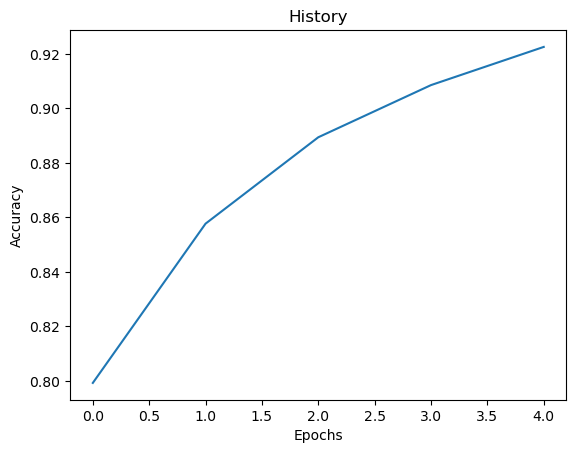

In [36]:
import matplotlib.pyplot as plt
plt.plot(history.history['accuracy'])
plt.title("History")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.savefig("Accuracy-Epochs.png")

# Evaluate 

In [31]:
eval_ =bi_lstm_nn.evaluate(test_padded, y_test)

Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RangeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op PrefetchDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlatMapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op TensorDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ZipDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ParallelMapDatasetV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op OptionsDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Opt

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
  22/7499 [..............................] - ETA: 2:46 - loss: 0.5839 - accuracy: 0.7955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
  49/7499 [..............................] - ETA: 2:33 - loss: 0.5695 - accuracy: 0.8080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/re

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
  79/7499 [..............................] - ETA: 2:28 - loss: 0.5800 - accuracy: 0.8042Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 106/7499 [..............................] - ETA: 2:25 - loss: 0.5902 - accuracy: 0.8007Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/re

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 136/7499 [..............................] - ETA: 2:23 - loss: 0.5757 - accuracy: 0.8028Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

 162/7499 [..............................] - ETA: 2:23 - loss: 0.5654 - accuracy: 0.8027Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 165/7499 [..............................] - ETA: 2:22 - loss: 0.5647 - accuracy: 0.8030Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 192/7499 [..............................] - ETA: 2:21 - loss: 0.5811 - accuracy: 0.7977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

 219/7499 [..............................] - ETA: 2:20 - loss: 0.5772 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 222/7499 [..............................] - ETA: 2:20 - loss: 0.5760 - accuracy: 0.7976Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 249/7499 [..............................] - ETA: 2:19 - loss: 0.5716 - accuracy: 0.7984Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

 276/7499 [>.............................] - ETA: 2:18 - loss: 0.5709 - accuracy: 0.7998Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 279/7499 [>.............................] - ETA: 2:18 - loss: 0.5695 - accuracy: 0.8006Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 306/7499 [>.............................] - ETA: 2:18 - loss: 0.5674 - accuracy: 0.8000Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

 333/7499 [>.............................] - ETA: 2:17 - loss: 0.5652 - accuracy: 0.7998Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 336/7499 [>.............................] - ETA: 2:17 - loss: 0.5655 - accuracy: 0.7994Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 363/7499 [>.............................] - ETA: 2:16 - loss: 0.5653 - accuracy: 0.7994Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

 390/7499 [>.............................] - ETA: 2:16 - loss: 0.5641 - accuracy: 0.7988Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 393/7499 [>.............................] - ETA: 2:16 - loss: 0.5631 - accuracy: 0.7991Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 420/7499 [>.............................] - ETA: 2:15 - loss: 0.5583 - accuracy: 0.7999Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

 447/7499 [>.............................] - ETA: 2:14 - loss: 0.5602 - accuracy: 0.7996Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 450/7499 [>.............................] - ETA: 2:14 - loss: 0.5602 - accuracy: 0.7996Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 477/7499 [>.............................] - ETA: 2:14 - loss: 0.5585 - accuracy: 0.7999Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

 504/7499 [=>............................] - ETA: 2:13 - loss: 0.5561 - accuracy: 0.8000Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 507/7499 [=>............................] - ETA: 2:13 - loss: 0.5567 - accuracy: 0.8000Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 534/7499 [=>............................] - ETA: 2:12 - loss: 0.5557 - accuracy: 0.8000Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

 561/7499 [=>............................] - ETA: 2:12 - loss: 0.5544 - accuracy: 0.8002Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 564/7499 [=>............................] - ETA: 2:11 - loss: 0.5549 - accuracy: 0.7999Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 591/7499 [=>............................] - ETA: 2:11 - loss: 0.5541 - accuracy: 0.8001Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

 618/7499 [=>............................] - ETA: 2:10 - loss: 0.5510 - accuracy: 0.8007Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 621/7499 [=>............................] - ETA: 2:10 - loss: 0.5509 - accuracy: 0.8007Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 648/7499 [=>............................] - ETA: 2:10 - loss: 0.5520 - accuracy: 0.8001Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

 675/7499 [=>............................] - ETA: 2:09 - loss: 0.5493 - accuracy: 0.8003Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 678/7499 [=>............................] - ETA: 2:09 - loss: 0.5500 - accuracy: 0.8001Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 705/7499 [=>............................] - ETA: 2:08 - loss: 0.5502 - accuracy: 0.7996Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

 732/7499 [=>............................] - ETA: 2:08 - loss: 0.5508 - accuracy: 0.7993Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 735/7499 [=>............................] - ETA: 2:08 - loss: 0.5517 - accuracy: 0.7989Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 762/7499 [==>...........................] - ETA: 2:07 - loss: 0.5505 - accuracy: 0.7993Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

 789/7499 [==>...........................] - ETA: 2:07 - loss: 0.5490 - accuracy: 0.7997Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 792/7499 [==>...........................] - ETA: 2:07 - loss: 0.5494 - accuracy: 0.7997Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 819/7499 [==>...........................] - ETA: 2:06 - loss: 0.5505 - accuracy: 0.7995Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

 846/7499 [==>...........................] - ETA: 2:06 - loss: 0.5510 - accuracy: 0.7990Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 849/7499 [==>...........................] - ETA: 2:05 - loss: 0.5510 - accuracy: 0.7991Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 876/7499 [==>...........................] - ETA: 2:05 - loss: 0.5533 - accuracy: 0.7985Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

 903/7499 [==>...........................] - ETA: 2:04 - loss: 0.5539 - accuracy: 0.7985Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 906/7499 [==>...........................] - ETA: 2:04 - loss: 0.5539 - accuracy: 0.7985Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 933/7499 [==>...........................] - ETA: 2:04 - loss: 0.5547 - accuracy: 0.7982Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

 960/7499 [==>...........................] - ETA: 2:03 - loss: 0.5533 - accuracy: 0.7987Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 963/7499 [==>...........................] - ETA: 2:03 - loss: 0.5534 - accuracy: 0.7986Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
 990/7499 [==>...........................] - ETA: 2:03 - loss: 0.5535 - accuracy: 0.7985Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

1017/7499 [===>..........................] - ETA: 2:02 - loss: 0.5529 - accuracy: 0.7986Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1020/7499 [===>..........................] - ETA: 2:02 - loss: 0.5525 - accuracy: 0.7987Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1047/7499 [===>..........................] - ETA: 2:01 - loss: 0.5536 - accuracy: 0.7980Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

1074/7499 [===>..........................] - ETA: 2:01 - loss: 0.5539 - accuracy: 0.7975Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1077/7499 [===>..........................] - ETA: 2:01 - loss: 0.5541 - accuracy: 0.7973Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1104/7499 [===>..........................] - ETA: 2:00 - loss: 0.5546 - accuracy: 0.7977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

1131/7499 [===>..........................] - ETA: 2:00 - loss: 0.5538 - accuracy: 0.7977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1134/7499 [===>..........................] - ETA: 2:00 - loss: 0.5538 - accuracy: 0.7976Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1161/7499 [===>..........................] - ETA: 1:59 - loss: 0.5538 - accuracy: 0.7977Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

1188/7499 [===>..........................] - ETA: 1:59 - loss: 0.5542 - accuracy: 0.7975Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1191/7499 [===>..........................] - ETA: 1:59 - loss: 0.5545 - accuracy: 0.7975Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1218/7499 [===>..........................] - ETA: 1:58 - loss: 0.5546 - accuracy: 0.7976Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

1245/7499 [===>..........................] - ETA: 1:58 - loss: 0.5548 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1248/7499 [===>..........................] - ETA: 1:57 - loss: 0.5548 - accuracy: 0.7972Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1275/7499 [====>.........................] - ETA: 1:57 - loss: 0.5549 - accuracy: 0.7974Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1303/7499 [====>.........................] - ETA: 1:57 - loss: 0.5545 - accuracy: 0.7971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

1330/7499 [====>.........................] - ETA: 1:56 - loss: 0.5549 - accuracy: 0.7971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1333/7499 [====>.........................] - ETA: 1:56 - loss: 0.5552 - accuracy: 0.7969Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1359/7499 [====>.........................] - ETA: 1:56 - loss: 0.5562 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1389/7499 [====>.........................] - ETA: 1:55 - loss: 0.5555 - accuracy: 0.7967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1416/7499 [====>.........................] - ETA: 1:55 - loss: 0.5552 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1445/7499 [====>.........................] - ETA: 1:54 - loss: 0.5549 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

1472/7499 [====>.........................] - ETA: 1:54 - loss: 0.5550 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1475/7499 [====>.........................] - ETA: 1:54 - loss: 0.5550 - accuracy: 0.7968Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1502/7499 [=====>........................] - ETA: 1:53 - loss: 0.5552 - accuracy: 0.7966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1530/7499 [=====>........................] - ETA: 1:53 - loss: 0.5553 - accuracy: 0.7966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

1557/7499 [=====>........................] - ETA: 1:53 - loss: 0.5553 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1560/7499 [=====>........................] - ETA: 1:53 - loss: 0.5552 - accuracy: 0.7969Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1587/7499 [=====>........................] - ETA: 1:52 - loss: 0.5543 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1615/7499 [=====>........................] - ETA: 1:52 - loss: 0.5546 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1617/7499 [=====>...............

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1644/7499 [=====>........................] - ETA: 1:51 - loss: 0.5547 - accuracy: 0.7970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/re

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1671/7499 [=====>........................] - ETA: 1:51 - loss: 0.5546 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1674/7499 [=====>...............

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1701/7499 [=====>........................] - ETA: 1:50 - loss: 0.5556 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/re

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1728/7499 [=====>........................] - ETA: 1:50 - loss: 0.5560 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1731/7499 [=====>...............

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1758/7499 [======>.......................] - ETA: 1:49 - loss: 0.5574 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/re

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1785/7499 [======>.......................] - ETA: 1:49 - loss: 0.5566 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1788/7499 [======>..............

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1814/7499 [======>.......................] - ETA: 1:48 - loss: 0.5561 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/re

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1844/7499 [======>.......................] - ETA: 1:48 - loss: 0.5548 - accuracy: 0.7966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1871/7499 [======>.......................] - ETA: 1:47 - loss: 0.5539 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/re

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1901/7499 [======>.......................] - ETA: 1:47 - loss: 0.5532 - accuracy: 0.7971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1928/7499 [======>.......................] - ETA: 1:46 - loss: 0.5528 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/re

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1958/7499 [======>.......................] - ETA: 1:46 - loss: 0.5527 - accuracy: 0.7973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
1985/7499 [======>.......................] - ETA: 1:45 - loss: 0.5523 - accuracy: 0.7974Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/re

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2015/7499 [=======>......................] - ETA: 1:45 - loss: 0.5517 - accuracy: 0.7973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2042/7499 [=======>......................] - ETA: 1:44 - loss: 0.5518 - accuracy: 0.7973Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/re

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2072/7499 [=======>......................] - ETA: 1:44 - loss: 0.5520 - accuracy: 0.7971Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2099/7499 [=======>......................] - ETA: 1:43 - loss: 0.5522 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/re

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2128/7499 [=======>......................] - ETA: 1:43 - loss: 0.5518 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2156/7499 [=======>......................] - ETA: 1:42 - loss: 0.5515 - accuracy: 0.7972Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

2183/7499 [=======>......................] - ETA: 1:42 - loss: 0.5520 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2186/7499 [=======>......................] - ETA: 1:42 - loss: 0.5518 - accuracy: 0.7970Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2213/7499 [=======>......................] - ETA: 1:41 - loss: 0.5525 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

2240/7499 [=======>......................] - ETA: 1:41 - loss: 0.5524 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2243/7499 [=======>......................] - ETA: 1:41 - loss: 0.5524 - accuracy: 0.7970Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2270/7499 [========>.....................] - ETA: 1:41 - loss: 0.5525 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2299/7499 [========>.....................] - ETA: 1:40 - loss: 0.5525 - accuracy: 0.7970Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

2325/7499 [========>.....................] - ETA: 1:40 - loss: 0.5526 - accuracy: 0.7968Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2328/7499 [========>.....................] - ETA: 1:39 - loss: 0.5524 - accuracy: 0.7968Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2355/7499 [========>.....................] - ETA: 1:39 - loss: 0.5522 - accuracy: 0.7969Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

2382/7499 [========>.....................] - ETA: 1:38 - loss: 0.5531 - accuracy: 0.7966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2385/7499 [========>.....................] - ETA: 1:38 - loss: 0.5531 - accuracy: 0.7966Executing op ReadVariableOp in device /job:l

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2412/7499 [========>.....................] - ETA: 1:38 - loss: 0.5533 - accuracy: 0.7966Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2441/7499 [========>.....................] - ETA: 1:37 - loss: 0.5539 - accuracy: 0.7965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2468/7499 [========>.....................] - ETA: 1:37 - loss: 0.5534 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2498/7499 [========>.....................] - ETA: 1:36 - loss: 0.5536 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2525/7499 [=========>....................] - ETA: 1:36 - loss: 0.5543 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2555/7499 [=========>....................] - ETA: 1:35 - loss: 0.5555 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2582/7499 [=========>....................] - ETA: 1:35 - loss: 0.5548 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2612/7499 [=========>....................] - ETA: 1:34 - loss: 0.5548 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2639/7499 [=========>....................] - ETA: 1:33 - loss: 0.5547 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2669/7499 [=========>....................] - ETA: 1:33 - loss: 0.5543 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2696/7499 [=========>....................] - ETA: 1:32 - loss: 0.5551 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2726/7499 [=========>....................] - ETA: 1:32 - loss: 0.5556 - accuracy: 0.7956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2753/7499 [==========>...................] - ETA: 1:31 - loss: 0.5562 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2783/7499 [==========>...................] - ETA: 1:30 - loss: 0.5561 - accuracy: 0.7956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2810/7499 [==========>...................] - ETA: 1:30 - loss: 0.5563 - accuracy: 0.7955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2840/7499 [==========>...................] - ETA: 1:29 - loss: 0.5569 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2867/7499 [==========>...................] - ETA: 1:29 - loss: 0.5567 - accuracy: 0.7955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2897/7499 [==========>...................] - ETA: 1:28 - loss: 0.5563 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2924/7499 [==========>...................] - ETA: 1:28 - loss: 0.5560 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2954/7499 [==========>...................] - ETA: 1:27 - loss: 0.5558 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
2981/7499 [==========>...................] - ETA: 1:27 - loss: 0.5560 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3011/7499 [===========>..................] - ETA: 1:26 - loss: 0.5559 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3038/7499 [===========>..................] - ETA: 1:25 - loss: 0.5564 - accuracy: 0.7956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3068/7499 [===========>..................] - ETA: 1:25 - loss: 0.5572 - accuracy: 0.7952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3095/7499 [===========>..................] - ETA: 1:24 - loss: 0.5576 - accuracy: 0.7952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3125/7499 [===========>..................] - ETA: 1:24 - loss: 0.5572 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3152/7499 [===========>..................] - ETA: 1:23 - loss: 0.5577 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3182/7499 [===========>..................] - ETA: 1:22 - loss: 0.5578 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3209/7499 [===========>..................] - ETA: 1:22 - loss: 0.5577 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3239/7499 [===========>..................] - ETA: 1:21 - loss: 0.5580 - accuracy: 0.7952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3266/7499 [============>.................] - ETA: 1:21 - loss: 0.5576 - accuracy: 0.7952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3296/7499 [============>.................] - ETA: 1:20 - loss: 0.5575 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3323/7499 [============>.................] - ETA: 1:20 - loss: 0.5576 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3353/7499 [============>.................] - ETA: 1:19 - loss: 0.5572 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3380/7499 [============>.................] - ETA: 1:19 - loss: 0.5570 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3410/7499 [============>.................] - ETA: 1:18 - loss: 0.5575 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3437/7499 [============>.................] - ETA: 1:17 - loss: 0.5574 - accuracy: 0.7952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3467/7499 [============>.................] - ETA: 1:17 - loss: 0.5573 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3494/7499 [============>.................] - ETA: 1:16 - loss: 0.5575 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3524/7499 [=============>................] - ETA: 1:16 - loss: 0.5575 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3551/7499 [=============>................] - ETA: 1:15 - loss: 0.5576 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3581/7499 [=============>................] - ETA: 1:15 - loss: 0.5578 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3608/7499 [=============>................] - ETA: 1:14 - loss: 0.5577 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3638/7499 [=============>................] - ETA: 1:14 - loss: 0.5583 - accuracy: 0.7952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3665/7499 [=============>................] - ETA: 1:13 - loss: 0.5585 - accuracy: 0.7951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3695/7499 [=============>................] - ETA: 1:12 - loss: 0.5583 - accuracy: 0.7951Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3722/7499 [=============>................] - ETA: 1:12 - loss: 0.5579 - accuracy: 0.7952Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3752/7499 [==============>...............] - ETA: 1:11 - loss: 0.5581 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3779/7499 [==============>...............] - ETA: 1:11 - loss: 0.5580 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3809/7499 [==============>...............] - ETA: 1:10 - loss: 0.5580 - accuracy: 0.7953Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3836/7499 [==============>...............] - ETA: 1:10 - loss: 0.5574 - accuracy: 0.7954Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3866/7499 [==============>...............] - ETA: 1:09 - loss: 0.5572 - accuracy: 0.7955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3893/7499 [==============>...............] - ETA: 1:09 - loss: 0.5566 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3923/7499 [==============>...............] - ETA: 1:08 - loss: 0.5567 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3950/7499 [==============>...............] - ETA: 1:07 - loss: 0.5568 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
3980/7499 [==============>...............] - ETA: 1:07 - loss: 0.5563 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4007/7499 [===============>..............] - ETA: 1:06 - loss: 0.5575 - accuracy: 0.7955Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4037/7499 [===============>..............] - ETA: 1:06 - loss: 0.5571 - accuracy: 0.7956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4064/7499 [===============>..............] - ETA: 1:05 - loss: 0.5571 - accuracy: 0.7956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4094/7499 [===============>..............] - ETA: 1:05 - loss: 0.5569 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4121/7499 [===============>..............] - ETA: 1:04 - loss: 0.5568 - accuracy: 0.7956Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4151/7499 [===============>..............] - ETA: 1:04 - loss: 0.5563 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4178/7499 [===============>..............] - ETA: 1:03 - loss: 0.5561 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4208/7499 [===============>..............] - ETA: 1:02 - loss: 0.5563 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4235/7499 [===============>..............] - ETA: 1:02 - loss: 0.5563 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4265/7499 [================>.............] - ETA: 1:01 - loss: 0.5564 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4292/7499 [================>.............] - ETA: 1:01 - loss: 0.5566 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4322/7499 [================>.............] - ETA: 1:00 - loss: 0.5566 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4349/7499 [================>.............] - ETA: 1:00 - loss: 0.5563 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device 

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4379/7499 [================>.............] - ETA: 59s - loss: 0.5559 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4406/7499 [================>.............] - ETA: 59s - loss: 0.5559 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4436/7499 [================>.............] - ETA: 58s - loss: 0.5557 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4463/7499 [================>.............] - ETA: 58s - loss: 0.5559 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4493/7499 [================>.............] - ETA: 57s - loss: 0.5561 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4520/7499 [=================>............] - ETA: 56s - loss: 0.5556 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4550/7499 [=================>............] - ETA: 56s - loss: 0.5558 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4577/7499 [=================>............] - ETA: 55s - loss: 0.5556 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4607/7499 [=================>............] - ETA: 55s - loss: 0.5554 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4634/7499 [=================>............] - ETA: 54s - loss: 0.5557 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4664/7499 [=================>............] - ETA: 54s - loss: 0.5556 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4691/7499 [=================>............] - ETA: 53s - loss: 0.5559 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4721/7499 [=================>............] - ETA: 53s - loss: 0.5555 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4748/7499 [=================>............] - ETA: 52s - loss: 0.5555 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4778/7499 [==================>...........] - ETA: 51s - loss: 0.5557 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4805/7499 [==================>...........] - ETA: 51s - loss: 0.5555 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4835/7499 [==================>...........] - ETA: 50s - loss: 0.5553 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4862/7499 [==================>...........] - ETA: 50s - loss: 0.5553 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4892/7499 [==================>...........] - ETA: 49s - loss: 0.5553 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4919/7499 [==================>...........] - ETA: 49s - loss: 0.5552 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4949/7499 [==================>...........] - ETA: 48s - loss: 0.5551 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
4976/7499 [==================>...........] - ETA: 48s - loss: 0.5551 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5006/7499 [===================>..........] - ETA: 47s - loss: 0.5554 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5033/7499 [===================>..........] - ETA: 47s - loss: 0.5554 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5063/7499 [===================>..........] - ETA: 46s - loss: 0.5552 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5090/7499 [===================>..........] - ETA: 45s - loss: 0.5551 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5120/7499 [===================>..........] - ETA: 45s - loss: 0.5551 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5147/7499 [===================>..........] - ETA: 44s - loss: 0.5551 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5177/7499 [===================>..........] - ETA: 44s - loss: 0.5548 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5204/7499 [===================>..........] - ETA: 43s - loss: 0.5548 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5234/7499 [===================>..........] - ETA: 43s - loss: 0.5552 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5261/7499 [====================>.........] - ETA: 42s - loss: 0.5553 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5291/7499 [====================>.........] - ETA: 42s - loss: 0.5554 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5318/7499 [====================>.........] - ETA: 41s - loss: 0.5552 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5348/7499 [====================>.........] - ETA: 40s - loss: 0.5550 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5375/7499 [====================>.........] - ETA: 40s - loss: 0.5550 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5405/7499 [====================>.........] - ETA: 39s - loss: 0.5553 - accuracy: 0.7958Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5432/7499 [====================>.........] - ETA: 39s - loss: 0.5557 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5462/7499 [====================>.........] - ETA: 38s - loss: 0.5558 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5489/7499 [====================>.........] - ETA: 38s - loss: 0.5559 - accuracy: 0.7957Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5519/7499 [=====================>........] - ETA: 37s - loss: 0.5556 - accuracy: 0.7959Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5546/7499 [=====================>........] - ETA: 37s - loss: 0.5553 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5576/7499 [=====================>........] - ETA: 36s - loss: 0.5553 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5603/7499 [=====================>........] - ETA: 36s - loss: 0.5553 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5633/7499 [=====================>........] - ETA: 35s - loss: 0.5549 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5660/7499 [=====================>........] - ETA: 35s - loss: 0.5551 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5690/7499 [=====================>........] - ETA: 34s - loss: 0.5552 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5717/7499 [=====================>........] - ETA: 33s - loss: 0.5550 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5747/7499 [=====================>........] - ETA: 33s - loss: 0.5547 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5774/7499 [======================>.......] - ETA: 32s - loss: 0.5547 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5804/7499 [======================>.......] - ETA: 32s - loss: 0.5544 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5831/7499 [======================>.......] - ETA: 31s - loss: 0.5545 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5861/7499 [======================>.......] - ETA: 31s - loss: 0.5543 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5888/7499 [======================>.......] - ETA: 30s - loss: 0.5542 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5918/7499 [======================>.......] - ETA: 30s - loss: 0.5542 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5945/7499 [======================>.......] - ETA: 29s - loss: 0.5540 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
5975/7499 [======================>.......] - ETA: 28s - loss: 0.5541 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6002/7499 [=======================>......] - ETA: 28s - loss: 0.5540 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6032/7499 [=======================>......] - ETA: 27s - loss: 0.5538 - accuracy: 0.7965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6059/7499 [=======================>......] - ETA: 27s - loss: 0.5536 - accuracy: 0.7965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6089/7499 [=======================>......] - ETA: 26s - loss: 0.5536 - accuracy: 0.7964Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6116/7499 [=======================>......] - ETA: 26s - loss: 0.5536 - accuracy: 0.7965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6146/7499 [=======================>......] - ETA: 25s - loss: 0.5537 - accuracy: 0.7965Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6173/7499 [=======================>......] - ETA: 25s - loss: 0.5543 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6203/7499 [=======================>......] - ETA: 24s - loss: 0.5546 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6230/7499 [=======================>......] - ETA: 24s - loss: 0.5550 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6260/7499 [========================>.....] - ETA: 23s - loss: 0.5549 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6287/7499 [========================>.....] - ETA: 23s - loss: 0.5548 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6317/7499 [========================>.....] - ETA: 22s - loss: 0.5549 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6344/7499 [========================>.....] - ETA: 21s - loss: 0.5546 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6374/7499 [========================>.....] - ETA: 21s - loss: 0.5545 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6401/7499 [========================>.....] - ETA: 20s - loss: 0.5546 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6431/7499 [========================>.....] - ETA: 20s - loss: 0.5550 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6458/7499 [========================>.....] - ETA: 19s - loss: 0.5555 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6488/7499 [========================>.....] - ETA: 19s - loss: 0.5553 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6515/7499 [=========================>....] - ETA: 18s - loss: 0.5552 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6545/7499 [=========================>....] - ETA: 18s - loss: 0.5553 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6572/7499 [=========================>....] - ETA: 17s - loss: 0.5552 - accuracy: 0.7960Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6602/7499 [=========================>....] - ETA: 17s - loss: 0.5551 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6629/7499 [=========================>....] - ETA: 16s - loss: 0.5553 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6659/7499 [=========================>....] - ETA: 15s - loss: 0.5552 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6686/7499 [=========================>....] - ETA: 15s - loss: 0.5553 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6716/7499 [=========================>....] - ETA: 14s - loss: 0.5552 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6743/7499 [=========================>....] - ETA: 14s - loss: 0.5552 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6773/7499 [==========================>...] - ETA: 13s - loss: 0.5553 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6800/7499 [==========================>...] - ETA: 13s - loss: 0.5550 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6830/7499 [==========================>...] - ETA: 12s - loss: 0.5552 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6857/7499 [==========================>...] - ETA: 12s - loss: 0.5553 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6887/7499 [==========================>...] - ETA: 11s - loss: 0.5552 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6914/7499 [==========================>...] - ETA: 11s - loss: 0.5552 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6944/7499 [==========================>...] - ETA: 10s - loss: 0.5549 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
6971/7499 [==========================>...] - ETA: 10s - loss: 0.5550 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
7001/7499 [===========================>..] - ETA: 9s - loss: 0.5551 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
7028/7499 [===========================>..] - ETA: 8s - loss: 0.5548 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /j

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
7058/7499 [===========================>..] - ETA: 8s - loss: 0.5552 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
7085/7499 [===========================>..] - ETA: 7s - loss: 0.5553 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /j

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
7115/7499 [===========================>..] - ETA: 7s - loss: 0.5553 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
7142/7499 [===========================>..] - ETA: 6s - loss: 0.5554 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /j

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
7172/7499 [===========================>..] - ETA: 6s - loss: 0.5555 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
7199/7499 [===========================>..] - ETA: 5s - loss: 0.5555 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /j

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
7229/7499 [===========================>..] - ETA: 5s - loss: 0.5556 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
7256/7499 [============================>.] - ETA: 4s - loss: 0.5556 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /j

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
7286/7499 [============================>.] - ETA: 4s - loss: 0.5555 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
7313/7499 [============================>.] - ETA: 3s - loss: 0.5554 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /j

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
7343/7499 [============================>.] - ETA: 2s - loss: 0.5552 - accuracy: 0.7963Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
7370/7499 [============================>.] - ETA: 2s - loss: 0.5554 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /j

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
7400/7499 [============================>.] - ETA: 1s - loss: 0.5556 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
7427/7499 [============================>.] - ETA: 1s - loss: 0.5555 - accuracy: 0.7962Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /j

Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
7457/7499 [============================>.] - ETA: 0s - loss: 0.5556 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
7484/7499 [============================>.] - ETA: 0s - loss: 0.5558 - accuracy: 0.7961Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_91620 in device /j

In [32]:
eval_[1]

0.7961491346359253

In [35]:
bi_lstm_nn.save(f"{MODEL_PATH}")

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:loc